In [1]:
import os
import pandas as pd
import re
import chardet
import sqlalchemy
import matplotlib.pyplot as plt
from sqlalchemy import create_engine
from sklearn.metrics import roc_auc_score, precision_score, classification_report, recall_score, ConfusionMatrixDisplay, precision_recall_fscore_support, confusion_matrix
from utils_mem import *
import mysql.connector
from mysql.connector import FieldType
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
import numpy as np
import unidecode
from bs4 import BeautifulSoup
from mysql.connector.cursor import MySQLCursor
import sys
import requests
from IPython.display import clear_output
import re
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC 
from sklearn.model_selection import cross_val_score, GridSearchCV, RepeatedStratifiedKFold, LeaveOneGroupOut, StratifiedGroupKFold
import statistics 
from sklearn.inspection import permutation_importance
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier

path_adni = "./data/csv/ADNI"

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\requests\__init__.py:102: RequestsDependencyWarning: urllib3 (1.26.8) or chardet (5.2.0)/charset_normalizer (2.0.12) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({})/charset_normalizer ({}) doesn't match a supported "


In [2]:
if False:
    csv = {"NeuroPsy/ADAS_ADNI1_07Mar2024_Alzheimer's Disease Assessment Scale (ADAS) [ADNI1].csv": 'ADAS', 
            'NeuroPsy/ADASSCORES_07Mar2024_ADAS Sub-Scores and Total Scores [ADNI1].csv': 'ADASSCORES', 
            'NeuroPsy/MOCA_07Mar2024_Montreal Cognitive Assessment (MoCA) [ADNIGO,2,3].csv': 'MOCA', 
            'NeuroPsy/ADNI_EMBICDCB_07Mar2024_Embic Corporation – Digital Cognitive Biomarkers [ADNI1,GO,2,3].csv': 'EMBICDCB',
            'NeuroPsy/MMSE_07Mar2024_Mini-Mental State Examination (MMSE) [ADNI1,GO,2,3].csv': 'MMSE', 
            'NeuroPsy/UWNPSYCHSUM_07Mar2024_UW - Neuropsych Summary Scores [ADNI1,GO,2,3].csv': 'UWNPSYCHSUM', 
            'NeuroPsy/EMBICqCP_07Mar2024_Embic Corporation Quantified Cognitive Processes [ADNI1,GO,2,3].csv': 'EMBICDCB', 
            'NeuroPsy/NEUROBAT_07Mar2024_EMBICDCB.csv': 'NEUROBAT', # going with UWNPSYCHSUM
            'biospecimen/ADMCGUTMETABOLITESLONG_12_13_21_07Mar2024_Hawaii Gut Metabolites Serum Longitudinal [ADNI1,GO,2].csv': 'ADMCGUTMETABOLITESLONG',
            "demograph/PTDEMOG_11Mar2024.csv": "PTDEMOG", 
           "NeuroPsy/MMSE_Mini-Mental State Examination (MMSE) [ADNI1,GO,2,3,4].csv": "MMSE",
           "MRI/UCSFFSX51_11_08_19_13May2024_UCSF - Cross-Sectional FreeSurfer (5.1) [ADNI1,GO,2].csv": "UCSFFSX51"
          }
    chosen = -1
    hasdate=True
    url = "https://adni.loni.usc.edu/data-dictionary-search/?q=DXPATYP"
    pattern = "E:/Celia/data/csv/ADNI/" + list(csv.keys())[chosen]
    print(pattern)
    print(csv[list(csv.keys())[chosen]])
    if len(pattern) == 0:
        for dire in os.listdir(path_adni):
            for file in os.listdir(path_adni+"/"+dire):
                print(path_adni+"/"+dire+"/"+file)
                df = pd.read_csv(path_adni+"/"+dire+"/"+file)
                display(df)
                go=False
                meet_date=False
                for col in df.columns:
                    if meet_date and go and "id" not in col.lower():
                        print(col)
                        df_display = get_info_col(col, file.split("_")[0])
                        if "aparc" not in df_display.loc[1, "Definition"] and "aseg" not in df_display.loc[1, "Definition"]:
                            display(df_display)
                    elif meet_date:
                        if "date" not in col.lower():
                            go=True
                    else:
                        if "date" in col.lower():
                            meet_date=True
    else:
        file = pattern.split("/")[-1]
        df = pd.read_csv(pattern, skiprows=1)
        display(df)
        go=False
        meet_date=False
        for col in df.columns:
            if (meet_date and go) or (not hasdate):
                print(col)
                df_display = get_info_col(col, csv[list(csv.keys())[chosen]])
                df_display.reset_index(inplace=True)
                if not pd.isna(df_display.loc[0, "Definition"]):
                    if "aparc" not in df_display.loc[0, "Definition"] and "aseg" not in df_display.loc[0, "Definition"]:
                        display(df_display)
            elif meet_date:
                if "date" not in col.lower():
                    go=True
            else:
                if "date" in col.lower():
                    meet_date=True

# Diagnosis set up

In [3]:
def diag_pre(s):
    if s["cog_diag"] == "CN" and s["AMYLOID_STATUS"] == 1:
        return 1
    elif pd.isna(s["cog_diag"]):
        return s["cog_diag"]
    elif pd.isna(s["AMYLOID_STATUS"]):
        return s["AMYLOID_STATUS"]
    else:
        return 0

def diag_pre_composite(s):
    if s["cog_diag"] == "CN" and s["AMYLOID_STATUS_COMPOSITE_REF"] == 1:
        return 1
    elif pd.isna(s["cog_diag"]):
        return s["cog_diag"]
    elif pd.isna(s["AMYLOID_STATUS_COMPOSITE_REF"]):
        return s["AMYLOID_STATUS_COMPOSITE_REF"]
    else:
        return 0
diagnosis = pd.read_csv("E:/Celia/data/csv/ADNI/diagnosis/DXSUM_PDXCONV_ADNIALL_22Feb2024_diag and changes.csv", skiprows=1, usecols=["RID", "VISDATE", "DXCURREN", "DXCHANGE", "DXCONV", "DIAGNOSIS", "VISCODE2"])
diagnosis.columns = diagnosis.columns.map(lambda x : x+'_diag' if x !='RID' else x)

display(diagnosis)
diagnosis["cog_diag"] = diagnosis["DXCHANGE_diag"].copy().map({1: "CN", 2: "MCI", 3: "DEM", 4: "MCI", 5: "DEM", 6: "DEM", 7: "CN", 8: "MCI", 9: "CN"})

display(diagnosis)
diagnosis["cog_diag"] = diagnosis["cog_diag"].fillna(diagnosis["DXCURREN_diag"].copy().map({1: "CN", 2: "MCI", 3: "DEM"}))
display(diagnosis)
diagnosis = diagnosis[diagnosis["cog_diag"] == "CN"]
display(diagnosis)

amy = pd.read_csv("E:/Celia/data/csv/ADNI/Amy/UCBERKELEY_AMY_6MM_22Feb2024.csv", skiprows=1, usecols=["RID", "SCANDATE", "PROCESSDATE", "AMYLOID_STATUS", "AMYLOID_STATUS_COMPOSITE_REF"])
amy["AMYLOID_STATUS_COMPOSITE_REF"] = amy["AMYLOID_STATUS_COMPOSITE_REF"].astype("Int64")
amy["AMYLOID_STATUS"] = amy["AMYLOID_STATUS"].astype("Int64")

df = pd.merge(diagnosis[["RID", "VISDATE_diag", "cog_diag"]], amy, on=["RID"], how="inner", suffixes=("_diag", "_amy"))
display(df)

df.replace(to_replace = "-1", value = np.nan, inplace = True)
df.replace(to_replace = "-4", value = np.nan, inplace = True)
df.replace(to_replace = -1, value = np.nan, inplace = True)
df.replace(to_replace = -4, value = np.nan, inplace = True)
df[["VISDATE_diag", "SCANDATE"]] = make_dates(df[["VISDATE_diag", "SCANDATE"]])

df = date_within(df, 365, ["VISDATE_diag", 'SCANDATE'])

display(df)

df['diag'] = df.apply(diag_pre, axis=1)
df['diag_composite'] = df.apply(diag_pre_composite, axis=1)
df.dropna(subset=["diag", "diag_composite"], how="any", inplace=True)

for x in df.columns:
    nan = df[x].isna().sum()
    if nan > 0:
        print(x+" with "+str(nan)+" # of nan")
        
df.dropna(axis=1, inplace=True)

print(df["diag"].value_counts())
print(df["diag_composite"].value_counts())
df.rename(columns={"PTID_diag": "PTID", "EXAMDATE_diag": "EXAMDATE"}, inplace=True)

print("final:")
diag = df[["RID", "VISDATE_diag", "SCANDATE", "diag", "diag_composite"]].copy()

diag["diag"] = diag["diag"].astype(int)
diag["diag_composite"] = diag["diag_composite"].astype(int)
display(diag)

,RID,VISCODE2_diag,VISDATE_diag,DXCHANGE_diag,DXCURREN_diag,DXCONV_diag,DIAGNOSIS_diag
0,2,bl,2005-09-29,NaN,1.0,0.0,NaN
1,3,bl,2005-09-30,NaN,3.0,0.0,NaN
2,5,bl,2005-09-30,NaN,1.0,0.0,NaN
3,8,bl,2005-09-30,NaN,1.0,0.0,NaN
4,7,bl,2005-10-06,NaN,3.0,0.0,NaN
...,...,...,...,...,...,...,...
13512,6880,bl,2020-12-03,NaN,NaN,NaN,2.0
13513,7122,bl,2023-04-14,NaN,NaN,NaN,1.0
13514,6918,m12,2022-04-12,NaN,NaN,NaN,NaN
13515,6220,m12,2020-03-03,NaN,NaN,NaN,2.0


,RID,VISCODE2_diag,VISDATE_diag,DXCHANGE_diag,DXCURREN_diag,DXCONV_diag,DIAGNOSIS_diag,cog_diag
0,2,bl,2005-09-29,NaN,1.0,0.0,NaN,NaN
1,3,bl,2005-09-30,NaN,3.0,0.0,NaN,NaN
2,5,bl,2005-09-30,NaN,1.0,0.0,NaN,NaN
3,8,bl,2005-09-30,NaN,1.0,0.0,NaN,NaN
4,7,bl,2005-10-06,NaN,3.0,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...
13512,6880,bl,2020-12-03,NaN,NaN,NaN,2.0,NaN
13513,7122,bl,2023-04-14,NaN,NaN,NaN,1.0,NaN
13514,6918,m12,2022-04-12,NaN,NaN,NaN,NaN,NaN
13515,6220,m12,2020-03-03,NaN,NaN,NaN,2.0,NaN


,RID,VISCODE2_diag,VISDATE_diag,DXCHANGE_diag,DXCURREN_diag,DXCONV_diag,DIAGNOSIS_diag,cog_diag
0,2,bl,2005-09-29,NaN,1.0,0.0,NaN,CN
1,3,bl,2005-09-30,NaN,3.0,0.0,NaN,DEM
2,5,bl,2005-09-30,NaN,1.0,0.0,NaN,CN
3,8,bl,2005-09-30,NaN,1.0,0.0,NaN,CN
4,7,bl,2005-10-06,NaN,3.0,0.0,NaN,DEM
...,...,...,...,...,...,...,...,...
13512,6880,bl,2020-12-03,NaN,NaN,NaN,2.0,NaN
13513,7122,bl,2023-04-14,NaN,NaN,NaN,1.0,NaN
13514,6918,m12,2022-04-12,NaN,NaN,NaN,NaN,NaN
13515,6220,m12,2020-03-03,NaN,NaN,NaN,2.0,NaN


,RID,VISCODE2_diag,VISDATE_diag,DXCHANGE_diag,DXCURREN_diag,DXCONV_diag,DIAGNOSIS_diag,cog_diag
0,2,bl,2005-09-29,NaN,1.0,0.0,NaN,CN
2,5,bl,2005-09-30,NaN,1.0,0.0,NaN,CN
3,8,bl,2005-09-30,NaN,1.0,0.0,NaN,CN
5,15,bl,2005-10-18,NaN,1.0,0.0,NaN,CN
7,31,bl,2005-10-24,NaN,1.0,0.0,NaN,CN
...,...,...,...,...,...,...,...,...
9997,969,m108,2019-02-25,1.0,NaN,NaN,NaN,CN
10005,4004,m60,2019-02-27,7.0,NaN,NaN,NaN,CN
10007,5137,m36,2016-07-20,1.0,NaN,NaN,NaN,CN
10008,981,m96,2015-12-01,1.0,NaN,NaN,NaN,CN


,RID,VISDATE_diag,cog_diag,SCANDATE,PROCESSDATE,AMYLOID_STATUS,AMYLOID_STATUS_COMPOSITE_REF
0,31,2005-10-24,CN,2010-12-01,2022-09-06,1,1
1,31,2005-10-24,CN,2012-09-20,2022-09-06,1,1
2,31,2005-10-24,CN,2016-01-26,2023-04-13,1,1
3,31,2005-10-24,CN,2018-04-18,2022-09-06,1,1
4,31,2006-04-18,CN,2010-12-01,2022-09-06,1,1
...,...,...,...,...,...,...,...
7595,4444,2016-06-06,CN,2016-02-25,2022-09-06,1,1
7596,4004,2019-02-27,CN,2011-05-27,2022-09-06,0,0
7597,4004,2019-02-27,CN,2013-04-29,2022-09-06,0,0
7598,4004,2019-02-27,CN,2015-04-30,2022-09-06,0,0


,RID,VISDATE_diag,cog_diag,SCANDATE,PROCESSDATE,AMYLOID_STATUS,AMYLOID_STATUS_COMPOSITE_REF
24,31,2010-12-10,CN,2010-12-01,2022-09-06,1,1
28,31,2011-10-23,CN,2010-12-01,2022-09-06,1,1
29,31,2011-10-23,CN,2012-09-20,2022-09-06,1,1
33,31,2012-09-25,CN,2012-09-20,2022-09-06,1,1
42,31,2016-04-11,CN,2016-01-26,2023-04-13,1,1
...,...,...,...,...,...,...,...
7576,2036,2015-10-22,CN,2014-11-05,2022-09-06,0,0
7580,4513,2016-03-17,CN,2016-02-23,2022-09-06,0,0
7585,4706,2016-06-07,CN,2016-05-18,2022-09-06,0,0
7590,2187,2016-05-18,CN,2015-08-19,2022-09-06,0,0


0    1146
1     522
Name: diag, dtype: int64
0    1238
1     430
Name: diag_composite, dtype: int64
final:


,RID,VISDATE_diag,SCANDATE,diag,diag_composite
24,31,2010-12-10,2010-12-01,1,1
28,31,2011-10-23,2010-12-01,1,1
29,31,2011-10-23,2012-09-20,1,1
33,31,2012-09-25,2012-09-20,1,1
42,31,2016-04-11,2016-01-26,1,1
...,...,...,...,...,...
7576,2036,2015-10-22,2014-11-05,0,0
7580,4513,2016-03-17,2016-02-23,0,0
7585,4706,2016-06-07,2016-05-18,0,0
7590,2187,2016-05-18,2015-08-19,0,0


## Demographics

In [4]:
APOE = pd.read_csv("E:/Celia/data/csv/ADNI/APOE/YASSINE_PLASMA_15Feb2024.csv", skiprows=1, usecols=["RID", "Phenotype"])
APOE.dropna(subset=["Phenotype"], inplace=True)
APOE["Phenotype"] = APOE["Phenotype"].apply(lambda x: ''.join(c for c in x if c.isdigit()))
APOE["Phenotype"] = APOE["Phenotype"].astype(int)

feat = pd.read_csv("E:/Celia/data/csv/ADNI/demograph/PTDEMOG_11Mar2024.csv", skiprows=1, 
                   usecols=["RID", "PTGENDER", "PTEDUCAT", "PTDOBYY", "VISDATE"])

feat = pd.merge(APOE, feat, on="RID", how="inner")
feat.replace(-4, np.nan, inplace=True)
feat.replace(-1, np.nan, inplace=True)
feat.dropna(inplace=True)
feat["PTGENDER"] = feat["PTGENDER"].astype(int)
feat["PTEDUCAT"] = feat["PTEDUCAT"].astype(int)
feat["PTDOBYY"] = feat["PTDOBYY"].astype(int)
feat.rename(columns={"Phenotype": "APOE"}, inplace=True)
print(feat.columns)
display(feat)

Index(['RID', 'APOE', 'VISDATE', 'PTGENDER', 'PTDOBYY', 'PTEDUCAT'], dtype='object')


,RID,APOE,VISDATE,PTGENDER,PTDOBYY,PTEDUCAT
0,386,34,2006-04-05,2,1933,13
1,618,34,2006-05-25,1,1931,16
2,618,34,2010-06-25,1,1931,16
3,618,34,2011-06-27,1,1931,16
4,778,34,2006-07-28,1,1934,13
...,...,...,...,...,...,...
331,4777,33,2012-06-01,2,1927,14
332,4889,33,2012-08-02,1,1936,18
333,448,33,2006-04-14,1,1920,17
335,448,33,2011-03-29,1,1920,17


# IRM

In [5]:
irm1 = pd.read_csv("E:/Celia/data/csv/ADNI/MRI/UCSFFSL51_03_01_22_18May2024_UCSF - Longitudinal FreeSurfer (5.1) - Final Run w All A [ADNIGO,2].csv", skiprows=1)
display(irm1)
irm1.drop(columns={"COLPROT", "VISCODE", "VERSION", "LONISID", "LONIUID", 
                   "IMAGEUID", "RUNDATE", "STATUS", "RUNDATE", "OVERALLQC", "TEMPQC", "FRONTQC", "PARQC", "INSULAQC", 
                   "OCCQC", "BGQC", "CWMQC", "VENTQC", "LHIPQC", "RHIPQC", "update_stamp"}, 
          inplace=True)

irm1 = supp_col(irm1, 0.3, verbose=True)

for x in irm1.columns:
    nan = irm1[x].isna().sum()
    if nan > 0:
        print(x+" with "+str(nan)+" # of nan")
irm1.dropna(inplace=True)

ren = {}
"""for i in irm1.columns:
    if i != "RID" and "date" not in i.lower() and i.lower() != "viscode2":
        ren[i] = "irmL_"+i"""
irm1.rename(columns=ren, inplace=True)
display(irm1)

,COLPROT,RID,VISCODE,VISCODE2,EXAMDATE,VERSION,LONISID,LONIUID,IMAGEUID,RUNDATE,...,ST146HS,ST147SV,ST148SV,ST150SV,ST151SV,ST152SV,ST153SV,ST154SV,ST155SV,update_stamp
0,ADNI2,21,v11,m84,2012-10-04,2019-10-21,53048.0,169744.0,340931,2019-10-21,...,332.709,194448,196131,197816.0,192667,390483,144449,535028,878580,2022-03-03 12:47:16.0
1,ADNIGO,21,nv,m60,2010-10-08,2019-10-21,29253.0,93190.0,222684,2019-10-21,...,353.894,194199,196605,200634.0,203093,403726,147587,538390,893833,2022-03-03 12:47:16.0
2,ADNI2,21,v06,m72,2011-10-13,2019-10-21,38511.0,125206.0,265250,2019-10-21,...,355.549,185986,187947,204505.0,204722,409228,144631,518563,882841,2022-03-03 12:47:16.0
3,ADNI2,21,v21,m96,2013-10-17,2019-10-21,62148.0,204109.0,398269,2019-10-21,...,328.323,188097,191402,197259.0,193818,391077,142898,522397,868432,2022-03-03 12:47:16.0
4,ADNI2,21,v41,m120,2015-11-03,2019-10-21,81324.0,299478.0,570703,2019-10-21,...,328.435,180416,185447,194812.0,189309,384121,139771,505634,849332,2022-03-03 12:47:16.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3306,ADNI2,5289,v02,scmri,2013-09-03,2019-09-13,62128.0,204015.0,398319,2019-09-13,...,407.944,214183,214414,219199.0,219846,439045,176690,605287,997123,2022-03-03 12:47:32.0
3307,ADNI2,5289,v21,m24,2015-11-16,2019-09-13,82378.0,308770.0,765032,2019-09-13,...,367.996,215145,214029,212214.0,212063,424276,174614,603788,986301,2022-03-03 12:47:32.0
3308,ADNIGO,2248,nv,m06,2011-07-12,2019-10-29,35395.0,114275.0,248620,2019-10-29,...,297.744,177681,174413,173801.0,189567,363368,158758,510852,845681,2022-03-08 11:46:31.0
3309,ADNI2,4299,v02,scmri,2011-11-02,2019-09-28,39281.0,127896.0,265267,2019-09-28,...,323.781,210004,216436,193752.0,189223,382975,161375,587814,944197,2022-03-08 11:46:39.0


total nan values before: 1325
percentage of nan: 0.11633174829497166%


we are going to delete these COLUMNS due to too many nan values: 
['ST8SV']

total nan values after: 69
percentage of nan: 0.006075692562912035%
ST66SV with 1 # of nan
ST125SV with 4 # of nan
ST131HS with 4 # of nan
ST132HS with 4 # of nan
ST133HS with 4 # of nan
ST134HS with 4 # of nan
ST135HS with 4 # of nan
ST136HS with 4 # of nan
ST137HS with 4 # of nan
ST138HS with 4 # of nan
ST139HS with 4 # of nan
ST140HS with 4 # of nan
ST141HS with 4 # of nan
ST142HS with 4 # of nan
ST143HS with 4 # of nan
ST144HS with 4 # of nan
ST145HS with 4 # of nan
ST146HS with 4 # of nan


,RID,VISCODE2,EXAMDATE,ST149SV,ST28SA,ST87SA,ST1SV,ST2SV,ST3SV,ST4SV,...,ST145HS,ST146HS,ST147SV,ST148SV,ST150SV,ST151SV,ST152SV,ST153SV,ST154SV,ST155SV
0,21,m84,2012-10-04,390579,74454.6,78824.9,18571,722,268,340,...,548.018,332.709,194448,196131,197816.0,192667,390483,144449,535028,878580
1,21,m60,2010-10-08,390803,75101.0,80417.4,18857,746,266,334,...,578.099,353.894,194199,196605,200634.0,203093,403726,147587,538390,893833
2,21,m72,2011-10-13,373932,76273.6,80970.1,18398,703,266,332,...,563.026,355.549,185986,187947,204505.0,204722,409228,144631,518563,882841
3,21,m96,2013-10-17,379499,73900.2,78439.4,18518,688,248,326,...,565.426,328.323,188097,191402,197259.0,193818,391077,142898,522397,868432
4,21,m120,2015-11-03,365863,72719.2,77524.9,18071,686,248,322,...,535.343,328.435,180416,185447,194812.0,189309,384121,139771,505634,849332
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3306,5289,scmri,2013-09-03,428597,80167.3,85984.6,20390,978,394,398,...,633.406,407.944,214183,214414,219199.0,219846,439045,176690,605287,997123
3307,5289,m24,2015-11-16,429174,79740.5,84867.0,20012,948,384,404,...,622.914,367.996,215145,214029,212214.0,212063,424276,174614,603788,986301
3308,2248,m06,2011-07-12,352094,70071.9,77931.1,19251,561,240,255,...,468.004,297.744,177681,174413,173801.0,189567,363368,158758,510852,845681
3309,4299,scmri,2011-11-02,426440,76686.7,80454.9,19863,697,384,325,...,518.845,323.781,210004,216436,193752.0,189223,382975,161375,587814,944197


In [6]:
irm2 = pd.read_csv("E:/Celia/data/csv/ADNI/MRI/UCSFFSX51_11_08_19_13May2024_UCSF - Cross-Sectional FreeSurfer (5.1) [ADNI1,GO,2].csv", skiprows=1)

irm2.drop(columns={"COLPROT", "VISCODE", "VERSION", "LONISID", "LONIUID", "IMAGEUID", "IMAGETYPE", "RUNDATE", "STATUS", 
                   "update_stamp", "OVERALLQC", "TEMPQC", "FRONTQC", "PARQC", "INSULAQC", "OCCQC", "BGQC", "CWMQC", "VENTQC", "LHIPQC", "RHIPQC"}, 
          inplace=True)


ren = {}
"""for i in irm2.columns:
    if i != "RID" and "date" not in i.lower() and i.lower() != "viscode2":
        ren[i] = "irmC_"+i"""
irm2.rename(columns=ren, inplace=True)
irm2 = supp_col(irm2, 0.3, verbose=True)
irm2.dropna(inplace=True)
irm2 = supp_col(irm2, 0.2, verbose=True)
display(irm2)
#irm1 = irm2.copy()

total nan values before: 1721
percentage of nan: 0.10218355753153975%


we are going to delete these COLUMNS due to too many nan values: 
['ST8SV']

total nan values after: 242
percentage of nan: 0.014410526115207989%
total nan values before: 0
percentage of nan: 0.0%
no need to delete columns


,RID,VISCODE2,EXAMDATE,ST101SV,ST102CV,ST102SA,ST102TA,ST102TS,ST103CV,ST103SA,...,ST146HS,ST147SV,ST148SV,ST149SV,ST150SV,ST151SV,ST152SV,ST153SV,ST154SV,ST155SV
0,21,m84,2012-10-04,1147,3685,1613,2.187,0.556,1761,575,...,367.744,190930.0,193489.0,384420.0,196942.0,197448.0,394390.0,142785.0,527205.0,869951.0
1,21,m60,2010-10-08,1207,3792,1605,2.230,0.526,1743,585,...,364.936,191221.0,193313.0,384534.0,205140.0,204958.0,410098.0,146962.0,531496.0,885815.0
2,21,m60,2010-10-08,1169,3378,1556,2.107,0.509,1700,582,...,351.519,186251.0,188826.0,375077.0,210619.0,208063.0,418682.0,146446.0,521523.0,883558.0
3,21,m72,2011-10-13,1198,3541,1734,2.055,0.572,1635,599,...,339.478,181556.0,184681.0,366238.0,208414.0,209070.0,417484.0,144658.0,510896.0,877214.0
4,21,m96,2013-10-17,1211,3441,1556,2.154,0.540,1738,567,...,361.408,184176.0,189780.0,373956.0,200248.0,198403.0,398652.0,141727.0,515683.0,860546.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4891,5295,scmri,2013-11-28,1389,4042,1411,2.485,0.648,1665,620,...,294.582,217576.0,206508.0,424084.0,211560.0,191310.0,402871.0,139573.0,563657.0,1019250.0
4892,5295,m24,2015-11-30,1515,4401,1513,2.534,0.586,1538,561,...,305.901,204797.0,203907.0,408704.0,201785.0,194563.0,396348.0,131859.0,540563.0,1014650.0
4893,5296,scmri,2013-12-10,1952,3903,1826,2.050,0.581,2664,778,...,475.451,274396.0,276741.0,551137.0,350784.0,349583.0,700367.0,219309.0,770446.0,1374930.0
4894,5296,scmri,2013-12-10,1710,4328,1869,2.177,0.634,2704,824,...,456.046,276996.0,275170.0,552166.0,349222.0,350209.0,699430.0,219495.0,771661.0,1372480.0


In [12]:

df_to_save = {"Feature": [], "Meaning": []}
for col in irm1:
    df_display = get_info_col(col, "UCSFFSX51")
    df_display.reset_index(inplace=True)
    if not pd.isna(df_display.loc[0, "Definition"]):
        
        df_to_save["Feature"].append(col)
        df_to_save["Meaning"].append(df_display.loc[0, "Definition"])
display(pd.FataFrame(df_to_save))

KeyboardInterrupt: 

In [ ]:
pddf.to_csv("UFS51X.csv", index=False, sep=";")


# NeuroPsy

In [7]:
# ceux en commun avec DB
neuro = pd.read_csv("E:/Celia/data/csv/ADNI/NeuroPsy/NEUROBAT_17May2024_Neuropsychological Battery [ADNI1,GO,2,3].csv", skiprows=1)

neuro.replace(-4, np.nan, inplace=True)
neuro.replace(-1, np.nan, inplace=True)
neuro.replace("-4", np.nan, inplace=True)
neuro.replace("-1", np.nan, inplace=True)
neuro = neuro.drop(columns={"Phase", "ID", "PTID", "SITEID", "USERDATE", "USERDATE2", "VISDATE", "update_stamp", "DATE", "SOURCE"})
display(neuro)
neuro = supp_row(neuro, 0.8, verbose=True, excet=["RID", "VISCODE", "VISCODE2", "EXAMDATE"])
display(neuro)
neuro = supp_col(neuro, 0.3, verbose=True, excet=["EXAMDATE"])
display(neuro)
"""
#counting nbr of nan per column
percent_missing = neuro.isnull().sum() * 100 / len(neuro)
missing_value_df = pd.DataFrame({'column_name': neuro.columns,
                                 'percent_missing': percent_missing})
display(missing_value_df)"""

neuro.dropna(inplace=True)
neuro.drop(columns=["VISCODE"], inplace=True)


ren = {}
for i in neuro.columns:
    if i != "RID" and i != "VISCODE2":
        ren[i] = "neurobat_"+i
    if "date" in i.lower():
        print(i)
neuro.rename(columns=ren, inplace=True)
display(neuro)
neuro_bat = neuro.copy()
#new_df = pd.merge(diag, irm1, on=["RID"], how="inner", suffixes=("", "_irm"))

C:\Users\celia\AppData\Local\Temp\ipykernel_61224\1321845056.py:2: DtypeWarning: Columns (10,82) have mixed types. Specify dtype option on import or set low_memory=False.
  neuro = pd.read_csv("E:/Celia/data/csv/ADNI/NeuroPsy/NEUROBAT_17May2024_Neuropsychological Battery [ADNI1,GO,2,3].csv", skiprows=1)


,RID,VISCODE,VISCODE2,EXAMDATE,CLOCKCIRC,CLOCKSYM,CLOCKNUM,CLOCKHAND,CLOCKTIME,CLOCKSCOR,...,AVDELERR2,ANARTND,ANARTERR,MINTSEMCUE,MINTTOTAL,MINTUNCUED,RAVLT_forgetting,RAVLT_immediate,RAVLT_learning,RAVLT_perc_forgetting
0,2,sc,sc,2005-08-17,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3,sc,sc,2005-08-18,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,4,sc,sc,2005-08-18,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5,sc,sc,2005-08-23,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,7,sc,sc,2005-08-25,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15507,6335,y4,m48,NaN,1.0,1.0,1.0,1.0,1.0,5.0,...,NaN,NaN,NaN,0.0,32.0,32.0,NaN,44.0,4.0,NaN
15508,6865,sc,sc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15509,1195,y5,m192,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15510,4255,y5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


total nan values before: 501915
percentage of nan: 43.14208354822073%
0         True
1         True
2         True
3         True
4         True
         ...  
15507    False
15508     True
15509     True
15510     True
15511     True
Length: 15512, dtype: bool


we are going to delete these ROWS due to too many nan values: 



,RID,VISCODE,VISCODE2,EXAMDATE,CLOCKCIRC,CLOCKSYM,CLOCKNUM,CLOCKHAND,CLOCKTIME,CLOCKSCOR,...,AVDELERR2,ANARTND,ANARTERR,MINTSEMCUE,MINTTOTAL,MINTUNCUED,RAVLT_forgetting,RAVLT_immediate,RAVLT_learning,RAVLT_perc_forgetting
0,2,sc,sc,2005-08-17,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3,sc,sc,2005-08-18,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,4,sc,sc,2005-08-18,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5,sc,sc,2005-08-23,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,7,sc,sc,2005-08-25,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15506,6972,sc,sc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15508,6865,sc,sc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15509,1195,y5,m192,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15510,4255,y5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN




total nan values after: 230412
percentage of nan: 26.800663002704354%


,RID,VISCODE,VISCODE2,EXAMDATE,CLOCKCIRC,CLOCKSYM,CLOCKNUM,CLOCKHAND,CLOCKTIME,CLOCKSCOR,...,AVDELERR2,ANARTND,ANARTERR,MINTSEMCUE,MINTTOTAL,MINTUNCUED,RAVLT_forgetting,RAVLT_immediate,RAVLT_learning,RAVLT_perc_forgetting
9,2,bl,bl,2005-09-08,1.0,0.0,1.0,1.0,1.0,4.0,...,0.0,NaN,16.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10,5,bl,bl,2005-09-07,1.0,1.0,1.0,1.0,1.0,5.0,...,1.0,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12,3,bl,bl,2005-09-12,1.0,0.0,0.0,1.0,0.0,2.0,...,0.0,NaN,11.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20,8,bl,bl,2005-09-19,1.0,0.0,0.0,1.0,1.0,3.0,...,0.0,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,7,bl,bl,2005-10-06,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15502,6274,y5,m66,NaN,1.0,0.0,1.0,1.0,1.0,4.0,...,2.0,NaN,NaN,0.0,29.0,29.0,5.0,27.0,1.0,83.33330
15503,7060,y2,m24,NaN,1.0,1.0,1.0,1.0,1.0,5.0,...,0.0,NaN,NaN,0.0,18.0,18.0,3.0,19.0,0.0,100.00000
15504,4127,y5,m144,NaN,1.0,1.0,1.0,1.0,1.0,5.0,...,0.0,NaN,NaN,0.0,25.0,25.0,1.0,66.0,5.0,6.66667
15505,7125,bl,bl,NaN,1.0,1.0,1.0,1.0,1.0,5.0,...,1.0,NaN,21.0,5.0,32.0,27.0,NaN,48.0,5.0,-10.00000


total nan values before: 230412
percentage of nan: 26.800663002704354%


we are going to delete these COLUMNS due to too many nan values: 
['LMSTORY', 'LIMMTOTAL', 'LIMMEND', 'AVENDED', 'DSPANFOR', 'DSPANFLTH', 'DSPANBAC', 'DSPANBLTH', 'CATVEGESC', 'CATVGPERS', 'CATVGINTR', 'DIGITSCOR', 'LDELBEGIN', 'LDELTOTAL', 'LDELCUE', 'BNTND', 'AVDELBEGAN', 'ANARTND', 'ANARTERR', 'MINTSEMCUE', 'MINTTOTAL', 'MINTUNCUED', 'RAVLT_forgetting', 'RAVLT_immediate', 'RAVLT_learning', 'RAVLT_perc_forgetting']

total nan values after: 26981
percentage of nan: 4.803564974799132%


,RID,VISCODE,VISCODE2,EXAMDATE,CLOCKCIRC,CLOCKSYM,CLOCKNUM,CLOCKHAND,CLOCKTIME,CLOCKSCOR,...,BNTSPONT,BNTSTIM,BNTCSTIM,BNTPHON,BNTCPHON,BNTTOTAL,AVDEL30MIN,AVDELERR1,AVDELTOT,AVDELERR2
9,2,bl,bl,2005-09-08,1.0,0.0,1.0,1.0,1.0,4.0,...,29.0,0.0,0.0,0.0,0.0,29.0,5.0,4.0,6.0,0.0
10,5,bl,bl,2005-09-07,1.0,1.0,1.0,1.0,1.0,5.0,...,27.0,0.0,0.0,3.0,30.0,27.0,5.0,5.0,15.0,1.0
12,3,bl,bl,2005-09-12,1.0,0.0,0.0,1.0,0.0,2.0,...,17.0,0.0,0.0,13.0,5.0,17.0,0.0,0.0,1.0,0.0
20,8,bl,bl,2005-09-19,1.0,0.0,0.0,1.0,1.0,3.0,...,27.0,0.0,0.0,3.0,30.0,27.0,9.0,1.0,13.0,0.0
33,7,bl,bl,2005-10-06,1.0,0.0,0.0,0.0,0.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15502,6274,y5,m66,NaN,1.0,0.0,1.0,1.0,1.0,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,1.0,2.0,7.0,2.0
15503,7060,y2,m24,NaN,1.0,1.0,1.0,1.0,1.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0
15504,4127,y5,m144,NaN,1.0,1.0,1.0,1.0,1.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,14.0,4.0,15.0,0.0
15505,7125,bl,bl,NaN,1.0,1.0,1.0,1.0,1.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,11.0,2.0,15.0,1.0


EXAMDATE


,RID,VISCODE2,neurobat_EXAMDATE,neurobat_CLOCKCIRC,neurobat_CLOCKSYM,neurobat_CLOCKNUM,neurobat_CLOCKHAND,neurobat_CLOCKTIME,neurobat_CLOCKSCOR,neurobat_COPYCIRC,...,neurobat_BNTSPONT,neurobat_BNTSTIM,neurobat_BNTCSTIM,neurobat_BNTPHON,neurobat_BNTCPHON,neurobat_BNTTOTAL,neurobat_AVDEL30MIN,neurobat_AVDELERR1,neurobat_AVDELTOT,neurobat_AVDELERR2
9,2,bl,2005-09-08,1.0,0.0,1.0,1.0,1.0,4.0,1.0,...,29.0,0.0,0.0,0.0,0.0,29.0,5.0,4.0,6.0,0.0
10,5,bl,2005-09-07,1.0,1.0,1.0,1.0,1.0,5.0,1.0,...,27.0,0.0,0.0,3.0,30.0,27.0,5.0,5.0,15.0,1.0
12,3,bl,2005-09-12,1.0,0.0,0.0,1.0,0.0,2.0,1.0,...,17.0,0.0,0.0,13.0,5.0,17.0,0.0,0.0,1.0,0.0
20,8,bl,2005-09-19,1.0,0.0,0.0,1.0,1.0,3.0,1.0,...,27.0,0.0,0.0,3.0,30.0,27.0,9.0,1.0,13.0,0.0
35,16,bl,2005-10-13,1.0,1.0,1.0,1.0,1.0,5.0,1.0,...,27.0,0.0,0.0,3.0,30.0,27.0,6.0,2.0,14.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5078,1131,m36,2010-03-04,1.0,0.0,1.0,1.0,0.0,3.0,1.0,...,19.0,11.0,0.0,11.0,2.0,19.0,0.0,0.0,5.0,2.0
5079,467,m48,2010-03-08,1.0,1.0,1.0,1.0,0.0,4.0,1.0,...,21.0,8.0,1.0,8.0,4.0,22.0,2.0,1.0,11.0,5.0
5094,928,m24,2009-03-05,1.0,1.0,1.0,1.0,1.0,5.0,1.0,...,28.0,2.0,0.0,2.0,2.0,28.0,0.0,0.0,3.0,1.0
5099,304,m24,2008-04-17,1.0,1.0,1.0,1.0,1.0,5.0,1.0,...,20.0,10.0,7.0,3.0,1.0,27.0,2.0,1.0,12.0,5.0


In [8]:
# ceux en commun avec DB
neuro_comp = pd.read_csv("E:/Celia/data/csv/ADNI/NeuroPsy/UWNPSYCHSUM_07Mar2024_UW - Neuropsych Summary Scores [ADNI1,GO,2,3].csv", skiprows=1)
neuro_comp.drop(columns={"VISCODE", "update_stamp", "PHASE"}, inplace=True)

neuro_comp.replace(-4, np.nan, inplace=True)
neuro_comp.replace(-1, np.nan, inplace=True)
neuro_comp.replace("-4", np.nan, inplace=True)
neuro_comp.replace("-1", np.nan, inplace=True)
display(neuro_comp)
neuro_comp = supp_col(neuro_comp, 0.3, verbose=True, excet=["RID", "EXAMDATE"])

ren = {}
for i in neuro_comp.columns:
    if i != "RID" and i != "VISCODE2":
        ren[i] = "neuro_comp_"+i
print(ren)
neuro_comp.rename(columns=ren, inplace=True)

display(neuro_comp)

#new_df = pd.merge(diag, irm1, on=["RID"], how="inner", suffixes=("", "_irm"))

,RID,VISCODE2,EXAMDATE,ADNI_MEM,ADNI_EF,ADNI_LAN,ADNI_VS,ADNI_EF2
0,2,bl,2005-09-08,0.405,-0.041,0.140,0.739,-0.310
1,2,m06,2006-03-06,0.599,-0.180,0.249,-0.969,-0.492
2,2,m36,2008-08-27,0.444,0.016,0.446,0.739,-0.280
3,2,m60,2010-09-22,0.319,-0.272,0.430,-0.080,-0.524
4,2,m72,2011-09-19,0.287,0.360,0.289,-0.080,-0.071
...,...,...,...,...,...,...,...,...
11514,7105,bl,2022-10-20,-0.647,-1.285,-0.393,-2.006,-1.514
11515,7114,bl,2022-11-16,2.978,2.087,0.960,0.739,2.026
11516,7117,bl,2023-01-12,1.392,1.313,0.856,0.739,1.056
11517,7121,bl,2023-03-22,0.878,0.820,1.181,0.739,0.796


total nan values before: 370
percentage of nan: 0.40151054779060685%


we are going to delete these COLUMNS due to too many nan values: 
[]

total nan values after: 370
percentage of nan: 0.40151054779060685%
{'EXAMDATE': 'neuro_comp_EXAMDATE', 'ADNI_MEM': 'neuro_comp_ADNI_MEM', 'ADNI_EF': 'neuro_comp_ADNI_EF', 'ADNI_LAN': 'neuro_comp_ADNI_LAN', 'ADNI_VS': 'neuro_comp_ADNI_VS', 'ADNI_EF2': 'neuro_comp_ADNI_EF2'}


,RID,VISCODE2,neuro_comp_EXAMDATE,neuro_comp_ADNI_MEM,neuro_comp_ADNI_EF,neuro_comp_ADNI_LAN,neuro_comp_ADNI_VS,neuro_comp_ADNI_EF2
0,2,bl,2005-09-08,0.405,-0.041,0.140,0.739,-0.310
1,2,m06,2006-03-06,0.599,-0.180,0.249,-0.969,-0.492
2,2,m36,2008-08-27,0.444,0.016,0.446,0.739,-0.280
3,2,m60,2010-09-22,0.319,-0.272,0.430,-0.080,-0.524
4,2,m72,2011-09-19,0.287,0.360,0.289,-0.080,-0.071
...,...,...,...,...,...,...,...,...
11514,7105,bl,2022-10-20,-0.647,-1.285,-0.393,-2.006,-1.514
11515,7114,bl,2022-11-16,2.978,2.087,0.960,0.739,2.026
11516,7117,bl,2023-01-12,1.392,1.313,0.856,0.739,1.056
11517,7121,bl,2023-03-22,0.878,0.820,1.181,0.739,0.796


In [9]:
# ceux en commun avec DB
neuro_mmse = pd.read_csv("E:/Celia/data/csv/ADNI/NeuroPsy/MMSE_Mini-Mental State Examination (MMSE) [ADNI1,GO,2,3,4].csv", skiprows=1)
make_bin = ["MMDATE", "MMYEAR", "MMMONTH", "MMDAY", "MMSEASON", "MMHOSPIT", "MMFLOOR", "MMCITY", "MMAREA", "MMSTATE", "WORD1", "WORD2", "WORD3", "MMD", "MML", "MMR", "MMO", "MMW", "WORD1DL", "WORD2DL", "WORD3DL", "MMWATCH", "MMPENCIL", "MMREPEAT", "MMHAND", "MMFOLD", "MMONFLR", "MMREAD", "MMWRITE", "MMDRAW" ]

neuro_mmse.replace(-4, np.nan, inplace=True)
neuro_mmse.replace(-1, np.nan, inplace=True)

neuro_mmse = neuro_mmse[neuro_mmse["DONE"] == 1]
neuro_mmse.dropna(subset=["VISDATE"], inplace=True)
neuro_mmse.drop(columns={"VISCODE", "PTID", "update_stamp", "PHASE", "NDREASON", "SOURCE", "DATE", "DONE"}, inplace=True)
neuro_mmse.drop(columns=neuro_mmse.columns[-7:], inplace=True)

print(neuro_mmse.columns)
display(neuro_mmse)
for col in make_bin:
    # drop empty columns
    if len(neuro_mmse[col].unique()) < 2:
        neuro_mmse.drop(columns=[col], inplace=True)
    else:
        #display(neuro_mmse[[col]])
        origin = neuro_mmse.columns.get_loc(col)
        neuro_mmse[col] = neuro_mmse[col].astype("Int64")
        neuro_mmse = pd.get_dummies(neuro_mmse, columns=[col])
        dropping = [x for x in neuro_mmse if col+"_" in x and x != col+"_1"]
        #print(dropping)
        neuro_mmse.drop(columns=dropping, inplace=True)
        neuro_mmse.rename(columns={col+"_1": col}, inplace=True)

        # reput the column at its initial spot
        #display(neuro_mmse)
        col2replace = neuro_mmse.pop(col)
        neuro_mmse.insert(origin, col2replace.name, col2replace)
    
neuro_mmse = supp_col(neuro_mmse, 0.3, verbose=True, excet=["RID", "VISDATE"])

ren = {}
for i in neuro_mmse.columns:
    if i != "RID" and i != "VISCODE2":
        ren[i] = "neuro_mmse_"+i
print(ren)
neuro_mmse.rename(columns=ren, inplace=True)

display(neuro_mmse)
neuro_mmse.dropna(inplace=True)
display(neuro_mmse)
#new_df = pd.merge(diag, irm1, on=["RID"], how="inner", suffixes=("", "_irm"))

Index(['RID', 'VISCODE2', 'VISDATE', 'MMDATE', 'MMYEAR', 'MMMONTH', 'MMDAY',
       'MMSEASON', 'MMHOSPIT', 'MMFLOOR', 'MMCITY', 'MMAREA', 'MMSTATE',
       'WORDLIST', 'WORD1', 'WORD2', 'WORD3', 'MMTRIALS', 'MMD', 'MML', 'MMR',
       'MMO', 'MMW', 'MMLTR1', 'MMLTR2', 'MMLTR3', 'MMLTR4', 'MMLTR5',
       'MMLTR6', 'MMLTR7', 'WORLDSCORE', 'WORD1DL', 'WORD2DL', 'WORD3DL',
       'MMWATCH', 'MMPENCIL', 'MMREPEAT', 'MMHAND', 'MMFOLD', 'MMONFLR',
       'MMREAD', 'MMWRITE', 'MMDRAW', 'MMSCORE'],
      dtype='object')


,RID,VISCODE2,VISDATE,MMDATE,MMYEAR,MMMONTH,MMDAY,MMSEASON,MMHOSPIT,MMFLOOR,...,MMWATCH,MMPENCIL,MMREPEAT,MMHAND,MMFOLD,MMONFLR,MMREAD,MMWRITE,MMDRAW,MMSCORE
10066,6013,sc,2017-04-12,1.0,1.0,1.0,1.0,1.0,0.0,0.0,...,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,23.0
10067,6013,m12,2018-05-23,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,20.0
10068,6013,m24,2019-05-23,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,19.0
10069,1052,m126,2017-03-29,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,26.0
10070,1052,m138,2018-07-09,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,28.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13264,10114,NaN,2024-05-02,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,30.0
13265,10100,NaN,2024-05-02,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,26.0
13266,4076,NaN,2024-05-01,1.0,1.0,1.0,1.0,0.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,27.0
13267,10115,NaN,2024-05-07,1.0,1.0,1.0,1.0,1.0,0.0,0.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,27.0


total nan values before: 9795
percentage of nan: 8.026648966246281%


we are going to delete these COLUMNS due to too many nan values: 
['MMTRIALS', 'MMLTR6', 'MMLTR7']

total nan values after: 578
percentage of nan: 0.5131209829196406%
{'VISDATE': 'neuro_mmse_VISDATE', 'MMDATE': 'neuro_mmse_MMDATE', 'MMYEAR': 'neuro_mmse_MMYEAR', 'MMMONTH': 'neuro_mmse_MMMONTH', 'MMDAY': 'neuro_mmse_MMDAY', 'MMSEASON': 'neuro_mmse_MMSEASON', 'MMHOSPIT': 'neuro_mmse_MMHOSPIT', 'MMFLOOR': 'neuro_mmse_MMFLOOR', 'MMCITY': 'neuro_mmse_MMCITY', 'MMAREA': 'neuro_mmse_MMAREA', 'MMSTATE': 'neuro_mmse_MMSTATE', 'WORDLIST': 'neuro_mmse_WORDLIST', 'WORD1': 'neuro_mmse_WORD1', 'WORD2': 'neuro_mmse_WORD2', 'WORD3': 'neuro_mmse_WORD3', 'MMLTR1': 'neuro_mmse_MMLTR1', 'MMLTR2': 'neuro_mmse_MMLTR2', 'MMLTR3': 'neuro_mmse_MMLTR3', 'MMLTR4': 'neuro_mmse_MMLTR4', 'MMLTR5': 'neuro_mmse_MMLTR5', 'WORLDSCORE': 'neuro_mmse_WORLDSCORE', 'WORD1DL': 'neuro_mmse_WORD1DL', 'WORD2DL': 'neuro_mmse_WORD2DL', 'WORD3DL': 'neuro_mmse_WO

,RID,VISCODE2,neuro_mmse_VISDATE,neuro_mmse_MMDATE,neuro_mmse_MMYEAR,neuro_mmse_MMMONTH,neuro_mmse_MMDAY,neuro_mmse_MMSEASON,neuro_mmse_MMHOSPIT,neuro_mmse_MMFLOOR,...,neuro_mmse_MMWATCH,neuro_mmse_MMPENCIL,neuro_mmse_MMREPEAT,neuro_mmse_MMHAND,neuro_mmse_MMFOLD,neuro_mmse_MMONFLR,neuro_mmse_MMREAD,neuro_mmse_MMWRITE,neuro_mmse_MMDRAW,neuro_mmse_MMSCORE
10066,6013,sc,2017-04-12,1,1,1,1,1,0,0,...,1,1,1,1,1,0,1,1,1,23.0
10067,6013,m12,2018-05-23,0,1,0,0,1,0,0,...,1,1,1,1,1,1,1,1,1,20.0
10068,6013,m24,2019-05-23,0,0,0,0,0,0,0,...,1,1,1,1,1,1,1,1,1,19.0
10069,1052,m126,2017-03-29,1,1,1,1,1,1,1,...,1,1,0,1,1,1,1,1,1,26.0
10070,1052,m138,2018-07-09,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,0,28.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13264,10114,NaN,2024-05-02,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,30.0
13265,10100,NaN,2024-05-02,1,1,1,1,1,1,1,...,1,1,1,0,1,1,1,1,1,26.0
13266,4076,NaN,2024-05-01,1,1,1,1,0,1,1,...,1,1,1,1,1,0,1,1,1,27.0
13267,10115,NaN,2024-05-07,1,1,1,1,1,0,0,...,1,1,1,1,1,1,1,1,0,27.0


,RID,VISCODE2,neuro_mmse_VISDATE,neuro_mmse_MMDATE,neuro_mmse_MMYEAR,neuro_mmse_MMMONTH,neuro_mmse_MMDAY,neuro_mmse_MMSEASON,neuro_mmse_MMHOSPIT,neuro_mmse_MMFLOOR,...,neuro_mmse_MMWATCH,neuro_mmse_MMPENCIL,neuro_mmse_MMREPEAT,neuro_mmse_MMHAND,neuro_mmse_MMFOLD,neuro_mmse_MMONFLR,neuro_mmse_MMREAD,neuro_mmse_MMWRITE,neuro_mmse_MMDRAW,neuro_mmse_MMSCORE
10066,6013,sc,2017-04-12,1,1,1,1,1,0,0,...,1,1,1,1,1,0,1,1,1,23.0
10067,6013,m12,2018-05-23,0,1,0,0,1,0,0,...,1,1,1,1,1,1,1,1,1,20.0
10068,6013,m24,2019-05-23,0,0,0,0,0,0,0,...,1,1,1,1,1,1,1,1,1,19.0
10070,1052,m138,2018-07-09,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,0,28.0
10071,1052,m150,2019-03-29,0,1,1,1,1,1,1,...,1,1,0,1,1,1,1,1,0,27.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13051,7121,sc,2023-02-09,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,30.0
13052,7122,sc,2023-02-17,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,30.0
13053,7123,sc,2023-02-28,1,1,1,1,1,1,1,...,1,1,0,1,1,1,1,1,0,28.0
13054,7125,sc,2023-05-03,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,30.0


In [10]:
# ceux en commun avec DB

neuro_ecog = pd.read_csv("E:/Celia/data/csv/ADNI/NeuroPsy/ECOGPT_17May2024_Everyday Cognition - Participant Self Report [ADNIGO,2,3].csv", skiprows=1)

neuro_ecog.replace(-4, np.nan, inplace=True)
neuro_ecog.replace(-1, np.nan, inplace=True)
neuro_ecog.replace("-4", np.nan, inplace=True)
neuro_ecog.replace("-1", np.nan, inplace=True)

neuro_ecog.drop(columns={"VISCODE", "PTID", "ID", "SITEID", "Phase", "USERDATE", "USERDATE2", "CONCERN"}, inplace=True)
neuro_ecog.drop(columns=neuro_ecog.columns[-10:], inplace=True)

display(neuro_ecog)

makeint = [x for x in neuro_ecog if "memory" in x.lower() or "lang" in x.lower() or "visspat" in x.lower() or "plan" in x.lower() or "organ" in x.lower() or "divatt" in x.lower()]
makeint.append("STAFFASST")
makeint.append("VALIDITY")
for col in makeint:
        neuro_ecog[col] = neuro_ecog[col].astype("Int64")
    
neuro_ecog = supp_col(neuro_ecog, 0.3, verbose=True, excet=["RID", "VISDATE"])

ren = {}
for i in neuro_ecog.columns:
    if i != "RID" and i != "VISCODE2":
        ren[i] = "neuro_ecog_"+i
print(ren)
neuro_ecog.rename(columns=ren, inplace=True)

display(neuro_ecog)
neuro_ecog.dropna(inplace=True)
display(neuro_ecog)
#new_df = pd.merge(diag, irm1, on=["RID"], how="inner", suffixes=("", "_irm"))

,RID,VISCODE2,VISDATE,MEMORY1,MEMORY2,MEMORY3,MEMORY4,MEMORY5,MEMORY6,MEMORY7,...,ORGAN3,ORGAN4,ORGAN5,ORGAN6,DIVATT1,DIVATT2,DIVATT3,DIVATT4,STAFFASST,VALIDITY
0,1326,m36,2010-05-12,4.0,3.0,4.0,4.0,3.0,4.0,4.0,...,3.0,3.0,3.0,3.0,2.0,3.0,3.0,3.0,1.0,1.0
1,292,m48,2010-04-21,2.0,2.0,3.0,2.0,2.0,3.0,3.0,...,9.0,2.0,2.0,1.0,1.0,2.0,2.0,1.0,1.0,1.0
2,376,m48,2010-05-14,3.0,2.0,3.0,3.0,2.0,4.0,4.0,...,9.0,2.0,2.0,3.0,3.0,4.0,3.0,4.0,1.0,1.0
3,618,m48,2010-06-25,1.0,1.0,2.0,1.0,1.0,1.0,2.0,...,1.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
4,1117,m36,2010-06-24,2.0,1.0,1.0,2.0,2.0,2.0,2.0,...,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8064,6335,m48,2022-08-18,1.0,2.0,2.0,2.0,1.0,1.0,2.0,...,1.0,1.0,1.0,1.0,2.0,2.0,1.0,2.0,NaN,NaN
8065,6206,m36,2021-08-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8066,1195,m192,2023-03-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8067,4255,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


total nan values before: 18703
percentage of nan: 5.1508516820203525%


we are going to delete these COLUMNS due to too many nan values: 
['VISSPAT5', 'VISSPAT8']

total nan values after: 10674
percentage of nan: 3.0763732573991187%
{'VISDATE': 'neuro_ecog_VISDATE', 'MEMORY1': 'neuro_ecog_MEMORY1', 'MEMORY2': 'neuro_ecog_MEMORY2', 'MEMORY3': 'neuro_ecog_MEMORY3', 'MEMORY4': 'neuro_ecog_MEMORY4', 'MEMORY5': 'neuro_ecog_MEMORY5', 'MEMORY6': 'neuro_ecog_MEMORY6', 'MEMORY7': 'neuro_ecog_MEMORY7', 'MEMORY8': 'neuro_ecog_MEMORY8', 'LANG1': 'neuro_ecog_LANG1', 'LANG2': 'neuro_ecog_LANG2', 'LANG3': 'neuro_ecog_LANG3', 'LANG4': 'neuro_ecog_LANG4', 'LANG5': 'neuro_ecog_LANG5', 'LANG6': 'neuro_ecog_LANG6', 'LANG7': 'neuro_ecog_LANG7', 'LANG8': 'neuro_ecog_LANG8', 'LANG9': 'neuro_ecog_LANG9', 'VISSPAT1': 'neuro_ecog_VISSPAT1', 'VISSPAT2': 'neuro_ecog_VISSPAT2', 'VISSPAT3': 'neuro_ecog_VISSPAT3', 'VISSPAT4': 'neuro_ecog_VISSPAT4', 'VISSPAT6': 'neuro_ecog_VISSPAT6', 'VISSPAT7': 'neuro_ecog_VISSPAT7'

,RID,VISCODE2,neuro_ecog_VISDATE,neuro_ecog_MEMORY1,neuro_ecog_MEMORY2,neuro_ecog_MEMORY3,neuro_ecog_MEMORY4,neuro_ecog_MEMORY5,neuro_ecog_MEMORY6,neuro_ecog_MEMORY7,...,neuro_ecog_ORGAN3,neuro_ecog_ORGAN4,neuro_ecog_ORGAN5,neuro_ecog_ORGAN6,neuro_ecog_DIVATT1,neuro_ecog_DIVATT2,neuro_ecog_DIVATT3,neuro_ecog_DIVATT4,neuro_ecog_STAFFASST,neuro_ecog_VALIDITY
0,1326,m36,2010-05-12,4,3,4,4,3,4,4,...,3,3,3,3,2,3,3,3,1,1
1,292,m48,2010-04-21,2,2,3,2,2,3,3,...,9,2,2,1,1,2,2,1,1,1
2,376,m48,2010-05-14,3,2,3,3,2,4,4,...,9,2,2,3,3,4,3,4,1,1
3,618,m48,2010-06-25,1,1,2,1,1,1,2,...,1,1,2,1,1,1,1,1,1,1
4,1117,m36,2010-06-24,2,1,1,2,2,2,2,...,1,1,1,1,1,1,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8064,6335,m48,2022-08-18,1,2,2,2,1,1,2,...,1,1,1,1,2,2,1,2,<NA>,<NA>
8065,6206,m36,2021-08-04,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
8066,1195,m192,2023-03-28,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
8067,4255,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>


,RID,VISCODE2,neuro_ecog_VISDATE,neuro_ecog_MEMORY1,neuro_ecog_MEMORY2,neuro_ecog_MEMORY3,neuro_ecog_MEMORY4,neuro_ecog_MEMORY5,neuro_ecog_MEMORY6,neuro_ecog_MEMORY7,...,neuro_ecog_ORGAN3,neuro_ecog_ORGAN4,neuro_ecog_ORGAN5,neuro_ecog_ORGAN6,neuro_ecog_DIVATT1,neuro_ecog_DIVATT2,neuro_ecog_DIVATT3,neuro_ecog_DIVATT4,neuro_ecog_STAFFASST,neuro_ecog_VALIDITY
0,1326,m36,2010-05-12,4,3,4,4,3,4,4,...,3,3,3,3,2,3,3,3,1,1
1,292,m48,2010-04-21,2,2,3,2,2,3,3,...,9,2,2,1,1,2,2,1,1,1
2,376,m48,2010-05-14,3,2,3,3,2,4,4,...,9,2,2,3,3,4,3,4,1,1
3,618,m48,2010-06-25,1,1,2,1,1,1,2,...,1,1,2,1,1,1,1,1,1,1
4,1117,m36,2010-06-24,2,1,1,2,2,2,2,...,1,1,1,1,1,1,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8054,7122,bl,2023-04-10,1,1,1,1,2,2,1,...,1,1,1,1,1,1,1,1,1,1
8056,6220,m12,2020-02-11,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
8060,7060,m24,2024-03-05,2,2,2,3,2,2,1,...,1,1,1,1,1,1,1,1,1,1
8061,4127,m144,2023-10-19,2,1,1,2,1,1,1,...,1,1,2,1,1,2,2,1,1,1


In [11]:

neuro_moca = pd.read_csv("E:/Celia/data/csv/ADNI/NeuroPsy/MOCA_07Mar2024_Montreal Cognitive Assessment (MoCA) [ADNIGO,2,3].csv", skiprows=1)

neuro_moca.replace(-4, np.nan, inplace=True)
neuro_moca.replace(-1, np.nan, inplace=True)
neuro_moca.replace("-4", np.nan, inplace=True)
neuro_moca.replace("-1", np.nan, inplace=True)
display(neuro_moca)
neuro_moca.drop(columns={"VISCODE", "PTID", "ID", "SITEID", "Phase", "USERDATE", "USERDATE2", "SOURCE", "MOCA", "MCDATE", "update_stamp"}, inplace=True)
#neuro_moca.drop(columns=neuro_ecog.columns[-10:], inplace=True)
neuro_moca[neuro_moca.columns[3:]] = neuro_moca[neuro_moca.columns[3:]].astype("Int64")
display(neuro_moca)


ren = {}
for i in neuro_moca.columns:
    if i != "RID" and i != "VISCODE2":
        ren[i] = "neuro_moca_"+i
print(ren)
neuro_moca.rename(columns=ren, inplace=True)

neuro_moca = supp_col(neuro_moca, 0.3, verbose=True, excet=["RID", "neuro_moca_VISDATE"])

display(neuro_moca)
neuro_moca.dropna(inplace=True)
display(neuro_moca)

,Phase,ID,RID,PTID,VISDATE,SITEID,VISCODE,VISCODE2,USERDATE,USERDATE2,...,DATE,MONTH,YEAR,DAY,PLACE,CITY,MOCA,MCDATE,SOURCE,update_stamp
0,ADNIGO,4,292,035_S_0292,2010-04-21,24,m48,m48,2010-05-27,NaN,...,0.0,0.0,0.0,1.0,1.0,1.0,NaN,NaN,NaN,2012-11-16 09:41:13.0
1,ADNIGO,6,1326,016_S_1326,2010-05-12,12,m36,m36,2010-05-30,2011-08-04,...,0.0,0.0,0.0,0.0,1.0,1.0,NaN,NaN,NaN,2012-11-16 09:41:13.0
2,ADNIGO,8,376,023_S_0376,2010-05-14,17,m48,m48,2010-06-02,NaN,...,1.0,1.0,1.0,1.0,1.0,1.0,NaN,NaN,NaN,2012-11-16 09:41:13.0
3,ADNIGO,10,1117,016_S_1117,2010-06-24,12,m36,m36,2010-06-27,2011-11-08,...,0.0,0.0,1.0,0.0,1.0,1.0,NaN,NaN,NaN,2012-11-16 09:41:13.0
4,ADNIGO,12,618,031_S_0618,2010-06-25,21,m48,m48,2010-06-28,NaN,...,1.0,1.0,1.0,1.0,1.0,1.0,NaN,NaN,NaN,2012-11-16 09:41:13.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7696,ADNI3,179865,6918,021_S_6918,2022-04-12,16,y1,m12,2024-02-06,2024-02-06,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-02-07 04:31:50.0
7697,ADNI3,179952,6220,109_S_6220,2020-02-11,42,y1,m12,2024-02-13,2024-02-13,...,1.0,1.0,1.0,1.0,1.0,1.0,28.0,2020-02-11,1.0,2024-02-14 04:31:19.0
7698,ADNI3,179985,4380,109_S_4380,2022-04-07,42,y2,m120,2024-02-14,2024-02-14,...,1.0,1.0,1.0,1.0,1.0,1.0,24.0,2022-04-07,1.0,2024-02-15 04:31:25.0
7699,ADNI3,179983,6300,109_S_6300,2022-04-14,42,y1,m36,2024-02-14,2024-02-14,...,1.0,1.0,1.0,1.0,1.0,1.0,26.0,2022-04-14,1.0,2024-02-15 04:31:27.0


,RID,VISDATE,VISCODE2,TRAILS,CUBE,CLOCKCON,CLOCKNO,CLOCKHAN,LION,RHINO,...,DELW2,DELW3,DELW4,DELW5,DATE,MONTH,YEAR,DAY,PLACE,CITY
0,292,2010-04-21,m48,1,1,1,0,1,1,1,...,0,0,0,0,0,0,0,1,1,1
1,1326,2010-05-12,m36,0,0,1,0,0,1,1,...,0,0,0,0,0,0,0,0,1,1
2,376,2010-05-14,m48,1,1,1,1,1,1,0,...,2,3,0,3,1,1,1,1,1,1
3,1117,2010-06-24,m36,0,0,0,1,0,1,1,...,3,3,0,3,0,0,1,0,1,1
4,618,2010-06-25,m48,1,1,1,0,1,1,1,...,1,3,2,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7696,6918,2022-04-12,m12,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
7697,6220,2020-02-11,m12,1,0,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
7698,4380,2022-04-07,m120,1,0,1,1,1,1,1,...,2,3,2,2,1,1,1,1,1,1
7699,6300,2022-04-14,m36,1,0,1,1,1,1,1,...,1,3,3,1,1,1,1,1,1,1


{'VISDATE': 'neuro_moca_VISDATE', 'TRAILS': 'neuro_moca_TRAILS', 'CUBE': 'neuro_moca_CUBE', 'CLOCKCON': 'neuro_moca_CLOCKCON', 'CLOCKNO': 'neuro_moca_CLOCKNO', 'CLOCKHAN': 'neuro_moca_CLOCKHAN', 'LION': 'neuro_moca_LION', 'RHINO': 'neuro_moca_RHINO', 'CAMEL': 'neuro_moca_CAMEL', 'IMMT1W1': 'neuro_moca_IMMT1W1', 'IMMT1W2': 'neuro_moca_IMMT1W2', 'IMMT1W3': 'neuro_moca_IMMT1W3', 'IMMT1W4': 'neuro_moca_IMMT1W4', 'IMMT1W5': 'neuro_moca_IMMT1W5', 'IMMT2W1': 'neuro_moca_IMMT2W1', 'IMMT2W2': 'neuro_moca_IMMT2W2', 'IMMT2W3': 'neuro_moca_IMMT2W3', 'IMMT2W4': 'neuro_moca_IMMT2W4', 'IMMT2W5': 'neuro_moca_IMMT2W5', 'DIGFOR': 'neuro_moca_DIGFOR', 'DIGBACK': 'neuro_moca_DIGBACK', 'LETTERS': 'neuro_moca_LETTERS', 'SERIAL1': 'neuro_moca_SERIAL1', 'SERIAL2': 'neuro_moca_SERIAL2', 'SERIAL3': 'neuro_moca_SERIAL3', 'SERIAL4': 'neuro_moca_SERIAL4', 'SERIAL5': 'neuro_moca_SERIAL5', 'REPEAT1': 'neuro_moca_REPEAT1', 'REPEAT2': 'neuro_moca_REPEAT2', 'FFLUENCY': 'neuro_moca_FFLUENCY', 'ABSTRAN': 'neuro_moca_ABST

,RID,neuro_moca_VISDATE,VISCODE2,neuro_moca_TRAILS,neuro_moca_CUBE,neuro_moca_CLOCKCON,neuro_moca_CLOCKNO,neuro_moca_CLOCKHAN,neuro_moca_LION,neuro_moca_RHINO,...,neuro_moca_DELW2,neuro_moca_DELW3,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY
0,292,2010-04-21,m48,1,1,1,0,1,1,1,...,0,0,0,0,0,0,0,1,1,1
1,1326,2010-05-12,m36,0,0,1,0,0,1,1,...,0,0,0,0,0,0,0,0,1,1
2,376,2010-05-14,m48,1,1,1,1,1,1,0,...,2,3,0,3,1,1,1,1,1,1
3,1117,2010-06-24,m36,0,0,0,1,0,1,1,...,3,3,0,3,0,0,1,0,1,1
4,618,2010-06-25,m48,1,1,1,0,1,1,1,...,1,3,2,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7696,6918,2022-04-12,m12,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,...,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>
7697,6220,2020-02-11,m12,1,0,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
7698,4380,2022-04-07,m120,1,0,1,1,1,1,1,...,2,3,2,2,1,1,1,1,1,1
7699,6300,2022-04-14,m36,1,0,1,1,1,1,1,...,1,3,3,1,1,1,1,1,1,1


,RID,neuro_moca_VISDATE,VISCODE2,neuro_moca_TRAILS,neuro_moca_CUBE,neuro_moca_CLOCKCON,neuro_moca_CLOCKNO,neuro_moca_CLOCKHAN,neuro_moca_LION,neuro_moca_RHINO,...,neuro_moca_DELW2,neuro_moca_DELW3,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY
0,292,2010-04-21,m48,1,1,1,0,1,1,1,...,0,0,0,0,0,0,0,1,1,1
1,1326,2010-05-12,m36,0,0,1,0,0,1,1,...,0,0,0,0,0,0,0,0,1,1
2,376,2010-05-14,m48,1,1,1,1,1,1,0,...,2,3,0,3,1,1,1,1,1,1
3,1117,2010-06-24,m36,0,0,0,1,0,1,1,...,3,3,0,3,0,0,1,0,1,1
4,618,2010-06-25,m48,1,1,1,0,1,1,1,...,1,3,2,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7695,6275,2022-07-08,m48,1,1,1,1,0,1,1,...,1,3,0,3,1,1,1,1,1,1
7697,6220,2020-02-11,m12,1,0,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
7698,4380,2022-04-07,m120,1,0,1,1,1,1,1,...,2,3,2,2,1,1,1,1,1,1
7699,6300,2022-04-14,m36,1,0,1,1,1,1,1,...,1,3,3,1,1,1,1,1,1,1


In [18]:
# mix up NEURO
display(neuro_comp)
display(neuro_mmse)
display(neuro_bat)
print("by merging")
df_neuro_final = pd.merge(neuro_ecog.copy(), neuro_comp.copy(), on=["RID", "VISCODE2"], suffixes=("_neuro_ecog", "_neuro_comp"), how='inner')
df_neuro_final = pd.merge(df_neuro_final, neuro_moca.copy(), on=["RID", "VISCODE2"], suffixes=("", "_neuro_moca"), how='inner')
print("neuro ecog + neuro comp + neuro moca")
display(df_neuro_final[["RID", "VISCODE2"]+[x for x in df_neuro_final.columns if "date" in x.lower() and x != "neuro_mmse_MMDATE"]])
supp_col(df_neuro_final, 0.3, verbose=True)
df_neuro_final.dropna(inplace=True)
supp_col(df_neuro_final, 0.3, verbose=True)
display(df_neuro_final[["RID", "VISCODE2"]+[x for x in df_neuro_final.columns if "date" in x.lower() and x != "neuro_mmse_MMDATE"]])
dates_d = [x for x in df_neuro_final.columns if "date" in x.lower() and x != "neuro_mmse_MMDATE"]
display((df_neuro_final[df_neuro_final[dates_d].nunique(axis=1) == len(dates_d)])[["RID", "VISCODE2"]+dates_d])
#df_neuro_final = neuro_comp.copy()

,RID,VISCODE2,neuro_comp_EXAMDATE,neuro_comp_ADNI_MEM,neuro_comp_ADNI_EF,neuro_comp_ADNI_LAN,neuro_comp_ADNI_VS,neuro_comp_ADNI_EF2
0,2,bl,2005-09-08,0.405,-0.041,0.140,0.739,-0.310
1,2,m06,2006-03-06,0.599,-0.180,0.249,-0.969,-0.492
2,2,m36,2008-08-27,0.444,0.016,0.446,0.739,-0.280
3,2,m60,2010-09-22,0.319,-0.272,0.430,-0.080,-0.524
4,2,m72,2011-09-19,0.287,0.360,0.289,-0.080,-0.071
...,...,...,...,...,...,...,...,...
11514,7105,bl,2022-10-20,-0.647,-1.285,-0.393,-2.006,-1.514
11515,7114,bl,2022-11-16,2.978,2.087,0.960,0.739,2.026
11516,7117,bl,2023-01-12,1.392,1.313,0.856,0.739,1.056
11517,7121,bl,2023-03-22,0.878,0.820,1.181,0.739,0.796


,RID,VISCODE2,neuro_mmse_VISDATE,neuro_mmse_MMDATE,neuro_mmse_MMYEAR,neuro_mmse_MMMONTH,neuro_mmse_MMDAY,neuro_mmse_MMSEASON,neuro_mmse_MMHOSPIT,neuro_mmse_MMFLOOR,...,neuro_mmse_MMWATCH,neuro_mmse_MMPENCIL,neuro_mmse_MMREPEAT,neuro_mmse_MMHAND,neuro_mmse_MMFOLD,neuro_mmse_MMONFLR,neuro_mmse_MMREAD,neuro_mmse_MMWRITE,neuro_mmse_MMDRAW,neuro_mmse_MMSCORE
10066,6013,sc,2017-04-12,1,1,1,1,1,0,0,...,1,1,1,1,1,0,1,1,1,23.0
10067,6013,m12,2018-05-23,0,1,0,0,1,0,0,...,1,1,1,1,1,1,1,1,1,20.0
10068,6013,m24,2019-05-23,0,0,0,0,0,0,0,...,1,1,1,1,1,1,1,1,1,19.0
10070,1052,m138,2018-07-09,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,0,28.0
10071,1052,m150,2019-03-29,0,1,1,1,1,1,1,...,1,1,0,1,1,1,1,1,0,27.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13051,7121,sc,2023-02-09,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,30.0
13052,7122,sc,2023-02-17,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,30.0
13053,7123,sc,2023-02-28,1,1,1,1,1,1,1,...,1,1,0,1,1,1,1,1,0,28.0
13054,7125,sc,2023-05-03,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,30.0


,RID,VISCODE2,neurobat_EXAMDATE,neurobat_CLOCKCIRC,neurobat_CLOCKSYM,neurobat_CLOCKNUM,neurobat_CLOCKHAND,neurobat_CLOCKTIME,neurobat_CLOCKSCOR,neurobat_COPYCIRC,...,neurobat_BNTSPONT,neurobat_BNTSTIM,neurobat_BNTCSTIM,neurobat_BNTPHON,neurobat_BNTCPHON,neurobat_BNTTOTAL,neurobat_AVDEL30MIN,neurobat_AVDELERR1,neurobat_AVDELTOT,neurobat_AVDELERR2
9,2,bl,2005-09-08,1.0,0.0,1.0,1.0,1.0,4.0,1.0,...,29.0,0.0,0.0,0.0,0.0,29.0,5.0,4.0,6.0,0.0
10,5,bl,2005-09-07,1.0,1.0,1.0,1.0,1.0,5.0,1.0,...,27.0,0.0,0.0,3.0,30.0,27.0,5.0,5.0,15.0,1.0
12,3,bl,2005-09-12,1.0,0.0,0.0,1.0,0.0,2.0,1.0,...,17.0,0.0,0.0,13.0,5.0,17.0,0.0,0.0,1.0,0.0
20,8,bl,2005-09-19,1.0,0.0,0.0,1.0,1.0,3.0,1.0,...,27.0,0.0,0.0,3.0,30.0,27.0,9.0,1.0,13.0,0.0
35,16,bl,2005-10-13,1.0,1.0,1.0,1.0,1.0,5.0,1.0,...,27.0,0.0,0.0,3.0,30.0,27.0,6.0,2.0,14.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5078,1131,m36,2010-03-04,1.0,0.0,1.0,1.0,0.0,3.0,1.0,...,19.0,11.0,0.0,11.0,2.0,19.0,0.0,0.0,5.0,2.0
5079,467,m48,2010-03-08,1.0,1.0,1.0,1.0,0.0,4.0,1.0,...,21.0,8.0,1.0,8.0,4.0,22.0,2.0,1.0,11.0,5.0
5094,928,m24,2009-03-05,1.0,1.0,1.0,1.0,1.0,5.0,1.0,...,28.0,2.0,0.0,2.0,2.0,28.0,0.0,0.0,3.0,1.0
5099,304,m24,2008-04-17,1.0,1.0,1.0,1.0,1.0,5.0,1.0,...,20.0,10.0,7.0,3.0,1.0,27.0,2.0,1.0,12.0,5.0


by merging
neuro ecog + neuro comp + neuro moca


,RID,VISCODE2,neuro_ecog_VISDATE,neuro_comp_EXAMDATE,neuro_moca_VISDATE,neuro_moca_DATE
0,1326,m36,2010-05-12,2010-05-12,2010-05-12,0
1,292,m48,2010-04-21,2010-04-21,2010-04-21,0
2,376,m48,2010-05-14,2010-05-14,2010-05-14,1
3,618,m48,2010-06-25,2010-06-25,2010-06-25,1
4,1117,m36,2010-06-24,2010-06-24,2010-06-24,0
...,...,...,...,...,...,...
6939,6731,m48,2023-07-31,2023-07-31,2023-07-31,1
6940,4896,m132,2023-08-16,2023-08-16,2023-08-16,1
6941,6757,m48,2023-08-14,2023-08-14,2023-08-14,1
6942,6999,m24,2023-09-26,2023-09-26,2023-09-26,1


total nan values before: 19
percentage of nan: 0.002974103386094971%


we are going to delete these COLUMNS due to too many nan values: 
[]

total nan values after: 19
percentage of nan: 0.002974103386094971%
total nan values before: 0
percentage of nan: 0.0%
no need to delete columns


,RID,VISCODE2,neuro_ecog_VISDATE,neuro_comp_EXAMDATE,neuro_moca_VISDATE,neuro_moca_DATE
0,1326,m36,2010-05-12,2010-05-12,2010-05-12,0
1,292,m48,2010-04-21,2010-04-21,2010-04-21,0
2,376,m48,2010-05-14,2010-05-14,2010-05-14,1
3,618,m48,2010-06-25,2010-06-25,2010-06-25,1
4,1117,m36,2010-06-24,2010-06-24,2010-06-24,0
...,...,...,...,...,...,...
6938,6480,m60,2023-07-27,2023-07-27,2023-07-27,1
6939,6731,m48,2023-07-31,2023-07-31,2023-07-31,1
6940,4896,m132,2023-08-16,2023-08-16,2023-08-16,1
6941,6757,m48,2023-08-14,2023-08-14,2023-08-14,1


,RID,VISCODE2,neuro_ecog_VISDATE,neuro_comp_EXAMDATE,neuro_moca_VISDATE,neuro_moca_DATE
6141,6243,m42,2020-07-30,2021-07-29,2021-08-19,1
6285,6847,m12,2021-02-08,2021-02-11,2021-05-27,0
6352,6716,m24,2021-05-18,2021-05-17,2021-06-02,1
6421,6673,bl,2021-04-13,2021-04-12,2020-04-13,0
6605,6415,m42,2021-03-09,2022-04-14,2022-04-13,1
6655,7048,bl,2022-03-08,2022-03-25,2022-05-03,1
6661,5167,m102,2021-12-08,2021-12-07,2021-08-08,1
6663,5253,m102,2022-03-22,2022-03-15,2022-03-28,0
6681,6228,m48,2022-04-14,2022-04-04,2022-05-17,1
6734,6498,m36,2021-10-04,2021-10-05,2021-10-06,1


In [28]:

df_to_save = {"Feature": [], "Meaning": []}
print(neuro_comp.columns)
for col in neuro_comp:
    col = col.split("neuro_comp_")[-1]
    df_display = get_info_col(col, "UWNPSYCHSUM")
    df_display.reset_index(inplace=True)
    #print(col)
    #display(df_display)
    if "Definition" in df_display.columns:
        if not pd.isna(df_display.loc[0, "Definition"]):

            df_to_save["Feature"].append(col)
            df_to_save["Meaning"].append(df_display.loc[0, "Definition"])
df_test = pd.DataFrame(df_to_save)

df_test.to_csv("./graphs/new/comp.csv", index=False)

Index(['RID', 'VISCODE2', 'neuro_comp_EXAMDATE', 'neuro_comp_ADNI_MEM',
       'neuro_comp_ADNI_EF', 'neuro_comp_ADNI_LAN', 'neuro_comp_ADNI_VS',
       'neuro_comp_ADNI_EF2'],
      dtype='object')


In [22]:
df_test.to_csv("./graphs/new/ecog.csv", index=False)

## MIX-UP

In [30]:
target = "comps"
dfs = {}
for irms in [["irm1", irm1], ["irm2", irm2]]:
    df = pd.merge(diag.copy(), irms[1].copy(), on=["RID"], suffixes=("_diag", "_irm1"))
    d = [x for x in df.columns if "visdate" in x.lower() or "examdate" in x.lower() or "scandate" in x.lower()]
    df[d] = make_dates(df[d])
    print(d)
    df = date_within(df, 365, d)
    
    df = pd.merge(df, df_neuro_final.copy(), on=["RID"], suffixes=("", "_neuro_final"))
    d = [x for x in df.columns if "visdate" in x.lower() or "examdate" in x.lower() or "scandate" in x.lower()]
    df[d] = make_dates(df[d])
    print(d)
    df = date_within(df, 365, d)
    """
    df = pd.merge(df, neuro_comp.copy(), on=["RID"], suffixes=("", "_neuro_ref"))
    d = [x for x in df.columns if "visdate" in x.lower() or "examdate" in x.lower()]
    df[d] = make_dates(df[d])
    print(d)
    df = date_within(df, 365, d)
    df = pd.merge(df, neuro_ecog.copy(), on=["RID"], suffixes=("", "_neuro_ecog"))
    d = [x for x in df.columns if "visdate" in x.lower() or "examdate" in x.lower()]
    df[d] = make_dates(df[d])
    print(d)
    df = date_within(df, 365, d)
    df = pd.merge(df, neuro_moca.copy(), on=["RID"], suffixes=("", "_neuro_moca"))
    d = [x for x in df.columns if "visdate" in x.lower() or "examdate" in x.lower()]
    df[d] = make_dates(df[d])
    print(d)
    df = date_within(df, 365, d)
    """
    
    df = pd.merge(df, feat.copy(), on=["RID"], suffixes=("", "_feat"))
    
    print("after merging")
    
    df.drop(columns=[x for x in df.columns if "viscode2" in x.lower()], inplace=True)


    for i in df["diag"].unique():
        print(str(i)+" has "+str(len(df[df["diag"] == i])))
    for i in df["diag_composite"].unique():
        print(str(i)+" has "+str(len(df[df["diag_composite"] == i])))

    print("# of patients: "+str(len(df["RID"].unique())))

    dates = [x for x in df.columns if "visdate" in x.lower() or "examdate" in x.lower() or "scandate" in x.lower()]
    display(df[["RID"]+dates])
    
    df["age"] = df[dates[0]].dt.year - df["PTDOBYY"]

    #for i in dates:
    #    df.drop_duplicates(subset=["RID", i], inplace=True)

    if target == "comp":
        df.drop(columns={"diag"}.union(set(dates)), inplace=True)
        df = df.rename(columns={"diag_composite": "diagnostic"})
    else:
        df.drop(columns={"diag_composite"}.union(set(dates)), inplace=True)
        df = df.rename(columns={"diag": "diagnostic"})
    df.drop(columns={"PTGENDER", "PTEDUCAT", "PTDOBYY"}, inplace=True)
    display(df)

    print(df["diagnostic"].value_counts())
    display(df)
    dfs[irms[0]] = df.copy()
    print([x for x in df.columns if "date" in x.lower()])
    fs = SelectKBest(score_func=f_classif, k=20)
    fs.fit(df.drop(columns=["diagnostic"]), df["diagnostic"])
    df_fs = pd.DataFrame({"name": fs.feature_names_in_, "scores": fs.scores_, "p-value": fs.pvalues_})
    print("TOP 5 features")
    display(df_fs.sort_values(by="scores", ascending=False).head(5))
print(dfs)

['VISDATE_diag', 'SCANDATE', 'EXAMDATE']
['VISDATE_diag', 'SCANDATE', 'EXAMDATE', 'neuro_ecog_VISDATE', 'neuro_comp_EXAMDATE', 'neuro_moca_VISDATE']
after merging
1 has 511
0 has 805
0 has 900
1 has 416
# of patients: 46


,RID,VISDATE_diag,SCANDATE,EXAMDATE,neuro_ecog_VISDATE,neuro_comp_EXAMDATE,neuro_moca_VISDATE,VISDATE
0,23,2010-01-06,2010-12-21,2010-12-22,2010-12-21,2010-12-21,2010-12-21,2005-10-18
1,23,2010-01-06,2010-12-21,2010-12-22,2010-12-21,2010-12-21,2010-12-21,2010-12-21
2,23,2010-01-06,2010-12-21,2010-12-22,2010-12-21,2010-12-21,2010-12-21,2011-12-20
3,23,2011-01-06,2010-12-21,2011-12-20,2010-12-21,2010-12-21,2010-12-21,2005-10-18
4,23,2011-01-06,2010-12-21,2011-12-20,2010-12-21,2010-12-21,2010-12-21,2010-12-21
...,...,...,...,...,...,...,...,...
1311,4767,2015-06-08,2016-06-07,2016-06-07,2016-06-07,2016-06-07,2016-06-07,2012-05-31
1312,4767,2016-07-15,2016-06-07,2016-06-07,2016-06-07,2016-06-07,2016-06-07,2012-05-31
1313,4767,2016-07-15,2016-06-07,2016-06-07,2017-06-05,2017-06-05,2017-06-05,2012-05-31
1314,4767,2016-07-15,2017-06-05,2016-06-07,2016-06-07,2016-06-07,2016-06-07,2012-05-31


,RID,diagnostic,ST149SV,ST28SA,ST87SA,ST1SV,ST2SV,ST3SV,ST4SV,ST5SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
1,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
2,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
3,23,1,407591,79346.9,84146.0,22479,713,294,347,220,...,1,1,1,1,1,1,1,1,33,77
4,23,1,407591,79346.9,84146.0,22479,713,294,347,220,...,1,1,1,1,1,1,1,1,33,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,69
1312,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70
1313,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,2,1,1,1,1,1,1,1,34,70
1314,4767,1,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70


0    805
1    511
Name: diagnostic, dtype: int64


,RID,diagnostic,ST149SV,ST28SA,ST87SA,ST1SV,ST2SV,ST3SV,ST4SV,ST5SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
1,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
2,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
3,23,1,407591,79346.9,84146.0,22479,713,294,347,220,...,1,1,1,1,1,1,1,1,33,77
4,23,1,407591,79346.9,84146.0,22479,713,294,347,220,...,1,1,1,1,1,1,1,1,33,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,69
1312,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70
1313,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,2,1,1,1,1,1,1,1,34,70
1314,4767,1,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70


['neuro_moca_DATE']
TOP 5 features


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [391] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,name,scores,p-value
382,neuro_comp_ADNI_EF,393.716816,7.586114e-77
385,neuro_comp_ADNI_EF2,359.359190,4.948343e-71
69,ST37SV,337.792903,2.548393e-67
383,neuro_comp_ADNI_LAN,328.511798,1.044240e-65
177,ST77SV,239.126501,1.099821e-49


['VISDATE_diag', 'SCANDATE', 'EXAMDATE']
['VISDATE_diag', 'SCANDATE', 'EXAMDATE', 'neuro_ecog_VISDATE', 'neuro_comp_EXAMDATE', 'neuro_moca_VISDATE']
after merging
1 has 614
0 has 1386
0 has 1481
1 has 519
# of patients: 65


,RID,VISDATE_diag,SCANDATE,EXAMDATE,neuro_ecog_VISDATE,neuro_comp_EXAMDATE,neuro_moca_VISDATE,VISDATE
0,23,2010-01-06,2010-12-21,2010-12-22,2010-12-21,2010-12-21,2010-12-21,2005-10-18
1,23,2010-01-06,2010-12-21,2010-12-22,2010-12-21,2010-12-21,2010-12-21,2010-12-21
2,23,2010-01-06,2010-12-21,2010-12-22,2010-12-21,2010-12-21,2010-12-21,2011-12-20
3,23,2011-01-06,2010-12-21,2011-12-20,2010-12-21,2010-12-21,2010-12-21,2005-10-18
4,23,2011-01-06,2010-12-21,2011-12-20,2010-12-21,2010-12-21,2010-12-21,2010-12-21
...,...,...,...,...,...,...,...,...
1995,4543,2015-04-02,2014-04-02,2014-04-02,2015-04-01,2015-04-01,2015-04-01,2012-02-10
1996,4543,2015-04-02,2016-03-31,2016-03-30,2015-04-01,2015-04-01,2015-04-01,2012-02-10
1997,4543,2015-04-02,2016-03-31,2016-03-30,2016-03-30,2016-03-30,2016-03-30,2012-02-10
1998,4543,2016-03-30,2016-03-31,2016-03-30,2015-04-01,2015-04-01,2015-04-01,2012-02-10


,RID,diagnostic,ST101SV,ST102CV,ST102SA,ST102TA,ST102TS,ST103CV,ST103SA,ST103TA,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
1,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
2,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
3,23,1,1245,2783,1114,2.395,0.576,1796,614,2.575,...,1,1,1,1,1,1,1,1,33,77
4,23,1,1245,2783,1114,2.395,0.576,1796,614,2.575,...,1,1,1,1,1,1,1,1,33,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,4543,0,1275,3601,1545,2.326,0.640,2171,680,2.840,...,3,1,1,1,1,1,1,1,33,74
1996,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,1,1,1,1,1,1,1,33,74
1997,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,2,1,1,1,1,1,1,33,74
1998,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,1,1,1,1,1,1,1,33,75


0    1386
1     614
Name: diagnostic, dtype: int64


,RID,diagnostic,ST101SV,ST102CV,ST102SA,ST102TA,ST102TS,ST103CV,ST103SA,ST103TA,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
1,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
2,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
3,23,1,1245,2783,1114,2.395,0.576,1796,614,2.575,...,1,1,1,1,1,1,1,1,33,77
4,23,1,1245,2783,1114,2.395,0.576,1796,614,2.575,...,1,1,1,1,1,1,1,1,33,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,4543,0,1275,3601,1545,2.326,0.640,2171,680,2.840,...,3,1,1,1,1,1,1,1,33,74
1996,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,1,1,1,1,1,1,1,33,74
1997,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,2,1,1,1,1,1,1,33,74
1998,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,1,1,1,1,1,1,1,33,75


['neuro_moca_DATE']
TOP 5 features


,name,scores,p-value
385,neuro_comp_ADNI_EF2,514.566277,1.487875e-101
382,neuro_comp_ADNI_EF,509.218260,1.255517e-100
148,ST37SV,495.859388,2.637981e-98
81,ST128SV,381.684492,6.308025e-78
260,ST77SV,349.547454,5.188387e-72


{'irm1':        RID  diagnostic  ST149SV   ST28SA   ST87SA  ST1SV  ST2SV  ST3SV  ST4SV  \
0       23           1   408123  79623.0  84382.4  22480    712    278    345   
1       23           1   408123  79623.0  84382.4  22480    712    278    345   
2       23           1   408123  79623.0  84382.4  22480    712    278    345   
3       23           1   407591  79346.9  84146.0  22479    713    294    347   
4       23           1   407591  79346.9  84146.0  22479    713    294    347   
...    ...         ...      ...      ...      ...    ...    ...    ...    ...   
1311  4767           0   373676  73578.2  77589.1  17495    627    290    276   
1312  4767           0   373676  73578.2  77589.1  17495    627    290    276   
1313  4767           0   373676  73578.2  77589.1  17495    627    290    276   
1314  4767           1   373676  73578.2  77589.1  17495    627    290    276   
1315  4767           1   373676  73578.2  77589.1  17495    627    290    276   

      ST5SV  ...  

In [20]:
if False:
    new_d = dfs["irm1"].copy()
    display(new_d)
    new_d = pd.merge(new_d[["RID", "diagnostic"]], hands, on="RID", how="left")
    print("0")
    print((new_d[new_d["diagnostic"] == 0]).drop_duplicates(subset=['RID'])["PTHAND"].value_counts())
    print("1")
    print((new_d[new_d["diagnostic"] == 1]).drop_duplicates(subset=['RID'])["PTHAND"].value_counts())
    print((new_d[new_d["diagnostic"] == 1])["PTHAND"].value_counts())
    display((new_d[new_d["diagnostic"] == 1])[new_d["PTHAND"] == 2])

In [33]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

X_vif = dfs["irm1"].copy()  # Copy the dataframe
display(X_vif)
X_vif = X_vif.astype(float)
X_vif = X_vif.apply(pd.to_numeric, errors='coerce')
# Drop rows with any NaN values
X_vif = X_vif.dropna()
X_vif['intercept'] = 1  # Add intercept for VIF calculation
vif = pd.DataFrame()
vif["Variable"] = X_vif.columns
vif["VIF"] = [variance_inflation_factor(X_vif.values, i) for i in range(X_vif.shape[1])]
display(vif)

,RID,diagnostic,ST149SV,ST28SA,ST87SA,ST1SV,ST2SV,ST3SV,ST4SV,ST5SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
1,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
2,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
3,23,1,407591,79346.9,84146.0,22479,713,294,347,220,...,1,1,1,1,1,1,1,1,33,77
4,23,1,407591,79346.9,84146.0,22479,713,294,347,220,...,1,1,1,1,1,1,1,1,33,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,69
1312,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70
1313,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,2,1,1,1,1,1,1,1,34,70
1314,4767,1,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\statsmodels\regression\linear_model.py:1783: RuntimeWarning: divide by zero encountered in scalar divide
  return 1 - self.ssr/self.centered_tss


             Variable         VIF
0                 RID         inf
1          diagnostic  138.570315
2             ST149SV         inf
3              ST28SA         inf
4              ST87SA         inf
..                ...         ...
427  neuro_moca_PLACE   68.490299
428   neuro_moca_CITY   38.578219
429              APOE         inf
430               age  173.943058
431         intercept    0.000000

[432 rows x 2 columns]


In [38]:
display(vif.sort_values(by="VIF", ascending=False))

,Variable,VIF
0,RID,inf
211,ST94TA,inf
221,ST97TS,inf
219,ST97SA,inf
218,ST96SV,inf
...,...,...
394,neuro_moca_CAMEL,11.060102
375,neuro_ecog_ORGAN6,10.030196
424,neuro_moca_MONTH,9.570858
392,neuro_moca_LION,0.000000


In [29]:
import pandas as pd
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Example DataFrame
data = {
    'feature1': [1, 2, 3, 4, 5],
    'feature2': [2, 3, 4, 5, 6],
    'feature3': [5, 4, 3, 2, 1],
    'feature4': [7, 8, 9, 10, 11]
}
df = pd.DataFrame(data)

# Ensure all columns are numeric
df = df.apply(pd.to_numeric, errors='coerce')

# Drop rows with any NaN values
df = df.dropna()

# Calculate VIF
X_vif = df.copy()
X_vif['intercept'] = 1  # Add intercept for VIF calculation

vif_data = pd.DataFrame()
vif_data["Variable"] = X_vif.columns
vif_data["VIF"] = [variance_inflation_factor(X_vif.values, i) for i in range(X_vif.shape[1])]

print(vif_data)


    Variable  VIF
0   feature1  inf
1   feature2  inf
2   feature3  inf
3   feature4  inf
4  intercept  0.0


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\statsmodels\regression\linear_model.py:1783: RuntimeWarning: divide by zero encountered in scalar divide
  return 1 - self.ssr/self.centered_tss


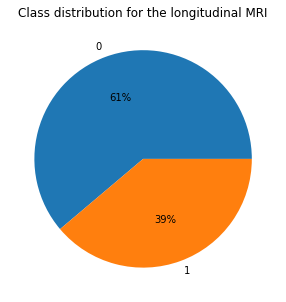

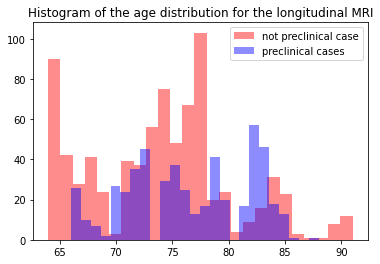

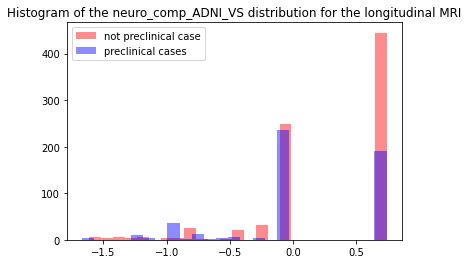

SystemExit: 

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\IPython\core\interactiveshell.py:3259: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


<Figure size 432x288 with 0 Axes>

In [37]:
for i in ["irm1", "irm2"]:
    new_d = dfs[i]
    plot = new_d[["diagnostic"]].value_counts().plot.pie(y="diagnostic", figsize=(5, 5), labels=[0,1], autopct='%1.0f%%')
    if i == "irm1":
        plt.title("Class distribution for the longitudinal MRI")
    if i == "irm2":
        plt.title("Class distribution for the cross-sectionnal MRI")
    
    plt.savefig("./graphs/new/class_distribution_"+i+".pdf", bbox_inches = 'tight')
    plt.show()
    plt.clf()
    
    # plotting two histograms on the same axis 
    plt.hist(new_d[new_d["diagnostic"] == 0]['age'], bins=25, alpha=0.45, color='red') 
    plt.hist(new_d[new_d["diagnostic"] == 1]['age'], bins=25, alpha=0.45, color='blue') 

    if i == "irm1":
        plt.title("Histogram of the age distribution for the longitudinal MRI")
    if i == "irm2":
        plt.title("Histogram of the age distribution for the cross-sectionnal MRI")

    plt.legend(['not preclinical case',  
                'preclinical cases']) 
    
    plt.savefig("./graphs/new/age_distribution"+i+".pdf", bbox_inches = 'tight')
    plt.show()
    plt.clf()
    if True:
        for col in new_d.columns:
            if "ADNI_VS" in col:
                plt.hist(new_d[new_d["diagnostic"] == 0][col], bins=25, alpha=0.45, color='red') 
                plt.hist(new_d[new_d["diagnostic"] == 1][col], bins=25, alpha=0.45, color='blue') 

                if i == "irm1":
                    plt.title("Histogram of the "+col+" distribution for the longitudinal MRI")
                if i == "irm2":
                    plt.title("Histogram of the "+col+" distribution for the cross-sectionnal MRI")

                plt.legend(['not preclinical case',  
                            'preclinical cases']) 
                plt.show()
                plt.clf()
                sys.exit()
        
        

,irmL_ST129SA,diagnostic
0,2296,1
1,2296,1
2,2296,1
3,2316,1
4,2316,1
...,...,...
1311,1942,0
1312,1942,0
1313,1942,0
1314,1942,1


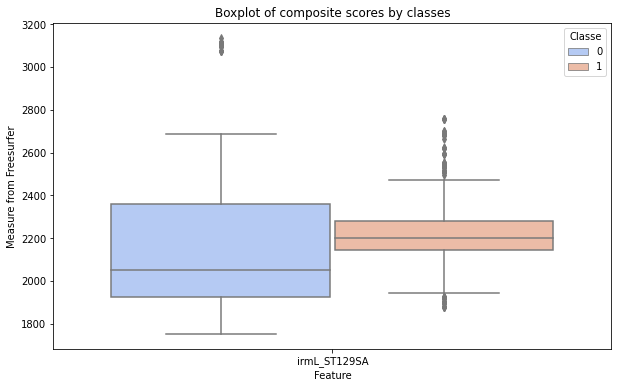

,irmL_ST128SV,diagnostic
0,3170,1
1,3170,1
2,3170,1
3,3273,1
4,3273,1
...,...,...
1311,3312,0
1312,3312,0
1313,3312,0
1314,3312,1


<Figure size 432x288 with 0 Axes>

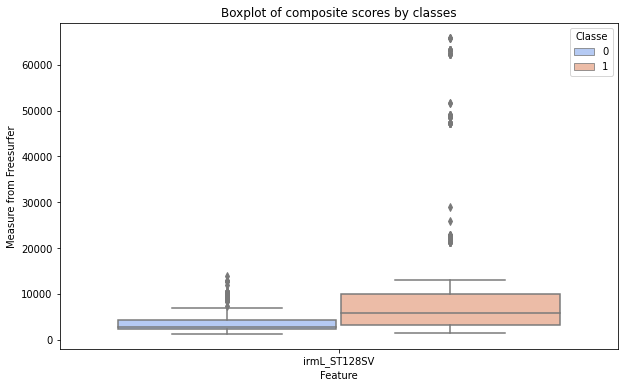

,irmL_ST31SA,diagnostic
0,4178,1
1,4178,1
2,4178,1
3,4164,1
4,4164,1
...,...,...
1311,4071,0
1312,4071,0
1313,4071,0
1314,4071,1


<Figure size 432x288 with 0 Axes>

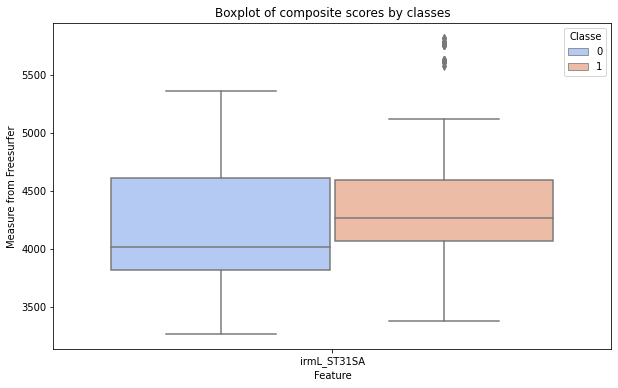

,irmL_ST68SV,diagnostic
0,58,1
1,58,1
2,58,1
3,63,1
4,63,1
...,...,...
1311,30,0
1312,30,0
1313,30,0
1314,30,1


<Figure size 432x288 with 0 Axes>

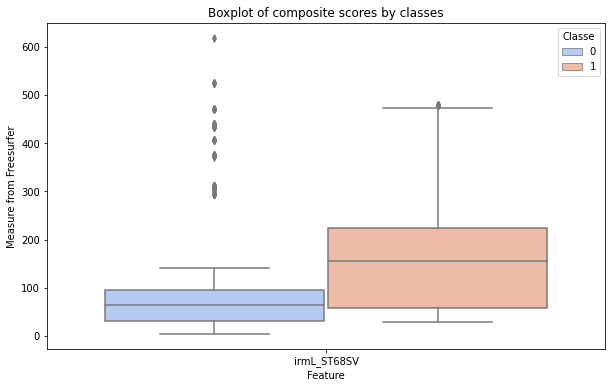

,irmL_ST26TS,diagnostic
0,0.618,1
1,0.618,1
2,0.618,1
3,0.625,1
4,0.625,1
...,...,...
1311,0.719,0
1312,0.719,0
1313,0.719,0
1314,0.719,1


<Figure size 432x288 with 0 Axes>

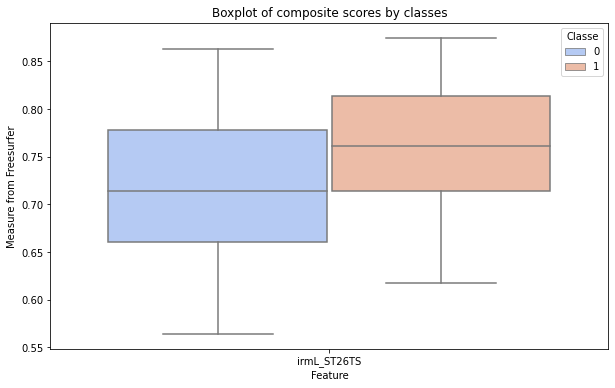

,neuro_comp_ADNI_LAN,diagnostic
0,0.276,1
1,0.276,1
2,0.276,1
3,0.276,1
4,0.276,1
...,...,...
1311,1.803,0
1312,1.803,0
1313,1.721,0
1314,1.803,1


<Figure size 432x288 with 0 Axes>

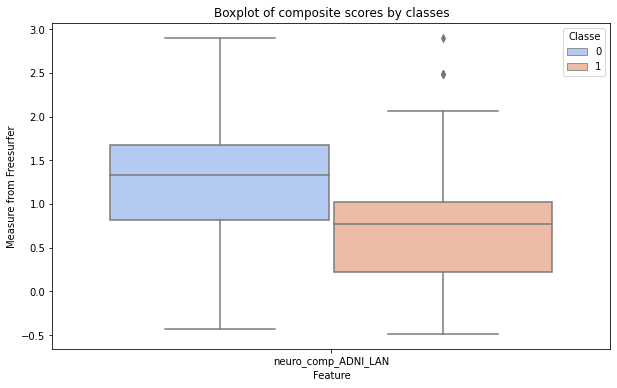

,irmL_ST106TA,diagnostic
0,2.198,1
1,2.198,1
2,2.198,1
3,2.217,1
4,2.217,1
...,...,...
1311,2.274,0
1312,2.274,0
1313,2.274,0
1314,2.274,1


<Figure size 432x288 with 0 Axes>

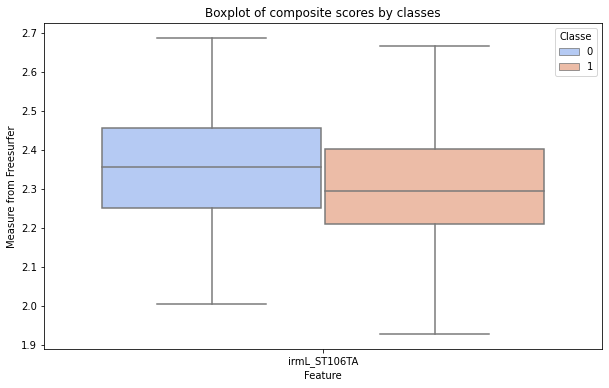

,neuro_ecog_MEMORY4,diagnostic
0,2,1
1,2,1
2,2,1
3,2,1
4,2,1
...,...,...
1311,2,0
1312,2,0
1313,2,0
1314,2,1


<Figure size 432x288 with 0 Axes>

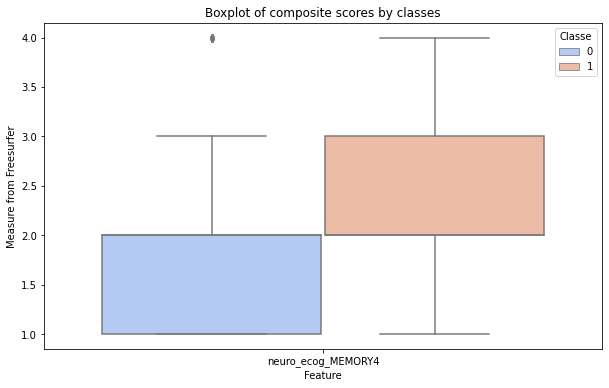

<Figure size 432x288 with 0 Axes>

In [23]:
rf = ["irmL_ST129SA", "irmL_ST128SV", "irmL_ST31SA", "irmL_ST68SV"]

svm = ["irmL_ST26TS", "neuro_comp_ADNI_LAN", "irmL_ST106TA", "neuro_ecog_MEMORY4"]
db_test = dfs["irm1"]
for ind, i_mod in enumerate([rf, svm]):
    if ind ==0: 
        name = "RF"
    else:
        name = "SVM"
    for i in i_mod:
        df_test = db_test[[i, "diagnostic"]].copy()
        display(df_test)
        # Transformer le DataFrame en un format long
        df_melted = df_test.melt(id_vars='diagnostic', var_name='Category', value_name='Score')

        # Créer le boxplot avec seaborn
        plt.figure(figsize=(10, 6))
        sns.boxplot(x='Category', y='Score', hue='diagnostic', data=df_melted, palette='coolwarm')

        # Ajouter des titres et des labels
        plt.title('Boxplot of composite scores by classes')
        plt.xlabel('Feature')
        plt.ylabel('Measure from Freesurfer')

        # Afficher la légende
        plt.legend(title='Classe')
        plt.savefig(name+"_"+i+"_feat_important.pdf", bbox_inches = 'tight')

        # Afficher le plot
        plt.show()
        plt.clf()

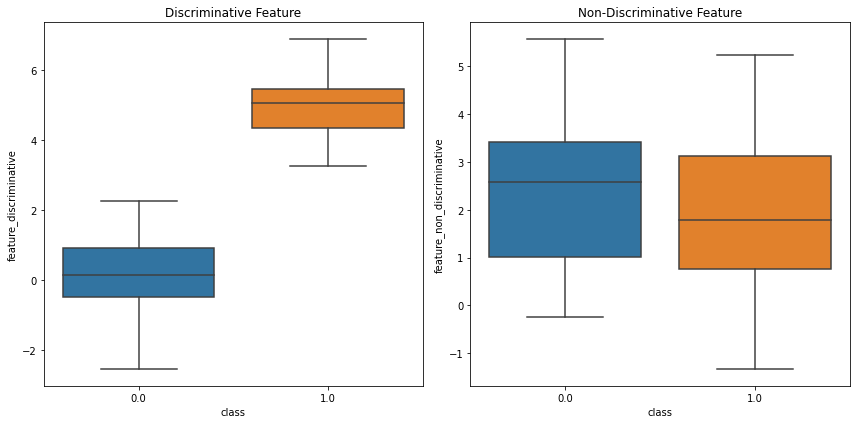

In [20]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Create synthetic dataset
np.random.seed(0)
data = {
    'feature_discriminative': np.concatenate([np.random.normal(0, 1, 50), np.random.normal(5, 1, 50)]),
    'feature_non_discriminative': np.random.normal(2, 1.5, 100),
    'class': np.concatenate([np.zeros(50), np.ones(50)])
}

df = pd.DataFrame(data)

# Plot boxplots
plt.figure(figsize=(12, 6))

# Discriminative feature
plt.subplot(1, 2, 1)
sns.boxplot(x='class', y='feature_discriminative', data=df)
plt.title('Discriminative Feature')

# Non-discriminative feature
plt.subplot(1, 2, 2)
sns.boxplot(x='class', y='feature_non_discriminative', data=df)
plt.title('Non-Discriminative Feature')

plt.tight_layout()
plt.show()


In [17]:
import numpy as np
import pandas as pd
from scipy.stats import shapiro, kstest, norm

# Création de données normalement distribuées
np.random.seed(0)
normal_data = np.random.normal(loc=0, scale=1, size=1000)

# Création de données non normalement distribuées (distribution uniforme)
uniform_data = np.random.uniform(low=-1, high=1, size=1000)

# Transformation des données en DataFrame pour faciliter l'analyse
df = pd.DataFrame({
    'Normal': normal_data,
    'Uniform': uniform_data
})
for i in ["irm1", "irm2"]:
    new_d = dfs[i]
    # Test de normalité Shapiro-Wilk
    shapiro_normal = shapiro(new_d['age'])

    print("Shapiro-Wilk Test for Normal Data:")
    print(f"Statistic: {shapiro_normal.statistic}, p-value: {shapiro_normal.pvalue}\n")


    # Test de Kolmogorov-Smirnov
    kstest_normal = kstest(new_d['age'], 'norm')

    print("Kolmogorov-Smirnov Test for Normal Data:")
    print(f"Statistic: {kstest_normal.statistic}, p-value: {kstest_normal.pvalue}\n")



Shapiro-Wilk Test for Normal Data:
Statistic: 0.9783088564872742, p-value: 3.580764157407046e-13

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 1.0, p-value: 0.0

Shapiro-Wilk Test for Normal Data:
Statistic: 0.9855883121490479, p-value: 2.58434089015977e-13

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 1.0, p-value: 0.0



In [23]:
for i in ["irm1", "irm2"]:
    df_excel = dfs[i]
    # Compute the correlation matrix
    corr_matrix = df_excel.corr()
    f = plt.figure(figsize=(19, 15))
    sns.heatmap(corr_matrix, xticklabels=False, yticklabels = False)
    plt.title('Correlation Matrix', fontsize=16)
    plt.savefig("./graphs/new/heatmap_pre_"+i+".pdf", bbox_inches = 'tight')
    plt.clf()
    if False:
        # Masquer les valeurs dupliquées en conservant uniquement le triangle inférieur de la matrice
        mask = np.tril(np.ones(corr_matrix.shape), k=-1).astype(bool)
        corr_matrix_lower = corr_matrix.where(mask)

        # Transformer la matrice en une série, supprimer les NaN et trier par ordre décroissant
        sorted_corr = corr_matrix_lower.unstack().dropna().sort_values(ascending=False)

        # Sélectionner les 10 premières paires de caractéristiques les plus corrélées
        top_10_pairs = sorted_corr.head(10)

        # Afficher les résultats
        print("Top 10 des paires de caractéristiques les plus corrélées :")
        print(top_10_pairs)

<Figure size 1368x1080 with 0 Axes>

<Figure size 1368x1080 with 0 Axes>

['neuro_comp_ADNI_MEM', 'neuro_comp_ADNI_EF', 'neuro_comp_ADNI_LAN', 'neuro_comp_ADNI_VS']


,ADNI_MEM,ADNI_EF,ADNI_LAN,ADNI_VS,diagnostic
0,0.763,0.044,0.276,-0.080,1
1,0.763,0.044,0.276,-0.080,1
2,0.763,0.044,0.276,-0.080,1
3,0.763,0.044,0.276,-0.080,1
4,0.763,0.044,0.276,-0.080,1
...,...,...,...,...,...
1311,1.294,1.755,1.803,-0.080,0
1312,1.294,1.755,1.803,-0.080,0
1313,1.383,1.807,1.721,0.739,0
1314,1.294,1.755,1.803,-0.080,1


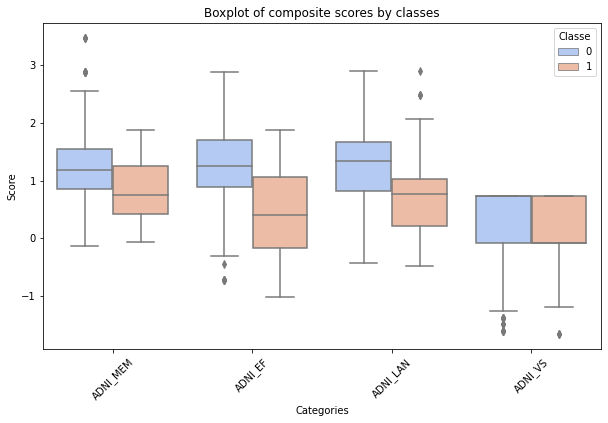

['neuro_comp_ADNI_MEM', 'neuro_comp_ADNI_EF', 'neuro_comp_ADNI_LAN', 'neuro_comp_ADNI_VS']


,ADNI_MEM,ADNI_EF,ADNI_LAN,ADNI_VS,diagnostic
0,0.763,0.044,0.276,-0.080,1
1,0.763,0.044,0.276,-0.080,1
2,0.763,0.044,0.276,-0.080,1
3,0.763,0.044,0.276,-0.080,1
4,0.763,0.044,0.276,-0.080,1
...,...,...,...,...,...
1995,2.496,1.822,0.885,0.739,0
1996,2.496,1.822,0.885,0.739,0
1997,1.795,1.470,0.144,-0.431,0
1998,2.496,1.822,0.885,0.739,0


<Figure size 432x288 with 0 Axes>

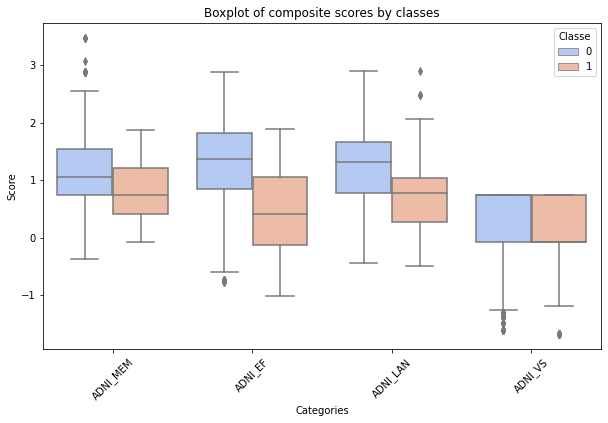

<Figure size 432x288 with 0 Axes>

In [36]:
for i in ["irm1", "irm2"]:
    df_excel = dfs[i]
    comp_feat = [x for x in df_excel.columns if any(term in x for term in ["ADNI_MEM",  "ADNI_EF",  "ADNI_LAN",  "ADNI_VS"]) and "ADNI_EF2" not in x]
    print(comp_feat)
    df_test = df_excel[comp_feat+["diagnostic"]].copy()
    dic = dict()
    for i in comp_feat:
        dic[i] = i.split("neuro_comp_")[-1]
    df_test.rename(columns=dic, inplace=True)
    display(df_test)
    # Transformer le DataFrame en un format long
    df_melted = df_test.melt(id_vars='diagnostic', var_name='Category', value_name='Score')

    # Créer le boxplot avec seaborn
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='Category', y='Score', hue='diagnostic', data=df_melted, palette='coolwarm')

    # Ajouter des titres et des labels
    plt.title('Boxplot of composite scores by classes')
    plt.xlabel('Categories')
    plt.ylabel('Score')
    plt.xticks(rotation=45)

    # Afficher la légende
    plt.legend(title='Classe')
    plt.savefig("graphs/new/pre_"+i+"_composite_score_by_class.pdf", bbox_inches = 'tight')

    # Afficher le plot
    plt.show()
    plt.clf()


In [21]:
# Supposons que df soit votre DataFrame
# Vous devez avoir calculé préalablement la matrice de corrélation corr_matrix
correlated_pairs = set()
for data_strat, prefix in [["irm1", "irmL_"], ["irm2", "irmC_"]]:
    df_excel = dfs[data_strat].copy()
    display(df_excel)
    corr_matrix = df_excel.corr()
    # Trouver les paires de colonnes corrélées à plus de 90%
    if len(correlated_pairs) == 0:
        for i in range(len(corr_matrix.columns)):
            for j in range(i+1, len(corr_matrix.columns)):
                if abs(corr_matrix.iloc[i, j]) > 0.9:
                    correlated_pairs.add(("".join(corr_matrix.columns[i].split(prefix)), "".join(corr_matrix.columns[j].split(prefix))))

    # Supprimer une colonne de chaque paire et renommer la colonne restante
    for col1, col2 in correlated_pairs:
        if prefix+col1 in df_excel.columns and prefix+col2 in df_excel.columns:
            # Supprimer une colonne de chaque paire
            df_excel.drop(columns=[prefix+col1], inplace=True)
            # Renommer la colonne restante par la jointure des noms des deux colonnes
            new_col_name = prefix+col1+"_"+col2
            df_excel.rename(columns={prefix+col2: new_col_name}, inplace=True)
    print("END")
    # Afficher le DataFrame résultant
    display(df_excel)
    print(correlated_pairs)
    print(len(correlated_pairs))
    
    dfs[data_strat] = df_excel.copy()

print(dfs)

,RID,diagnostic,irmL_ST149SV,irmL_ST28SA,irmL_ST87SA,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
1,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
2,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
3,23,1,407591,79346.9,84146.0,22479,713,294,347,220,...,1,1,1,1,1,1,1,1,33,77
4,23,1,407591,79346.9,84146.0,22479,713,294,347,220,...,1,1,1,1,1,1,1,1,33,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,69
1312,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70
1313,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,2,1,1,1,1,1,1,1,34,70
1314,4767,1,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70


END


,RID,diagnostic,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST9SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,23,1,22480,712,278,345,230,787,1548,2099,...,1,1,1,1,1,1,1,1,33,76
1,23,1,22480,712,278,345,230,787,1548,2099,...,1,1,1,1,1,1,1,1,33,76
2,23,1,22480,712,278,345,230,787,1548,2099,...,1,1,1,1,1,1,1,1,33,76
3,23,1,22479,713,294,347,220,767,1612,2014,...,1,1,1,1,1,1,1,1,33,77
4,23,1,22479,713,294,347,220,767,1612,2014,...,1,1,1,1,1,1,1,1,33,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,4767,0,17495,627,290,276,226,768,1463,2385,...,3,2,1,1,1,1,1,1,34,69
1312,4767,0,17495,627,290,276,226,768,1463,2385,...,3,2,1,1,1,1,1,1,34,70
1313,4767,0,17495,627,290,276,226,768,1463,2385,...,2,1,1,1,1,1,1,1,34,70
1314,4767,1,17495,627,290,276,226,768,1463,2385,...,3,2,1,1,1,1,1,1,34,70


{('ST74SA', 'ST74CV'), ('ST16SV', 'ST75SV'), ('ST154SV', 'ST155SV'), ('ST150SV', 'ST152SV'), ('ST149SV', 'ST147SV'), ('ST45SA', 'ST45CV'), ('ST104SA', 'ST104CV'), ('ST87SA', 'ST155SV'), ('ST140HS', 'ST141HS'), ('ST148SV', 'ST154SV'), ('ST29SV', 'ST133HS'), ('ST149SV', 'ST154SV'), ('ST48SA', 'ST48CV'), ('ST18SV', 'ST77SV'), ('ST17SV', 'ST153SV'), ('ST17SV', 'ST76SV'), ('ST87SA', 'ST55SA'), ('ST151SV', 'ST152SV'), ('ST91SA', 'ST91CV'), ('ST147SV', 'ST148SV'), ('ST132HS', 'ST133HS'), ('ST61SV', 'ST120SV'), ('ST107SA', 'ST107CV'), ('ST52CV', 'ST147SV'), ('ST150SV', 'ST151SV'), ('ST28SA', 'ST52SA'), ('ST28SA', 'ST55SA'), ('ST28SA', 'ST87SA'), ('ST149SV', 'ST52CV'), ('ST53SV', 'ST112SV'), ('ST111SA', 'ST111CV'), ('ST37SV', 'ST96SV'), ('ST76SV', 'ST153SV'), ('neuro_comp_ADNI_EF', 'neuro_comp_ADNI_EF2'), ('ST147SV', 'ST154SV'), ('ST149SV', 'ST148SV'), ('ST72SA', 'ST72CV')}
37


,RID,diagnostic,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST102TA,irmC_ST102TS,irmC_ST103CV,irmC_ST103SA,irmC_ST103TA,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
1,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
2,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
3,23,1,1245,2783,1114,2.395,0.576,1796,614,2.575,...,1,1,1,1,1,1,1,1,33,77
4,23,1,1245,2783,1114,2.395,0.576,1796,614,2.575,...,1,1,1,1,1,1,1,1,33,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,4543,0,1275,3601,1545,2.326,0.640,2171,680,2.840,...,3,1,1,1,1,1,1,1,33,74
1996,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,1,1,1,1,1,1,1,33,74
1997,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,2,1,1,1,1,1,1,33,74
1998,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,1,1,1,1,1,1,1,33,75


END


,RID,diagnostic,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST102TA,irmC_ST102TS,irmC_ST103CV,irmC_ST103SA,irmC_ST103TA,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
1,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
2,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
3,23,1,1245,2783,1114,2.395,0.576,1796,614,2.575,...,1,1,1,1,1,1,1,1,33,77
4,23,1,1245,2783,1114,2.395,0.576,1796,614,2.575,...,1,1,1,1,1,1,1,1,33,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,4543,0,1275,3601,1545,2.326,0.640,2171,680,2.840,...,3,1,1,1,1,1,1,1,33,74
1996,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,1,1,1,1,1,1,1,33,74
1997,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,2,1,1,1,1,1,1,33,74
1998,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,1,1,1,1,1,1,1,33,75


{('ST74SA', 'ST74CV'), ('ST16SV', 'ST75SV'), ('ST154SV', 'ST155SV'), ('ST150SV', 'ST152SV'), ('ST149SV', 'ST147SV'), ('ST45SA', 'ST45CV'), ('ST104SA', 'ST104CV'), ('ST87SA', 'ST155SV'), ('ST140HS', 'ST141HS'), ('ST148SV', 'ST154SV'), ('ST29SV', 'ST133HS'), ('ST149SV', 'ST154SV'), ('ST48SA', 'ST48CV'), ('ST18SV', 'ST77SV'), ('ST17SV', 'ST153SV'), ('ST17SV', 'ST76SV'), ('ST87SA', 'ST55SA'), ('ST151SV', 'ST152SV'), ('ST91SA', 'ST91CV'), ('ST147SV', 'ST148SV'), ('ST132HS', 'ST133HS'), ('ST61SV', 'ST120SV'), ('ST107SA', 'ST107CV'), ('ST52CV', 'ST147SV'), ('ST150SV', 'ST151SV'), ('ST28SA', 'ST52SA'), ('ST28SA', 'ST55SA'), ('ST28SA', 'ST87SA'), ('ST149SV', 'ST52CV'), ('ST53SV', 'ST112SV'), ('ST111SA', 'ST111CV'), ('ST37SV', 'ST96SV'), ('ST76SV', 'ST153SV'), ('neuro_comp_ADNI_EF', 'neuro_comp_ADNI_EF2'), ('ST147SV', 'ST154SV'), ('ST149SV', 'ST148SV'), ('ST72SA', 'ST72CV')}
37
{'irm1':        RID  diagnostic  irmL_ST1SV  irmL_ST2SV  irmL_ST3SV  irmL_ST4SV  \
0       23           1       22480  

In [67]:
dfs.keys()

dict_keys(['irm1', 'irm2'])

In [18]:
# keep only same patiens

from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler

df1 = dfs["irm1"]
df2 = dfs["irm2"]

df1_cop = df1.copy()
df2_cop = df2.copy()
display(df1)
display(df2)



#########################################################################################################
############################### BOTH ###########################################################
###########################################################################################################

######## PREMIER####################################

distance1 = len(df1[df1["diagnostic"] == 0]) - len(df1[df1["diagnostic"] == 1])

ros = RandomOverSampler(random_state=0, sampling_strategy={1: int(len(df1[df1["diagnostic"] == 1]) + (distance1/2))})
rus = RandomUnderSampler(random_state=0, sampling_strategy={0: int(len(df1[df1["diagnostic"] == 0]) - (distance1/2))})

# Apply oversampling to the minority class
X_resampled, y_resampled = ros.fit_resample(df1.drop(columns=["diagnostic"]), df1["diagnostic"])

df_resampled = pd.DataFrame(X_resampled, columns=df1.columns)
df_resampled['diagnostic'] = y_resampled

X_final, y_final = rus.fit_resample(df_resampled.drop('diagnostic', axis=1), df_resampled['diagnostic'])

df1 = pd.DataFrame(X_final, columns=df1.columns)
df1['diagnostic'] = y_final
df1.reset_index(inplace=True, drop=True)

print(df1['diagnostic'].value_counts())


######## DEUXIEME ####################################

distance2 = len(df2[df2["diagnostic"] == 0]) - len(df2[df2["diagnostic"] == 1])

ros = RandomOverSampler(random_state=0, sampling_strategy={1: int(len(df2[df2["diagnostic"] == 1]) + (distance2/2))})
rus = RandomUnderSampler(random_state=0, sampling_strategy={0: int(len(df2[df2["diagnostic"] == 0]) - (distance2/2))})


# Apply oversampling to the minority class
X_resampled, y_resampled = ros.fit_resample(df2.drop(columns=["diagnostic"]), df2["diagnostic"])

df_resampled = pd.DataFrame(X_resampled, columns=df2.columns)
df_resampled['diagnostic'] = y_resampled

X_final, y_final = rus.fit_resample(df_resampled.drop('diagnostic', axis=1), df_resampled['diagnostic'])

df2 = pd.DataFrame(X_final, columns=df2.columns)
df2['diagnostic'] = y_final
df2.reset_index(inplace=True, drop=True)

print(df2['diagnostic'].value_counts())

#########################################################################################################
############################### Undersampling ###########################################################
###########################################################################################################

rus = RandomUnderSampler(random_state=0)

X_copy, y_copy = rus.fit_resample(df1_cop.drop(columns=["diagnostic"]), df1_cop["diagnostic"])
df1_under = pd.DataFrame(X_copy.copy(), columns=df1_cop.columns)
df1_under['diagnostic'] = y_copy.copy()
df1_under.reset_index(inplace=True, drop=True)


X_copy, y_copy = rus.fit_resample(df2_cop.drop(columns=["diagnostic"]), df2_cop["diagnostic"])
df2_under = pd.DataFrame(X_copy.copy(), columns=df2_cop.columns)
df2_under['diagnostic'] = y_copy.copy()
df2_under.reset_index(inplace=True, drop=True)

print("END")
display(df1)
display(df2)
display(df1_under)
display(df2_under)
print(df1_under["diagnostic"].value_counts())
print(df2_under["diagnostic"].value_counts())

dfs = {}
dfs["irm1_both"] = df1.copy()
dfs["irm2_both"] = df2.copy()
dfs["irm1_under"] = df1_under.copy()
dfs["irm2_under"] = df2_under.copy()

,RID,diagnostic,irmL_ST149SV,irmL_ST28SA,irmL_ST87SA,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
1,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
2,23,1,408123,79623.0,84382.4,22480,712,278,345,230,...,1,1,1,1,1,1,1,1,33,76
3,23,1,407591,79346.9,84146.0,22479,713,294,347,220,...,1,1,1,1,1,1,1,1,33,77
4,23,1,407591,79346.9,84146.0,22479,713,294,347,220,...,1,1,1,1,1,1,1,1,33,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,69
1312,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70
1313,4767,0,373676,73578.2,77589.1,17495,627,290,276,226,...,2,1,1,1,1,1,1,1,34,70
1314,4767,1,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70


,RID,diagnostic,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST102TA,irmC_ST102TS,irmC_ST103CV,irmC_ST103SA,irmC_ST103TA,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
1,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
2,23,1,1421,3123,1312,2.195,0.499,1949,666,2.640,...,1,1,1,1,1,1,1,1,33,76
3,23,1,1245,2783,1114,2.395,0.576,1796,614,2.575,...,1,1,1,1,1,1,1,1,33,77
4,23,1,1245,2783,1114,2.395,0.576,1796,614,2.575,...,1,1,1,1,1,1,1,1,33,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,4543,0,1275,3601,1545,2.326,0.640,2171,680,2.840,...,3,1,1,1,1,1,1,1,33,74
1996,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,1,1,1,1,1,1,1,33,74
1997,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,2,1,1,1,1,1,1,33,74
1998,4543,0,1339,3881,1576,2.385,0.573,2215,688,2.808,...,3,1,1,1,1,1,1,1,33,75


0    658
1    658
Name: diagnostic, dtype: int64
0    1000
1    1000
Name: diagnostic, dtype: int64
END


,RID,diagnostic,irmL_ST149SV,irmL_ST28SA,irmL_ST87SA,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,413,0,454434,80131.7,86234.2,20197,729,353,344,296,...,0,1,1,1,1,1,1,1,33,83
1,4082,0,478780,96644.3,102273.0,26264,915,432,371,376,...,2,2,1,1,1,1,1,1,34,76
2,4076,0,399816,73015.9,79015.4,20655,786,349,369,258,...,3,1,1,1,1,1,1,1,33,73
3,4119,0,455496,88619.2,95495.0,22801,703,323,335,334,...,3,3,1,1,1,1,1,1,33,79
4,4121,0,399696,86669.5,89494.5,17559,495,264,310,221,...,2,1,1,1,1,1,1,1,33,89
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,4092,1,432461,79739.9,86244.3,18257,707,337,292,226,...,1,2,1,1,1,1,1,1,33,82
1312,4014,1,475992,91509.9,100047.0,21056,808,386,389,272,...,3,1,1,1,1,1,1,1,33,81
1313,4587,1,405195,73206.2,79165.9,18745,782,339,342,303,...,1,1,1,1,1,1,1,1,34,66
1314,4278,1,430821,76969.8,82328.8,21409,589,292,210,249,...,1,1,1,1,1,1,1,1,34,76


,RID,diagnostic,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST102TA,irmC_ST102TS,irmC_ST103CV,irmC_ST103SA,irmC_ST103TA,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,4164,0,1762,2495,1151,2.102,0.728,1895,675,2.384,...,3,1,1,1,1,1,1,1,33,74
1,4464,0,1539,3679,1299,2.599,0.668,2056,647,2.677,...,1,1,1,1,1,1,1,1,34,71
2,4076,0,1435,3498,1591,2.087,0.688,1840,628,2.483,...,3,1,1,1,1,1,1,1,33,74
3,4585,0,1526,3175,1393,2.101,0.648,2275,619,2.971,...,2,1,1,1,1,1,1,1,23,67
4,4401,0,1493,3685,1462,2.333,0.588,2091,670,2.701,...,1,1,1,1,1,1,1,1,34,68
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,4120,1,1336,3148,1290,2.164,0.580,1849,595,2.690,...,0,3,1,1,1,1,1,1,33,82
1996,4290,1,1625,4084,1510,2.451,0.707,1651,594,2.479,...,1,2,1,1,1,1,1,1,34,73
1997,4198,1,1299,3522,1438,2.273,0.648,2034,626,2.737,...,1,1,1,1,1,1,1,1,34,79
1998,4086,1,1312,2445,1123,1.967,0.625,1757,593,2.502,...,2,2,1,1,1,1,1,1,33,82


,RID,diagnostic,irmL_ST149SV,irmL_ST28SA,irmL_ST87SA,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,413,0,454434,80131.7,86234.2,20197,729,353,344,296,...,0,1,1,1,1,1,1,1,33,83
1,4082,0,478780,96644.3,102273.0,26264,915,432,371,376,...,2,2,1,1,1,1,1,1,34,76
2,4076,0,399816,73015.9,79015.4,20655,786,349,369,258,...,3,1,1,1,1,1,1,1,33,73
3,4119,0,455496,88619.2,95495.0,22801,703,323,335,334,...,3,3,1,1,1,1,1,1,33,79
4,4121,0,399696,86669.5,89494.5,17559,495,264,310,221,...,2,1,1,1,1,1,1,1,33,89
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,4767,1,387084,75194.0,80084.3,17955,664,278,291,239,...,2,1,1,1,1,1,1,1,34,68
1018,4767,1,354728,75128.0,80264.0,17743,592,266,269,217,...,2,1,1,1,1,1,1,1,34,69
1019,4767,1,354728,75128.0,80264.0,17743,592,266,269,217,...,2,1,1,1,1,1,1,1,34,69
1020,4767,1,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70


,RID,diagnostic,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST102TA,irmC_ST102TS,irmC_ST103CV,irmC_ST103SA,irmC_ST103TA,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,4164,0,1762,2495,1151,2.102,0.728,1895,675,2.384,...,3,1,1,1,1,1,1,1,33,74
1,4464,0,1539,3679,1299,2.599,0.668,2056,647,2.677,...,1,1,1,1,1,1,1,1,34,71
2,4076,0,1435,3498,1591,2.087,0.688,1840,628,2.483,...,3,1,1,1,1,1,1,1,33,74
3,4585,0,1526,3175,1393,2.101,0.648,2275,619,2.971,...,2,1,1,1,1,1,1,1,23,67
4,4401,0,1493,3685,1462,2.333,0.588,2091,670,2.701,...,1,1,1,1,1,1,1,1,34,68
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,4767,1,1281,3489,1484,2.091,0.585,1459,494,2.467,...,2,1,1,1,1,1,1,1,34,68
1224,4767,1,1189,3361,1557,2.012,0.617,1598,544,2.523,...,2,1,1,1,1,1,1,1,34,69
1225,4767,1,1189,3361,1557,2.012,0.617,1598,544,2.523,...,2,1,1,1,1,1,1,1,34,69
1226,4767,1,1202,2998,1283,2.117,0.656,1503,515,2.479,...,3,2,1,1,1,1,1,1,34,70


0    511
1    511
Name: diagnostic, dtype: int64
0    614
1    614
Name: diagnostic, dtype: int64


In [19]:
recup = False

if recup:

    path = "backup_models/preclinical/RF/without_fs/auc_roc/18-05-2024_21h34m30s/test_train_set"
    dfs = {}
    for file in os.listdir(path):
        if "depth_10_" in file:
            filename = file
            file = file.split(".")[0]
            file = file.split("depth_10_")[1]
            file = file.split("_score")[0]
            if file not in dfs:
                dfs[file] = pd.read_csv(path+"/"+filename, index_col=0)
            else:
                dfs[file] = pd.concat([dfs[file], pd.read_csv(path+"/"+filename, index_col=0)])
            print(file)
    for k in dfs:
        print(k)
        dfs[k].rename(columns={"y": "diagnostic"}, inplace=True)
        print(dfs[k]["diagnostic"].value_counts())
        display(dfs[k])

In [20]:
if False:
    print(dfs.keys())

    for k in dfs:
        display(dfs[k])
        dfs[k].to_csv("./backup_models/preclinical/basic_"+k+".csv")

# Prédictions

In [21]:
feat_selec = "without_fs"
target_nbr = 350
new_dbs = {}

if not recup:
    for title_irm in dfs:
        print(title_irm)
        df = dfs[title_irm].copy()
        display(df)
        df.reset_index(inplace=True, drop=True)
        y = df[["diagnostic"]].copy()
        X = df.drop(columns=["diagnostic"])
        grouping = X["RID"].copy()
        X.drop(columns=["RID"], inplace=True)


        print(y["diagnostic"].value_counts())
        scaler = StandardScaler()

        # 2 Stratégies DB: APOE en one hot encoded et seulement le nombre d'allele 4

        # Strategies 1: Nbr allele 4
        print("strategies 1")
        X_copy = X.copy()
        X_copy["APOE_nbr_allelle_4"] = X_copy.apply(lambda x: str(x['APOE']).count("4"), axis=1)
        X_copy.drop(columns=["APOE"], inplace=True)
        
        
        
        # Normalise
        col_2_scale = [x for x in X_copy.columns if "neuro_comp" in x]
        not_scaled = []
        for col in X_copy.columns:
            if len(X_copy[col].unique()) != 2 and col != "APOE_nbr_allelle_4":
                col_2_scale.append(col)
            elif (1 not in X_copy[col].unique() or 0 not in X_copy[col].unique()) and col != "APOE_nbr_allelle_4":
                col_2_scale.append(col)
            else:
                not_scaled.append(col)
        print("not scale for strat 2: "+str(not_scaled))
        X_copy[col_2_scale] = scaler.fit_transform(X_copy[col_2_scale], y["diagnostic"])

        #feature selection
        fs = SelectKBest(score_func=f_classif, k=target_nbr)
        fs.fit(X_copy, y["diagnostic"])

        if feat_selec == "with_fs":
            X_new = fs.transform(X_copy)
            X_copy = pd.DataFrame(X_new, columns=fs.get_feature_names_out())

        print(title_irm+"_APOE_nbr_allelle_4")
        display(X_copy)
        new_dbs[title_irm+"_APOE_nbr_allelle_4"] = [X_copy.copy(), y.copy(), fs, grouping]

        # Strategies 2: one hot encoded
        print("strategies 2")
        X_copy = X.copy()
        X_copy = pd.get_dummies(X_copy, columns=["APOE"])
        
        
        # normalise
        col_2_scale = [x for x in X_copy.columns if "neuro_comp" in x]
        not_scaled = []
        for col in X_copy.columns:
            if len(X_copy[col].unique()) != 2:
                col_2_scale.append(col)
            elif 1 not in X_copy[col].unique() or 0 not in X_copy[col].unique():
                col_2_scale.append(col)
            else:
                not_scaled.append(col)
        print("not scale for strat 2: "+str(not_scaled))
        X_copy[col_2_scale] = scaler.fit_transform(X_copy[col_2_scale], y["diagnostic"])
        
        #Feature selection
        fs = SelectKBest(score_func=f_classif, k=target_nbr)
        fs.fit(X_copy, y["diagnostic"])

        if feat_selec == "with_fs":
            X_new = fs.transform(X_copy)
            X_copy = pd.DataFrame(X_new, columns=fs.get_feature_names_out())


        print(title_irm+"_APOE_one_hot")
        display(X_copy)
        new_dbs[title_irm+"_APOE_one_hot"] = [X_copy.copy(), y.copy(), fs, grouping]
    print(new_dbs.keys())


if feat_selec == "with_fs":
    name=[]
    column_dfs = []
    for i in new_dbs:
        name.append(i)
        column_dfs.append(set(new_dbs[i][0].columns))
        
    # Création d'un dictionnaire pour stocker les ensembles en utilisant leurs éléments concaténés comme clés
    sets_dict = {}

    # Parcours des listes
    for nom, ensemble in zip(name, column_dfs):
        # Convertir l'ensemble en tuple trié pour l'utiliser comme clé dans le dictionnaire
        ensemble_trié = tuple(sorted(ensemble))
        # Vérifier si l'ensemble existe déjà dans le dictionnaire
        if ensemble_trié in sets_dict:
            # Fusionner les noms
            sets_dict[ensemble_trié] += "-"+nom
        else:
            # Ajouter le nom et l'ensemble dans le dictionnaire
            sets_dict[ensemble_trié] = nom

    # Extraire les noms uniques et les ensembles correspondants
    nouveaux_noms = []
    ensembles_uniques = []
    for ensemble, nom in sets_dict.items():
        nouveaux_noms.append(nom)
        ensembles_uniques.append(set(ensemble))
    print(nouveaux_noms)  # Sortie : ["ACD", "B"]
    new_new_dbs = {}
    for name in nouveaux_noms:
        new_new_dbs["_".join(name.split("-"))] = new_dbs[name.split("-")[0]].copy()
    # ba exvivo garde le amy 3 pos, 
    print(new_new_dbs.keys())
    new_dbs = new_new_dbs.copy()

irm1_both


,RID,diagnostic,irmL_ST149SV,irmL_ST28SA,irmL_ST87SA,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,413,0,454434,80131.7,86234.2,20197,729,353,344,296,...,0,1,1,1,1,1,1,1,33,83
1,4082,0,478780,96644.3,102273.0,26264,915,432,371,376,...,2,2,1,1,1,1,1,1,34,76
2,4076,0,399816,73015.9,79015.4,20655,786,349,369,258,...,3,1,1,1,1,1,1,1,33,73
3,4119,0,455496,88619.2,95495.0,22801,703,323,335,334,...,3,3,1,1,1,1,1,1,33,79
4,4121,0,399696,86669.5,89494.5,17559,495,264,310,221,...,2,1,1,1,1,1,1,1,33,89
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,4092,1,432461,79739.9,86244.3,18257,707,337,292,226,...,1,2,1,1,1,1,1,1,33,82
1312,4014,1,475992,91509.9,100047.0,21056,808,386,389,272,...,3,1,1,1,1,1,1,1,33,81
1313,4587,1,405195,73206.2,79165.9,18745,782,339,342,303,...,1,1,1,1,1,1,1,1,34,66
1314,4278,1,430821,76969.8,82328.8,21409,589,292,210,249,...,1,1,1,1,1,1,1,1,34,76


0    658
1    658
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_both_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [390] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST149SV,irmL_ST28SA,irmL_ST87SA,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,0.858663,0.187438,0.245022,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,...,-1.794235,-0.628462,1,1,1,1,1,1,1.308682,0
1,1.403192,2.360322,2.267488,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,...,0.454540,0.669899,1,1,1,1,1,1,0.129191,1
2,-0.362938,-0.748927,-0.665256,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,...,1.578927,-0.628462,1,1,1,1,1,1,-0.376305,0
3,0.882416,1.304303,1.412794,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,...,1.578927,1.968261,1,1,1,1,1,1,0.634687,0
4,-0.365622,1.047743,0.656141,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,...,0.454540,-0.628462,1,1,1,1,1,1,2.319674,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,0.367209,0.135881,0.246296,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,...,-0.669848,0.669899,1,1,1,1,1,1,1.140183,0
1312,1.340835,1.684689,1.986794,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,...,1.578927,-0.628462,1,1,1,1,1,1,0.971684,0
1313,-0.242630,-0.723885,-0.646279,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,...,-0.669848,-0.628462,1,1,1,1,1,1,-1.555796,1
1314,0.330528,-0.228635,-0.247442,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,...,-0.669848,-0.628462,1,1,1,1,1,1,0.129191,1


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_both_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [390] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST149SV,irmL_ST28SA,irmL_ST87SA,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,...,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_23,APOE_33,APOE_34,APOE_44
0,0.858663,0.187438,0.245022,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,...,1,1,1,1,1,1.308682,0,1,0,0
1,1.403192,2.360322,2.267488,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,...,1,1,1,1,1,0.129191,0,0,1,0
2,-0.362938,-0.748927,-0.665256,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,...,1,1,1,1,1,-0.376305,0,1,0,0
3,0.882416,1.304303,1.412794,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,...,1,1,1,1,1,0.634687,0,1,0,0
4,-0.365622,1.047743,0.656141,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,...,1,1,1,1,1,2.319674,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,0.367209,0.135881,0.246296,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,...,1,1,1,1,1,1.140183,0,1,0,0
1312,1.340835,1.684689,1.986794,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,...,1,1,1,1,1,0.971684,0,1,0,0
1313,-0.242630,-0.723885,-0.646279,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,...,1,1,1,1,1,-1.555796,0,0,1,0
1314,0.330528,-0.228635,-0.247442,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,...,1,1,1,1,1,0.129191,0,0,1,0


irm2_both


,RID,diagnostic,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST102TA,irmC_ST102TS,irmC_ST103CV,irmC_ST103SA,irmC_ST103TA,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,4164,0,1762,2495,1151,2.102,0.728,1895,675,2.384,...,3,1,1,1,1,1,1,1,33,74
1,4464,0,1539,3679,1299,2.599,0.668,2056,647,2.677,...,1,1,1,1,1,1,1,1,34,71
2,4076,0,1435,3498,1591,2.087,0.688,1840,628,2.483,...,3,1,1,1,1,1,1,1,33,74
3,4585,0,1526,3175,1393,2.101,0.648,2275,619,2.971,...,2,1,1,1,1,1,1,1,23,67
4,4401,0,1493,3685,1462,2.333,0.588,2091,670,2.701,...,1,1,1,1,1,1,1,1,34,68
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,4120,1,1336,3148,1290,2.164,0.580,1849,595,2.690,...,0,3,1,1,1,1,1,1,33,82
1996,4290,1,1625,4084,1510,2.451,0.707,1651,594,2.479,...,1,2,1,1,1,1,1,1,34,73
1997,4198,1,1299,3522,1438,2.273,0.648,2034,626,2.737,...,1,1,1,1,1,1,1,1,34,79
1998,4086,1,1312,2445,1123,1.967,0.625,1757,593,2.502,...,2,2,1,1,1,1,1,1,33,82


0    1000
1    1000
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_both_APOE_nbr_allelle_4


,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST102TA,irmC_ST102TS,irmC_ST103CV,irmC_ST103SA,irmC_ST103TA,irmC_ST103TS,irmC_ST104CV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,1.757226,-1.740922,-1.278593,-0.893458,2.259361,-0.328114,0.391684,-1.367214,1.643003,-0.698074,...,1.514540,-0.569821,1,1,1,1,1,1,-0.214656,0
1,0.564149,0.570305,-0.494554,1.926659,1.169383,0.228175,0.066090,-0.002669,-0.820536,2.413644,...,-0.646773,-0.569821,1,1,1,1,1,1,-0.687641,1
2,0.007736,0.216984,1.052334,-0.978572,1.532709,-0.518151,-0.154849,-0.906156,-0.048512,-0.647913,...,1.514540,-0.569821,1,1,1,1,1,1,-0.214656,0
3,0.494597,-0.413528,0.003417,-0.899132,0.806057,0.984867,-0.259504,1.366534,1.816491,0.844812,...,0.433884,-0.569821,1,1,1,1,1,1,-1.318288,0
4,0.318043,0.582017,0.368949,0.417301,-0.283921,0.349108,0.333542,0.109103,-0.777164,0.346661,...,-0.646773,-0.569821,1,1,1,1,1,1,-1.160626,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.521926,-0.466234,-0.542232,-0.541653,-0.429252,-0.487054,-0.538585,0.057874,-0.542954,-0.518186,...,-1.727429,2.050047,1,1,1,1,1,1,1.046637,0
1996,1.024259,1.360886,0.623232,1.086866,1.877869,-1.171186,-0.550213,-0.924784,-1.314979,-1.365735,...,-0.646773,0.740113,1,1,1,1,1,1,-0.372318,1
1997,-0.719880,0.263833,0.241807,0.076844,0.806057,0.152161,-0.178106,0.276761,0.940374,-0.665210,...,-0.646773,-0.569821,1,1,1,1,1,1,0.573652,1
1998,-0.650329,-1.838525,-1.426925,-1.659486,0.388232,-0.804933,-0.561841,-0.817670,0.532675,-1.919237,...,0.433884,0.740113,1,1,1,1,1,1,1.046637,0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_both_APOE_one_hot


,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST102TA,irmC_ST102TS,irmC_ST103CV,irmC_ST103SA,irmC_ST103TA,irmC_ST103TS,irmC_ST104CV,...,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_23,APOE_24,APOE_33,APOE_34,APOE_44
0,1.757226,-1.740922,-1.278593,-0.893458,2.259361,-0.328114,0.391684,-1.367214,1.643003,-0.698074,...,1,1,1,1,-0.214656,0,0,1,0,0
1,0.564149,0.570305,-0.494554,1.926659,1.169383,0.228175,0.066090,-0.002669,-0.820536,2.413644,...,1,1,1,1,-0.687641,0,0,0,1,0
2,0.007736,0.216984,1.052334,-0.978572,1.532709,-0.518151,-0.154849,-0.906156,-0.048512,-0.647913,...,1,1,1,1,-0.214656,0,0,1,0,0
3,0.494597,-0.413528,0.003417,-0.899132,0.806057,0.984867,-0.259504,1.366534,1.816491,0.844812,...,1,1,1,1,-1.318288,1,0,0,0,0
4,0.318043,0.582017,0.368949,0.417301,-0.283921,0.349108,0.333542,0.109103,-0.777164,0.346661,...,1,1,1,1,-1.160626,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.521926,-0.466234,-0.542232,-0.541653,-0.429252,-0.487054,-0.538585,0.057874,-0.542954,-0.518186,...,1,1,1,1,1.046637,0,0,1,0,0
1996,1.024259,1.360886,0.623232,1.086866,1.877869,-1.171186,-0.550213,-0.924784,-1.314979,-1.365735,...,1,1,1,1,-0.372318,0,0,0,1,0
1997,-0.719880,0.263833,0.241807,0.076844,0.806057,0.152161,-0.178106,0.276761,0.940374,-0.665210,...,1,1,1,1,0.573652,0,0,0,1,0
1998,-0.650329,-1.838525,-1.426925,-1.659486,0.388232,-0.804933,-0.561841,-0.817670,0.532675,-1.919237,...,1,1,1,1,1.046637,0,0,1,0,0


irm1_under


,RID,diagnostic,irmL_ST149SV,irmL_ST28SA,irmL_ST87SA,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,413,0,454434,80131.7,86234.2,20197,729,353,344,296,...,0,1,1,1,1,1,1,1,33,83
1,4082,0,478780,96644.3,102273.0,26264,915,432,371,376,...,2,2,1,1,1,1,1,1,34,76
2,4076,0,399816,73015.9,79015.4,20655,786,349,369,258,...,3,1,1,1,1,1,1,1,33,73
3,4119,0,455496,88619.2,95495.0,22801,703,323,335,334,...,3,3,1,1,1,1,1,1,33,79
4,4121,0,399696,86669.5,89494.5,17559,495,264,310,221,...,2,1,1,1,1,1,1,1,33,89
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,4767,1,387084,75194.0,80084.3,17955,664,278,291,239,...,2,1,1,1,1,1,1,1,34,68
1018,4767,1,354728,75128.0,80264.0,17743,592,266,269,217,...,2,1,1,1,1,1,1,1,34,69
1019,4767,1,354728,75128.0,80264.0,17743,592,266,269,217,...,2,1,1,1,1,1,1,1,34,69
1020,4767,1,373676,73578.2,77589.1,17495,627,290,276,226,...,3,2,1,1,1,1,1,1,34,70


0    511
1    511
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_under_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [390] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST149SV,irmL_ST28SA,irmL_ST87SA,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,0.867193,0.174660,0.235722,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,...,-1.815255,-0.629145,1,1,1,1,1,1,1.290915,0
1,1.418135,2.366136,2.282013,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,...,0.449935,0.649157,1,1,1,1,1,1,0.110546,1
2,-0.368794,-0.769717,-0.685280,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,...,1.582530,-0.629145,1,1,1,1,1,1,-0.395326,0
3,0.891226,1.301082,1.417250,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,...,1.582530,1.927460,1,1,1,1,1,1,0.616419,0
4,-0.371509,1.042327,0.651684,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,...,0.449935,-0.629145,1,1,1,1,1,1,2.302660,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-0.656915,-0.480649,-0.548906,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,...,0.449935,-0.629145,1,1,1,1,1,1,-1.238447,1
1018,-1.389120,-0.489408,-0.525979,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,...,0.449935,-0.629145,1,1,1,1,1,1,-1.069823,1
1019,-1.389120,-0.489408,-0.525979,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,...,0.449935,-0.629145,1,1,1,1,1,1,-1.069823,1
1020,-0.960333,-0.695091,-0.867253,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,...,1.582530,0.649157,1,1,1,1,1,1,-0.901199,1


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_under_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [390] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST149SV,irmL_ST28SA,irmL_ST87SA,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,...,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_23,APOE_33,APOE_34,APOE_44
0,0.867193,0.174660,0.235722,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,...,1,1,1,1,1,1.290915,0,1,0,0
1,1.418135,2.366136,2.282013,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,...,1,1,1,1,1,0.110546,0,0,1,0
2,-0.368794,-0.769717,-0.685280,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,...,1,1,1,1,1,-0.395326,0,1,0,0
3,0.891226,1.301082,1.417250,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,...,1,1,1,1,1,0.616419,0,1,0,0
4,-0.371509,1.042327,0.651684,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,...,1,1,1,1,1,2.302660,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-0.656915,-0.480649,-0.548906,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,...,1,1,1,1,1,-1.238447,0,0,1,0
1018,-1.389120,-0.489408,-0.525979,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,...,1,1,1,1,1,-1.069823,0,0,1,0
1019,-1.389120,-0.489408,-0.525979,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,...,1,1,1,1,1,-1.069823,0,0,1,0
1020,-0.960333,-0.695091,-0.867253,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,...,1,1,1,1,1,-0.901199,0,0,1,0


irm2_under


,RID,diagnostic,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST102TA,irmC_ST102TS,irmC_ST103CV,irmC_ST103SA,irmC_ST103TA,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,APOE,age
0,4164,0,1762,2495,1151,2.102,0.728,1895,675,2.384,...,3,1,1,1,1,1,1,1,33,74
1,4464,0,1539,3679,1299,2.599,0.668,2056,647,2.677,...,1,1,1,1,1,1,1,1,34,71
2,4076,0,1435,3498,1591,2.087,0.688,1840,628,2.483,...,3,1,1,1,1,1,1,1,33,74
3,4585,0,1526,3175,1393,2.101,0.648,2275,619,2.971,...,2,1,1,1,1,1,1,1,23,67
4,4401,0,1493,3685,1462,2.333,0.588,2091,670,2.701,...,1,1,1,1,1,1,1,1,34,68
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,4767,1,1281,3489,1484,2.091,0.585,1459,494,2.467,...,2,1,1,1,1,1,1,1,34,68
1224,4767,1,1189,3361,1557,2.012,0.617,1598,544,2.523,...,2,1,1,1,1,1,1,1,34,69
1225,4767,1,1189,3361,1557,2.012,0.617,1598,544,2.523,...,2,1,1,1,1,1,1,1,34,69
1226,4767,1,1202,2998,1283,2.117,0.656,1503,515,2.479,...,3,2,1,1,1,1,1,1,34,70


0    614
1    614
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_under_APOE_nbr_allelle_4


,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST102TA,irmC_ST102TS,irmC_ST103CV,irmC_ST103SA,irmC_ST103TA,irmC_ST103TS,irmC_ST104CV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,1.822440,-1.724954,-1.277778,-0.887939,2.276350,-0.304679,0.409688,-1.325707,1.656116,-0.695724,...,1.533935,-0.575984,1,1,1,1,1,1,-0.194405,0
1,0.580007,0.560375,-0.502523,1.954863,1.167924,0.253903,0.079192,0.014682,-0.818737,2.388945,...,-0.657655,-0.575984,1,1,1,1,1,1,-0.661586,1
2,0.000576,0.211013,1.027035,-0.973738,1.537399,-0.495499,-0.145072,-0.872811,-0.043167,-0.645999,...,1.533935,-0.575984,1,1,1,1,1,1,-0.194405,0
3,0.507578,-0.412434,-0.010131,-0.893659,0.798449,1.013714,-0.251303,1.359644,1.830401,0.833751,...,0.438140,-0.575984,1,1,1,1,1,1,-1.284495,0
4,0.323720,0.571956,0.351306,0.433363,-0.309977,0.375334,0.350671,0.124474,-0.775166,0.339929,...,-0.657655,-0.575984,1,1,1,1,1,1,-1.128768,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,-0.857427,0.193642,0.466546,-0.950858,-0.365398,-1.817362,-1.726729,-0.946006,-1.184736,-0.112740,...,0.438140,-0.575984,1,1,1,1,1,1,-1.128768,1
1224,-1.370001,-0.053421,0.848935,-1.402732,0.225762,-1.335108,-1.136559,-0.689823,-1.097594,-1.083236,...,0.438140,-0.575984,1,1,1,1,1,1,-0.973041,1
1225,-1.370001,-0.053421,0.848935,-1.402732,0.225762,-1.335108,-1.136559,-0.689823,-1.097594,-1.083236,...,0.438140,-0.575984,1,1,1,1,1,1,-0.973041,1
1226,-1.297572,-0.754075,-0.586334,-0.802140,0.946239,-1.664706,-1.478857,-0.891110,-0.940737,-0.191614,...,1.533935,0.771270,1,1,1,1,1,1,-0.817314,1


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_under_APOE_one_hot


,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST102TA,irmC_ST102TS,irmC_ST103CV,irmC_ST103SA,irmC_ST103TA,irmC_ST103TS,irmC_ST104CV,...,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_23,APOE_24,APOE_33,APOE_34,APOE_44
0,1.822440,-1.724954,-1.277778,-0.887939,2.276350,-0.304679,0.409688,-1.325707,1.656116,-0.695724,...,1,1,1,1,-0.194405,0,0,1,0,0
1,0.580007,0.560375,-0.502523,1.954863,1.167924,0.253903,0.079192,0.014682,-0.818737,2.388945,...,1,1,1,1,-0.661586,0,0,0,1,0
2,0.000576,0.211013,1.027035,-0.973738,1.537399,-0.495499,-0.145072,-0.872811,-0.043167,-0.645999,...,1,1,1,1,-0.194405,0,0,1,0,0
3,0.507578,-0.412434,-0.010131,-0.893659,0.798449,1.013714,-0.251303,1.359644,1.830401,0.833751,...,1,1,1,1,-1.284495,1,0,0,0,0
4,0.323720,0.571956,0.351306,0.433363,-0.309977,0.375334,0.350671,0.124474,-0.775166,0.339929,...,1,1,1,1,-1.128768,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,-0.857427,0.193642,0.466546,-0.950858,-0.365398,-1.817362,-1.726729,-0.946006,-1.184736,-0.112740,...,1,1,1,1,-1.128768,0,0,0,1,0
1224,-1.370001,-0.053421,0.848935,-1.402732,0.225762,-1.335108,-1.136559,-0.689823,-1.097594,-1.083236,...,1,1,1,1,-0.973041,0,0,0,1,0
1225,-1.370001,-0.053421,0.848935,-1.402732,0.225762,-1.335108,-1.136559,-0.689823,-1.097594,-1.083236,...,1,1,1,1,-0.973041,0,0,0,1,0
1226,-1.297572,-0.754075,-0.586334,-0.802140,0.946239,-1.664706,-1.478857,-0.891110,-0.940737,-0.191614,...,1,1,1,1,-0.817314,0,0,0,1,0


dict_keys(['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot'])


In [25]:
for k in new_dbs:
    print(k)
    new_d = new_dbs[k][0]
    for col in new_d.columns:
        # Test de normalité Shapiro-Wilk
        print(col)
        shapiro_normal = shapiro(new_d[col])

        print("Shapiro-Wilk Test for Normal Data:")
        print(f"Statistic: {shapiro_normal.statistic}, p-value: {shapiro_normal.pvalue}\n")


        # Test de Kolmogorov-Smirnov
        kstest_normal = kstest(new_d[col], 'norm')

        print("Kolmogorov-Smirnov Test for Normal Data:")
        print(f"Statistic: {kstest_normal.statistic}, p-value: {kstest_normal.pvalue}\n")
    sys.exit()

irm1_both_APOE_nbr_allelle_4
irmL_ST149SV
Shapiro-Wilk Test for Normal Data:
Statistic: 0.981376588344574, p-value: 5.4330975482463906e-12

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.09882868379564463, p-value: 1.2174329907642265e-11

irmL_ST28SA
Shapiro-Wilk Test for Normal Data:
Statistic: 0.961193323135376, p-value: 2.9954484727229653e-18

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.13577985969337414, p-value: 1.2711152183603269e-21

irmL_ST87SA
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9668067097663879, p-value: 8.501491682323591e-17

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.10487742200929595, p-value: 4.665744273019262e-13

irmL_ST1SV
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9605043530464172, p-value: 2.035594293771026e-18

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.09173756524734245, p-value: 4.3470276581327123e-10

irmL_ST2SV
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9750250577926636, p-value: 2.5512820412613817e-14

Shapiro-Wilk Test for Normal Data:
Statistic: 0.991272509098053, p-value: 4.869595500167634e-07

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.04799002893351231, p-value: 0.004505047697583165

irmL_ST40CV
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9399251937866211, p-value: 1.1581524433749138e-22

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.08652244537680764, p-value: 5.0810949269871494e-09

irmL_ST42SV
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9742544293403625, p-value: 1.4205749647628902e-14

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.08533449309357433, p-value: 8.717653682330338e-09

irmL_ST43SA
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9182047247886658, p-value: 4.337809607895886e-26

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.10503276389318728, p-value: 4.279814393828031e-13

irmL_ST43TA
Shapiro-Wilk Test for Normal Data:
Statistic: 0.994701087474823, p-value: 0.00013239022518973798

Kolmogorov-Smirnov Test for Normal Data:


Shapiro-Wilk Test for Normal Data:
Statistic: 0.9866125583648682, p-value: 1.2006096117289644e-09

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.057080139768264926, p-value: 0.0003615384907557413

irmL_ST70SV
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9816879630088806, p-value: 7.274841753307504e-12

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.08073421933439429, p-value: 6.569626063548374e-08

irmL_ST71SV
Shapiro-Wilk Test for Normal Data:
Statistic: 0.971001148223877, p-value: 1.3582061077357195e-15

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.08444174237204793, p-value: 1.301487702451419e-08

irmL_ST72SA
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9795929193496704, p-value: 1.081636191203883e-12

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.07383196889928412, p-value: 1.1017529929739972e-06

irmL_ST72TA
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9855998754501343, p-value: 3.8592179452123787e-10

Kolmogorov-Smirnov Test for Normal Dat

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.0731331128378492, p-value: 1.4452790710705743e-06

irmL_ST94CV
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9631556272506714, p-value: 9.253124400607048e-18

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.0924511045661015, p-value: 3.0705174246997256e-10

irmL_ST95SA
Shapiro-Wilk Test for Normal Data:
Statistic: 0.967314600944519, p-value: 1.1730870306435125e-16

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.07876029233349388, p-value: 1.509899546858818e-07

irmL_ST95TA
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9905707240104675, p-value: 1.7858869227893592e-07

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.044950976000218745, p-value: 0.009499446609366555

irmL_ST95TS
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9846433997154236, p-value: 1.380590364252754e-10

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.08043598992940204, p-value: 7.459671503559673e-08

irmL_ST95CV
Shapiro-Wilk Test for 

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.05356873827908892, p-value: 0.0010088402407758942

irmL_ST115SA
Shapiro-Wilk Test for Normal Data:
Statistic: 0.980903685092926, p-value: 3.5083268755398134e-12

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.07081154987291483, p-value: 3.494865772178012e-06

irmL_ST115TA
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9767839908599854, p-value: 1.0179494915182538e-13

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.06126202539153247, p-value: 9.782671722271875e-05

irmL_ST115TS
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9863297939300537, p-value: 8.701043219261351e-10

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.051757277919050715, p-value: 0.0016698222357219362

irmL_ST115CV
Shapiro-Wilk Test for Normal Data:
Statistic: 0.9881085753440857, p-value: 7.084264730394807e-09

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.0419322719125958, p-value: 0.018992051582110495

irmL_ST116SA
Shapiro-Wilk Test 

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.4271496543435621, p-value: 1.7665617374251425e-218

neuro_ecog_LANG6
Shapiro-Wilk Test for Normal Data:
Statistic: 0.3680272102355957, p-value: 0.0

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.4226446147915244, p-value: 1.0867390015520021e-213

neuro_ecog_LANG7
Shapiro-Wilk Test for Normal Data:
Statistic: 0.44576340913772583, p-value: 0.0

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.507484645261838, p-value: 1.3285163144e-314

neuro_ecog_LANG8
Shapiro-Wilk Test for Normal Data:
Statistic: 0.42839372158050537, p-value: 0.0

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.4046364029999832, p-value: 3.761562213822773e-195

neuro_ecog_LANG9
Shapiro-Wilk Test for Normal Data:
Statistic: 0.5981073379516602, p-value: 0.0

Kolmogorov-Smirnov Test for Normal Data:
Statistic: 0.4430279793930657, p-value: 7.52538846548304e-236

neuro_ecog_VISSPAT1
Shapiro-Wilk Test for Normal Data:
Statistic: 0.44467592239379883, p-v

TypeError: ufunc 'isnan' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''

# Random Forest

### GridSearch

depth_10_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.364 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.476 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.693 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.397 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.221 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.678 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.802 total time=   0.1s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.565 total time=   0.1

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.544 total time=   2.4s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.398 total time=   2.8s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.559 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.593 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.367 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.296 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.443 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.603 total time=   0.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.947

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.729 total time=   2.9s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.810 total time=   3.3s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.573 total time=   3.1s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.372 total time=   3.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.175 total time=   3.1s


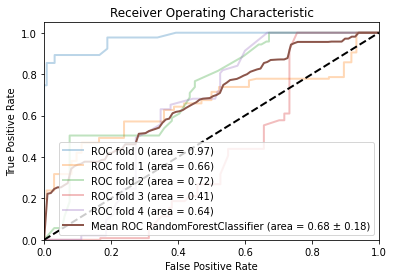

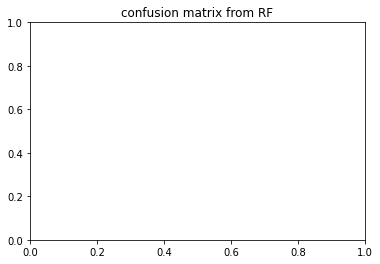

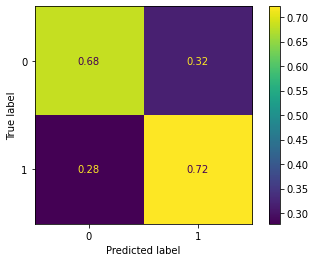

,precision,recall,f1-score,support,auc
0,0.750,0.685,0.663,131.600,0.00
1,0.753,0.723,0.699,131.600,0.00
accuracy,0.703,0.703,0.703,0.703,0.00
macro avg,0.752,0.704,0.681,263.200,0.68
weighted avg,0.753,0.703,0.680,263.200,0.68


coming from


,precision,recall,f1-score,support,auc
0,0.866197,0.968504,0.914498,127.000000,0.000000
1,0.965217,0.853846,0.906122,130.000000,0.000000
accuracy,0.910506,0.910506,0.910506,0.910506,0.000000
macro avg,0.915707,0.911175,0.910310,257.000000,0.973864
weighted avg,0.916285,0.910506,0.910261,257.000000,0.973864


,precision,recall,f1-score,support,auc
0,0.619792,0.888060,0.730061,134.000000,0.000000
1,0.779412,0.420635,0.546392,126.000000,0.000000
accuracy,0.661538,0.661538,0.661538,0.661538,0.000000
macro avg,0.699602,0.654347,0.638227,260.000000,0.660004
weighted avg,0.697146,0.661538,0.641052,260.000000,0.660004


,precision,recall,f1-score,support,auc
0,0.623711,0.923664,0.744615,131.000000,0.000000
1,0.871795,0.482270,0.621005,141.000000,0.000000
accuracy,0.694853,0.694853,0.694853,0.694853,0.000000
macro avg,0.747753,0.702967,0.682810,272.000000,0.723431
weighted avg,0.752313,0.694853,0.680538,272.000000,0.723431


,precision,recall,f1-score,support,auc
0,0.777778,0.267176,0.397727,131.000000,0.00000
1,0.540670,0.918699,0.680723,123.000000,0.00000
accuracy,0.582677,0.582677,0.582677,0.582677,0.00000
macro avg,0.659224,0.592937,0.539225,254.000000,0.40697
weighted avg,0.662958,0.582677,0.534768,254.000000,0.40697


,precision,recall,f1-score,support,auc
0,0.864407,0.377778,0.525773,135.000000,0.000000
1,0.607477,0.942029,0.738636,138.000000,0.000000
accuracy,0.663004,0.663004,0.663004,0.663004,0.000000
macro avg,0.735942,0.659903,0.632205,273.000000,0.635963
weighted avg,0.734530,0.663004,0.633374,273.000000,0.635963


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 100}
depth_10_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.388 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.565 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.492 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.513 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.240 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.540 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.458 total time=   0.1s
[CV 3/5] END criterion=gini, ma

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.450 total time=   2.4s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.275 total time=   2.7s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.881 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.506 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.490 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.413 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.655 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.706

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.711 total time=   3.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.818 total time=   3.2s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.578 total time=   3.1s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.413 total time=   3.1s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.314 total time=   3.1s


<Figure size 432x288 with 0 Axes>

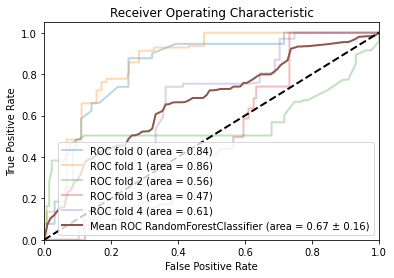

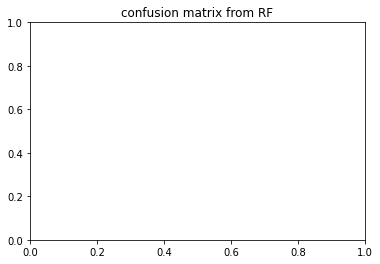

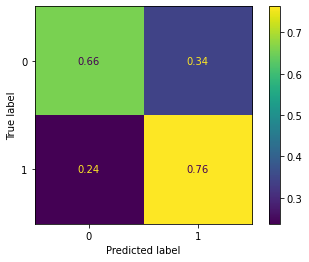

,precision,recall,f1-score,support,auc
0,0.780,0.658,0.675,131.600,0.000
1,0.721,0.772,0.720,131.600,0.000
accuracy,0.711,0.711,0.711,0.711,0.000
macro avg,0.751,0.715,0.698,263.200,0.668
weighted avg,0.753,0.711,0.696,263.200,0.668


coming from


,precision,recall,f1-score,support,auc
0,0.818966,0.748031,0.781893,127.000000,0.00000
1,0.773050,0.838462,0.804428,130.000000,0.00000
accuracy,0.793774,0.793774,0.793774,0.793774,0.00000
macro avg,0.796008,0.793247,0.793161,257.000000,0.83828
weighted avg,0.795740,0.793774,0.793292,257.000000,0.83828


,precision,recall,f1-score,support,auc
0,0.864865,0.716418,0.783673,134.000000,0.000000
1,0.744966,0.880952,0.807273,126.000000,0.000000
accuracy,0.796154,0.796154,0.796154,0.796154,0.000000
macro avg,0.804916,0.798685,0.795473,260.000000,0.863303
weighted avg,0.806760,0.796154,0.795110,260.000000,0.863303


,precision,recall,f1-score,support,auc
0,0.608040,0.923664,0.733333,131.000000,0.000000
1,0.863014,0.446809,0.588785,141.000000,0.000000
accuracy,0.676471,0.676471,0.676471,0.676471,0.000000
macro avg,0.735527,0.685236,0.661059,272.000000,0.564615
weighted avg,0.740214,0.676471,0.658402,272.000000,0.564615


,precision,recall,f1-score,support,auc
0,0.921053,0.267176,0.414201,131.000000,0.000000
1,0.555556,0.975610,0.707965,123.000000,0.000000
accuracy,0.610236,0.610236,0.610236,0.610236,0.000000
macro avg,0.738304,0.621393,0.561083,254.000000,0.467914
weighted avg,0.744060,0.610236,0.556457,254.000000,0.467914


,precision,recall,f1-score,support,auc
0,0.688000,0.637037,0.661538,135.000000,0.000000
1,0.668919,0.717391,0.692308,138.000000,0.000000
accuracy,0.677656,0.677656,0.677656,0.677656,0.000000
macro avg,0.678459,0.677214,0.676923,273.000000,0.605529
weighted avg,0.678355,0.677656,0.677092,273.000000,0.605529


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 100}
depth_10_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.384 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.518 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.358 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.517 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.546 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.407 total time=   0.2s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.749 total time=   0.1s
[CV 3/5] END criterion=gi

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.312 total time=   4.7s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.952 total time=   5.4s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.340 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.428 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.802 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.878 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.488 total time=   0.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.593

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.522 total time=   4.6s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.974 total time=   5.8s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.306 total time=   4.4s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.393 total time=   4.6s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.972 total time=   6.0s


<Figure size 432x288 with 0 Axes>

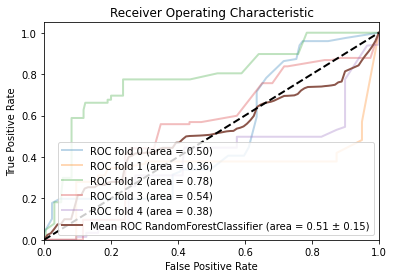

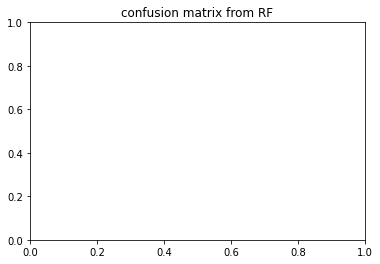

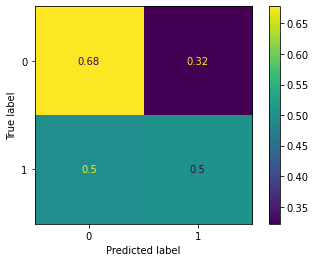

,precision,recall,f1-score,support,auc
0,0.617,0.684,0.602,200.000,0.000
1,0.635,0.503,0.521,200.000,0.000
accuracy,0.591,0.591,0.591,0.591,0.000
macro avg,0.626,0.594,0.562,400.000,0.512
weighted avg,0.627,0.591,0.561,400.000,0.512


coming from


,precision,recall,f1-score,support,auc
0,0.806452,0.236967,0.366300,211.00000,0.000000
1,0.534682,0.939086,0.681400,197.00000,0.000000
accuracy,0.575980,0.575980,0.575980,0.57598,0.000000
macro avg,0.670567,0.588027,0.523850,408.00000,0.504126
weighted avg,0.675230,0.575980,0.518444,408.00000,0.504126


,precision,recall,f1-score,support,auc
0,0.540785,0.904040,0.676749,198.00000,0.00000
1,0.683333,0.212435,0.324111,193.00000,0.00000
accuracy,0.562660,0.562660,0.562660,0.56266,0.00000
macro avg,0.612059,0.558238,0.500430,391.00000,0.35695
weighted avg,0.611148,0.562660,0.502684,391.00000,0.35695


,precision,recall,f1-score,support,auc
0,0.693548,0.882051,0.776524,195.00000,0.000000
1,0.847682,0.627451,0.721127,204.00000,0.000000
accuracy,0.751880,0.751880,0.751880,0.75188,0.000000
macro avg,0.770615,0.754751,0.748825,399.00000,0.781322
weighted avg,0.772354,0.751880,0.748200,399.00000,0.781322


,precision,recall,f1-score,support,auc
0,0.547325,0.671717,0.603175,198.000000,0.000000
1,0.572368,0.441624,0.498567,197.000000,0.000000
accuracy,0.556962,0.556962,0.556962,0.556962,0.000000
macro avg,0.559847,0.556671,0.550871,395.000000,0.538545
weighted avg,0.559815,0.556962,0.551003,395.000000,0.538545


,precision,recall,f1-score,support,auc
0,0.494845,0.727273,0.588957,198.000000,0.000000
1,0.534483,0.296651,0.381538,209.000000,0.000000
accuracy,0.506143,0.506143,0.506143,0.506143,0.000000
macro avg,0.514664,0.511962,0.485248,407.000000,0.380443
weighted avg,0.515200,0.506143,0.482445,407.000000,0.380443


{'criterion': 'gini', 'max_depth': 10, 'max_features': 0.8, 'n_estimators': 50}
depth_10_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.338 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.599 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.485 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.223 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.869 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.394 total time=   0.2s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.604 total time=   0.2s
[CV 3/5] END criterion=gini, max_de

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.225 total time=   4.2s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.955 total time=   5.8s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.235 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.593 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.473 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.421 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.813 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.480 total time=   0.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.595

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.501 total time=   5.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.957 total time=   6.1s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.330 total time=   4.8s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.409 total time=   5.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.983 total time=   6.2s


<Figure size 432x288 with 0 Axes>

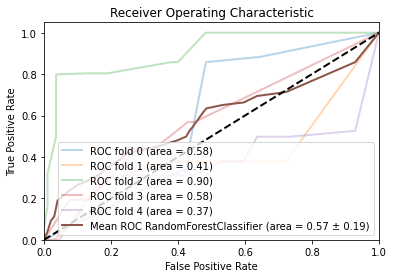

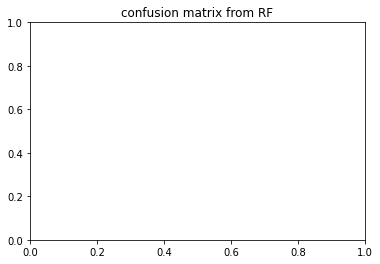

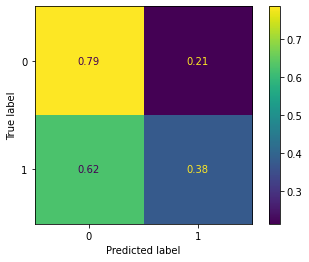

,precision,recall,f1-score,support,auc
0,0.562,0.788,0.653,200.000,0.000
1,0.624,0.378,0.460,200.000,0.000
accuracy,0.582,0.582,0.582,0.582,0.000
macro avg,0.593,0.583,0.557,400.000,0.569
weighted avg,0.594,0.582,0.556,400.000,0.569


coming from


,precision,recall,f1-score,support,auc
0,0.517241,0.568720,0.541761,211.000000,0.000000
1,0.482955,0.431472,0.455764,197.000000,0.000000
accuracy,0.502451,0.502451,0.502451,0.502451,0.000000
macro avg,0.500098,0.500096,0.498762,408.000000,0.584346
weighted avg,0.500686,0.502451,0.500238,408.000000,0.584346


,precision,recall,f1-score,support,auc
0,0.538206,0.818182,0.649299,198.00000,0.000000
1,0.600000,0.279793,0.381625,193.00000,0.000000
accuracy,0.552430,0.552430,0.552430,0.55243,0.000000
macro avg,0.569103,0.548987,0.515462,391.00000,0.408123
weighted avg,0.568708,0.552430,0.517173,391.00000,0.408123


,precision,recall,f1-score,support,auc
0,0.704120,0.964103,0.813853,195.000000,0.000000
1,0.946970,0.612745,0.744048,204.000000,0.000000
accuracy,0.784461,0.784461,0.784461,0.784461,0.000000
macro avg,0.825545,0.788424,0.778950,399.000000,0.904487
weighted avg,0.828284,0.784461,0.778163,399.000000,0.904487


,precision,recall,f1-score,support,auc
0,0.574713,0.757576,0.653595,198.000000,0.000000
1,0.641791,0.436548,0.519637,197.000000,0.000000
accuracy,0.597468,0.597468,0.597468,0.597468,0.000000
macro avg,0.608252,0.597062,0.586616,395.000000,0.581975
weighted avg,0.608167,0.597468,0.586786,395.000000,0.581975


,precision,recall,f1-score,support,auc
0,0.475504,0.833333,0.605505,198.000000,0.0000
1,0.450000,0.129187,0.200743,209.000000,0.0000
accuracy,0.471744,0.471744,0.471744,0.471744,0.0000
macro avg,0.462752,0.481260,0.403124,407.000000,0.3665
weighted avg,0.462408,0.471744,0.397654,407.000000,0.3665


{'criterion': 'gini', 'max_depth': 10, 'max_features': None, 'n_estimators': 10}
depth_10_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.681 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.497 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.696 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.313 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.263 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.845 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.747 total time=   0.1s
[CV 3/5] END criterion=gini

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.481 total time=   2.4s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.616 total time=   2.5s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.686 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.586 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.524 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.637 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.768 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.701

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.600 total time=   2.8s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.464 total time=   2.7s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.566 total time=   2.7s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.486 total time=   2.8s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.8s


<Figure size 432x288 with 0 Axes>

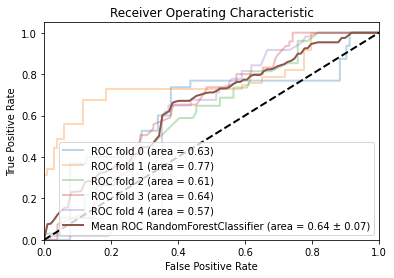

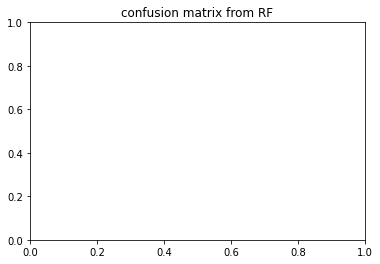

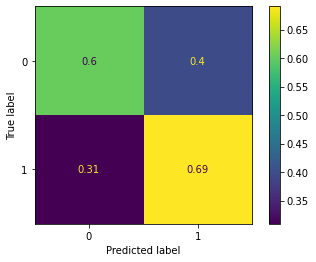

,precision,recall,f1-score,support,auc
0,0.675,0.600,0.607,102.200,0.000
1,0.652,0.691,0.659,102.200,0.000
accuracy,0.645,0.645,0.645,0.645,0.000
macro avg,0.664,0.645,0.633,204.400,0.644
weighted avg,0.664,0.645,0.634,204.400,0.644


coming from


,precision,recall,f1-score,support,auc
0,0.666667,0.621359,0.643216,103.000000,0.000000
1,0.617647,0.663158,0.639594,95.000000,0.000000
accuracy,0.641414,0.641414,0.641414,0.641414,0.000000
macro avg,0.642157,0.642259,0.641405,198.000000,0.634594
weighted avg,0.643147,0.641414,0.641478,198.000000,0.634594


,precision,recall,f1-score,support,auc
0,0.700000,0.883495,0.781116,103.000000,0.000000
1,0.857143,0.648649,0.738462,111.000000,0.000000
accuracy,0.761682,0.761682,0.761682,0.761682,0.000000
macro avg,0.778571,0.766072,0.759789,214.000000,0.766116
weighted avg,0.781509,0.761682,0.758991,214.000000,0.766116


,precision,recall,f1-score,support,auc
0,0.774194,0.242424,0.369231,99.00000,0.000000
1,0.558824,0.931373,0.698529,102.00000,0.000000
accuracy,0.592040,0.592040,0.592040,0.59204,0.000000
macro avg,0.666509,0.586898,0.533880,201.00000,0.612052
weighted avg,0.664901,0.592040,0.536338,201.00000,0.612052


,precision,recall,f1-score,support,auc
0,0.617647,0.623762,0.620690,101.000000,0.000000
1,0.595745,0.589474,0.592593,95.000000,0.000000
accuracy,0.607143,0.607143,0.607143,0.607143,0.000000
macro avg,0.606696,0.606618,0.606641,196.000000,0.639656
weighted avg,0.607031,0.607143,0.607071,196.000000,0.639656


,precision,recall,f1-score,support,auc
0,0.616822,0.628571,0.622642,105.000000,0.000000
1,0.632075,0.620370,0.626168,108.000000,0.000000
accuracy,0.624413,0.624413,0.624413,0.624413,0.000000
macro avg,0.624449,0.624471,0.624405,213.000000,0.566049
weighted avg,0.624556,0.624413,0.624430,213.000000,0.566049


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 100}
depth_10_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.707 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.757 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.653 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.761 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.444 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.690 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.863 total time=   0.1s
[CV 3/5] END criterion=gini, m

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.547 total time=   2.4s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.569 total time=   2.4s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.601 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.581 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.482 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.327 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.898 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.834

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.672 total time=   3.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.426 total time=   3.2s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.486 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.439 total time=   2.5s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.569 total time=   2.5s


<Figure size 432x288 with 0 Axes>

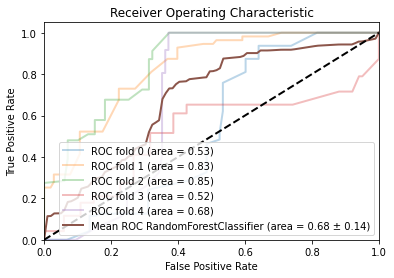

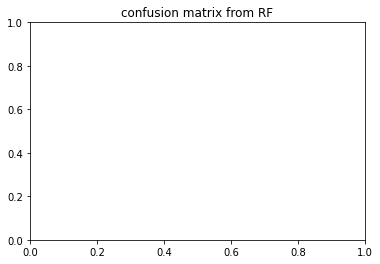

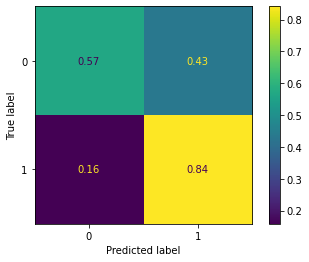

,precision,recall,f1-score,support,auc
0,0.789,0.568,0.654,102.200,0.000
1,0.659,0.837,0.735,102.200,0.000
accuracy,0.702,0.702,0.702,0.702,0.000
macro avg,0.724,0.703,0.695,204.400,0.683
weighted avg,0.724,0.702,0.694,204.400,0.683


coming from


,precision,recall,f1-score,support,auc
0,0.755102,0.359223,0.486842,103.000000,0.00000
1,0.557047,0.873684,0.680328,95.000000,0.00000
accuracy,0.606061,0.606061,0.606061,0.606061,0.00000
macro avg,0.656075,0.616454,0.583585,198.000000,0.53347
weighted avg,0.660076,0.606061,0.579676,198.000000,0.53347


,precision,recall,f1-score,support,auc
0,0.815789,0.601942,0.692737,103.000000,0.000000
1,0.702899,0.873874,0.779116,111.000000,0.000000
accuracy,0.742991,0.742991,0.742991,0.742991,0.000000
macro avg,0.759344,0.737908,0.735927,214.000000,0.827648
weighted avg,0.757234,0.742991,0.737542,214.000000,0.827648


,precision,recall,f1-score,support,auc
0,0.881579,0.676768,0.765714,99.00000,0.000000
1,0.744000,0.911765,0.819383,102.00000,0.000000
accuracy,0.796020,0.796020,0.796020,0.79602,0.000000
macro avg,0.812789,0.794266,0.792549,201.00000,0.851901
weighted avg,0.811763,0.796020,0.792949,201.00000,0.851901


,precision,recall,f1-score,support,auc
0,0.610526,0.574257,0.591837,101.000000,0.000000
1,0.574257,0.610526,0.591837,95.000000,0.000000
accuracy,0.591837,0.591837,0.591837,0.591837,0.000000
macro avg,0.592392,0.592392,0.591837,196.000000,0.516936
weighted avg,0.592947,0.591837,0.591837,196.000000,0.516936


,precision,recall,f1-score,support,auc
0,0.880000,0.628571,0.733333,105.000000,0.000000
1,0.717391,0.916667,0.804878,108.000000,0.000000
accuracy,0.774648,0.774648,0.774648,0.774648,0.000000
macro avg,0.798696,0.772619,0.769106,213.000000,0.683113
weighted avg,0.797551,0.774648,0.769610,213.000000,0.683113


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 50}
depth_10_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.344 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.406 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.546 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.549 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.398 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.573 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.344 total time=   0.1s
[CV 3/5] END criterion

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.667 total time=   3.6s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.727 total time=   4.1s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.446 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.408 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.562 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.802 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.641 total time=   0.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.311

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.559 total time=   4.3s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.259 total time=   3.8s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.592 total time=   3.8s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.743 total time=   3.9s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.715 total time=   4.8s


<Figure size 432x288 with 0 Axes>

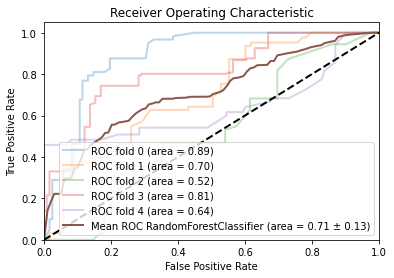

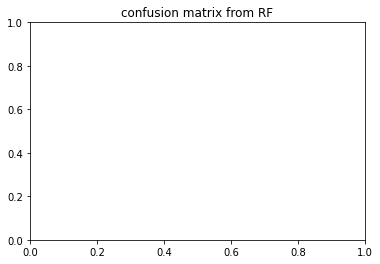

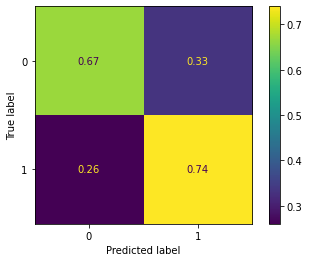

,precision,recall,f1-score,support,auc
0,0.720,0.667,0.664,122.800,0.00
1,0.752,0.737,0.711,122.800,0.00
accuracy,0.704,0.704,0.704,0.704,0.00
macro avg,0.736,0.702,0.688,245.600,0.71
weighted avg,0.735,0.704,0.689,245.600,0.71


coming from


,precision,recall,f1-score,support,auc
0,0.823529,0.803279,0.813278,122.000000,0.000000
1,0.806452,0.826446,0.816327,121.000000,0.000000
accuracy,0.814815,0.814815,0.814815,0.814815,0.000000
macro avg,0.814991,0.814862,0.814802,243.000000,0.887786
weighted avg,0.815026,0.814815,0.814796,243.000000,0.887786


,precision,recall,f1-score,support,auc
0,0.753846,0.398374,0.521277,123.000000,0.00000
1,0.597826,0.873016,0.709677,126.000000,0.00000
accuracy,0.638554,0.638554,0.638554,0.638554,0.00000
macro avg,0.675836,0.635695,0.615477,249.000000,0.70109
weighted avg,0.674896,0.638554,0.616612,249.000000,0.70109


,precision,recall,f1-score,support,auc
0,0.616667,0.303279,0.406593,122.000000,0.000000
1,0.547872,0.817460,0.656051,126.000000,0.000000
accuracy,0.564516,0.564516,0.564516,0.564516,0.000000
macro avg,0.582270,0.560370,0.531322,248.000000,0.519776
weighted avg,0.581715,0.564516,0.533334,248.000000,0.519776


,precision,recall,f1-score,support,auc
0,0.762963,0.830645,0.795367,124.000000,0.000000
1,0.809091,0.735537,0.770563,121.000000,0.000000
accuracy,0.783673,0.783673,0.783673,0.783673,0.000000
macro avg,0.786027,0.783091,0.782965,245.000000,0.806018
weighted avg,0.785745,0.783673,0.783117,245.000000,0.806018


,precision,recall,f1-score,support,auc
0,0.643979,1.000000,0.783439,123.000000,0.000000
1,1.000000,0.433333,0.604651,120.000000,0.000000
accuracy,0.720165,0.720165,0.720165,0.720165,0.000000
macro avg,0.821990,0.716667,0.694045,243.000000,0.636247
weighted avg,0.819792,0.720165,0.695149,243.000000,0.636247


{'criterion': 'gini', 'max_depth': 10, 'max_features': 0.8, 'n_estimators': 100}
depth_10_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.295 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.553 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.492 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.685 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.587 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.368 total time=   0.1s
[CV 3/5] END criterion=gini, max_

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.764 total time=   3.8s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.645 total time=   4.1s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.393 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.375 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.515 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.716 total time=   0.2s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.767 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.682 total time=   0.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.466

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.666 total time=   4.5s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.186 total time=   4.1s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.571 total time=   5.2s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.710 total time=   4.3s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.757 total time=   5.0s


<Figure size 432x288 with 0 Axes>

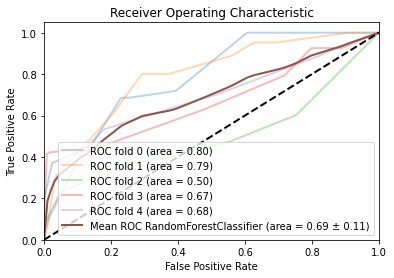

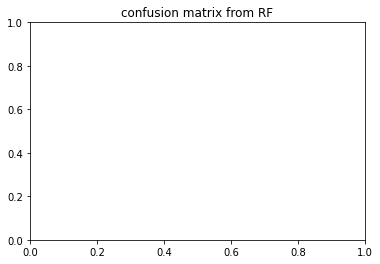

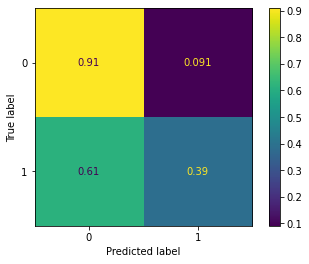

,precision,recall,f1-score,support,auc
0,0.605,0.909,0.722,122.800,0.000
1,0.856,0.389,0.497,122.800,0.000
accuracy,0.648,0.648,0.648,0.648,0.000
macro avg,0.731,0.649,0.610,245.600,0.687
weighted avg,0.731,0.648,0.609,245.600,0.687


coming from


,precision,recall,f1-score,support,auc
0,0.605714,0.868852,0.713805,122.000000,0.000000
1,0.764706,0.429752,0.550265,121.000000,0.000000
accuracy,0.650206,0.650206,0.650206,0.650206,0.000000
macro avg,0.685210,0.649302,0.632035,243.000000,0.796437
weighted avg,0.684883,0.650206,0.632371,243.000000,0.796437


,precision,recall,f1-score,support,auc
0,0.662162,0.796748,0.723247,123.000000,0.000000
1,0.752475,0.603175,0.669604,126.000000,0.000000
accuracy,0.698795,0.698795,0.698795,0.698795,0.000000
macro avg,0.707319,0.699961,0.696425,249.000000,0.793264
weighted avg,0.707863,0.698795,0.696102,249.000000,0.793264


,precision,recall,f1-score,support,auc
0,0.510460,1.000000,0.675900,122.000000,0.000000
1,1.000000,0.071429,0.133333,126.000000,0.000000
accuracy,0.528226,0.528226,0.528226,0.528226,0.000000
macro avg,0.755230,0.535714,0.404617,248.000000,0.498764
weighted avg,0.759178,0.528226,0.400241,248.000000,0.498764


,precision,recall,f1-score,support,auc
0,0.634021,0.991935,0.773585,124.000000,0.000000
1,0.980392,0.413223,0.581395,121.000000,0.000000
accuracy,0.706122,0.706122,0.706122,0.706122,0.000000
macro avg,0.807206,0.702579,0.677490,245.000000,0.669588
weighted avg,0.805086,0.706122,0.678667,245.000000,0.669588


,precision,recall,f1-score,support,auc
0,0.612360,0.886179,0.724252,123.000000,0.00000
1,0.784615,0.425000,0.551351,120.000000,0.00000
accuracy,0.658436,0.658436,0.658436,0.658436,0.00000
macro avg,0.698487,0.655589,0.637802,243.000000,0.67876
weighted avg,0.697424,0.658436,0.638869,243.000000,0.67876


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 0.5, 'n_estimators': 10}
depth_100_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.681 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.701 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.037 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.447 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.546 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.500 total time=   0.1s
[CV 3/5] END crite

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.590 total time=   2.9s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.426 total time=   2.5s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.555 total time=   2.7s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.706 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.582 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.586 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.296 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.739 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.226 total time=   1.5s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.660 total time=   2.9s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.726 total time=   3.3s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.578 total time=   3.2s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.538 total time=   3.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.522 total time=   3.2s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

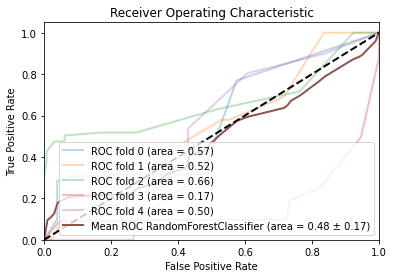

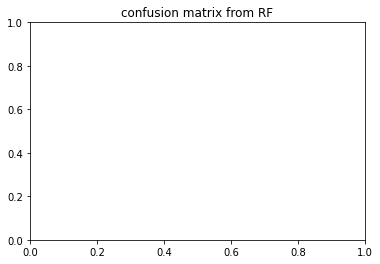

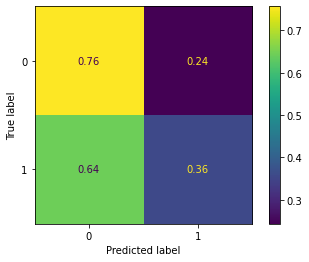

,precision,recall,f1-score,support,auc
0,0.536,0.761,0.605,131.600,0.000
1,0.548,0.350,0.376,131.600,0.000
accuracy,0.555,0.555,0.555,0.555,0.000
macro avg,0.542,0.556,0.491,263.200,0.483
weighted avg,0.546,0.555,0.491,263.200,0.483


coming from


,precision,recall,f1-score,support,auc
0,0.510460,0.960630,0.666667,127.000000,0.000000
1,0.722222,0.100000,0.175676,130.000000,0.000000
accuracy,0.525292,0.525292,0.525292,0.525292,0.000000
macro avg,0.616341,0.530315,0.421171,257.000000,0.567777
weighted avg,0.617577,0.525292,0.418305,257.000000,0.567777


,precision,recall,f1-score,support,auc
0,0.493506,0.283582,0.360190,134.000000,0.000000
1,0.475410,0.690476,0.563107,126.000000,0.000000
accuracy,0.480769,0.480769,0.480769,0.480769,0.000000
macro avg,0.484458,0.487029,0.461648,260.000000,0.524639
weighted avg,0.484737,0.480769,0.458526,260.000000,0.524639


,precision,recall,f1-score,support,auc
0,0.616114,0.992366,0.760234,131.000000,0.000000
1,0.983607,0.425532,0.594059,141.000000,0.000000
accuracy,0.698529,0.698529,0.698529,0.698529,0.000000
macro avg,0.799860,0.708949,0.677147,272.000000,0.656137
weighted avg,0.806616,0.698529,0.674092,272.000000,0.656137


,precision,recall,f1-score,support,auc
0,0.515748,1.000000,0.680519,131.000000,0.000000
1,0.000000,0.000000,0.000000,123.000000,0.000000
accuracy,0.515748,0.515748,0.515748,0.515748,0.000000
macro avg,0.257874,0.500000,0.340260,254.000000,0.169863
weighted avg,0.265996,0.515748,0.350977,254.000000,0.169863


,precision,recall,f1-score,support,auc
0,0.546099,0.570370,0.557971,135.000000,0.000000
1,0.560606,0.536232,0.548148,138.000000,0.000000
accuracy,0.553114,0.553114,0.553114,0.553114,0.000000
macro avg,0.553353,0.553301,0.553060,273.000000,0.497907
weighted avg,0.553432,0.553114,0.553006,273.000000,0.497907


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 0.8, 'n_estimators': 10}
depth_100_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.638 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.569 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.593 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.243 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.636 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.630 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.305 total time=   0.1s
[CV 3/5] END criterion=

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.585 total time=   3.1s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.537 total time=   2.9s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.381 total time=   3.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.726 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.421 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.590 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.185 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.069 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.712 total time=   3.1s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.675 total time=   3.3s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.581 total time=   3.6s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.409 total time=   3.5s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.401 total time=   3.8s


<Figure size 432x288 with 0 Axes>

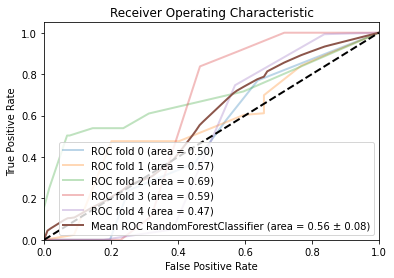

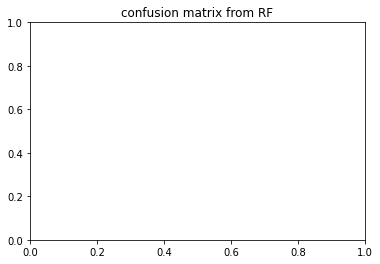

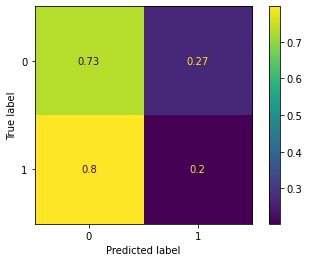

,precision,recall,f1-score,support,auc
0,0.480,0.729,0.570,131.600,0.000
1,0.407,0.203,0.242,131.600,0.000
accuracy,0.467,0.467,0.467,0.467,0.000
macro avg,0.443,0.466,0.406,263.200,0.562
weighted avg,0.446,0.467,0.407,263.200,0.562


coming from


,precision,recall,f1-score,support,auc
0,0.513274,0.456693,0.483333,127.00000,0.000000
1,0.520833,0.576923,0.547445,130.00000,0.000000
accuracy,0.517510,0.517510,0.517510,0.51751,0.000000
macro avg,0.517054,0.516808,0.515389,257.00000,0.495094
weighted avg,0.517098,0.517510,0.515763,257.00000,0.495094


,precision,recall,f1-score,support,auc
0,0.497959,0.910448,0.643799,134.000000,0.000000
1,0.200000,0.023810,0.042553,126.000000,0.000000
accuracy,0.480769,0.480769,0.480769,0.480769,0.000000
macro avg,0.348980,0.467129,0.343176,260.000000,0.565358
weighted avg,0.353564,0.480769,0.352426,260.000000,0.565358


,precision,recall,f1-score,support,auc
0,0.548936,0.984733,0.704918,131.000000,0.000000
1,0.945946,0.248227,0.393258,141.000000,0.000000
accuracy,0.602941,0.602941,0.602941,0.602941,0.000000
macro avg,0.747441,0.616480,0.549088,272.000000,0.690542
weighted avg,0.754739,0.602941,0.543359,272.000000,0.690542


,precision,recall,f1-score,support,auc
0,0.449495,0.679389,0.541033,131.000000,0.000000
1,0.250000,0.113821,0.156425,123.000000,0.000000
accuracy,0.405512,0.405512,0.405512,0.405512,0.000000
macro avg,0.349747,0.396605,0.348729,254.000000,0.587972
weighted avg,0.352889,0.405512,0.354786,254.000000,0.587972


,precision,recall,f1-score,support,auc
0,0.387850,0.614815,0.475645,135.00000,0.000000
1,0.118644,0.050725,0.071066,138.00000,0.000000
accuracy,0.329670,0.329670,0.329670,0.32967,0.000000
macro avg,0.253247,0.332770,0.273355,273.00000,0.473323
weighted avg,0.251768,0.329670,0.271132,273.00000,0.473323


{'criterion': 'gini', 'max_depth': 100, 'max_features': 0.5, 'n_estimators': 10}
depth_100_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.528 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.630 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.383 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.147 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.426 total time=   0.2s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.722 total time=   0.2s
[CV 3/5] END criteri

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.682 total time=   4.4s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.280 total time=   4.4s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.967 total time=   5.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.393 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.407 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.394 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.403 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.985 total time=   2.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.506 total time=   4.8s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.957 total time=   5.9s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.270 total time=   4.5s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.385 total time=   4.8s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.979 total time=   5.8s


<Figure size 432x288 with 0 Axes>

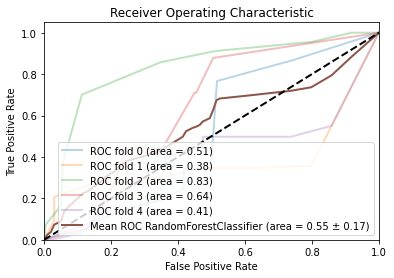

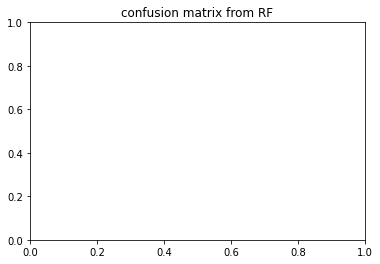

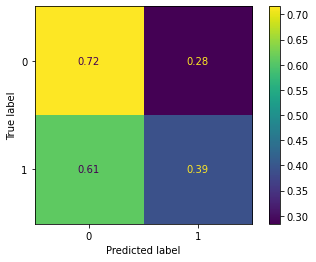

,precision,recall,f1-score,support,auc
0,0.545,0.719,0.609,200.000,0.000
1,0.645,0.390,0.448,200.000,0.000
accuracy,0.555,0.555,0.555,0.555,0.000
macro avg,0.595,0.555,0.528,400.000,0.555
weighted avg,0.596,0.555,0.529,400.000,0.555


coming from


,precision,recall,f1-score,support,auc
0,0.449153,0.502370,0.474273,211.00000,0.000000
1,0.389535,0.340102,0.363144,197.00000,0.000000
accuracy,0.424020,0.424020,0.424020,0.42402,0.000000
macro avg,0.419344,0.421236,0.418708,408.00000,0.513268
weighted avg,0.420367,0.424020,0.420615,408.00000,0.513268


,precision,recall,f1-score,support,auc
0,0.542373,0.969697,0.695652,198.000000,0.000000
1,0.837838,0.160622,0.269565,193.000000,0.000000
accuracy,0.570332,0.570332,0.570332,0.570332,0.000000
macro avg,0.690105,0.565159,0.482609,391.000000,0.377375
weighted avg,0.688216,0.570332,0.485333,391.000000,0.377375


,precision,recall,f1-score,support,auc
0,0.589744,0.943590,0.725838,195.000000,0.000000
1,0.873563,0.372549,0.522337,204.000000,0.000000
accuracy,0.651629,0.651629,0.651629,0.651629,0.000000
macro avg,0.731653,0.658069,0.624088,399.000000,0.832026
weighted avg,0.734854,0.651629,0.621792,399.000000,0.832026


,precision,recall,f1-score,support,auc
0,0.654545,0.545455,0.595041,198.000000,0.000000
1,0.608696,0.710660,0.655738,197.000000,0.000000
accuracy,0.627848,0.627848,0.627848,0.627848,0.000000
macro avg,0.631621,0.628057,0.625390,395.000000,0.640914
weighted avg,0.631679,0.627848,0.625313,395.000000,0.640914


,precision,recall,f1-score,support,auc
0,0.488372,0.636364,0.552632,198.000000,0.000000
1,0.516779,0.368421,0.430168,209.000000,0.000000
accuracy,0.498771,0.498771,0.498771,0.498771,0.000000
macro avg,0.502575,0.502392,0.491400,407.000000,0.409079
weighted avg,0.502959,0.498771,0.489745,407.000000,0.409079


{'criterion': 'gini', 'max_depth': 100, 'max_features': 0.8, 'n_estimators': 10}
depth_100_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.223 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.612 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.762 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.363 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.476 total time=   0.2s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.745 total time=   0.2s
[CV 3/5] END criterion=gin

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.707 total time=   4.5s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.226 total time=   4.3s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.944 total time=   5.5s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.341 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.652 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.663 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.281 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.687 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.975 total time=   2.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.547 total time=   4.8s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.926 total time=   5.9s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.282 total time=   4.4s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.417 total time=   4.8s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.896 total time=   5.8s


<Figure size 432x288 with 0 Axes>

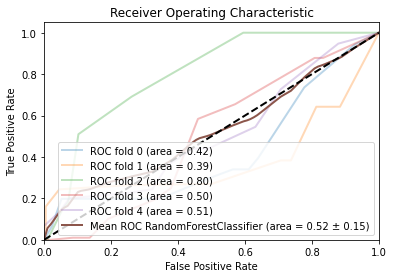

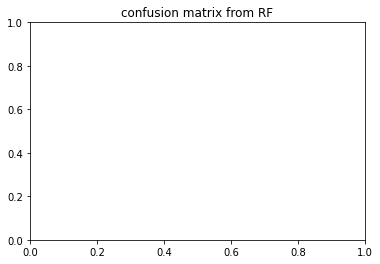

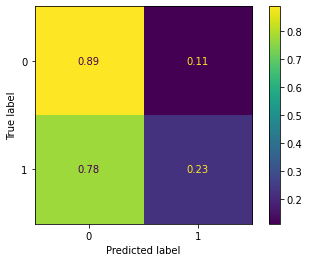

,precision,recall,f1-score,support,auc
0,0.536,0.889,0.666,200.000,0.000
1,0.736,0.224,0.313,200.000,0.000
accuracy,0.558,0.558,0.558,0.558,0.000
macro avg,0.636,0.556,0.489,400.000,0.523
weighted avg,0.636,0.558,0.490,400.000,0.523


coming from


,precision,recall,f1-score,support,auc
0,0.528205,0.976303,0.685524,211.000000,0.000000
1,0.722222,0.065990,0.120930,197.000000,0.000000
accuracy,0.536765,0.536765,0.536765,0.536765,0.000000
macro avg,0.625214,0.521147,0.403227,408.000000,0.422655
weighted avg,0.621885,0.536765,0.412914,408.000000,0.422655


,precision,recall,f1-score,support,auc
0,0.548747,0.994949,0.707361,198.00000,0.000000
1,0.968750,0.160622,0.275556,193.00000,0.000000
accuracy,0.583120,0.583120,0.583120,0.58312,0.000000
macro avg,0.758748,0.577786,0.491458,391.00000,0.385827
weighted avg,0.756063,0.583120,0.494219,391.00000,0.385827


,precision,recall,f1-score,support,auc
0,0.636364,0.897436,0.744681,195.000000,0.00000
1,0.838710,0.509804,0.634146,204.000000,0.00000
accuracy,0.699248,0.699248,0.699248,0.699248,0.00000
macro avg,0.737537,0.703620,0.689414,399.000000,0.79917
weighted avg,0.739819,0.699248,0.688167,399.000000,0.79917


,precision,recall,f1-score,support,auc
0,0.453875,0.621212,0.524520,198.000000,0.000000
1,0.395161,0.248731,0.305296,197.000000,0.000000
accuracy,0.435443,0.435443,0.435443,0.435443,0.000000
macro avg,0.424518,0.434972,0.414908,395.000000,0.498257
weighted avg,0.424592,0.435443,0.415186,395.000000,0.498257


,precision,recall,f1-score,support,auc
0,0.510811,0.954545,0.665493,198.00000,0.000000
1,0.756757,0.133971,0.227642,209.00000,0.000000
accuracy,0.533170,0.533170,0.533170,0.53317,0.000000
macro avg,0.633784,0.544258,0.446568,407.00000,0.507648
weighted avg,0.637107,0.533170,0.440651,407.00000,0.507648


{'criterion': 'gini', 'max_depth': 100, 'max_features': 0.5, 'n_estimators': 10}
depth_100_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.754 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.758 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.591 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.742 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.635 total time=   0.1s
[CV 3/5] END criter

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.548 total time=   2.2s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.583 total time=   2.1s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.649 total time=   2.1s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.844 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.719 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.871 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.662 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.321 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.482 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.657 total time=   2.7s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.464 total time=   2.6s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.523 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.497 total time=   2.5s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.6s


<Figure size 432x288 with 0 Axes>

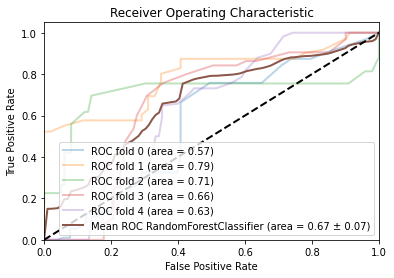

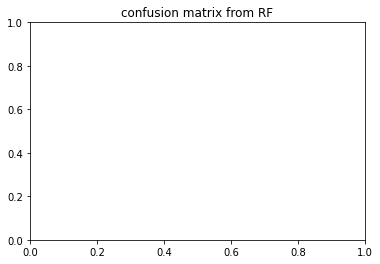

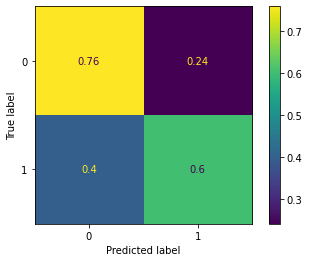

,precision,recall,f1-score,support,auc
0,0.659,0.760,0.699,102.200,0.000
1,0.749,0.607,0.655,102.200,0.000
accuracy,0.681,0.681,0.681,0.681,0.000
macro avg,0.704,0.684,0.677,204.400,0.669
weighted avg,0.706,0.681,0.676,204.400,0.669


coming from


,precision,recall,f1-score,support,auc
0,0.655914,0.592233,0.622449,103.000000,0.000000
1,0.600000,0.663158,0.630000,95.000000,0.000000
accuracy,0.626263,0.626263,0.626263,0.626263,0.000000
macro avg,0.627957,0.627695,0.626224,198.000000,0.565253
weighted avg,0.629087,0.626263,0.626072,198.000000,0.565253


,precision,recall,f1-score,support,auc
0,0.635802,1.000000,0.777358,103.000000,0.000000
1,1.000000,0.468468,0.638037,111.000000,0.000000
accuracy,0.724299,0.724299,0.724299,0.724299,0.000000
macro avg,0.817901,0.734234,0.707698,214.000000,0.788682
weighted avg,0.824709,0.724299,0.705094,214.000000,0.788682


,precision,recall,f1-score,support,auc
0,0.688000,0.868687,0.767857,99.000000,0.00000
1,0.828947,0.617647,0.707865,102.000000,0.00000
accuracy,0.741294,0.741294,0.741294,0.741294,0.00000
macro avg,0.758474,0.743167,0.737861,201.000000,0.70717
weighted avg,0.759526,0.741294,0.737413,201.000000,0.70717


,precision,recall,f1-score,support,auc
0,0.707071,0.693069,0.700000,101.000000,0.00000
1,0.680412,0.694737,0.687500,95.000000,0.00000
accuracy,0.693878,0.693878,0.693878,0.693878,0.00000
macro avg,0.693742,0.693903,0.693750,196.000000,0.65555
weighted avg,0.694150,0.693878,0.693941,196.000000,0.65555


,precision,recall,f1-score,support,auc
0,0.607143,0.647619,0.626728,105.000000,0.000000
1,0.633663,0.592593,0.612440,108.000000,0.000000
accuracy,0.619718,0.619718,0.619718,0.619718,0.000000
macro avg,0.620403,0.620106,0.619584,213.000000,0.629101
weighted avg,0.620590,0.619718,0.619484,213.000000,0.629101


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_100_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.885 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.608 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.259 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.247 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.855 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.914 total time=   0.1s
[CV 3/5] END crite

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.500 total time=   2.2s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.412 total time=   2.2s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.591 total time=   2.1s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.773 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.645 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.511 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.351 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.577 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.682 total time=   2.8s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.380 total time=   2.8s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.493 total time=   2.7s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.467 total time=   2.8s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.7s


<Figure size 432x288 with 0 Axes>

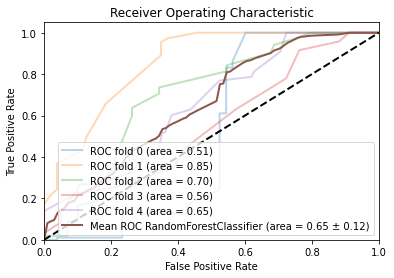

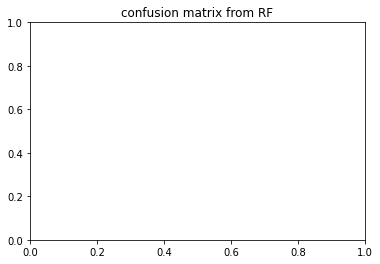

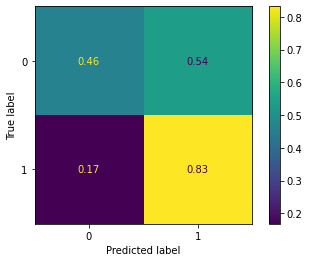

,precision,recall,f1-score,support,auc
0,0.727,0.463,0.553,102.200,0.000
1,0.614,0.829,0.701,102.200,0.000
accuracy,0.645,0.645,0.645,0.645,0.000
macro avg,0.671,0.646,0.627,204.400,0.654
weighted avg,0.671,0.645,0.626,204.400,0.654


coming from


,precision,recall,f1-score,support,auc
0,0.775862,0.436893,0.559006,103.000000,0.000000
1,0.585714,0.863158,0.697872,95.000000,0.000000
accuracy,0.641414,0.641414,0.641414,0.641414,0.000000
macro avg,0.680788,0.650026,0.628439,198.000000,0.508738
weighted avg,0.684630,0.641414,0.625634,198.000000,0.508738


,precision,recall,f1-score,support,auc
0,0.848101,0.650485,0.736264,103.000000,0.000000
1,0.733333,0.891892,0.804878,111.000000,0.000000
accuracy,0.775701,0.775701,0.775701,0.775701,0.000000
macro avg,0.790717,0.771189,0.770571,214.000000,0.853932
weighted avg,0.788572,0.775701,0.771853,214.000000,0.853932


,precision,recall,f1-score,support,auc
0,0.684211,0.656566,0.670103,99.000000,0.000000
1,0.679245,0.705882,0.692308,102.000000,0.000000
accuracy,0.681592,0.681592,0.681592,0.681592,0.000000
macro avg,0.681728,0.681224,0.681205,201.000000,0.699445
weighted avg,0.681691,0.681592,0.681371,201.000000,0.699445


,precision,recall,f1-score,support,auc
0,0.571429,0.277228,0.373333,101.000000,0.000000
1,0.503401,0.778947,0.611570,95.000000,0.000000
accuracy,0.520408,0.520408,0.520408,0.520408,0.000000
macro avg,0.537415,0.528088,0.492452,196.000000,0.555289
weighted avg,0.538456,0.520408,0.488805,196.000000,0.555289


,precision,recall,f1-score,support,auc
0,0.756098,0.295238,0.424658,105.000000,0.000000
1,0.569767,0.907407,0.700000,108.000000,0.000000
accuracy,0.605634,0.605634,0.605634,0.605634,0.000000
macro avg,0.662933,0.601323,0.562329,213.000000,0.653219
weighted avg,0.661620,0.605634,0.564268,213.000000,0.653219


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 50}
depth_100_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.420 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.151 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.445 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.646 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.770 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.750 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.258 total time=   0.1s
[CV 3/5] END cri

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.630 total time=   3.5s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.725 total time=   3.5s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.823 total time=   3.8s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.614 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.482 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.303 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.823 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.601 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.780 total time=   2.3s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.635 total time=   4.2s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.117 total time=   3.8s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.609 total time=   3.8s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.728 total time=   3.7s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.858 total time=   4.5s


<Figure size 432x288 with 0 Axes>

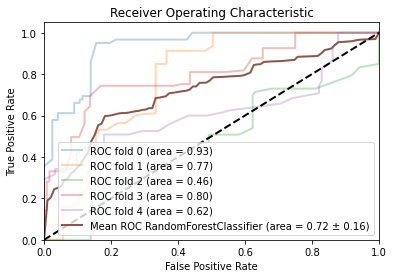

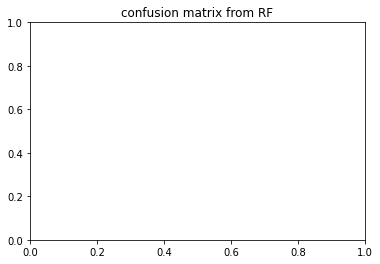

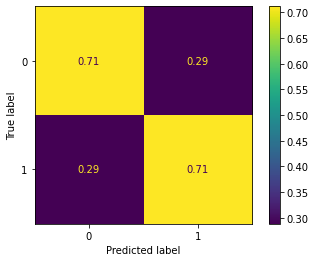

,precision,recall,f1-score,support,auc
0,0.711,0.711,0.702,122.800,0.000
1,0.728,0.709,0.707,122.800,0.000
accuracy,0.711,0.711,0.711,0.711,0.000
macro avg,0.720,0.710,0.705,245.600,0.718
weighted avg,0.719,0.711,0.705,245.600,0.718


coming from


,precision,recall,f1-score,support,auc
0,0.860656,0.860656,0.860656,122.000000,0.000000
1,0.859504,0.859504,0.859504,121.000000,0.000000
accuracy,0.860082,0.860082,0.860082,0.860082,0.000000
macro avg,0.860080,0.860080,0.860080,243.000000,0.931242
weighted avg,0.860082,0.860082,0.860082,243.000000,0.931242


,precision,recall,f1-score,support,auc
0,0.804124,0.634146,0.709091,123.000000,0.000000
1,0.703947,0.849206,0.769784,126.000000,0.000000
accuracy,0.742972,0.742972,0.742972,0.742972,0.000000
macro avg,0.754036,0.741676,0.739438,249.000000,0.774261
weighted avg,0.753432,0.742972,0.739803,249.000000,0.774261


,precision,recall,f1-score,support,auc
0,0.547619,0.377049,0.446602,122.000000,0.000000
1,0.536585,0.698413,0.606897,126.000000,0.000000
accuracy,0.540323,0.540323,0.540323,0.540323,0.000000
macro avg,0.542102,0.537731,0.526749,248.000000,0.462562
weighted avg,0.542013,0.540323,0.528042,248.000000,0.462562


,precision,recall,f1-score,support,auc
0,0.743056,0.862903,0.798507,124.000000,0.000000
1,0.831683,0.694215,0.756757,121.000000,0.000000
accuracy,0.779592,0.779592,0.779592,0.779592,0.000000
macro avg,0.787369,0.778559,0.777632,245.000000,0.796821
weighted avg,0.786827,0.779592,0.777888,245.000000,0.796821


,precision,recall,f1-score,support,auc
0,0.601190,0.821138,0.694158,123.000000,0.000000
1,0.706667,0.441667,0.543590,120.000000,0.000000
accuracy,0.633745,0.633745,0.633745,0.633745,0.000000
macro avg,0.653929,0.631402,0.618874,243.000000,0.624356
weighted avg,0.653277,0.633745,0.619803,243.000000,0.624356


{'criterion': 'gini', 'max_depth': 100, 'max_features': 0.8, 'n_estimators': 100}
depth_100_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.358 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.333 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.411 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.754 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.717 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.792 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.340 total time=   0.1s
[CV 3/5] END criterion=g

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.596 total time=   3.5s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.739 total time=   3.7s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.736 total time=   4.4s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.407 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.162 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.361 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.548 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.701 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.772 total time=   2.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.653 total time=   5.1s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.284 total time=   4.9s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.489 total time=   4.9s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.743 total time=   4.2s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.727 total time=   5.4s


<Figure size 432x288 with 0 Axes>

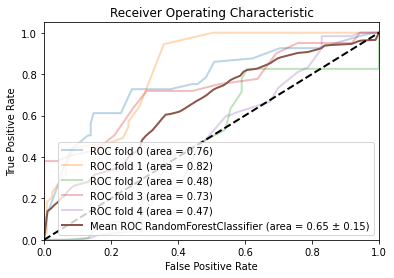

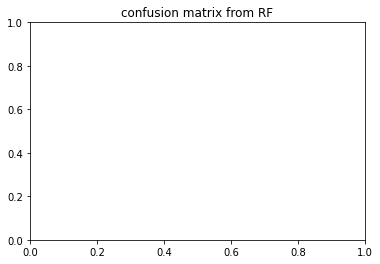

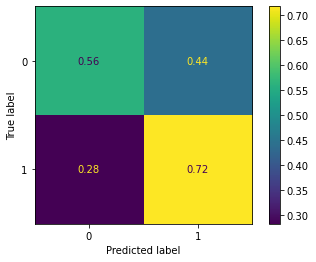

,precision,recall,f1-score,support,auc
0,0.669,0.560,0.576,122.800,0.000
1,0.644,0.719,0.666,122.800,0.000
accuracy,0.639,0.639,0.639,0.639,0.000
macro avg,0.656,0.639,0.621,245.600,0.652
weighted avg,0.657,0.639,0.621,245.600,0.652


coming from


,precision,recall,f1-score,support,auc
0,0.666667,0.770492,0.714829,122.000000,0.000000
1,0.725490,0.611570,0.663677,121.000000,0.000000
accuracy,0.691358,0.691358,0.691358,0.691358,0.000000
macro avg,0.696078,0.691031,0.689253,243.000000,0.763311
weighted avg,0.695957,0.691358,0.689358,243.000000,0.763311


,precision,recall,f1-score,support,auc
0,0.661654,0.715447,0.687500,123.000000,0.00000
1,0.698276,0.642857,0.669421,126.000000,0.00000
accuracy,0.678715,0.678715,0.678715,0.678715,0.00000
macro avg,0.679965,0.679152,0.678461,249.000000,0.81646
weighted avg,0.680186,0.678715,0.678352,249.000000,0.81646


,precision,recall,f1-score,support,auc
0,0.641026,0.409836,0.500000,122.000000,0.000000
1,0.576471,0.777778,0.662162,126.000000,0.000000
accuracy,0.596774,0.596774,0.596774,0.596774,0.000000
macro avg,0.608748,0.593807,0.581081,248.000000,0.479476
weighted avg,0.608228,0.596774,0.582389,248.000000,0.479476


,precision,recall,f1-score,support,auc
0,0.674074,0.733871,0.702703,124.000000,0.000000
1,0.700000,0.636364,0.666667,121.000000,0.000000
accuracy,0.685714,0.685714,0.685714,0.685714,0.000000
macro avg,0.687037,0.685117,0.684685,245.000000,0.732405
weighted avg,0.686878,0.685714,0.684905,245.000000,0.732405


,precision,recall,f1-score,support,auc
0,0.700000,0.170732,0.274510,123.00000,0.000000
1,0.521127,0.925000,0.666667,120.00000,0.000000
accuracy,0.543210,0.543210,0.543210,0.54321,0.000000
macro avg,0.610563,0.547866,0.470588,243.00000,0.468462
weighted avg,0.611668,0.543210,0.468168,243.00000,0.468462


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 50}
depth_1000_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.574 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.637 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.499 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.661 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.556 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.543 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.686 total time=   0.1s
[CV 3/

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.478 total time=   2.8s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.600 total time=   3.2s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.451 total time=   2.6s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.374 total time=   2.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.023 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.353 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.773 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.152 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.601 total time=   1.6s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.372 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.382 total time=   1.8s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.670 total time=   3.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.634 total time=   3.2s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.584 total time=   3.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.461 total time=   3.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.375 total time=   4.0s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

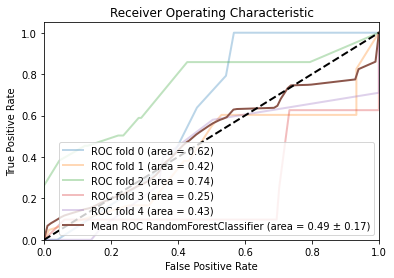

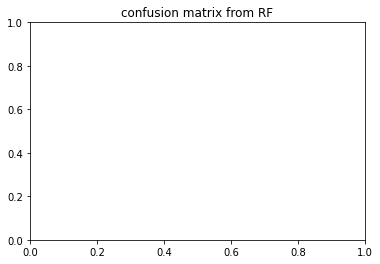

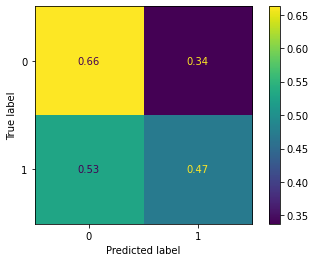

,precision,recall,f1-score,support,auc
0,0.573,0.662,0.595,131.600,0.00
1,0.465,0.465,0.460,131.600,0.00
accuracy,0.566,0.566,0.566,0.566,0.00
macro avg,0.519,0.564,0.528,263.200,0.49
weighted avg,0.521,0.566,0.530,263.200,0.49


coming from


,precision,recall,f1-score,support,auc
0,0.682353,0.456693,0.547170,127.000000,0.000000
1,0.598837,0.792308,0.682119,130.000000,0.000000
accuracy,0.626459,0.626459,0.626459,0.626459,0.000000
macro avg,0.640595,0.624500,0.614645,257.000000,0.618686
weighted avg,0.640108,0.626459,0.615432,257.000000,0.618686


,precision,recall,f1-score,support,auc
0,0.540323,0.500000,0.519380,134.000000,0.000000
1,0.507353,0.547619,0.526718,126.000000,0.000000
accuracy,0.523077,0.523077,0.523077,0.523077,0.000000
macro avg,0.523838,0.523810,0.523049,260.000000,0.423004
weighted avg,0.524345,0.523077,0.522936,260.000000,0.423004


,precision,recall,f1-score,support,auc
0,0.615894,0.709924,0.659574,131.000000,0.00000
1,0.685950,0.588652,0.633588,141.000000,0.00000
accuracy,0.647059,0.647059,0.647059,0.647059,0.00000
macro avg,0.650922,0.649288,0.646581,272.000000,0.73656
weighted avg,0.652210,0.647059,0.646103,272.000000,0.73656


,precision,recall,f1-score,support,auc
0,0.515748,1.000000,0.680519,131.000000,0.000000
1,0.000000,0.000000,0.000000,123.000000,0.000000
accuracy,0.515748,0.515748,0.515748,0.515748,0.000000
macro avg,0.257874,0.500000,0.340260,254.000000,0.246788
weighted avg,0.265996,0.515748,0.350977,254.000000,0.246788


,precision,recall,f1-score,support,auc
0,0.511765,0.644444,0.570492,135.000000,0.000000
1,0.533981,0.398551,0.456432,138.000000,0.000000
accuracy,0.520147,0.520147,0.520147,0.520147,0.000000
macro avg,0.522873,0.521498,0.513462,273.000000,0.425443
weighted avg,0.522995,0.520147,0.512835,273.000000,0.425443


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 0.8, 'n_estimators': 10}
depth_1000_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.795 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.073 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.648 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.738 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.776 total time=   0.1s
[CV 3/5] END c

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.621 total time=   2.8s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.583 total time=   2.8s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.537 total time=   2.9s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.519 total time=   2.8s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.495 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.898 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.252 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.579 total time=   2.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.352 total time=   1.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.613 total time=   2.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.708 total time=   3.9s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.518 total time=   4.4s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.582 total time=   3.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.483 total time=   3.8s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.407 total time=   3.7s


<Figure size 432x288 with 0 Axes>

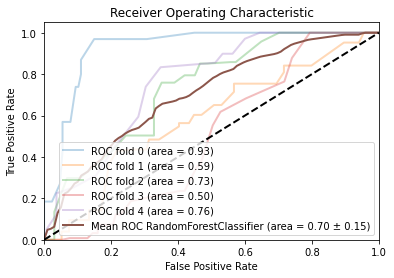

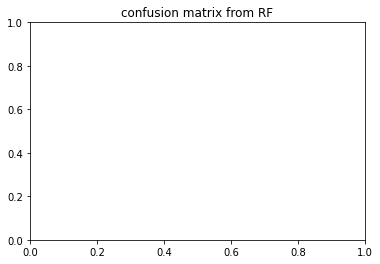

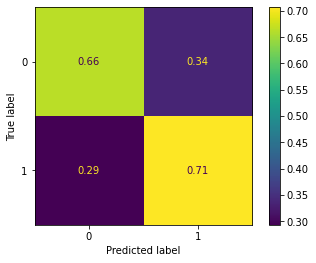

,precision,recall,f1-score,support,auc
0,0.704,0.665,0.661,131.600,0.000
1,0.692,0.706,0.683,131.600,0.000
accuracy,0.685,0.685,0.685,0.685,0.000
macro avg,0.698,0.686,0.672,263.200,0.701
weighted avg,0.699,0.685,0.672,263.200,0.701


coming from


,precision,recall,f1-score,support,auc
0,0.869231,0.889764,0.879377,127.000000,0.00000
1,0.889764,0.869231,0.879377,130.000000,0.00000
accuracy,0.879377,0.879377,0.879377,0.879377,0.00000
macro avg,0.879497,0.879497,0.879377,257.000000,0.92765
weighted avg,0.879617,0.879377,0.879377,257.000000,0.92765


,precision,recall,f1-score,support,auc
0,0.574468,0.805970,0.670807,134.000000,0.000000
1,0.638889,0.365079,0.464646,126.000000,0.000000
accuracy,0.592308,0.592308,0.592308,0.592308,0.000000
macro avg,0.606678,0.585525,0.567727,260.000000,0.587864
weighted avg,0.605687,0.592308,0.570899,260.000000,0.587864


,precision,recall,f1-score,support,auc
0,0.661654,0.671756,0.666667,131.000000,0.000000
1,0.690647,0.680851,0.685714,141.000000,0.000000
accuracy,0.676471,0.676471,0.676471,0.676471,0.000000
macro avg,0.676151,0.676303,0.676190,272.000000,0.732635
weighted avg,0.676684,0.676471,0.676541,272.000000,0.732635


,precision,recall,f1-score,support,auc
0,0.693878,0.259542,0.377778,131.000000,0.000000
1,0.526829,0.878049,0.658537,123.000000,0.000000
accuracy,0.559055,0.559055,0.559055,0.559055,0.000000
macro avg,0.610353,0.568795,0.518157,254.000000,0.498697
weighted avg,0.612984,0.559055,0.513736,254.000000,0.498697


,precision,recall,f1-score,support,auc
0,0.723077,0.696296,0.709434,135.000000,0.00000
1,0.713287,0.739130,0.725979,138.000000,0.00000
accuracy,0.717949,0.717949,0.717949,0.717949,0.00000
macro avg,0.718182,0.717713,0.717706,273.000000,0.75934
weighted avg,0.718128,0.717949,0.717797,273.000000,0.75934


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}
depth_1000_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.339 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.385 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.529 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.198 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.215 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.471 total time=   0.2s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.674 total time=   0.2s
[CV 3/5]

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.956 total time=   5.7s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.723 total time=   4.9s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.210 total time=   6.1s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.937 total time=   6.5s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.471 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.586 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.182 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.505 total time=   2.3s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.409 total time=   2.4s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.955 total time=   2.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.480 total time=   4.8s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.947 total time=   5.8s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.278 total time=   4.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.346 total time=   4.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.904 total time=   5.8s


<Figure size 432x288 with 0 Axes>

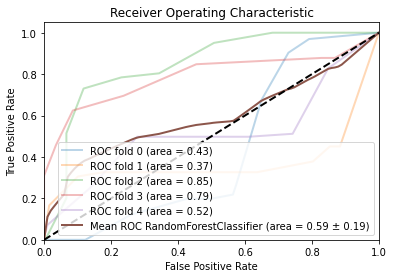

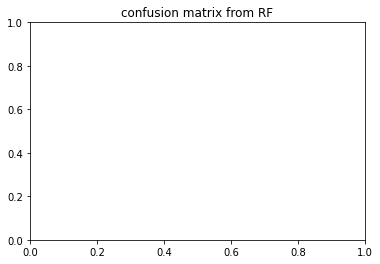

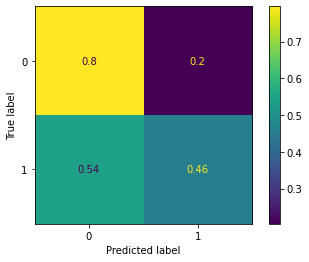

,precision,recall,f1-score,support,auc
0,0.622,0.803,0.657,200.000,0.00
1,0.785,0.458,0.516,200.000,0.00
accuracy,0.627,0.627,0.627,0.627,0.00
macro avg,0.703,0.631,0.587,400.000,0.59
weighted avg,0.705,0.627,0.585,400.000,0.59


coming from


,precision,recall,f1-score,support,auc
0,0.750000,0.270142,0.397213,211.00000,0.000000
1,0.536145,0.903553,0.672968,197.00000,0.000000
accuracy,0.575980,0.575980,0.575980,0.57598,0.000000
macro avg,0.643072,0.586848,0.535090,408.00000,0.427322
weighted avg,0.646741,0.575980,0.530359,408.00000,0.427322


,precision,recall,f1-score,support,auc
0,0.547753,0.984848,0.703971,198.000000,0.000000
1,0.914286,0.165803,0.280702,193.000000,0.000000
accuracy,0.580563,0.580563,0.580563,0.580563,0.000000
macro avg,0.731019,0.575326,0.492336,391.000000,0.373044
weighted avg,0.728676,0.580563,0.495043,391.000000,0.373044


,precision,recall,f1-score,support,auc
0,0.647687,0.933333,0.764706,195.000000,0.000000
1,0.889831,0.514706,0.652174,204.000000,0.000000
accuracy,0.719298,0.719298,0.719298,0.719298,0.000000
macro avg,0.768759,0.724020,0.708440,399.000000,0.845324
weighted avg,0.771490,0.719298,0.707171,399.000000,0.845324


,precision,recall,f1-score,support,auc
0,0.640940,0.964646,0.770161,198.000000,0.000000
1,0.927835,0.456853,0.612245,197.000000,0.000000
accuracy,0.711392,0.711392,0.711392,0.711392,0.000000
macro avg,0.784387,0.710750,0.691203,395.000000,0.789712
weighted avg,0.784024,0.711392,0.691403,395.000000,0.789712


,precision,recall,f1-score,support,auc
0,0.521341,0.863636,0.650190,198.000000,0.000000
1,0.658228,0.248804,0.361111,209.000000,0.000000
accuracy,0.547912,0.547912,0.547912,0.547912,0.000000
macro avg,0.589785,0.556220,0.505651,407.000000,0.515115
weighted avg,0.591634,0.547912,0.501744,407.000000,0.515115


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 0.5, 'n_estimators': 10}
depth_1000_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.377 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.376 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.631 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.462 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.895 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.366 total time=   0.2s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.619 total time=   0.2s
[CV 3/5] END c

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.946 total time=   5.4s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.673 total time=   4.4s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.261 total time=   4.2s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.970 total time=   5.5s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.353 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.413 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.554 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.261 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.307 total time=   2.2s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.298 total time=   2.3s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.910 total time=   2.8s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.508 total time=   4.8s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.974 total time=   6.1s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.286 total time=   4.5s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.349 total time=   4.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.960 total time=   5.9s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

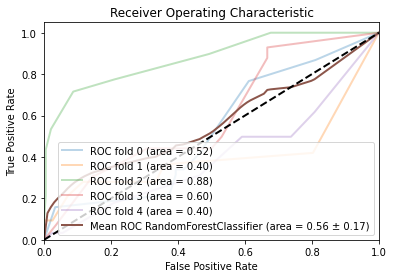

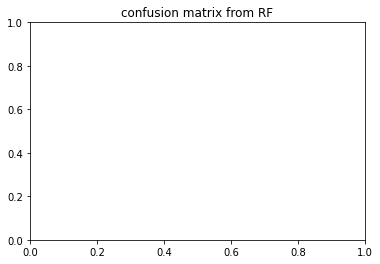

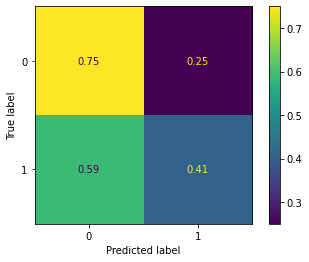

,precision,recall,f1-score,support,auc
0,0.588,0.754,0.622,200.000,0.00
1,0.549,0.413,0.432,200.000,0.00
accuracy,0.581,0.581,0.581,0.581,0.00
macro avg,0.568,0.583,0.527,400.000,0.56
weighted avg,0.567,0.581,0.526,400.000,0.56


coming from


,precision,recall,f1-score,support,auc
0,0.502262,0.526066,0.513889,211.000000,0.000000
1,0.465241,0.441624,0.453125,197.000000,0.000000
accuracy,0.485294,0.485294,0.485294,0.485294,0.000000
macro avg,0.483752,0.483845,0.483507,408.000000,0.524515
weighted avg,0.484387,0.485294,0.484549,408.000000,0.524515


,precision,recall,f1-score,support,auc
0,0.547619,0.929293,0.689139,198.000000,0.000000
1,0.745455,0.212435,0.330645,193.000000,0.000000
accuracy,0.575448,0.575448,0.575448,0.575448,0.000000
macro avg,0.646537,0.570864,0.509892,391.000000,0.403412
weighted avg,0.645272,0.575448,0.512184,391.000000,0.403412


,precision,recall,f1-score,support,auc
0,0.667832,0.979487,0.794179,195.00000,0.00000
1,0.964602,0.534314,0.687697,204.00000,0.00000
accuracy,0.751880,0.751880,0.751880,0.75188,0.00000
macro avg,0.816217,0.756900,0.740938,399.00000,0.87554
weighted avg,0.819564,0.751880,0.739737,399.00000,0.87554


,precision,recall,f1-score,support,auc
0,0.733333,0.333333,0.458333,198.000000,0.000000
1,0.567213,0.878173,0.689243,197.000000,0.000000
accuracy,0.605063,0.605063,0.605063,0.605063,0.000000
macro avg,0.650273,0.605753,0.573788,395.000000,0.596754
weighted avg,0.650484,0.605063,0.573496,395.000000,0.596754


,precision,recall,f1-score,support,auc
0,0.486486,1.000000,0.654545,198.000000,0.000000
1,0.000000,0.000000,0.000000,209.000000,0.000000
accuracy,0.486486,0.486486,0.486486,0.486486,0.000000
macro avg,0.243243,0.500000,0.327273,407.000000,0.398772
weighted avg,0.236669,0.486486,0.318428,407.000000,0.398772


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 0.8, 'n_estimators': 10}
depth_1000_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.886 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.827 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.421 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.510 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.933 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.522 total time=   0.2s
[CV 3/5] E

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.470 total time=   2.2s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.586 total time=   2.2s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.466 total time=   2.2s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.574 total time=   2.2s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.773 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.580 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.340 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.574 total time=   1.3s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.415 total time=   1.3s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.568 total time=   1.4s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.607 total time=   3.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.469 total time=   2.9s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.471 total time=   2.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.436 total time=   2.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.7s


<Figure size 432x288 with 0 Axes>

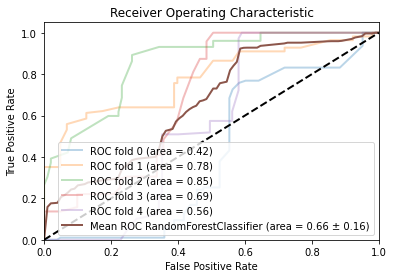

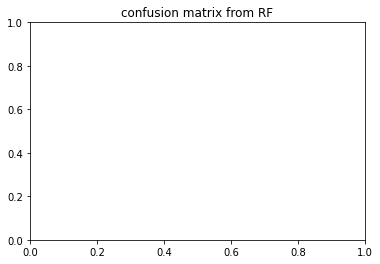

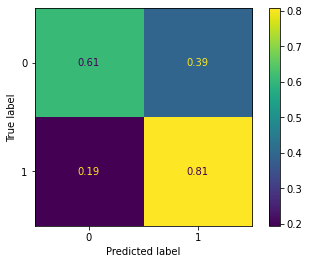

,precision,recall,f1-score,support,auc
0,0.797,0.608,0.662,102.200,0.000
1,0.698,0.810,0.729,102.200,0.000
accuracy,0.706,0.706,0.706,0.706,0.000
macro avg,0.748,0.709,0.695,204.400,0.659
weighted avg,0.749,0.706,0.694,204.400,0.659


coming from


,precision,recall,f1-score,support,auc
0,0.633803,0.436893,0.517241,103.000000,0.000000
1,0.543307,0.726316,0.621622,95.000000,0.000000
accuracy,0.575758,0.575758,0.575758,0.575758,0.000000
macro avg,0.588555,0.581604,0.569432,198.000000,0.416454
weighted avg,0.590383,0.575758,0.567323,198.000000,0.416454


,precision,recall,f1-score,support,auc
0,0.648649,0.932039,0.764940,103.000000,0.000000
1,0.893939,0.531532,0.666667,111.000000,0.000000
accuracy,0.724299,0.724299,0.724299,0.724299,0.000000
macro avg,0.771294,0.731785,0.715803,214.000000,0.779979
weighted avg,0.775879,0.724299,0.713967,214.000000,0.779979


,precision,recall,f1-score,support,auc
0,0.839080,0.737374,0.784946,99.000000,0.000000
1,0.771930,0.862745,0.814815,102.000000,0.000000
accuracy,0.800995,0.800995,0.800995,0.800995,0.000000
macro avg,0.805505,0.800059,0.799881,201.000000,0.854575
weighted avg,0.805004,0.800995,0.800103,201.000000,0.854575


,precision,recall,f1-score,support,auc
0,0.928571,0.514851,0.662420,101.000000,0.000000
1,0.650000,0.957895,0.774468,95.000000,0.000000
accuracy,0.729592,0.729592,0.729592,0.729592,0.000000
macro avg,0.789286,0.736373,0.718444,196.000000,0.687962
weighted avg,0.793550,0.729592,0.716729,196.000000,0.687962


,precision,recall,f1-score,support,auc
0,0.936170,0.419048,0.578947,105.000000,0.000000
1,0.632530,0.972222,0.766423,108.000000,0.000000
accuracy,0.699531,0.699531,0.699531,0.699531,0.000000
macro avg,0.784350,0.695635,0.672685,213.000000,0.555379
weighted avg,0.782212,0.699531,0.674006,213.000000,0.555379


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.758 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.809 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.480 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.675 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.774 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.681 total time=   0.1s
[CV 3/5] 

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.480 total time=   2.2s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.570 total time=   2.3s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.466 total time=   2.3s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.610 total time=   2.2s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.735 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.930 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.374 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.349 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.629 total time=   1.2s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.389 total time=   1.2s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.583 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.646 total time=   2.7s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.442 total time=   2.6s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.551 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.433 total time=   2.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.6s


<Figure size 432x288 with 0 Axes>

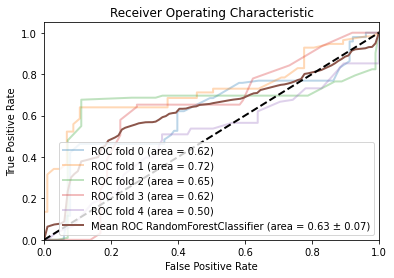

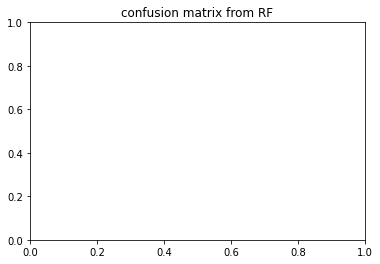

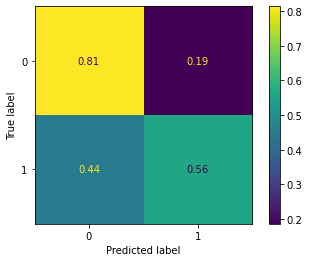

,precision,recall,f1-score,support,auc
0,0.648,0.815,0.720,102.200,0.000
1,0.763,0.555,0.637,102.200,0.000
accuracy,0.686,0.686,0.686,0.686,0.000
macro avg,0.706,0.685,0.678,204.400,0.624
weighted avg,0.706,0.686,0.679,204.400,0.624


coming from


,precision,recall,f1-score,support,auc
0,0.633333,0.922330,0.750988,103.000000,0.000000
1,0.833333,0.421053,0.559441,95.000000,0.000000
accuracy,0.681818,0.681818,0.681818,0.681818,0.000000
macro avg,0.733333,0.671691,0.655214,198.000000,0.618958
weighted avg,0.729293,0.681818,0.659084,198.000000,0.618958


,precision,recall,f1-score,support,auc
0,0.666667,0.893204,0.763485,103.000000,0.00000
1,0.855263,0.585586,0.695187,111.000000,0.00000
accuracy,0.733645,0.733645,0.733645,0.733645,0.00000
macro avg,0.760965,0.739395,0.729336,214.000000,0.72387
weighted avg,0.764490,0.733645,0.728060,214.000000,0.72387


,precision,recall,f1-score,support,auc
0,0.709677,0.888889,0.789238,99.000000,0.000000
1,0.857143,0.647059,0.737430,102.000000,0.000000
accuracy,0.766169,0.766169,0.766169,0.766169,0.000000
macro avg,0.783410,0.767974,0.763334,201.000000,0.653743
weighted avg,0.784511,0.766169,0.762947,201.000000,0.653743


,precision,recall,f1-score,support,auc
0,0.682243,0.722772,0.701923,101.000000,0.000000
1,0.685393,0.642105,0.663043,95.000000,0.000000
accuracy,0.683673,0.683673,0.683673,0.683673,0.000000
macro avg,0.683818,0.682439,0.682483,196.000000,0.624023
weighted avg,0.683770,0.683673,0.683078,196.000000,0.624023


,precision,recall,f1-score,support,auc
0,0.548387,0.647619,0.593886,105.00000,0.000000
1,0.584270,0.481481,0.527919,108.00000,0.000000
accuracy,0.563380,0.563380,0.563380,0.56338,0.000000
macro avg,0.566328,0.564550,0.560903,213.00000,0.500441
weighted avg,0.566581,0.563380,0.560438,213.00000,0.500441


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.526 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.490 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.523 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.619 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.624 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.238 total time=   0.1s
[CV 3/

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.274 total time=   3.8s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.575 total time=   3.7s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.729 total time=   3.7s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.757 total time=   4.1s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.691 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.328 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.480 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.535 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.671 total time=   2.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.713 total time=   2.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.754 total time=   2.4s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.702 total time=   4.7s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.177 total time=   4.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.558 total time=   4.1s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.617 total time=   4.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.768 total time=   4.9s


<Figure size 432x288 with 0 Axes>

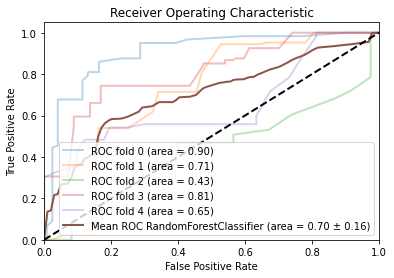

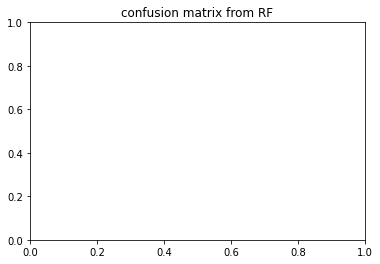

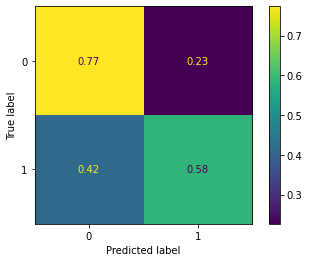

,precision,recall,f1-score,support,auc
0,0.674,0.774,0.708,122.80,0.000
1,0.714,0.586,0.624,122.80,0.000
accuracy,0.680,0.680,0.680,0.68,0.000
macro avg,0.694,0.680,0.666,245.60,0.701
weighted avg,0.693,0.680,0.666,245.60,0.701


coming from


,precision,recall,f1-score,support,auc
0,0.816000,0.836066,0.825911,122.000000,0.000000
1,0.830508,0.809917,0.820084,121.000000,0.000000
accuracy,0.823045,0.823045,0.823045,0.823045,0.000000
macro avg,0.823254,0.822991,0.822997,243.000000,0.903468
weighted avg,0.823224,0.823045,0.823009,243.000000,0.903468


,precision,recall,f1-score,support,auc
0,0.730337,0.528455,0.613208,123.000000,0.000000
1,0.637500,0.809524,0.713287,126.000000,0.000000
accuracy,0.670683,0.670683,0.670683,0.670683,0.000000
macro avg,0.683919,0.668990,0.663247,249.000000,0.709446
weighted avg,0.683359,0.670683,0.663850,249.000000,0.709446


,precision,recall,f1-score,support,auc
0,0.489583,0.770492,0.598726,122.000000,0.000000
1,0.500000,0.222222,0.307692,126.000000,0.000000
accuracy,0.491935,0.491935,0.491935,0.491935,0.000000
macro avg,0.494792,0.496357,0.453209,248.000000,0.433223
weighted avg,0.494876,0.491935,0.450862,248.000000,0.433223


,precision,recall,f1-score,support,auc
0,0.715278,0.830645,0.768657,124.000000,0.000000
1,0.792079,0.661157,0.720721,121.000000,0.000000
accuracy,0.746939,0.746939,0.746939,0.746939,0.000000
macro avg,0.753678,0.745901,0.744689,245.000000,0.806885
weighted avg,0.753208,0.746939,0.744982,245.000000,0.806885


,precision,recall,f1-score,support,auc
0,0.616667,0.902439,0.732673,123.000000,0.000000
1,0.809524,0.425000,0.557377,120.000000,0.000000
accuracy,0.666667,0.666667,0.666667,0.666667,0.000000
macro avg,0.713095,0.663720,0.645025,243.000000,0.651592
weighted avg,0.711905,0.666667,0.646107,243.000000,0.651592


{'criterion': 'gini', 'max_depth': 1000, 'max_features': None, 'n_estimators': 50}
depth_1000_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.637 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.413 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.389 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.499 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.598 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.321 total time=   0.1s
[CV 3/5] END cr

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.222 total time=   3.8s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.615 total time=   3.7s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.743 total time=   3.7s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.679 total time=   4.1s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.513 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.492 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.561 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.443 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.469 total time=   2.1s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.779 total time=   2.2s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.702 total time=   2.5s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.623 total time=   4.7s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.213 total time=   4.2s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.535 total time=   4.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.736 total time=   4.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.687 total time=   4.8s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

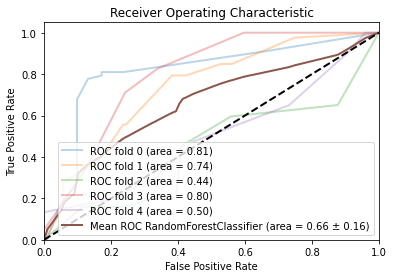

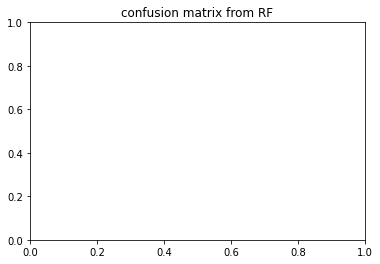

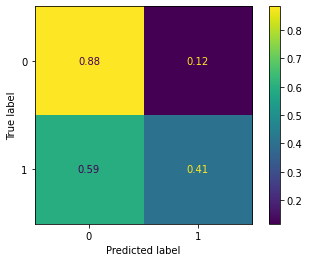

,precision,recall,f1-score,support,auc
0,0.623,0.883,0.718,122.800,0.000
1,0.663,0.407,0.455,122.800,0.000
accuracy,0.645,0.645,0.645,0.645,0.000
macro avg,0.643,0.645,0.587,245.600,0.657
weighted avg,0.641,0.645,0.586,245.600,0.657


coming from


,precision,recall,f1-score,support,auc
0,0.738255,0.901639,0.811808,122.000000,0.000000
1,0.872340,0.677686,0.762791,121.000000,0.000000
accuracy,0.790123,0.790123,0.790123,0.790123,0.000000
macro avg,0.805298,0.789663,0.787299,243.000000,0.811577
weighted avg,0.805022,0.790123,0.787400,243.000000,0.811577


,precision,recall,f1-score,support,auc
0,0.624161,0.756098,0.683824,123.000000,0.000000
1,0.700000,0.555556,0.619469,126.000000,0.000000
accuracy,0.654618,0.654618,0.654618,0.654618,0.000000
macro avg,0.662081,0.655827,0.651646,249.000000,0.737676
weighted avg,0.662537,0.654618,0.651259,249.000000,0.737676


,precision,recall,f1-score,support,auc
0,0.491935,1.000000,0.659459,122.000000,0.000000
1,0.000000,0.000000,0.000000,126.000000,0.000000
accuracy,0.491935,0.491935,0.491935,0.491935,0.000000
macro avg,0.245968,0.500000,0.329730,248.000000,0.441159
weighted avg,0.242001,0.491935,0.324412,248.000000,0.441159


,precision,recall,f1-score,support,auc
0,0.728682,0.758065,0.743083,124.000000,0.000000
1,0.741379,0.710744,0.725738,121.000000,0.000000
accuracy,0.734694,0.734694,0.734694,0.734694,0.000000
macro avg,0.735031,0.734404,0.734411,245.000000,0.799287
weighted avg,0.734953,0.734694,0.734517,245.000000,0.799287


,precision,recall,f1-score,support,auc
0,0.530172,1.000000,0.692958,123.00000,0.000000
1,1.000000,0.091667,0.167939,120.00000,0.000000
accuracy,0.551440,0.551440,0.551440,0.55144,0.000000
macro avg,0.765086,0.545833,0.430448,243.00000,0.497087
weighted avg,0.762186,0.551440,0.433689,243.00000,0.497087


{'criterion': 'gini', 'max_depth': 1000, 'max_features': None, 'n_estimators': 10}


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.658189,0.628475,0.635970
irm1_both_APOE_one_hot,0.615100,0.656176,0.644637
irm2_both_APOE_nbr_allelle_4,0.710711,0.703216,0.693920
irm2_both_APOE_one_hot,0.689121,0.707118,0.721422
irm1_under_APOE_nbr_allelle_4,0.750381,0.713402,0.705347
irm1_under_APOE_one_hot,0.723826,0.726417,0.672131
irm2_under_APOE_nbr_allelle_4,0.639829,0.644840,0.656210
irm2_under_APOE_one_hot,0.643643,0.660025,0.684182


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.769473,0.685070,0.553271
irm1_both_APOE_one_hot,0.725379,0.671018,0.672653
irm2_both_APOE_nbr_allelle_4,0.596411,0.603760,0.502863
irm2_both_APOE_one_hot,0.500553,0.491688,0.482835
irm1_under_APOE_nbr_allelle_4,0.522943,0.545018,0.571640
irm1_under_APOE_one_hot,0.493817,0.485130,0.517527
irm2_under_APOE_nbr_allelle_4,0.908786,0.881757,0.895136
irm2_under_APOE_one_hot,0.675755,0.752371,0.934392


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.680046,0.483264,0.490096
irm1_both_APOE_one_hot,0.667928,0.562458,0.701237
irm2_both_APOE_nbr_allelle_4,0.512277,0.554532,0.590103
irm2_both_APOE_one_hot,0.569086,0.522712,0.559799
irm1_under_APOE_nbr_allelle_4,0.643693,0.669151,0.658870
irm1_under_APOE_one_hot,0.682614,0.654125,0.624207
irm2_under_APOE_nbr_allelle_4,0.710184,0.717849,0.700923
irm2_under_APOE_one_hot,0.687363,0.652023,0.657357


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.181729,0.165635,0.170388
irm1_both_APOE_one_hot,0.156054,0.076874,0.147987
irm2_both_APOE_nbr_allelle_4,0.151425,0.166559,0.191946
irm2_both_APOE_one_hot,0.189654,0.145604,0.174751
irm1_under_APOE_nbr_allelle_4,0.066507,0.075255,0.157029
irm1_under_APOE_one_hot,0.140987,0.120734,0.072320
irm2_under_APOE_nbr_allelle_4,0.128477,0.160542,0.159011
irm2_under_APOE_one_hot,0.108694,0.147887,0.156721


<Figure size 432x288 with 0 Axes>

In [26]:
import statistics 
rf_run = True

scores_options = {"auc_roc": roc_auc_score, "f1score": f1_score}
scoring = "auc_roc"
binary = False

custom_scorer = make_scorer(multiclass_score, greater_is_better=True, targets=[1], score=scores_options[scoring], 
                            binary=binary)

today = datetime.now().strftime("%d-%m-%Y_%Hh%Mm%Ss")
path="./backup_models/preclinical/RF/"+feat_selec+"/"+scoring+"/"+today+"/"
if feat_selec == "with_fs":
    path="./backup_models/preclinical/RF/"+feat_selec+"/"+str(target_nbr)+"/"+scoring+"/"+today+"/"
    
if rf_run:
    #varier nbr of trees ? et plus de depth? 
    strat_ml = {
        "depth":{
            "10":{
                'n_estimators': [10, 50, 100], 'criterion': ['gini', 'entropy'],'max_depth': [10], 'max_features': ['sqrt', 'log2', None, 0.5,0.8]
            },
            "100":{
                'n_estimators': [10, 50, 100], 'criterion': ['gini', 'entropy'],'max_depth': [100], 'max_features': ['sqrt', 'log2', None, 0.5,0.8]
            },
            "1000":{
                'n_estimators': [10, 50, 100], 'criterion': ['gini', 'entropy'],'max_depth': [1000], 'max_features': ['sqrt', 'log2', None, 0.5,0.8]
            },
        }
    }
    
    os.makedirs(path+"gridsearch_models/", exist_ok=True)
    os.makedirs(path+"test_train_set/", exist_ok=True)
    os.makedirs(path+"dataset/", exist_ok=True)
    os.makedirs(path+"roc_curve/", exist_ok=True)
    os.makedirs(path+"cm/", exist_ok=True)
    os.makedirs(path+"report/", exist_ok=True)
    
    conf_mat = []
    top5_combinaison = []
    exclude = {}
    
    for stratml in strat_ml:
        strat_df_best_score = pd.DataFrame(columns=strat_ml[stratml].keys(), index=new_dbs.keys())
        strat_df_score_test = pd.DataFrame(columns=strat_ml[stratml].keys(), index=new_dbs.keys())
        strat_df_score_cross_val = pd.DataFrame(columns=strat_ml[stratml].keys(), index=new_dbs.keys())
        strat_df_score_cross_val_std = pd.DataFrame(columns=strat_ml[stratml].keys(), index=new_dbs.keys())
        for k in strat_ml[stratml]:
            for options in new_dbs:
                if len(top5_combinaison) == 0 or stratml+"_"+options in top5_combinaison:
                    name_file = stratml+"_"+k+"_"+options+"_score_"+scoring
                    print(name_file)

                    X = new_dbs[options][0]
                    y = new_dbs[options][1]
                    group_list = new_dbs[options][-1]
                    groupkfold = StratifiedGroupKFold(n_splits=5)
                    if options+".csv" not in os.listdir(path+"dataset"):
                        pd.concat([group_list, X, y], axis=1).to_csv(path + "dataset/" + options + ".csv")
                    
                    
                    best_params, best_score, score_on_test, model = grid_searches(X, y, RandomForestClassifier, 
                                                                               custom_scorer, strat_ml[stratml][k], 
                                                                               path, name_file, v= 3 , cv_grid=groupkfold, 
                                                                               cv_out_grid=groupkfold, group=group_list)
                    
                    
                    ####### cross val + CM  + roc curve + scores  + STD
                    
                    
                    y = y["diagnostic"]

                    splitting = groupkfold.split(X, y, group_list)

                    conf_matrix_list_of_arrays = []
                    scores = []

                    tprs = []
                    aucs = []
                    mean_fpr = np.linspace(0, 1, 100)
                    fig, ax = plt.subplots()
                    df_scores = []
                    for indice, (train_index, test_index) in enumerate(splitting):

                        X_train, X_test, y_train, y_test = X.iloc[train_index], X.iloc[test_index], y.iloc[train_index], y.iloc[test_index]

                        model.fit(X_train, y_train)
                        # df_probs = pd.DataFrame(clf.predict_proba(X_test), columns=[i for i in clf.classes_])
                        y_pred_proba = model.predict_proba(X_test)[:, 1]

                        scores.append(roc_auc_score(y_test, y_pred_proba, multi_class="ovr", average="weighted"))

                        # Calculate ROC curve
                        fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
                        roc_auc = auc(fpr, tpr)
                        y_pred = (y_pred_proba > thresholds[np.argmax(tpr - fpr)]).astype('float')
                        conf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])

                        conf_matrix_list_of_arrays.append(conf_matrix)

                        # Tracer les courbes ROC pour chaque pli
                        plt.plot(fpr, tpr, lw=2, alpha=0.3,
                                 label='ROC fold {0} (area = {1:0.2f})'
                                       ''.format(indice, roc_auc))


                        # Interpoler les tpr à la moyenne des fpr
                        tprs.append(np.interp(mean_fpr, fpr, tpr))
                        tprs[-1][0] = 0.0
                        
                        
                        report = classification_report(y_test, y_pred, labels=[0,1], output_dict=True)
                        df_for_scoring = pd.DataFrame(report).transpose()

                        new_line = [0]*(len(df_for_scoring.index)-2)
                        score_auc = roc_auc_score(y_test, y_pred_proba, average="macro", multi_class='ovr', labels=[0,1])
                        new_line.append(score_auc)
                        score_auc = roc_auc_score(y_test, y_pred_proba, average="weighted", multi_class='ovr', labels=[0,1])
                        new_line.append(score_auc)
                        df_for_scoring["auc"] = new_line

                        df_scores.append(df_for_scoring)

                    # Tracer la moyenne des courbes ROC
                    std_tpr = np.std(tprs, axis=0)
                    mean_tpr = np.mean(tprs, axis=0)
                    mean_tpr[-1] = 1.0
                    mean_auc = auc(mean_fpr, mean_tpr)
                    std_auc = np.std([auc(fpr, tpr) for fpr, tpr in zip([mean_fpr]*len(tprs), tprs)])
                    plt.plot(mean_fpr, mean_tpr, linestyle='-', linewidth=2,
                                 label='Mean ROC {0} (area = {1:0.2f} ± {2:0.2f})'.format(type(model).__name__, mean_auc, std_auc))


                    plt.plot([0, 1], [0, 1], 'k--', lw=2)
                    plt.xlim([0.0, 1.0])
                    plt.ylim([0.0, 1.05])
                    plt.xlabel('False Positive Rate')
                    plt.ylabel('True Positive Rate')
                    plt.title('Receiver Operating Characteristic')
                    plt.legend(loc="lower right")
                    if name_file is not None:
                        plt.savefig(path + "roc_curve/" + name_file + "_roc_curve.png")
                    plt.show()
                    plt.clf()

                    sum_conf_mat = np.sum(conf_matrix_list_of_arrays, axis=0)
                    
                    plt.title("confusion matrix from RF")
                    # Calcul de la somme des éléments de chaque ligne
                    row_sums = np.sum(sum_conf_mat, axis=1)

                    # Mise à l'échelle en divisant chaque élément par la somme de sa ligne
                    scaled_arr = sum_conf_mat / row_sums[:, np.newaxis]
                    # cm = ConfusionMatrixDisplay(sum_conf_mat / np.sum(sum_conf_mat), display_labels=classes).plot()
                    ConfusionMatrixDisplay(scaled_arr, display_labels=[0,1]).plot()

                    plt.savefig(path + "cm/" + name_file + "_cm.png")
                    plt.show()
                    plt.clf()
                    
                    # Calculer la moyenne de chaque élément
                    mean_df = pd.concat(df_scores).groupby(level=0).mean().round(3)

                    # Calculer l'écart type de chaque élément
                    std_df = pd.concat(df_scores).groupby(level=0).std().round(3)
                    mean_df.to_csv(path + "report/" + name_file + "_mean.csv")
                    std_df.to_csv(path + "report/" + name_file + "_std.csv")
                    display(mean_df)
                    print("coming from")
                    for lesdf in df_scores:
                        display(lesdf)
                    ################ fin cross val
                    
                    
                    print(best_params)
                    strat_df_best_score.at[options, k] = best_score
                    strat_df_score_test.at[options, k] = score_on_test
                    strat_df_score_cross_val.at[options, k] = sum(scores)/len(scores)
                    strat_df_score_cross_val_std.at[options, k] = statistics.pstdev(scores)

            
        #for i in conf_mat:
            #print(i[0])
            #ConfusionMatrixDisplay(i[1], display_labels=i[2]).plot()

        strat_df_best_score.dropna(inplace=True)
        strat_df_score_test.dropna(inplace=True)
        strat_df_score_cross_val.dropna(inplace=True)
        strat_df_score_cross_val_std.dropna(inplace=True)

        for i in strat_df_best_score.columns:
            strat_df_best_score[i] = strat_df_best_score[i].astype(float)
            strat_df_score_test[i] = strat_df_score_test[i].astype(float)
            strat_df_score_cross_val[i] = strat_df_score_cross_val[i].astype(float)
            strat_df_score_cross_val_std[i] = strat_df_score_cross_val_std[i].astype(float)

        
        display(strat_df_best_score)
        display(strat_df_score_test)
        display(strat_df_score_cross_val)
        display(strat_df_score_cross_val_std)
    
        strat_df_best_score.to_csv(path+stratml+"_best_scores_in_grid.csv")
        strat_df_score_test.to_csv(path+stratml+"_score_on_test.csv")
        strat_df_score_cross_val.to_csv(path+stratml+"_score_on_cross_val.csv")
        strat_df_score_cross_val_std.to_csv(path+stratml+"_score_on_cross_val_std.csv")

### Plot scores & Learning Curve

ATTENTION: si on ajoute des strategies ML, il faudra stocker dans une liste et itérer

the score on cross_val: 


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.680046,0.483264,0.490096
irm1_both_APOE_one_hot,0.667928,0.562458,0.701237
irm2_both_APOE_nbr_allelle_4,0.512277,0.554532,0.590103
irm2_both_APOE_one_hot,0.569086,0.522712,0.559799
irm1_under_APOE_nbr_allelle_4,0.643693,0.669151,0.658870
irm1_under_APOE_one_hot,0.682614,0.654125,0.624207
irm2_under_APOE_nbr_allelle_4,0.710184,0.717849,0.700923
irm2_under_APOE_one_hot,0.687363,0.652023,0.657357


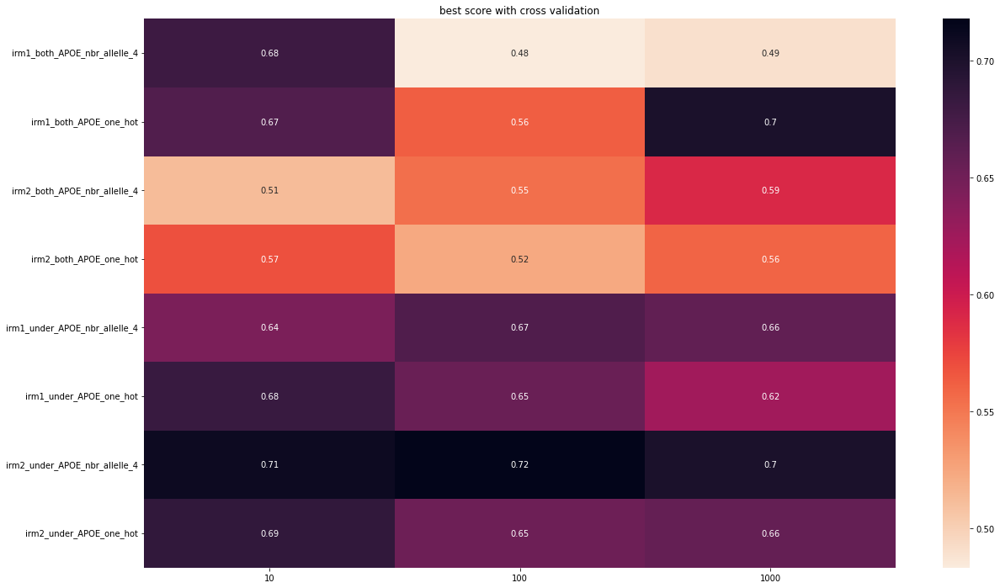

In [27]:
if True:
    path="./backup_models/preclinical/RF/"+feat_selec+"/"+scoring
    if feat_selec == "with_fs":
        path="./backup_models/preclinical/RF/"+feat_selec+"/"+str(target_nbr)+"/"+scoring

    plot_scores(path, plots=["score_on_cross_val"], v=True)

### Learning Curve & XAI

In [23]:
if False:
    path="./backup_models/preclinical/RF/"+feat_selec+"/"+scoring
    if feat_selec == "with_fs":
        path="./backup_models/preclinical/RF/"+feat_selec+"/"+str(target_nbr)+"/"+scoring
        
    files = os.listdir(path)
    dir_grid = max([datetime.strptime(f, "%d-%m-%Y_%Hh%Mm%Ss") for f in files if os.path.isdir(path+'/'+f)]).strftime("%d-%m-%Y_%Hh%Mm%Ss")
    for scores in os.listdir(path+"/"+dir_grid):
        if "score_on_cross_val" in scores:
            strat_df_score_cross_val = pd.read_csv(path+"/"+dir_grid+"/"+scores, index_col=0)
            break
    
    max_value = strat_df_score_cross_val.values.max()

    max_positions = list(zip(*np.where(strat_df_score_cross_val == max_value)))

    # Create the associations
    targets = [f"{strat_df_score_cross_val.columns[col]}_{strat_df_score_cross_val.index[row]}" for row, col in max_positions]
    #targets = ['10_irm2_APOE_nbr_allelle_4_irm2_APOE_one_hot', '100_irm2_APOE_nbr_allelle_4_irm2_APOE_one_hot', '1000_irm2_APOE_nbr_allelle_4_irm2_APOE_one_hot']
    print("targets: "+str(targets))
    print(new_dbs.keys())
    print(path)
    groupkfold = StratifiedGroupKFold(n_splits=5)
    #plot_learning_curves(new_dbs, path, targets, 5, 3, v=True, scoring=f1_score, binary=False)
    #XAI_analyses(new_dbs, path, targets, custom_scorer, v=True, nsplits_exp=5, shap=False)
    plot_confusion_matrices(new_dbs, path, targets, groupkfold,scores_options[scoring], binary, [0,1], [1], summat=False)
    plot_roc_curve(new_dbs, path, targets, groupkfold)

### SVM

irm1_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.661 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.258 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.575 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.550 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.741 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.661 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.258 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.575 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.550 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.741 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=linear;, score=0.661 total time=   0.0s
[CV 2

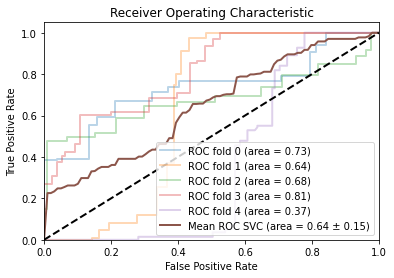

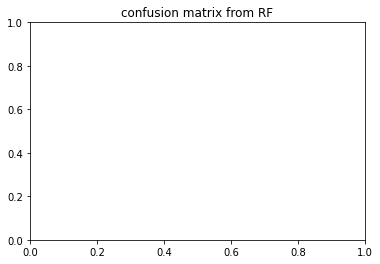

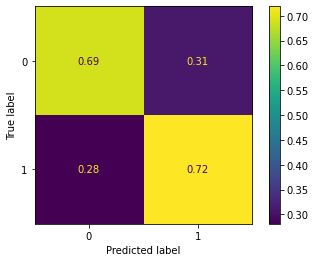

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.655 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.263 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.575 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.566 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.748 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.655 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.263 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.575 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.566 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.748 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=l

<Figure size 432x288 with 0 Axes>

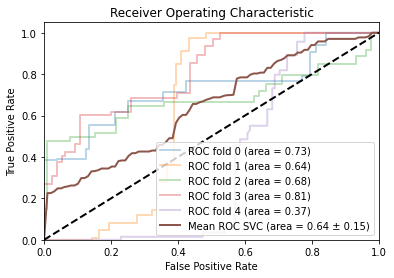

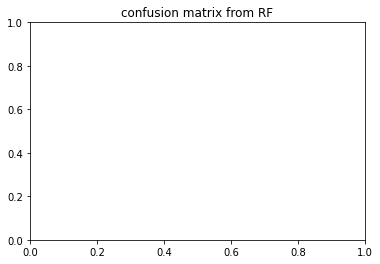

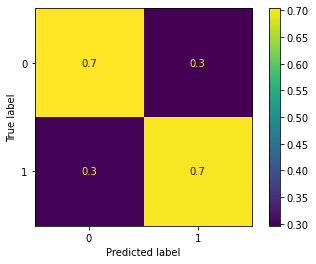

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.503 total time=   0.1s
[CV 2/5] END ................C=1, kernel=linear;, score=0.681 total time=   0.1s
[CV 3/5] END ................C=1, kernel=linear;, score=0.489 total time=   0.1s
[CV 4/5] END ................C=1, kernel=linear;, score=0.561 total time=   0.1s
[CV 5/5] END ................C=1, kernel=linear;, score=0.937 total time=   0.1s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.503 total time=   0.1s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.681 total time=   0.1s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.489 total time=   0.1s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.561 total time=   0.1s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.937 total time=   0.1s
[CV 1/5] END ..............C=100, ke

<Figure size 432x288 with 0 Axes>

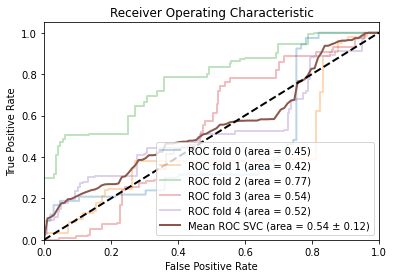

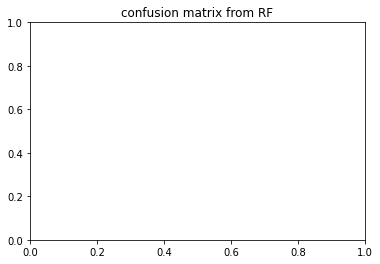

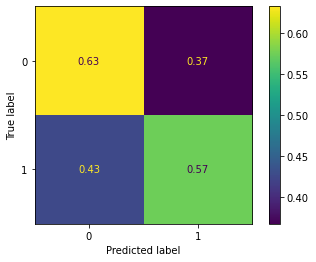

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.492 total time=   0.1s
[CV 2/5] END ................C=1, kernel=linear;, score=0.688 total time=   0.1s
[CV 3/5] END ................C=1, kernel=linear;, score=0.500 total time=   0.1s
[CV 4/5] END ................C=1, kernel=linear;, score=0.577 total time=   0.1s
[CV 5/5] END ................C=1, kernel=linear;, score=0.951 total time=   0.1s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.492 total time=   0.1s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.688 total time=   0.1s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.500 total time=   0.1s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.577 total time=   0.1s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.951 total time=   0.1s
[CV 1/5] END ..............C=100, kernel=l

<Figure size 432x288 with 0 Axes>

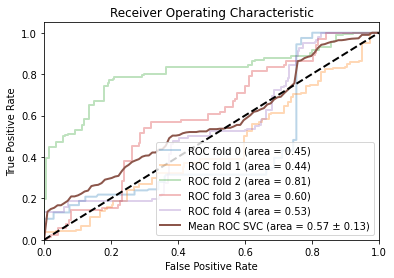

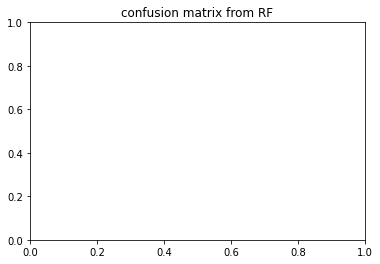

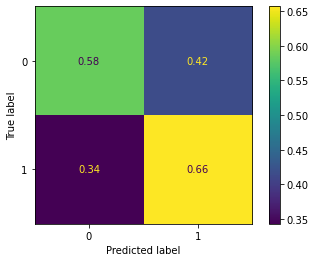

{'C': 10, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.762 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.747 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.815 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.849 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.601 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.762 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.747 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.815 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.849 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.601 total time=   0.0s
[CV 1/5] END ..............C=100, 

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

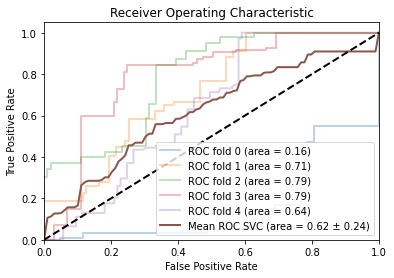

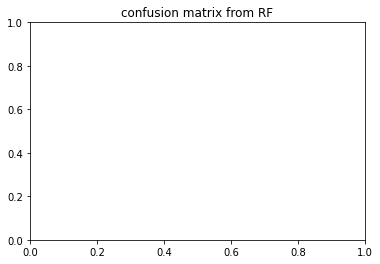

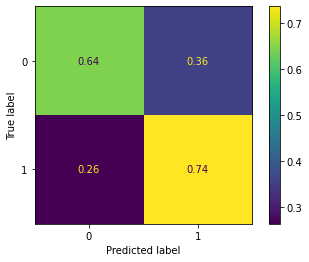

{'C': 10, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.764 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.748 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.814 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.852 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.602 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.763 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.748 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.814 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.852 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.602 total time=   0.0s
[CV 1/5] END ..............C=100, kernel

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

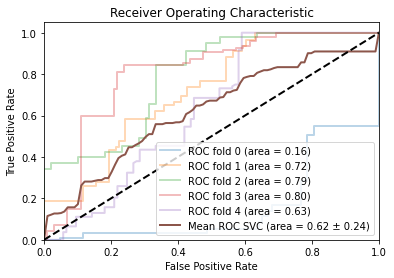

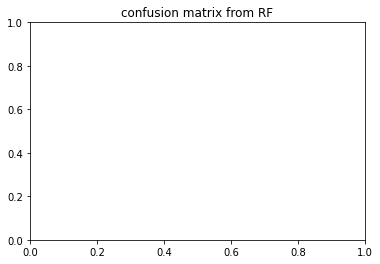

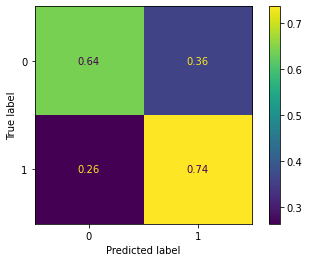

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.405 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.472 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.548 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.495 total time=   0.1s
[CV 5/5] END ................C=1, kernel=linear;, score=0.869 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.405 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.472 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.548 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.495 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.869 total time=   0.0s
[CV 1/5] END ..............C=100, k

<Figure size 432x288 with 0 Axes>

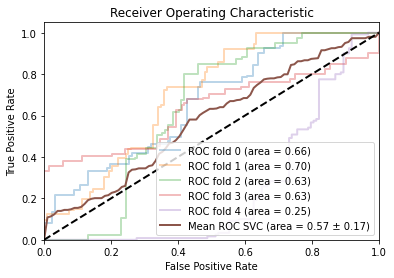

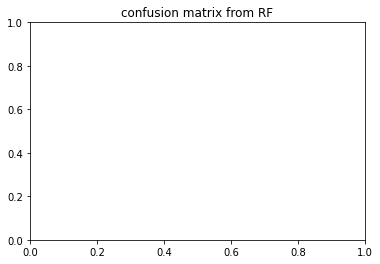

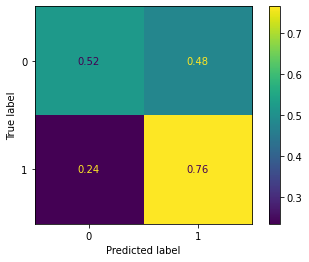

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.410 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.481 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.532 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.498 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.862 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.410 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.482 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.532 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.498 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.862 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=

<Figure size 432x288 with 0 Axes>

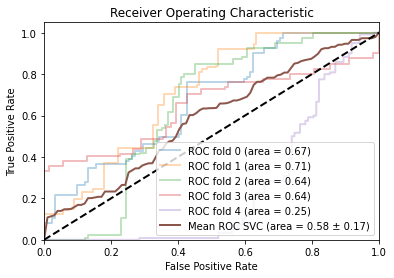

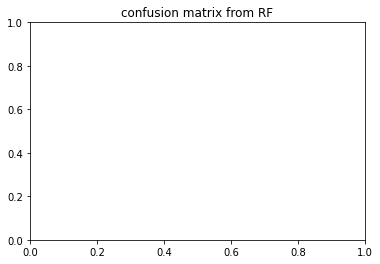

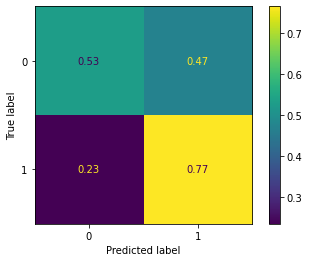

{'C': 10, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.593 total time=   0.2s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.591 total time=   0.2s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.557 total time=   0.2s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.193 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.479 total time=   0.2s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.615 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.525 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.646 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.296 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.512 total time=   0.1s
[CV 1/5] END .....C=1, gamma=0.0001, k

<Figure size 432x288 with 0 Axes>

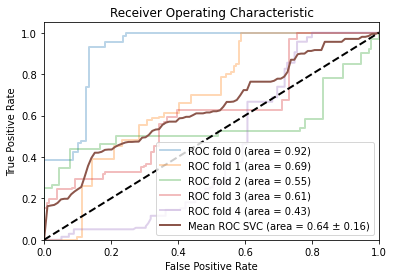

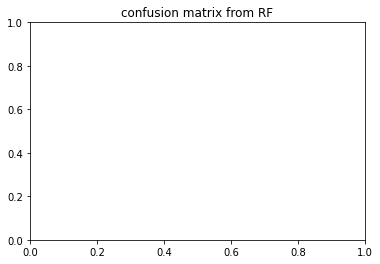

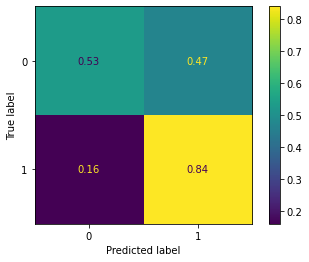

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.588 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.601 total time=   0.2s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.557 total time=   0.2s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.193 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.490 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.612 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.540 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.649 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.298 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.522 total time=   0.1s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

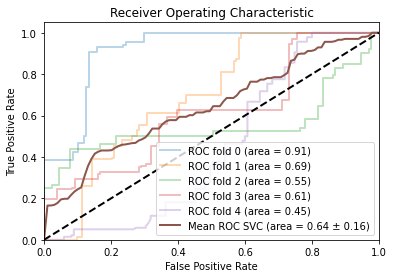

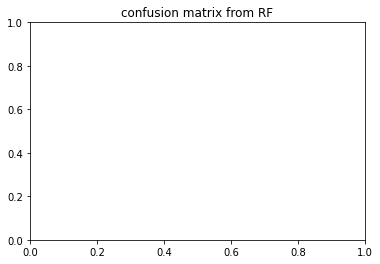

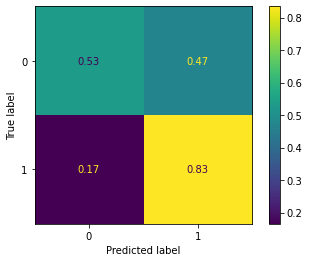

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.431 total time=   0.4s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.756 total time=   0.3s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.636 total time=   0.4s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.380 total time=   0.3s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.985 total time=   0.4s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.429 total time=   0.3s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.765 total time=   0.3s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.578 total time=   0.4s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.494 total time=   0.4s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.995 total time=   0.4s
[CV 1/5] END .....C=1, ga

<Figure size 432x288 with 0 Axes>

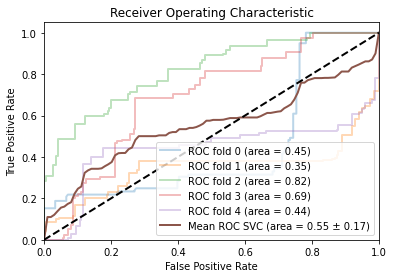

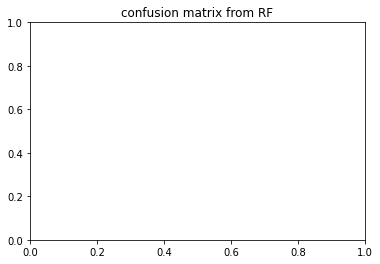

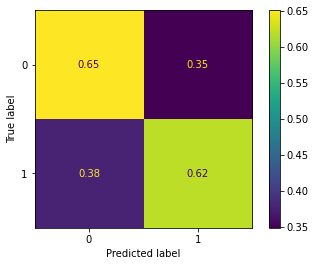

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.430 total time=   0.4s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.748 total time=   0.4s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.640 total time=   0.4s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.386 total time=   0.4s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.985 total time=   0.5s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.428 total time=   0.3s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.759 total time=   0.4s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.584 total time=   0.4s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.504 total time=   0.5s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.997 total time=   0.5s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

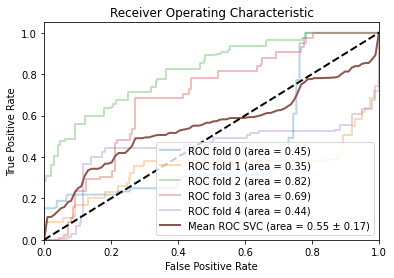

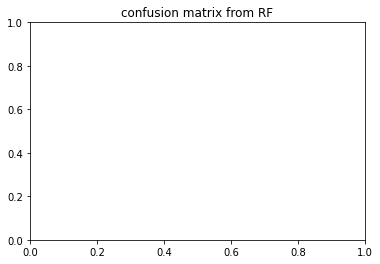

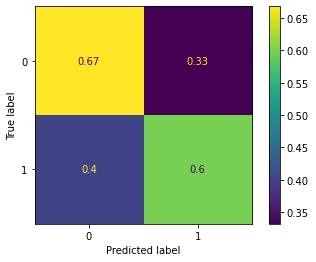

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.742 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.877 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.805 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.933 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.351 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.716 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.823 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.773 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.893 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.413 total time=   0.0s
[CV 1/5] END .....C=1, g

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

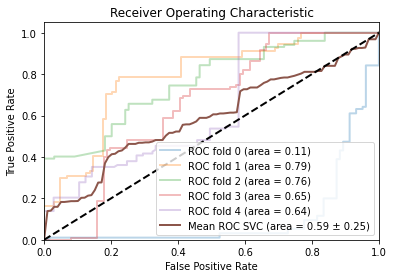

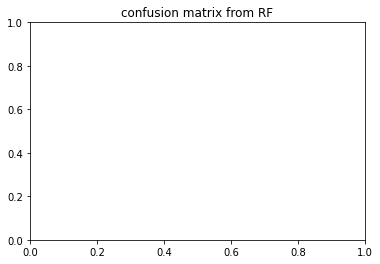

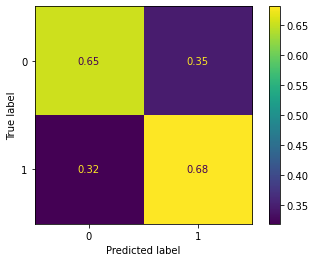

{'C': 100, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.741 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.877 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.808 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.930 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.351 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.716 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.822 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.772 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.894 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.410 total time=   0.0s
[CV 1/5] END .....C=1, gamm

<Figure size 432x288 with 0 Axes>

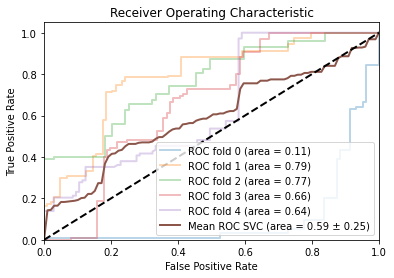

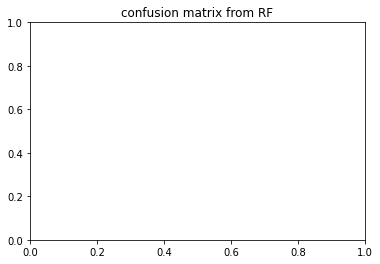

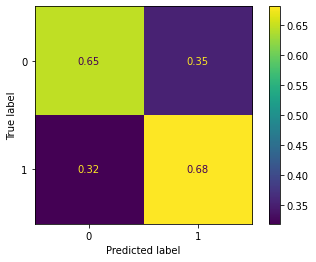

{'C': 100, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.536 total time=   0.2s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.284 total time=   0.2s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.511 total time=   0.3s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.741 total time=   0.2s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.887 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.552 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.265 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.521 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.742 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.903 total time=   0.1s
[CV 1/5] END .....C=1

<Figure size 432x288 with 0 Axes>

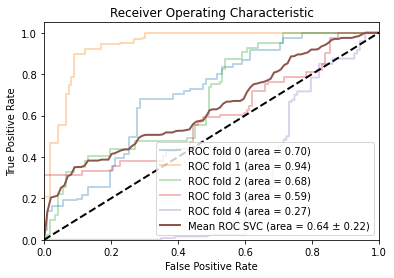

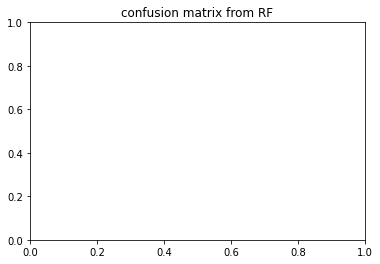

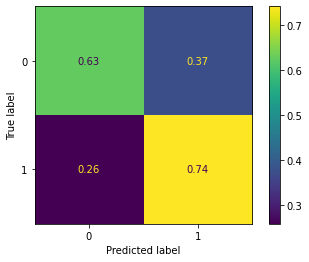

{'C': 10, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.538 total time=   0.2s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.283 total time=   0.2s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.509 total time=   0.2s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.742 total time=   0.2s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.885 total time=   0.2s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.559 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.263 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.518 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.745 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.900 total time=   0.1s
[CV 1/5] END .....C=1, gamma=

<Figure size 432x288 with 0 Axes>

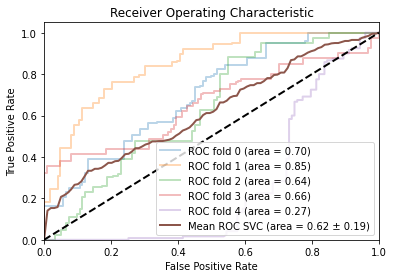

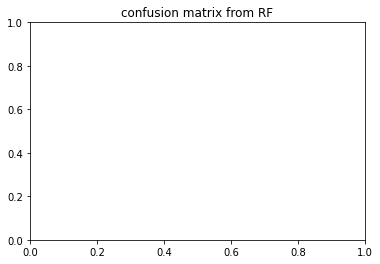

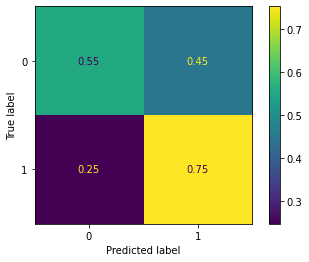

{'C': 100, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.319 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.700 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.552 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.256 total time=   0.2s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.613 total time=   0.2s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.200 total time=   0.5s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.669 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.528 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=0.001, k

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.262 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.361 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.409 total time=   0.4s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.073 total time=   0.4s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.664 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.367 total time=   0.4s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.336 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.964 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.547 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.262 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.774 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.550 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.965 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.557 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.248 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.607 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.465 total time=   0.4s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.089 total time=   0.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.492 total time=   0.5s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.675 total time=   0.4s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.264 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.752 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.551 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.302 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.520 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.167 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.609 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.343 total time=   0.3s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.507 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.296 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.239 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.532 total time=   0.7s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.671 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.389 total time=   0.4s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.336 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.956 total time=   0.1s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.519 total time=   0.1s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.555 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.271 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.741 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.631 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.310 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.586 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.398 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.722 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.678 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.902 total time=   0.4s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.593 total time=   0.4s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.633 total time=   0.4s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.693 total time=   0.4s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.326 total time=   0.4s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.268 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.757 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.550 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.330 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.490 total time=   0.1s
[CV 1

[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.714 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.229 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.605 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.373 total time=   0.3s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.299 total time=   0.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.303 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.289 total time=   0.4s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.223 total time=   0.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.553 total time=   0.4s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.663 total time=   0.4s
[CV 5/

[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.531 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.687 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.395 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.769 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.557 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.250 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.675 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.543 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.521 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.562 total time=   0.0s
[CV 4/5]

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

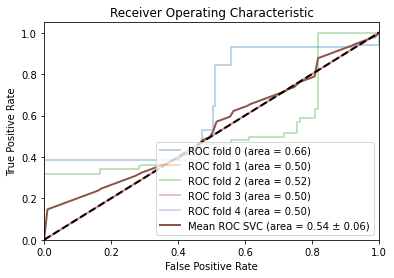

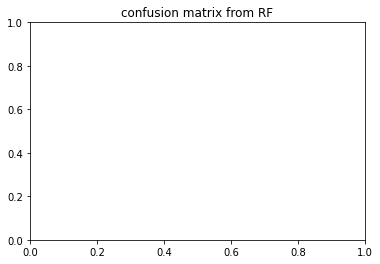

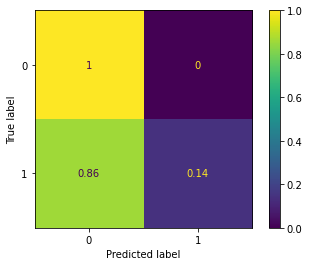

{'C': 10, 'coef0': 0.0, 'degree': 5, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.313 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.703 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.552 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.253 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.625 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.197 total time=   0.4s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.672 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.532 total time=   0.5s
[CV 4/5] END C=1, coef0=0.0, deg

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.262 total time=   0.5s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.374 total time=   0.5s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.595 total time=   0.5s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.073 total time=   0.5s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.664 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.365 total time=   0.5s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.321 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.967 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.551 total time=   0.2s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.262 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.780 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.534 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.965 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.557 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.248 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.614 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.457 total time=   0.4s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.084 total time=   0.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.508 total time=   0.5s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.675 total time=   0.4s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.336 total time=   0.5s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.258 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.753 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.552 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.298 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.540 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.147 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.641 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.350 total time=   0.3s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.510 total time=   0.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.296 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.244 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.202 total time=   0.4s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.532 total time=   0.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.670 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.383 total time=   0.5s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.325 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.961 total time=   0.1s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.532 total time=   0.1s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.559 total time=   0.1s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.271 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.748 total time=   0.1s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.622 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.319 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.592 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.404 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.729 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.665 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.097 total time=   0.5s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.590 total time=   0.6s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.694 total time=   0.5s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.258 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.764 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.553 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.306 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.503 total time=   0.1s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.280 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.724 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.222 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.788 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.381 total time=   0.3s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.299 total time=   0.4s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.307 total time=   0.3s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.218 total time=   0.5s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.7s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.208 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.576 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.532 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.693 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.387 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.786 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.557 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.250 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.684 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.535 total time=   0.0s
[CV 2/

<Figure size 432x288 with 0 Axes>

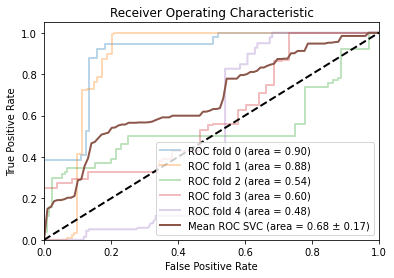

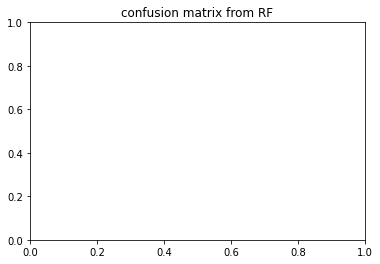

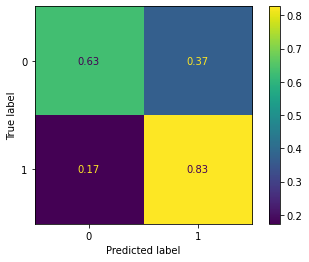

{'C': 1, 'coef0': 0.5, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.508 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.500 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.410 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.503 total time=   0.4s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.958 total time=   0.6s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.265 total time=   1.3s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.451 total time=   1.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.504 total time=   1.0s
[CV 4/5] END C=1, coef0=0.0

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.344 total time=   1.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.962 total time=   1.7s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   2.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.650 total time=   1.4s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.281 total time=   1.3s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.593 total time=   1.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.005 total time=   1.3s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.257 total time=   0.5s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.507 total time=   0.4s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.484 total time=   0.4s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.533 total time=   0.4s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.941 total time=   0.5s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.271 total time=   0.6s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.538 total time=   0.7s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.534 total time=   0.6s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.522 total time=   0.5s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.958 total time=   0.5s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.474 total time=   1.6s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.353 total time=   1.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.726 total time=   1.3s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.515 total time=   1.5s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.4s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.363 total time=   0.4s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.529 total time=   0.4s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.409 total time=   0.3s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.535 total time=   0.4s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.929 total time=   0.4s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.265 total time=   1.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.470 total time=   0.9s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.428 total time=   0.9s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.552 total time=   0.9s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.404 total time=   0.8s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.911 total time=   1.0s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.777 total time=   1.3s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.359 total time=   1.4s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.3s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.246 total time=   0.4s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.529 total time=   0.4s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.584 total time=   0.2s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.569 total time=   0.3s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.516 total time=   0.2s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.974 total time=   0.2s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.466 total time=   0.1s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.680 total time=   0.2s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.545 total time=   0.2s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.501 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.987 total time=   0.2s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.481 total time=   0.1s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.4s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.350 total time=   1.5s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.5s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.525 total time=   1.4s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.476 total time=   1.5s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.388 total time=   0.4s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.538 total time=   0.4s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.407 total time=   0.4s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.568 total time=   0.4s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.898 total time=   0.4s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.561 total time=   0.4s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.903 total time=   0.4s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.207 total time=   1.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.432 total time=   1.0s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.605 total time=   1.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.507 total time=   1.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.898 total time=   1.3s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.812 total time=   1.5s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.626 total time=   1.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.307 total time=   1.4s
[CV 4/5

[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.493 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.538 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.955 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.446 total time=   0.3s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.547 total time=   0.2s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.602 total time=   0.3s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.488 total time=   0.2s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.957 total time=   0.3s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.442 total time=   0.2s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.584 total time=   0.2s
[CV 3/5

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

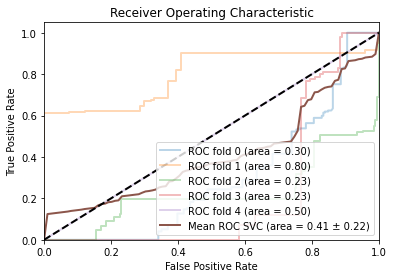

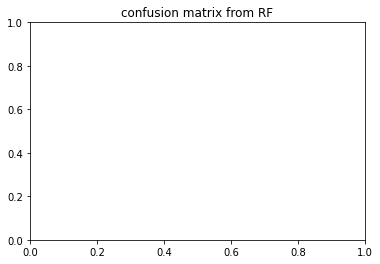

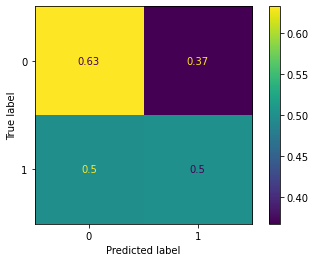

{'C': 1, 'coef0': 0.1, 'degree': 9, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.496 total time=   0.4s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.499 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.413 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.505 total time=   0.4s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.958 total time=   0.5s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.256 total time=   1.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.446 total time=   1.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.506 total time=   1.1s
[CV 4/5] END C=1, coef0=0.0, degr

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.345 total time=   1.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.961 total time=   1.7s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.753 total time=   1.9s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.651 total time=   1.8s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.281 total time=   2.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.593 total time=   1.8s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.005 total time=   2.0s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.253 total time=   0.7s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.503 total time=   0.6s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.483 total time=   0.7s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.532 total time=   0.4s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.942 total time=   0.4s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.265 total time=   0.7s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.536 total time=   0.6s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.534 total time=   0.8s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.521 total time=   0.5s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.957 total time=   0.6s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.4s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.349 total time=   1.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.726 total time=   1.4s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.515 total time=   1.4s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.7s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.341 total time=   0.5s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.525 total time=   0.4s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.407 total time=   0.4s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.537 total time=   0.4s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.930 total time=   0.5s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.256 total time=   1.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.463 total time=   1.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.431 total time=   1.0s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.553 total time=   1.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.406 total time=   1.0s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.910 total time=   1.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.775 total time=   2.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.6s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.288 total time=   1.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.601 total time=   1.6s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.6s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.241 total time=   0.6s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.527 total time=   0.6s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.585 total time=   0.3s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.574 total time=   0.3s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.521 total time=   0.2s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.975 total time=   0.3s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.457 total time=   0.1s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.688 total time=   0.2s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.552 total time=   0.2s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.511 total time=   0.2s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.988 total time=   0.3s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.480 total time=   0.2s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.4s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.426 total time=   1.3s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.492 total time=   1.3s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.4s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.6s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.366 total time=   0.4s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.537 total time=   0.5s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.402 total time=   0.5s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.567 total time=   0.4s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.902 total time=   0.5s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.560 total time=   0.6s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.903 total time=   0.5s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.203 total time=   1.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.432 total time=   1.0s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.602 total time=   1.0s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.511 total time=   0.8s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.898 total time=   1.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.4s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.626 total time=   1.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.4s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.691 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.505 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.552 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.962 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.447 total time=   0.3s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.545 total time=   0.2s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.604 total time=   0.2s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.489 total time=   0.2s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.958 total time=   0.3s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.443 total time=   0.2s
[CV 2/

<Figure size 432x288 with 0 Axes>

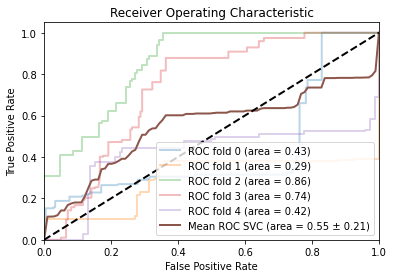

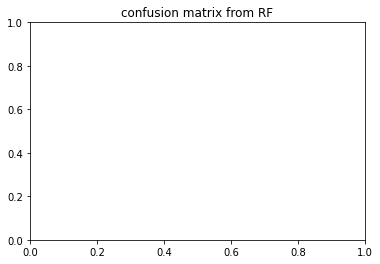

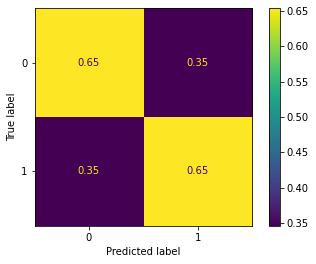

{'C': 1, 'coef0': 0.5, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.818 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.879 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.769 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.960 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.284 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.822 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.838 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.743 total time=   0.1s
[CV 4/5] END C=1, coef0=0.

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.511 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.231 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.231 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.194 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.734 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.804 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.996 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.686 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.808 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.129 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.772 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.963 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.807 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.913 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.220 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.474 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.215 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.771 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.310 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.745 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.831 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.911 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.701 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.924 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.224 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.786 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.835 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.657 total time=   0.1s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.696 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.680 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.209 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.230 total time=   0.2s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.781 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.282 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.741 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.785 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.919 total time=   0.1s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.846 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.821 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.956 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.324 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.703 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.834 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.835 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.932 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.440 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.738 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.247 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.589 total time=   0.4s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.730 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.340 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.731 total time=   0.2s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.823 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.901 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.684 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.892 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.284 total time=   0.1s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.757 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.115 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.803 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.862 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.716 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.669 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.136 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.226 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.230 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.766 total time=   0.2s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.760 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.854 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.889 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.616 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.740 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.908 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.802 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.960 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.251 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.713 total time=   0.0s
[CV 2/

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

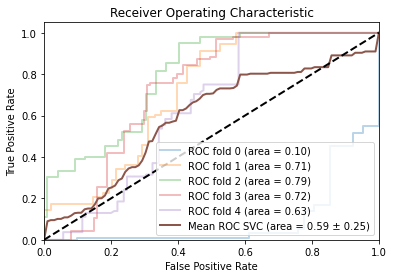

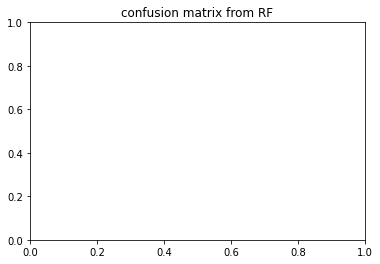

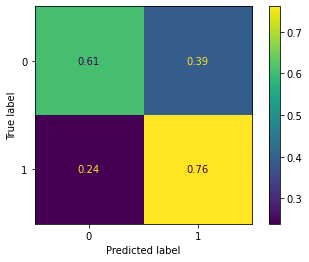

{'C': 100, 'coef0': 1.0, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.815 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.874 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.775 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.962 total time=   0.2s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.267 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.823 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.838 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.747 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, d

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.509 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.232 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.231 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.194 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.733 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.805 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.995 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.683 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.810 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.129 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.772 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.962 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.806 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.915 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.221 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.739 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.215 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.773 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.314 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.745 total time=   0.3s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.832 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.908 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.703 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.925 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.211 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.784 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.835 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.720 total time=   0.1s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.697 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.685 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.206 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.251 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.230 total time=   0.2s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.282 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.741 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.785 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.919 total time=   0.1s
[CV 3/5] END C=

[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.824 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.956 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.328 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.706 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.834 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.835 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.932 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.439 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.743 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.832 total time=   0.0s
[CV 3/5] END C=10,

[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.588 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.707 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.346 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.731 total time=   0.2s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.823 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.906 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.691 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.898 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.248 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.766 total time=   0.1s
[CV 2/

[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.115 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.794 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.866 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.717 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.668 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.135 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.230 total time=   0.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.233 total time=   0.4s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.398 total time=   0.4s
[CV 5/

[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.856 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.892 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.615 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.739 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.908 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.805 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.960 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.251 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.712 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.847 total time=   0.0s
[CV 3/5

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

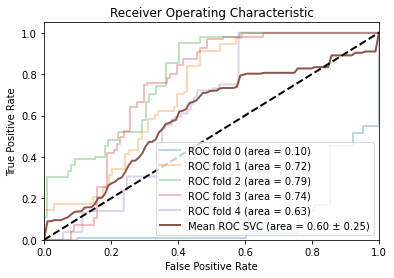

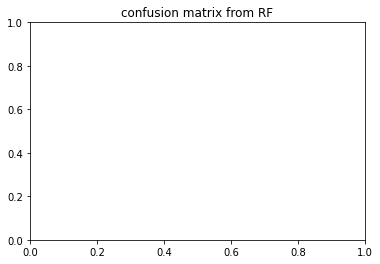

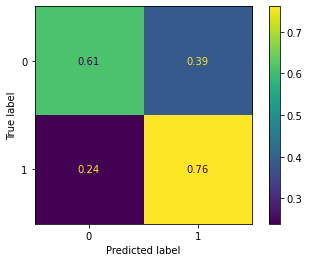

{'C': 100, 'coef0': 1.0, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.475 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.226 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.456 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.769 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.858 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.282 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.189 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.538 total time=   0.3s
[CV 4/5] END C=1, coef0=

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.589 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.581 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.290 total time=   0.3s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.726 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.540 total time=   0.4s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.423 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.069 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.422 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.498 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.437 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.840 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.868 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.406 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.324 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.473 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.794 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.899 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.229 total time=   0.3s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.543 total time=   0.3s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.350 total time=   0.3s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.409 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.340 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.445 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.771 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.828 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.296 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.267 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.560 total time=   0.3s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.596 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.680 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.732 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.321 total time=   0.3s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.726 total time=   0.3s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.540 total time=   0.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.423 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.069 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.414 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.524 total time=   0.2s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.360 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.500 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.741 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.880 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.491 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.409 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.517 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.648 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.891 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.694 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.370 total time=   0.3s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.819 total time=   0.3s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.497 total time=   0.3s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.454 total time=   0.3s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.647 total time=   0.3s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.434 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.388 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.426 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.802 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.783 total time=   0.2s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.829 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.746 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.372 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.552 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.534 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.708 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.755 total time=   0.3s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.341 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.727 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.538 total time=   0.3s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.484 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.526 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.546 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.878 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.485 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.335 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.486 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.787 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.887 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.558 total time=   0.0s
[CV 2/

<Figure size 432x288 with 0 Axes>

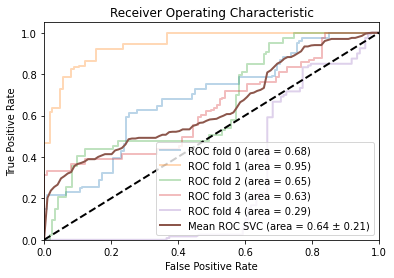

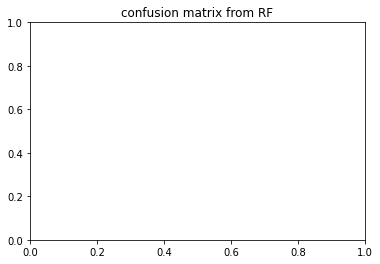

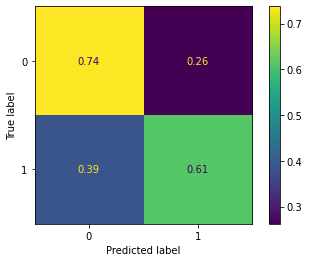

{'C': 100, 'coef0': 0.5, 'degree': 5, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.472 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.228 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.456 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.769 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.859 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.287 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.189 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.537 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, d

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.589 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.587 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.289 total time=   0.3s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.726 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.540 total time=   0.3s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.423 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.422 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.493 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.441 total time=   0.2s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.839 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.872 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.400 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.323 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.477 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.793 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.897 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.229 total time=   0.3s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.270 total time=   0.3s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.457 total time=   0.3s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.448 total time=   0.3s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.351 total time=   0.3s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.409 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.335 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.444 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.772 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.831 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.301 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.256 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.560 total time=   0.3s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.596 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.681 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.733 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.321 total time=   0.3s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.726 total time=   0.3s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.540 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.071 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.413 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.529 total time=   0.2s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.359 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.501 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.743 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.879 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.498 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.410 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.517 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.653 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.889 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.697 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.371 total time=   0.3s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.819 total time=   0.3s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.496 total time=   0.3s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.455 total time=   0.3s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.647 total time=   0.3s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.434 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.391 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.423 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.799 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.786 total time=   0.2s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.832 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.750 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.369 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.567 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.532 total time=   0.3s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.706 total time=   0.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.759 total time=   0.3s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.341 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.727 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.538 total time=   0.3s
[CV 4/5

[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.526 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.557 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.872 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.485 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.334 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.484 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.787 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.887 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.562 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.359 total time=   0.0s
[CV 3/5

<Figure size 432x288 with 0 Axes>

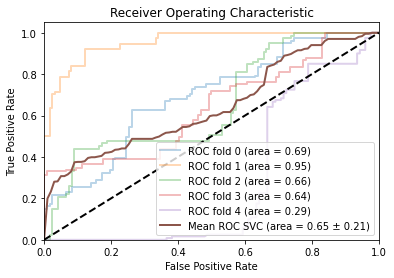

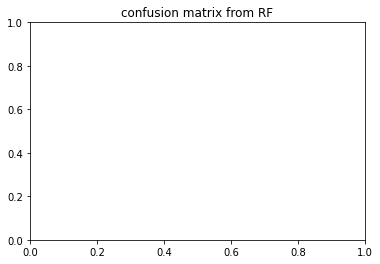

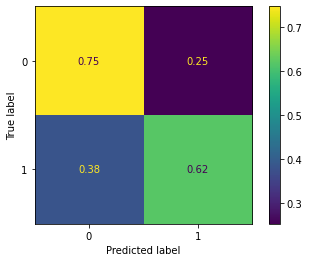

{'C': 100, 'coef0': 0.5, 'degree': 5, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.426 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.431 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.283 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.434 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.534 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.625 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.338 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.514 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.525 total ti

[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.353 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.584 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.498 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.856 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.816 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.835 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.348 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.659 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.516 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.574 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.651 total time=   0.1

{'C': 10, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

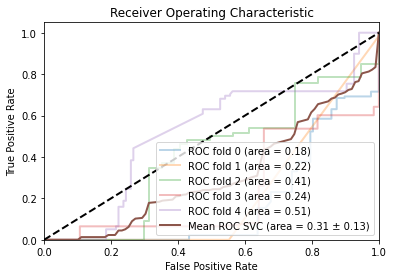

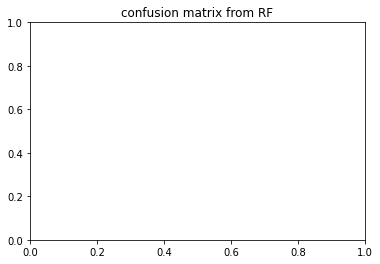

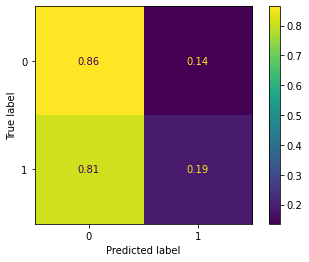

{'C': 10, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm1_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.434 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.441 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.286 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.433 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.545 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.621 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.374 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.514 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.521 total time=   0.1s
[CV 5

[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.352 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.583 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.500 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.843 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.821 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.834 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.356 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.663 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.511 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.597 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.644 total time=   0.1

{'C': 10, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

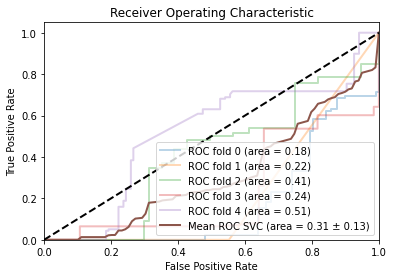

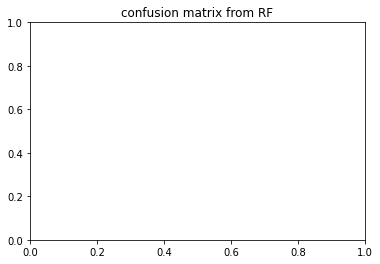

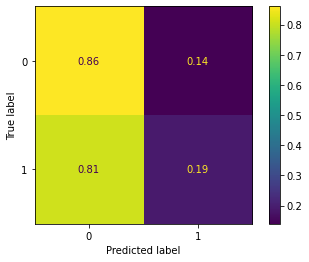

{'C': 10, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.346 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.939 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.596 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.818 total time=   0.5s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.961 total time=   0.4s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.494 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.720 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.497 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.702 total time=   0.5s

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.971 total time=   0.4s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.717 total time=   0.4s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.615 total time=   0.4s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.721 total time=   0.5s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.936 total time=   0.5s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.466 total time=   0.4s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.583 total time=   0.3s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.641 total time=   0.2s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.194 total time=   0.2s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.956 total time=   0.3s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.864 total time=   0.2

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.944 total time=   0.2s
{'C': 100, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

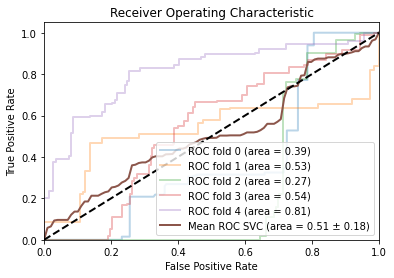

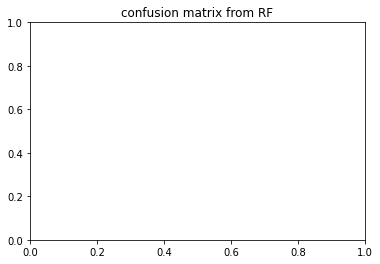

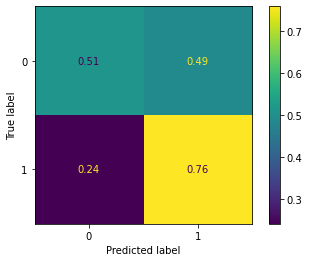

{'C': 100, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.348 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.941 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.601 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.818 total time=   0.4s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.959 total time=   0.4s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.489 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.721 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.506 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.709 total time=   0.3s
[CV 

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.972 total time=   0.3s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.716 total time=   0.4s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.615 total time=   0.4s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.717 total time=   0.5s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.921 total time=   0.6s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.465 total time=   0.6s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.585 total time=   0.2s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.641 total time=   0.2s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.196 total time=   0.2s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.956 total time=   0.4s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.859 total time=   0.2

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.955 total time=   0.2s
{'C': 100, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

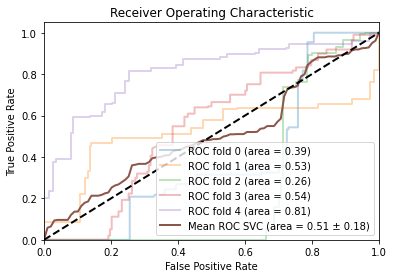

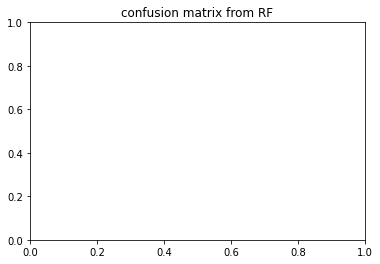

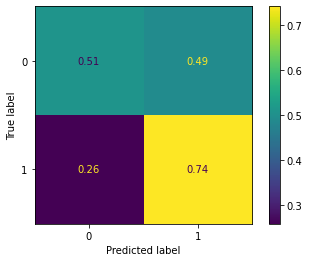

{'C': 100, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.784 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.795 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.722 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.852 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.567 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.766 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.827 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.763 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.870 total time=   0.

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.578 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.714 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.469 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.607 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.551 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.827 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.749 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.614 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.637 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.941 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.878 total time=   0.0

{'C': 100, 'coef0': 0.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

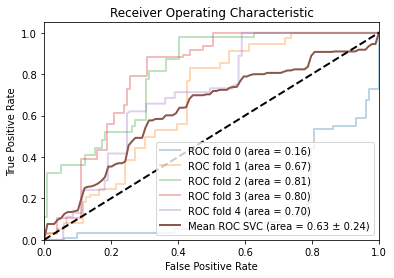

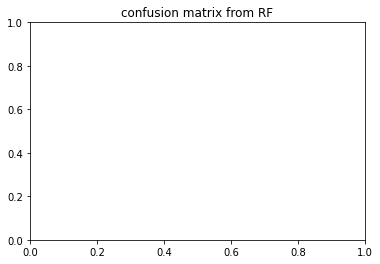

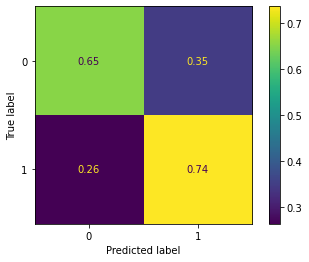

{'C': 100, 'coef0': 0.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.780 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.796 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.722 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.856 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.567 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.770 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.824 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.763 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.871 total time=   0.0s
[CV 5

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.575 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.713 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.404 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.604 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.549 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.826 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.750 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.623 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.637 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.941 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.877 total time=   0.0

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.640 total time=   0.0s
{'C': 100, 'coef0': 0.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

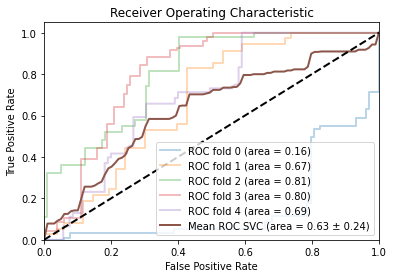

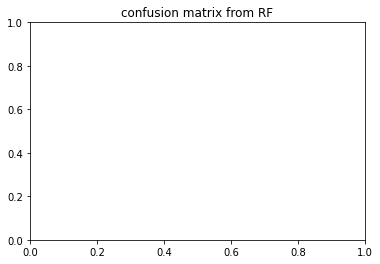

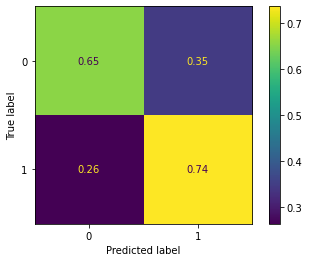

{'C': 100, 'coef0': 0.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.750 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.344 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.571 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.614 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.804 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.722 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.202 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.513 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.719 total time=   0.1s

[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.869 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.486 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.538 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.742 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.967 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.591 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.356 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.590 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.753 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.796 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.715 total time=   0.1

{'C': 10, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

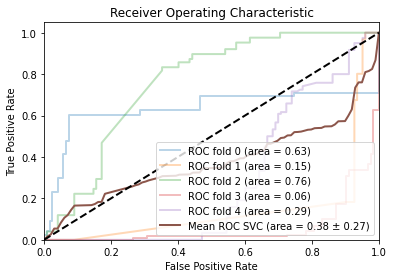

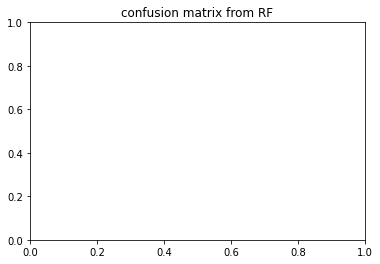

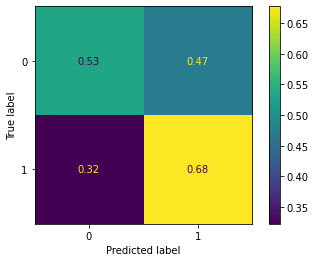

{'C': 10, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.753 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.343 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.571 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.615 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.781 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.725 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.201 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.511 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.725 total time=   0.1s
[CV 

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.922 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.870 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.483 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.533 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.740 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.962 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.592 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.353 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.583 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.750 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.778 total time=   0.0

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.931 total time=   0.1s
{'C': 100, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

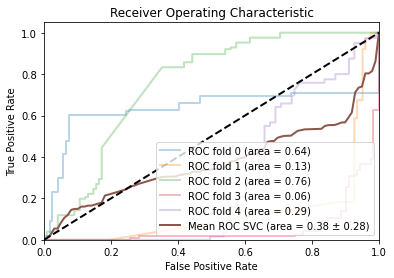

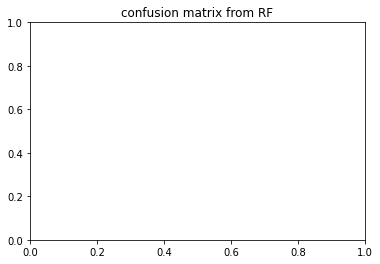

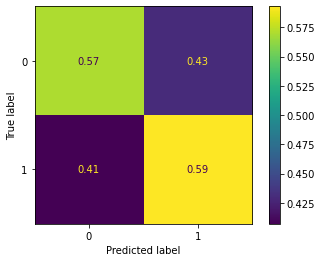

{'C': 100, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.556827,0.644248,0.647453,0.743881
irm1_both_APOE_one_hot,0.561401,0.650622,0.610407,0.725611
irm2_both_APOE_nbr_allelle_4,0.634238,0.662511,0.701095,0.783330
irm2_both_APOE_one_hot,0.641673,0.662561,0.674797,0.783853
irm1_under_APOE_nbr_allelle_4,0.754996,0.762585,0.771204,0.777881
irm1_under_APOE_one_hot,0.755946,0.762189,0.772132,0.779160
irm2_under_APOE_nbr_allelle_4,0.557747,0.613744,0.624124,0.720354
irm2_under_APOE_one_hot,0.556847,0.615292,0.625976,0.721450


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.734949,0.917202,0.655179,0.179467
irm1_both_APOE_one_hot,0.726166,0.912598,0.896426,0.176802
irm2_both_APOE_nbr_allelle_4,0.449166,0.451404,0.296160,0.386208
irm2_both_APOE_one_hot,0.448276,0.451332,0.433048,0.386280
irm1_under_APOE_nbr_allelle_4,0.159939,0.107256,0.095554,0.156362
irm1_under_APOE_one_hot,0.161267,0.108431,0.097905,0.157895
irm2_under_APOE_nbr_allelle_4,0.664544,0.700650,0.683038,0.633180
irm2_under_APOE_one_hot,0.673283,0.696992,0.690625,0.636160


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.645075,0.639200,0.535762,0.312208
irm1_both_APOE_one_hot,0.645227,0.643169,0.678728,0.312505
irm2_both_APOE_nbr_allelle_4,0.539860,0.549469,0.409625,0.506990
irm2_both_APOE_one_hot,0.564375,0.549034,0.547646,0.505619
irm1_under_APOE_nbr_allelle_4,0.617767,0.589835,0.591080,0.624723
irm1_under_APOE_one_hot,0.619402,0.592766,0.594158,0.626353
irm2_under_APOE_nbr_allelle_4,0.575291,0.638563,0.641024,0.377542
irm2_under_APOE_one_hot,0.581836,0.621058,0.645565,0.375343


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.645075,0.639200,0.535762,0.312208
irm1_both_APOE_one_hot,0.645227,0.643169,0.678728,0.312505
irm2_both_APOE_nbr_allelle_4,0.539860,0.549469,0.409625,0.506990
irm2_both_APOE_one_hot,0.564375,0.549034,0.547646,0.505619
irm1_under_APOE_nbr_allelle_4,0.617767,0.589835,0.591080,0.624723
irm1_under_APOE_one_hot,0.619402,0.592766,0.594158,0.626353
irm2_under_APOE_nbr_allelle_4,0.575291,0.638563,0.641024,0.377542
irm2_under_APOE_one_hot,0.581836,0.621058,0.645565,0.375343


<Figure size 432x288 with 0 Axes>

In [28]:
svm_run = True

scores_options = {"auc_roc": roc_auc_score, "f1score": f1_score}
scoring = "auc_roc"
binary = False
proba_svc = True
if scoring == "auc_roc":
    proba_svc = True

custom_scorer = make_scorer(multiclass_score, greater_is_better=True, targets=[1], score=scores_options[scoring], 
                            binary=binary)

today = datetime.now().strftime("%d-%m-%Y_%Hh%Mm%Ss")
path="./backup_models/preclinical/SVM/"+feat_selec+"/"+scoring+"/"+today+"/"
if feat_selec == "with_fs":
    path="./backup_models/preclinical/SVM/"+feat_selec+"/"+str(target_nbr)+"/"+scoring+"/"+today+"/"
    
if svm_run:
    # ATTENTION: à changer quand stratégie change"
    
    os.makedirs(path+"gridsearch_models/", exist_ok=True)
    os.makedirs(path+"test_train_set/", exist_ok=True)
    os.makedirs(path+"dataset/", exist_ok=True)
    os.makedirs(path+"roc_curve/", exist_ok=True)
    os.makedirs(path+"cm/", exist_ok=True)
    os.makedirs(path+"report/", exist_ok=True)
    
    kernels = {"linear": {'C': [1, 10, 100], 'kernel': ['linear']}, 
               "rbf": {'C': [1, 10, 100], 'gamma': ['scale', 0.001, 0.0001], 'kernel': ['rbf']}, 
               "poly": {'C': [1, 10, 100], 'gamma': ['scale', 0.001, 0.0001], 'kernel': ['poly'], 'coef0': [0.0, 0.1, 0.5, 1.0],'degree': [3, 5, 7, 9]}, 
               "sigmoid": {'C': [1, 10, 100], 'gamma': ['scale', 0.001, 0.0001], 'kernel': ['sigmoid'],'coef0': [0.0, 0.1, 0.5, 1.0]}}


    strat_df_best_score = pd.DataFrame(columns=kernels.keys(), index=new_dbs.keys())
    strat_df_score_test = pd.DataFrame(columns=kernels.keys(), index=new_dbs.keys())
    strat_df_score_cross_val = pd.DataFrame(columns=kernels.keys(), index=new_dbs.keys())
    strat_df_score_cross_val_std = pd.DataFrame(columns=kernels.keys(), index=new_dbs.keys())
    top5_combinaison = []
    
    for k in kernels:
        for options in new_dbs:
            print(options)
            print("kernel: "+k)
            if len(top5_combinaison) == 0 or options in top5_combinaison:
                name_file = "kernel_"+k+"_"+options+"_score_"+scoring

                X = new_dbs[options][0].copy()
                y = new_dbs[options][1].copy()
                group_list = new_dbs[options][-1]
                groupkfold = StratifiedGroupKFold(n_splits=5)
                if options+".csv" not in os.listdir(path+"dataset"):
                    pd.concat([group_list, X, y], axis=1).to_csv(path + "dataset/" + options + ".csv")
                
                best_params, best_score, score_on_test, model = grid_searches(X, y, SVC, 
                                                                           custom_scorer, kernels[k], 
                                                                           path, name_file, cv_grid=groupkfold,
                                                                           cv_out_grid=groupkfold, group=group_list, basic_par={"probability": True})
                print(best_params)
                best_params["probability"] = proba_svc
                
                    
                ####### cross val + CM  + roc curve + scores  + STD


                y = y["diagnostic"]

                splitting = groupkfold.split(X, y, group_list)

                conf_matrix_list_of_arrays = []
                scores = []

                tprs = []
                aucs = []
                mean_fpr = np.linspace(0, 1, 100)
                fig, ax = plt.subplots()
                df_scores = []
                for indice, (train_index, test_index) in enumerate(splitting):

                    X_train, X_test, y_train, y_test = X.iloc[train_index], X.iloc[test_index], y.iloc[train_index], y.iloc[test_index]

                    model.fit(X_train, y_train)
                    # df_probs = pd.DataFrame(clf.predict_proba(X_test), columns=[i for i in clf.classes_])

                    y_pred_proba = model.predict_proba(X_test)[:, 1]

                    scores.append(roc_auc_score(y_test, y_pred_proba, multi_class="ovr", average="weighted"))

                    # Calculate ROC curve
                    fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
                    roc_auc = auc(fpr, tpr)
                    y_pred = (y_pred_proba > thresholds[np.argmax(tpr - fpr)]).astype('float')
                    conf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])

                    conf_matrix_list_of_arrays.append(conf_matrix)

                    # Tracer les courbes ROC pour chaque pli
                    plt.plot(fpr, tpr, lw=2, alpha=0.3,
                             label='ROC fold {0} (area = {1:0.2f})'
                                   ''.format(indice, roc_auc))


                    # Interpoler les tpr à la moyenne des fpr
                    tprs.append(np.interp(mean_fpr, fpr, tpr))
                    tprs[-1][0] = 0.0
                    
                    
                    report = classification_report(y_test, y_pred, labels=[0,1], output_dict=True)
                    df_for_scoring = pd.DataFrame(report).transpose()

                    new_line = [0]*(len(df_for_scoring.index)-2)
                    score_auc = roc_auc_score(y_test, y_pred_proba, average="macro", multi_class='ovr', labels=[0,1])
                    new_line.append(score_auc)
                    score_auc = roc_auc_score(y_test, y_pred_proba, average="weighted", multi_class='ovr', labels=[0,1])
                    new_line.append(score_auc)
                    df_for_scoring["auc"] = new_line

                    df_scores.append(df_for_scoring)

                # Tracer la moyenne des courbes ROC
                std_tpr = np.std(tprs, axis=0)
                mean_tpr = np.mean(tprs, axis=0)
                mean_tpr[-1] = 1.0
                mean_auc = auc(mean_fpr, mean_tpr)
                std_auc = np.std([auc(fpr, tpr) for fpr, tpr in zip([mean_fpr]*len(tprs), tprs)])
                plt.plot(mean_fpr, mean_tpr, linestyle='-', linewidth=2,
                             label='Mean ROC {0} (area = {1:0.2f} ± {2:0.2f})'.format(type(model).__name__, mean_auc, std_auc))


                plt.plot([0, 1], [0, 1], 'k--', lw=2)
                plt.xlim([0.0, 1.0])
                plt.ylim([0.0, 1.05])
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.title('Receiver Operating Characteristic')
                plt.legend(loc="lower right")
                if name_file is not None:
                    plt.savefig(path + "roc_curve/" + name_file + "_roc_curve.png")
                plt.show()
                plt.clf()

                sum_conf_mat = np.sum(conf_matrix_list_of_arrays, axis=0)

                plt.title("confusion matrix from RF")
                # Calcul de la somme des éléments de chaque ligne
                row_sums = np.sum(sum_conf_mat, axis=1)

                # Mise à l'échelle en divisant chaque élément par la somme de sa ligne
                scaled_arr = sum_conf_mat / row_sums[:, np.newaxis]
                # cm = ConfusionMatrixDisplay(sum_conf_mat / np.sum(sum_conf_mat), display_labels=classes).plot()
                ConfusionMatrixDisplay(scaled_arr, display_labels=[0,1]).plot()

                plt.savefig(path + "cm/" + name_file + "_cm.png")
                plt.show()
                plt.clf()
                
                
                # Calculer la moyenne de chaque élément
                mean_df = pd.concat(df_scores).groupby(level=0).mean().round(3)

                # Calculer l'écart type de chaque élément
                std_df = pd.concat(df_scores).groupby(level=0).std().round(3)
                mean_df.to_csv(path + "report/" + name_file + "_mean.csv")
                std_df.to_csv(path + "report/" + name_file + "_std.csv")
                ################ fin cross val
                print(best_params)
                strat_df_best_score.at[options, k] = best_score
                strat_df_score_test.at[options, k] = score_on_test
                strat_df_score_cross_val.at[options, k] = sum(scores)/len(scores)
                strat_df_score_cross_val_std.at[options, k] = statistics.pstdev(scores)
                
                
        
    strat_df_best_score.dropna(inplace=True)
    strat_df_score_test.dropna(inplace=True)
    strat_df_score_cross_val.dropna(inplace=True)
    strat_df_score_cross_val_std.dropna(inplace=True)

    for i in strat_df_best_score.columns:
        strat_df_best_score[i] = strat_df_best_score[i].astype(float)
        strat_df_score_test[i] = strat_df_score_test[i].astype(float)
        strat_df_score_cross_val[i] = strat_df_score_cross_val[i].astype(float)
        strat_df_score_cross_val_std[i] = strat_df_score_cross_val[i].astype(float)


    display(strat_df_best_score)
    display(strat_df_score_test)
    display(strat_df_score_cross_val)
    display(strat_df_score_cross_val_std)

    strat_df_best_score.to_csv(path+"best_scores_in_grid.csv")
    strat_df_score_test.to_csv(path+"score_on_test.csv")
    strat_df_score_cross_val.to_csv(path+"score_on_cross_val.csv")
    strat_df_score_cross_val_std.to_csv(path+"score_on_cross_val_std.csv")

In [ ]:
sys.exit()

### Pot Scores

the score on cross_val: 


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.645075,0.639200,0.535762,0.312208
irm1_both_APOE_one_hot,0.645227,0.643169,0.678728,0.312505
irm2_both_APOE_nbr_allelle_4,0.539860,0.549469,0.409625,0.506990
irm2_both_APOE_one_hot,0.564375,0.549034,0.547646,0.505619
irm1_under_APOE_nbr_allelle_4,0.617767,0.589835,0.591080,0.624723
irm1_under_APOE_one_hot,0.619402,0.592766,0.594158,0.626353
irm2_under_APOE_nbr_allelle_4,0.575291,0.638563,0.641024,0.377542
irm2_under_APOE_one_hot,0.581836,0.621058,0.645565,0.375343


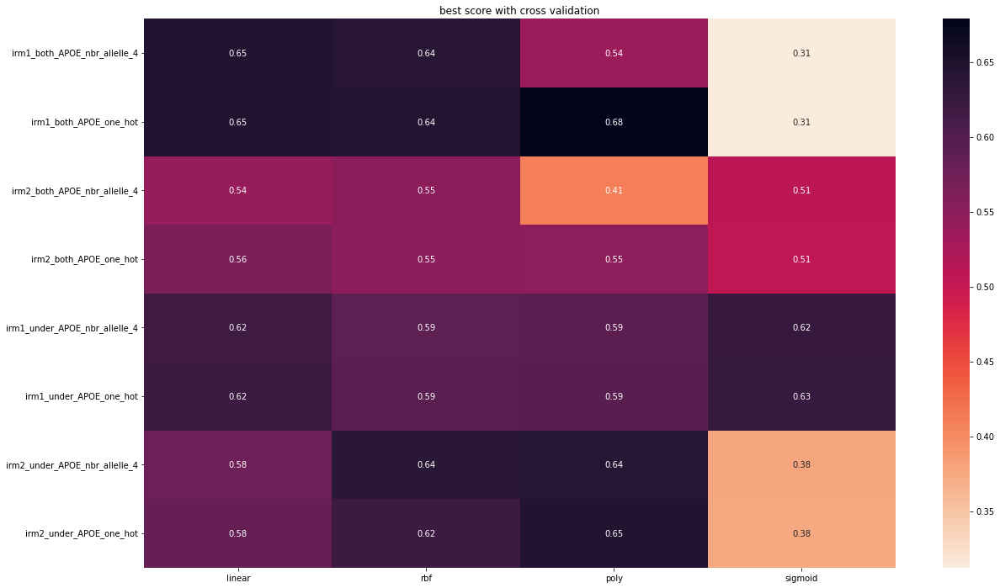

In [29]:
if True:
    path="./backup_models/preclinical/SVM/"+feat_selec+"/"+scoring
    if feat_selec == "with_fs":
        path="./backup_models/preclinical/SVM/"+feat_selec+"/"+str(target_nbr)+"/"+scoring

    plot_scores(path, plots=["score_on_cross_val"], v=True)

### Learning Curve & XAI

In [ ]:
if True:
    path="./backup_models/preclinical/SVM/"+feat_selec+"/"+scoring
    if feat_selec == "with_fs":
        path="./backup_models/preclinical/SVM/"+feat_selec+"/"+str(target_nbr)+"/"+scoring
        
    
    dir_grid = max([datetime.strptime(f, "%d-%m-%Y_%Hh%Mm%Ss") for f in files if os.path.isdir(path+'/'+f)]).strftime("%d-%m-%Y_%Hh%Mm%Ss")
    for scores in os.listdir(path+"/"+dir_grid):
        if "score_on_cross_val" in scores:
            strat_df_score_cross_val = pd.read_csv(path+"/"+dir_grid+"/"+scores, index_col=0)
            break
    
    max_value = strat_df_score_cross_val.max(axis=1).max()
    targets = strat_df_score_cross_val[strat_df_score_cross_val.eq(max_value).any(axis=1)].index.tolist()
    print("targets: "+str(targets))
    
    groupkfold = StratifiedGroupKFold(n_splits=5)
    #plot_learning_curves(new_dbs, path, targets, 5, 3, v=True, scoring=f1_score, binary=False)
    XAI_analyses(new_dbs, path, targets, custom_scorer, v=True, nsplits_exp=5, shap=False)
    plot_confusion_matrices(new_dbs, path, targets, groupkfold,scores_options[scoring], binary, [0,1], [1], summat=False)
    plot_roc_curve(new_dbs, path, targets, groupkfold)
    

here: 350
irm1_both
0    658
1    658
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_both_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST9SV,irmL_ST10CV,irmL_ST11SV,...,neuro_moca_DELW3,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,-0.034187,0.708498,-0.664565,...,-1.493944,-1.794235,-0.628462,1.0,1.0,1.0,1.0,1.0,1.308682,0.0
1,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,-0.492240,2.189549,-1.047400,...,0.340039,0.454540,0.669899,1.0,1.0,1.0,1.0,1.0,0.129191,1.0
2,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,-0.793551,0.012265,0.402731,...,-0.576952,1.578927,-0.628462,1.0,1.0,1.0,1.0,1.0,-0.376305,0.0
3,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,1.670197,0.389878,2.119685,...,1.257031,1.578927,1.968261,1.0,1.0,1.0,1.0,1.0,0.634687,0.0
4,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,0.055598,-0.711352,-0.200524,...,0.340039,0.454540,-0.628462,1.0,1.0,1.0,1.0,1.0,2.319674,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,0.201688,0.091951,0.228715,...,-0.576952,-0.669848,0.669899,1.0,1.0,1.0,1.0,1.0,1.140183,0.0
1312,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,2.426518,1.674835,0.170710,...,-0.576952,1.578927,-0.628462,1.0,1.0,1.0,1.0,1.0,0.971684,0.0
1313,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,-0.384194,-0.984482,-0.536954,...,-1.493944,-0.669848,-0.628462,1.0,1.0,1.0,1.0,1.0,-1.555796,1.0
1314,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,-0.225930,0.458712,-0.420943,...,-1.493944,-0.669848,-0.628462,1.0,1.0,1.0,1.0,1.0,0.129191,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_both_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST9SV,irmL_ST10CV,irmL_ST11SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_33,APOE_34
0,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,-0.034187,0.708498,-0.664565,...,-1.794235,-0.628462,1.0,1.0,1.0,1.0,1.0,1.308682,1.0,0.0
1,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,-0.492240,2.189549,-1.047400,...,0.454540,0.669899,1.0,1.0,1.0,1.0,1.0,0.129191,0.0,1.0
2,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,-0.793551,0.012265,0.402731,...,1.578927,-0.628462,1.0,1.0,1.0,1.0,1.0,-0.376305,1.0,0.0
3,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,1.670197,0.389878,2.119685,...,1.578927,1.968261,1.0,1.0,1.0,1.0,1.0,0.634687,1.0,0.0
4,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,0.055598,-0.711352,-0.200524,...,0.454540,-0.628462,1.0,1.0,1.0,1.0,1.0,2.319674,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,0.201688,0.091951,0.228715,...,-0.669848,0.669899,1.0,1.0,1.0,1.0,1.0,1.140183,1.0,0.0
1312,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,2.426518,1.674835,0.170710,...,1.578927,-0.628462,1.0,1.0,1.0,1.0,1.0,0.971684,1.0,0.0
1313,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,-0.384194,-0.984482,-0.536954,...,-0.669848,-0.628462,1.0,1.0,1.0,1.0,1.0,-1.555796,0.0,1.0
1314,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,-0.225930,0.458712,-0.420943,...,-0.669848,-0.628462,1.0,1.0,1.0,1.0,1.0,0.129191,0.0,1.0


irm2_both
0    1000
1    1000
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_both_APOE_nbr_allelle_4


,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST103CV,irmC_ST103TA,irmC_ST104SA_ST104CV,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,1.757226,-1.740922,-1.278593,-0.328114,-1.367214,-0.698074,-1.544192,0.617436,1.799995,2.383053,...,1.514540,-0.569821,1.0,1.0,1.0,1.0,1.0,1.0,-0.214656,0.0
1,0.564149,0.570305,-0.494554,0.228175,-0.002669,2.413644,1.313484,-0.638077,0.654591,-0.270465,...,-0.646773,-0.569821,1.0,1.0,1.0,1.0,1.0,1.0,-0.687641,1.0
2,0.007736,0.216984,1.052334,-0.518151,-0.906156,-0.647913,0.198744,-0.827079,-0.359226,-0.764643,...,1.514540,-0.569821,1.0,1.0,1.0,1.0,1.0,1.0,-0.214656,0.0
3,0.494597,-0.413528,0.003417,0.984867,1.366534,0.844812,-0.281641,1.629946,0.277774,-0.367152,...,0.433884,-0.569821,1.0,1.0,1.0,1.0,1.0,1.0,-1.318288,0.0
4,0.318043,0.582017,0.368949,0.349108,0.109103,0.346661,1.615264,0.846938,0.848981,0.900520,...,-0.646773,-0.569821,1.0,1.0,1.0,1.0,1.0,1.0,-1.160626,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.521926,-0.466234,-0.542232,-0.487054,0.057874,-0.518186,-1.371746,-0.638077,-0.586513,-0.710928,...,-1.727429,2.050047,1.0,1.0,1.0,1.0,1.0,1.0,1.046637,0.0
1996,1.024259,1.360886,0.623232,-1.171186,-0.924784,-1.365735,-0.503357,1.400444,-0.619409,-0.743157,...,-0.646773,0.740113,1.0,1.0,1.0,1.0,1.0,1.0,-0.372318,1.0
1997,-0.719880,0.263833,0.241807,0.152161,0.276761,-0.665210,0.365031,0.023429,-0.404085,-0.496068,...,-0.646773,-0.569821,1.0,1.0,1.0,1.0,1.0,1.0,0.573652,1.0
1998,-0.650329,-1.838525,-1.426925,-0.804933,-0.817670,-1.919237,-1.396381,0.387933,-1.277344,-1.602596,...,0.433884,0.740113,1.0,1.0,1.0,1.0,1.0,1.0,1.046637,0.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_both_APOE_one_hot


,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST103CV,irmC_ST103TA,irmC_ST104SA_ST104CV,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,...,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_24,APOE_33,APOE_34,APOE_44
0,1.757226,-1.740922,-1.278593,-0.328114,-1.367214,-0.698074,-1.544192,0.617436,1.799995,2.383053,...,1.0,1.0,1.0,1.0,1.0,-0.214656,0.0,1.0,0.0,0.0
1,0.564149,0.570305,-0.494554,0.228175,-0.002669,2.413644,1.313484,-0.638077,0.654591,-0.270465,...,1.0,1.0,1.0,1.0,1.0,-0.687641,0.0,0.0,1.0,0.0
2,0.007736,0.216984,1.052334,-0.518151,-0.906156,-0.647913,0.198744,-0.827079,-0.359226,-0.764643,...,1.0,1.0,1.0,1.0,1.0,-0.214656,0.0,1.0,0.0,0.0
3,0.494597,-0.413528,0.003417,0.984867,1.366534,0.844812,-0.281641,1.629946,0.277774,-0.367152,...,1.0,1.0,1.0,1.0,1.0,-1.318288,0.0,0.0,0.0,0.0
4,0.318043,0.582017,0.368949,0.349108,0.109103,0.346661,1.615264,0.846938,0.848981,0.900520,...,1.0,1.0,1.0,1.0,1.0,-1.160626,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.521926,-0.466234,-0.542232,-0.487054,0.057874,-0.518186,-1.371746,-0.638077,-0.586513,-0.710928,...,1.0,1.0,1.0,1.0,1.0,1.046637,0.0,1.0,0.0,0.0
1996,1.024259,1.360886,0.623232,-1.171186,-0.924784,-1.365735,-0.503357,1.400444,-0.619409,-0.743157,...,1.0,1.0,1.0,1.0,1.0,-0.372318,0.0,0.0,1.0,0.0
1997,-0.719880,0.263833,0.241807,0.152161,0.276761,-0.665210,0.365031,0.023429,-0.404085,-0.496068,...,1.0,1.0,1.0,1.0,1.0,0.573652,0.0,0.0,1.0,0.0
1998,-0.650329,-1.838525,-1.426925,-0.804933,-0.817670,-1.919237,-1.396381,0.387933,-1.277344,-1.602596,...,1.0,1.0,1.0,1.0,1.0,1.046637,0.0,1.0,0.0,0.0


irm1_under
0    511
1    511
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_under_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST9SV,irmL_ST11SV,irmL_ST12SV,...,neuro_moca_DELW3,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,-0.029944,-0.637348,0.061876,...,-1.502114,-1.815255,-0.629145,1.0,1.0,1.0,1.0,1.0,1.290915,0.0
1,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,-0.492513,-1.025712,1.201759,...,0.335301,0.449935,0.649157,1.0,1.0,1.0,1.0,1.0,0.110546,1.0
2,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,-0.796793,0.445365,-0.587965,...,-0.583406,1.582530,-0.629145,1.0,1.0,1.0,1.0,1.0,-0.395326,0.0
3,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,1.691239,2.187121,1.638537,...,1.254009,1.582530,1.927460,1.0,1.0,1.0,1.0,1.0,0.616419,0.0
4,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,0.060725,-0.166603,-1.173886,...,0.335301,0.449935,-0.629145,1.0,1.0,1.0,1.0,1.0,2.302660,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,0.205182,-0.637348,-1.514786,...,0.335301,0.449935,-0.629145,1.0,1.0,1.0,1.0,1.0,-1.238447,1.0
1018,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,0.099144,-1.108093,-1.924931,...,0.335301,0.449935,-0.629145,1.0,1.0,1.0,1.0,1.0,-1.069823,1.0
1019,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,0.099144,-1.108093,-1.924931,...,0.335301,0.449935,-0.629145,1.0,1.0,1.0,1.0,1.0,-1.069823,1.0
1020,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,0.255895,-1.414077,-1.669256,...,0.335301,1.582530,0.649157,1.0,1.0,1.0,1.0,1.0,-0.901199,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_under_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST9SV,irmL_ST11SV,irmL_ST12SV,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_33,APOE_34
0,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,-0.029944,-0.637348,0.061876,...,-1.815255,-0.629145,1.0,1.0,1.0,1.0,1.0,1.290915,1.0,0.0
1,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,-0.492513,-1.025712,1.201759,...,0.449935,0.649157,1.0,1.0,1.0,1.0,1.0,0.110546,0.0,1.0
2,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,-0.796793,0.445365,-0.587965,...,1.582530,-0.629145,1.0,1.0,1.0,1.0,1.0,-0.395326,1.0,0.0
3,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,1.691239,2.187121,1.638537,...,1.582530,1.927460,1.0,1.0,1.0,1.0,1.0,0.616419,1.0,0.0
4,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,0.060725,-0.166603,-1.173886,...,0.449935,-0.629145,1.0,1.0,1.0,1.0,1.0,2.302660,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,0.205182,-0.637348,-1.514786,...,0.449935,-0.629145,1.0,1.0,1.0,1.0,1.0,-1.238447,0.0,1.0
1018,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,0.099144,-1.108093,-1.924931,...,0.449935,-0.629145,1.0,1.0,1.0,1.0,1.0,-1.069823,0.0,1.0
1019,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,0.099144,-1.108093,-1.924931,...,0.449935,-0.629145,1.0,1.0,1.0,1.0,1.0,-1.069823,0.0,1.0
1020,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,0.255895,-1.414077,-1.669256,...,1.582530,0.649157,1.0,1.0,1.0,1.0,1.0,-0.901199,0.0,1.0


irm2_under
0    614
1    614
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_under_APOE_nbr_allelle_4


,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST103TA,irmC_ST104SA_ST104CV,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,...,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_DATE,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,1.822440,-1.724954,-1.277778,-1.325707,-0.695724,-1.550149,0.603003,1.788523,2.434463,-0.403364,...,1.533935,-0.575984,1.0,1.0,1.0,1.0,1.0,1.0,-0.194405,0.0
1,0.580007,0.560375,-0.502523,0.014682,2.388945,1.283291,-0.646006,0.648655,-0.260922,1.470128,...,-0.657655,-0.575984,1.0,1.0,1.0,1.0,1.0,1.0,-0.661586,1.0
2,0.000576,0.211013,1.027035,-0.872811,-0.645999,0.178005,-0.834029,-0.360263,-0.762897,1.499099,...,1.533935,-0.575984,1.0,1.0,1.0,1.0,1.0,1.0,-0.194405,0.0
3,0.507578,-0.412434,-0.010131,1.359644,0.833751,-0.298306,1.610269,0.273659,-0.359135,0.446467,...,0.438140,-0.575984,1.0,1.0,1.0,1.0,1.0,1.0,-1.284495,0.0
4,0.323720,0.571956,0.351306,0.124474,0.339929,1.582511,0.831317,0.842105,0.928539,0.224352,...,-0.657655,-0.575984,1.0,1.0,1.0,1.0,1.0,1.0,-1.128768,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,-0.857427,0.193642,0.466546,-0.946006,-0.112740,-0.725764,-1.827865,-1.776914,-1.515858,-0.905537,...,0.438140,-0.575984,1.0,1.0,1.0,1.0,1.0,1.0,-1.128768,1.0
1224,-1.370001,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,...,0.438140,-0.575984,1.0,1.0,1.0,1.0,1.0,1.0,-0.973041,1.0
1225,-1.370001,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,...,0.438140,-0.575984,1.0,1.0,1.0,1.0,1.0,1.0,-0.973041,1.0
1226,-1.297572,-0.754075,-0.586334,-0.891110,-0.191614,-0.829576,-1.236936,-1.964412,-1.646808,-1.156623,...,1.533935,0.771270,1.0,1.0,1.0,1.0,1.0,1.0,-0.817314,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_under_APOE_one_hot


,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST103TA,irmC_ST104SA_ST104CV,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,...,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_24,APOE_33,APOE_34,APOE_44
0,1.822440,-1.724954,-1.277778,-1.325707,-0.695724,-1.550149,0.603003,1.788523,2.434463,-0.403364,...,1.0,1.0,1.0,1.0,1.0,-0.194405,0.0,1.0,0.0,0.0
1,0.580007,0.560375,-0.502523,0.014682,2.388945,1.283291,-0.646006,0.648655,-0.260922,1.470128,...,1.0,1.0,1.0,1.0,1.0,-0.661586,0.0,0.0,1.0,0.0
2,0.000576,0.211013,1.027035,-0.872811,-0.645999,0.178005,-0.834029,-0.360263,-0.762897,1.499099,...,1.0,1.0,1.0,1.0,1.0,-0.194405,0.0,1.0,0.0,0.0
3,0.507578,-0.412434,-0.010131,1.359644,0.833751,-0.298306,1.610269,0.273659,-0.359135,0.446467,...,1.0,1.0,1.0,1.0,1.0,-1.284495,0.0,0.0,0.0,0.0
4,0.323720,0.571956,0.351306,0.124474,0.339929,1.582511,0.831317,0.842105,0.928539,0.224352,...,1.0,1.0,1.0,1.0,1.0,-1.128768,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,-0.857427,0.193642,0.466546,-0.946006,-0.112740,-0.725764,-1.827865,-1.776914,-1.515858,-0.905537,...,1.0,1.0,1.0,1.0,1.0,-1.128768,0.0,0.0,1.0,0.0
1224,-1.370001,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,...,1.0,1.0,1.0,1.0,1.0,-0.973041,0.0,0.0,1.0,0.0
1225,-1.370001,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,...,1.0,1.0,1.0,1.0,1.0,-0.973041,0.0,0.0,1.0,0.0
1226,-1.297572,-0.754075,-0.586334,-0.891110,-0.191614,-0.829576,-1.236936,-1.964412,-1.646808,-1.156623,...,1.0,1.0,1.0,1.0,1.0,-0.817314,0.0,0.0,1.0,0.0


dict_keys(['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot'])
['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot']
dict_keys(['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot'])
depth_10_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.583 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10,

[CV 3/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.583 total time=   1.2s
[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.427 total time=   1.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.471 total time=   1.1s
[CV 1/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.684 total time=   2.3s
[CV 2/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.464 total time=   2.4s
[CV 3/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.582 total time=   2.6s
[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.511 total time=   2.1s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.230 total time=   2.3s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.787 total time=   0.0s
[

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.719 total time=   1.3s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.550 total time=   1.4s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.582 total time=   1.3s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.570 total time=   1.3s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.391 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.702 total time=   2.6s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.618 total time=   2.8s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.576 total time=   2.8s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.51

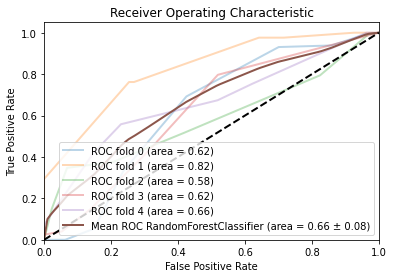

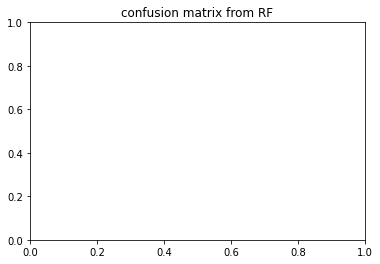

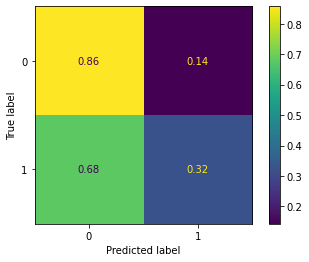

,precision,recall,f1-score,support,auc
0,0.559,0.856,0.673,131.600,0.000
1,0.754,0.325,0.432,131.600,0.000
accuracy,0.589,0.589,0.589,0.589,0.000
macro avg,0.657,0.590,0.552,263.200,0.663
weighted avg,0.657,0.589,0.552,263.200,0.663


coming from


,precision,recall,f1-score,support,auc
0,0.527174,0.763780,0.623794,127.000000,0.000000
1,0.589041,0.330769,0.423645,130.000000,0.000000
accuracy,0.544747,0.544747,0.544747,0.544747,0.000000
macro avg,0.558108,0.547274,0.523720,257.000000,0.624531
weighted avg,0.558469,0.544747,0.522552,257.000000,0.624531


,precision,recall,f1-score,support,auc
0,0.600897,1.000000,0.750700,134.000000,0.000000
1,1.000000,0.293651,0.453988,126.000000,0.000000
accuracy,0.657692,0.657692,0.657692,0.657692,0.000000
macro avg,0.800448,0.646825,0.602344,260.000000,0.823502
weighted avg,0.794308,0.657692,0.606909,260.000000,0.823502


,precision,recall,f1-score,support,auc
0,0.516129,0.977099,0.675462,131.000000,0.000000
1,0.875000,0.148936,0.254545,141.000000,0.000000
accuracy,0.547794,0.547794,0.547794,0.547794,0.000000
macro avg,0.695565,0.563018,0.465004,272.000000,0.583726
weighted avg,0.702161,0.547794,0.457266,272.000000,0.583726


,precision,recall,f1-score,support,auc
0,0.562500,0.687023,0.618557,131.000000,0.000000
1,0.563830,0.430894,0.488479,123.000000,0.000000
accuracy,0.562992,0.562992,0.562992,0.562992,0.000000
macro avg,0.563165,0.558959,0.553518,254.000000,0.619034
weighted avg,0.563144,0.562992,0.555566,254.000000,0.619034


,precision,recall,f1-score,support,auc
0,0.589744,0.851852,0.696970,135.0000,0.000000
1,0.743590,0.420290,0.537037,138.0000,0.000000
accuracy,0.633700,0.633700,0.633700,0.6337,0.000000
macro avg,0.666667,0.636071,0.617003,273.0000,0.664117
weighted avg,0.667512,0.633700,0.616125,273.0000,0.664117


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 10}
depth_10_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.486 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.645 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.375 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.339 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.554 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.672 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.697 total time=   0.1s
[CV 3/5] END criterion=gini, 

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.417 total time=   2.2s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.221 total time=   2.3s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.948 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.572 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.403 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.606 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.586 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.656

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.762 total time=   2.5s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.576 total time=   2.8s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.582 total time=   2.7s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.370 total time=   2.6s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.308 total time=   2.7s


<Figure size 432x288 with 0 Axes>

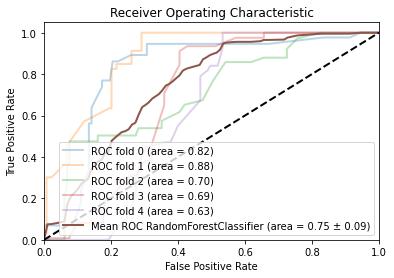

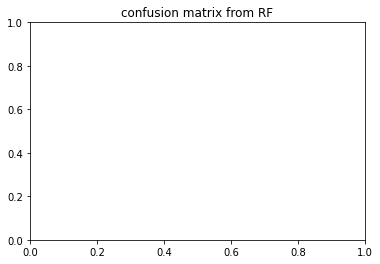

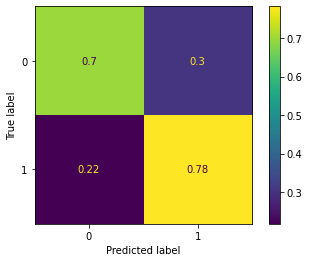

,precision,recall,f1-score,support,auc
0,0.801,0.700,0.724,131.600,0.000
1,0.745,0.789,0.742,131.600,0.000
accuracy,0.741,0.741,0.741,0.741,0.000
macro avg,0.773,0.744,0.733,263.200,0.745
weighted avg,0.775,0.741,0.732,263.200,0.745


coming from


,precision,recall,f1-score,support,auc
0,0.772727,0.803150,0.787645,127.000000,0.000000
1,0.800000,0.769231,0.784314,130.000000,0.000000
accuracy,0.785992,0.785992,0.785992,0.785992,0.000000
macro avg,0.786364,0.786190,0.785979,257.000000,0.821623
weighted avg,0.786523,0.785992,0.785960,257.000000,0.821623


,precision,recall,f1-score,support,auc
0,0.896226,0.708955,0.791667,134.000000,0.000000
1,0.746753,0.912698,0.821429,126.000000,0.000000
accuracy,0.807692,0.807692,0.807692,0.807692,0.000000
macro avg,0.821490,0.810827,0.806548,260.000000,0.882877
weighted avg,0.823789,0.807692,0.806090,260.000000,0.882877


,precision,recall,f1-score,support,auc
0,0.599010,0.923664,0.726727,131.000000,0.000000
1,0.857143,0.425532,0.568720,141.000000,0.000000
accuracy,0.665441,0.665441,0.665441,0.665441,0.000000
macro avg,0.728076,0.674598,0.647724,272.000000,0.704374
weighted avg,0.732821,0.665441,0.644819,272.000000,0.704374


,precision,recall,f1-score,support,auc
0,0.876404,0.595420,0.709091,131.000000,0.000000
1,0.678788,0.910569,0.777778,123.000000,0.000000
accuracy,0.748031,0.748031,0.748031,0.748031,0.000000
macro avg,0.777596,0.752994,0.743434,254.000000,0.689692
weighted avg,0.780708,0.748031,0.742353,254.000000,0.689692


,precision,recall,f1-score,support,auc
0,0.863014,0.466667,0.605769,135.000000,0.000000
1,0.640000,0.927536,0.757396,138.000000,0.000000
accuracy,0.699634,0.699634,0.699634,0.699634,0.000000
macro avg,0.751507,0.697101,0.681583,273.000000,0.627348
weighted avg,0.750281,0.699634,0.682416,273.000000,0.627348


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 100}
depth_10_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.304 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.660 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.507 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.318 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.519 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.574 total time=   0.1s
[CV 3/5] END criterion

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.298 total time=   3.6s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.839 total time=   4.3s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.654 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.629 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.548 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.421 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.878 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.472 total time=   0.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.469

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.564 total time=   4.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.826 total time=   4.8s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.621 total time=   4.2s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.297 total time=   4.1s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.822 total time=   4.7s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

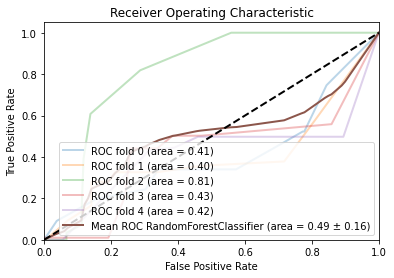

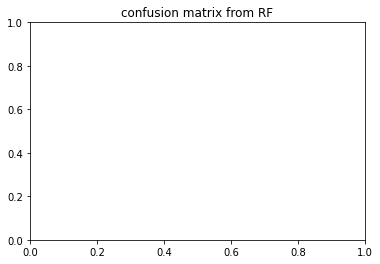

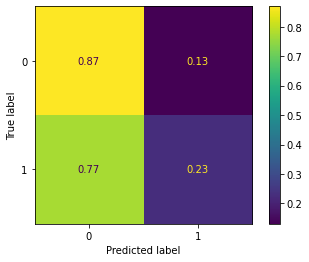

,precision,recall,f1-score,support,auc
0,0.537,0.867,0.660,200.000,0.000
1,0.468,0.226,0.294,200.000,0.000
accuracy,0.549,0.549,0.549,0.549,0.000
macro avg,0.503,0.547,0.477,400.000,0.494
weighted avg,0.505,0.549,0.479,400.000,0.494


coming from


,precision,recall,f1-score,support,auc
0,0.517157,1.000000,0.681745,211.000000,0.000000
1,0.000000,0.000000,0.000000,197.000000,0.000000
accuracy,0.517157,0.517157,0.517157,0.517157,0.000000
macro avg,0.258578,0.500000,0.340872,408.000000,0.408305
weighted avg,0.267451,0.517157,0.352569,408.000000,0.408305


,precision,recall,f1-score,support,auc
0,0.513595,0.858586,0.642722,198.000000,0.000000
1,0.533333,0.165803,0.252964,193.000000,0.000000
accuracy,0.516624,0.516624,0.516624,0.516624,0.000000
macro avg,0.523464,0.512194,0.447843,391.000000,0.404119
weighted avg,0.523338,0.516624,0.450335,391.000000,0.404119


,precision,recall,f1-score,support,auc
0,0.677419,0.861538,0.758465,195.00000,0.000000
1,0.821192,0.607843,0.698592,204.00000,0.000000
accuracy,0.731830,0.731830,0.731830,0.73183,0.000000
macro avg,0.749306,0.734691,0.728528,399.00000,0.808446
weighted avg,0.750927,0.731830,0.727853,399.00000,0.808446


,precision,recall,f1-score,support,auc
0,0.491803,0.757576,0.596421,198.000000,0.000000
1,0.466667,0.213198,0.292683,197.000000,0.000000
accuracy,0.486076,0.486076,0.486076,0.486076,0.000000
macro avg,0.479235,0.485387,0.444552,395.000000,0.429319
weighted avg,0.479267,0.486076,0.444937,395.000000,0.429319


,precision,recall,f1-score,support,auc
0,0.487106,0.858586,0.621572,198.0000,0.0000
1,0.517241,0.143541,0.224719,209.0000,0.0000
accuracy,0.491400,0.491400,0.491400,0.4914,0.0000
macro avg,0.502174,0.501063,0.423146,407.0000,0.4175
weighted avg,0.502581,0.491400,0.417783,407.0000,0.4175


{'criterion': 'gini', 'max_depth': 10, 'max_features': 0.8, 'n_estimators': 10}
depth_10_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.852 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.390 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.473 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.518 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.777 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.507 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.566 total time=   0.1s
[CV 3/5] END criterion=gini, max_de

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.384 total time=   3.8s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.840 total time=   4.4s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.459 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.463 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.569 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.468 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.885 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.412 total time=   0.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.521

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.507 total time=   4.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.823 total time=   4.7s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.609 total time=   4.1s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.322 total time=   4.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.804 total time=   4.5s


<Figure size 432x288 with 0 Axes>

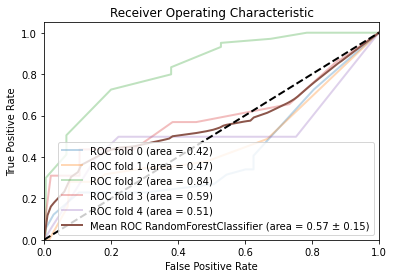

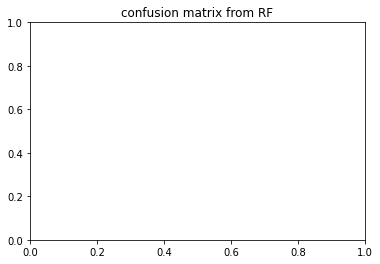

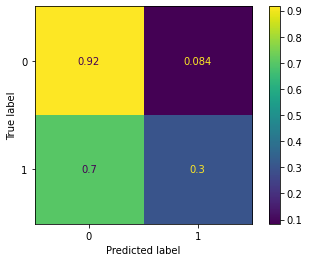

,precision,recall,f1-score,support,auc
0,0.570,0.915,0.701,200.000,0.000
1,0.770,0.297,0.412,200.000,0.000
accuracy,0.608,0.608,0.608,0.608,0.000
macro avg,0.670,0.606,0.557,400.000,0.565
weighted avg,0.670,0.608,0.558,400.000,0.565


coming from


,precision,recall,f1-score,support,auc
0,0.542328,0.971564,0.696095,211.000000,0.000000
1,0.800000,0.121827,0.211454,197.000000,0.000000
accuracy,0.561275,0.561275,0.561275,0.561275,0.000000
macro avg,0.671164,0.546696,0.453774,408.000000,0.419107
weighted avg,0.666743,0.561275,0.462089,408.000000,0.419107


,precision,recall,f1-score,support,auc
0,0.531792,0.929293,0.676471,198.000000,0.000000
1,0.688889,0.160622,0.260504,193.000000,0.000000
accuracy,0.549872,0.549872,0.549872,0.549872,0.000000
macro avg,0.610340,0.544957,0.468487,391.000000,0.467577
weighted avg,0.609336,0.549872,0.471147,391.000000,0.467577


,precision,recall,f1-score,support,auc
0,0.643110,0.933333,0.761506,195.000000,0.000000
1,0.887931,0.504902,0.643750,204.000000,0.000000
accuracy,0.714286,0.714286,0.714286,0.714286,0.000000
macro avg,0.765520,0.719118,0.702628,399.000000,0.836388
weighted avg,0.768281,0.714286,0.701300,399.000000,0.836388


,precision,recall,f1-score,support,auc
0,0.565495,0.893939,0.692759,198.000000,0.000000
1,0.743902,0.309645,0.437276,197.000000,0.000000
accuracy,0.602532,0.602532,0.602532,0.602532,0.000000
macro avg,0.654699,0.601792,0.565018,395.000000,0.593716
weighted avg,0.654473,0.602532,0.565341,395.000000,0.593716


,precision,recall,f1-score,support,auc
0,0.567568,0.848485,0.680162,198.000000,0.000000
1,0.729730,0.387560,0.506250,209.000000,0.000000
accuracy,0.611794,0.611794,0.611794,0.611794,0.000000
macro avg,0.648649,0.618022,0.593206,407.000000,0.509884
weighted avg,0.650840,0.611794,0.590856,407.000000,0.509884


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 0.8, 'n_estimators': 10}
depth_10_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.883 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.618 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.650 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.589 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.561 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.885 total time=   0.0s
[CV 3/5] END criterion=gi

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.467 total time=   1.8s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.565 total time=   1.8s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.617 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.894 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.726 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.695 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.497 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.761 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.924

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.690 total time=   2.3s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.622 total time=   2.3s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.549 total time=   2.1s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.467 total time=   2.1s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.3s


<Figure size 432x288 with 0 Axes>

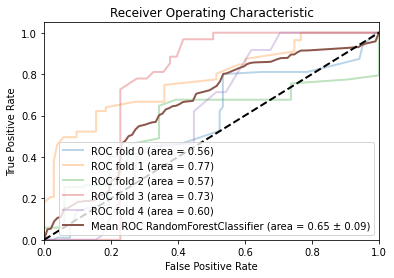

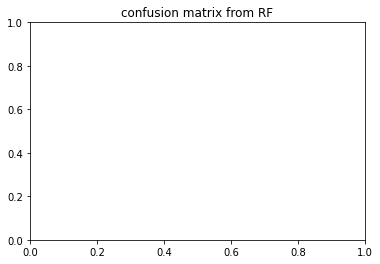

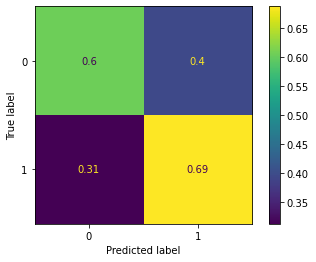

,precision,recall,f1-score,support,auc
0,0.671,0.606,0.625,102.200,0.000
1,0.646,0.692,0.658,102.200,0.000
accuracy,0.646,0.646,0.646,0.646,0.000
macro avg,0.658,0.649,0.642,204.400,0.647
weighted avg,0.660,0.646,0.641,204.400,0.647


coming from


,precision,recall,f1-score,support,auc
0,0.676056,0.466019,0.551724,103.000000,0.000000
1,0.566929,0.757895,0.648649,95.000000,0.000000
accuracy,0.606061,0.606061,0.606061,0.606061,0.000000
macro avg,0.621493,0.611957,0.600186,198.000000,0.563822
weighted avg,0.623697,0.606061,0.598228,198.000000,0.563822


,precision,recall,f1-score,support,auc
0,0.659091,0.844660,0.740426,103.000000,0.000000
1,0.804878,0.594595,0.683938,111.000000,0.000000
accuracy,0.714953,0.714953,0.714953,0.714953,0.000000
macro avg,0.731984,0.719627,0.712182,214.000000,0.774556
weighted avg,0.734709,0.714953,0.711126,214.000000,0.774556


,precision,recall,f1-score,support,auc
0,0.565217,0.656566,0.607477,99.00000,0.00000
1,0.604651,0.509804,0.553191,102.00000,0.00000
accuracy,0.582090,0.582090,0.582090,0.58209,0.00000
macro avg,0.584934,0.583185,0.580334,201.00000,0.56833
weighted avg,0.585229,0.582090,0.579929,201.00000,0.56833


,precision,recall,f1-score,support,auc
0,0.847222,0.603960,0.705202,101.000000,0.000000
1,0.677419,0.884211,0.767123,95.000000,0.000000
accuracy,0.739796,0.739796,0.739796,0.739796,0.000000
macro avg,0.762321,0.744085,0.736163,196.000000,0.733872
weighted avg,0.764920,0.739796,0.735215,196.000000,0.733872


,precision,recall,f1-score,support,auc
0,0.607595,0.457143,0.521739,105.000000,0.000000
1,0.574627,0.712963,0.636364,108.000000,0.000000
accuracy,0.586854,0.586854,0.586854,0.586854,0.000000
macro avg,0.591111,0.585053,0.579051,213.000000,0.596649
weighted avg,0.590879,0.586854,0.579859,213.000000,0.596649


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 50}
depth_10_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.792 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.904 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.683 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.508 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.686 total time=   0.1s
[CV 3/5] END criterion=gini,

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.437 total time=   1.8s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.565 total time=   1.8s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.777 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.766 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.788 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.777 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.449 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.905 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.842

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.626 total time=   2.3s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.653 total time=   2.2s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.567 total time=   2.2s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.458 total time=   2.1s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.2s


<Figure size 432x288 with 0 Axes>

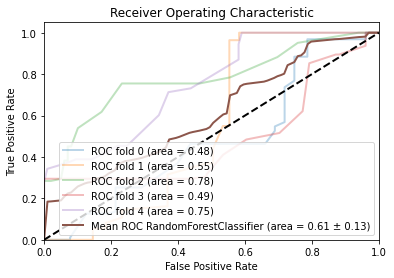

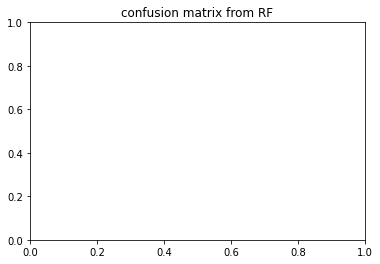

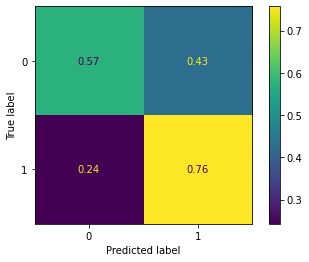

,precision,recall,f1-score,support,auc
0,0.770,0.576,0.594,102.200,0.000
1,0.716,0.747,0.663,102.200,0.000
accuracy,0.663,0.663,0.663,0.663,0.000
macro avg,0.743,0.661,0.628,204.400,0.607
weighted avg,0.742,0.663,0.629,204.400,0.607


coming from


,precision,recall,f1-score,support,auc
0,0.785714,0.213592,0.335878,103.000000,0.000000
1,0.523529,0.936842,0.671698,95.000000,0.000000
accuracy,0.560606,0.560606,0.560606,0.560606,0.000000
macro avg,0.654622,0.575217,0.503788,198.000000,0.481809
weighted avg,0.659919,0.560606,0.497004,198.000000,0.481809


,precision,recall,f1-score,support,auc
0,0.914894,0.417476,0.573333,103.000000,0.00000
1,0.640719,0.963964,0.769784,111.000000,0.00000
accuracy,0.700935,0.700935,0.700935,0.700935,0.00000
macro avg,0.777806,0.690720,0.671559,214.000000,0.54522
weighted avg,0.772681,0.700935,0.675231,214.000000,0.54522


,precision,recall,f1-score,support,auc
0,0.677686,0.828283,0.745455,99.000000,0.00000
1,0.787500,0.617647,0.692308,102.000000,0.00000
accuracy,0.721393,0.721393,0.721393,0.721393,0.00000
macro avg,0.732593,0.722965,0.718881,201.000000,0.77555
weighted avg,0.733412,0.721393,0.718485,201.000000,0.77555


,precision,recall,f1-score,support,auc
0,0.594118,1.000000,0.745387,101.000000,0.00000
1,1.000000,0.273684,0.429752,95.000000,0.00000
accuracy,0.647959,0.647959,0.647959,0.647959,0.00000
macro avg,0.797059,0.636842,0.587570,196.000000,0.48593
weighted avg,0.790846,0.647959,0.592401,196.000000,0.48593


,precision,recall,f1-score,support,auc
0,0.880000,0.419048,0.567742,105.000000,0.000000
1,0.625767,0.944444,0.752768,108.000000,0.000000
accuracy,0.685446,0.685446,0.685446,0.685446,0.000000
macro avg,0.752883,0.681746,0.660255,213.000000,0.748016
weighted avg,0.751093,0.685446,0.661558,213.000000,0.748016


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 50}
depth_10_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.367 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.318 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.525 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.540 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.586 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.466 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.522 total time=   0.1s
[CV 3/5] END criterion

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.673 total time=   3.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.697 total time=   3.4s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.682 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.551 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.561 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.471 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.818 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.707 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.346

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.548 total time=   3.8s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.278 total time=   3.3s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.537 total time=   3.3s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.768 total time=   3.3s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.756 total time=   4.1s


<Figure size 432x288 with 0 Axes>

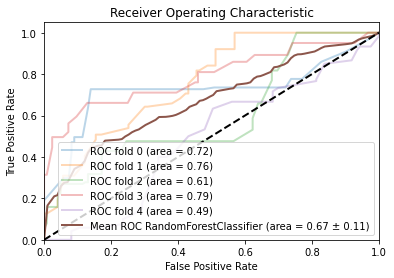

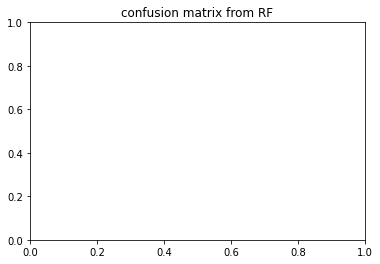

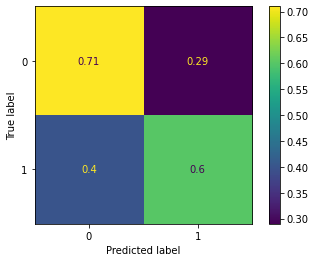

,precision,recall,f1-score,support,auc
0,0.663,0.710,0.663,122.800,0.000
1,0.697,0.601,0.624,122.800,0.000
accuracy,0.656,0.656,0.656,0.656,0.000
macro avg,0.680,0.655,0.644,245.600,0.673
weighted avg,0.680,0.656,0.644,245.600,0.673


coming from


,precision,recall,f1-score,support,auc
0,0.706667,0.868852,0.779412,122.000000,0.000000
1,0.827957,0.636364,0.719626,121.000000,0.000000
accuracy,0.753086,0.753086,0.753086,0.753086,0.000000
macro avg,0.767312,0.752608,0.749519,243.000000,0.721684
weighted avg,0.767062,0.753086,0.749642,243.000000,0.721684


,precision,recall,f1-score,support,auc
0,0.841270,0.430894,0.569892,123.000000,0.000000
1,0.623656,0.920635,0.743590,126.000000,0.000000
accuracy,0.678715,0.678715,0.678715,0.678715,0.000000
macro avg,0.732463,0.675765,0.656741,249.000000,0.761034
weighted avg,0.731152,0.678715,0.657787,249.000000,0.761034


,precision,recall,f1-score,support,auc
0,0.540107,0.827869,0.653722,122.000000,0.000000
1,0.655738,0.317460,0.427807,126.000000,0.000000
accuracy,0.568548,0.568548,0.568548,0.568548,0.000000
macro avg,0.597922,0.572665,0.540765,248.000000,0.605744
weighted avg,0.598855,0.568548,0.538943,248.000000,0.605744


,precision,recall,f1-score,support,auc
0,0.695652,0.903226,0.785965,124.00000,0.00000
1,0.857143,0.595041,0.702439,121.00000,0.00000
accuracy,0.751020,0.751020,0.751020,0.75102,0.00000
macro avg,0.776398,0.749134,0.744202,245.00000,0.78879
weighted avg,0.775409,0.751020,0.744713,245.00000,0.78879


,precision,recall,f1-score,support,auc
0,0.533333,0.520325,0.526749,123.000000,0.000000
1,0.520325,0.533333,0.526749,120.000000,0.000000
accuracy,0.526749,0.526749,0.526749,0.526749,0.000000
macro avg,0.526829,0.526829,0.526749,243.000000,0.488584
weighted avg,0.526910,0.526749,0.526749,243.000000,0.488584


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 50}
depth_10_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.350 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.358 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.494 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.725 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.660 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.678 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.269 total time=   0.1s
[CV 3/5] END criterion=gini,

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.703 total time=   3.1s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.665 total time=   3.4s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.768 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.187 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.461 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.638 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.539 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.672 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.490

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.664 total time=   3.8s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.197 total time=   3.2s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.537 total time=   3.3s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.756 total time=   3.3s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.748 total time=   3.8s


<Figure size 432x288 with 0 Axes>

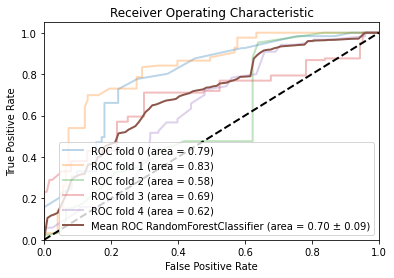

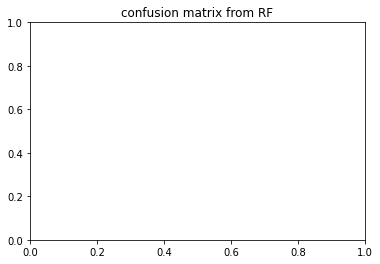

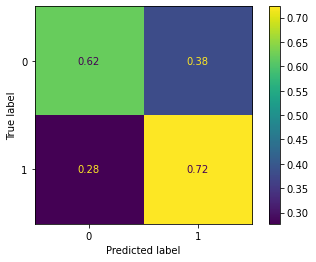

,precision,recall,f1-score,support,auc
0,0.693,0.619,0.633,122.800,0.000
1,0.679,0.722,0.688,122.800,0.000
accuracy,0.671,0.671,0.671,0.671,0.000
macro avg,0.686,0.670,0.661,245.600,0.701
weighted avg,0.686,0.671,0.661,245.600,0.701


coming from


,precision,recall,f1-score,support,auc
0,0.698529,0.778689,0.736434,122.000000,0.000000
1,0.747664,0.661157,0.701754,121.000000,0.000000
accuracy,0.720165,0.720165,0.720165,0.720165,0.000000
macro avg,0.723096,0.719923,0.719094,243.000000,0.787969
weighted avg,0.722995,0.720165,0.719166,243.000000,0.787969


,precision,recall,f1-score,support,auc
0,0.722973,0.869919,0.789668,123.000000,0.000000
1,0.841584,0.674603,0.748899,126.000000,0.000000
accuracy,0.771084,0.771084,0.771084,0.771084,0.000000
macro avg,0.782279,0.772261,0.769283,249.000000,0.825816
weighted avg,0.782993,0.771084,0.769038,249.000000,0.825816


,precision,recall,f1-score,support,auc
0,0.754098,0.377049,0.502732,122.000000,0.000000
1,0.593583,0.880952,0.709265,126.000000,0.000000
accuracy,0.633065,0.633065,0.633065,0.633065,0.000000
macro avg,0.673841,0.629001,0.605999,248.000000,0.583594
weighted avg,0.672546,0.633065,0.607664,248.000000,0.583594


,precision,recall,f1-score,support,auc
0,0.639706,0.701613,0.669231,124.00000,0.000000
1,0.660550,0.595041,0.626087,121.00000,0.000000
accuracy,0.648980,0.648980,0.648980,0.64898,0.000000
macro avg,0.650128,0.648327,0.647659,245.00000,0.686784
weighted avg,0.650001,0.648980,0.647923,245.00000,0.686784


,precision,recall,f1-score,support,auc
0,0.652174,0.365854,0.468750,123.000000,0.000000
1,0.551724,0.800000,0.653061,120.000000,0.000000
accuracy,0.580247,0.580247,0.580247,0.580247,0.000000
macro avg,0.601949,0.582927,0.560906,243.000000,0.621443
weighted avg,0.602569,0.580247,0.559768,243.000000,0.621443


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 50}
depth_100_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.300 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.708 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.536 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.888 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.553 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.919 total time=   0.1s
[CV 3/5] END cr

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.583 total time=   2.4s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.541 total time=   2.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.168 total time=   2.2s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.554 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.605 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.378 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.155 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.645 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.418 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.643 total time=   2.4s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.849 total time=   2.6s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.576 total time=   2.6s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.483 total time=   2.5s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.235 total time=   2.6s


<Figure size 432x288 with 0 Axes>

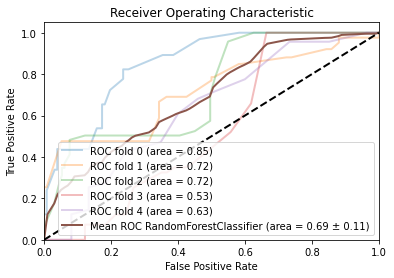

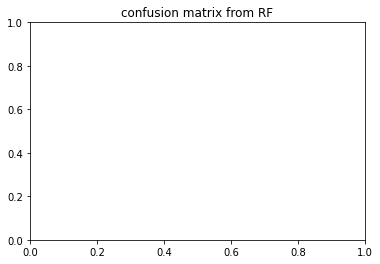

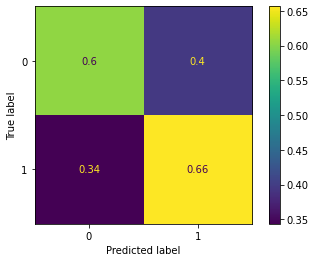

,precision,recall,f1-score,support,auc
0,0.643,0.605,0.602,131.600,0.000
1,0.687,0.650,0.619,131.600,0.000
accuracy,0.631,0.631,0.631,0.631,0.000
macro avg,0.665,0.628,0.611,263.200,0.692
weighted avg,0.664,0.631,0.612,263.200,0.692


coming from


,precision,recall,f1-score,support,auc
0,0.769841,0.763780,0.766798,127.000000,0.00000
1,0.770992,0.776923,0.773946,130.000000,0.00000
accuracy,0.770428,0.770428,0.770428,0.770428,0.00000
macro avg,0.770417,0.770351,0.770372,257.000000,0.85318
weighted avg,0.770424,0.770428,0.770414,257.000000,0.85318


,precision,recall,f1-score,support,auc
0,0.585903,0.992537,0.736842,134.000000,0.000000
1,0.969697,0.253968,0.402516,126.000000,0.000000
accuracy,0.634615,0.634615,0.634615,0.634615,0.000000
macro avg,0.777800,0.623253,0.569679,260.000000,0.717336
weighted avg,0.771896,0.634615,0.574822,260.000000,0.717336


,precision,recall,f1-score,support,auc
0,0.680851,0.488550,0.568889,131.000000,0.000000
1,0.623596,0.787234,0.695925,141.000000,0.000000
accuracy,0.643382,0.643382,0.643382,0.643382,0.000000
macro avg,0.652223,0.637892,0.632407,272.000000,0.724947
weighted avg,0.651171,0.643382,0.634742,272.000000,0.724947


,precision,recall,f1-score,support,auc
0,0.543478,0.381679,0.448430,131.000000,0.000000
1,0.500000,0.658537,0.568421,123.000000,0.000000
accuracy,0.515748,0.515748,0.515748,0.515748,0.000000
macro avg,0.521739,0.520108,0.508426,254.000000,0.531931
weighted avg,0.522424,0.515748,0.506536,254.000000,0.531931


,precision,recall,f1-score,support,auc
0,0.635294,0.400000,0.490909,135.000000,0.000000
1,0.569149,0.775362,0.656442,138.000000,0.000000
accuracy,0.589744,0.589744,0.589744,0.589744,0.000000
macro avg,0.602222,0.587681,0.573675,273.000000,0.631455
weighted avg,0.601858,0.589744,0.574585,273.000000,0.631455


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 50}
depth_100_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.656 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.748 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.626 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.580 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.859 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.677 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.846 total time=   0.1s
[CV 3/5] END criteri

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.584 total time=   2.3s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.385 total time=   2.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.323 total time=   2.2s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.288 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.918 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.710 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.301 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.589 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.247 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.747 total time=   2.5s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.592 total time=   2.7s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.575 total time=   2.6s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.549 total time=   2.6s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.282 total time=   2.6s


<Figure size 432x288 with 0 Axes>

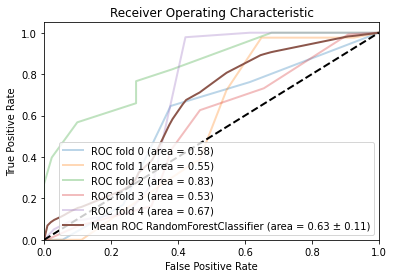

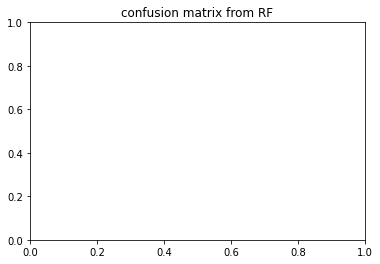

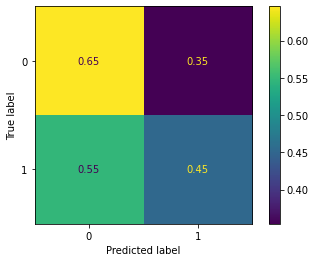

,precision,recall,f1-score,support,auc
0,0.558,0.647,0.589,131.600,0.000
1,0.536,0.453,0.476,131.600,0.000
accuracy,0.549,0.549,0.549,0.549,0.000
macro avg,0.547,0.550,0.532,263.200,0.631
weighted avg,0.548,0.549,0.532,263.200,0.631


coming from


,precision,recall,f1-score,support,auc
0,0.473171,0.763780,0.584337,127.000000,0.000000
1,0.423077,0.169231,0.241758,130.000000,0.000000
accuracy,0.463035,0.463035,0.463035,0.463035,0.000000
macro avg,0.448124,0.466505,0.413048,257.000000,0.579194
weighted avg,0.447831,0.463035,0.411048,257.000000,0.579194


,precision,recall,f1-score,support,auc
0,0.635417,0.455224,0.530435,134.000000,0.000000
1,0.554878,0.722222,0.627586,126.000000,0.000000
accuracy,0.584615,0.584615,0.584615,0.584615,0.000000
macro avg,0.595147,0.588723,0.579010,260.000000,0.545931
weighted avg,0.596386,0.584615,0.577516,260.000000,0.545931


,precision,recall,f1-score,support,auc
0,0.664336,0.725191,0.693431,131.000000,0.000000
1,0.720930,0.659574,0.688889,141.000000,0.000000
accuracy,0.691176,0.691176,0.691176,0.691176,0.000000
macro avg,0.692633,0.692383,0.691160,272.000000,0.828975
weighted avg,0.693673,0.691176,0.691076,272.000000,0.828975


,precision,recall,f1-score,support,auc
0,0.540000,0.618321,0.576512,131.000000,0.000000
1,0.519231,0.439024,0.475771,123.000000,0.000000
accuracy,0.531496,0.531496,0.531496,0.531496,0.000000
macro avg,0.529615,0.528673,0.526142,254.000000,0.529138
weighted avg,0.529942,0.531496,0.527728,254.000000,0.529138


,precision,recall,f1-score,support,auc
0,0.476440,0.674074,0.558282,135.000000,0.000000
1,0.463415,0.275362,0.345455,138.000000,0.000000
accuracy,0.472527,0.472527,0.472527,0.472527,0.000000
macro avg,0.469927,0.474718,0.451868,273.000000,0.674208
weighted avg,0.469856,0.472527,0.450699,273.000000,0.674208


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 10}
depth_100_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.246 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.617 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.848 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.454 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.581 total time=   0.1s
[CV 3/5] END crit

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.675 total time=   4.4s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.245 total time=   4.1s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.802 total time=   5.1s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.642 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.568 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.538 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.199 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.700 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.823 total time=   2.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.508 total time=   5.1s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.803 total time=   5.5s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.599 total time=   4.5s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.299 total time=   4.4s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.796 total time=   4.7s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

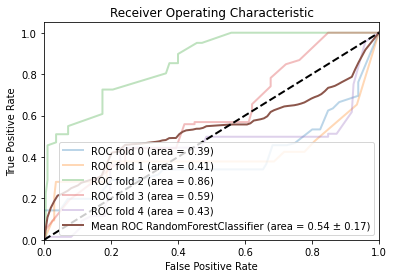

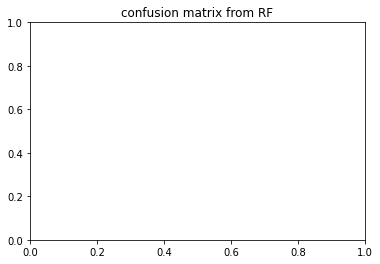

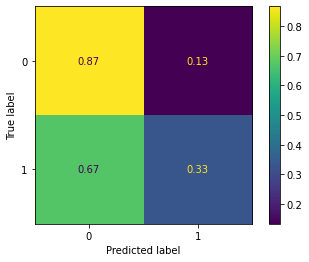

,precision,recall,f1-score,support,auc
0,0.573,0.865,0.684,200.000,0.000
1,0.582,0.324,0.399,200.000,0.000
accuracy,0.598,0.598,0.598,0.598,0.000
macro avg,0.577,0.595,0.541,400.000,0.538
weighted avg,0.579,0.598,0.544,400.000,0.538


coming from


,precision,recall,f1-score,support,auc
0,0.517157,1.000000,0.681745,211.000000,0.000000
1,0.000000,0.000000,0.000000,197.000000,0.000000
accuracy,0.517157,0.517157,0.517157,0.517157,0.000000
macro avg,0.258578,0.500000,0.340872,408.000000,0.394207
weighted avg,0.267451,0.517157,0.352569,408.000000,0.394207


,precision,recall,f1-score,support,auc
0,0.556522,0.969697,0.707182,198.00000,0.000000
1,0.869565,0.207254,0.334728,193.00000,0.000000
accuracy,0.593350,0.593350,0.593350,0.59335,0.000000
macro avg,0.713043,0.588475,0.520955,391.00000,0.411224
weighted avg,0.711042,0.593350,0.523337,391.00000,0.411224


,precision,recall,f1-score,support,auc
0,0.706140,0.825641,0.761229,195.000000,0.000000
1,0.801170,0.671569,0.730667,204.000000,0.000000
accuracy,0.746867,0.746867,0.746867,0.746867,0.000000
macro avg,0.753655,0.748605,0.745948,399.000000,0.857906
weighted avg,0.754727,0.746867,0.745603,399.000000,0.857906


,precision,recall,f1-score,support,auc
0,0.545455,0.757576,0.634249,198.000000,0.000000
1,0.600000,0.365482,0.454259,197.000000,0.000000
accuracy,0.562025,0.562025,0.562025,0.562025,0.000000
macro avg,0.572727,0.561529,0.544254,395.000000,0.594024
weighted avg,0.572658,0.562025,0.544482,395.000000,0.594024


,precision,recall,f1-score,support,auc
0,0.540636,0.772727,0.636175,198.000000,0.000000
1,0.637097,0.377990,0.474474,209.000000,0.000000
accuracy,0.570025,0.570025,0.570025,0.570025,0.000000
macro avg,0.588866,0.575359,0.555325,407.000000,0.431758
weighted avg,0.590170,0.570025,0.553139,407.000000,0.431758


{'criterion': 'gini', 'max_depth': 100, 'max_features': 0.8, 'n_estimators': 50}
depth_100_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.436 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.359 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.483 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.604 total time=   0.2s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.554 total time=   0.2s
[CV 3/5] END criterion=gin

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.709 total time=   5.3s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.329 total time=   4.1s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.788 total time=   4.7s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.561 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.666 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.298 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.966 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.848 total time=   2.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.603 total time=   4.6s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.828 total time=   6.6s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.630 total time=   4.8s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.344 total time=   4.6s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.788 total time=   5.1s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

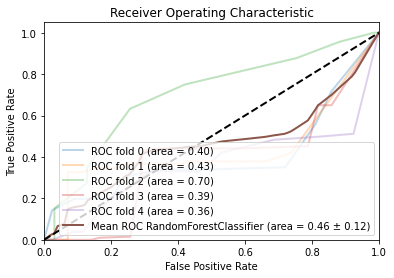

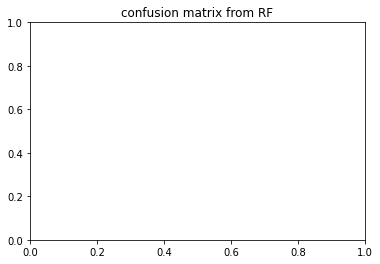

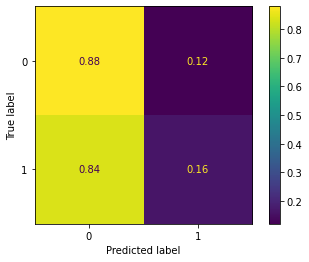

,precision,recall,f1-score,support,auc
0,0.517,0.878,0.647,200.000,0.000
1,0.317,0.162,0.206,200.000,0.000
accuracy,0.521,0.521,0.521,0.521,0.000
macro avg,0.417,0.520,0.426,400.000,0.457
weighted avg,0.419,0.521,0.428,400.000,0.457


coming from


,precision,recall,f1-score,support,auc
0,0.517157,1.000000,0.681745,211.000000,0.000000
1,0.000000,0.000000,0.000000,197.000000,0.000000
accuracy,0.517157,0.517157,0.517157,0.517157,0.000000
macro avg,0.258578,0.500000,0.340872,408.000000,0.400354
weighted avg,0.267451,0.517157,0.352569,408.000000,0.400354


,precision,recall,f1-score,support,auc
0,0.488064,0.929293,0.640000,198.000000,0.000000
1,0.000000,0.000000,0.000000,193.000000,0.000000
accuracy,0.470588,0.470588,0.470588,0.470588,0.000000
macro avg,0.244032,0.464646,0.320000,391.000000,0.431779
weighted avg,0.247152,0.470588,0.324092,391.000000,0.431779


,precision,recall,f1-score,support,auc
0,0.561056,0.871795,0.682731,195.00000,0.000000
1,0.739583,0.348039,0.473333,204.00000,0.000000
accuracy,0.604010,0.604010,0.604010,0.60401,0.000000
macro avg,0.650320,0.609917,0.578032,399.00000,0.701496
weighted avg,0.652333,0.604010,0.575671,399.00000,0.701496


,precision,recall,f1-score,support,auc
0,0.551181,0.707071,0.619469,198.000000,0.00000
1,0.588652,0.421320,0.491124,197.000000,0.00000
accuracy,0.564557,0.564557,0.564557,0.564557,0.00000
macro avg,0.569917,0.564195,0.555297,395.000000,0.38671
weighted avg,0.569869,0.564557,0.555459,395.000000,0.38671


,precision,recall,f1-score,support,auc
0,0.465426,0.883838,0.609756,198.000000,0.000000
1,0.258065,0.038278,0.066667,209.000000,0.000000
accuracy,0.449631,0.449631,0.449631,0.449631,0.000000
macro avg,0.361745,0.461058,0.338211,407.000000,0.362863
weighted avg,0.358943,0.449631,0.330872,407.000000,0.362863


{'criterion': 'gini', 'max_depth': 100, 'max_features': 0.8, 'n_estimators': 10}
depth_100_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.834 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.695 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.591 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.342 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.848 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.867 total time=   0.1s
[CV 3/5] END criter

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.571 total time=   2.1s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.625 total time=   2.8s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.589 total time=   2.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.888 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.977 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.538 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.418 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.568 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.711 total time=   2.7s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.629 total time=   2.7s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.553 total time=   2.7s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.413 total time=   2.5s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.576 total time=   2.5s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

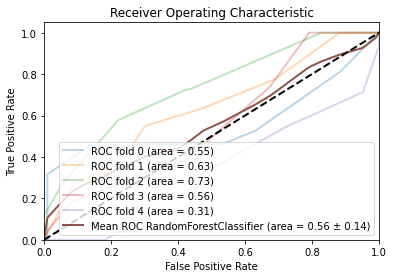

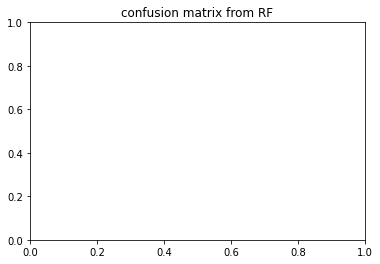

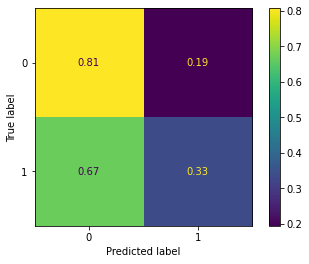

,precision,recall,f1-score,support,auc
0,0.553,0.805,0.632,102.200,0.000
1,0.588,0.343,0.395,102.200,0.000
accuracy,0.572,0.572,0.572,0.572,0.000
macro avg,0.571,0.574,0.514,204.400,0.558
weighted avg,0.570,0.572,0.512,204.400,0.558


coming from


,precision,recall,f1-score,support,auc
0,0.610778,0.990291,0.755556,103.000000,0.000000
1,0.967742,0.315789,0.476190,95.000000,0.000000
accuracy,0.666667,0.666667,0.666667,0.666667,0.000000
macro avg,0.789260,0.653040,0.615873,198.000000,0.553551
weighted avg,0.782049,0.666667,0.621517,198.000000,0.553551


,precision,recall,f1-score,support,auc
0,0.533784,0.766990,0.629482,103.000000,0.000000
1,0.636364,0.378378,0.474576,111.000000,0.000000
accuracy,0.565421,0.565421,0.565421,0.565421,0.000000
macro avg,0.585074,0.572684,0.552029,214.000000,0.633692
weighted avg,0.586991,0.565421,0.549134,214.000000,0.633692


,precision,recall,f1-score,support,auc
0,0.560241,0.939394,0.701887,99.000000,0.000000
1,0.828571,0.284314,0.423358,102.000000,0.000000
accuracy,0.606965,0.606965,0.606965,0.606965,0.000000
macro avg,0.694406,0.611854,0.562622,201.000000,0.732521
weighted avg,0.696409,0.606965,0.560544,201.000000,0.732521


,precision,recall,f1-score,support,auc
0,0.568966,0.326733,0.415094,101.00000,0.000000
1,0.507246,0.736842,0.600858,95.00000,0.000000
accuracy,0.525510,0.525510,0.525510,0.52551,0.000000
macro avg,0.538106,0.531787,0.507976,196.00000,0.558155
weighted avg,0.539051,0.525510,0.505133,196.00000,0.558155


,precision,recall,f1-score,support,auc
0,0.492958,1.000000,0.660377,105.000000,0.000000
1,0.000000,0.000000,0.000000,108.000000,0.000000
accuracy,0.492958,0.492958,0.492958,0.492958,0.000000
macro avg,0.246479,0.500000,0.330189,213.000000,0.314462
weighted avg,0.243007,0.492958,0.325538,213.000000,0.314462


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 10}
depth_100_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.722 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.844 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.551 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.705 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.445 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.652 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.602 total time=   0.1s
[CV 3/5] END criter

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.622 total time=   2.1s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.474 total time=   2.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.566 total time=   1.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.741 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.840 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.209 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.316 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.588 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.717 total time=   2.5s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.637 total time=   2.7s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.549 total time=   2.2s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.487 total time=   2.5s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.3s


<Figure size 432x288 with 0 Axes>

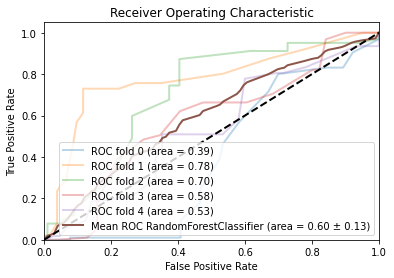

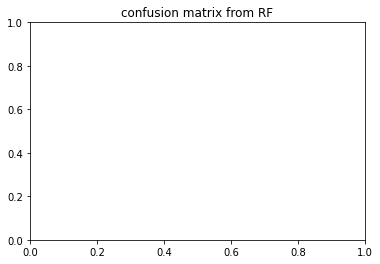

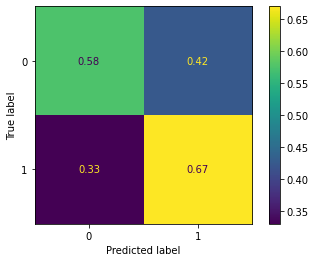

,precision,recall,f1-score,support,auc
0,0.629,0.576,0.592,102.200,0.000
1,0.626,0.668,0.639,102.200,0.000
accuracy,0.621,0.621,0.621,0.621,0.000
macro avg,0.628,0.622,0.615,204.400,0.596
weighted avg,0.628,0.621,0.615,204.400,0.596


coming from


,precision,recall,f1-score,support,auc
0,0.557377,0.330097,0.414634,103.000000,0.00000
1,0.496350,0.715789,0.586207,95.000000,0.00000
accuracy,0.515152,0.515152,0.515152,0.515152,0.00000
macro avg,0.526864,0.522943,0.500421,198.000000,0.39443
weighted avg,0.528097,0.515152,0.496954,198.000000,0.39443


,precision,recall,f1-score,support,auc
0,0.733871,0.883495,0.801762,103.00000,0.000000
1,0.866667,0.702703,0.776119,111.00000,0.000000
accuracy,0.789720,0.789720,0.789720,0.78972,0.000000
macro avg,0.800269,0.793099,0.788941,214.00000,0.775562
weighted avg,0.802751,0.789720,0.788461,214.00000,0.775562


,precision,recall,f1-score,support,auc
0,0.776316,0.595960,0.674286,99.000000,0.000000
1,0.680000,0.833333,0.748899,102.000000,0.000000
accuracy,0.716418,0.716418,0.716418,0.716418,0.000000
macro avg,0.728158,0.714646,0.711592,201.000000,0.700634
weighted avg,0.727439,0.716418,0.712149,201.000000,0.700634


,precision,recall,f1-score,support,auc
0,0.584071,0.653465,0.616822,101.000000,0.000000
1,0.578313,0.505263,0.539326,95.000000,0.000000
accuracy,0.581633,0.581633,0.581633,0.581633,0.000000
macro avg,0.581192,0.579364,0.578074,196.000000,0.577019
weighted avg,0.581280,0.581633,0.579260,196.000000,0.577019


,precision,recall,f1-score,support,auc
0,0.494382,0.419048,0.453608,105.000000,0.000000
1,0.508065,0.583333,0.543103,108.000000,0.000000
accuracy,0.502347,0.502347,0.502347,0.502347,0.000000
macro avg,0.501223,0.501190,0.498356,213.000000,0.530908
weighted avg,0.501320,0.502347,0.498986,213.000000,0.530908


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 50}
depth_100_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.406 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.530 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.736 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.666 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.588 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.407 total time=   0.1s
[CV 3/5] END cri

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.605 total time=   3.2s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.699 total time=   3.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.594 total time=   3.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.607 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.518 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.514 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.795 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.786 total time=   2.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.565 total time=   4.1s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.219 total time=   3.5s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.557 total time=   3.4s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.729 total time=   3.4s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.706 total time=   4.1s


<Figure size 432x288 with 0 Axes>

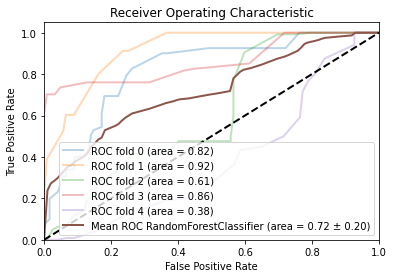

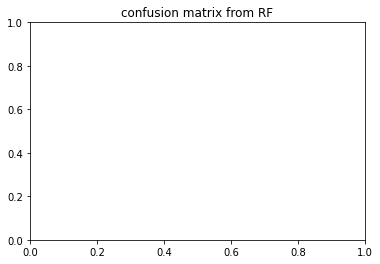

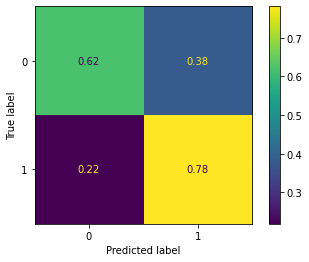

,precision,recall,f1-score,support,auc
0,0.704,0.620,0.616,122.800,0.000
1,0.736,0.782,0.733,122.800,0.000
accuracy,0.701,0.701,0.701,0.701,0.000
macro avg,0.720,0.701,0.674,245.600,0.718
weighted avg,0.720,0.701,0.674,245.600,0.718


coming from


,precision,recall,f1-score,support,auc
0,0.786325,0.754098,0.769874,122.000000,0.000000
1,0.761905,0.793388,0.777328,121.000000,0.000000
accuracy,0.773663,0.773663,0.773663,0.773663,0.000000
macro avg,0.774115,0.773743,0.773601,243.000000,0.819604
weighted avg,0.774165,0.773663,0.773586,243.000000,0.819604


,precision,recall,f1-score,support,auc
0,0.804688,0.837398,0.820717,123.000000,0.000000
1,0.834711,0.801587,0.817814,126.000000,0.000000
accuracy,0.819277,0.819277,0.819277,0.819277,0.000000
macro avg,0.819699,0.819493,0.819265,249.000000,0.915989
weighted avg,0.819880,0.819277,0.819248,249.000000,0.915989


,precision,recall,f1-score,support,auc
0,0.646341,0.434426,0.519608,122.000000,0.000000
1,0.584337,0.769841,0.664384,126.000000,0.000000
accuracy,0.604839,0.604839,0.604839,0.604839,0.000000
macro avg,0.615339,0.602134,0.591996,248.000000,0.612119
weighted avg,0.614839,0.604839,0.593163,248.000000,0.612119


,precision,recall,f1-score,support,auc
0,0.720930,1.000000,0.837838,124.000000,0.000000
1,1.000000,0.603306,0.752577,121.000000,0.000000
accuracy,0.804082,0.804082,0.804082,0.804082,0.000000
macro avg,0.860465,0.801653,0.795208,245.000000,0.859071
weighted avg,0.858757,0.804082,0.795730,245.000000,0.859071


,precision,recall,f1-score,support,auc
0,0.562500,0.073171,0.129496,123.000000,0.000000
1,0.497797,0.941667,0.651297,120.000000,0.000000
accuracy,0.502058,0.502058,0.502058,0.502058,0.000000
macro avg,0.530149,0.507419,0.390397,243.000000,0.383774
weighted avg,0.530548,0.502058,0.387176,243.000000,0.383774


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 50}
depth_100_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.640 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.597 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.532 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.616 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.754 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.592 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.361 total time=   0.1s
[CV 3/5] END criterion

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.553 total time=   3.1s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.694 total time=   3.1s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.689 total time=   3.4s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.329 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.446 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.742 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.747 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.727 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.730 total time=   2.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.690 total time=   3.9s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.262 total time=   3.3s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.531 total time=   3.3s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.791 total time=   3.4s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.706 total time=   4.2s


<Figure size 432x288 with 0 Axes>

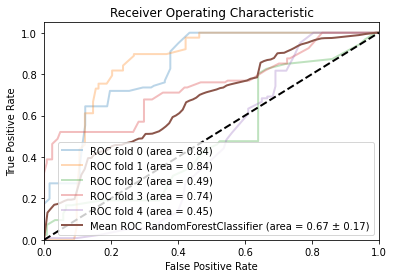

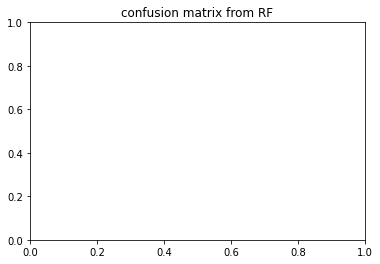

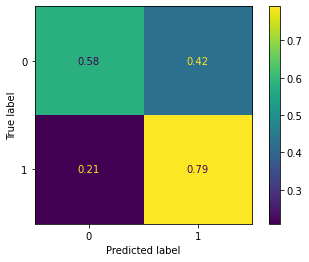

,precision,recall,f1-score,support,auc
0,0.760,0.577,0.619,122.800,0.000
1,0.694,0.792,0.712,122.800,0.000
accuracy,0.685,0.685,0.685,0.685,0.000
macro avg,0.727,0.685,0.665,245.600,0.673
weighted avg,0.727,0.685,0.665,245.600,0.673


coming from


,precision,recall,f1-score,support,auc
0,0.924051,0.598361,0.726368,122.000000,0.00000
1,0.701220,0.950413,0.807018,121.000000,0.00000
accuracy,0.773663,0.773663,0.773663,0.773663,0.00000
macro avg,0.812635,0.774387,0.766693,243.000000,0.83637
weighted avg,0.813094,0.773663,0.766527,243.000000,0.83637


,precision,recall,f1-score,support,auc
0,0.865385,0.731707,0.792952,123.000000,0.000000
1,0.772414,0.888889,0.826568,126.000000,0.000000
accuracy,0.811245,0.811245,0.811245,0.811245,0.000000
macro avg,0.818899,0.810298,0.809760,249.000000,0.837656
weighted avg,0.818339,0.811245,0.809962,249.000000,0.837656


,precision,recall,f1-score,support,auc
0,0.523810,0.360656,0.427184,122.000000,0.000000
1,0.524390,0.682540,0.593103,126.000000,0.000000
accuracy,0.524194,0.524194,0.524194,0.524194,0.000000
macro avg,0.524100,0.521598,0.510144,248.000000,0.494893
weighted avg,0.524105,0.524194,0.511482,248.000000,0.494893


,precision,recall,f1-score,support,auc
0,0.657459,0.959677,0.780328,124.000000,0.000000
1,0.921875,0.487603,0.637838,121.000000,0.000000
accuracy,0.726531,0.726531,0.726531,0.726531,0.000000
macro avg,0.789667,0.723640,0.709083,245.000000,0.742769
weighted avg,0.788048,0.726531,0.709955,245.000000,0.742769


,precision,recall,f1-score,support,auc
0,0.828571,0.235772,0.367089,123.000000,0.000000
1,0.548077,0.950000,0.695122,120.000000,0.000000
accuracy,0.588477,0.588477,0.588477,0.588477,0.000000
macro avg,0.688324,0.592886,0.531105,243.000000,0.452913
weighted avg,0.690056,0.588477,0.529080,243.000000,0.452913


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.678 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.560 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.827 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.351 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.353 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.551 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.593 total time=   0.1s
[CV 3

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.641 total time=   2.4s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.592 total time=   2.4s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.469 total time=   2.2s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.414 total time=   2.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.414 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.591 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.599 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.285 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.584 total time=   1.3s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.498 total time=   1.3s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.235 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.716 total time=   2.6s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.708 total time=   2.8s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.570 total time=   2.7s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.547 total time=   2.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.320 total time=   2.7s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

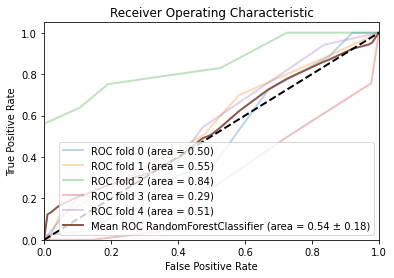

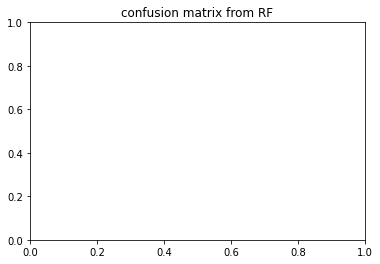

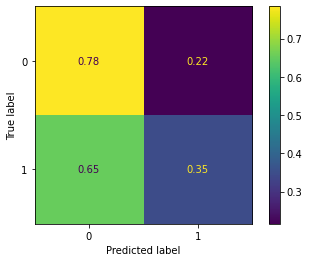

,precision,recall,f1-score,support,auc
0,0.553,0.788,0.636,131.600,0.000
1,0.381,0.338,0.356,131.600,0.000
accuracy,0.564,0.564,0.564,0.564,0.000
macro avg,0.467,0.563,0.496,263.200,0.539
weighted avg,0.469,0.564,0.497,263.200,0.539


coming from


,precision,recall,f1-score,support,auc
0,0.494163,1.000000,0.661458,127.000000,0.00000
1,0.000000,0.000000,0.000000,130.000000,0.00000
accuracy,0.494163,0.494163,0.494163,0.494163,0.00000
macro avg,0.247082,0.500000,0.330729,257.000000,0.49576
weighted avg,0.244197,0.494163,0.326869,257.000000,0.49576


,precision,recall,f1-score,support,auc
0,0.530303,0.522388,0.526316,134.000000,0.00000
1,0.500000,0.507937,0.503937,126.000000,0.00000
accuracy,0.515385,0.515385,0.515385,0.515385,0.00000
macro avg,0.515152,0.515162,0.515126,260.000000,0.55289
weighted avg,0.515618,0.515385,0.515471,260.000000,0.55289


,precision,recall,f1-score,support,auc
0,0.696429,0.893130,0.782609,131.000000,0.000000
1,0.865385,0.638298,0.734694,141.000000,0.000000
accuracy,0.761029,0.761029,0.761029,0.761029,0.000000
macro avg,0.780907,0.765714,0.758651,272.000000,0.844405
weighted avg,0.784012,0.761029,0.757770,272.000000,0.844405


,precision,recall,f1-score,support,auc
0,0.515748,1.000000,0.680519,131.000000,0.000000
1,0.000000,0.000000,0.000000,123.000000,0.000000
accuracy,0.515748,0.515748,0.515748,0.515748,0.000000
macro avg,0.257874,0.500000,0.340260,254.000000,0.285329
weighted avg,0.265996,0.515748,0.350977,254.000000,0.285329


,precision,recall,f1-score,support,auc
0,0.529851,0.525926,0.527881,135.000000,0.000000
1,0.539568,0.543478,0.541516,138.000000,0.000000
accuracy,0.534799,0.534799,0.534799,0.534799,0.000000
macro avg,0.534710,0.534702,0.534699,273.000000,0.514385
weighted avg,0.534763,0.534799,0.534774,273.000000,0.514385


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 10}
depth_1000_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.484 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.527 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.086 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.471 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.511 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.851 total time=   0.1s
[CV 3/5] END c

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.442 total time=   2.4s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.584 total time=   2.4s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.543 total time=   2.1s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.394 total time=   2.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.596 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.484 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.186 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.583 total time=   1.3s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.313 total time=   1.2s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.457 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.751 total time=   2.6s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.537 total time=   2.8s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.580 total time=   2.8s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.592 total time=   2.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.222 total time=   2.7s


<Figure size 432x288 with 0 Axes>

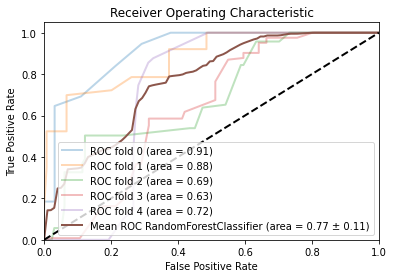

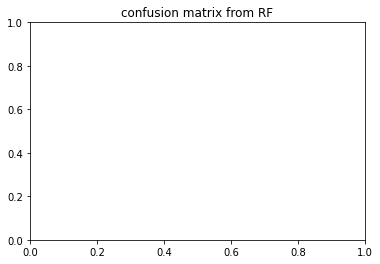

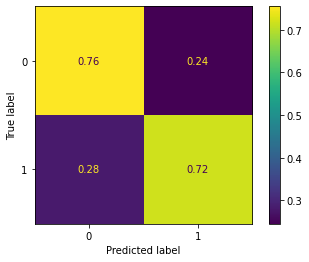

,precision,recall,f1-score,support,auc
0,0.740,0.755,0.736,131.600,0.000
1,0.767,0.722,0.729,131.600,0.000
accuracy,0.737,0.737,0.737,0.737,0.000
macro avg,0.753,0.738,0.732,263.200,0.766
weighted avg,0.754,0.737,0.732,263.200,0.766


coming from


,precision,recall,f1-score,support,auc
0,0.826446,0.787402,0.806452,127.00000,0.000000
1,0.801471,0.838462,0.819549,130.00000,0.000000
accuracy,0.813230,0.813230,0.813230,0.81323,0.000000
macro avg,0.813958,0.812932,0.813000,257.00000,0.913446
weighted avg,0.813813,0.813230,0.813077,257.00000,0.913446


,precision,recall,f1-score,support,auc
0,0.753012,0.932836,0.833333,134.000000,0.000000
1,0.904255,0.674603,0.772727,126.000000,0.000000
accuracy,0.807692,0.807692,0.807692,0.807692,0.000000
macro avg,0.828634,0.803719,0.803030,260.000000,0.879501
weighted avg,0.826307,0.807692,0.803963,260.000000,0.879501


,precision,recall,f1-score,support,auc
0,0.608466,0.877863,0.718750,131.000000,0.000000
1,0.807229,0.475177,0.598214,141.000000,0.000000
accuracy,0.669118,0.669118,0.669118,0.669118,0.000000
macro avg,0.707847,0.676520,0.658482,272.000000,0.687889
weighted avg,0.711501,0.669118,0.656266,272.000000,0.687889


,precision,recall,f1-score,support,auc
0,0.688172,0.488550,0.571429,131.000000,0.00000
1,0.583851,0.764228,0.661972,123.000000,0.00000
accuracy,0.622047,0.622047,0.622047,0.622047,0.00000
macro avg,0.636011,0.626389,0.616700,254.000000,0.63306
weighted avg,0.637654,0.622047,0.615274,254.000000,0.63306


,precision,recall,f1-score,support,auc
0,0.823009,0.688889,0.750000,135.000000,0.000000
1,0.737500,0.855072,0.791946,138.000000,0.000000
accuracy,0.772894,0.772894,0.772894,0.772894,0.000000
macro avg,0.780254,0.771981,0.770973,273.000000,0.715566
weighted avg,0.779785,0.772894,0.771204,273.000000,0.715566


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'sqrt', 'n_estimators': 50}
depth_1000_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.405 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.567 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.739 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.299 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.506 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.578 total time=   0.1s
[CV 3/5]

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.887 total time=   4.6s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.693 total time=   4.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.286 total time=   3.7s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.826 total time=   4.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.602 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.478 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.373 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.626 total time=   2.1s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.314 total time=   2.1s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.805 total time=   2.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.572 total time=   4.2s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.811 total time=   4.8s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.631 total time=   4.3s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.339 total time=   4.2s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.801 total time=   4.7s


<Figure size 432x288 with 0 Axes>

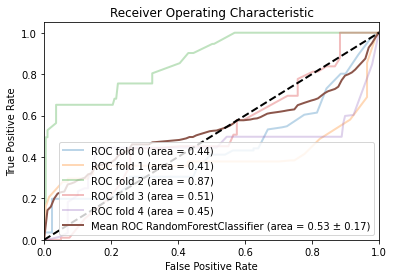

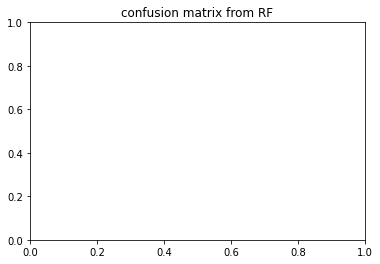

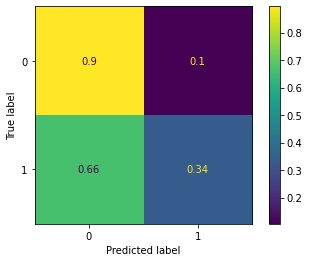

,precision,recall,f1-score,support,auc
0,0.577,0.894,0.700,200.000,0.000
1,0.773,0.334,0.447,200.000,0.000
accuracy,0.616,0.616,0.616,0.616,0.000
macro avg,0.675,0.614,0.574,400.000,0.534
weighted avg,0.675,0.616,0.575,400.000,0.534


coming from


,precision,recall,f1-score,support,auc
0,0.542105,0.976303,0.697124,211.000000,0.000000
1,0.821429,0.116751,0.204444,197.000000,0.000000
accuracy,0.561275,0.561275,0.561275,0.561275,0.000000
macro avg,0.681767,0.546527,0.450784,408.000000,0.437859
weighted avg,0.676975,0.561275,0.459237,408.000000,0.437859


,precision,recall,f1-score,support,auc
0,0.569659,0.929293,0.706334,198.000000,0.000000
1,0.794118,0.279793,0.413793,193.000000,0.000000
accuracy,0.608696,0.608696,0.608696,0.608696,0.000000
macro avg,0.681889,0.604543,0.560064,391.000000,0.406592
weighted avg,0.680453,0.608696,0.561934,391.000000,0.406592


,precision,recall,f1-score,support,auc
0,0.678700,0.964103,0.796610,195.000000,0.000000
1,0.942623,0.563725,0.705521,204.000000,0.000000
accuracy,0.759398,0.759398,0.759398,0.759398,0.000000
macro avg,0.810662,0.763914,0.751066,399.000000,0.867785
weighted avg,0.813638,0.759398,0.750039,399.000000,0.867785


,precision,recall,f1-score,support,auc
0,0.554717,0.742424,0.634989,198.000000,0.000000
1,0.607692,0.401015,0.483180,197.000000,0.000000
accuracy,0.572152,0.572152,0.572152,0.572152,0.000000
macro avg,0.581205,0.571720,0.559085,395.000000,0.510716
weighted avg,0.581138,0.572152,0.559277,395.000000,0.510716


,precision,recall,f1-score,support,auc
0,0.541401,0.858586,0.664062,198.000000,0.00000
1,0.698925,0.311005,0.430464,209.000000,0.00000
accuracy,0.577396,0.577396,0.577396,0.577396,0.00000
macro avg,0.620163,0.584795,0.547263,407.000000,0.44755
weighted avg,0.622292,0.577396,0.544106,407.000000,0.44755


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 0.5, 'n_estimators': 50}
depth_1000_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.502 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.515 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.222 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.712 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.580 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.595 total time=   0.1s
[CV 3/5] END crit

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.898 total time=   4.6s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.716 total time=   4.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.319 total time=   3.8s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.828 total time=   4.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.513 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.805 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.589 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.504 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.570 total time=   2.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.365 total time=   2.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.778 total time=   2.4s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.493 total time=   4.1s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.846 total time=   4.9s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.630 total time=   4.3s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.327 total time=   4.1s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.828 total time=   4.7s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

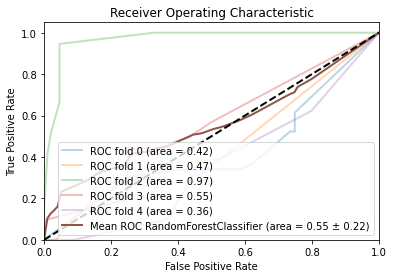

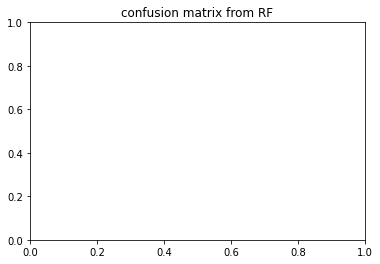

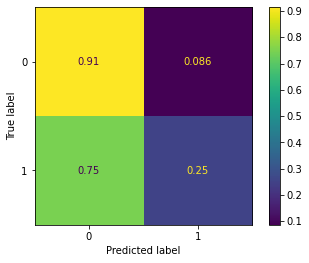

,precision,recall,f1-score,support,auc
0,0.564,0.913,0.691,200.000,0.000
1,0.423,0.254,0.310,200.000,0.000
accuracy,0.584,0.584,0.584,0.584,0.000
macro avg,0.494,0.583,0.501,400.000,0.552
weighted avg,0.495,0.584,0.502,400.000,0.552


coming from


,precision,recall,f1-score,support,auc
0,0.517157,1.000000,0.681745,211.000000,0.000000
1,0.000000,0.000000,0.000000,197.000000,0.000000
accuracy,0.517157,0.517157,0.517157,0.517157,0.000000
macro avg,0.258578,0.500000,0.340872,408.000000,0.421645
weighted avg,0.267451,0.517157,0.352569,408.000000,0.421645


,precision,recall,f1-score,support,auc
0,0.516517,0.868687,0.647834,198.000000,0.000000
1,0.551724,0.165803,0.254980,193.000000,0.000000
accuracy,0.521739,0.521739,0.521739,0.521739,0.000000
macro avg,0.534120,0.517245,0.451407,391.000000,0.465732
weighted avg,0.533895,0.521739,0.453919,391.000000,0.465732


,precision,recall,f1-score,support,auc
0,0.732283,0.953846,0.828508,195.000000,0.00000
1,0.937931,0.666667,0.779370,204.000000,0.00000
accuracy,0.807018,0.807018,0.807018,0.807018,0.00000
macro avg,0.835107,0.810256,0.803939,399.000000,0.96908
weighted avg,0.837427,0.807018,0.803385,399.000000,0.96908


,precision,recall,f1-score,support,auc
0,0.569767,0.742424,0.644737,198.000000,0.000000
1,0.627737,0.436548,0.514970,197.000000,0.000000
accuracy,0.589873,0.589873,0.589873,0.589873,0.000000
macro avg,0.598752,0.589486,0.579853,395.000000,0.547224
weighted avg,0.598679,0.589873,0.580018,395.000000,0.547224


,precision,recall,f1-score,support,auc
0,0.486486,1.000000,0.654545,198.000000,0.000000
1,0.000000,0.000000,0.000000,209.000000,0.000000
accuracy,0.486486,0.486486,0.486486,0.486486,0.000000
macro avg,0.243243,0.500000,0.327273,407.000000,0.358683
weighted avg,0.236669,0.486486,0.318428,407.000000,0.358683


{'criterion': 'gini', 'max_depth': 1000, 'max_features': None, 'n_estimators': 10}
depth_1000_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.871 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.759 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.647 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.575 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.367 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.745 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.786 total time=   0.1s
[CV 3/5] 

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.637 total time=   1.9s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.545 total time=   2.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.567 total time=   1.9s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.574 total time=   2.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.717 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.580 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.797 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.725 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.542 total time=   1.3s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.451 total time=   1.1s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.568 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.571 total time=   2.6s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.607 total time=   2.6s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.539 total time=   2.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.427 total time=   2.3s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.9s


<Figure size 432x288 with 0 Axes>

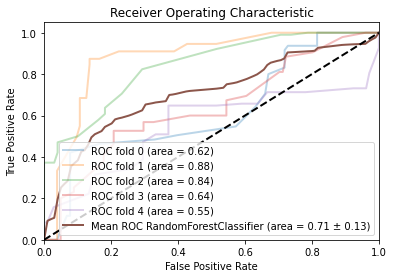

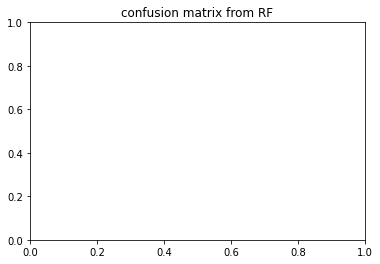

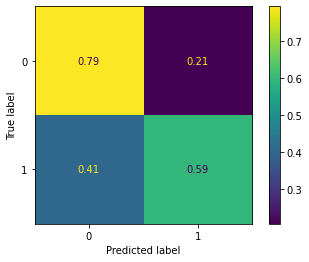

,precision,recall,f1-score,support,auc
0,0.671,0.795,0.724,102.200,0.000
1,0.744,0.586,0.643,102.200,0.000
accuracy,0.694,0.694,0.694,0.694,0.000
macro avg,0.708,0.691,0.683,204.400,0.706
weighted avg,0.707,0.694,0.685,204.400,0.706


coming from


,precision,recall,f1-score,support,auc
0,0.601266,0.922330,0.727969,103.000000,0.000000
1,0.800000,0.336842,0.474074,95.000000,0.000000
accuracy,0.641414,0.641414,0.641414,0.641414,0.000000
macro avg,0.700633,0.629586,0.601022,198.000000,0.621768
weighted avg,0.696618,0.641414,0.606151,198.000000,0.621768


,precision,recall,f1-score,support,auc
0,0.839623,0.864078,0.851675,103.00000,0.000000
1,0.870370,0.846847,0.858447,111.00000,0.000000
accuracy,0.855140,0.855140,0.855140,0.85514,0.000000
macro avg,0.854997,0.855462,0.855061,214.00000,0.877198
weighted avg,0.855571,0.855140,0.855188,214.00000,0.877198


,precision,recall,f1-score,support,auc
0,0.716981,0.767677,0.741463,99.000000,0.000000
1,0.757895,0.705882,0.730964,102.000000,0.000000
accuracy,0.736318,0.736318,0.736318,0.736318,0.000000
macro avg,0.737438,0.736780,0.736214,201.000000,0.839374
weighted avg,0.737743,0.736318,0.736136,201.000000,0.839374


,precision,recall,f1-score,support,auc
0,0.629921,0.792079,0.701754,101.000000,0.000000
1,0.695652,0.505263,0.585366,95.000000,0.000000
accuracy,0.653061,0.653061,0.653061,0.653061,0.000000
macro avg,0.662787,0.648671,0.643560,196.000000,0.636998
weighted avg,0.661781,0.653061,0.645342,196.000000,0.636998


,precision,recall,f1-score,support,auc
0,0.568966,0.628571,0.597285,105.00000,0.000000
1,0.597938,0.537037,0.565854,108.00000,0.000000
accuracy,0.582160,0.582160,0.582160,0.58216,0.000000
macro avg,0.583452,0.582804,0.581569,213.00000,0.552425
weighted avg,0.583656,0.582160,0.581348,213.00000,0.552425


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}
depth_1000_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.874 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.628 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.753 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.562 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.510 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.860 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.865 total time=   0.1s
[CV 3/5] E

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.658 total time=   1.9s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.551 total time=   1.9s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.467 total time=   1.9s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.605 total time=   1.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.668 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.662 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.699 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.512 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.583 total time=   1.1s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.361 total time=   1.1s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.576 total time=   1.1s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.622 total time=   2.4s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.646 total time=   2.3s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.567 total time=   2.2s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.431 total time=   2.2s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.3s


<Figure size 432x288 with 0 Axes>

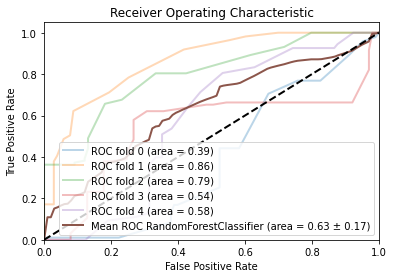

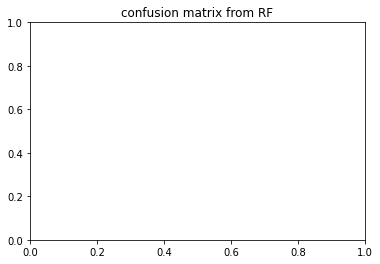

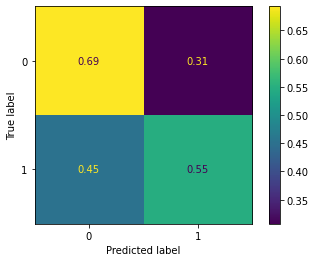

,precision,recall,f1-score,support,auc
0,0.599,0.695,0.636,102.200,0.000
1,0.672,0.546,0.590,102.200,0.000
accuracy,0.619,0.619,0.619,0.619,0.000
macro avg,0.636,0.620,0.613,204.400,0.632
weighted avg,0.637,0.619,0.613,204.400,0.632


coming from


,precision,recall,f1-score,support,auc
0,0.447917,0.417476,0.432161,103.000000,0.000000
1,0.411765,0.442105,0.426396,95.000000,0.000000
accuracy,0.429293,0.429293,0.429293,0.429293,0.000000
macro avg,0.429841,0.429790,0.429278,198.000000,0.387685
weighted avg,0.430571,0.429293,0.429395,198.000000,0.387685


,precision,recall,f1-score,support,auc
0,0.633333,0.922330,0.750988,103.000000,0.000000
1,0.875000,0.504505,0.640000,111.000000,0.000000
accuracy,0.705607,0.705607,0.705607,0.705607,0.000000
macro avg,0.754167,0.713417,0.695494,214.000000,0.860185
weighted avg,0.758684,0.705607,0.693420,214.000000,0.860185


,precision,recall,f1-score,support,auc
0,0.623188,0.868687,0.725738,99.000000,0.000000
1,0.793651,0.490196,0.606061,102.000000,0.000000
accuracy,0.676617,0.676617,0.676617,0.676617,0.000000
macro avg,0.708420,0.679441,0.665900,201.000000,0.794019
weighted avg,0.709692,0.676617,0.665006,201.000000,0.794019


,precision,recall,f1-score,support,auc
0,0.649123,0.732673,0.688372,101.000000,0.000000
1,0.670732,0.578947,0.621469,95.000000,0.000000
accuracy,0.658163,0.658163,0.658163,0.658163,0.000000
macro avg,0.659927,0.655810,0.654921,196.000000,0.541324
weighted avg,0.659597,0.658163,0.655945,196.000000,0.541324


,precision,recall,f1-score,support,auc
0,0.643678,0.533333,0.583333,105.000000,0.000000
1,0.611111,0.712963,0.658120,108.000000,0.000000
accuracy,0.624413,0.624413,0.624413,0.624413,0.000000
macro avg,0.627395,0.623148,0.620726,213.000000,0.575132
weighted avg,0.627165,0.624413,0.621253,213.000000,0.575132


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}
depth_1000_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.203 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.475 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.380 total time=   0.1s
[CV 3/5

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.186 total time=   3.8s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.625 total time=   3.3s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.703 total time=   3.6s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.660 total time=   3.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.549 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.527 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.272 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.839 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.723 total time=   1.7s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.813 total time=   1.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.717 total time=   2.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.574 total time=   3.8s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.288 total time=   3.3s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.527 total time=   3.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.805 total time=   3.4s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.736 total time=   4.5s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

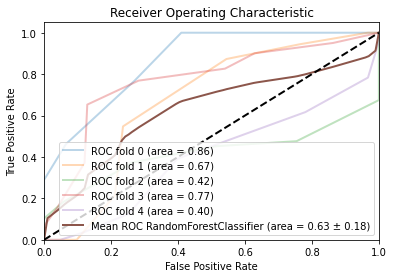

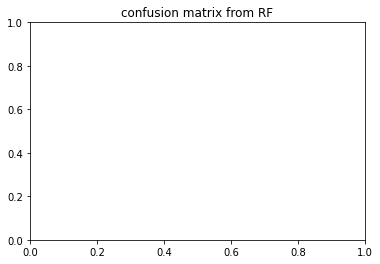

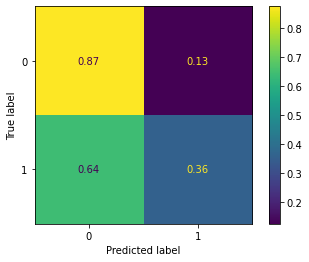

,precision,recall,f1-score,support,auc
0,0.600,0.875,0.698,122.800,0.000
1,0.638,0.358,0.411,122.800,0.000
accuracy,0.617,0.617,0.617,0.617,0.000
macro avg,0.619,0.616,0.555,245.600,0.626
weighted avg,0.620,0.617,0.555,245.600,0.626


coming from


,precision,recall,f1-score,support,auc
0,0.760684,0.729508,0.744770,122.000000,0.000000
1,0.738095,0.768595,0.753036,121.000000,0.000000
accuracy,0.748971,0.748971,0.748971,0.748971,0.000000
macro avg,0.749389,0.749052,0.748903,243.000000,0.864212
weighted avg,0.749436,0.748971,0.748886,243.000000,0.864212


,precision,recall,f1-score,support,auc
0,0.622517,0.764228,0.686131,123.000000,0.000000
1,0.704082,0.547619,0.616071,126.000000,0.000000
accuracy,0.654618,0.654618,0.654618,0.654618,0.000000
macro avg,0.663299,0.655923,0.651101,249.000000,0.670538
weighted avg,0.663790,0.654618,0.650679,249.000000,0.670538


,precision,recall,f1-score,support,auc
0,0.519149,1.000000,0.683473,122.000000,0.000000
1,1.000000,0.103175,0.187050,126.000000,0.000000
accuracy,0.544355,0.544355,0.544355,0.544355,0.000000
macro avg,0.759574,0.551587,0.435262,248.000000,0.421578
weighted avg,0.763452,0.544355,0.431258,248.000000,0.421578


,precision,recall,f1-score,support,auc
0,0.589189,0.879032,0.705502,124.000000,0.000000
1,0.750000,0.371901,0.497238,121.000000,0.000000
accuracy,0.628571,0.628571,0.628571,0.628571,0.000000
macro avg,0.669595,0.625467,0.601370,245.000000,0.771461
weighted avg,0.668610,0.628571,0.602645,245.000000,0.771461


,precision,recall,f1-score,support,auc
0,0.506173,1.000000,0.672131,123.000000,0.000000
1,0.000000,0.000000,0.000000,120.000000,0.000000
accuracy,0.506173,0.506173,0.506173,0.506173,0.000000
macro avg,0.253086,0.500000,0.336066,243.000000,0.401694
weighted avg,0.256211,0.506173,0.340215,243.000000,0.401694


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 10}
depth_1000_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.647 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.185 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.658 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.626 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.675 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.369 total time=   0.1s
[CV 3/5] E

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.279 total time=   3.4s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.605 total time=   3.3s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.716 total time=   3.5s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.758 total time=   3.7s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.393 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.552 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.381 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.763 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.583 total time=   1.7s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.726 total time=   1.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.655 total time=   2.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.722 total time=   4.2s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.169 total time=   3.8s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.551 total time=   3.5s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.726 total time=   3.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.669 total time=   4.6s


<Figure size 432x288 with 0 Axes>

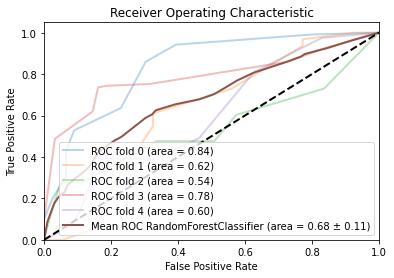

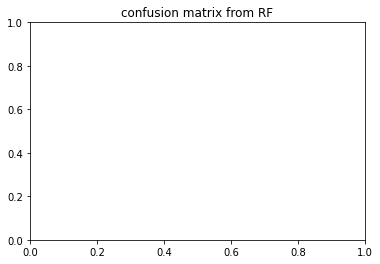

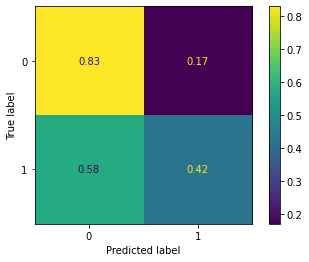

,precision,recall,f1-score,support,auc
0,0.604,0.831,0.692,122.800,0.000
1,0.740,0.425,0.491,122.800,0.000
accuracy,0.627,0.627,0.627,0.627,0.000
macro avg,0.672,0.628,0.591,245.600,0.676
weighted avg,0.673,0.627,0.591,245.600,0.676


coming from


,precision,recall,f1-score,support,auc
0,0.681159,0.770492,0.723077,122.000000,0.000000
1,0.733333,0.636364,0.681416,121.000000,0.000000
accuracy,0.703704,0.703704,0.703704,0.703704,0.000000
macro avg,0.707246,0.703428,0.702246,243.000000,0.835558
weighted avg,0.707139,0.703704,0.702332,243.000000,0.835558


,precision,recall,f1-score,support,auc
0,0.592857,0.674797,0.631179,123.000000,0.000000
1,0.633028,0.547619,0.587234,126.000000,0.000000
accuracy,0.610442,0.610442,0.610442,0.610442,0.000000
macro avg,0.612942,0.611208,0.609206,249.000000,0.618628
weighted avg,0.613184,0.610442,0.608942,249.000000,0.618628


,precision,recall,f1-score,support,auc
0,0.504167,0.991803,0.668508,122.000000,0.00000
1,0.875000,0.055556,0.104478,126.000000,0.00000
accuracy,0.516129,0.516129,0.516129,0.516129,0.00000
macro avg,0.689583,0.523679,0.386493,248.000000,0.54274
weighted avg,0.692574,0.516129,0.381944,248.000000,0.54274


,precision,recall,f1-score,support,auc
0,0.697368,0.854839,0.768116,124.000000,0.000000
1,0.806452,0.619835,0.700935,121.000000,0.000000
accuracy,0.738776,0.738776,0.738776,0.738776,0.000000
macro avg,0.751910,0.737337,0.734525,245.000000,0.784791
weighted avg,0.751242,0.738776,0.734937,245.000000,0.784791


,precision,recall,f1-score,support,auc
0,0.546392,0.861789,0.668770,123.000000,0.000000
1,0.653061,0.266667,0.378698,120.000000,0.000000
accuracy,0.567901,0.567901,0.567901,0.567901,0.000000
macro avg,0.599726,0.564228,0.523734,243.000000,0.600034
weighted avg,0.599068,0.567901,0.525525,243.000000,0.600034


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 0.8, 'n_estimators': 10}


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.657888,0.639269,0.670247
irm1_both_APOE_one_hot,0.669349,0.693672,0.661663
irm2_both_APOE_nbr_allelle_4,0.691759,0.667052,0.678722
irm2_both_APOE_one_hot,0.677509,0.713150,0.681685
irm1_under_APOE_nbr_allelle_4,0.738738,0.723489,0.754553
irm1_under_APOE_one_hot,0.724354,0.736193,0.808276
irm2_under_APOE_nbr_allelle_4,0.653289,0.683543,0.654025
irm2_under_APOE_one_hot,0.658801,0.643001,0.668517


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.801514,0.912659,0.917807
irm1_both_APOE_one_hot,0.891157,0.730406,0.747486
irm2_both_APOE_nbr_allelle_4,0.431869,0.427731,0.380302
irm2_both_APOE_one_hot,0.403241,0.417218,0.342279
irm1_under_APOE_nbr_allelle_4,0.412877,0.551763,0.807920
irm1_under_APOE_one_hot,0.550230,0.566786,0.450179
irm2_under_APOE_nbr_allelle_4,0.783227,0.742345,0.727950
irm2_under_APOE_one_hot,0.810595,0.742819,0.732658


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.662982,0.691770,0.538554
irm1_both_APOE_one_hot,0.745183,0.631489,0.765893
irm2_both_APOE_nbr_allelle_4,0.493538,0.537824,0.534100
irm2_both_APOE_one_hot,0.565334,0.456640,0.552473
irm1_under_APOE_nbr_allelle_4,0.647446,0.558476,0.705553
irm1_under_APOE_one_hot,0.607305,0.595711,0.631669
irm2_under_APOE_nbr_allelle_4,0.673167,0.718112,0.625897
irm2_under_APOE_one_hot,0.701121,0.672920,0.676350


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.084213,0.106765,0.179047
irm1_both_APOE_one_hot,0.093201,0.110776,0.110400
irm2_both_APOE_nbr_allelle_4,0.157692,0.175222,0.170238
irm2_both_APOE_one_hot,0.147166,0.124439,0.217156
irm1_under_APOE_nbr_allelle_4,0.088836,0.138215,0.128482
irm1_under_APOE_one_hot,0.128407,0.132980,0.172895
irm2_under_APOE_nbr_allelle_4,0.111409,0.196134,0.185466
irm2_under_APOE_one_hot,0.093229,0.166631,0.113238


the score on cross_val: 


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.662982,0.691770,0.538554
irm1_both_APOE_one_hot,0.745183,0.631489,0.765893
irm2_both_APOE_nbr_allelle_4,0.493538,0.537824,0.534100
irm2_both_APOE_one_hot,0.565334,0.456640,0.552473
irm1_under_APOE_nbr_allelle_4,0.647446,0.558476,0.705553
irm1_under_APOE_one_hot,0.607305,0.595711,0.631669
irm2_under_APOE_nbr_allelle_4,0.673167,0.718112,0.625897
irm2_under_APOE_one_hot,0.701121,0.672920,0.676350


irm1_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.597 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.331 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.543 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.544 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.805 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.597 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.331 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.543 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.544 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.805 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=linear;, score=0.597 total time=   0.0s
[CV 2

<Figure size 432x288 with 0 Axes>

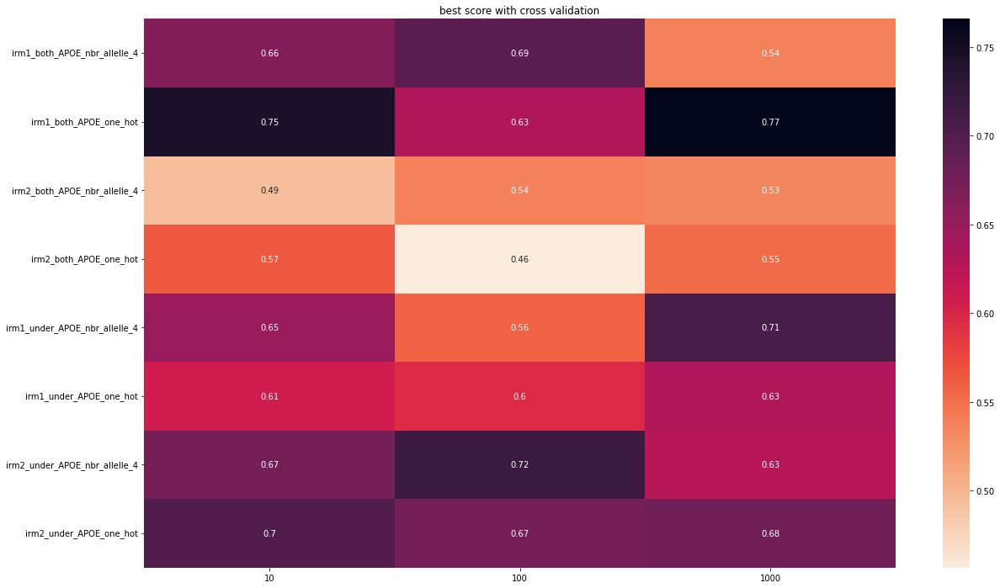

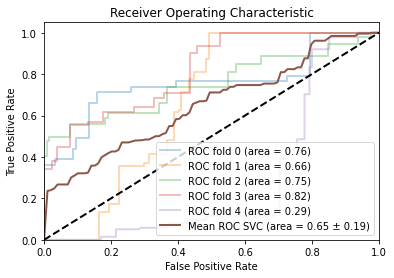

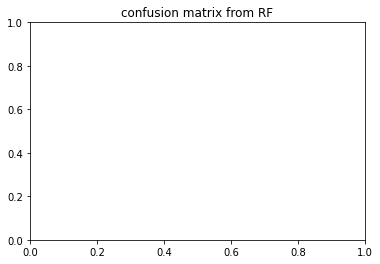

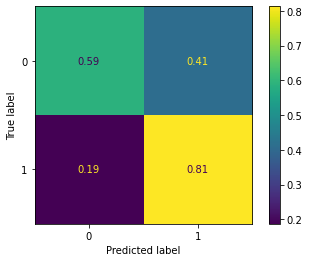

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.592 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.351 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.552 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.550 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.811 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.592 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.351 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.552 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.550 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.811 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=l

<Figure size 432x288 with 0 Axes>

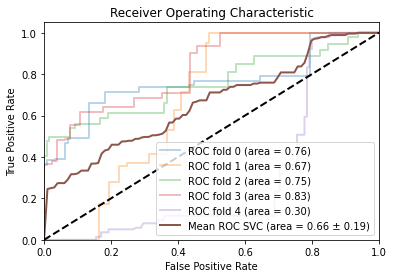

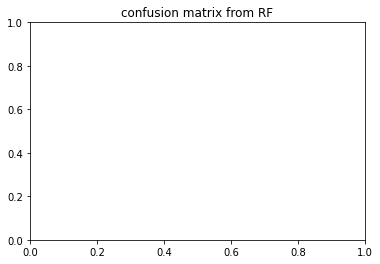

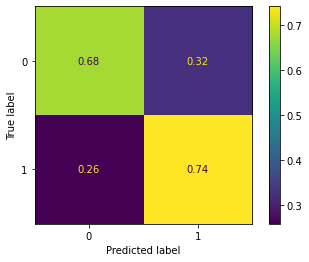

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.482 total time=   0.1s
[CV 2/5] END ................C=1, kernel=linear;, score=0.619 total time=   0.1s
[CV 3/5] END ................C=1, kernel=linear;, score=0.479 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.540 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.982 total time=   0.1s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.482 total time=   0.1s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.619 total time=   0.1s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.479 total time=   0.1s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.540 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.982 total time=   0.1s
[CV 1/5] END ..............C=100, ke

<Figure size 432x288 with 0 Axes>

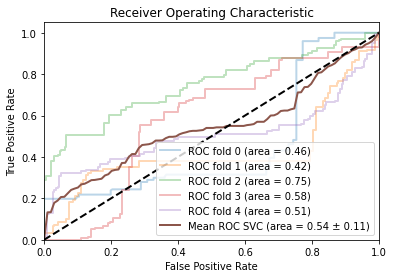

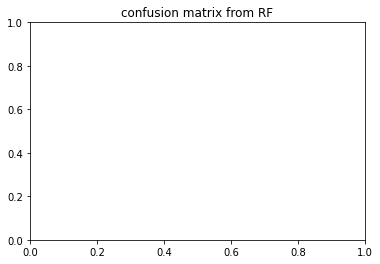

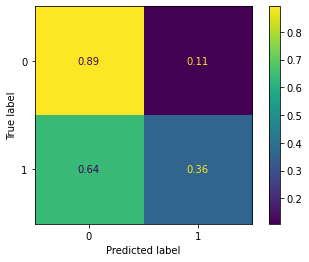

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.478 total time=   0.1s
[CV 2/5] END ................C=1, kernel=linear;, score=0.622 total time=   0.1s
[CV 3/5] END ................C=1, kernel=linear;, score=0.492 total time=   0.1s
[CV 4/5] END ................C=1, kernel=linear;, score=0.563 total time=   0.1s
[CV 5/5] END ................C=1, kernel=linear;, score=0.984 total time=   0.1s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.478 total time=   0.2s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.622 total time=   0.1s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.492 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.563 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.984 total time=   0.1s
[CV 1/5] END ..............C=100, kernel=l

<Figure size 432x288 with 0 Axes>

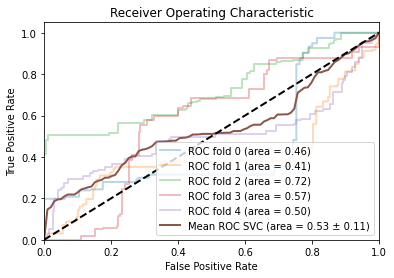

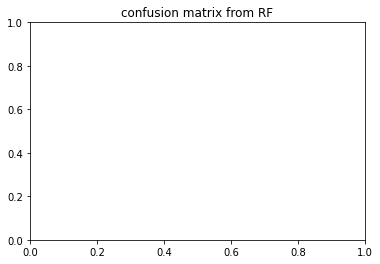

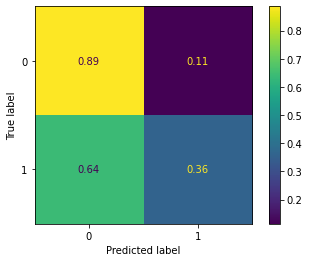

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.738 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.803 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.827 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.853 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.665 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.738 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.803 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.827 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.853 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.665 total time=   0.0s
[CV 1/5] END ..............C=100, k

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

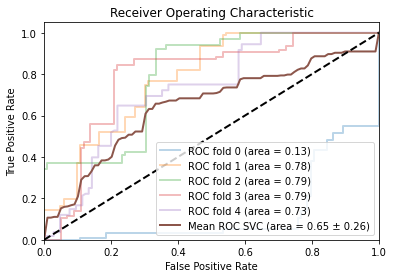

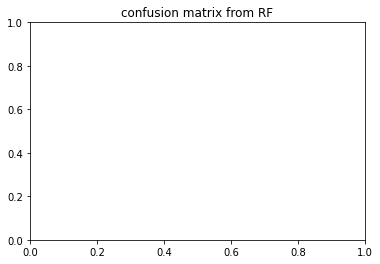

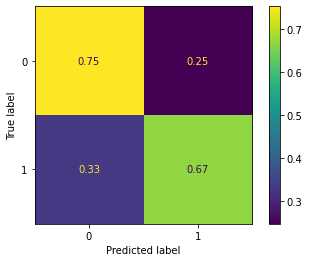

{'C': 10, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.740 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.797 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.805 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.863 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.657 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.740 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.797 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.805 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.863 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.657 total time=   0.0s
[CV 1/5] END ..............C=100, kernel

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

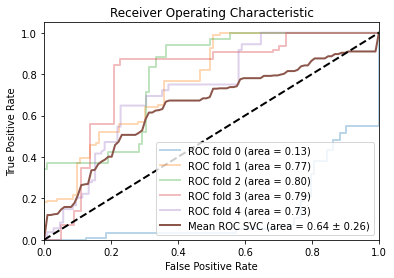

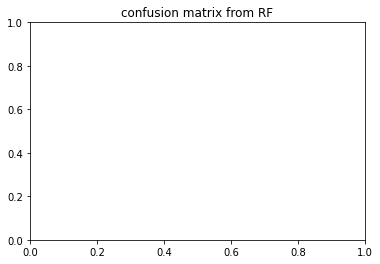

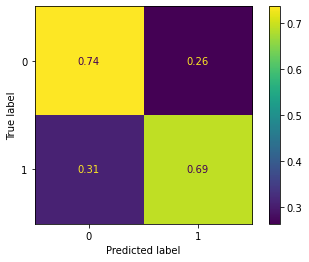

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.449 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.472 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.467 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.452 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.897 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.449 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.472 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.467 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.452 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.897 total time=   0.0s
[CV 1/5] END ..............C=100, k

<Figure size 432x288 with 0 Axes>

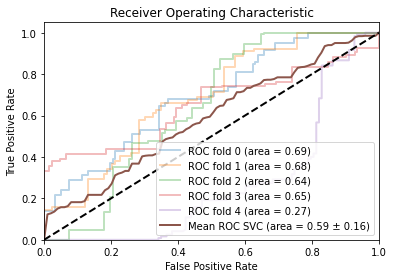

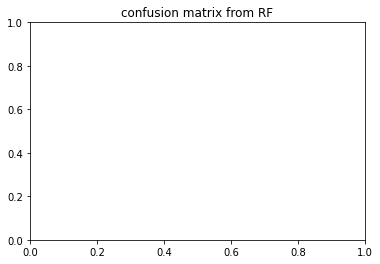

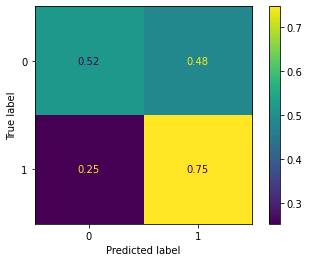

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.454 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.449 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.463 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.447 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.876 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.454 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.449 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.463 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.447 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.876 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=

<Figure size 432x288 with 0 Axes>

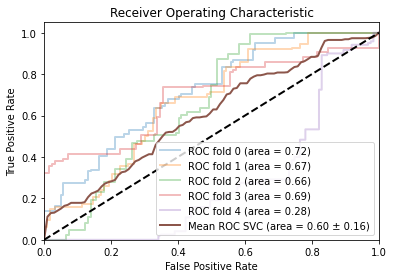

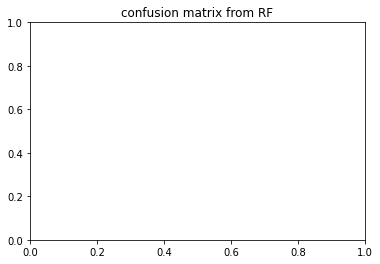

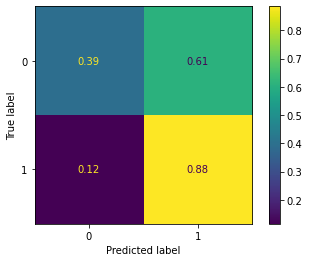

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.616 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.772 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.585 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.236 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.567 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.619 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.729 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.661 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.378 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.721 total time=   0.1s
[CV 1/5] END .....C=1, gamma=0.0001, ke

<Figure size 432x288 with 0 Axes>

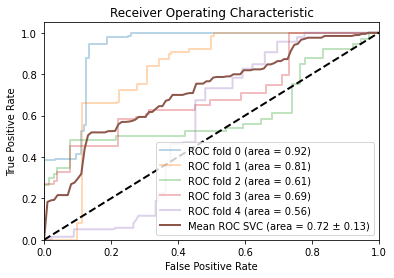

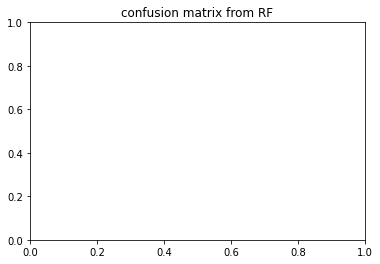

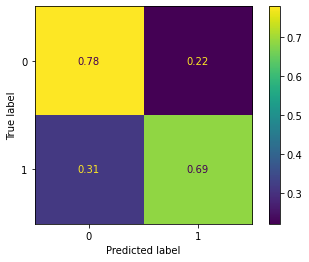

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.612 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.775 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.601 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.237 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.569 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.613 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.747 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.661 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.389 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.740 total time=   0.1s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

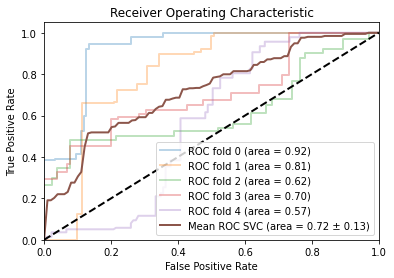

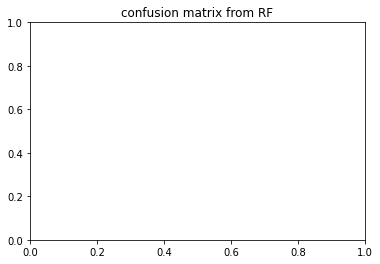

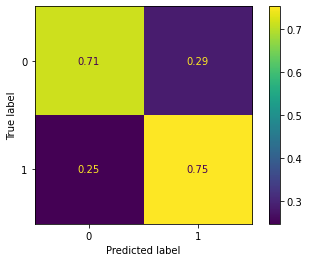

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.535 total time=   0.3s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.725 total time=   0.3s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.659 total time=   0.3s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.363 total time=   0.3s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.991 total time=   0.4s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.487 total time=   0.3s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.683 total time=   0.3s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.590 total time=   0.3s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.532 total time=   0.3s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.998 total time=   0.3s
[CV 1/5] END .....C=1, ga

<Figure size 432x288 with 0 Axes>

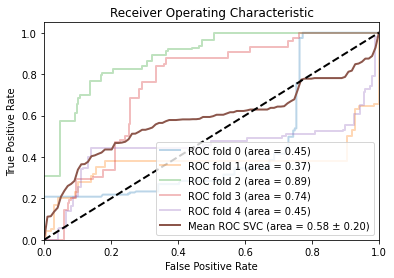

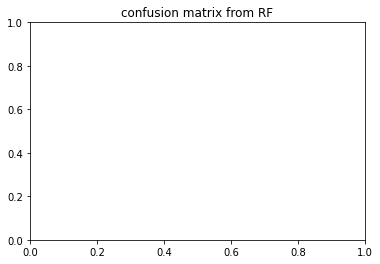

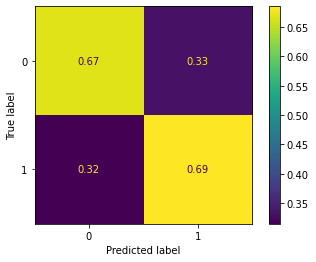

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.531 total time=   0.3s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.719 total time=   0.3s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.679 total time=   0.4s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.362 total time=   0.3s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.989 total time=   0.3s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.482 total time=   0.3s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.676 total time=   0.3s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.614 total time=   0.3s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.545 total time=   0.2s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.998 total time=   0.3s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

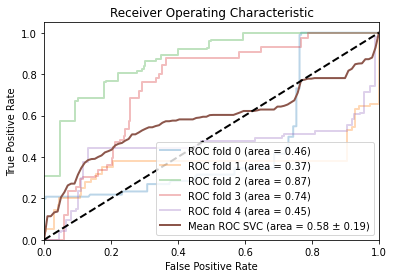

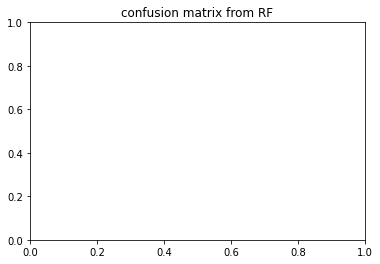

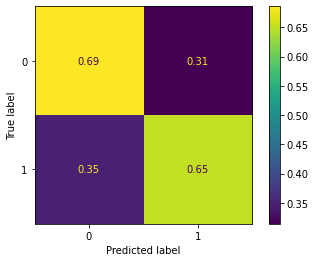

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.730 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.932 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.817 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.933 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.442 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.723 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.849 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.768 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.878 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.453 total time=   0.0s
[CV 1/5] END .....C=1, g

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

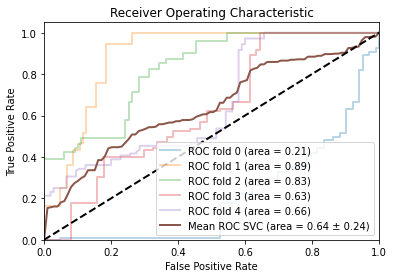

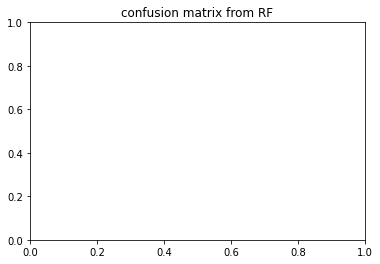

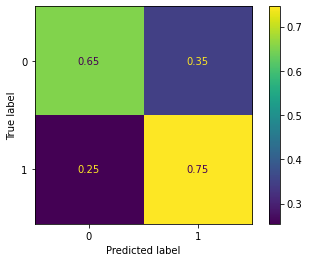

{'C': 10, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.730 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.938 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.814 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.934 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.441 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.723 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.850 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.769 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.882 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.453 total time=   0.0s
[CV 1/5] END .....C=1, gamma

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

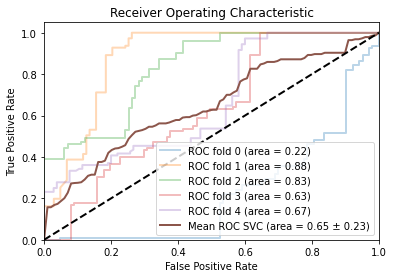

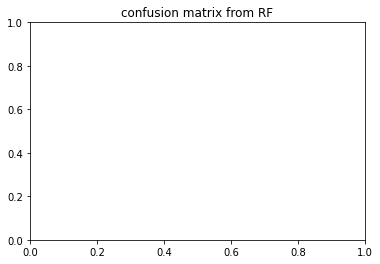

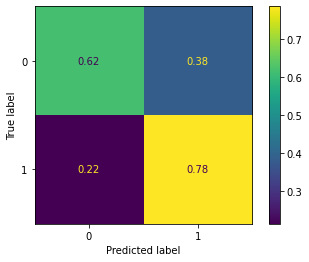

{'C': 10, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.645 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.353 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.526 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.779 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.866 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.640 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.286 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.508 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.773 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.904 total time=   0.1s
[CV 1/5] END .....C=1,

<Figure size 432x288 with 0 Axes>

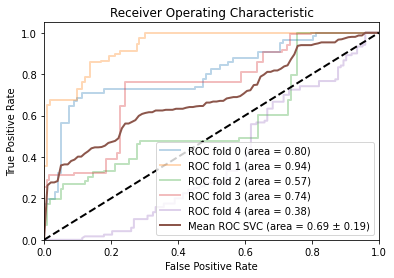

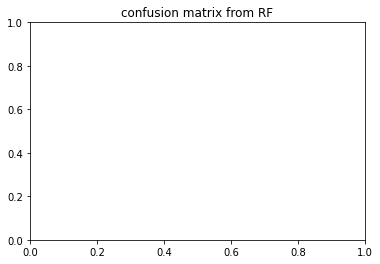

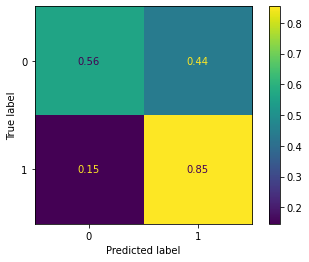

{'C': 1, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.652 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.350 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.520 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.774 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.863 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.645 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.276 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.503 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.772 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.898 total time=   0.1s
[CV 1/5] END .....C=1, gamma=

<Figure size 432x288 with 0 Axes>

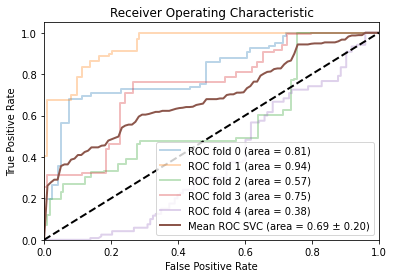

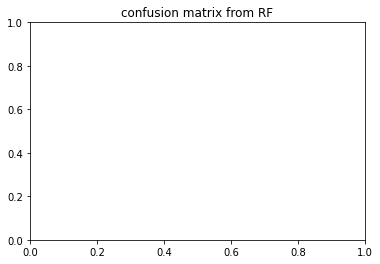

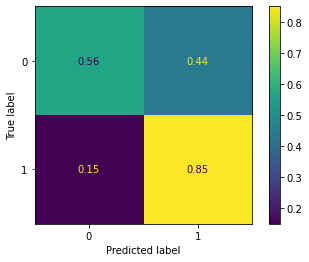

{'C': 1, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.336 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.849 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.552 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.266 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.685 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.199 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.728 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.550 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=0.001, ke

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.316 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.537 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.478 total time=   0.4s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.553 total time=   0.4s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.656 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.349 total time=   0.4s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.419 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=1.000 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.434 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.254 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.807 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.586 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.999 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.557 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.279 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.604 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.454 total time=   0.3s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.446 total time=   0.4s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.666 total time=   0.3s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.359 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.935 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.556 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.295 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.601 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.115 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.566 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.494 total time=   0.3s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.552 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.319 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.399 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.551 total time=   0.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.655 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.351 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.381 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=1.000 total time=   0.1s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.644 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.632 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.297 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.794 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.604 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.357 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.646 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.436 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.791 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.652 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.492 total time=   0.3s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.671 total time=   0.4s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.311 total time=   0.4s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.337 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.946 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.555 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.321 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.553 total time=   0.1s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.276 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.506 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.239 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.699 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.504 total time=   0.3s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.339 total time=   0.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.315 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.400 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.080 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.449 total time=   0.4s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.226 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.605 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.532 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.740 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.488 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.925 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.559 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.272 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.725 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.582 total time=   0.0s
[CV 2/

<Figure size 432x288 with 0 Axes>

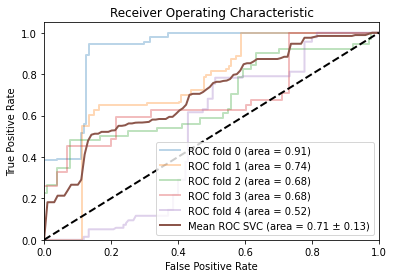

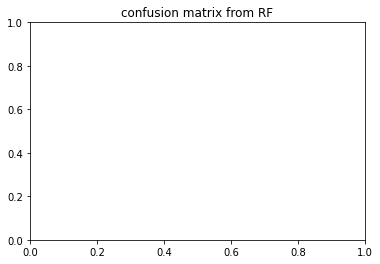

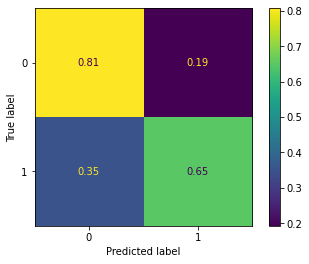

{'C': 1, 'coef0': 1.0, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.330 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.896 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.552 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.261 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.669 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.203 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.756 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.550 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, degr

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.322 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.539 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.479 total time=   0.3s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.449 total time=   0.3s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.653 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.349 total time=   0.4s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.426 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=1.000 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.552 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.257 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.788 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.575 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.999 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.557 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.284 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.581 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.052 total time=   0.3s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.447 total time=   0.4s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.664 total time=   0.3s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.332 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.951 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.559 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.285 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.537 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.133 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.587 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.499 total time=   0.3s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.552 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.319 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.404 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.560 total time=   0.5s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.048 total time=   0.5s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.654 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.349 total time=   0.4s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.379 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=1.000 total time=   0.1s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.658 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.638 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.300 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.795 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.585 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.366 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.646 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.436 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.794 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.630 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.874 total time=   0.4s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.490 total time=   0.4s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.604 total time=   0.4s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.667 total time=   0.4s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.322 total time=   0.3s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.341 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.954 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.731 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.305 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.483 total time=   0.1s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.277 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.683 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.258 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.739 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.510 total time=   0.3s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.339 total time=   0.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.390 total time=   0.3s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.595 total time=   0.4s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.081 total time=   0.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.452 total time=   0.4s
[CV 4/5

[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.533 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.752 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.475 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.934 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.564 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.279 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.721 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.567 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.610 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.647 total time=   0.0s
[CV 4/5]

<Figure size 432x288 with 0 Axes>

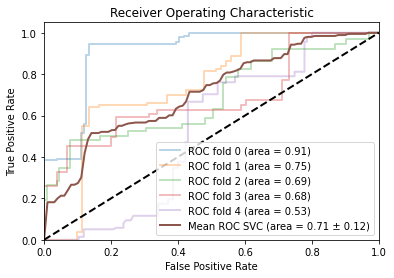

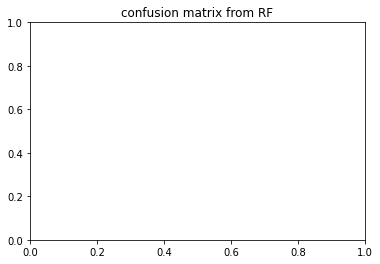

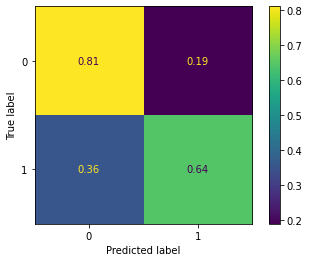

{'C': 1, 'coef0': 1.0, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.633 total time=   0.6s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.504 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.501 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.510 total time=   0.3s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.962 total time=   0.3s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.271 total time=   0.9s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.444 total time=   1.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.608 total time=   0.9s
[CV 4/5] END C=1, coef0=0.0

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.337 total time=   1.0s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.958 total time=   1.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.426 total time=   1.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.580 total time=   1.0s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.267 total time=   1.1s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.549 total time=   1.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.451 total time=   0.3s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.499 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.557 total time=   0.4s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.524 total time=   0.3s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.963 total time=   0.3s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.529 total time=   0.5s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.573 total time=   0.5s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.644 total time=   0.5s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.519 total time=   0.5s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.962 total time=   0.6s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.423 total time=   1.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.735 total time=   1.1s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.442 total time=   1.2s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.7s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.575 total time=   0.7s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.537 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.493 total time=   0.4s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.551 total time=   0.3s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.954 total time=   0.3s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.320 total time=   0.8s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.435 total time=   1.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.558 total time=   1.0s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.593 total time=   0.9s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.356 total time=   1.0s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.930 total time=   1.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.535 total time=   1.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.576 total time=   1.7s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.272 total time=   1.5s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.4s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.424 total time=   0.4s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.529 total time=   0.4s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.610 total time=   0.1s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.590 total time=   0.2s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.471 total time=   0.2s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.974 total time=   0.3s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.548 total time=   0.3s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.624 total time=   0.3s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.528 total time=   0.2s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.489 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.991 total time=   0.2s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.499 total time=   0.2s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.543 total time=   1.1s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.556 total time=   1.1s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.412 total time=   1.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.454 total time=   1.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.532 total time=   0.3s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.543 total time=   0.3s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.502 total time=   0.4s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.595 total time=   0.3s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.929 total time=   0.3s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.588 total time=   0.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.943 total time=   0.3s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.217 total time=   0.9s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.494 total time=   0.8s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.560 total time=   0.7s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.367 total time=   0.7s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.898 total time=   1.0s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.617 total time=   1.0s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.429 total time=   1.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.279 total time=   1.0s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.625 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.480 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.527 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.984 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.618 total time=   0.2s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.622 total time=   0.2s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.628 total time=   0.2s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.456 total time=   0.2s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.961 total time=   0.2s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.555 total time=   0.1s
[CV 2/

<Figure size 432x288 with 0 Axes>

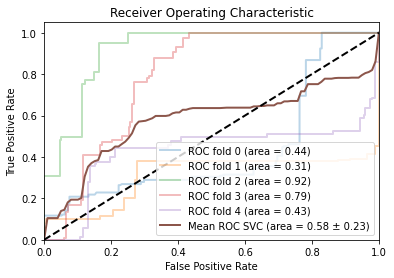

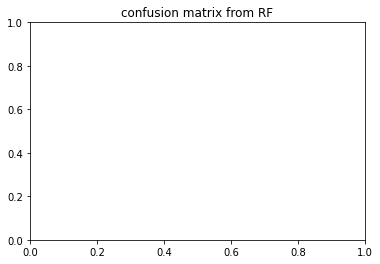

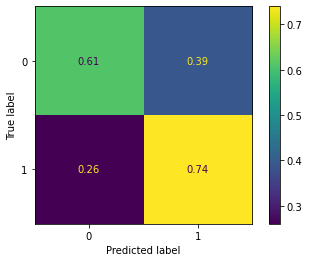

{'C': 1, 'coef0': 0.5, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.619 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.500 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.505 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.505 total time=   0.3s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.963 total time=   0.3s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.272 total time=   1.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.432 total time=   0.9s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.600 total time=   0.9s
[CV 4/5] END C=1, coef0=0.0, degr

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.336 total time=   1.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.957 total time=   1.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.5s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.423 total time=   1.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.548 total time=   1.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.000 total time=   1.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.465 total time=   0.5s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.494 total time=   0.4s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.552 total time=   0.4s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.518 total time=   0.3s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.963 total time=   0.3s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.540 total time=   0.5s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.576 total time=   0.5s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.653 total time=   0.5s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.510 total time=   0.5s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.962 total time=   0.5s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.540 total time=   1.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.425 total time=   1.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.735 total time=   1.1s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.1s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.601 total time=   0.4s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.531 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.488 total time=   0.3s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.533 total time=   0.3s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.954 total time=   0.3s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.307 total time=   1.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.411 total time=   0.9s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.564 total time=   0.9s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.605 total time=   0.9s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.354 total time=   0.8s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.930 total time=   1.0s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.509 total time=   1.1s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.572 total time=   1.1s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.270 total time=   1.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.574 total time=   1.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.1s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.469 total time=   0.3s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.522 total time=   0.3s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.604 total time=   0.1s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.614 total time=   0.1s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.468 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.974 total time=   0.1s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.539 total time=   0.1s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.620 total time=   0.1s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.552 total time=   0.1s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.502 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.991 total time=   0.1s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.491 total time=   0.1s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.541 total time=   1.0s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.0s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.409 total time=   1.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.451 total time=   1.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.568 total time=   0.3s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.535 total time=   0.3s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.492 total time=   0.3s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.578 total time=   0.3s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.929 total time=   0.4s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.583 total time=   0.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.944 total time=   0.3s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.206 total time=   0.9s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.481 total time=   0.8s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.570 total time=   0.7s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.364 total time=   0.7s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.900 total time=   0.9s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.431 total time=   1.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.723 total time=   1.0s
[CV 4/5

[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.495 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.551 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.987 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.623 total time=   0.2s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.623 total time=   0.2s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.638 total time=   0.2s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.453 total time=   0.2s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.961 total time=   0.2s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.554 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.603 total time=   0.1s
[CV 3/5

<Figure size 432x288 with 0 Axes>

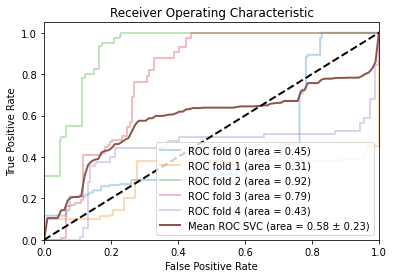

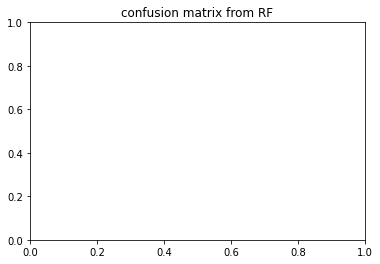

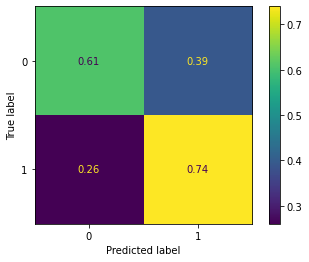

{'C': 1, 'coef0': 0.5, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.844 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.916 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.829 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.955 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.359 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.857 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.837 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.820 total time=   0.2s
[CV 4/5] END C=1, coef0=0.

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.467 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.247 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.754 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.177 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.837 total time=   0.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.173 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.695 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.836 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.962 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.750 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.880 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.200 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.801 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.973 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.801 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.969 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.257 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.748 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.084 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.158 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.312 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.734 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.846 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.897 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.801 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.916 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.281 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.764 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.832 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.722 total time=   0.1s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.741 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.582 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.241 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.210 total time=   0.2s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.179 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.725 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.806 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.914 total time=   0.0s
[CV 3/5] END C=

[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.800 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.950 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.378 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.720 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.882 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.820 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.919 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.500 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.722 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.830 total time=   0.0s
[CV 3/5] END C=10,

[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.577 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.810 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.335 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.719 total time=   0.2s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.831 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.909 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.754 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.869 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.294 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.701 total time=   0.1s
[CV 2/

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.797 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.850 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.696 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.618 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.247 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.781 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.203 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.238 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.730 total time=   0.2s
[CV 1

[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.887 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.640 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.763 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.951 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.809 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.972 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.292 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.727 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.918 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.788 total time=   0.0s
[CV 4/5]

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

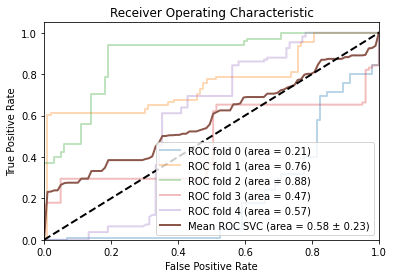

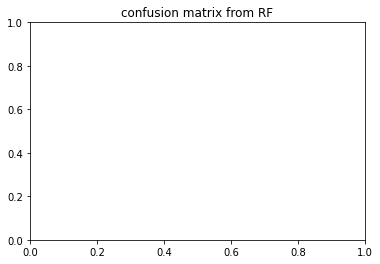

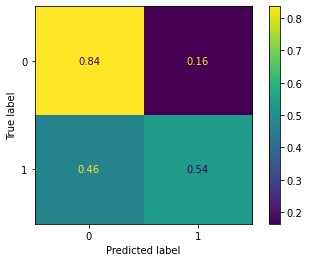

{'C': 100, 'coef0': 0.0, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm1_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.843 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.916 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.824 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.959 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.338 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.857 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.837 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.825 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, 

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.474 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.249 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.754 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.167 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.837 total time=   0.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.173 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.695 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.827 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.978 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.648 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.895 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.199 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.797 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.974 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.800 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.972 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.260 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.748 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.842 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.313 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.731 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.844 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.922 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.807 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.925 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.254 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.762 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.834 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.730 total time=   0.1s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.746 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.604 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.250 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.205 total time=   0.2s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.842 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.177 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.725 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.805 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.928 total time=   0.0s
[CV 3/5] END C=

[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.772 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.962 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.378 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.720 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.885 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.798 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.933 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.494 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.725 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.827 total time=   0.0s
[CV 3/5] END C=10,

[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.576 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.821 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.335 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.719 total time=   0.2s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.829 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.933 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.759 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.887 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.272 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.697 total time=   0.1s
[CV 2/

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.799 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.854 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.699 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.606 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.246 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.203 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.138 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.233 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.730 total time=   0.2s
[CV 1

[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.759 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.951 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.806 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.973 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.296 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.727 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.920 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.764 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.952 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.419 total time=   0.0s
[CV 1/5] E

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

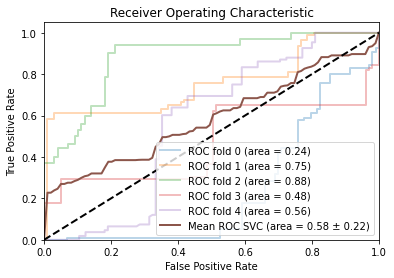

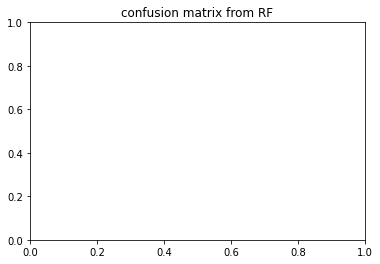

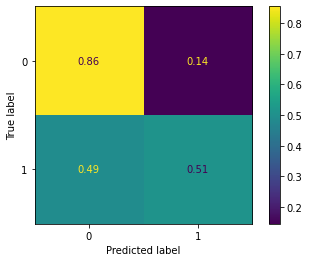

{'C': 100, 'coef0': 0.0, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.749 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.285 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.487 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.779 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.906 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.594 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.189 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.524 total time=   0.3s
[CV 4/5] END C=1, coef0

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.559 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.493 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.208 total time=   0.3s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.703 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.533 total time=   0.3s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.379 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.073 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.582 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.507 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.483 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.898 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.897 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.538 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.335 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.494 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.793 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.901 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.187 total time=   0.3s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.702 total time=   0.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.402 total time=   0.4s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.250 total time=   0.4s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.575 total time=   0.2s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.405 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.485 total time=   0.2s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.795 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.868 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.541 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.183 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.562 total time=   0.2s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.554 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.624 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.693 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.239 total time=   0.4s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.703 total time=   0.3s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.531 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.379 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.522 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.541 total time=   0.1s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.400 total time=   0.1s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.511 total time=   0.1s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.750 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.879 total time=   0.2s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.617 total time=   0.1s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.448 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.486 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.631 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.894 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.709 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.284 total time=   0.4s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.799 total time=   0.3s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.489 total time=   0.3s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.425 total time=   0.3s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.612 total time=   0.3s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.547 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.393 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.465 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.834 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.825 total time=   0.1s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.891 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.845 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.531 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.229 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.623 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.658 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.662 total time=   0.3s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.264 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.705 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.527 total time=   0.3s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.476 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.457 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.547 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.904 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.702 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.371 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.515 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.798 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.888 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.682 total time=   0.0s
[CV 2/

<Figure size 432x288 with 0 Axes>

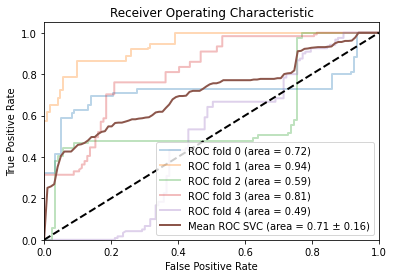

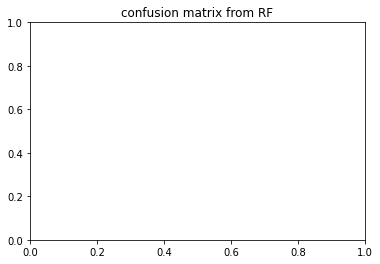

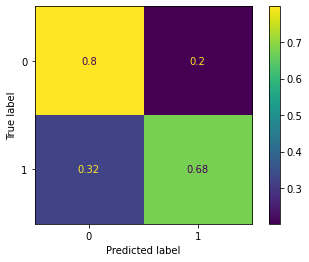

{'C': 10, 'coef0': 0.5, 'degree': 7, 'gamma': 0.001, 'kernel': 'poly', 'probability': True}
irm2_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.760 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.285 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.486 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.771 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.904 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.597 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.191 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.528 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, deg

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.559 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.504 total time=   0.4s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.205 total time=   0.3s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.701 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.532 total time=   0.3s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.382 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.586 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.522 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.488 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.899 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.895 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.545 total time=   0.3s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.334 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.479 total time=   0.3s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.786 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.896 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.185 total time=   0.4s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.701 total time=   0.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.533 total time=   0.3s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.578 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.429 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.485 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.800 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.866 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.557 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.189 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.562 total time=   0.3s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.556 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.602 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.696 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.241 total time=   0.3s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.700 total time=   0.4s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.528 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.381 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.074 total time=   0.4s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.525 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.557 total time=   0.2s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.384 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.510 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.745 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.876 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.614 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.416 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.476 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.633 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.891 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.712 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.287 total time=   0.3s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.794 total time=   0.4s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.487 total time=   0.3s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.435 total time=   0.3s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.593 total time=   0.3s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.547 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.412 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.469 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.835 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.827 total time=   0.2s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.899 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.844 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.542 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.233 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.625 total time=   0.3s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.633 total time=   0.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.668 total time=   0.3s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.260 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.703 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.524 total time=   0.4s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.464 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.450 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.541 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.896 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.717 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.364 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.515 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.793 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.888 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.684 total time=   0.1s
[CV 2/

<Figure size 432x288 with 0 Axes>

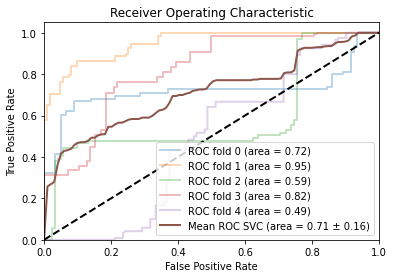

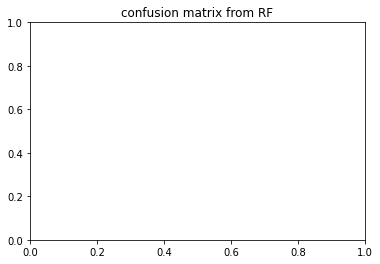

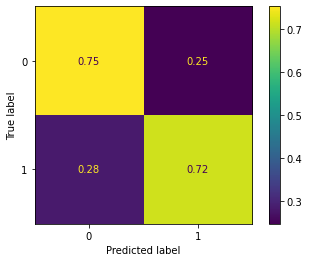

{'C': 10, 'coef0': 0.5, 'degree': 7, 'gamma': 0.001, 'kernel': 'poly', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.350 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.508 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.271 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.427 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.584 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.617 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.638 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.526 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.563 total time

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.839 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.343 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.480 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.752 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.853 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.862 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.682 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.338 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.237 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.506 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.641 total time=   0.0

{'C': 10, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

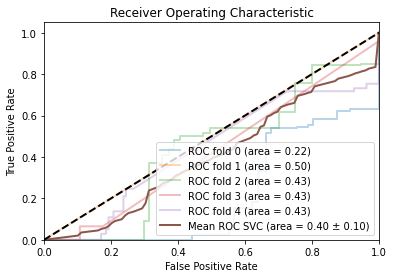

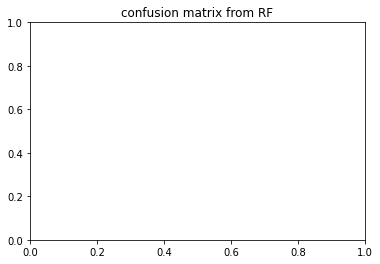

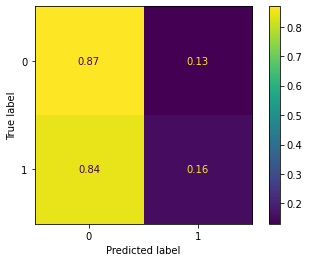

{'C': 10, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm1_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.309 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.525 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.269 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.411 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.640 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.606 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.692 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.526 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.554 total time=   0.1s
[CV 5

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.852 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.355 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.490 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.730 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.800 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.868 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.677 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.347 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.237 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.513 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.670 total time=   0.0

{'C': 10, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

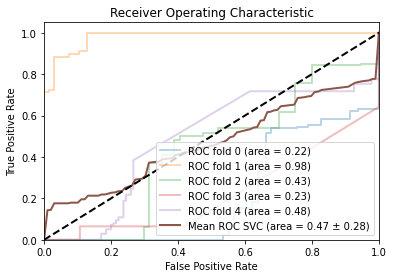

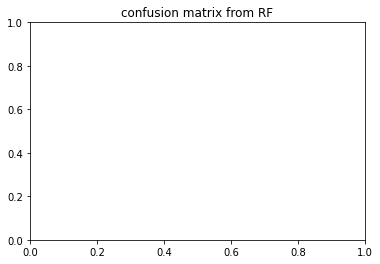

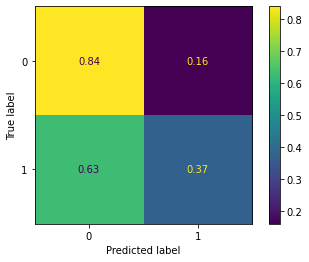

{'C': 10, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.361 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.932 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.609 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.859 total time=   0.3s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.972 total time=   0.4s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.476 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.585 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.497 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.652 total time=   0.3s

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.993 total time=   0.5s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.729 total time=   0.5s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.621 total time=   0.6s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.803 total time=   0.8s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.953 total time=   0.6s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.479 total time=   0.4s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.555 total time=   0.2s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.647 total time=   0.2s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.827 total time=   0.4s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.992 total time=   0.3s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.920 total time=   0.2

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.984 total time=   0.2s
{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

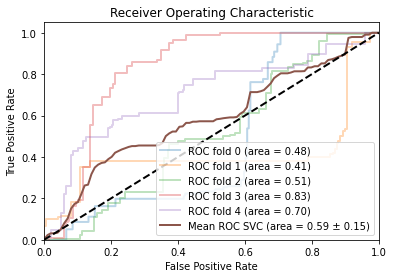

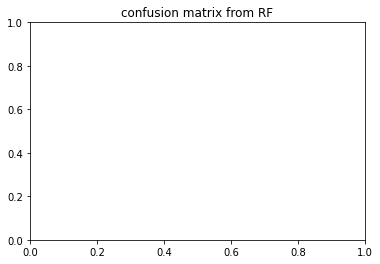

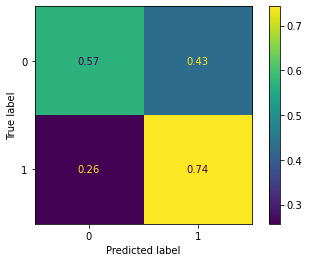

{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.351 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.909 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.610 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.851 total time=   0.4s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.965 total time=   0.4s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.462 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.565 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.502 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.665 total time=   0.3s
[CV 5/5]

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.993 total time=   0.4s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.722 total time=   0.3s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.617 total time=   0.5s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.795 total time=   0.5s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.955 total time=   0.7s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.477 total time=   0.6s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.557 total time=   0.3s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.609 total time=   0.3s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.827 total time=   0.2s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.992 total time=   0.2s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.906 total time=   0.2

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.986 total time=   0.2s
{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

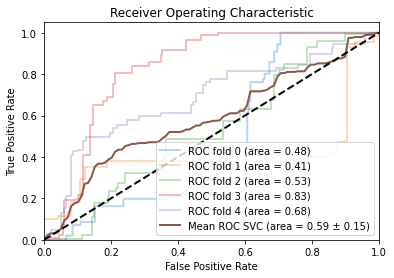

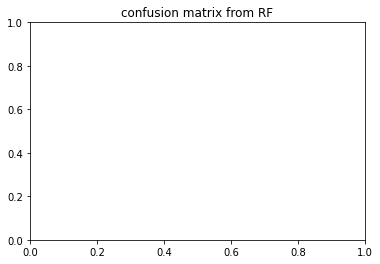

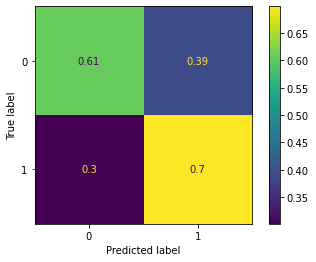

{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.487 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.820 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.608 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.788 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.592 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.751 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.832 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.765 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.872 total time=   0.3s
[

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.647 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.702 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.544 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.646 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.899 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.828 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.701 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.621 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.826 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.872 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.820 total time=   0.0

{'C': 100, 'coef0': 0.5, 'gamma': 0.001, 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

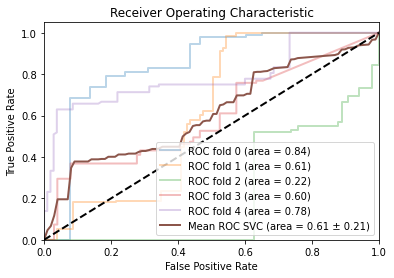

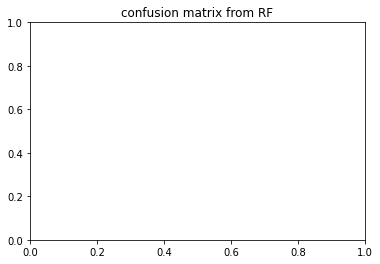

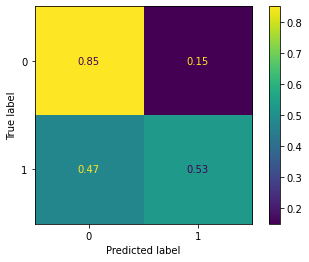

{'C': 100, 'coef0': 0.5, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.496 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.860 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.618 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.796 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.598 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.753 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.826 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.765 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.873 total time=   0.0s
[CV 5

[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.700 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.513 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.646 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.629 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.828 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.699 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.649 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.826 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.876 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.827 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.769 total time=   0.0

{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

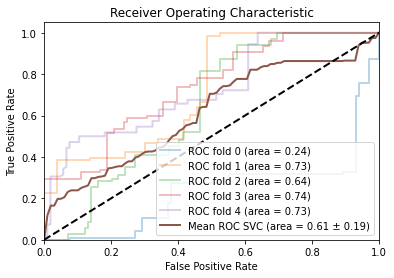

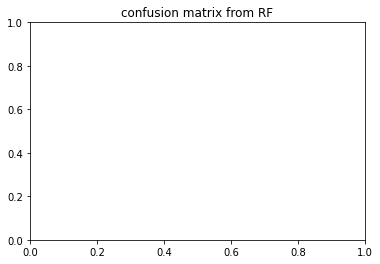

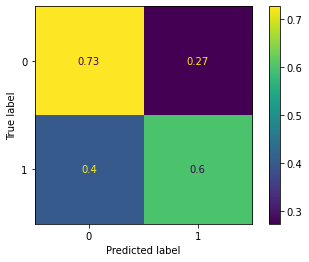

{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.760 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.377 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.554 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.715 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.871 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.741 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.242 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.490 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.768 total time=   0.1s
[

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.926 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.887 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.489 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.578 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.857 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.964 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.581 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.178 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.496 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.511 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.771 total time=   0.0

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.923 total time=   0.0s
{'C': 100, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

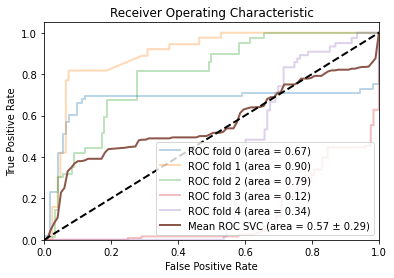

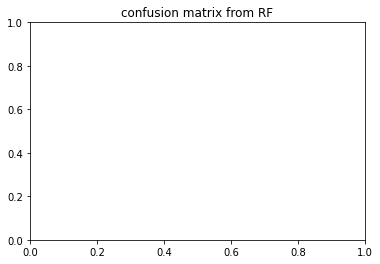

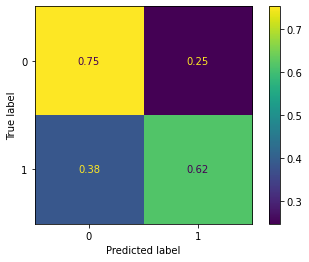

{'C': 100, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.778 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.376 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.557 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.725 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.842 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.740 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.230 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.483 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.771 total time=   0.1s
[CV

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.925 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.888 total time=   0.2s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.477 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.573 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.849 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.804 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.572 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.176 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.492 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.553 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.750 total time=   0.0

{'C': 100, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

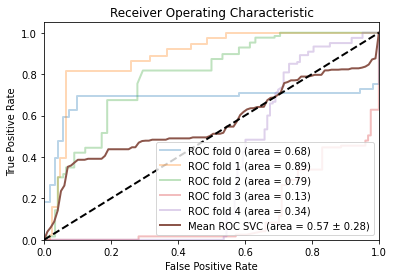

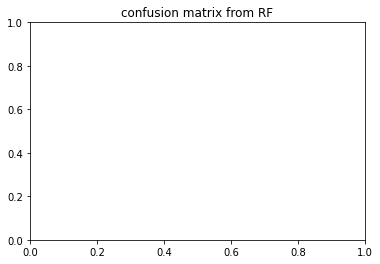

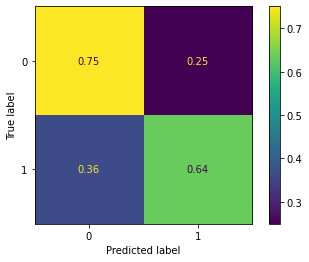

{'C': 100, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.564216,0.698707,0.692677,0.785899
irm1_both_APOE_one_hot,0.571425,0.700672,0.696501,0.767968
irm2_both_APOE_nbr_allelle_4,0.620516,0.664933,0.686420,0.841220
irm2_both_APOE_one_hot,0.627756,0.670446,0.685995,0.835885
irm1_under_APOE_nbr_allelle_4,0.777208,0.790307,0.785633,0.794292
irm1_under_APOE_one_hot,0.772271,0.787615,0.780966,0.785441
irm2_under_APOE_nbr_allelle_4,0.547222,0.633633,0.660509,0.759265
irm2_under_APOE_one_hot,0.537760,0.631559,0.664272,0.751014


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.758813,0.920351,0.913689,0.219503
irm1_both_APOE_one_hot,0.760388,0.916657,0.909631,0.215627
irm2_both_APOE_nbr_allelle_4,0.458838,0.454218,0.440554,0.477747
irm2_both_APOE_one_hot,0.459704,0.458645,0.448830,0.477482
irm1_under_APOE_nbr_allelle_4,0.132652,0.207358,0.209300,0.839857
irm1_under_APOE_one_hot,0.129586,0.226571,0.241185,0.235462
irm2_under_APOE_nbr_allelle_4,0.688491,0.803821,0.719347,0.669963
irm2_under_APOE_one_hot,0.716231,0.813372,0.719550,0.677821


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.654519,0.717600,0.707228,0.402558
irm1_both_APOE_one_hot,0.661263,0.722761,0.711787,0.467259
irm2_both_APOE_nbr_allelle_4,0.543527,0.581262,0.577224,0.585225
irm2_both_APOE_one_hot,0.532770,0.578335,0.579833,0.585033
irm1_under_APOE_nbr_allelle_4,0.644826,0.641832,0.578972,0.610617
irm1_under_APOE_one_hot,0.641946,0.645883,0.583045,0.612869
irm2_under_APOE_nbr_allelle_4,0.586395,0.687255,0.710499,0.564983
irm2_under_APOE_one_hot,0.602613,0.691445,0.712831,0.566177


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.654519,0.717600,0.707228,0.402558
irm1_both_APOE_one_hot,0.661263,0.722761,0.711787,0.467259
irm2_both_APOE_nbr_allelle_4,0.543527,0.581262,0.577224,0.585225
irm2_both_APOE_one_hot,0.532770,0.578335,0.579833,0.585033
irm1_under_APOE_nbr_allelle_4,0.644826,0.641832,0.578972,0.610617
irm1_under_APOE_one_hot,0.641946,0.645883,0.583045,0.612869
irm2_under_APOE_nbr_allelle_4,0.586395,0.687255,0.710499,0.564983
irm2_under_APOE_one_hot,0.602613,0.691445,0.712831,0.566177


the score on cross_val: 


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.654519,0.717600,0.707228,0.402558
irm1_both_APOE_one_hot,0.661263,0.722761,0.711787,0.467259
irm2_both_APOE_nbr_allelle_4,0.543527,0.581262,0.577224,0.585225
irm2_both_APOE_one_hot,0.532770,0.578335,0.579833,0.585033
irm1_under_APOE_nbr_allelle_4,0.644826,0.641832,0.578972,0.610617
irm1_under_APOE_one_hot,0.641946,0.645883,0.583045,0.612869
irm2_under_APOE_nbr_allelle_4,0.586395,0.687255,0.710499,0.564983
irm2_under_APOE_one_hot,0.602613,0.691445,0.712831,0.566177


here: 300
irm1_both
0    658
1    658
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_both_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST9SV,irmL_ST11SV,irmL_ST12SV,...,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW4,neuro_moca_YEAR,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,-0.034187,-0.664565,0.081552,...,1.0,1.750166,1.0,1.0,-1.794235,1.0,1.0,1.0,1.308682,0.0
1,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,-0.492240,-1.047400,1.214602,...,1.0,-0.358815,1.0,1.0,0.454540,1.0,1.0,1.0,0.129191,1.0
2,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,-0.793551,0.402731,-0.564393,...,0.0,1.117472,1.0,1.0,1.578927,1.0,1.0,1.0,-0.376305,0.0
3,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,1.670197,2.119685,1.648762,...,1.0,-0.358815,1.0,1.0,1.578927,1.0,1.0,1.0,0.634687,0.0
4,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,0.055598,-0.200524,-1.146802,...,1.0,-1.413306,1.0,1.0,0.454540,1.0,1.0,1.0,2.319674,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,0.201688,0.228715,-0.797357,...,1.0,-1.413306,1.0,1.0,-0.669848,1.0,1.0,1.0,1.140183,0.0
1312,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,2.426518,0.170710,-0.304956,...,1.0,1.750166,1.0,1.0,1.578927,1.0,1.0,1.0,0.971684,0.0
1313,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,-0.384194,-0.536954,0.118614,...,1.0,-0.147917,1.0,1.0,-0.669848,1.0,1.0,1.0,-1.555796,1.0
1314,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,-0.225930,-0.420943,0.187444,...,0.0,-2.046001,1.0,0.0,-0.669848,1.0,1.0,1.0,0.129191,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_both_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST9SV,irmL_ST11SV,irmL_ST12SV,...,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW4,neuro_moca_YEAR,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_33,APOE_34
0,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,-0.034187,-0.664565,0.081552,...,1.750166,1.0,1.0,-1.794235,1.0,1.0,1.0,1.308682,1.0,0.0
1,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,-0.492240,-1.047400,1.214602,...,-0.358815,1.0,1.0,0.454540,1.0,1.0,1.0,0.129191,0.0,1.0
2,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,-0.793551,0.402731,-0.564393,...,1.117472,1.0,1.0,1.578927,1.0,1.0,1.0,-0.376305,1.0,0.0
3,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,1.670197,2.119685,1.648762,...,-0.358815,1.0,1.0,1.578927,1.0,1.0,1.0,0.634687,1.0,0.0
4,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,0.055598,-0.200524,-1.146802,...,-1.413306,1.0,1.0,0.454540,1.0,1.0,1.0,2.319674,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,0.201688,0.228715,-0.797357,...,-1.413306,1.0,1.0,-0.669848,1.0,1.0,1.0,1.140183,1.0,0.0
1312,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,2.426518,0.170710,-0.304956,...,1.750166,1.0,1.0,1.578927,1.0,1.0,1.0,0.971684,1.0,0.0
1313,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,-0.384194,-0.536954,0.118614,...,-0.147917,1.0,1.0,-0.669848,1.0,1.0,1.0,-1.555796,0.0,1.0
1314,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,-0.225930,-0.420943,0.187444,...,-2.046001,1.0,0.0,-0.669848,1.0,1.0,1.0,0.129191,0.0,1.0


irm2_both
0    1000
1    1000
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_both_APOE_nbr_allelle_4


,irmC_ST102CV,irmC_ST102SA,irmC_ST103TA,irmC_ST104SA_ST104CV,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,irmC_ST106CV,...,neuro_moca_ABSMEAS,neuro_moca_DELW4,neuro_moca_DELW5,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,-1.740922,-1.278593,-1.367214,-0.698074,-1.544192,0.617436,1.799995,2.383053,-0.400343,-0.413629,...,1.0,1.514540,-0.569821,1.0,1.0,1.0,1.0,1.0,-0.214656,0.0
1,0.570305,-0.494554,-0.002669,2.413644,1.313484,-0.638077,0.654591,-0.270465,1.530761,1.759307,...,1.0,-0.646773,-0.569821,1.0,1.0,1.0,1.0,1.0,-0.687641,1.0
2,0.216984,1.052334,-0.906156,-0.647913,0.198744,-0.827079,-0.359226,-0.764643,1.560624,0.158725,...,1.0,1.514540,-0.569821,1.0,1.0,1.0,1.0,1.0,-0.214656,0.0
3,-0.413528,0.003417,1.366534,0.844812,-0.281641,1.629946,0.277774,-0.367152,0.475622,1.307449,...,1.0,0.433884,-0.569821,1.0,1.0,1.0,1.0,1.0,-1.318288,0.0
4,0.582017,0.368949,0.109103,0.346661,1.615264,0.846938,0.848981,0.900520,0.246676,0.249096,...,1.0,-0.646773,-0.569821,1.0,1.0,1.0,1.0,1.0,-1.160626,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.466234,-0.542232,0.057874,-0.518186,-1.371746,-0.638077,-0.586513,-0.710928,0.072479,-1.813386,...,1.0,-1.727429,2.050047,1.0,1.0,1.0,1.0,1.0,1.046637,0.0
1996,1.360886,0.623232,-0.924784,-1.365735,-0.503357,1.400444,-0.619409,-0.743157,-0.937867,-0.439736,...,1.0,-0.646773,0.740113,1.0,1.0,1.0,1.0,1.0,-0.372318,1.0
1997,0.263833,0.241807,0.276761,-0.665210,0.365031,0.023429,-0.404085,-0.496068,0.077456,-0.007961,...,1.0,-0.646773,-0.569821,1.0,1.0,1.0,1.0,1.0,0.573652,1.0
1998,-1.838525,-1.426925,-0.817670,-1.919237,-1.396381,0.387933,-1.277344,-1.602596,-0.246054,0.694930,...,1.0,0.433884,0.740113,1.0,1.0,1.0,1.0,1.0,1.046637,0.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_both_APOE_one_hot


,irmC_ST102CV,irmC_ST102SA,irmC_ST103TA,irmC_ST104SA_ST104CV,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,irmC_ST106CV,...,neuro_moca_DELW5,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_DAY,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_33,APOE_34,APOE_44
0,-1.740922,-1.278593,-1.367214,-0.698074,-1.544192,0.617436,1.799995,2.383053,-0.400343,-0.413629,...,-0.569821,1.0,1.0,1.0,1.0,1.0,-0.214656,1.0,0.0,0.0
1,0.570305,-0.494554,-0.002669,2.413644,1.313484,-0.638077,0.654591,-0.270465,1.530761,1.759307,...,-0.569821,1.0,1.0,1.0,1.0,1.0,-0.687641,0.0,1.0,0.0
2,0.216984,1.052334,-0.906156,-0.647913,0.198744,-0.827079,-0.359226,-0.764643,1.560624,0.158725,...,-0.569821,1.0,1.0,1.0,1.0,1.0,-0.214656,1.0,0.0,0.0
3,-0.413528,0.003417,1.366534,0.844812,-0.281641,1.629946,0.277774,-0.367152,0.475622,1.307449,...,-0.569821,1.0,1.0,1.0,1.0,1.0,-1.318288,0.0,0.0,0.0
4,0.582017,0.368949,0.109103,0.346661,1.615264,0.846938,0.848981,0.900520,0.246676,0.249096,...,-0.569821,1.0,1.0,1.0,1.0,1.0,-1.160626,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.466234,-0.542232,0.057874,-0.518186,-1.371746,-0.638077,-0.586513,-0.710928,0.072479,-1.813386,...,2.050047,1.0,1.0,1.0,1.0,1.0,1.046637,1.0,0.0,0.0
1996,1.360886,0.623232,-0.924784,-1.365735,-0.503357,1.400444,-0.619409,-0.743157,-0.937867,-0.439736,...,0.740113,1.0,1.0,1.0,1.0,1.0,-0.372318,0.0,1.0,0.0
1997,0.263833,0.241807,0.276761,-0.665210,0.365031,0.023429,-0.404085,-0.496068,0.077456,-0.007961,...,-0.569821,1.0,1.0,1.0,1.0,1.0,0.573652,0.0,1.0,0.0
1998,-1.838525,-1.426925,-0.817670,-1.919237,-1.396381,0.387933,-1.277344,-1.602596,-0.246054,0.694930,...,0.740113,1.0,1.0,1.0,1.0,1.0,1.046637,1.0,0.0,0.0


irm1_under
0    511
1    511
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_under_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST11SV,irmL_ST12SV,irmL_ST13SA,...,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW3,neuro_moca_DELW4,neuro_moca_YEAR,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,-0.637348,0.061876,-0.508855,...,1.769759,1.0,1.0,-1.502114,-1.815255,1.0,1.0,1.0,1.290915,0.0
1,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,-1.025712,1.201759,1.096191,...,-0.344436,1.0,1.0,0.335301,0.449935,1.0,1.0,1.0,0.110546,1.0
2,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,0.445365,-0.587965,0.333978,...,1.135501,1.0,1.0,-0.583406,1.582530,1.0,1.0,1.0,-0.395326,0.0
3,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,2.187121,1.638537,0.370622,...,-0.344436,1.0,1.0,1.254009,1.582530,1.0,1.0,1.0,0.616419,0.0
4,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,-0.166603,-1.173886,0.890980,...,-1.401533,1.0,1.0,0.335301,0.449935,1.0,1.0,1.0,2.302660,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,-0.637348,-1.514786,0.180069,...,0.289823,1.0,1.0,0.335301,0.449935,1.0,1.0,1.0,-1.238447,1.0
1018,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.108093,-1.924931,-0.017813,...,0.289823,1.0,1.0,0.335301,0.449935,1.0,1.0,1.0,-1.069823,1.0
1019,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.108093,-1.924931,-0.017813,...,-0.344436,1.0,1.0,0.335301,0.449935,1.0,1.0,1.0,-1.069823,1.0
1020,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,-1.414077,-1.669256,-0.047129,...,0.924081,1.0,1.0,0.335301,1.582530,1.0,1.0,1.0,-0.901199,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_under_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST11SV,irmL_ST12SV,irmL_ST13SA,...,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW4,neuro_moca_YEAR,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_33,APOE_34
0,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,-0.637348,0.061876,-0.508855,...,1.769759,1.0,1.0,-1.815255,1.0,1.0,1.0,1.290915,1.0,0.0
1,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,-1.025712,1.201759,1.096191,...,-0.344436,1.0,1.0,0.449935,1.0,1.0,1.0,0.110546,0.0,1.0
2,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,0.445365,-0.587965,0.333978,...,1.135501,1.0,1.0,1.582530,1.0,1.0,1.0,-0.395326,1.0,0.0
3,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,2.187121,1.638537,0.370622,...,-0.344436,1.0,1.0,1.582530,1.0,1.0,1.0,0.616419,1.0,0.0
4,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,-0.166603,-1.173886,0.890980,...,-1.401533,1.0,1.0,0.449935,1.0,1.0,1.0,2.302660,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,-0.637348,-1.514786,0.180069,...,0.289823,1.0,1.0,0.449935,1.0,1.0,1.0,-1.238447,0.0,1.0
1018,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.108093,-1.924931,-0.017813,...,0.289823,1.0,1.0,0.449935,1.0,1.0,1.0,-1.069823,0.0,1.0
1019,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.108093,-1.924931,-0.017813,...,-0.344436,1.0,1.0,0.449935,1.0,1.0,1.0,-1.069823,0.0,1.0
1020,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,-1.414077,-1.669256,-0.047129,...,0.924081,1.0,1.0,1.582530,1.0,1.0,1.0,-0.901199,0.0,1.0


irm2_under
0    614
1    614
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_under_APOE_nbr_allelle_4


,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST103TA,irmC_ST104SA_ST104CV,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,...,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW4,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_nbr_allelle_4
0,1.822440,-1.724954,-1.277778,-1.325707,-0.695724,-1.550149,0.603003,1.788523,2.434463,-0.403364,...,1.413937,1.0,1.0,1.533935,1.0,1.0,1.0,1.0,-0.194405,0.0
1,0.580007,0.560375,-0.502523,0.014682,2.388945,1.283291,-0.646006,0.648655,-0.260922,1.470128,...,1.214246,1.0,1.0,-0.657655,1.0,1.0,1.0,1.0,-0.661586,1.0
2,0.000576,0.211013,1.027035,-0.872811,-0.645999,0.178005,-0.834029,-0.360263,-0.762897,1.499099,...,1.014555,1.0,1.0,1.533935,1.0,1.0,1.0,1.0,-0.194405,0.0
3,0.507578,-0.412434,-0.010131,1.359644,0.833751,-0.298306,1.610269,0.273659,-0.359135,0.446467,...,2.212702,1.0,1.0,0.438140,1.0,1.0,1.0,1.0,-1.284495,0.0
4,0.323720,0.571956,0.351306,0.124474,0.339929,1.582511,0.831317,0.842105,0.928539,0.224352,...,1.413937,1.0,1.0,-0.657655,1.0,1.0,1.0,1.0,-1.128768,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,-0.857427,0.193642,0.466546,-0.946006,-0.112740,-0.725764,-1.827865,-1.776914,-1.515858,-0.905537,...,0.215790,1.0,1.0,0.438140,1.0,1.0,1.0,1.0,-1.128768,1.0
1224,-1.370001,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,...,0.215790,1.0,1.0,0.438140,1.0,1.0,1.0,1.0,-0.973041,1.0
1225,-1.370001,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,...,-0.383284,1.0,1.0,0.438140,1.0,1.0,1.0,1.0,-0.973041,1.0
1226,-1.297572,-0.754075,-0.586334,-0.891110,-0.191614,-0.829576,-1.236936,-1.964412,-1.646808,-1.156623,...,0.814864,1.0,1.0,1.533935,1.0,1.0,1.0,1.0,-0.817314,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_under_APOE_one_hot


,irmC_ST101SV,irmC_ST102CV,irmC_ST102SA,irmC_ST103TA,irmC_ST104SA_ST104CV,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,...,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW4,neuro_moca_MONTH,neuro_moca_YEAR,neuro_moca_PLACE,neuro_moca_CITY,age,APOE_33,APOE_34
0,1.822440,-1.724954,-1.277778,-1.325707,-0.695724,-1.550149,0.603003,1.788523,2.434463,-0.403364,...,1.0,1.0,1.533935,1.0,1.0,1.0,1.0,-0.194405,1.0,0.0
1,0.580007,0.560375,-0.502523,0.014682,2.388945,1.283291,-0.646006,0.648655,-0.260922,1.470128,...,1.0,1.0,-0.657655,1.0,1.0,1.0,1.0,-0.661586,0.0,1.0
2,0.000576,0.211013,1.027035,-0.872811,-0.645999,0.178005,-0.834029,-0.360263,-0.762897,1.499099,...,1.0,1.0,1.533935,1.0,1.0,1.0,1.0,-0.194405,1.0,0.0
3,0.507578,-0.412434,-0.010131,1.359644,0.833751,-0.298306,1.610269,0.273659,-0.359135,0.446467,...,1.0,1.0,0.438140,1.0,1.0,1.0,1.0,-1.284495,0.0,0.0
4,0.323720,0.571956,0.351306,0.124474,0.339929,1.582511,0.831317,0.842105,0.928539,0.224352,...,1.0,1.0,-0.657655,1.0,1.0,1.0,1.0,-1.128768,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,-0.857427,0.193642,0.466546,-0.946006,-0.112740,-0.725764,-1.827865,-1.776914,-1.515858,-0.905537,...,1.0,1.0,0.438140,1.0,1.0,1.0,1.0,-1.128768,0.0,1.0
1224,-1.370001,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,...,1.0,1.0,0.438140,1.0,1.0,1.0,1.0,-0.973041,0.0,1.0
1225,-1.370001,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,...,1.0,1.0,0.438140,1.0,1.0,1.0,1.0,-0.973041,0.0,1.0
1226,-1.297572,-0.754075,-0.586334,-0.891110,-0.191614,-0.829576,-1.236936,-1.964412,-1.646808,-1.156623,...,1.0,1.0,1.533935,1.0,1.0,1.0,1.0,-0.817314,0.0,1.0


dict_keys(['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot'])
['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot']
dict_keys(['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot'])
depth_10_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.481 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10,

[CV 3/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.589 total time=   1.1s
[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.541 total time=   0.9s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.203 total time=   1.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.729 total time=   2.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.537 total time=   2.2s
[CV 3/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.586 total time=   2.1s
[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.485 total time=   1.9s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.476 total time=   2.1s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.285 total time=   0.0s
[

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.743 total time=   1.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.827 total time=   1.2s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.585 total time=   1.2s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.449 total time=   1.1s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.207 total time=   1.1s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.762 total time=   2.3s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.757 total time=   2.4s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.575 total time=   2.4s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.48

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

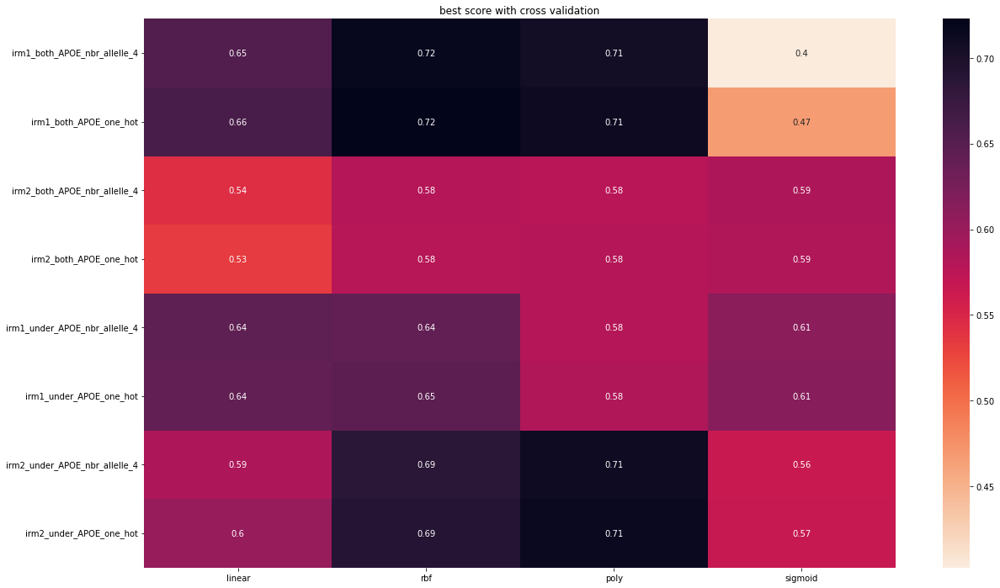

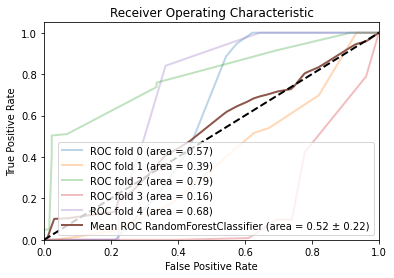

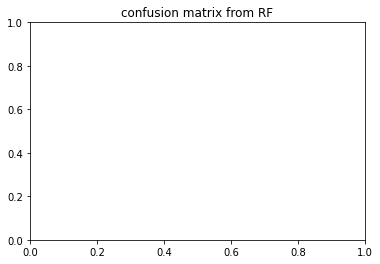

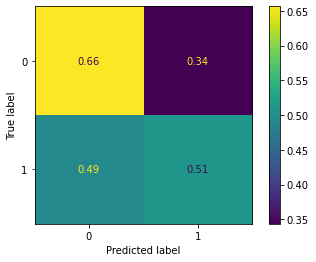

,precision,recall,f1-score,support,auc
0,0.593,0.657,0.576,131.600,0.000
1,0.529,0.507,0.483,131.600,0.000
accuracy,0.582,0.582,0.582,0.582,0.000
macro avg,0.561,0.582,0.529,263.200,0.519
weighted avg,0.563,0.582,0.530,263.200,0.519


coming from


,precision,recall,f1-score,support,auc
0,0.885246,0.425197,0.574468,127.000000,0.000000
1,0.627551,0.946154,0.754601,130.000000,0.000000
accuracy,0.688716,0.688716,0.688716,0.688716,0.000000
macro avg,0.756398,0.685675,0.664535,257.000000,0.570109
weighted avg,0.754894,0.688716,0.665586,257.000000,0.570109


,precision,recall,f1-score,support,auc
0,0.387097,0.179104,0.244898,134.000000,0.000000
1,0.444444,0.698413,0.543210,126.000000,0.000000
accuracy,0.430769,0.430769,0.430769,0.430769,0.000000
macro avg,0.415771,0.438759,0.394054,260.000000,0.385928
weighted avg,0.414888,0.430769,0.389465,260.000000,0.385928


,precision,recall,f1-score,support,auc
0,0.606635,0.977099,0.748538,131.000000,0.000000
1,0.950820,0.411348,0.574257,141.000000,0.000000
accuracy,0.683824,0.683824,0.683824,0.683824,0.000000
macro avg,0.778727,0.694223,0.661398,272.000000,0.788615
weighted avg,0.785054,0.683824,0.658194,272.000000,0.788615


,precision,recall,f1-score,support,auc
0,0.515748,1.000000,0.680519,131.000000,0.000000
1,0.000000,0.000000,0.000000,123.000000,0.000000
accuracy,0.515748,0.515748,0.515748,0.515748,0.000000
macro avg,0.257874,0.500000,0.340260,254.000000,0.164805
weighted avg,0.265996,0.515748,0.350977,254.000000,0.164805


,precision,recall,f1-score,support,auc
0,0.568862,0.703704,0.629139,135.000000,0.000000
1,0.622642,0.478261,0.540984,138.000000,0.000000
accuracy,0.589744,0.589744,0.589744,0.589744,0.000000
macro avg,0.595752,0.590982,0.585061,273.000000,0.683253
weighted avg,0.596047,0.589744,0.584577,273.000000,0.683253


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 0.5, 'n_estimators': 10}
depth_10_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.869 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.557 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.289 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.698 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.714 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.527 total time=   0.1s
[CV 3/5] END criterion=gini, max

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.514 total time=   2.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.344 total time=   2.2s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.661 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.638 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.388 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.376 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.554 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.873

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.831 total time=   2.3s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.679 total time=   2.5s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.573 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.493 total time=   2.3s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.302 total time=   2.5s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

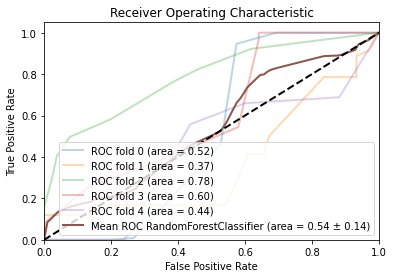

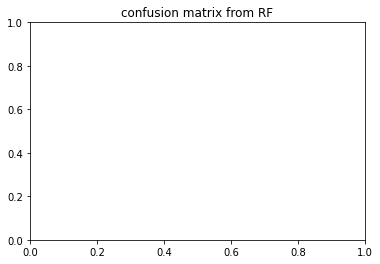

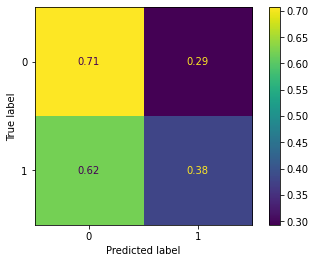

,precision,recall,f1-score,support,auc
0,0.588,0.704,0.590,131.600,0.000
1,0.451,0.387,0.381,131.600,0.000
accuracy,0.544,0.544,0.544,0.544,0.000
macro avg,0.519,0.545,0.486,263.200,0.544
weighted avg,0.523,0.544,0.486,263.200,0.544


coming from


,precision,recall,f1-score,support,auc
0,0.461538,0.472441,0.466926,127.000000,0.000000
1,0.472441,0.461538,0.466926,130.000000,0.000000
accuracy,0.466926,0.466926,0.466926,0.466926,0.000000
macro avg,0.466990,0.466990,0.466926,257.000000,0.516505
weighted avg,0.467053,0.466926,0.466926,257.000000,0.516505


,precision,recall,f1-score,support,auc
0,0.515385,1.000000,0.680203,134.000000,0.000000
1,0.000000,0.000000,0.000000,126.000000,0.000000
accuracy,0.515385,0.515385,0.515385,0.515385,0.000000
macro avg,0.257692,0.500000,0.340102,260.000000,0.373134
weighted avg,0.265621,0.515385,0.350566,260.000000,0.373134


,precision,recall,f1-score,support,auc
0,0.600000,0.961832,0.739003,131.000000,0.000000
1,0.919355,0.404255,0.561576,141.000000,0.000000
accuracy,0.672794,0.672794,0.672794,0.672794,0.000000
macro avg,0.759677,0.683044,0.650290,272.000000,0.783228
weighted avg,0.765548,0.672794,0.647028,272.000000,0.783228


,precision,recall,f1-score,support,auc
0,0.921569,0.358779,0.516484,131.000000,0.000000
1,0.586207,0.967480,0.730061,123.000000,0.000000
accuracy,0.653543,0.653543,0.653543,0.653543,0.000000
macro avg,0.753888,0.663129,0.623272,254.000000,0.603457
weighted avg,0.759169,0.653543,0.619909,254.000000,0.603457


,precision,recall,f1-score,support,auc
0,0.441441,0.725926,0.549020,135.000000,0.000000
1,0.274510,0.101449,0.148148,138.000000,0.000000
accuracy,0.410256,0.410256,0.410256,0.410256,0.000000
macro avg,0.357976,0.413688,0.348584,273.000000,0.443747
weighted avg,0.357058,0.410256,0.346381,273.000000,0.443747


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 0.5, 'n_estimators': 10}
depth_10_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.543 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.638 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.571 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.514 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.752 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.493 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.635 total time=   0.1s
[CV 3/5] END criterion=gin

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.482 total time=   3.5s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.803 total time=   3.8s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.587 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.547 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.289 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.777 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.557 total time=   0.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.497

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.530 total time=   3.7s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.806 total time=   4.2s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.615 total time=   3.8s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.452 total time=   3.9s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.791 total time=   4.1s


<Figure size 432x288 with 0 Axes>

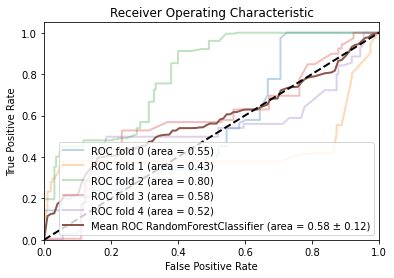

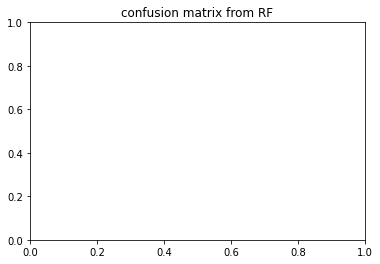

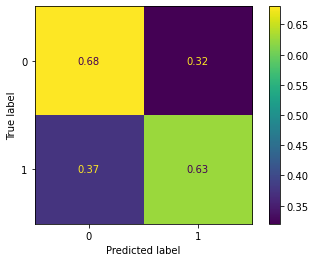

,precision,recall,f1-score,support,auc
0,0.702,0.685,0.645,200.000,0.000
1,0.703,0.625,0.621,200.000,0.000
accuracy,0.653,0.653,0.653,0.653,0.000
macro avg,0.703,0.655,0.633,400.000,0.576
weighted avg,0.704,0.653,0.632,400.000,0.576


coming from


,precision,recall,f1-score,support,auc
0,0.925373,0.293839,0.446043,211.000000,0.000000
1,0.563050,0.974619,0.713755,197.000000,0.000000
accuracy,0.622549,0.622549,0.622549,0.622549,0.000000
macro avg,0.744211,0.634229,0.579899,408.000000,0.548729
weighted avg,0.750428,0.622549,0.575306,408.000000,0.548729


,precision,recall,f1-score,support,auc
0,0.601286,0.944444,0.734774,198.000000,0.000000
1,0.862500,0.357513,0.505495,193.000000,0.000000
accuracy,0.654731,0.654731,0.654731,0.654731,0.000000
macro avg,0.731893,0.650979,0.620134,391.000000,0.430745
weighted avg,0.730223,0.654731,0.621600,391.000000,0.430745


,precision,recall,f1-score,support,auc
0,0.795918,0.600000,0.684211,195.000000,0.000000
1,0.690476,0.852941,0.763158,204.000000,0.000000
accuracy,0.729323,0.729323,0.729323,0.729323,0.000000
macro avg,0.743197,0.726471,0.723684,399.000000,0.798353
weighted avg,0.742008,0.729323,0.724575,399.000000,0.798353


,precision,recall,f1-score,support,auc
0,0.593750,0.767677,0.669604,198.000000,0.000000
1,0.669065,0.472081,0.553571,197.000000,0.000000
accuracy,0.620253,0.620253,0.620253,0.620253,0.000000
macro avg,0.631407,0.619879,0.611587,395.000000,0.579013
weighted avg,0.631312,0.620253,0.611734,395.000000,0.579013


,precision,recall,f1-score,support,auc
0,0.593407,0.818182,0.687898,198.000000,0.000000
1,0.731343,0.468900,0.571429,209.000000,0.000000
accuracy,0.638821,0.638821,0.638821,0.638821,0.000000
macro avg,0.662375,0.643541,0.629663,407.000000,0.522304
weighted avg,0.664239,0.638821,0.628089,407.000000,0.522304


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 50}
depth_10_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.528 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.700 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.693 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.567 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.826 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.389 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.570 total time=   0.2s
[CV 3/5] END criterion=gini, 

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.365 total time=   3.2s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.802 total time=   3.7s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.539 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.535 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.664 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.275 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.805 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.643 total time=   0.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.575

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.458 total time=   3.3s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.766 total time=   3.9s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.638 total time=   3.6s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.457 total time=   3.4s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.788 total time=   3.9s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

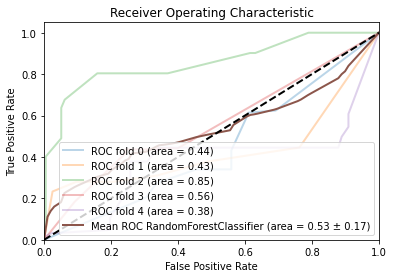

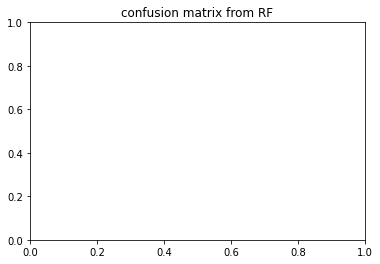

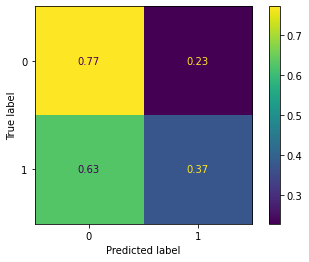

,precision,recall,f1-score,support,auc
0,0.555,0.776,0.640,200.000,0.000
1,0.509,0.371,0.425,200.000,0.000
accuracy,0.573,0.573,0.573,0.573,0.000
macro avg,0.532,0.573,0.532,400.000,0.531
weighted avg,0.533,0.573,0.533,400.000,0.531


coming from


,precision,recall,f1-score,support,auc
0,0.453659,0.440758,0.447115,211.000000,0.000000
1,0.418719,0.431472,0.425000,197.000000,0.000000
accuracy,0.436275,0.436275,0.436275,0.436275,0.000000
macro avg,0.436189,0.436115,0.436058,408.000000,0.437907
weighted avg,0.436788,0.436275,0.436437,408.000000,0.437907


,precision,recall,f1-score,support,auc
0,0.506394,1.000000,0.672326,198.000000,0.000000
1,0.000000,0.000000,0.000000,193.000000,0.000000
accuracy,0.506394,0.506394,0.506394,0.506394,0.000000
macro avg,0.253197,0.500000,0.336163,391.000000,0.427095
weighted avg,0.256435,0.506394,0.340462,391.000000,0.427095


,precision,recall,f1-score,support,auc
0,0.734940,0.938462,0.824324,195.000000,0.000000
1,0.920000,0.676471,0.779661,204.000000,0.000000
accuracy,0.804511,0.804511,0.804511,0.804511,0.000000
macro avg,0.827470,0.807466,0.801993,399.000000,0.854022
weighted avg,0.829557,0.804511,0.801489,399.000000,0.854022


,precision,recall,f1-score,support,auc
0,0.566038,0.757576,0.647948,198.000000,0.000000
1,0.630769,0.416244,0.501529,197.000000,0.000000
accuracy,0.587342,0.587342,0.587342,0.587342,0.000000
macro avg,0.598403,0.586910,0.574739,395.000000,0.555556
weighted avg,0.598322,0.587342,0.574924,395.000000,0.555556


,precision,recall,f1-score,support,auc
0,0.512195,0.742424,0.606186,198.000000,0.000000
1,0.575000,0.330144,0.419453,209.000000,0.000000
accuracy,0.530713,0.530713,0.530713,0.530713,0.000000
macro avg,0.543598,0.536284,0.512819,407.000000,0.378836
weighted avg,0.544446,0.530713,0.510296,407.000000,0.378836


{'criterion': 'gini', 'max_depth': 10, 'max_features': None, 'n_estimators': 10}
depth_10_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.789 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.695 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.659 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.615 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.799 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.710 total time=   0.1s
[CV 3/5] END criterion=gini

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.431 total time=   1.6s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.573 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.520 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.605 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.542 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.321 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.840 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.987

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.666 total time=   2.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.643 total time=   2.1s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.509 total time=   2.1s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.476 total time=   1.8s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.0s


<Figure size 432x288 with 0 Axes>

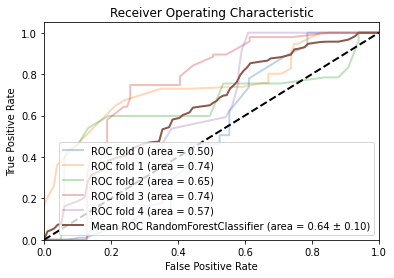

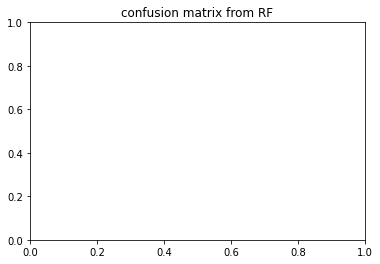

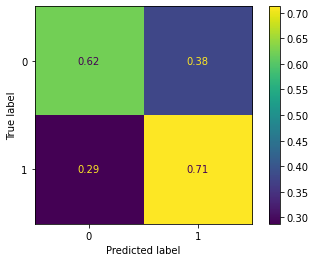

,precision,recall,f1-score,support,auc
0,0.737,0.626,0.618,102.200,0.000
1,0.700,0.717,0.673,102.200,0.000
accuracy,0.667,0.667,0.667,0.667,0.000
macro avg,0.719,0.671,0.646,204.400,0.641
weighted avg,0.721,0.667,0.644,204.400,0.641


coming from


,precision,recall,f1-score,support,auc
0,0.880000,0.213592,0.343750,103.000000,0.000000
1,0.531792,0.968421,0.686567,95.000000,0.000000
accuracy,0.575758,0.575758,0.575758,0.575758,0.000000
macro avg,0.705896,0.591007,0.515159,198.000000,0.498671
weighted avg,0.712930,0.575758,0.508233,198.000000,0.498671


,precision,recall,f1-score,support,auc
0,0.626761,0.864078,0.726531,103.000000,0.000000
1,0.805556,0.522523,0.633880,111.000000,0.000000
accuracy,0.686916,0.686916,0.686916,0.686916,0.000000
macro avg,0.716158,0.693300,0.680205,214.000000,0.742062
weighted avg,0.719500,0.686916,0.678473,214.000000,0.742062


,precision,recall,f1-score,support,auc
0,0.618056,0.898990,0.732510,99.000000,0.000000
1,0.824561,0.460784,0.591195,102.000000,0.000000
accuracy,0.676617,0.676617,0.676617,0.676617,0.000000
macro avg,0.721308,0.679887,0.661853,201.000000,0.651466
weighted avg,0.722850,0.676617,0.660798,201.000000,0.651466


,precision,recall,f1-score,support,auc
0,0.735294,0.742574,0.738916,101.000000,0.000000
1,0.723404,0.715789,0.719577,95.000000,0.000000
accuracy,0.729592,0.729592,0.729592,0.729592,0.000000
macro avg,0.729349,0.729182,0.729246,196.000000,0.744033
weighted avg,0.729531,0.729592,0.729543,196.000000,0.744033


,precision,recall,f1-score,support,auc
0,0.826923,0.409524,0.547771,105.000000,0.000000
1,0.614907,0.916667,0.736059,108.000000,0.000000
accuracy,0.666667,0.666667,0.666667,0.666667,0.000000
macro avg,0.720915,0.663095,0.641915,213.000000,0.569004
weighted avg,0.719422,0.666667,0.643241,213.000000,0.569004


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 50}
depth_10_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.840 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.761 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.623 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.369 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.449 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.785 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.724 total time=   0.0s
[CV 3/5] END criterion=gini,

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.451 total time=   1.5s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.595 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.702 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.657 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.906 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.471 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.606 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.886 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.960

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.680 total time=   2.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.538 total time=   2.1s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.508 total time=   1.9s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.415 total time=   2.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.568 total time=   2.2s


<Figure size 432x288 with 0 Axes>

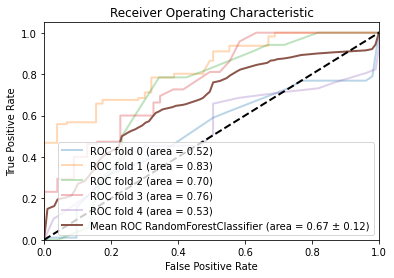

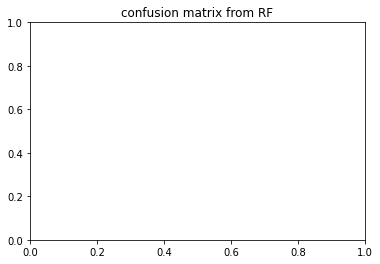

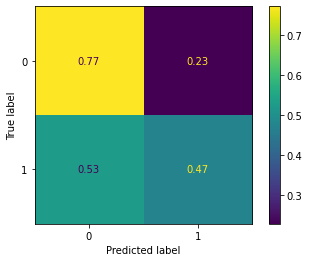

,precision,recall,f1-score,support,auc
0,0.617,0.770,0.662,102.200,0.000
1,0.689,0.474,0.526,102.200,0.000
accuracy,0.621,0.621,0.621,0.621,0.000
macro avg,0.653,0.622,0.594,204.400,0.668
weighted avg,0.655,0.621,0.595,204.400,0.668


coming from


,precision,recall,f1-score,support,auc
0,0.537572,0.902913,0.673913,103.000000,0.000000
1,0.600000,0.157895,0.250000,95.000000,0.000000
accuracy,0.545455,0.545455,0.545455,0.545455,0.000000
macro avg,0.568786,0.530404,0.461957,198.000000,0.517271
weighted avg,0.567525,0.545455,0.470520,198.000000,0.517271


,precision,recall,f1-score,support,auc
0,0.626582,0.961165,0.758621,103.000000,0.000000
1,0.928571,0.468468,0.622754,111.000000,0.000000
accuracy,0.705607,0.705607,0.705607,0.705607,0.000000
macro avg,0.777577,0.714817,0.690688,214.000000,0.827167
weighted avg,0.783222,0.705607,0.688148,214.000000,0.827167


,precision,recall,f1-score,support,auc
0,0.598425,0.767677,0.672566,99.000000,0.000000
1,0.689189,0.500000,0.579545,102.000000,0.000000
accuracy,0.631841,0.631841,0.631841,0.631841,0.000000
macro avg,0.643807,0.633838,0.626056,201.000000,0.701575
weighted avg,0.644485,0.631841,0.625362,201.000000,0.701575


,precision,recall,f1-score,support,auc
0,0.775862,0.445545,0.566038,101.000000,0.000000
1,0.594203,0.863158,0.703863,95.000000,0.000000
accuracy,0.647959,0.647959,0.647959,0.647959,0.000000
macro avg,0.685032,0.654351,0.634950,196.000000,0.760083
weighted avg,0.687813,0.647959,0.632841,196.000000,0.760083


,precision,recall,f1-score,support,auc
0,0.547297,0.771429,0.640316,105.00000,0.00000
1,0.630769,0.379630,0.473988,108.00000,0.00000
accuracy,0.572770,0.572770,0.572770,0.57277,0.00000
macro avg,0.589033,0.575529,0.557152,213.00000,0.53157
weighted avg,0.589621,0.572770,0.555981,213.00000,0.53157


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 50}
depth_10_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.783 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.289 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.493 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.731 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.678 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.371 total time=   0.1s
[CV 3/5] END criterion=gi

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.678 total time=   2.8s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.581 total time=   3.3s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.698 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.309 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.492 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.571 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.638 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.365

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.586 total time=   3.3s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.425 total time=   2.9s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.631 total time=   2.9s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.796 total time=   2.9s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.677 total time=   3.5s


<Figure size 432x288 with 0 Axes>

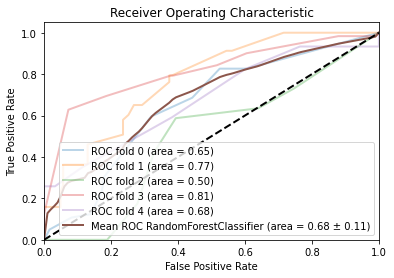

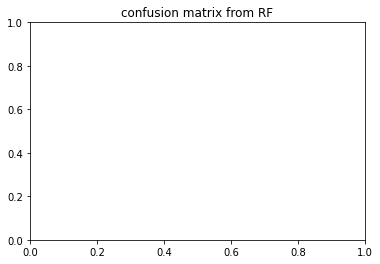

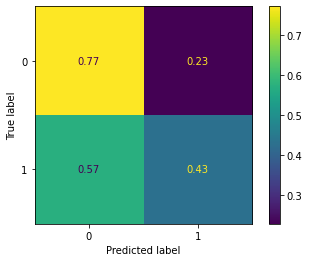

,precision,recall,f1-score,support,auc
0,0.594,0.771,0.652,122.8,0.000
1,0.770,0.425,0.460,122.8,0.000
accuracy,0.600,0.600,0.600,0.6,0.000
macro avg,0.682,0.598,0.556,245.6,0.683
weighted avg,0.681,0.600,0.557,245.6,0.683


coming from


,precision,recall,f1-score,support,auc
0,0.641509,0.557377,0.596491,122.000000,0.000000
1,0.605839,0.685950,0.643411,121.000000,0.000000
accuracy,0.621399,0.621399,0.621399,0.621399,0.000000
macro avg,0.623674,0.621664,0.619951,243.000000,0.650759
weighted avg,0.623748,0.621399,0.619854,243.000000,0.650759


,precision,recall,f1-score,support,auc
0,0.719626,0.626016,0.669565,123.000000,0.000000
1,0.676056,0.761905,0.716418,126.000000,0.000000
accuracy,0.694779,0.694779,0.694779,0.694779,0.000000
macro avg,0.697841,0.693961,0.692992,249.000000,0.773035
weighted avg,0.697579,0.694779,0.693274,249.000000,0.773035


,precision,recall,f1-score,support,auc
0,0.529032,0.672131,0.592058,122.000000,0.000000
1,0.569892,0.420635,0.484018,126.000000,0.000000
accuracy,0.544355,0.544355,0.544355,0.544355,0.000000
macro avg,0.549462,0.546383,0.538038,248.000000,0.498374
weighted avg,0.549792,0.544355,0.537167,248.000000,0.498374


,precision,recall,f1-score,support,auc
0,0.539130,1.000000,0.700565,124.000000,0.00000
1,1.000000,0.123967,0.220588,121.000000,0.00000
accuracy,0.567347,0.567347,0.567347,0.567347,0.00000
macro avg,0.769565,0.561983,0.460577,245.000000,0.81265
weighted avg,0.766744,0.567347,0.463515,245.000000,0.81265


,precision,recall,f1-score,support,auc
0,0.541850,1.000000,0.702857,123.000000,0.000000
1,1.000000,0.133333,0.235294,120.000000,0.000000
accuracy,0.572016,0.572016,0.572016,0.572016,0.000000
macro avg,0.770925,0.566667,0.469076,243.000000,0.677846
weighted avg,0.768097,0.572016,0.471962,243.000000,0.677846


{'criterion': 'gini', 'max_depth': 10, 'max_features': None, 'n_estimators': 10}
depth_10_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.464 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.293 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.634 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.767 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.725 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.682 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.387 total time=   0.1s
[CV 3/5] END criterion=gini, max_

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.740 total time=   2.7s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.685 total time=   3.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.712 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.474 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.354 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.854 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.547 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.370

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.632 total time=   3.6s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.404 total time=   2.9s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.544 total time=   3.1s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.832 total time=   3.1s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.705 total time=   3.6s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

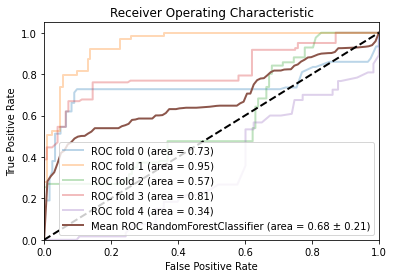

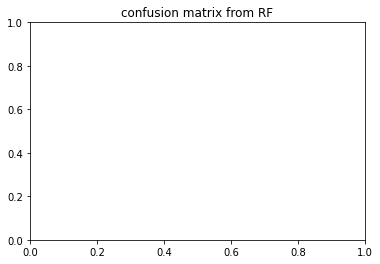

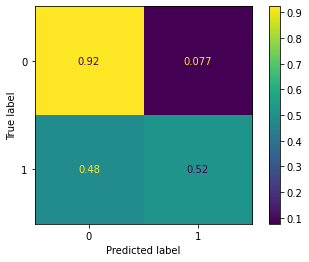

,precision,recall,f1-score,support,auc
0,0.694,0.924,0.779,122.800,0.000
1,0.710,0.514,0.568,122.800,0.000
accuracy,0.719,0.719,0.719,0.719,0.000
macro avg,0.702,0.719,0.673,245.600,0.683
weighted avg,0.704,0.719,0.674,245.600,0.683


coming from


,precision,recall,f1-score,support,auc
0,0.760274,0.909836,0.828358,122.0000,0.000000
1,0.886598,0.710744,0.788991,121.0000,0.000000
accuracy,0.810700,0.810700,0.810700,0.8107,0.000000
macro avg,0.823436,0.810290,0.808675,243.0000,0.734284
weighted avg,0.823176,0.810700,0.808756,243.0000,0.734284


,precision,recall,f1-score,support,auc
0,0.890756,0.861789,0.876033,123.000000,0.000000
1,0.869231,0.896825,0.882812,126.000000,0.000000
accuracy,0.879518,0.879518,0.879518,0.879518,0.000000
macro avg,0.879994,0.879307,0.879423,249.000000,0.947348
weighted avg,0.879864,0.879518,0.879464,249.000000,0.947348


,precision,recall,f1-score,support,auc
0,0.562791,0.991803,0.718101,122.000000,0.000000
1,0.969697,0.253968,0.402516,126.000000,0.000000
accuracy,0.616935,0.616935,0.616935,0.616935,0.000000
macro avg,0.766244,0.622886,0.560308,248.000000,0.574616
weighted avg,0.769525,0.616935,0.557763,248.000000,0.574616


,precision,recall,f1-score,support,auc
0,0.751773,0.854839,0.800000,124.000000,0.000000
1,0.826923,0.710744,0.764444,121.000000,0.000000
accuracy,0.783673,0.783673,0.783673,0.783673,0.000000
macro avg,0.789348,0.782791,0.782222,245.000000,0.812783
weighted avg,0.788888,0.783673,0.782440,245.000000,0.812783


,precision,recall,f1-score,support,auc
0,0.506173,1.000000,0.672131,123.000000,0.00000
1,0.000000,0.000000,0.000000,120.000000,0.00000
accuracy,0.506173,0.506173,0.506173,0.506173,0.00000
macro avg,0.253086,0.500000,0.336066,243.000000,0.34353
weighted avg,0.256211,0.506173,0.340215,243.000000,0.34353


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 100}
depth_100_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.397 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.695 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.600 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.465 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.953 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.487 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.474 total time=   0.1s
[CV 3/5] END c

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.584 total time=   2.1s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.489 total time=   1.9s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.300 total time=   2.1s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.723 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.587 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.317 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.573 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.493 total time=   1.1s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.788 total time=   2.3s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.695 total time=   2.6s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.571 total time=   2.3s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.417 total time=   2.3s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.566 total time=   2.4s


<Figure size 432x288 with 0 Axes>

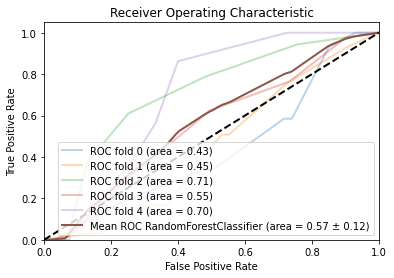

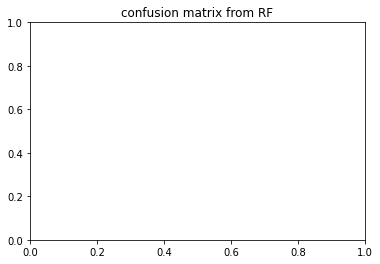

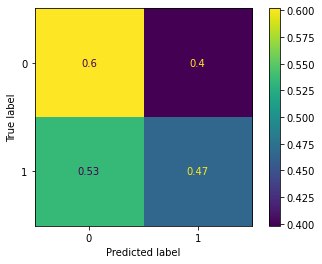

,precision,recall,f1-score,support,auc
0,0.513,0.600,0.543,131.600,0.000
1,0.565,0.464,0.492,131.600,0.000
accuracy,0.532,0.532,0.532,0.532,0.000
macro avg,0.539,0.532,0.518,263.200,0.566
weighted avg,0.540,0.532,0.518,263.200,0.566


coming from


,precision,recall,f1-score,support,auc
0,0.379310,0.259843,0.308411,127.000000,0.000000
1,0.447059,0.584615,0.506667,130.000000,0.000000
accuracy,0.424125,0.424125,0.424125,0.424125,0.000000
macro avg,0.413185,0.422229,0.407539,257.000000,0.432707
weighted avg,0.413580,0.424125,0.408696,257.000000,0.432707


,precision,recall,f1-score,support,auc
0,0.491803,0.447761,0.468750,134.000000,0.000000
1,0.463768,0.507937,0.484848,126.000000,0.000000
accuracy,0.476923,0.476923,0.476923,0.476923,0.000000
macro avg,0.477786,0.477849,0.476799,260.000000,0.445362
weighted avg,0.478217,0.476923,0.476552,260.000000,0.445362


,precision,recall,f1-score,support,auc
0,0.564356,0.870229,0.684685,131.000000,0.000000
1,0.757143,0.375887,0.502370,141.000000,0.000000
accuracy,0.613971,0.613971,0.613971,0.613971,0.000000
macro avg,0.660750,0.623058,0.593527,272.000000,0.706675
weighted avg,0.664294,0.613971,0.590176,272.000000,0.706675


,precision,recall,f1-score,support,auc
0,0.529412,0.755725,0.622642,131.000000,0.000000
1,0.522388,0.284553,0.368421,123.000000,0.000000
accuracy,0.527559,0.527559,0.527559,0.527559,0.000000
macro avg,0.525900,0.520139,0.495531,254.000000,0.549525
weighted avg,0.526011,0.527559,0.499535,254.000000,0.549525


,precision,recall,f1-score,support,auc
0,0.600000,0.666667,0.631579,135.000000,0.000000
1,0.634146,0.565217,0.597701,138.000000,0.000000
accuracy,0.615385,0.615385,0.615385,0.615385,0.000000
macro avg,0.617073,0.615942,0.614640,273.000000,0.695303
weighted avg,0.617261,0.615385,0.614454,273.000000,0.695303


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 10}
depth_100_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.715 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.313 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.516 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.733 total time=   0.1s
[CV 3/5] END criterion=

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.591 total time=   2.3s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.578 total time=   2.2s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.315 total time=   2.2s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.824 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.821 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.671 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.577 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.596 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.480 total time=   1.1s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.736 total time=   2.2s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.591 total time=   2.4s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.580 total time=   2.3s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.544 total time=   2.3s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.488 total time=   2.3s


<Figure size 432x288 with 0 Axes>

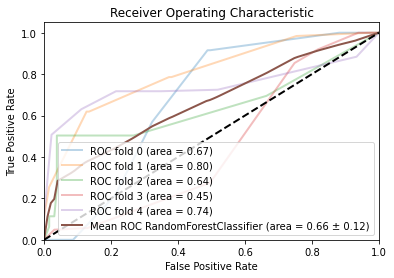

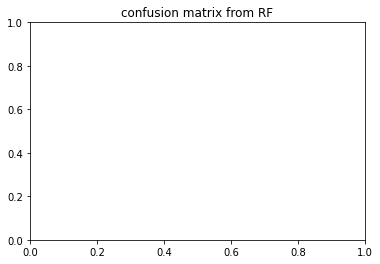

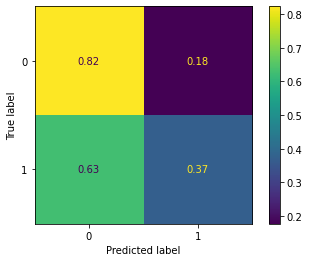

,precision,recall,f1-score,support,auc
0,0.564,0.821,0.663,131.600,0.000
1,0.752,0.371,0.472,131.600,0.000
accuracy,0.596,0.596,0.596,0.596,0.000
macro avg,0.658,0.596,0.568,263.200,0.662
weighted avg,0.659,0.596,0.568,263.200,0.662


coming from


,precision,recall,f1-score,support,auc
0,0.605634,0.677165,0.639405,127.000000,0.000000
1,0.643478,0.569231,0.604082,130.000000,0.000000
accuracy,0.622568,0.622568,0.622568,0.622568,0.000000
macro avg,0.624556,0.623198,0.621743,257.000000,0.674379
weighted avg,0.624777,0.622568,0.621537,257.000000,0.674379


,precision,recall,f1-score,support,auc
0,0.584071,0.985075,0.733333,134.000000,0.000000
1,0.941176,0.253968,0.400000,126.000000,0.000000
accuracy,0.630769,0.630769,0.630769,0.630769,0.000000
macro avg,0.762624,0.619521,0.566667,260.000000,0.804489
weighted avg,0.757130,0.630769,0.571795,260.000000,0.804489


,precision,recall,f1-score,support,auc
0,0.543103,0.961832,0.694215,131.000000,0.000000
1,0.875000,0.248227,0.386740,141.000000,0.000000
accuracy,0.591912,0.591912,0.591912,0.591912,0.000000
macro avg,0.709052,0.605030,0.540478,272.000000,0.641465
weighted avg,0.715153,0.591912,0.534825,272.000000,0.641465


,precision,recall,f1-score,support,auc
0,0.425806,0.503817,0.461538,131.000000,0.00000
1,0.343434,0.276423,0.306306,123.000000,0.00000
accuracy,0.393701,0.393701,0.393701,0.393701,0.00000
macro avg,0.384620,0.390120,0.383922,254.000000,0.44852
weighted avg,0.385918,0.393701,0.386367,254.000000,0.44852


,precision,recall,f1-score,support,auc
0,0.660000,0.977778,0.788060,135.000000,0.000000
1,0.958904,0.507246,0.663507,138.000000,0.000000
accuracy,0.739927,0.739927,0.739927,0.739927,0.000000
macro avg,0.809452,0.742512,0.725783,273.000000,0.742244
weighted avg,0.811094,0.739927,0.725099,273.000000,0.742244


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 10}
depth_100_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.341 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.316 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.624 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.635 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.685 total time=   0.1s
[CV 3/5] END c

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.685 total time=   3.7s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.473 total time=   3.6s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.774 total time=   4.2s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.796 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.361 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.416 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.423 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.935 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.739 total time=   2.3s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.564 total time=   3.7s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.758 total time=   4.2s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.593 total time=   3.8s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.481 total time=   3.6s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.747 total time=   4.4s


<Figure size 432x288 with 0 Axes>

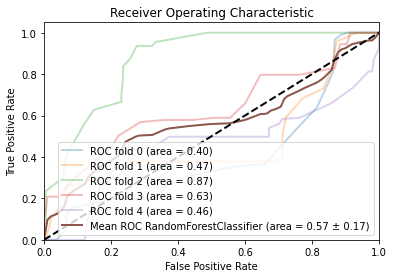

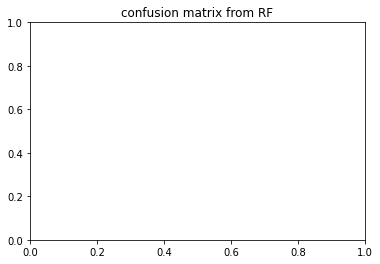

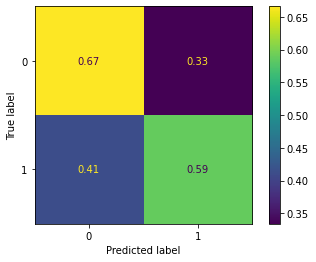

,precision,recall,f1-score,support,auc
0,0.671,0.673,0.607,200.000,0.000
1,0.676,0.585,0.573,200.000,0.000
accuracy,0.627,0.627,0.627,0.627,0.000
macro avg,0.673,0.629,0.590,400.000,0.567
weighted avg,0.674,0.627,0.589,400.000,0.567


coming from


,precision,recall,f1-score,support,auc
0,0.800000,0.132701,0.227642,211.000000,0.000000
1,0.509383,0.964467,0.666667,197.000000,0.000000
accuracy,0.534314,0.534314,0.534314,0.534314,0.000000
macro avg,0.654692,0.548584,0.447154,408.000000,0.403445
weighted avg,0.659678,0.534314,0.439622,408.000000,0.403445


,precision,recall,f1-score,support,auc
0,0.539130,0.939394,0.685083,198.00000,0.00000
1,0.739130,0.176166,0.284519,193.00000,0.00000
accuracy,0.562660,0.562660,0.562660,0.56266,0.00000
macro avg,0.639130,0.557780,0.484801,391.00000,0.47459
weighted avg,0.637852,0.562660,0.487362,391.00000,0.47459


,precision,recall,f1-score,support,auc
0,0.847953,0.743590,0.792350,195.000000,0.000000
1,0.780702,0.872549,0.824074,204.000000,0.000000
accuracy,0.809524,0.809524,0.809524,0.809524,0.000000
macro avg,0.814327,0.808069,0.808212,399.000000,0.869683
weighted avg,0.813569,0.809524,0.808570,399.000000,0.869683


,precision,recall,f1-score,support,auc
0,0.611111,0.777778,0.684444,198.000000,0.000000
1,0.692308,0.502538,0.582353,197.000000,0.000000
accuracy,0.640506,0.640506,0.640506,0.640506,0.000000
macro avg,0.651709,0.640158,0.633399,395.000000,0.630467
weighted avg,0.651607,0.640506,0.633528,395.000000,0.630467


,precision,recall,f1-score,support,auc
0,0.554348,0.772727,0.645570,198.000000,0.00000
1,0.656489,0.411483,0.505882,209.000000,0.00000
accuracy,0.587224,0.587224,0.587224,0.587224,0.00000
macro avg,0.605418,0.592105,0.575726,407.000000,0.45904
weighted avg,0.606798,0.587224,0.573838,407.000000,0.45904


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 50}
depth_100_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.445 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.552 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.458 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.889 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.384 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.539 total time=   0.2s
[CV 3/5] END criterion=

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.731 total time=   3.3s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.413 total time=   3.2s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.808 total time=   3.4s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.492 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.592 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.533 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.422 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.829 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.704 total time=   2.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.447 total time=   3.4s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.755 total time=   4.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.663 total time=   3.5s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.439 total time=   3.4s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.814 total time=   3.9s


<Figure size 432x288 with 0 Axes>

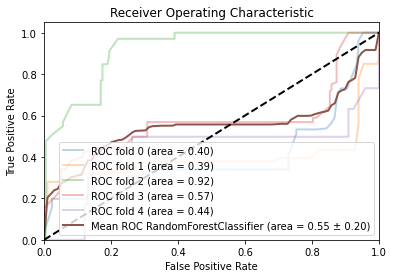

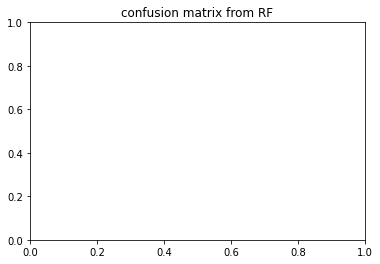

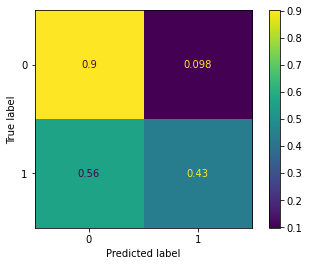

,precision,recall,f1-score,support,auc
0,0.642,0.901,0.738,200.000,0.000
1,0.835,0.431,0.522,200.000,0.000
accuracy,0.669,0.669,0.669,0.669,0.000
macro avg,0.739,0.666,0.630,400.000,0.546
weighted avg,0.737,0.669,0.632,400.000,0.546


coming from


,precision,recall,f1-score,support,auc
0,0.553763,0.976303,0.706690,211.000000,0.000000
1,0.861111,0.157360,0.266094,197.000000,0.000000
accuracy,0.580882,0.580882,0.580882,0.580882,0.000000
macro avg,0.707437,0.566832,0.486392,408.000000,0.398405
weighted avg,0.702164,0.580882,0.493951,408.000000,0.398405


,precision,recall,f1-score,support,auc
0,0.576471,0.989899,0.728625,198.000000,0.000000
1,0.960784,0.253886,0.401639,193.000000,0.000000
accuracy,0.626598,0.626598,0.626598,0.626598,0.000000
macro avg,0.768627,0.621893,0.565132,391.000000,0.394554
weighted avg,0.766170,0.626598,0.567223,391.000000,0.394554


,precision,recall,f1-score,support,auc
0,0.897143,0.805128,0.848649,195.000000,0.000000
1,0.830357,0.911765,0.869159,204.000000,0.000000
accuracy,0.859649,0.859649,0.859649,0.859649,0.000000
macro avg,0.863750,0.858446,0.858904,399.000000,0.918992
weighted avg,0.862997,0.859649,0.859135,399.000000,0.918992


,precision,recall,f1-score,support,auc
0,0.597270,0.883838,0.712831,198.000000,0.000000
1,0.774510,0.401015,0.528428,197.000000,0.000000
accuracy,0.643038,0.643038,0.643038,0.643038,0.000000
macro avg,0.685890,0.642427,0.620630,395.000000,0.573707
weighted avg,0.685665,0.643038,0.620863,395.000000,0.573707


,precision,recall,f1-score,support,auc
0,0.585366,0.848485,0.692784,198.000000,0.000000
1,0.750000,0.430622,0.547112,209.000000,0.000000
accuracy,0.633907,0.633907,0.633907,0.633907,0.000000
macro avg,0.667683,0.639553,0.619948,407.000000,0.442547
weighted avg,0.669908,0.633907,0.617979,407.000000,0.442547


{'criterion': 'gini', 'max_depth': 100, 'max_features': 0.5, 'n_estimators': 100}
depth_100_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.836 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.820 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.580 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.766 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.508 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.882 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.813 total time=   0.1s
[CV 3/5] END crite

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.533 total time=   1.5s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.480 total time=   1.6s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.587 total time=   1.5s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.870 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.637 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.804 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.598 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.248 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.568 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.669 total time=   2.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.526 total time=   1.9s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.560 total time=   1.8s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.414 total time=   1.8s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.9s


<Figure size 432x288 with 0 Axes>

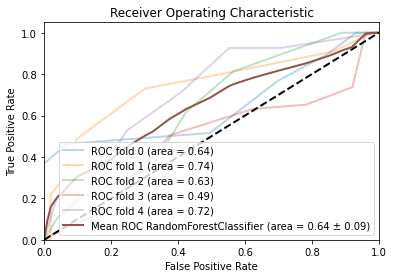

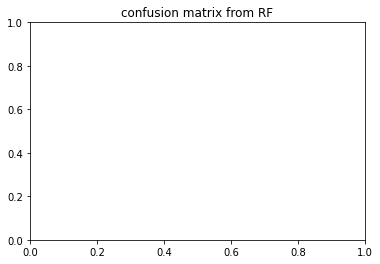

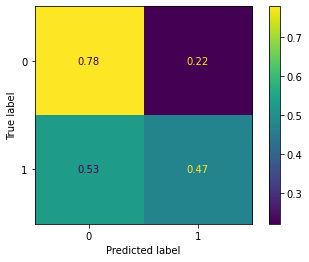

,precision,recall,f1-score,support,auc
0,0.603,0.778,0.669,102.200,0.000
1,0.701,0.464,0.529,102.200,0.000
accuracy,0.625,0.625,0.625,0.625,0.000
macro avg,0.652,0.621,0.599,204.400,0.643
weighted avg,0.652,0.625,0.601,204.400,0.643


coming from


,precision,recall,f1-score,support,auc
0,0.631902,1.000000,0.774436,103.00000,0.000000
1,1.000000,0.368421,0.538462,95.00000,0.000000
accuracy,0.696970,0.696970,0.696970,0.69697,0.000000
macro avg,0.815951,0.684211,0.656449,198.00000,0.640112
weighted avg,0.808515,0.696970,0.661216,198.00000,0.640112


,precision,recall,f1-score,support,auc
0,0.620000,0.902913,0.735178,103.000000,0.000000
1,0.843750,0.486486,0.617143,111.000000,0.000000
accuracy,0.686916,0.686916,0.686916,0.686916,0.000000
macro avg,0.731875,0.694700,0.676160,214.000000,0.740794
weighted avg,0.736057,0.686916,0.673954,214.000000,0.740794


,precision,recall,f1-score,support,auc
0,0.593750,0.575758,0.584615,99.000000,0.000000
1,0.600000,0.617647,0.608696,102.000000,0.000000
accuracy,0.597015,0.597015,0.597015,0.597015,0.000000
macro avg,0.596875,0.596702,0.596656,201.000000,0.627005
weighted avg,0.596922,0.597015,0.596835,201.000000,0.627005


,precision,recall,f1-score,support,auc
0,0.503030,0.821782,0.624060,101.000000,0.000000
1,0.419355,0.136842,0.206349,95.000000,0.000000
accuracy,0.489796,0.489796,0.489796,0.489796,0.000000
macro avg,0.461193,0.479312,0.415205,196.000000,0.489005
weighted avg,0.462473,0.489796,0.421598,196.000000,0.489005


,precision,recall,f1-score,support,auc
0,0.666667,0.590476,0.626263,105.000000,0.000000
1,0.641667,0.712963,0.675439,108.000000,0.000000
accuracy,0.652582,0.652582,0.652582,0.652582,0.000000
macro avg,0.654167,0.651720,0.650851,213.000000,0.719885
weighted avg,0.653991,0.652582,0.651197,213.000000,0.719885


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 10}
depth_100_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.533 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.859 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.447 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.917 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.983 total time=   0.1s
[CV 3/5] END criter

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.549 total time=   1.6s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.538 total time=   1.5s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.577 total time=   1.7s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.629 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.615 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.685 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.792 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.560 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.574 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.674 total time=   1.9s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.585 total time=   2.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.539 total time=   1.9s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.504 total time=   1.8s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.9s


<Figure size 432x288 with 0 Axes>

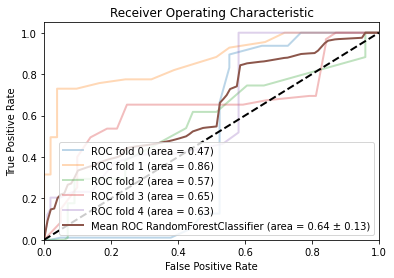

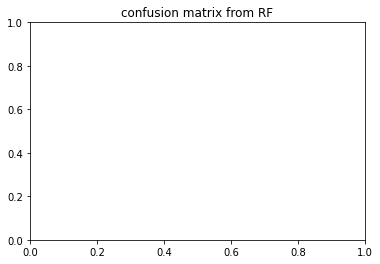

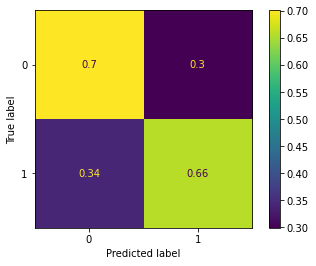

,precision,recall,f1-score,support,auc
0,0.701,0.704,0.670,102.200,0.000
1,0.722,0.654,0.651,102.200,0.000
accuracy,0.677,0.677,0.677,0.677,0.000
macro avg,0.712,0.679,0.660,204.400,0.636
weighted avg,0.713,0.677,0.660,204.400,0.636


coming from


,precision,recall,f1-score,support,auc
0,0.741935,0.446602,0.557576,103.000000,0.000000
1,0.580882,0.831579,0.683983,95.000000,0.000000
accuracy,0.631313,0.631313,0.631313,0.631313,0.000000
macro avg,0.661409,0.639090,0.620779,198.000000,0.469136
weighted avg,0.664663,0.631313,0.618226,198.000000,0.469136


,precision,recall,f1-score,support,auc
0,0.755725,0.961165,0.846154,103.000000,0.000000
1,0.951807,0.711712,0.814433,111.000000,0.000000
accuracy,0.831776,0.831776,0.831776,0.831776,0.000000
macro avg,0.853766,0.836438,0.830293,214.000000,0.864253
weighted avg,0.857431,0.831776,0.829701,214.000000,0.864253


,precision,recall,f1-score,support,auc
0,0.552147,0.909091,0.687023,99.00000,0.000000
1,0.763158,0.284314,0.414286,102.00000,0.000000
accuracy,0.592040,0.592040,0.592040,0.59204,0.000000
macro avg,0.657653,0.596702,0.550654,201.00000,0.573678
weighted avg,0.659227,0.592040,0.548619,201.00000,0.573678


,precision,recall,f1-score,support,auc
0,0.642276,0.782178,0.705357,101.000000,0.000000
1,0.698630,0.536842,0.607143,95.000000,0.000000
accuracy,0.663265,0.663265,0.663265,0.663265,0.000000
macro avg,0.670453,0.659510,0.656250,196.000000,0.645128
weighted avg,0.669591,0.663265,0.657753,196.000000,0.645128


,precision,recall,f1-score,support,auc
0,0.814815,0.419048,0.553459,105.000000,0.000000
1,0.616352,0.907407,0.734082,108.000000,0.000000
accuracy,0.666667,0.666667,0.666667,0.666667,0.000000
macro avg,0.715584,0.663228,0.643771,213.000000,0.627734
weighted avg,0.714186,0.666667,0.645043,213.000000,0.627734


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 50}
depth_100_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.793 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.449 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.579 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.545 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.223 total time=   0.1s
[CV 3/5] END 

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.560 total time=   2.6s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.687 total time=   2.6s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.569 total time=   3.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.518 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.223 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.653 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.804 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.636 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.557 total time=   1.7s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.633 total time=   3.1s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.368 total time=   2.8s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.570 total time=   2.8s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.775 total time=   2.9s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.691 total time=   3.5s


<Figure size 432x288 with 0 Axes>

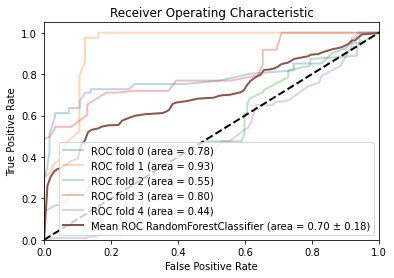

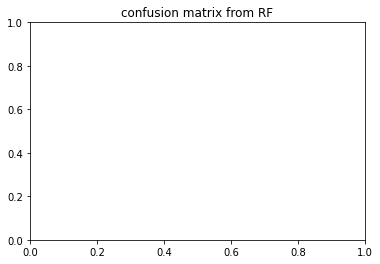

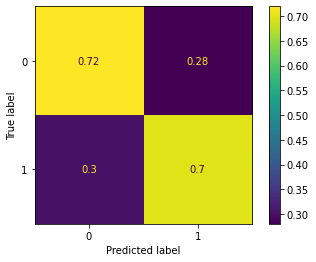

,precision,recall,f1-score,support,auc
0,0.738,0.720,0.660,122.800,0.0
1,0.759,0.701,0.681,122.800,0.0
accuracy,0.709,0.709,0.709,0.709,0.0
macro avg,0.749,0.711,0.671,245.600,0.7
weighted avg,0.749,0.709,0.669,245.600,0.7


coming from


,precision,recall,f1-score,support,auc
0,0.750000,0.860656,0.801527,122.000000,0.000000
1,0.834951,0.710744,0.767857,121.000000,0.000000
accuracy,0.786008,0.786008,0.786008,0.786008,0.000000
macro avg,0.792476,0.785700,0.784692,243.000000,0.780314
weighted avg,0.792301,0.786008,0.784761,243.000000,0.780314


,precision,recall,f1-score,support,auc
0,0.964286,0.878049,0.919149,123.000000,0.000000
1,0.890511,0.968254,0.927757,126.000000,0.000000
accuracy,0.923695,0.923695,0.923695,0.923695,0.000000
macro avg,0.927398,0.923151,0.923453,249.000000,0.934475
weighted avg,0.926954,0.923695,0.923505,249.000000,0.934475


,precision,recall,f1-score,support,auc
0,0.528037,0.926230,0.672619,122.000000,0.00000
1,0.735294,0.198413,0.312500,126.000000,0.00000
accuracy,0.556452,0.556452,0.556452,0.556452,0.00000
macro avg,0.631666,0.562321,0.492560,248.000000,0.54518
weighted avg,0.633337,0.556452,0.489655,248.000000,0.54518


,precision,recall,f1-score,support,auc
0,0.720000,0.870968,0.788321,124.000000,0.000000
1,0.831579,0.652893,0.731481,121.000000,0.000000
accuracy,0.763265,0.763265,0.763265,0.763265,0.000000
macro avg,0.775789,0.761930,0.759901,245.000000,0.802753
weighted avg,0.775106,0.763265,0.760249,245.000000,0.802753


,precision,recall,f1-score,support,auc
0,0.727273,0.065041,0.119403,123.000000,0.000000
1,0.504310,0.975000,0.664773,120.000000,0.000000
accuracy,0.514403,0.514403,0.514403,0.514403,0.000000
macro avg,0.615792,0.520020,0.392088,243.000000,0.438076
weighted avg,0.617168,0.514403,0.388721,243.000000,0.438076


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_100_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.730 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.324 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.436 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.642 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.666 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.492 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.270 total time=   0.1s
[CV 3/5] END criterio

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.602 total time=   2.6s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.709 total time=   2.6s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.650 total time=   3.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.478 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.505 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.581 total time=   1.7s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.712 total time=   3.2s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.400 total time=   2.7s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.649 total time=   2.8s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.789 total time=   2.8s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.561 total time=   3.4s


<Figure size 432x288 with 0 Axes>

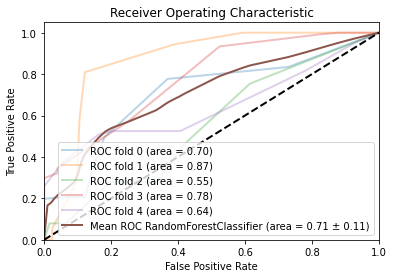

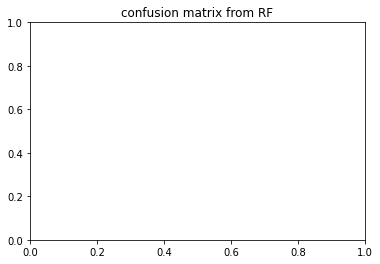

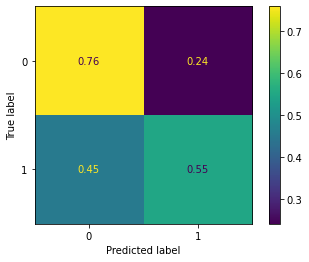

,precision,recall,f1-score,support,auc
0,0.636,0.759,0.681,122.800,0.00
1,0.725,0.547,0.604,122.800,0.00
accuracy,0.653,0.653,0.653,0.653,0.00
macro avg,0.680,0.653,0.643,245.600,0.71
weighted avg,0.680,0.653,0.643,245.600,0.71


coming from


,precision,recall,f1-score,support,auc
0,0.621118,0.819672,0.706714,122.000000,0.000000
1,0.731707,0.495868,0.591133,121.000000,0.000000
accuracy,0.658436,0.658436,0.658436,0.658436,0.000000
macro avg,0.676413,0.657770,0.648923,243.000000,0.704715
weighted avg,0.676185,0.658436,0.649161,243.000000,0.704715


,precision,recall,f1-score,support,auc
0,0.674847,0.894309,0.769231,123.00000,0.00000
1,0.848837,0.579365,0.688679,126.00000,0.00000
accuracy,0.734940,0.734940,0.734940,0.73494,0.00000
macro avg,0.761842,0.736837,0.728955,249.00000,0.86637
weighted avg,0.762890,0.734940,0.728470,249.00000,0.86637


,precision,recall,f1-score,support,auc
0,0.510791,0.581967,0.544061,122.000000,0.000000
1,0.532110,0.460317,0.493617,126.000000,0.000000
accuracy,0.520161,0.520161,0.520161,0.520161,0.000000
macro avg,0.521451,0.521142,0.518839,248.000000,0.554222
weighted avg,0.521623,0.520161,0.518432,248.000000,0.554222


,precision,recall,f1-score,support,auc
0,0.766667,0.556452,0.644860,124.000000,0.000000
1,0.645161,0.826446,0.724638,121.000000,0.000000
accuracy,0.689796,0.689796,0.689796,0.689796,0.000000
macro avg,0.705914,0.691449,0.684749,245.000000,0.779292
weighted avg,0.706658,0.689796,0.684260,245.000000,0.779292


,precision,recall,f1-score,support,auc
0,0.607330,0.943089,0.738854,123.000000,0.000000
1,0.865385,0.375000,0.523256,120.000000,0.000000
accuracy,0.662551,0.662551,0.662551,0.662551,0.000000
macro avg,0.736357,0.659045,0.631055,243.000000,0.643902
weighted avg,0.734764,0.662551,0.632386,243.000000,0.643902


{'criterion': 'gini', 'max_depth': 100, 'max_features': 0.5, 'n_estimators': 10}
depth_1000_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.767 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.809 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.601 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.082 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.382 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.518 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.694 total time=   0.1s
[CV 3/5] END

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.501 total time=   2.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.583 total time=   2.1s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.544 total time=   1.8s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.351 total time=   1.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.542 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.685 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.508 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.490 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.580 total time=   1.1s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.351 total time=   1.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.632 total time=   1.1s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.720 total time=   2.1s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.579 total time=   2.4s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.581 total time=   2.2s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.440 total time=   2.1s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.248 total time=   2.3s


<Figure size 432x288 with 0 Axes>

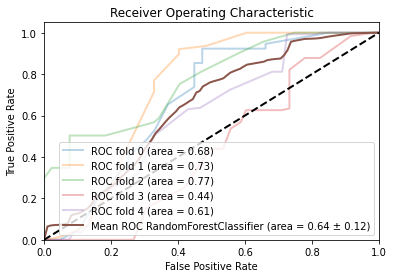

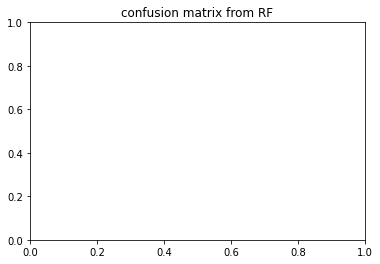

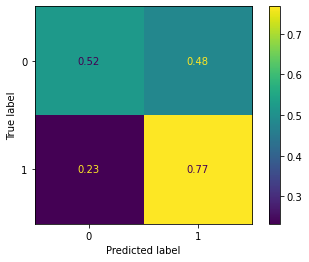

,precision,recall,f1-score,support,auc
0,0.695,0.521,0.568,131.600,0.000
1,0.650,0.773,0.682,131.600,0.000
accuracy,0.644,0.644,0.644,0.644,0.000
macro avg,0.673,0.647,0.625,263.200,0.642
weighted avg,0.674,0.644,0.624,263.200,0.642


coming from


,precision,recall,f1-score,support,auc
0,0.779070,0.527559,0.629108,127.000000,0.000000
1,0.649123,0.853846,0.737542,130.000000,0.000000
accuracy,0.692607,0.692607,0.692607,0.692607,0.000000
macro avg,0.714096,0.690703,0.683325,257.000000,0.677226
weighted avg,0.713338,0.692607,0.683958,257.000000,0.677226


,precision,recall,f1-score,support,auc
0,0.860215,0.597015,0.704846,134.000000,0.000000
1,0.676647,0.896825,0.771331,126.000000,0.000000
accuracy,0.742308,0.742308,0.742308,0.742308,0.000000
macro avg,0.768431,0.746920,0.738088,260.000000,0.727582
weighted avg,0.771255,0.742308,0.737066,260.000000,0.727582


,precision,recall,f1-score,support,auc
0,0.623711,0.923664,0.744615,131.000000,0.000000
1,0.871795,0.482270,0.621005,141.000000,0.000000
accuracy,0.694853,0.694853,0.694853,0.694853,0.000000
macro avg,0.747753,0.702967,0.682810,272.000000,0.765172
weighted avg,0.752313,0.694853,0.680538,272.000000,0.765172


,precision,recall,f1-score,support,auc
0,0.614035,0.267176,0.372340,131.000000,0.000000
1,0.512690,0.821138,0.631250,123.000000,0.000000
accuracy,0.535433,0.535433,0.535433,0.535433,0.000000
macro avg,0.563363,0.544157,0.501795,254.000000,0.435611
weighted avg,0.564959,0.535433,0.497718,254.000000,0.435611


,precision,recall,f1-score,support,auc
0,0.600000,0.288889,0.390000,135.000000,0.000000
1,0.538462,0.811594,0.647399,138.000000,0.000000
accuracy,0.553114,0.553114,0.553114,0.553114,0.000000
macro avg,0.569231,0.550242,0.518699,273.000000,0.606763
weighted avg,0.568893,0.553114,0.520114,273.000000,0.606763


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}
depth_1000_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.483 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.729 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.483 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.611 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.586 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.717 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.675 total time=   0.1s
[CV 3/5] END c

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.628 total time=   2.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.583 total time=   2.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.426 total time=   1.8s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.336 total time=   1.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.581 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.854 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.781 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.381 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.583 total time=   1.1s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.595 total time=   1.1s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.256 total time=   1.1s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.743 total time=   2.1s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.598 total time=   2.4s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.578 total time=   2.3s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.450 total time=   2.1s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.366 total time=   2.2s


<Figure size 432x288 with 0 Axes>

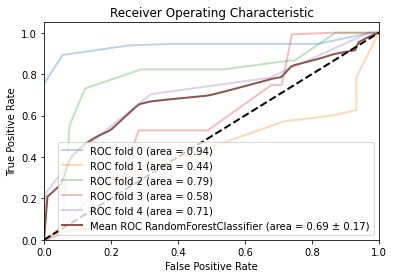

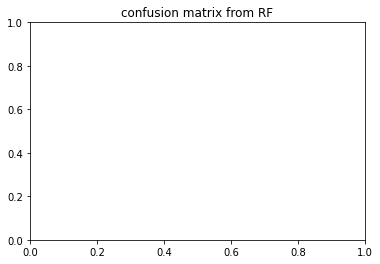

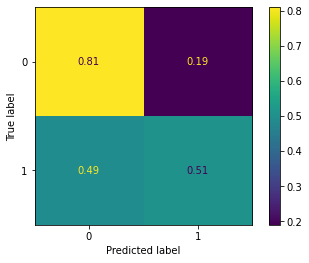

,precision,recall,f1-score,support,auc
0,0.625,0.810,0.685,131.600,0.000
1,0.745,0.509,0.565,131.600,0.000
accuracy,0.659,0.659,0.659,0.659,0.000
macro avg,0.685,0.660,0.625,263.200,0.691
weighted avg,0.687,0.659,0.625,263.200,0.691


coming from


,precision,recall,f1-score,support,auc
0,0.798742,1.000000,0.888112,127.000000,0.00000
1,1.000000,0.753846,0.859649,130.000000,0.00000
accuracy,0.875486,0.875486,0.875486,0.875486,0.00000
macro avg,0.899371,0.876923,0.873881,257.000000,0.93831
weighted avg,0.900546,0.875486,0.873714,257.000000,0.93831


,precision,recall,f1-score,support,auc
0,0.518672,0.932836,0.666667,134.000000,0.000000
1,0.526316,0.079365,0.137931,126.000000,0.000000
accuracy,0.519231,0.519231,0.519231,0.519231,0.000000
macro avg,0.522494,0.506100,0.402299,260.000000,0.436478
weighted avg,0.522376,0.519231,0.410433,260.000000,0.436478


,precision,recall,f1-score,support,auc
0,0.657609,0.923664,0.768254,131.000000,0.000000
1,0.886364,0.553191,0.681223,141.000000,0.000000
accuracy,0.731618,0.731618,0.731618,0.731618,0.000000
macro avg,0.771986,0.738428,0.724738,272.000000,0.793406
weighted avg,0.776191,0.731618,0.723138,272.000000,0.793406


,precision,recall,f1-score,support,auc
0,0.550725,0.290076,0.380000,131.000000,0.000000
1,0.497297,0.747967,0.597403,123.000000,0.000000
accuracy,0.511811,0.511811,0.511811,0.511811,0.000000
macro avg,0.524011,0.519022,0.488701,254.000000,0.577546
weighted avg,0.524852,0.511811,0.485278,254.000000,0.577546


,precision,recall,f1-score,support,auc
0,0.600985,0.903704,0.721893,135.000000,0.000000
1,0.814286,0.413043,0.548077,138.000000,0.000000
accuracy,0.655678,0.655678,0.655678,0.655678,0.000000
macro avg,0.707635,0.658374,0.634985,273.000000,0.711675
weighted avg,0.708807,0.655678,0.634030,273.000000,0.711675


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'sqrt', 'n_estimators': 10}
depth_1000_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.521 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.549 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.446 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.780 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.633 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.663 total time=   0.1s
[CV 3

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.803 total time=   3.9s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.682 total time=   3.3s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.484 total time=   3.3s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.762 total time=   3.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.487 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.566 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.544 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.422 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.635 total time=   1.7s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.496 total time=   1.6s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.725 total time=   1.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.542 total time=   3.3s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.774 total time=   4.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.643 total time=   3.5s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.456 total time=   3.4s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.785 total time=   3.9s


<Figure size 432x288 with 0 Axes>

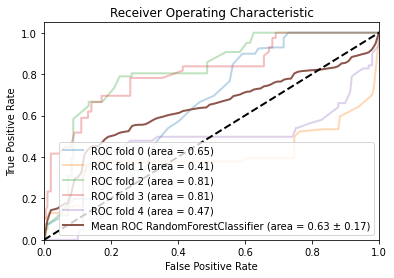

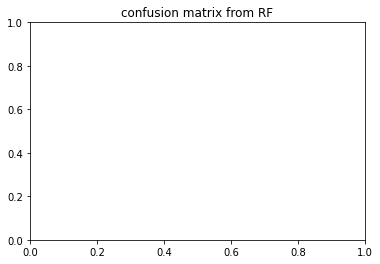

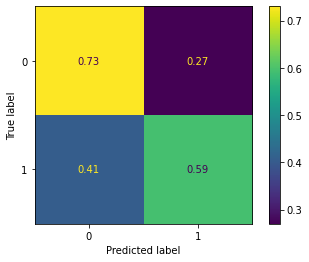

,precision,recall,f1-score,support,auc
0,0.666,0.734,0.679,200.000,0.00
1,0.702,0.595,0.619,200.000,0.00
accuracy,0.662,0.662,0.662,0.662,0.00
macro avg,0.684,0.664,0.649,400.000,0.63
weighted avg,0.685,0.662,0.648,400.000,0.63


coming from


,precision,recall,f1-score,support,auc
0,0.754098,0.436019,0.552553,211.000000,0.000000
1,0.583916,0.847716,0.691511,197.000000,0.000000
accuracy,0.634804,0.634804,0.634804,0.634804,0.000000
macro avg,0.669007,0.641867,0.622032,408.000000,0.647737
weighted avg,0.671927,0.634804,0.619648,408.000000,0.647737


,precision,recall,f1-score,support,auc
0,0.572848,0.873737,0.692000,198.000000,0.000000
1,0.719101,0.331606,0.453901,193.000000,0.000000
accuracy,0.606138,0.606138,0.606138,0.606138,0.000000
macro avg,0.645974,0.602672,0.572950,391.000000,0.406762
weighted avg,0.645039,0.606138,0.574473,391.000000,0.406762


,precision,recall,f1-score,support,auc
0,0.740385,0.789744,0.764268,195.000000,0.000000
1,0.785340,0.735294,0.759494,204.000000,0.000000
accuracy,0.761905,0.761905,0.761905,0.761905,0.000000
macro avg,0.762862,0.762519,0.761881,399.000000,0.814429
weighted avg,0.763369,0.761905,0.761827,399.000000,0.814429


,precision,recall,f1-score,support,auc
0,0.710145,0.742424,0.725926,198.000000,0.000000
1,0.728723,0.695431,0.711688,197.000000,0.000000
accuracy,0.718987,0.718987,0.718987,0.718987,0.000000
macro avg,0.719434,0.718928,0.718807,395.000000,0.810568
weighted avg,0.719411,0.718987,0.718825,395.000000,0.810568


,precision,recall,f1-score,support,auc
0,0.552189,0.828283,0.662626,198.000000,0.000000
1,0.690909,0.363636,0.476489,209.000000,0.000000
accuracy,0.589681,0.589681,0.589681,0.589681,0.000000
macro avg,0.621549,0.595960,0.569558,407.000000,0.471666
weighted avg,0.623423,0.589681,0.567042,407.000000,0.471666


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.639 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.369 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.498 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.448 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.776 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.661 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.622 total time=   0.1s
[CV 3/5] E

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.794 total time=   4.6s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.693 total time=   3.9s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.462 total time=   4.1s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.791 total time=   3.7s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.639 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.535 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.573 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.615 total time=   1.8s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.450 total time=   1.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.751 total time=   1.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.536 total time=   3.5s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.812 total time=   4.1s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.618 total time=   3.6s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.500 total time=   3.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.754 total time=   3.9s


<Figure size 432x288 with 0 Axes>

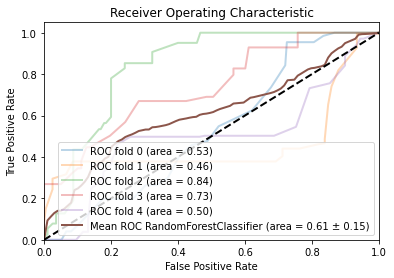

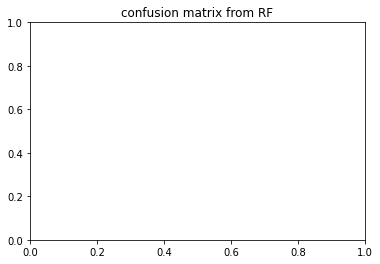

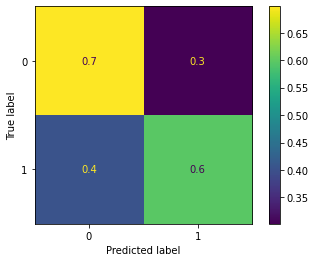

,precision,recall,f1-score,support,auc
0,0.650,0.704,0.649,200.000,0.000
1,0.702,0.596,0.611,200.000,0.000
accuracy,0.648,0.648,0.648,0.648,0.000
macro avg,0.676,0.650,0.630,400.000,0.612
weighted avg,0.676,0.648,0.629,400.000,0.612


coming from


,precision,recall,f1-score,support,auc
0,0.655556,0.279621,0.392027,211.000000,0.000000
1,0.522013,0.842640,0.644660,197.000000,0.000000
accuracy,0.551471,0.551471,0.551471,0.551471,0.000000
macro avg,0.588784,0.561130,0.518343,408.000000,0.528749
weighted avg,0.591075,0.551471,0.514009,408.000000,0.528749


,precision,recall,f1-score,support,auc
0,0.583596,0.934343,0.718447,198.000000,0.000000
1,0.824324,0.316062,0.456929,193.000000,0.000000
accuracy,0.629156,0.629156,0.629156,0.629156,0.000000
macro avg,0.703960,0.625203,0.587688,391.000000,0.460093
weighted avg,0.702421,0.629156,0.589360,391.000000,0.460093


,precision,recall,f1-score,support,auc
0,0.808743,0.758974,0.783069,195.000000,0.000000
1,0.782407,0.828431,0.804762,204.000000,0.000000
accuracy,0.794486,0.794486,0.794486,0.794486,0.000000
macro avg,0.795575,0.793703,0.793915,399.000000,0.836941
weighted avg,0.795278,0.794486,0.794160,399.000000,0.836941


,precision,recall,f1-score,support,auc
0,0.638298,0.757576,0.692841,198.000000,0.000000
1,0.700000,0.568528,0.627451,197.000000,0.000000
accuracy,0.663291,0.663291,0.663291,0.663291,0.000000
macro avg,0.669149,0.663052,0.660146,395.000000,0.733156
weighted avg,0.669071,0.663291,0.660229,395.000000,0.733156


,precision,recall,f1-score,support,auc
0,0.565217,0.787879,0.658228,198.000000,0.000000
1,0.679389,0.425837,0.523529,209.000000,0.000000
accuracy,0.601966,0.601966,0.601966,0.601966,0.000000
macro avg,0.622303,0.606858,0.590879,407.000000,0.499613
weighted avg,0.623846,0.601966,0.589058,407.000000,0.499613


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'sqrt', 'n_estimators': 50}
depth_1000_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.722 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.814 total time=   0.1s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.432 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.894 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.840 total time=   0.1s
[CV 3/5

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.594 total time=   1.6s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.567 total time=   1.6s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.514 total time=   1.5s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.614 total time=   1.5s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.920 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.393 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.526 total time=   0.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.417 total time=   0.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.571 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.645 total time=   2.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.617 total time=   2.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.569 total time=   1.8s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.494 total time=   1.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.9s


<Figure size 432x288 with 0 Axes>

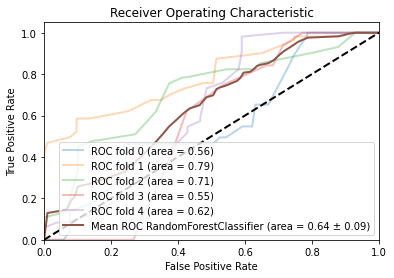

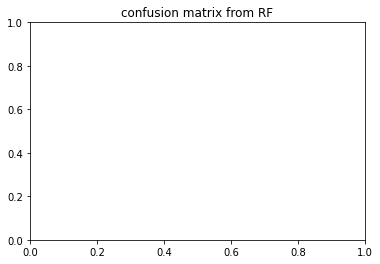

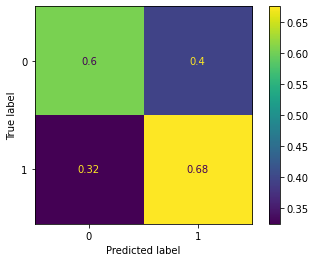

,precision,recall,f1-score,support,auc
0,0.696,0.605,0.604,102.200,0.000
1,0.654,0.675,0.636,102.200,0.000
accuracy,0.638,0.638,0.638,0.638,0.000
macro avg,0.675,0.640,0.620,204.400,0.645
weighted avg,0.676,0.638,0.620,204.400,0.645


coming from


,precision,recall,f1-score,support,auc
0,0.573529,0.757282,0.652720,103.000000,0.000000
1,0.596774,0.389474,0.471338,95.000000,0.000000
accuracy,0.580808,0.580808,0.580808,0.580808,0.000000
macro avg,0.585152,0.573378,0.562029,198.000000,0.558048
weighted avg,0.584682,0.580808,0.565693,198.000000,0.558048


,precision,recall,f1-score,support,auc
0,0.636986,0.902913,0.746988,103.000000,0.000000
1,0.852941,0.522523,0.648045,111.000000,0.000000
accuracy,0.705607,0.705607,0.705607,0.705607,0.000000
macro avg,0.744964,0.712718,0.697516,214.000000,0.785752
weighted avg,0.749000,0.705607,0.695667,214.000000,0.785752


,precision,recall,f1-score,support,auc
0,0.628571,0.666667,0.647059,99.000000,0.000000
1,0.656250,0.617647,0.636364,102.000000,0.000000
accuracy,0.641791,0.641791,0.641791,0.641791,0.000000
macro avg,0.642411,0.642157,0.641711,201.000000,0.707962
weighted avg,0.642617,0.641791,0.641631,201.000000,0.707962


,precision,recall,f1-score,support,auc
0,0.828571,0.287129,0.426471,101.000000,0.000000
1,0.552795,0.936842,0.695312,95.000000,0.000000
accuracy,0.602041,0.602041,0.602041,0.602041,0.000000
macro avg,0.690683,0.611985,0.560892,196.000000,0.552579
weighted avg,0.694904,0.602041,0.556777,196.000000,0.552579


,precision,recall,f1-score,support,auc
0,0.811321,0.409524,0.544304,105.000000,0.000000
1,0.612500,0.907407,0.731343,108.000000,0.000000
accuracy,0.661972,0.661972,0.661972,0.661972,0.000000
macro avg,0.711910,0.658466,0.637824,213.000000,0.620062
weighted avg,0.710510,0.661972,0.639141,213.000000,0.620062


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}
depth_1000_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.848 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.641 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.783 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.362 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.482 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.826 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.954 total time=   0.1s
[CV 3/5] END 

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.667 total time=   1.6s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.605 total time=   1.6s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.529 total time=   1.5s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.566 total time=   1.5s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.755 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.793 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.724 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.679 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.620 total time=   1.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.476 total time=   0.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.572 total time=   1.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.712 total time=   2.1s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.614 total time=   2.1s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.593 total time=   2.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.531 total time=   1.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.9s


<Figure size 432x288 with 0 Axes>

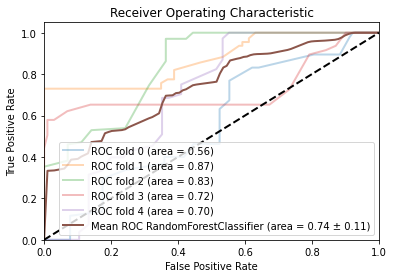

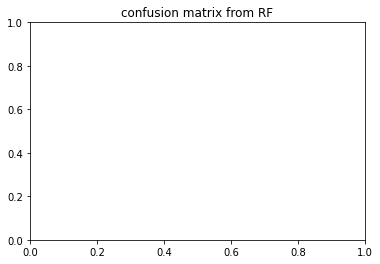

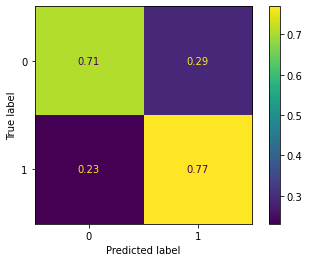

,precision,recall,f1-score,support,auc
0,0.778,0.708,0.712,102.200,0.000
1,0.777,0.764,0.742,102.200,0.000
accuracy,0.736,0.736,0.736,0.736,0.000
macro avg,0.778,0.736,0.727,204.400,0.737
weighted avg,0.777,0.736,0.727,204.400,0.737


coming from


,precision,recall,f1-score,support,auc
0,0.597403,0.446602,0.511111,103.000000,0.000000
1,0.528926,0.673684,0.592593,95.000000,0.000000
accuracy,0.555556,0.555556,0.555556,0.555556,0.000000
macro avg,0.563164,0.560143,0.551852,198.000000,0.562698
weighted avg,0.564547,0.555556,0.550206,198.000000,0.562698


,precision,recall,f1-score,support,auc
0,0.751825,1.000000,0.858333,103.000000,0.00000
1,1.000000,0.693694,0.819149,111.000000,0.00000
accuracy,0.841121,0.841121,0.841121,0.841121,0.00000
macro avg,0.875912,0.846847,0.838741,214.000000,0.86902
weighted avg,0.880551,0.841121,0.838009,214.000000,0.86902


,precision,recall,f1-score,support,auc
0,0.900000,0.636364,0.745562,99.00000,0.000000
1,0.725191,0.931373,0.815451,102.00000,0.000000
accuracy,0.786070,0.786070,0.786070,0.78607,0.000000
macro avg,0.812595,0.783868,0.780506,201.00000,0.834225
weighted avg,0.811291,0.786070,0.781028,201.00000,0.834225


,precision,recall,f1-score,support,auc
0,0.699301,0.990099,0.819672,101.00000,0.000000
1,0.981132,0.547368,0.702703,95.00000,0.000000
accuracy,0.775510,0.775510,0.775510,0.77551,0.000000
macro avg,0.840216,0.768734,0.761187,196.00000,0.722199
weighted avg,0.835903,0.775510,0.762978,196.00000,0.722199


,precision,recall,f1-score,support,auc
0,0.942308,0.466667,0.624204,105.000000,0.000000
1,0.652174,0.972222,0.780669,108.000000,0.000000
accuracy,0.723005,0.723005,0.723005,0.723005,0.000000
macro avg,0.797241,0.719444,0.702436,213.000000,0.695238
weighted avg,0.795198,0.723005,0.703538,213.000000,0.695238


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.600 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.407 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.655 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.624 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.611 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.705 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.393 total time=   0.1s
[CV

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.411 total time=   2.6s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.583 total time=   2.7s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.694 total time=   2.6s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.692 total time=   3.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.351 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.330 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.308 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.686 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.642 total time=   1.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.747 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.797 total time=   1.7s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.575 total time=   3.3s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.417 total time=   2.8s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.495 total time=   2.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.794 total time=   2.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.699 total time=   3.6s


<Figure size 432x288 with 0 Axes>

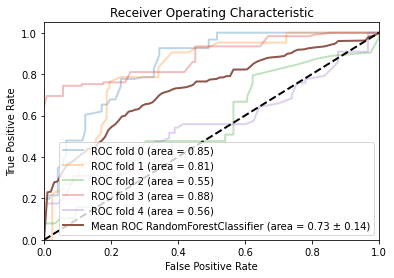

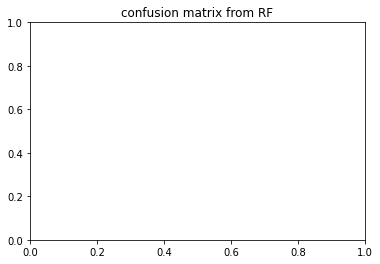

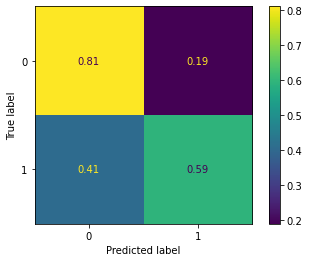

,precision,recall,f1-score,support,auc
0,0.694,0.810,0.735,122.800,0.00
1,0.761,0.594,0.638,122.800,0.00
accuracy,0.703,0.703,0.703,0.703,0.00
macro avg,0.727,0.702,0.687,245.600,0.73
weighted avg,0.727,0.703,0.687,245.600,0.73


coming from


,precision,recall,f1-score,support,auc
0,0.860215,0.655738,0.744186,122.000000,0.00000
1,0.720000,0.892562,0.797048,121.000000,0.00000
accuracy,0.773663,0.773663,0.773663,0.773663,0.00000
macro avg,0.790108,0.774150,0.770617,243.000000,0.84914
weighted avg,0.790396,0.773663,0.770508,243.000000,0.84914


,precision,recall,f1-score,support,auc
0,0.750000,0.804878,0.776471,123.000000,0.000000
1,0.794872,0.738095,0.765432,126.000000,0.000000
accuracy,0.771084,0.771084,0.771084,0.771084,0.000000
macro avg,0.772436,0.771487,0.770951,249.000000,0.809943
weighted avg,0.772706,0.771084,0.770885,249.000000,0.809943


,precision,recall,f1-score,support,auc
0,0.550633,0.713115,0.621429,122.000000,0.000000
1,0.611111,0.436508,0.509259,126.000000,0.000000
accuracy,0.572581,0.572581,0.572581,0.572581,0.000000
macro avg,0.580872,0.574811,0.565344,248.000000,0.554189
weighted avg,0.581360,0.572581,0.564439,248.000000,0.554189


,precision,recall,f1-score,support,auc
0,0.759740,0.943548,0.841727,124.000000,0.000000
1,0.923077,0.694215,0.792453,121.000000,0.000000
accuracy,0.820408,0.820408,0.820408,0.820408,0.000000
macro avg,0.841409,0.818882,0.817090,245.000000,0.881065
weighted avg,0.840409,0.820408,0.817391,245.000000,0.881065


,precision,recall,f1-score,support,auc
0,0.547619,0.934959,0.690691,123.000000,0.00000
1,0.757576,0.208333,0.326797,120.000000,0.00000
accuracy,0.576132,0.576132,0.576132,0.576132,0.00000
macro avg,0.652597,0.571646,0.508744,243.000000,0.55769
weighted avg,0.651301,0.576132,0.510990,243.000000,0.55769


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 0.5, 'n_estimators': 100}
depth_1000_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.640 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.505 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.492 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.514 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.661 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.761 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.378 total time=   0.1s
[CV 3/5] END

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.388 total time=   2.7s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.603 total time=   2.8s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.747 total time=   2.7s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.681 total time=   3.1s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.724 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.397 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.579 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.660 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.631 total time=   1.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.765 total time=   1.4s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.688 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.678 total time=   3.2s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.356 total time=   2.8s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.595 total time=   2.8s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.771 total time=   2.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.604 total time=   3.5s


<Figure size 432x288 with 0 Axes>

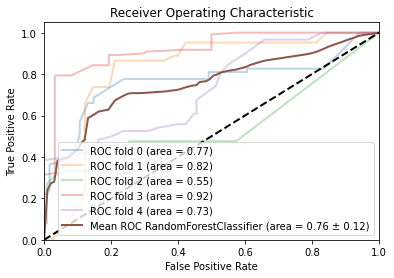

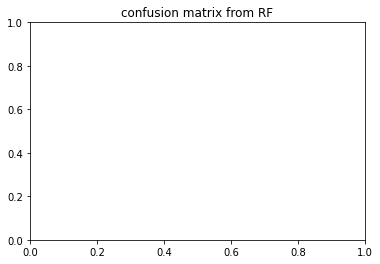

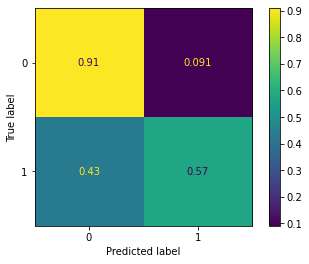

,precision,recall,f1-score,support,auc
0,0.699,0.909,0.781,122.800,0.000
1,0.899,0.574,0.664,122.800,0.000
accuracy,0.741,0.741,0.741,0.741,0.000
macro avg,0.799,0.741,0.722,245.600,0.757
weighted avg,0.799,0.741,0.722,245.600,0.757


coming from


,precision,recall,f1-score,support,auc
0,0.766129,0.778689,0.772358,122.000000,0.000000
1,0.773109,0.760331,0.766667,121.000000,0.000000
accuracy,0.769547,0.769547,0.769547,0.769547,0.000000
macro avg,0.769619,0.769510,0.769512,243.000000,0.766393
weighted avg,0.769605,0.769547,0.769524,243.000000,0.766393


,precision,recall,f1-score,support,auc
0,0.750000,0.804878,0.776471,123.000000,0.00000
1,0.794872,0.738095,0.765432,126.000000,0.00000
accuracy,0.771084,0.771084,0.771084,0.771084,0.00000
macro avg,0.772436,0.771487,0.770951,249.000000,0.81817
weighted avg,0.772706,0.771084,0.770885,249.000000,0.81817


,precision,recall,f1-score,support,auc
0,0.568075,0.991803,0.722388,122.000,0.000000
1,0.971429,0.269841,0.422360,126.000,0.000000
accuracy,0.625000,0.625000,0.625000,0.625,0.000000
macro avg,0.769752,0.630822,0.572374,248.000,0.551392
weighted avg,0.773005,0.625000,0.569955,248.000,0.551392


,precision,recall,f1-score,support,auc
0,0.794702,0.967742,0.872727,124.000000,0.000000
1,0.957447,0.743802,0.837209,121.000000,0.000000
accuracy,0.857143,0.857143,0.857143,0.857143,0.000000
macro avg,0.876074,0.855772,0.854968,245.000000,0.920221
weighted avg,0.875078,0.857143,0.855186,245.000000,0.920221


,precision,recall,f1-score,support,auc
0,0.615000,1.000000,0.761610,123.000000,0.000000
1,1.000000,0.358333,0.527607,120.000000,0.000000
accuracy,0.683128,0.683128,0.683128,0.683128,0.000000
macro avg,0.807500,0.679167,0.644609,243.000000,0.728388
weighted avg,0.805123,0.683128,0.646053,243.000000,0.728388


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': None, 'n_estimators': 50}


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.673910,0.687504,0.644396
irm1_both_APOE_one_hot,0.633344,0.697877,0.686956
irm2_both_APOE_nbr_allelle_4,0.685427,0.703342,0.689781
irm2_both_APOE_one_hot,0.693648,0.670353,0.683838
irm1_under_APOE_nbr_allelle_4,0.780211,0.755536,0.764252
irm1_under_APOE_one_hot,0.775720,0.770764,0.754687
irm2_under_APOE_nbr_allelle_4,0.681038,0.641863,0.672899
irm2_under_APOE_one_hot,0.685950,0.714278,0.653627


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.490067,0.646578,0.826257
irm1_both_APOE_one_hot,0.419322,0.890642,0.808752
irm2_both_APOE_nbr_allelle_4,0.517959,0.417050,0.642830
irm2_both_APOE_one_hot,0.456949,0.455133,0.460654
irm1_under_APOE_nbr_allelle_4,0.649974,0.484313,0.392540
irm1_under_APOE_one_hot,0.484977,0.605468,0.654829
irm2_under_APOE_nbr_allelle_4,0.760026,0.735436,0.809782
irm2_under_APOE_one_hot,0.725240,0.757553,0.829698


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.518542,0.565915,0.642471
irm1_both_APOE_one_hot,0.544014,0.662219,0.691483
irm2_both_APOE_nbr_allelle_4,0.575829,0.567445,0.630233
irm2_both_APOE_one_hot,0.530683,0.545641,0.611710
irm1_under_APOE_nbr_allelle_4,0.641047,0.643360,0.644881
irm1_under_APOE_one_hot,0.667533,0.635986,0.736676
irm2_under_APOE_nbr_allelle_4,0.682533,0.700160,0.730405
irm2_under_APOE_one_hot,0.682512,0.709700,0.756913


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.221560,0.117559,0.116253
irm1_both_APOE_one_hot,0.141963,0.120740,0.173048
irm2_both_APOE_nbr_allelle_4,0.121800,0.168872,0.168427
irm2_both_APOE_one_hot,0.171792,0.197642,0.146911
irm1_under_APOE_nbr_allelle_4,0.096312,0.088829,0.089999
irm1_under_APOE_one_hot,0.123509,0.129598,0.108835
irm2_under_APOE_nbr_allelle_4,0.109606,0.181417,0.144226
irm2_under_APOE_one_hot,0.208009,0.107625,0.121297


the score on cross_val: 


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.518542,0.565915,0.642471
irm1_both_APOE_one_hot,0.544014,0.662219,0.691483
irm2_both_APOE_nbr_allelle_4,0.575829,0.567445,0.630233
irm2_both_APOE_one_hot,0.530683,0.545641,0.611710
irm1_under_APOE_nbr_allelle_4,0.641047,0.643360,0.644881
irm1_under_APOE_one_hot,0.667533,0.635986,0.736676
irm2_under_APOE_nbr_allelle_4,0.682533,0.700160,0.730405
irm2_under_APOE_one_hot,0.682512,0.709700,0.756913


irm1_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.634 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.415 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.564 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.601 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.801 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.634 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.415 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.564 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.601 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.801 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=linear;, score=0.634 total time=   0.0s
[CV 2

<Figure size 432x288 with 0 Axes>

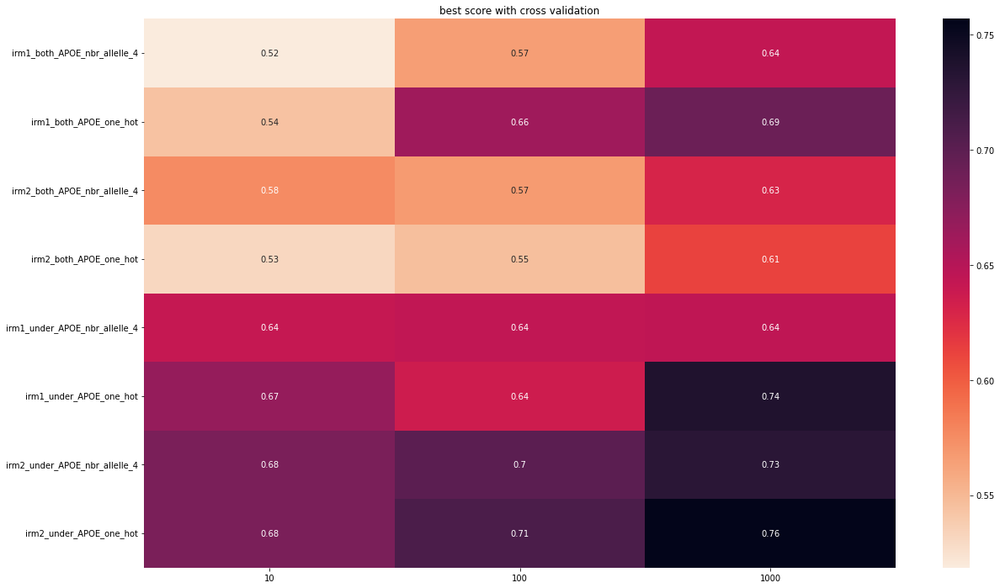

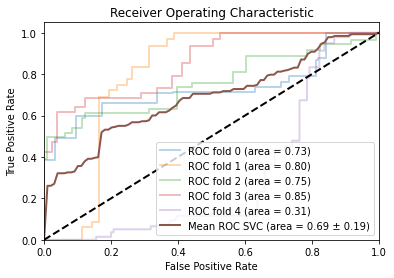

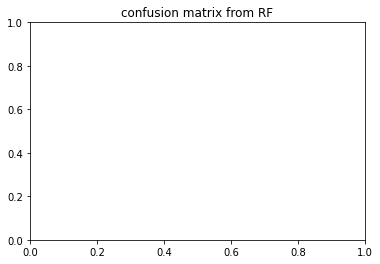

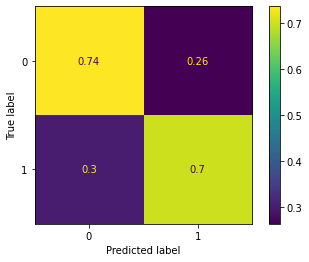

{'C': 10, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.630 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.434 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.589 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.597 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.809 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.630 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.434 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.589 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.597 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.809 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=

<Figure size 432x288 with 0 Axes>

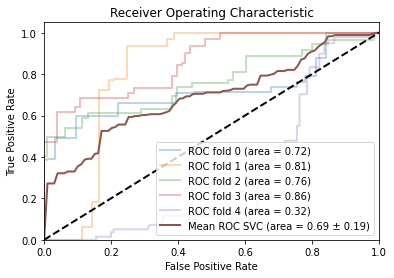

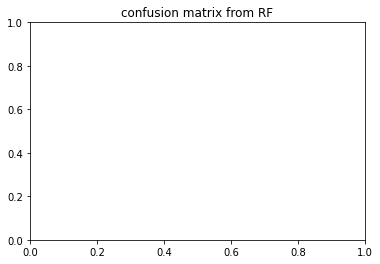

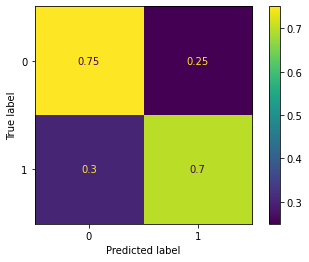

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.538 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.582 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.501 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.680 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.978 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.538 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.582 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.501 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.680 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.978 total time=   0.0s
[CV 1/5] END ..............C=100, ke

<Figure size 432x288 with 0 Axes>

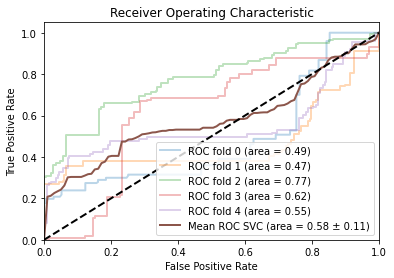

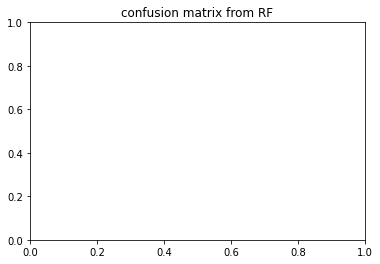

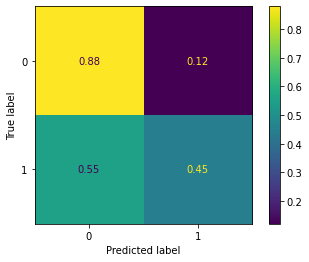

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.533 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.585 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.515 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.708 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.982 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.533 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.585 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.515 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.709 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.982 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=l

<Figure size 432x288 with 0 Axes>

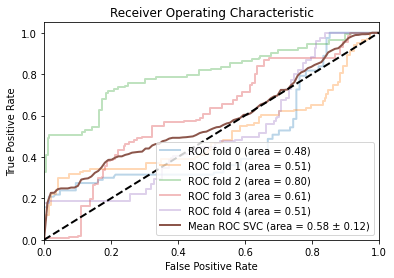

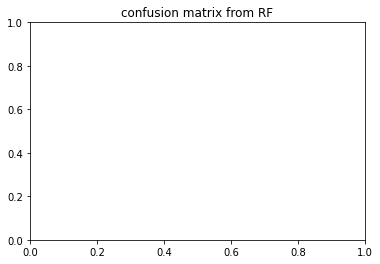

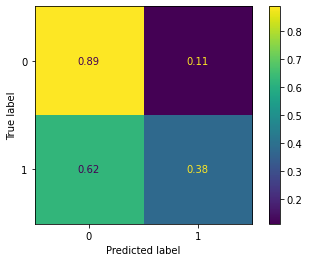

{'C': 10, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.752 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.844 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.708 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.883 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.568 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.752 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.844 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.708 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.883 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.568 total time=   0.0s
[CV 1/5] END ..............C=100, 

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

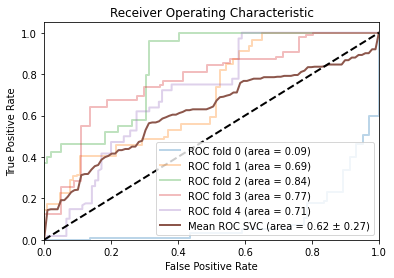

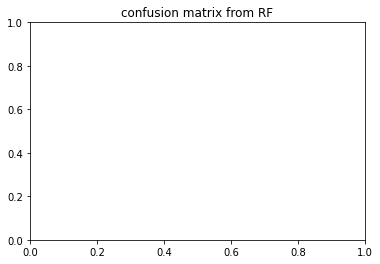

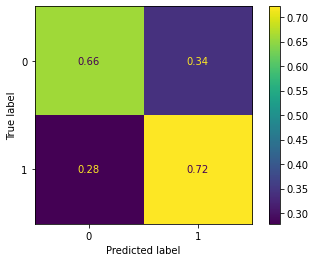

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.753 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.854 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.710 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.880 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.571 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.753 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.854 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.710 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.880 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.571 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

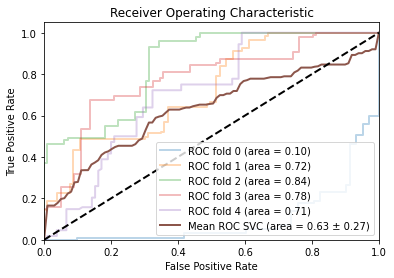

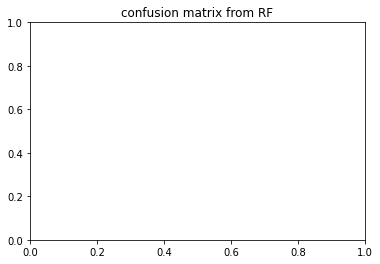

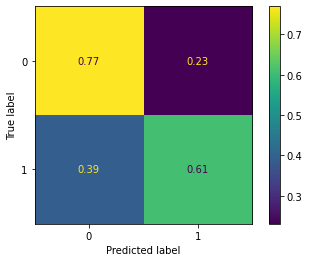

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.508 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.406 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.518 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.545 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.838 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.508 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.406 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.518 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.545 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.838 total time=   0.0s
[CV 1/5] END ..............C=100, k

<Figure size 432x288 with 0 Axes>

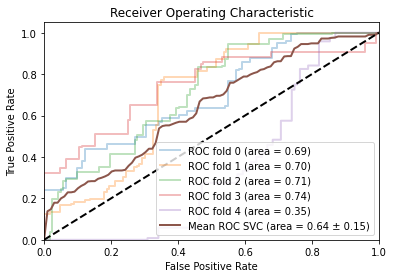

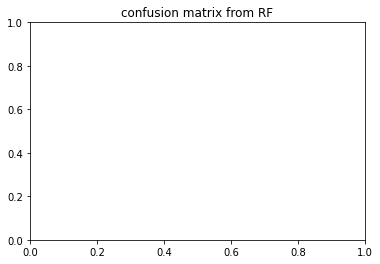

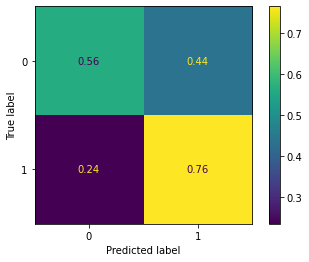

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.517 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.411 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.515 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.558 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.834 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.517 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.411 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.515 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.558 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.834 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=

<Figure size 432x288 with 0 Axes>

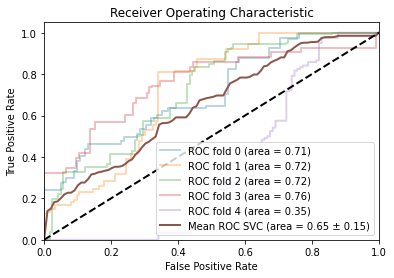

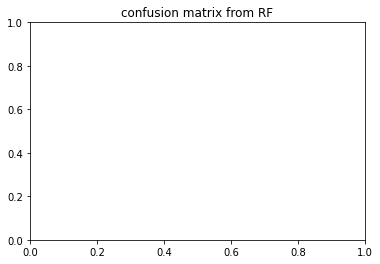

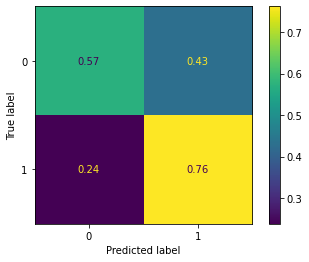

{'C': 100, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.623 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.818 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.658 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.288 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.570 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.619 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.801 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.662 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.504 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.732 total time=   0.1s
[CV 1/5] END .....C=1, gamma=0.0001, 

<Figure size 432x288 with 0 Axes>

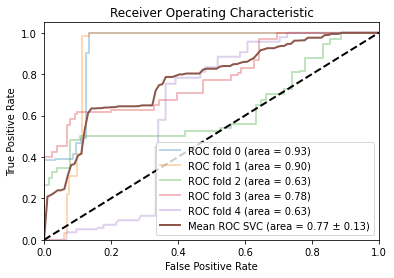

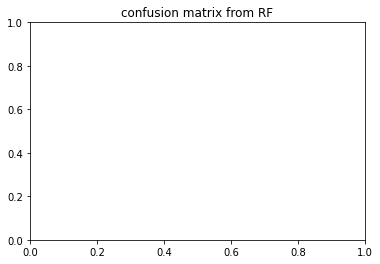

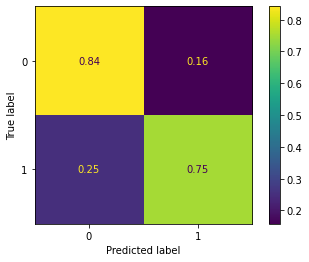

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.620 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.815 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.658 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.298 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.574 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.614 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.792 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.662 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.499 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.768 total time=   0.0s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

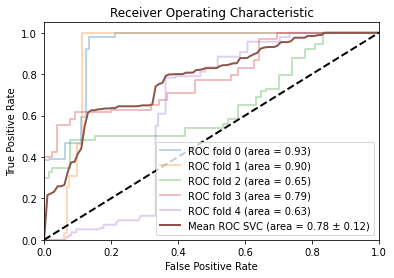

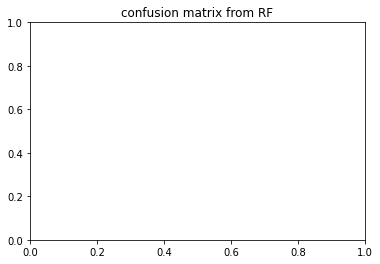

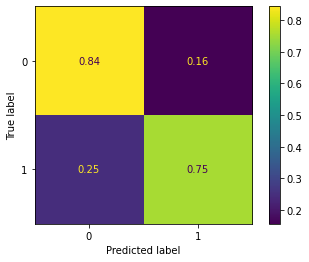

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.585 total time=   0.2s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.672 total time=   0.2s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.746 total time=   0.2s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.412 total time=   0.2s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.988 total time=   0.2s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.542 total time=   0.2s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.614 total time=   0.2s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.635 total time=   0.2s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.628 total time=   0.2s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.996 total time=   0.2s
[CV 1/5] END .....C=1, ga

<Figure size 432x288 with 0 Axes>

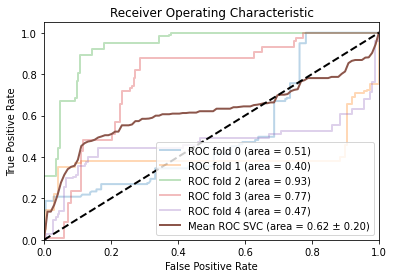

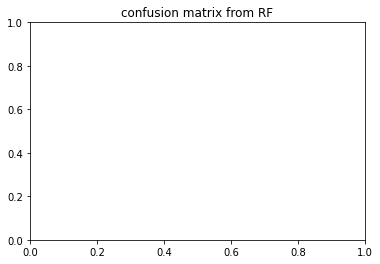

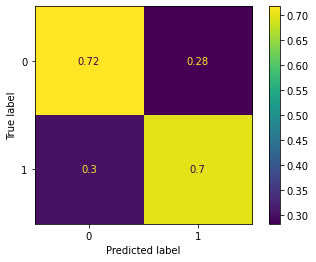

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.579 total time=   0.2s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.660 total time=   0.2s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.749 total time=   0.2s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.412 total time=   0.2s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.988 total time=   0.3s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.536 total time=   0.2s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.614 total time=   0.2s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.641 total time=   0.2s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.636 total time=   0.2s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.998 total time=   0.2s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

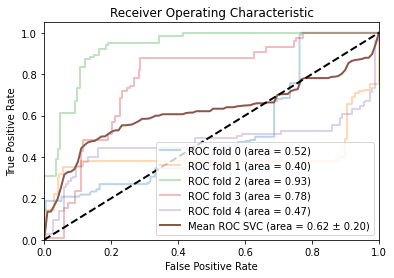

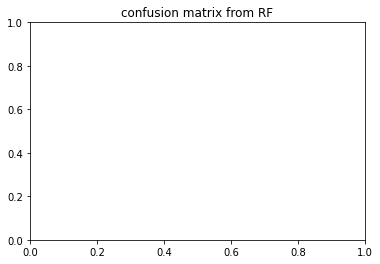

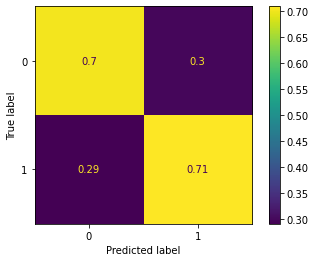

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.759 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.951 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.856 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.917 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.452 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.743 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.901 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.770 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.876 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.455 total time=   0.0s
[CV 1/5] END .....C=1, g

<Figure size 432x288 with 0 Axes>

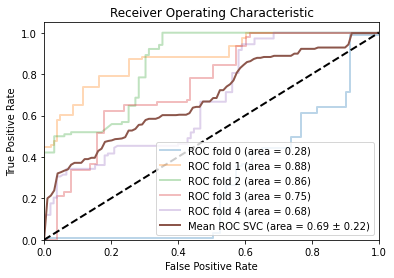

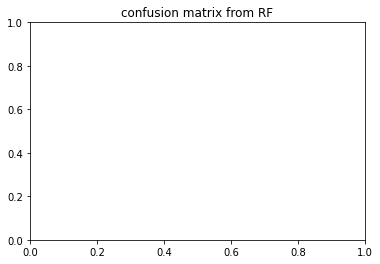

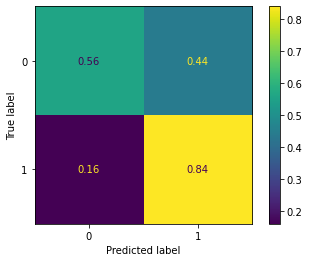

{'C': 100, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.758 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.949 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.867 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.916 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.450 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.741 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.902 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.772 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.876 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.455 total time=   0.0s
[CV 1/5] END .....C=1, gamm

<Figure size 432x288 with 0 Axes>

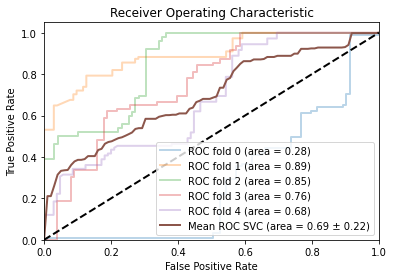

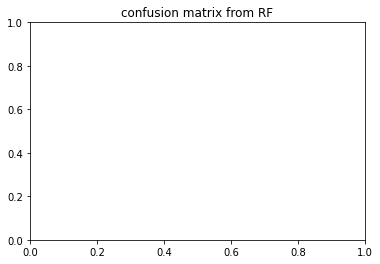

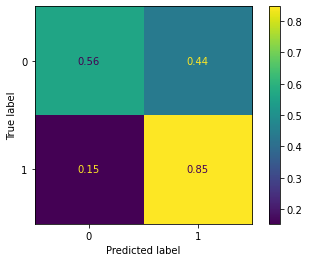

{'C': 100, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.695 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.398 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.546 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.855 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.857 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.704 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.337 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.511 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.855 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.897 total time=   0.1s
[CV 1/5] END .....C=1

<Figure size 432x288 with 0 Axes>

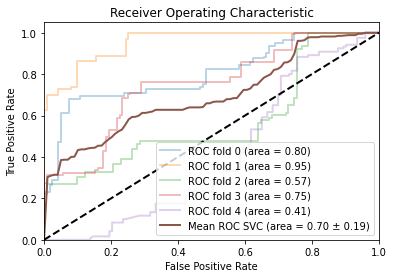

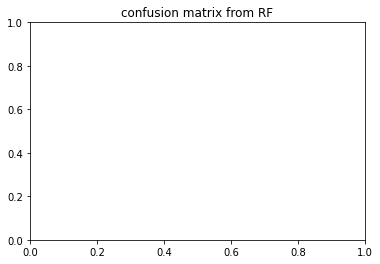

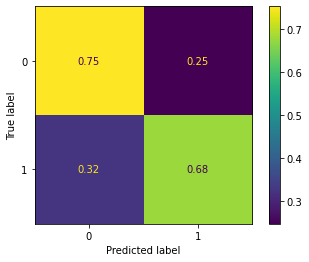

{'C': 1, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.694 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.395 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.542 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.852 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.857 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.698 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.332 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.512 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.855 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.895 total time=   0.1s
[CV 1/5] END .....C=1, gamma=

<Figure size 432x288 with 0 Axes>

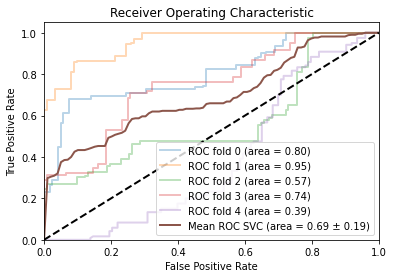

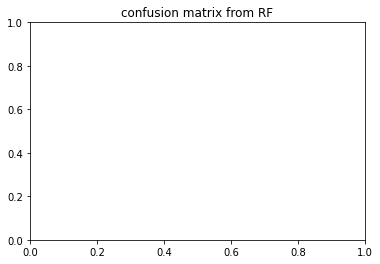

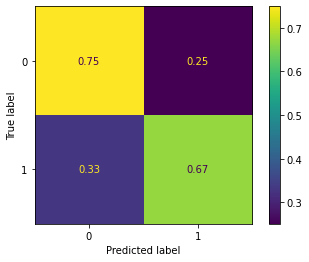

{'C': 1, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.517 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.949 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.560 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.430 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.705 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.338 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.940 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.552 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=0.001, ke

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.362 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.597 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.631 total time=   0.3s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.343 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.533 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=1.000 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.500 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.277 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.791 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.580 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.999 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.557 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.298 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.622 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.377 total time=   0.3s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.951 total time=   0.3s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.561 total time=   0.3s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.647 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.248 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.423 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.950 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.556 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.407 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.575 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.166 total time=   0.2s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.721 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.626 total time=   0.2s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.602 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.324 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.390 total time=   0.3s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.442 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.645 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.346 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.445 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=1.000 total time=   0.0s
[CV 3/5] END C=

[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.660 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.358 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.828 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.649 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.499 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.672 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.511 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.798 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.648 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.605 total time=   0.0s
[CV 3/5] END C=10,

[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.431 total time=   0.3s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.396 total time=   0.3s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.668 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.320 total time=   0.3s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.408 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.950 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.555 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.468 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.520 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.150 total time=   0.2s
[CV 2/

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.450 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.752 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.559 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.326 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.326 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.563 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.443 total time=   0.3s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.646 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.345 total time=   0.2s
[CV 1

[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.594 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.982 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.623 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.293 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.740 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.623 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.764 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.665 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.443 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.829 total time=   0.0s
[CV 1/5] E

<Figure size 432x288 with 0 Axes>

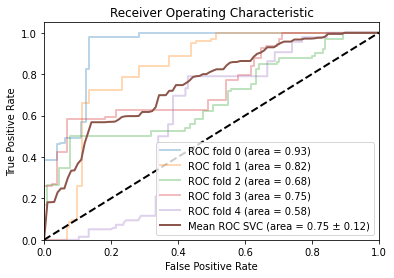

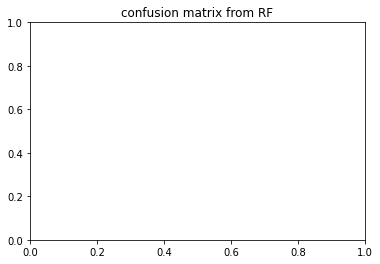

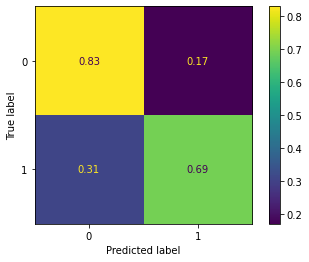

{'C': 1, 'coef0': 1.0, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.469 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.950 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.562 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.413 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.711 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.325 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.938 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.551 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, degr

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.370 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.603 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.620 total time=   0.3s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.049 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.437 total time=   0.3s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.627 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.342 total time=   0.3s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.493 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=1.000 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.549 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.285 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.765 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.572 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.999 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.557 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.299 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.629 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.616 total time=   0.3s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.049 total time=   0.3s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.439 total time=   0.3s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.642 total time=   0.3s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.409 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.950 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.560 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.402 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.579 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.162 total time=   0.2s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.717 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.631 total time=   0.2s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.607 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.327 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.511 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.608 total time=   0.3s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.048 total time=   0.3s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.442 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.644 total time=   0.3s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.345 total time=   0.3s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.427 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=1.000 total time=   0.0s
[CV 3/5] END C=

[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.660 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.375 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.831 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.627 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.537 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.673 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.508 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.810 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.634 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.671 total time=   0.0s
[CV 3/5] END C=10,

[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.434 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.418 total time=   0.3s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.668 total time=   0.3s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.335 total time=   0.3s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.392 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.951 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.556 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.419 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.546 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.145 total time=   0.2s
[CV 2/

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.433 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.742 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.566 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.334 total time=   0.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.344 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.443 total time=   0.3s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.645 total time=   0.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1

[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.566 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.987 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.628 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.305 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.739 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.614 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.774 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.667 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.451 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.831 total time=   0.0s
[CV 1/5] E

<Figure size 432x288 with 0 Axes>

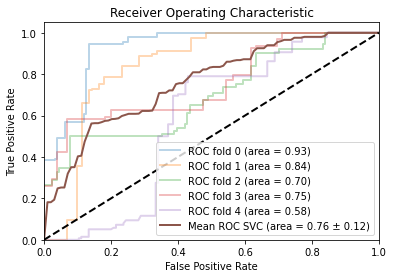

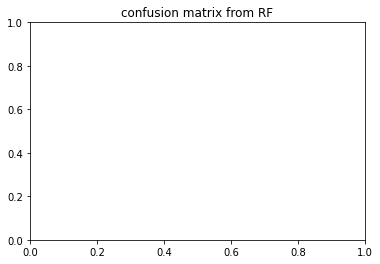

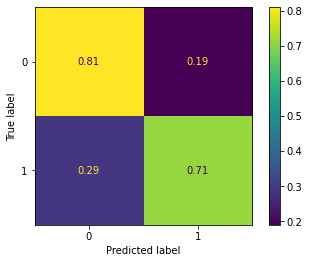

{'C': 1, 'coef0': 1.0, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.830 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.410 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.665 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.577 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.999 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.699 total time=   0.6s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.367 total time=   0.6s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.644 total time=   0.6s
[CV 4/5] END C=1, coef0=0.0

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.365 total time=   0.6s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.961 total time=   0.7s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.277 total time=   0.7s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.7s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.7s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.555 total time=   0.7s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.7s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.543 total time=   0.3s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.400 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.668 total time=   0.3s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.552 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.963 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.517 total time=   0.5s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.517 total time=   0.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.793 total time=   0.4s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.572 total time=   0.4s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.970 total time=   0.4s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.263 total time=   0.8s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.459 total time=   0.7s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.732 total time=   0.7s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.304 total time=   0.7s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.227 total time=   0.7s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.779 total time=   0.2s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.407 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.621 total time=   0.2s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.615 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.953 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.632 total time=   0.6s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.359 total time=   0.6s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.629 total time=   0.6s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.620 total time=   0.6s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.339 total time=   0.6s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.940 total time=   0.7s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.321 total time=   0.7s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.535 total time=   0.7s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.7s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.481 total time=   0.7s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.002 total time=   0.7s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.489 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.441 total time=   0.2s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.545 total time=   0.1s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.668 total time=   0.1s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.537 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.989 total time=   0.1s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.565 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.543 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.581 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.618 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.987 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.541 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.422 total time=   0.8s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.7s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.299 total time=   0.7s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.427 total time=   0.7s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.436 total time=   0.7s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.731 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.427 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.582 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.688 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.945 total time=   0.2s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.670 total time=   0.6s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.953 total time=   0.6s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.276 total time=   1.5s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.361 total time=   1.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.641 total time=   1.4s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.338 total time=   1.4s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.914 total time=   1.6s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.392 total time=   1.8s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.531 total time=   1.7s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.7s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.561 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.509 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.648 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.979 total time=   0.2s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.685 total time=   0.3s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.545 total time=   0.3s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.740 total time=   0.4s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.510 total time=   0.3s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.986 total time=   0.4s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.592 total time=   0.2s
[CV 2/

<Figure size 432x288 with 0 Axes>

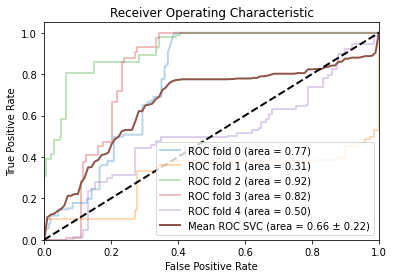

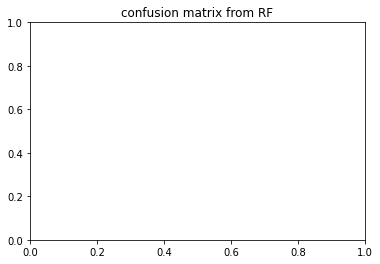

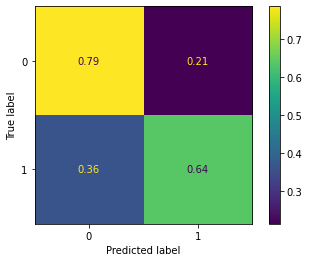

{'C': 1, 'coef0': 0.5, 'degree': 5, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.834 total time=   0.4s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.406 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.663 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.579 total time=   0.4s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=1.000 total time=   0.5s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.725 total time=   1.6s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.363 total time=   1.4s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.645 total time=   1.5s
[CV 4/5] END C=1, coef0=0.0, degr

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.364 total time=   1.8s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.961 total time=   2.0s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.276 total time=   2.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.458 total time=   2.1s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   2.1s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.445 total time=   2.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.8s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.537 total time=   0.7s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.400 total time=   0.7s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.670 total time=   0.7s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.555 total time=   0.4s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.963 total time=   0.6s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.506 total time=   1.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.502 total time=   1.0s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.792 total time=   1.0s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.573 total time=   1.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.969 total time=   1.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.735 total time=   1.8s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.458 total time=   1.8s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.732 total time=   2.0s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.299 total time=   1.8s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.231 total time=   1.7s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.793 total time=   0.5s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.401 total time=   0.5s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.624 total time=   0.5s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.620 total time=   0.4s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.959 total time=   0.6s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.708 total time=   1.4s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.354 total time=   1.7s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.631 total time=   1.5s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.620 total time=   1.6s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.338 total time=   1.6s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.942 total time=   1.6s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.326 total time=   1.8s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.7s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.727 total time=   1.7s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.7s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.003 total time=   1.8s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.491 total time=   0.6s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.438 total time=   0.5s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.526 total time=   0.3s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.672 total time=   0.2s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.542 total time=   0.3s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.991 total time=   0.3s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.560 total time=   0.1s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.539 total time=   0.2s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.591 total time=   0.2s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.627 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.988 total time=   0.2s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.540 total time=   0.3s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.402 total time=   1.8s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.8s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.8s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.427 total time=   1.8s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.437 total time=   1.7s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.758 total time=   0.5s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.420 total time=   0.5s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.582 total time=   0.6s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.691 total time=   0.5s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.946 total time=   0.6s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.671 total time=   0.6s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.953 total time=   0.6s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.278 total time=   1.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.352 total time=   1.5s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.640 total time=   1.5s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.338 total time=   1.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.927 total time=   1.5s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.391 total time=   1.8s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   1.8s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.277 total time=   1.8s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.570 total time=   0.2s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.523 total time=   0.2s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.679 total time=   0.2s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.984 total time=   0.2s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.676 total time=   0.4s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.541 total time=   0.4s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.741 total time=   0.6s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.510 total time=   0.4s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.985 total time=   0.5s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.587 total time=   0.3s
[CV 2/

<Figure size 432x288 with 0 Axes>

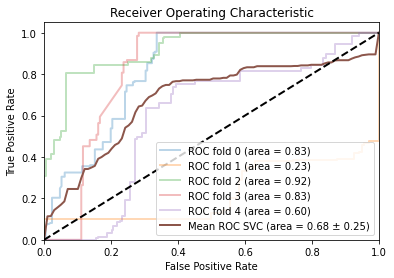

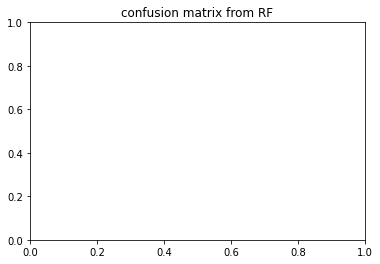

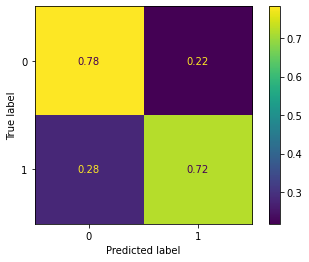

{'C': 1, 'coef0': 0.5, 'degree': 7, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.881 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.947 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.837 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.956 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.440 total time=   0.2s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.936 total time=   0.4s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.862 total time=   0.5s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.846 total time=   0.4s
[CV 4/5] END C=1, coef0=0.

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.493 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.272 total time=   0.4s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.802 total time=   0.4s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.051 total time=   0.4s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.881 total time=   0.5s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.166 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.662 total time=   0.5s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.861 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.942 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.799 total time=   0.3s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.908 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.229 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.816 total time=   0.3s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.995 total time=   0.3s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.855 total time=   0.3s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.938 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.283 total time=   0.3s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.784 total time=   0.4s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.032 total time=   0.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.317 total time=   0.4s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.719 total time=   0.4s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.888 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.955 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.828 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.928 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.392 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.833 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.863 total time=   0.4s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.833 total time=   0.4s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.809 total time=   0.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.552 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.253 total time=   0.4s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.191 total time=   0.4s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.114 total time=   0.4s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.892 total time=   0.5s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.174 total time=   0.5s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.691 total time=   0.4s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.847 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.916 total time=   0.2s
[CV 3/5] END C=

[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.765 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.953 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.375 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.742 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.926 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.750 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.906 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.503 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.765 total time=   0.1s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.890 total time=   0.1s
[CV 3/5] END C=10,

[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.548 total time=   0.4s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.191 total time=   0.4s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.326 total time=   0.4s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.714 total time=   0.4s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.874 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.930 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.802 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.890 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.367 total time=   0.3s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.787 total time=   0.3s
[CV 2/

[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.118 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.822 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.888 total time=   0.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.507 total time=   0.3s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.682 total time=   0.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.247 total time=   0.3s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.823 total time=   0.4s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.165 total time=   0.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.902 total time=   0.4s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.185 total time=   0.3s
[CV 5/

[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.778 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.887 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.588 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.775 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.969 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.818 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.969 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.342 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.749 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.951 total time=   0.0s
[CV 3/5

<Figure size 432x288 with 0 Axes>

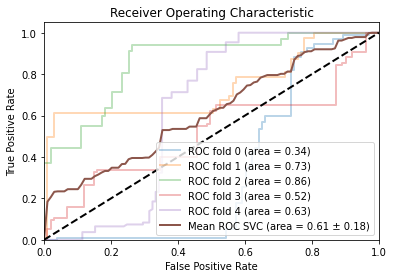

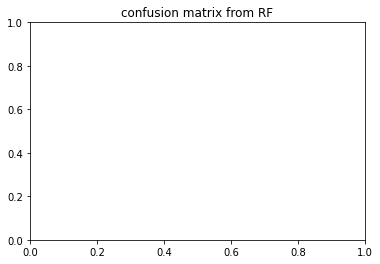

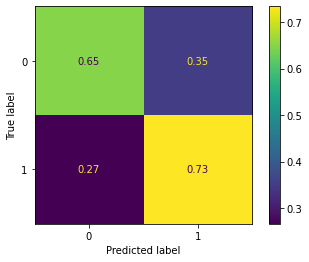

{'C': 1, 'coef0': 0.0, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm1_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.878 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.936 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.836 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.955 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.430 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.935 total time=   0.4s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.862 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.846 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, de

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.493 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.271 total time=   0.4s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.799 total time=   0.4s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.051 total time=   0.4s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.884 total time=   0.4s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.165 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.664 total time=   0.5s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.858 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.914 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.809 total time=   0.2s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.915 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.230 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.815 total time=   0.3s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.996 total time=   0.3s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.855 total time=   0.3s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.937 total time=   0.3s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.280 total time=   0.3s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.783 total time=   0.4s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.027 total time=   0.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.882 total time=   0.4s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.319 total time=   0.4s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.719 total time=   0.4s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.887 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.954 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.827 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.929 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.362 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.833 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.858 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.832 total time=   0.3s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.806 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.555 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.253 total time=   0.4s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.807 total time=   0.4s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.114 total time=   0.4s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.693 total time=   0.4s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.844 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.916 total time=   0.1s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.960 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.778 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.949 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.378 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.739 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.934 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.760 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.906 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.500 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.767 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.547 total time=   0.4s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.813 total time=   0.4s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.324 total time=   0.4s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.714 total time=   0.4s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.870 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.932 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.806 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.896 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.330 total time=   0.2s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.899 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.118 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.822 total time=   0.3s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.873 total time=   0.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.506 total time=   0.3s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.684 total time=   0.3s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.248 total time=   0.4s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.178 total time=   0.4s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.163 total time=   0.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.896 total time=   0.4s
[CV 4/5

[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.885 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.585 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.774 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.963 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.824 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.966 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.346 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.751 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.955 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.759 total time=   0.0s
[CV 4/5]

<Figure size 432x288 with 0 Axes>

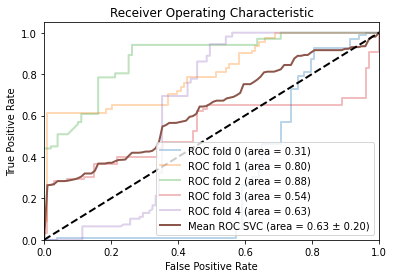

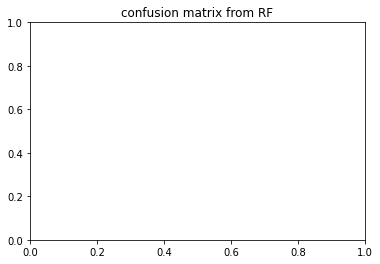

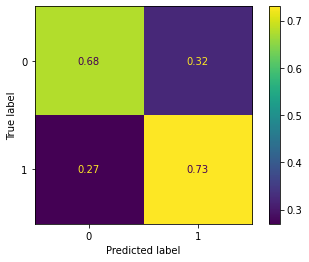

{'C': 100, 'coef0': 0.0, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.812 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.352 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.512 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.771 total time=   0.2s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.912 total time=   0.2s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.876 total time=   0.6s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.206 total time=   0.6s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.555 total time=   0.6s
[CV 4/5] END C=1, coef0

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.585 total time=   0.5s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.588 total time=   0.6s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.141 total time=   0.6s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.640 total time=   0.4s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.515 total time=   0.5s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.325 total time=   0.6s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.075 total time=   0.6s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.650 total time=   0.3s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.549 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.487 total time=   0.4s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.869 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.909 total time=   0.3s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.603 total time=   0.6s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.389 total time=   0.5s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.539 total time=   0.5s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.820 total time=   0.4s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.904 total time=   0.5s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.135 total time=   0.6s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.646 total time=   0.6s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.517 total time=   0.7s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.354 total time=   0.6s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.782 total time=   0.2s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.514 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.503 total time=   0.3s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.788 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.903 total time=   0.3s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.886 total time=   0.5s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.231 total time=   0.6s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.571 total time=   0.5s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.563 total time=   0.6s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.645 total time=   0.6s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.499 total time=   0.6s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.146 total time=   0.5s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.639 total time=   0.7s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.511 total time=   0.6s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.324 total time=   0.6s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.075 total time=   0.6s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.621 total time=   0.4s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.599 total time=   0.3s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.398 total time=   0.1s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.544 total time=   0.1s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.817 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.883 total time=   0.1s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.672 total time=   0.1s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.416 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.508 total time=   0.1s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.746 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.875 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.726 total time=   0.1s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.247 total time=   0.6s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.746 total time=   0.5s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.486 total time=   0.7s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.378 total time=   0.6s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.542 total time=   0.6s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.718 total time=   0.4s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.513 total time=   0.3s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.464 total time=   0.3s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.804 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.885 total time=   0.3s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.862 total time=   0.4s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.903 total time=   0.4s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.605 total time=   0.6s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.239 total time=   0.6s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.597 total time=   0.6s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.688 total time=   0.6s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.764 total time=   0.6s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.158 total time=   0.6s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.635 total time=   0.7s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.511 total time=   0.6s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.444 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.453 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.673 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.881 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.785 total time=   0.2s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.402 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.553 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.826 total time=   0.2s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.905 total time=   0.2s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.696 total time=   0.1s
[CV 2/

<Figure size 432x288 with 0 Axes>

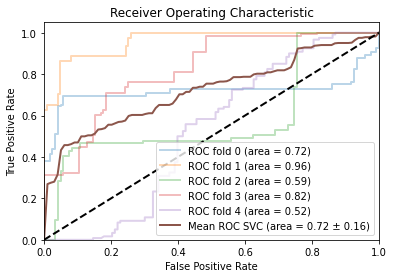

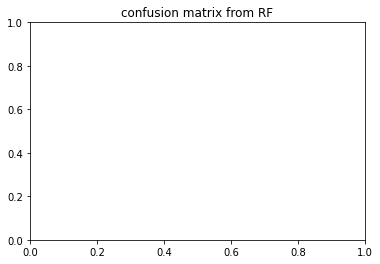

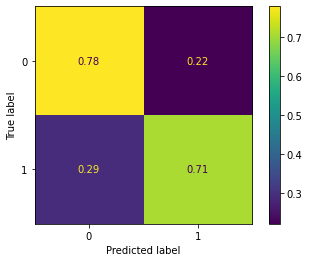

{'C': 10, 'coef0': 0.5, 'degree': 9, 'gamma': 0.001, 'kernel': 'poly', 'probability': True}
irm2_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.815 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.349 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.508 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.773 total time=   0.2s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.913 total time=   0.2s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.871 total time=   0.6s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.209 total time=   0.6s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.555 total time=   0.6s
[CV 4/5] END C=1, coef0=0.0, deg

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.585 total time=   0.6s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.596 total time=   0.6s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.142 total time=   0.6s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.641 total time=   0.5s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.515 total time=   0.7s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.325 total time=   0.6s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.077 total time=   0.6s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.663 total time=   0.4s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.553 total time=   0.3s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.488 total time=   0.4s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.867 total time=   0.3s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.908 total time=   0.3s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.602 total time=   0.5s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.388 total time=   0.5s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.542 total time=   0.5s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.817 total time=   0.5s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.898 total time=   0.5s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.646 total time=   0.7s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.517 total time=   0.6s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.348 total time=   0.6s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.787 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.511 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.504 total time=   0.3s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.788 total time=   0.3s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.902 total time=   0.3s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.891 total time=   0.6s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.238 total time=   0.5s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.569 total time=   0.6s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.562 total time=   0.5s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.642 total time=   0.6s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.520 total time=   0.6s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.149 total time=   0.5s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.639 total time=   0.7s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.512 total time=   0.5s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.324 total time=   0.6s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.7s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.619 total time=   0.4s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.595 total time=   0.3s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.396 total time=   0.1s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.542 total time=   0.1s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.815 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.887 total time=   0.1s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.674 total time=   0.1s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.415 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.506 total time=   0.1s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.750 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.875 total time=   0.1s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.723 total time=   0.1s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.246 total time=   0.7s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.738 total time=   0.7s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.488 total time=   0.6s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.363 total time=   0.6s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.544 total time=   0.6s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.738 total time=   0.3s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.519 total time=   0.3s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.472 total time=   0.3s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.802 total time=   0.4s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.883 total time=   0.4s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.861 total time=   0.4s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.903 total time=   0.3s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.614 total time=   0.6s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.241 total time=   0.5s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.492 total time=   0.5s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.684 total time=   0.6s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.782 total time=   0.5s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.161 total time=   0.6s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.632 total time=   0.7s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.510 total time=   0.6s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.443 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.449 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.678 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.878 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.757 total time=   0.2s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.397 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.553 total time=   0.2s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.821 total time=   0.2s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.904 total time=   0.2s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.699 total time=   0.1s
[CV 2/

<Figure size 432x288 with 0 Axes>

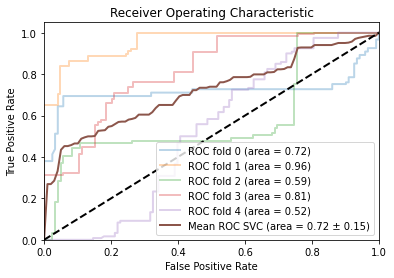

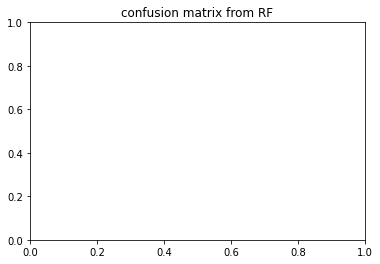

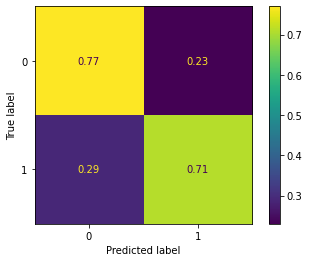

{'C': 10, 'coef0': 0.5, 'degree': 9, 'gamma': 0.001, 'kernel': 'poly', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.373 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.570 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.293 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.534 total time=   0.2s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.668 total time=   0.2s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.632 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.785 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.560 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.612 total time

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.825 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.353 total time=   0.2s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.461 total time=   0.2s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.739 total time=   0.2s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.830 total time=   0.2s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.867 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.684 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.312 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.250 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.591 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.694 total time=   0.1

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.700 total time=   0.1s
{'C': 100, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

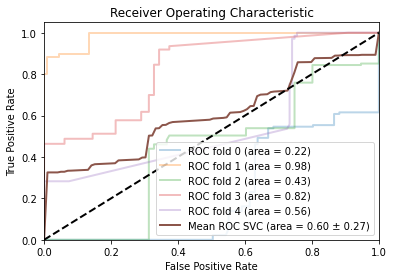

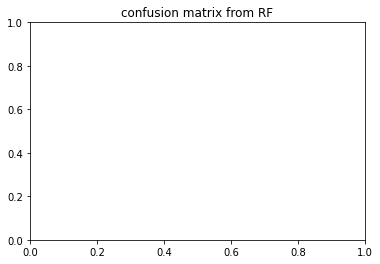

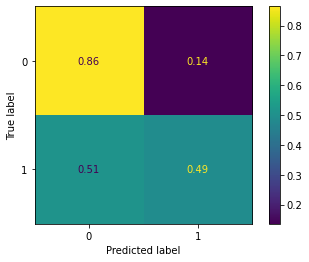

{'C': 100, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm1_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.373 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.589 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.300 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.526 total time=   0.2s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.702 total time=   0.3s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.622 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.794 total time=   0.3s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.576 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.616 total time=   0.3s
[CV 

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.842 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.349 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.475 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.760 total time=   0.2s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.832 total time=   0.2s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.840 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.675 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.334 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.276 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.563 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.709 total time=   0.1

{'C': 100, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

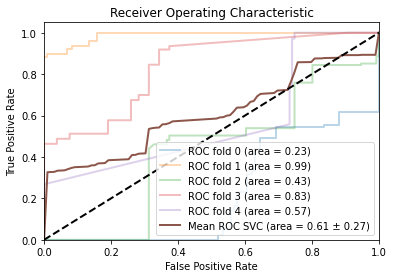

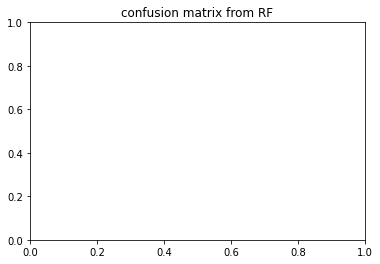

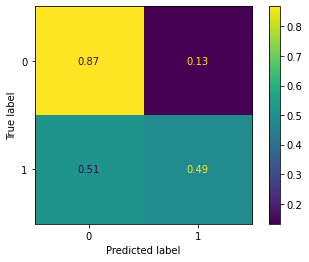

{'C': 100, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.421 total time=   0.4s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.908 total time=   0.6s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.658 total time=   0.5s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.854 total time=   0.5s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.975 total time=   0.7s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.535 total time=   0.6s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.594 total time=   0.6s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.531 total time=   0.7s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.756 total time=   0.6

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.992 total time=   0.7s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.731 total time=   0.5s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.659 total time=   0.6s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.840 total time=   0.6s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.981 total time=   0.7s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.487 total time=   0.7s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.579 total time=   0.2s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.752 total time=   0.3s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.808 total time=   0.3s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.981 total time=   0.2s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.913 total time=   0.2

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.984 total time=   0.4s
{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

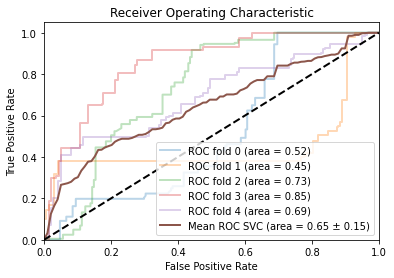

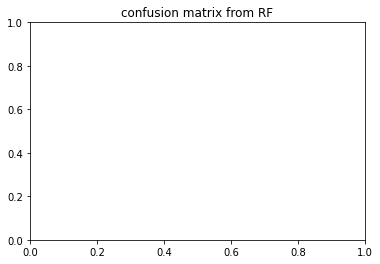

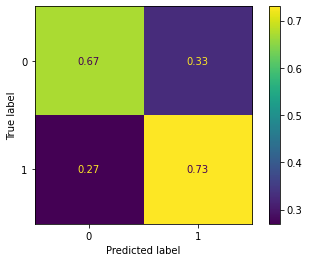

{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.414 total time=   0.4s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.909 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.660 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.849 total time=   0.5s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.971 total time=   0.7s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.529 total time=   0.6s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.579 total time=   0.7s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.544 total time=   0.6s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.765 total time=   0.5s
[CV 5/5]

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.992 total time=   0.7s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.733 total time=   0.6s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.659 total time=   0.5s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.833 total time=   0.7s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.979 total time=   0.7s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.489 total time=   0.7s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.581 total time=   0.2s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.746 total time=   0.3s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.808 total time=   0.4s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.980 total time=   0.4s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.912 total time=   0.3

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.990 total time=   0.4s
{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

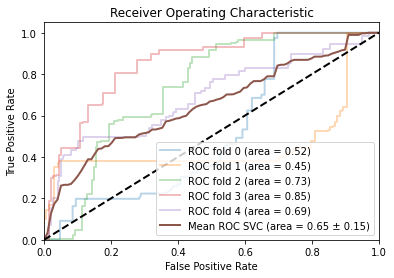

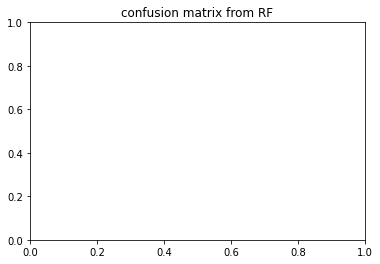

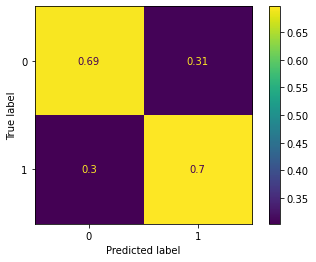

{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.597 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.895 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.594 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.752 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.567 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.784 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.889 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.768 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.861 total time=   0.2s
[

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.601 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.607 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.612 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.635 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.919 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.801 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.684 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.768 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.693 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.872 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.796 total time=   0.0

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.616 total time=   0.1s
{'C': 100, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

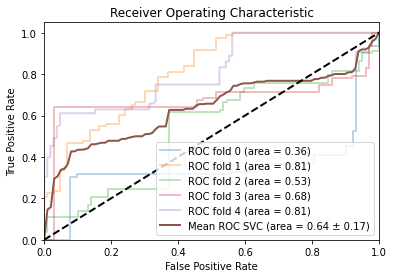

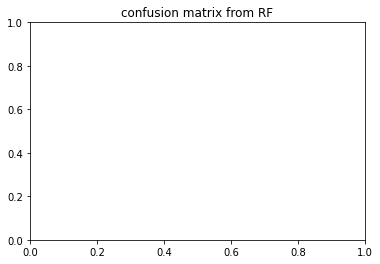

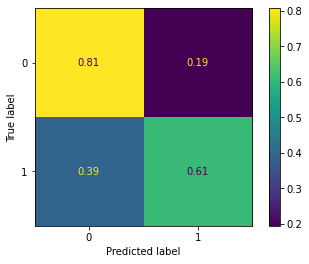

{'C': 100, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.599 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.901 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.597 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.729 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.563 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.786 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.895 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.769 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.860 total time=   0.1s
[CV 5

[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.764 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.451 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.854 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.919 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.801 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.703 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.779 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.693 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.873 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.795 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.794 total time=   0.2

{'C': 100, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

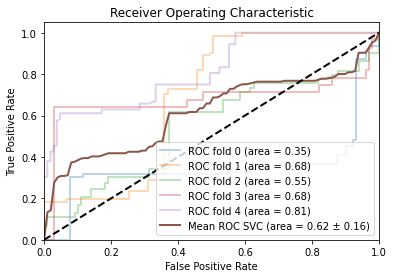

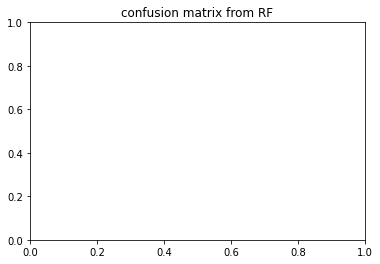

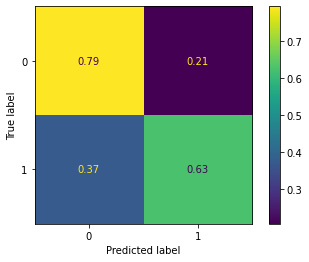

{'C': 100, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.856 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.415 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.611 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.810 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.864 total time=   0.2s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.753 total time=   0.4s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.282 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.499 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.832 total time=   0.4s

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.901 total time=   0.3s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.917 total time=   0.2s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.509 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.609 total time=   0.2s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.917 total time=   0.2s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.746 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.657 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.234 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.511 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.888 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.785 total time=   0.1

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.910 total time=   0.2s
{'C': 100, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

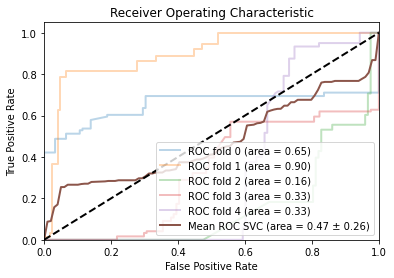

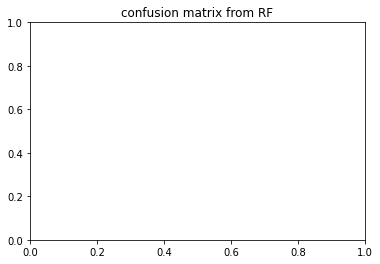

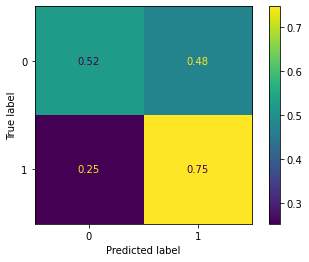

{'C': 100, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.860 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.372 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.611 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.806 total time=   0.2s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.855 total time=   0.2s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.745 total time=   0.3s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.275 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.491 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.822 total time=   0.3s
[CV

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.897 total time=   0.3s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.918 total time=   0.2s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.503 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.611 total time=   0.3s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.908 total time=   0.2s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.844 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.651 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.234 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.514 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.885 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.774 total time=   0.1

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.907 total time=   0.1s
{'C': 100, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

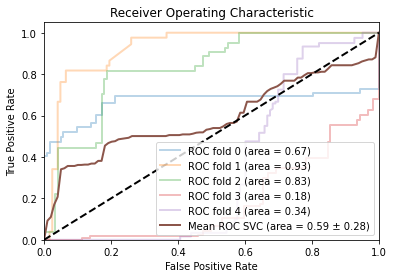

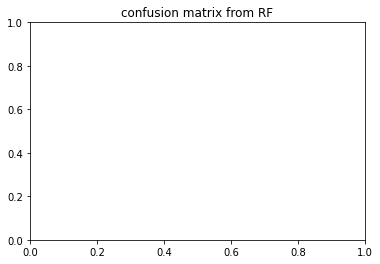

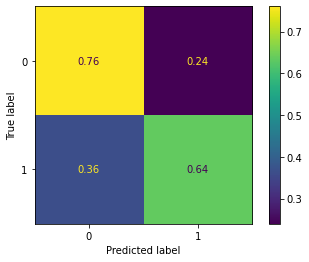

{'C': 100, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.603155,0.721183,0.721215,0.770330
irm1_both_APOE_one_hot,0.612003,0.723587,0.725642,0.763108
irm2_both_APOE_nbr_allelle_4,0.655897,0.690500,0.714314,0.838160
irm2_both_APOE_one_hot,0.664719,0.689770,0.714914,0.835173
irm1_under_APOE_nbr_allelle_4,0.751086,0.791399,0.812035,0.819066
irm1_under_APOE_one_hot,0.753535,0.794352,0.808675,0.820964
irm2_under_APOE_nbr_allelle_4,0.562865,0.670013,0.701796,0.746683
irm2_under_APOE_one_hot,0.566700,0.668159,0.698500,0.761989


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.731375,0.925379,0.927559,0.222350
irm1_both_APOE_one_hot,0.722047,0.927680,0.927377,0.225318
irm2_both_APOE_nbr_allelle_4,0.486359,0.513328,0.767472,0.517971
irm2_both_APOE_one_hot,0.481981,0.516407,0.825859,0.518981
irm1_under_APOE_nbr_allelle_4,0.091978,0.279918,0.335411,0.355340
irm1_under_APOE_one_hot,0.099642,0.280736,0.306081,0.350128
irm2_under_APOE_nbr_allelle_4,0.693605,0.804803,0.717721,0.653502
irm2_under_APOE_one_hot,0.707357,0.803685,0.718060,0.667389


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.689686,0.773215,0.751975,0.603496
irm1_both_APOE_one_hot,0.694103,0.779648,0.760941,0.608923
irm2_both_APOE_nbr_allelle_4,0.578858,0.618165,0.662920,0.648099
irm2_both_APOE_one_hot,0.581209,0.617990,0.678906,0.649908
irm1_under_APOE_nbr_allelle_4,0.619818,0.689722,0.614131,0.637077
irm1_under_APOE_one_hot,0.630726,0.693373,0.632117,0.614746
irm2_under_APOE_nbr_allelle_4,0.640522,0.697659,0.721835,0.472829
irm2_under_APOE_one_hot,0.651047,0.692744,0.719441,0.588752


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.689686,0.773215,0.751975,0.603496
irm1_both_APOE_one_hot,0.694103,0.779648,0.760941,0.608923
irm2_both_APOE_nbr_allelle_4,0.578858,0.618165,0.662920,0.648099
irm2_both_APOE_one_hot,0.581209,0.617990,0.678906,0.649908
irm1_under_APOE_nbr_allelle_4,0.619818,0.689722,0.614131,0.637077
irm1_under_APOE_one_hot,0.630726,0.693373,0.632117,0.614746
irm2_under_APOE_nbr_allelle_4,0.640522,0.697659,0.721835,0.472829
irm2_under_APOE_one_hot,0.651047,0.692744,0.719441,0.588752


the score on cross_val: 


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.689686,0.773215,0.751975,0.603496
irm1_both_APOE_one_hot,0.694103,0.779648,0.760941,0.608923
irm2_both_APOE_nbr_allelle_4,0.578858,0.618165,0.662920,0.648099
irm2_both_APOE_one_hot,0.581209,0.617990,0.678906,0.649908
irm1_under_APOE_nbr_allelle_4,0.619818,0.689722,0.614131,0.637077
irm1_under_APOE_one_hot,0.630726,0.693373,0.632117,0.614746
irm2_under_APOE_nbr_allelle_4,0.640522,0.697659,0.721835,0.472829
irm2_under_APOE_one_hot,0.651047,0.692744,0.719441,0.588752


here: 250
irm1_both
0    658
1    658
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_both_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST11SV,irmL_ST12SV,irmL_ST13TA,...,neuro_moca_SERIAL5,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_YEAR,neuro_moca_PLACE,age,APOE_nbr_allelle_4
0,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,-0.664565,0.081552,1.546318,...,1.0,1.0,1.0,1.750166,1.0,1.0,1.0,1.0,1.308682,0.0
1,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,-1.047400,1.214602,-0.573316,...,1.0,1.0,1.0,-0.358815,1.0,1.0,1.0,1.0,0.129191,1.0
2,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,0.402731,-0.564393,1.908969,...,1.0,1.0,0.0,1.117472,1.0,1.0,1.0,1.0,-0.376305,0.0
3,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,2.119685,1.648762,1.296214,...,1.0,1.0,1.0,-0.358815,1.0,1.0,1.0,1.0,0.634687,0.0
4,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,-0.200524,-1.146802,-0.091865,...,1.0,1.0,1.0,-1.413306,1.0,1.0,1.0,1.0,2.319674,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,0.228715,-0.797357,0.358323,...,1.0,1.0,1.0,-1.413306,1.0,1.0,1.0,1.0,1.140183,0.0
1312,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,0.170710,-0.304956,-0.298201,...,1.0,0.0,1.0,1.750166,1.0,1.0,1.0,1.0,0.971684,0.0
1313,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,-0.536954,0.118614,-0.985988,...,1.0,1.0,1.0,-0.147917,1.0,1.0,1.0,1.0,-1.555796,1.0
1314,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,-0.420943,0.187444,1.871454,...,0.0,1.0,0.0,-2.046001,1.0,0.0,1.0,1.0,0.129191,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_both_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST11SV,irmL_ST12SV,irmL_ST13TA,...,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_YEAR,neuro_moca_PLACE,age,APOE_33,APOE_34
0,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,-0.664565,0.081552,1.546318,...,1.0,1.0,1.750166,1.0,1.0,1.0,1.0,1.308682,1.0,0.0
1,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,-1.047400,1.214602,-0.573316,...,1.0,1.0,-0.358815,1.0,1.0,1.0,1.0,0.129191,0.0,1.0
2,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,0.402731,-0.564393,1.908969,...,1.0,0.0,1.117472,1.0,1.0,1.0,1.0,-0.376305,1.0,0.0
3,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,2.119685,1.648762,1.296214,...,1.0,1.0,-0.358815,1.0,1.0,1.0,1.0,0.634687,1.0,0.0
4,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,-0.200524,-1.146802,-0.091865,...,1.0,1.0,-1.413306,1.0,1.0,1.0,1.0,2.319674,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,0.228715,-0.797357,0.358323,...,1.0,1.0,-1.413306,1.0,1.0,1.0,1.0,1.140183,1.0,0.0
1312,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,0.170710,-0.304956,-0.298201,...,0.0,1.0,1.750166,1.0,1.0,1.0,1.0,0.971684,1.0,0.0
1313,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,-0.536954,0.118614,-0.985988,...,1.0,1.0,-0.147917,1.0,1.0,1.0,1.0,-1.555796,0.0,1.0
1314,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,-0.420943,0.187444,1.871454,...,1.0,0.0,-2.046001,1.0,0.0,1.0,1.0,0.129191,0.0,1.0


irm2_both
0    1000
1    1000
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_both_APOE_nbr_allelle_4


,irmC_ST102CV,irmC_ST102SA,irmC_ST103TA,irmC_ST104SA_ST104CV,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,irmC_ST106CV,...,neuro_moca_IMMT2W4,neuro_moca_LETTERS,neuro_moca_SERIAL5,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW4,age,APOE_nbr_allelle_4
0,-1.740922,-1.278593,-1.367214,-0.698074,-1.544192,0.617436,1.799995,2.383053,-0.400343,-0.413629,...,1.0,-0.425038,1.0,1.0,1.403416,1.0,1.0,1.514540,-0.214656,0.0
1,0.570305,-0.494554,-0.002669,2.413644,1.313484,-0.638077,0.654591,-0.270465,1.530761,1.759307,...,1.0,-0.425038,1.0,1.0,1.206528,1.0,1.0,-0.646773,-0.687641,1.0
2,0.216984,1.052334,-0.906156,-0.647913,0.198744,-0.827079,-0.359226,-0.764643,1.560624,0.158725,...,1.0,-0.425038,1.0,1.0,1.009640,1.0,1.0,1.514540,-0.214656,0.0
3,-0.413528,0.003417,1.366534,0.844812,-0.281641,1.629946,0.277774,-0.367152,0.475622,1.307449,...,1.0,-0.425038,1.0,1.0,2.190967,1.0,1.0,0.433884,-1.318288,0.0
4,0.582017,0.368949,0.109103,0.346661,1.615264,0.846938,0.848981,0.900520,0.246676,0.249096,...,1.0,-0.425038,1.0,1.0,1.403416,1.0,1.0,-0.646773,-1.160626,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.466234,-0.542232,0.057874,-0.518186,-1.371746,-0.638077,-0.586513,-0.710928,0.072479,-1.813386,...,1.0,-0.425038,1.0,1.0,0.222089,1.0,1.0,-1.727429,1.046637,0.0
1996,1.360886,0.623232,-0.924784,-1.365735,-0.503357,1.400444,-0.619409,-0.743157,-0.937867,-0.439736,...,1.0,-0.425038,0.0,1.0,1.206528,1.0,1.0,-0.646773,-0.372318,1.0
1997,0.263833,0.241807,0.276761,-0.665210,0.365031,0.023429,-0.404085,-0.496068,0.077456,-0.007961,...,1.0,0.950490,0.0,1.0,-1.156125,1.0,1.0,-0.646773,0.573652,1.0
1998,-1.838525,-1.426925,-0.817670,-1.919237,-1.396381,0.387933,-1.277344,-1.602596,-0.246054,0.694930,...,1.0,-0.425038,1.0,1.0,-1.549900,1.0,1.0,0.433884,1.046637,0.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_both_APOE_one_hot


,irmC_ST102CV,irmC_ST102SA,irmC_ST103TA,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,irmC_ST106CV,irmC_ST106TA,...,neuro_moca_LETTERS,neuro_moca_SERIAL5,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW4,age,APOE_33,APOE_34
0,-1.740922,-1.278593,-1.367214,-1.544192,0.617436,1.799995,2.383053,-0.400343,-0.413629,-0.612860,...,-0.425038,1.0,1.0,1.403416,1.0,1.0,1.514540,-0.214656,1.0,0.0
1,0.570305,-0.494554,-0.002669,1.313484,-0.638077,0.654591,-0.270465,1.530761,1.759307,0.943728,...,-0.425038,1.0,1.0,1.206528,1.0,1.0,-0.646773,-0.687641,0.0,1.0
2,0.216984,1.052334,-0.906156,0.198744,-0.827079,-0.359226,-0.764643,1.560624,0.158725,1.131592,...,-0.425038,1.0,1.0,1.009640,1.0,1.0,1.514540,-0.214656,1.0,0.0
3,-0.413528,0.003417,1.366534,-0.281641,1.629946,0.277774,-0.367152,0.475622,1.307449,0.219110,...,-0.425038,1.0,1.0,2.190967,1.0,1.0,0.433884,-1.318288,0.0,0.0
4,0.582017,0.368949,0.109103,1.615264,0.846938,0.848981,0.900520,0.246676,0.249096,1.077917,...,-0.425038,1.0,1.0,1.403416,1.0,1.0,-0.646773,-1.160626,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.466234,-0.542232,0.057874,-1.371746,-0.638077,-0.586513,-0.710928,0.072479,-1.813386,-0.874527,...,-0.425038,1.0,1.0,0.222089,1.0,1.0,-1.727429,1.046637,1.0,0.0
1996,1.360886,0.623232,-0.924784,-0.503357,1.400444,-0.619409,-0.743157,-0.937867,-0.439736,-1.371025,...,-0.425038,0.0,1.0,1.206528,1.0,1.0,-0.646773,-0.372318,0.0,1.0
1997,0.263833,0.241807,0.276761,0.365031,0.023429,-0.404085,-0.496068,0.077456,-0.007961,0.480778,...,0.950490,0.0,1.0,-1.156125,1.0,1.0,-0.646773,0.573652,0.0,1.0
1998,-1.838525,-1.426925,-0.817670,-1.396381,0.387933,-1.277344,-1.602596,-0.246054,0.694930,-1.357606,...,-0.425038,1.0,1.0,-1.549900,1.0,1.0,0.433884,1.046637,1.0,0.0


irm1_under
0    511
1    511
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_under_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST11SV,irmL_ST12SV,irmL_ST13TA,...,neuro_moca_SERIAL5,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_YEAR,neuro_moca_PLACE,age,APOE_nbr_allelle_4
0,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,-0.637348,0.061876,1.516656,...,1.0,1.0,1.0,1.769759,1.0,1.0,1.0,1.0,1.290915,0.0
1,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,-1.025712,1.201759,-0.559595,...,1.0,1.0,1.0,-0.344436,1.0,1.0,1.0,1.0,0.110546,1.0
2,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,0.445365,-0.587965,1.871885,...,1.0,1.0,0.0,1.135501,1.0,1.0,1.0,1.0,-0.395326,0.0
3,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,2.187121,1.638537,1.271671,...,1.0,1.0,1.0,-0.344436,1.0,1.0,1.0,1.0,0.616419,0.0
4,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,-0.166603,-1.173886,-0.087998,...,1.0,1.0,1.0,-1.401533,1.0,1.0,1.0,1.0,2.302660,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,-0.637348,-1.514786,-0.124746,...,1.0,1.0,1.0,0.289823,1.0,1.0,1.0,1.0,-1.238447,1.0
1018,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.108093,-1.924931,-2.476606,...,1.0,1.0,1.0,0.289823,1.0,1.0,1.0,1.0,-1.069823,1.0
1019,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.108093,-1.924931,-2.476606,...,1.0,1.0,1.0,-0.344436,1.0,1.0,1.0,1.0,-1.069823,1.0
1020,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,-1.414077,-1.669256,-0.547346,...,1.0,1.0,1.0,0.924081,1.0,1.0,1.0,1.0,-0.901199,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_under_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST11SV,irmL_ST12SV,irmL_ST13TA,...,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_YEAR,neuro_moca_PLACE,age,APOE_33,APOE_34
0,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,-0.637348,0.061876,1.516656,...,1.0,1.0,1.769759,1.0,1.0,1.0,1.0,1.290915,1.0,0.0
1,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,-1.025712,1.201759,-0.559595,...,1.0,1.0,-0.344436,1.0,1.0,1.0,1.0,0.110546,0.0,1.0
2,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,0.445365,-0.587965,1.871885,...,1.0,0.0,1.135501,1.0,1.0,1.0,1.0,-0.395326,1.0,0.0
3,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,2.187121,1.638537,1.271671,...,1.0,1.0,-0.344436,1.0,1.0,1.0,1.0,0.616419,1.0,0.0
4,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,-0.166603,-1.173886,-0.087998,...,1.0,1.0,-1.401533,1.0,1.0,1.0,1.0,2.302660,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,-0.637348,-1.514786,-0.124746,...,1.0,1.0,0.289823,1.0,1.0,1.0,1.0,-1.238447,0.0,1.0
1018,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.108093,-1.924931,-2.476606,...,1.0,1.0,0.289823,1.0,1.0,1.0,1.0,-1.069823,0.0,1.0
1019,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.108093,-1.924931,-2.476606,...,1.0,1.0,-0.344436,1.0,1.0,1.0,1.0,-1.069823,0.0,1.0
1020,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,-1.414077,-1.669256,-0.547346,...,1.0,1.0,0.924081,1.0,1.0,1.0,1.0,-0.901199,0.0,1.0


irm2_under
0    614
1    614
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_under_APOE_nbr_allelle_4


,irmC_ST102CV,irmC_ST102SA,irmC_ST103TA,irmC_ST104SA_ST104CV,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,irmC_ST106CV,...,neuro_moca_LETTERS,neuro_moca_SERIAL3,neuro_moca_SERIAL5,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW4,age,APOE_nbr_allelle_4
0,-1.724954,-1.277778,-1.325707,-0.695724,-1.550149,0.603003,1.788523,2.434463,-0.403364,-0.438229,...,-0.427954,1.0,1.0,1.0,1.413937,1.0,1.0,1.533935,-0.194405,0.0
1,0.560375,-0.502523,0.014682,2.388945,1.283291,-0.646006,0.648655,-0.260922,1.470128,1.726558,...,-0.427954,1.0,1.0,1.0,1.214246,1.0,1.0,-0.657655,-0.661586,1.0
2,0.211013,1.027035,-0.872811,-0.645999,0.178005,-0.834029,-0.360263,-0.762897,1.499099,0.131978,...,-0.427954,1.0,1.0,1.0,1.014555,1.0,1.0,1.533935,-0.194405,0.0
3,-0.412434,-0.010131,1.359644,0.833751,-0.298306,1.610269,0.273659,-0.359135,0.446467,1.276394,...,-0.427954,1.0,1.0,1.0,2.212702,1.0,1.0,0.438140,-1.284495,0.0
4,0.571956,0.351306,0.124474,0.339929,1.582511,0.831317,0.842105,0.928539,0.224352,0.222011,...,-0.427954,1.0,1.0,1.0,1.413937,1.0,1.0,-0.657655,-1.128768,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,0.193642,0.466546,-0.946006,-0.112740,-0.725764,-1.827865,-1.776914,-1.515858,-0.905537,-0.442231,...,-0.427954,1.0,1.0,1.0,0.215790,1.0,1.0,0.438140,-1.128768,1.0
1224,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,-0.746342,...,-0.427954,1.0,1.0,1.0,0.215790,1.0,1.0,0.438140,-0.973041,1.0
1225,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,-0.746342,...,-0.427954,1.0,1.0,1.0,-0.383284,1.0,1.0,0.438140,-0.973041,1.0
1226,-0.754075,-0.586334,-0.891110,-0.191614,-0.829576,-1.236936,-1.964412,-1.646808,-1.156623,-1.042449,...,0.984754,1.0,1.0,1.0,0.814864,1.0,1.0,1.533935,-0.817314,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_under_APOE_one_hot


,irmC_ST102CV,irmC_ST102SA,irmC_ST103TA,irmC_ST104SA_ST104CV,irmC_ST104TA,irmC_ST104TS,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,irmC_ST106CV,...,neuro_moca_SERIAL3,neuro_moca_SERIAL5,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW4,age,APOE_33,APOE_34
0,-1.724954,-1.277778,-1.325707,-0.695724,-1.550149,0.603003,1.788523,2.434463,-0.403364,-0.438229,...,1.0,1.0,1.0,1.413937,1.0,1.0,1.533935,-0.194405,1.0,0.0
1,0.560375,-0.502523,0.014682,2.388945,1.283291,-0.646006,0.648655,-0.260922,1.470128,1.726558,...,1.0,1.0,1.0,1.214246,1.0,1.0,-0.657655,-0.661586,0.0,1.0
2,0.211013,1.027035,-0.872811,-0.645999,0.178005,-0.834029,-0.360263,-0.762897,1.499099,0.131978,...,1.0,1.0,1.0,1.014555,1.0,1.0,1.533935,-0.194405,1.0,0.0
3,-0.412434,-0.010131,1.359644,0.833751,-0.298306,1.610269,0.273659,-0.359135,0.446467,1.276394,...,1.0,1.0,1.0,2.212702,1.0,1.0,0.438140,-1.284495,0.0,0.0
4,0.571956,0.351306,0.124474,0.339929,1.582511,0.831317,0.842105,0.928539,0.224352,0.222011,...,1.0,1.0,1.0,1.413937,1.0,1.0,-0.657655,-1.128768,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,0.193642,0.466546,-0.946006,-0.112740,-0.725764,-1.827865,-1.776914,-1.515858,-0.905537,-0.442231,...,1.0,1.0,1.0,0.215790,1.0,1.0,0.438140,-1.128768,0.0,1.0
1224,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,-0.746342,...,1.0,1.0,1.0,0.215790,1.0,1.0,0.438140,-0.973041,0.0,1.0
1225,-0.053421,0.848935,-0.689823,-1.083236,-2.820311,-0.592285,-1.666796,-1.057534,-1.267681,-0.746342,...,1.0,1.0,1.0,-0.383284,1.0,1.0,0.438140,-0.973041,0.0,1.0
1226,-0.754075,-0.586334,-0.891110,-0.191614,-0.829576,-1.236936,-1.964412,-1.646808,-1.156623,-1.042449,...,1.0,1.0,1.0,0.814864,1.0,1.0,1.533935,-0.817314,0.0,1.0


dict_keys(['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot'])
['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot']
dict_keys(['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot'])
depth_10_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.795 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10,

[CV 3/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.589 total time=   2.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.628 total time=   1.6s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.360 total time=   1.7s
[CV 1/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.705 total time=   3.6s
[CV 2/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.695 total time=   3.8s
[CV 3/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.596 total time=   3.7s
[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.660 total time=   3.4s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.264 total time=   3.7s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.758 total time=   0.0s
[

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.517 total time=   1.9s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.580 total time=   2.1s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.592 total time=   2.1s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.522 total time=   2.1s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.397 total time=   2.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.711 total time=   4.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.637 total time=   4.5s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.582 total time=   4.2s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.49

<Figure size 432x288 with 0 Axes>

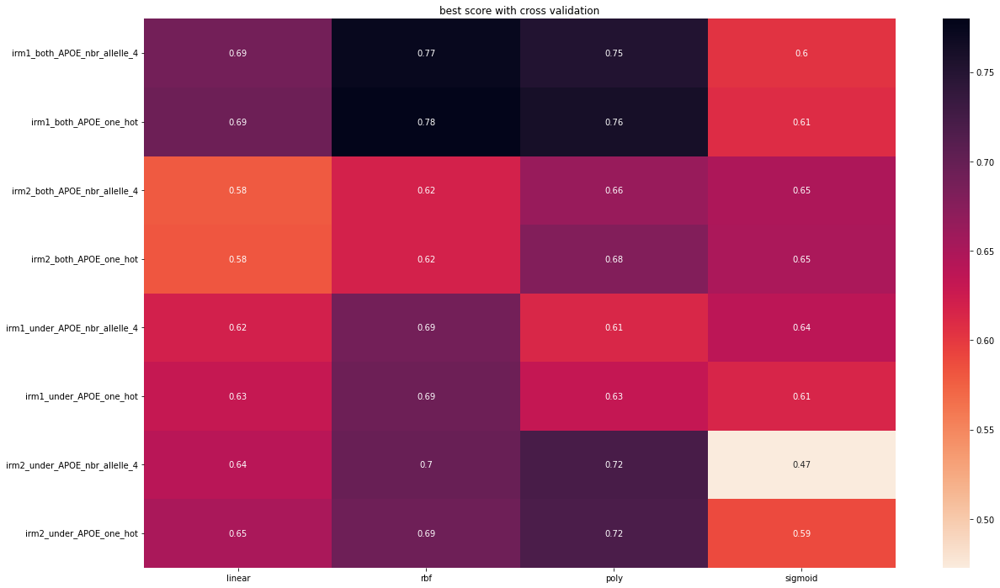

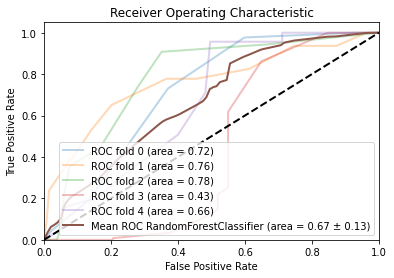

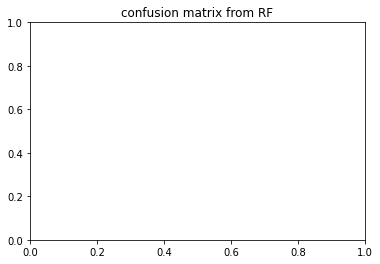

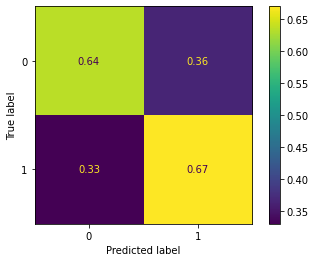

,precision,recall,f1-score,support,auc
0,0.655,0.635,0.640,131.600,0.000
1,0.660,0.667,0.657,131.600,0.000
accuracy,0.652,0.652,0.652,0.652,0.000
macro avg,0.657,0.651,0.648,263.200,0.671
weighted avg,0.657,0.652,0.649,263.200,0.671


coming from


,precision,recall,f1-score,support,auc
0,0.695652,0.629921,0.661157,127.000000,0.000000
1,0.669014,0.730769,0.698529,130.000000,0.000000
accuracy,0.680934,0.680934,0.680934,0.680934,0.000000
macro avg,0.682333,0.680345,0.679843,257.000000,0.715445
weighted avg,0.682178,0.680934,0.680061,257.000000,0.715445


,precision,recall,f1-score,support,auc
0,0.660920,0.858209,0.746753,134.0,0.000000
1,0.779070,0.531746,0.632075,126.0,0.000000
accuracy,0.700000,0.700000,0.700000,0.7,0.000000
macro avg,0.719995,0.694977,0.689414,260.0,0.759417
weighted avg,0.718177,0.700000,0.691179,260.0,0.759417


,precision,recall,f1-score,support,auc
0,0.723077,0.717557,0.720307,131.000000,0.000000
1,0.739437,0.744681,0.742049,141.000000,0.000000
accuracy,0.731618,0.731618,0.731618,0.731618,0.000000
macro avg,0.731257,0.731119,0.731178,272.000000,0.783986
weighted avg,0.731558,0.731618,0.731578,272.000000,0.783986


,precision,recall,f1-score,support,auc
0,0.556604,0.450382,0.497890,131.000000,0.000000
1,0.513514,0.617886,0.560886,123.000000,0.000000
accuracy,0.531496,0.531496,0.531496,0.531496,0.000000
macro avg,0.535059,0.534134,0.529388,254.000000,0.434028
weighted avg,0.535737,0.531496,0.528396,254.000000,0.434028


,precision,recall,f1-score,support,auc
0,0.636364,0.518519,0.571429,135.000000,0.00000
1,0.601227,0.710145,0.651163,138.000000,0.00000
accuracy,0.615385,0.615385,0.615385,0.615385,0.00000
macro avg,0.618795,0.614332,0.611296,273.000000,0.66358
weighted avg,0.618602,0.615385,0.611734,273.000000,0.66358


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 10}
depth_10_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.474 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.470 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.144 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.699 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.577 total time=   0.2s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.797 total time=   0.1s
[CV 3/5] END criterion=gini, max

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.515 total time=   3.4s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.222 total time=   3.6s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.515 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.452 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.604 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.574 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.853 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.511 total time=   0.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.658

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.683 total time=   4.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.814 total time=   4.5s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.579 total time=   4.6s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.657 total time=   4.1s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.504 total time=   4.2s


<Figure size 432x288 with 0 Axes>

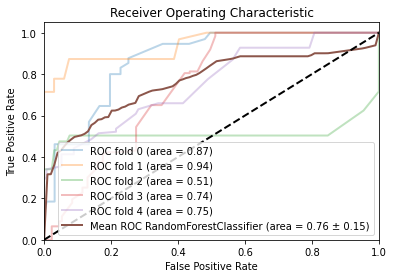

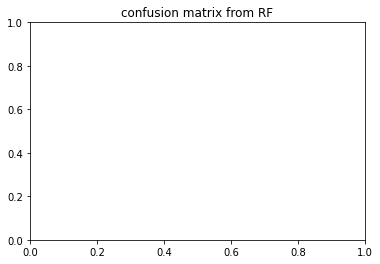

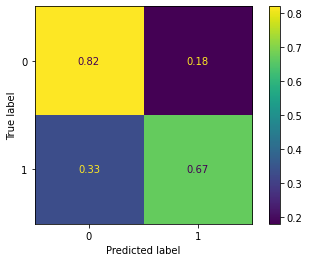

,precision,recall,f1-score,support,auc
0,0.765,0.817,0.758,131.600,0.000
1,0.829,0.681,0.706,131.600,0.000
accuracy,0.745,0.745,0.745,0.745,0.000
macro avg,0.797,0.749,0.732,263.200,0.763
weighted avg,0.799,0.745,0.731,263.200,0.763


coming from


,precision,recall,f1-score,support,auc
0,0.833333,0.748031,0.788382,127.000000,0.000000
1,0.776224,0.853846,0.813187,130.000000,0.000000
accuracy,0.801556,0.801556,0.801556,0.801556,0.000000
macro avg,0.804779,0.800939,0.800784,257.000000,0.869897
weighted avg,0.804445,0.801556,0.800929,257.000000,0.869897


,precision,recall,f1-score,support,auc
0,0.818182,0.940299,0.875000,134.000000,0.000000
1,0.924528,0.777778,0.844828,126.000000,0.000000
accuracy,0.861538,0.861538,0.861538,0.861538,0.000000
macro avg,0.871355,0.859038,0.859914,260.000000,0.939943
weighted avg,0.869719,0.861538,0.860378,260.000000,0.939943


,precision,recall,f1-score,support,auc
0,0.611650,0.961832,0.747774,131.0000,0.000000
1,0.924242,0.432624,0.589372,141.0000,0.000000
accuracy,0.687500,0.687500,0.687500,0.6875,0.000000
macro avg,0.767946,0.697228,0.668573,272.0000,0.511315
weighted avg,0.773693,0.687500,0.665661,272.0000,0.511315


,precision,recall,f1-score,support,auc
0,0.969697,0.488550,0.649746,131.000000,0.000000
1,0.643617,0.983740,0.778135,123.000000,0.000000
accuracy,0.728346,0.728346,0.728346,0.728346,0.000000
macro avg,0.806657,0.736145,0.713941,254.000000,0.739062
weighted avg,0.811792,0.728346,0.711919,254.000000,0.739062


,precision,recall,f1-score,support,auc
0,0.589862,0.948148,0.727273,135.000000,0.000000
1,0.875000,0.355072,0.505155,138.000000,0.000000
accuracy,0.648352,0.648352,0.648352,0.648352,0.000000
macro avg,0.732431,0.651610,0.616214,273.000000,0.753838
weighted avg,0.733998,0.648352,0.614993,273.000000,0.753838


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 50}
depth_10_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.627 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.554 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.751 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.364 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.896 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.670 total time=   0.4s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.673 total time=   0.4s
[CV 3/5] END criterion=

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.536 total time=   6.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.730 total time=   7.1s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.618 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.535 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.751 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.700 total time=   0.4s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.577

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.529 total time=   2.9s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.773 total time=   3.5s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.630 total time=   3.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.557 total time=   2.9s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.809 total time=   3.4s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

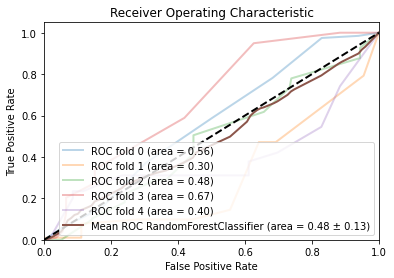

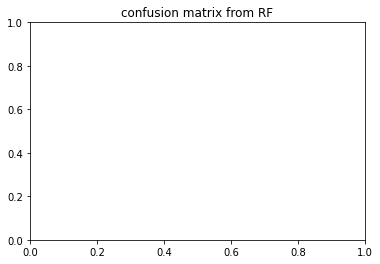

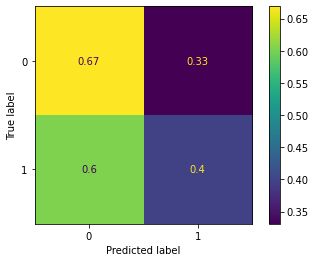

,precision,recall,f1-score,support,auc
0,0.540,0.673,0.570,200.000,0.000
1,0.461,0.398,0.395,200.000,0.000
accuracy,0.533,0.533,0.533,0.533,0.000
macro avg,0.500,0.535,0.482,400.000,0.483
weighted avg,0.502,0.533,0.481,400.000,0.483


coming from


,precision,recall,f1-score,support,auc
0,0.609091,0.317536,0.417445,211.000000,0.000000
1,0.516779,0.781726,0.622222,197.000000,0.000000
accuracy,0.541667,0.541667,0.541667,0.541667,0.000000
macro avg,0.562935,0.549631,0.519834,408.000000,0.564474
weighted avg,0.564519,0.541667,0.516321,408.000000,0.564474


,precision,recall,f1-score,support,auc
0,0.506394,1.000000,0.672326,198.000000,0.000000
1,0.000000,0.000000,0.000000,193.000000,0.000000
accuracy,0.506394,0.506394,0.506394,0.506394,0.000000
macro avg,0.253197,0.500000,0.336163,391.000000,0.302729
weighted avg,0.256435,0.506394,0.340462,391.000000,0.302729


,precision,recall,f1-score,support,auc
0,0.475771,0.553846,0.511848,195.000000,0.000000
1,0.494186,0.416667,0.452128,204.000000,0.000000
accuracy,0.483709,0.483709,0.483709,0.483709,0.000000
macro avg,0.484978,0.485256,0.481988,399.000000,0.477966
weighted avg,0.485186,0.483709,0.481314,399.000000,0.477966


,precision,recall,f1-score,support,auc
0,0.586735,0.580808,0.583756,198.00000,0.00000
1,0.582915,0.588832,0.585859,197.00000,0.00000
accuracy,0.584810,0.584810,0.584810,0.58481,0.00000
macro avg,0.584825,0.584820,0.584807,395.00000,0.67282
weighted avg,0.584829,0.584810,0.584805,395.00000,0.67282


,precision,recall,f1-score,support,auc
0,0.520115,0.914141,0.663004,198.000000,0.000000
1,0.711864,0.200957,0.313433,209.000000,0.000000
accuracy,0.547912,0.547912,0.547912,0.547912,0.000000
macro avg,0.615990,0.557549,0.488218,407.000000,0.398362
weighted avg,0.618581,0.547912,0.483494,407.000000,0.398362


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 10}
depth_10_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.611 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.429 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.673 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.483 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.781 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.650 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.607 total time=   0.1s
[CV 3/5] END criterion=gini, 

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.500 total time=   3.1s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.652 total time=   3.6s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.563 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.669 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.745 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.388 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.900 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.673 total time=   0.2s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.545

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.616 total time=   2.9s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.760 total time=   3.5s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.618 total time=   3.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.484 total time=   2.9s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.779 total time=   3.3s


<Figure size 432x288 with 0 Axes>

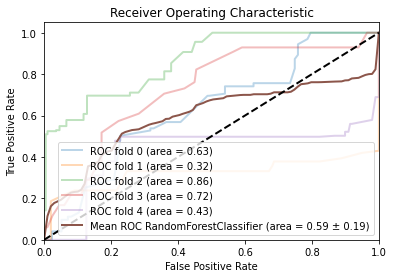

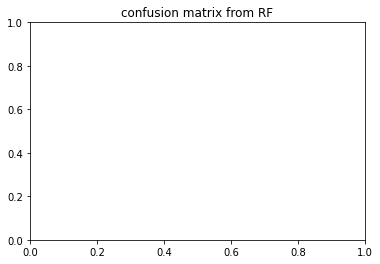

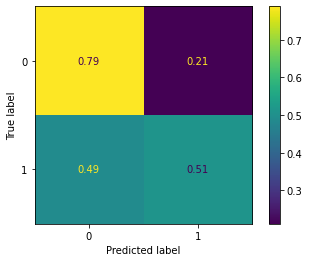

,precision,recall,f1-score,support,auc
0,0.631,0.789,0.690,200.00,0.000
1,0.742,0.509,0.564,200.00,0.000
accuracy,0.650,0.650,0.650,0.65,0.000
macro avg,0.686,0.649,0.627,400.00,0.594
weighted avg,0.686,0.650,0.628,400.00,0.594


coming from


,precision,recall,f1-score,support,auc
0,0.615094,0.772512,0.684874,211.000000,0.000000
1,0.664336,0.482234,0.558824,197.000000,0.000000
accuracy,0.632353,0.632353,0.632353,0.632353,0.000000
macro avg,0.639715,0.627373,0.621849,408.000000,0.630921
weighted avg,0.638870,0.632353,0.624011,408.000000,0.630921


,precision,recall,f1-score,support,auc
0,0.543417,0.979798,0.699099,198.00000,0.000000
1,0.882353,0.155440,0.264317,193.00000,0.000000
accuracy,0.572890,0.572890,0.572890,0.57289,0.000000
macro avg,0.712885,0.567619,0.481708,391.00000,0.322853
weighted avg,0.710718,0.572890,0.484488,391.00000,0.322853


,precision,recall,f1-score,support,auc
0,0.714286,0.871795,0.785219,195.000000,0.000000
1,0.844720,0.666667,0.745205,204.000000,0.000000
accuracy,0.766917,0.766917,0.766917,0.766917,0.000000
macro avg,0.779503,0.769231,0.765212,399.000000,0.863663
weighted avg,0.780974,0.766917,0.764761,399.000000,0.863663


,precision,recall,f1-score,support,auc
0,0.698718,0.550505,0.615819,198.000000,0.000000
1,0.627615,0.761421,0.688073,197.000000,0.000000
accuracy,0.655696,0.655696,0.655696,0.655696,0.000000
macro avg,0.663167,0.655963,0.651946,395.000000,0.722773
weighted avg,0.663257,0.655696,0.651855,395.000000,0.722773


,precision,recall,f1-score,support,auc
0,0.583969,0.772727,0.665217,198.000000,0.000000
1,0.689655,0.478469,0.564972,209.000000,0.000000
accuracy,0.621622,0.621622,0.621622,0.621622,0.000000
macro avg,0.636812,0.625598,0.615095,407.000000,0.428798
weighted avg,0.638241,0.621622,0.613740,407.000000,0.428798


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 50}
depth_10_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.598 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.788 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.477 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.590 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.789 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.836 total time=   0.0s
[CV 3/5] END criterion

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.491 total time=   1.3s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.669 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.712 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.939 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.492 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.911 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.949

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.679 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.531 total time=   1.6s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.562 total time=   1.6s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.505 total time=   1.6s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.6s


<Figure size 432x288 with 0 Axes>

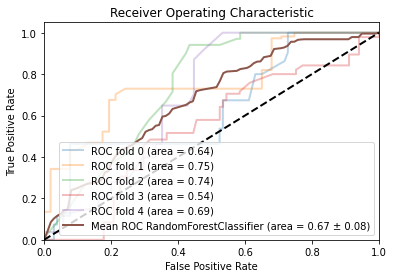

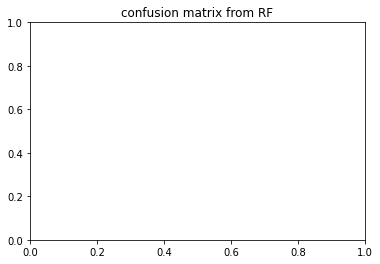

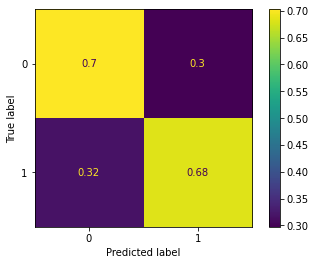

,precision,recall,f1-score,support,auc
0,0.723,0.702,0.692,102.200,0.000
1,0.709,0.674,0.669,102.200,0.000
accuracy,0.691,0.691,0.691,0.691,0.000
macro avg,0.716,0.688,0.680,204.400,0.671
weighted avg,0.715,0.691,0.682,204.400,0.671


coming from


,precision,recall,f1-score,support,auc
0,0.633333,0.922330,0.750988,103.000000,0.000000
1,0.833333,0.421053,0.559441,95.000000,0.000000
accuracy,0.681818,0.681818,0.681818,0.681818,0.000000
macro avg,0.733333,0.671691,0.655214,198.000000,0.636382
weighted avg,0.729293,0.681818,0.659084,198.000000,0.636382


,precision,recall,f1-score,support,auc
0,0.692308,0.786408,0.736364,103.000000,0.000000
1,0.773196,0.675676,0.721154,111.000000,0.000000
accuracy,0.728972,0.728972,0.728972,0.728972,0.000000
macro avg,0.732752,0.731042,0.728759,214.000000,0.751159
weighted avg,0.734264,0.728972,0.728474,214.000000,0.751159


,precision,recall,f1-score,support,auc
0,0.850746,0.575758,0.686747,99.000000,0.000000
1,0.686567,0.901961,0.779661,102.000000,0.000000
accuracy,0.741294,0.741294,0.741294,0.741294,0.000000
macro avg,0.768657,0.738859,0.733204,201.000000,0.738661
weighted avg,0.767431,0.741294,0.733897,201.000000,0.738661


,precision,recall,f1-score,support,auc
0,0.577236,0.702970,0.633929,101.000000,0.000000
1,0.589041,0.452632,0.511905,95.000000,0.000000
accuracy,0.581633,0.581633,0.581633,0.581633,0.000000
macro avg,0.583138,0.577801,0.572917,196.000000,0.539448
weighted avg,0.582958,0.581633,0.574784,196.000000,0.539448


,precision,recall,f1-score,support,auc
0,0.859375,0.523810,0.650888,105.000000,0.000000
1,0.664430,0.916667,0.770428,108.000000,0.000000
accuracy,0.723005,0.723005,0.723005,0.723005,0.000000
macro avg,0.761902,0.720238,0.710658,213.000000,0.688448
weighted avg,0.760529,0.723005,0.711500,213.000000,0.688448


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 100}
depth_10_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.807 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.882 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.697 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.765 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.943 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.465 total time=   1.3s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.622 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.914 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.696 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.875 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.576 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.585 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.690 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.853

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.631 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.660 total time=   1.7s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.604 total time=   1.6s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.470 total time=   1.6s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.6s


<Figure size 432x288 with 0 Axes>

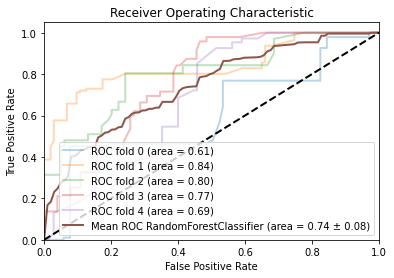

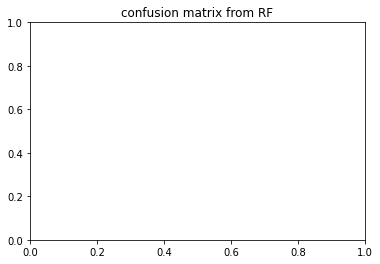

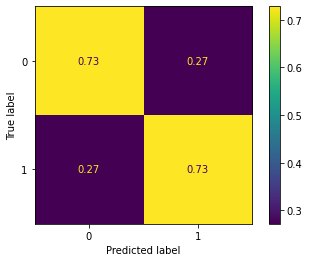

,precision,recall,f1-score,support,auc
0,0.761,0.728,0.720,102.200,0.000
1,0.754,0.726,0.712,102.200,0.000
accuracy,0.727,0.727,0.727,0.727,0.000
macro avg,0.758,0.727,0.716,204.400,0.741
weighted avg,0.758,0.727,0.717,204.400,0.741


coming from


,precision,recall,f1-score,support,auc
0,0.612903,0.922330,0.736434,103.000000,0.000000
1,0.813953,0.368421,0.507246,95.000000,0.000000
accuracy,0.656566,0.656566,0.656566,0.656566,0.000000
macro avg,0.713428,0.645376,0.621840,198.000000,0.607614
weighted avg,0.709367,0.656566,0.626470,198.000000,0.607614


,precision,recall,f1-score,support,auc
0,0.726562,0.902913,0.805195,103.00000,0.000000
1,0.883721,0.684685,0.771574,111.00000,0.000000
accuracy,0.789720,0.789720,0.789720,0.78972,0.000000
macro avg,0.805142,0.793799,0.788384,214.00000,0.835782
weighted avg,0.808079,0.789720,0.787756,214.00000,0.835782


,precision,recall,f1-score,support,auc
0,0.757576,0.757576,0.757576,99.000000,0.000000
1,0.764706,0.764706,0.764706,102.000000,0.000000
accuracy,0.761194,0.761194,0.761194,0.761194,0.000000
macro avg,0.761141,0.761141,0.761141,201.000000,0.798871
weighted avg,0.761194,0.761194,0.761194,201.000000,0.798871


,precision,recall,f1-score,support,auc
0,0.928571,0.514851,0.662420,101.000000,0.000000
1,0.650000,0.957895,0.774468,95.000000,0.000000
accuracy,0.729592,0.729592,0.729592,0.729592,0.000000
macro avg,0.789286,0.736373,0.718444,196.000000,0.769203
weighted avg,0.793550,0.729592,0.716729,196.000000,0.769203


,precision,recall,f1-score,support,auc
0,0.780822,0.542857,0.640449,105.000000,0.000000
1,0.657143,0.851852,0.741935,108.000000,0.000000
accuracy,0.699531,0.699531,0.699531,0.699531,0.000000
macro avg,0.718982,0.697354,0.691192,213.000000,0.693078
weighted avg,0.718111,0.699531,0.691907,213.000000,0.693078


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 100}
depth_10_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.228 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.203 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.476 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.495 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.776 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.802 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.457 total time=   0.1s
[CV 3/5] END criterion=g

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.752 total time=   2.3s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.646 total time=   2.6s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.284 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.545 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.532 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.460 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.784 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.721 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.324

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.509 total time=   2.7s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.313 total time=   2.5s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.532 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.836 total time=   2.4s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.809 total time=   3.0s


<Figure size 432x288 with 0 Axes>

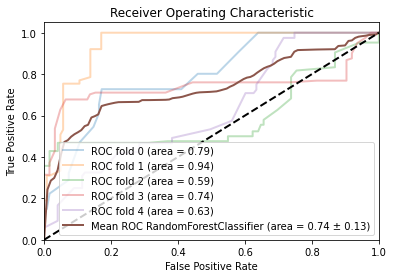

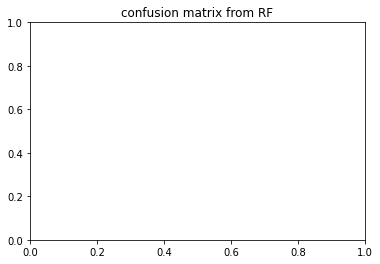

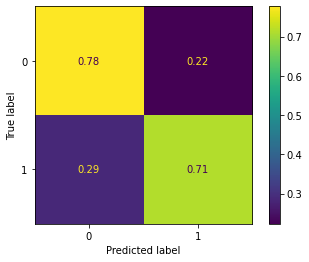

,precision,recall,f1-score,support,auc
0,0.754,0.777,0.733,122.800,0.000
1,0.811,0.714,0.729,122.800,0.000
accuracy,0.745,0.745,0.745,0.745,0.000
macro avg,0.782,0.746,0.731,245.600,0.739
weighted avg,0.783,0.745,0.731,245.600,0.739


coming from


,precision,recall,f1-score,support,auc
0,0.708333,0.836066,0.766917,122.000000,0.000000
1,0.797980,0.652893,0.718182,121.000000,0.000000
accuracy,0.744856,0.744856,0.744856,0.744856,0.000000
macro avg,0.753157,0.744479,0.742550,243.000000,0.794405
weighted avg,0.752972,0.744856,0.742650,243.000000,0.794405


,precision,recall,f1-score,support,auc
0,0.944444,0.829268,0.883117,123.000000,0.000000
1,0.851064,0.952381,0.898876,126.000000,0.000000
accuracy,0.891566,0.891566,0.891566,0.891566,0.000000
macro avg,0.897754,0.890825,0.890997,249.000000,0.940025
weighted avg,0.897192,0.891566,0.891092,249.000000,0.940025


,precision,recall,f1-score,support,auc
0,0.619048,0.959016,0.752412,122.000000,0.000000
1,0.915254,0.428571,0.583784,126.000000,0.000000
accuracy,0.689516,0.689516,0.689516,0.689516,0.000000
macro avg,0.767151,0.693794,0.668098,248.000000,0.593026
weighted avg,0.769540,0.689516,0.666738,248.000000,0.593026


,precision,recall,f1-score,support,auc
0,0.723926,0.951613,0.822300,124.000000,0.000000
1,0.926829,0.628099,0.748768,121.000000,0.000000
accuracy,0.791837,0.791837,0.791837,0.791837,0.000000
macro avg,0.825378,0.789856,0.785534,245.000000,0.743468
weighted avg,0.824136,0.791837,0.785984,245.000000,0.743468


,precision,recall,f1-score,support,auc
0,0.775510,0.308943,0.441860,123.000000,0.00000
1,0.561856,0.908333,0.694268,120.000000,0.00000
accuracy,0.604938,0.604938,0.604938,0.604938,0.00000
macro avg,0.668683,0.608638,0.568064,243.000000,0.62544
weighted avg,0.670002,0.604938,0.566506,243.000000,0.62544


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 50}
depth_10_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.772 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.442 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.632 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.689 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.782 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.405 total time=   0.1s
[CV 3/5] END criterion=gini,

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.726 total time=   2.2s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.630 total time=   2.5s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.658 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.334 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.633 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.810 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.667 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.798 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.292

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.630 total time=   2.8s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.375 total time=   2.4s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.559 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.763 total time=   2.4s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.735 total time=   2.9s


<Figure size 432x288 with 0 Axes>

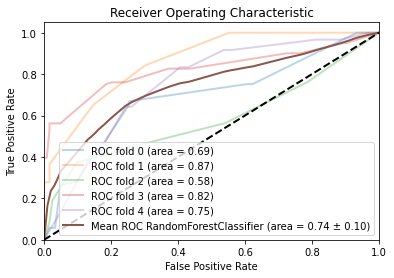

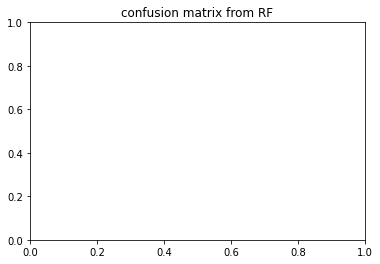

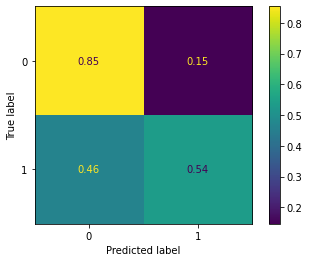

,precision,recall,f1-score,support,auc
0,0.659,0.853,0.738,122.800,0.000
1,0.810,0.540,0.619,122.800,0.000
accuracy,0.696,0.696,0.696,0.696,0.000
macro avg,0.735,0.696,0.678,245.600,0.743
weighted avg,0.735,0.696,0.678,245.600,0.743


coming from


,precision,recall,f1-score,support,auc
0,0.684211,0.745902,0.713725,122.000000,0.000000
1,0.718182,0.652893,0.683983,121.000000,0.000000
accuracy,0.699588,0.699588,0.699588,0.699588,0.000000
macro avg,0.701196,0.699397,0.698854,243.000000,0.691912
weighted avg,0.701126,0.699588,0.698915,243.000000,0.691912


,precision,recall,f1-score,support,auc
0,0.704698,0.853659,0.772059,123.000000,0.000000
1,0.820000,0.650794,0.725664,126.000000,0.000000
accuracy,0.751004,0.751004,0.751004,0.751004,0.000000
macro avg,0.762349,0.752226,0.748861,249.000000,0.865015
weighted avg,0.763044,0.751004,0.748582,249.000000,0.865015


,precision,recall,f1-score,support,auc
0,0.538462,0.975410,0.693878,122.000000,0.000000
1,0.888889,0.190476,0.313725,126.000000,0.000000
accuracy,0.576613,0.576613,0.576613,0.576613,0.000000
macro avg,0.713675,0.582943,0.503802,248.000000,0.581544
weighted avg,0.716501,0.576613,0.500736,248.000000,0.581544


,precision,recall,f1-score,support,auc
0,0.690058,0.951613,0.800000,124.000000,0.000000
1,0.918919,0.561983,0.697436,121.000000,0.000000
accuracy,0.759184,0.759184,0.759184,0.759184,0.000000
macro avg,0.804489,0.756798,0.748718,245.000000,0.822214
weighted avg,0.803088,0.759184,0.749346,245.000000,0.822214


,precision,recall,f1-score,support,auc
0,0.679104,0.739837,0.708171,123.000000,0.000000
1,0.706422,0.641667,0.672489,120.000000,0.000000
accuracy,0.691358,0.691358,0.691358,0.691358,0.000000
macro avg,0.692763,0.690752,0.690330,243.000000,0.753659
weighted avg,0.692595,0.691358,0.690550,243.000000,0.753659


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 10}
depth_100_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.574 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.512 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.673 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.503 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.566 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.702 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.748 total time=   0.1s
[CV 3/5] END crite

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.604 total time=   1.7s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.606 total time=   1.5s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.189 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.425 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.676 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.557 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.308 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.783 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.835 total time=   2.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.594 total time=   1.9s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.495 total time=   1.9s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.522 total time=   2.0s


<Figure size 432x288 with 0 Axes>

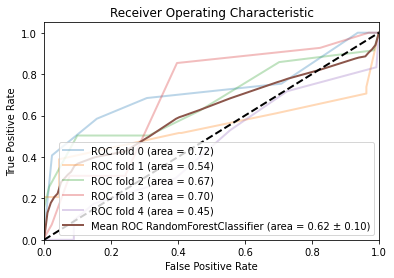

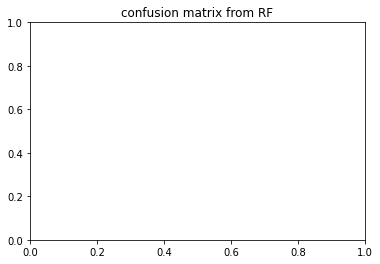

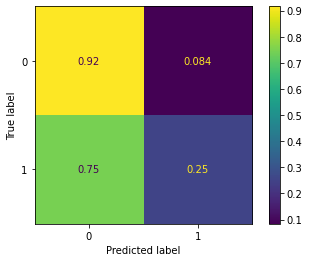

,precision,recall,f1-score,support,auc
0,0.553,0.917,0.689,131.600,0.000
1,0.755,0.256,0.373,131.600,0.000
accuracy,0.586,0.586,0.586,0.586,0.000
macro avg,0.654,0.586,0.531,263.200,0.618
weighted avg,0.655,0.586,0.531,263.200,0.618


coming from


,precision,recall,f1-score,support,auc
0,0.616915,0.976378,0.756098,127.000000,0.000000
1,0.946429,0.407692,0.569892,130.000000,0.000000
accuracy,0.688716,0.688716,0.688716,0.688716,0.000000
macro avg,0.781672,0.692035,0.662995,257.000000,0.718504
weighted avg,0.783595,0.688716,0.661908,257.000000,0.718504


,precision,recall,f1-score,support,auc
0,0.561404,0.955224,0.707182,134.000000,0.000000
1,0.812500,0.206349,0.329114,126.000000,0.000000
accuracy,0.592308,0.592308,0.592308,0.592308,0.000000
macro avg,0.686952,0.580787,0.518148,260.000000,0.544332
weighted avg,0.683089,0.592308,0.523965,260.000000,0.544332


,precision,recall,f1-score,support,auc
0,0.551282,0.984733,0.706849,131.000000,0.000000
1,0.947368,0.255319,0.402235,141.000000,0.000000
accuracy,0.606618,0.606618,0.606618,0.606618,0.000000
macro avg,0.749325,0.620026,0.554542,272.000000,0.669103
weighted avg,0.756606,0.606618,0.548942,272.000000,0.669103


,precision,recall,f1-score,support,auc
0,0.540984,0.755725,0.630573,131.000000,0.000000
1,0.549296,0.317073,0.402062,123.000000,0.000000
accuracy,0.543307,0.543307,0.543307,0.543307,0.000000
macro avg,0.545140,0.536399,0.516318,254.000000,0.703221
weighted avg,0.545009,0.543307,0.519916,254.000000,0.703221


,precision,recall,f1-score,support,auc
0,0.495968,0.911111,0.642298,135.000000,0.00000
1,0.520000,0.094203,0.159509,138.000000,0.00000
accuracy,0.498168,0.498168,0.498168,0.498168,0.00000
macro avg,0.507984,0.502657,0.400903,273.000000,0.45255
weighted avg,0.508116,0.498168,0.398251,273.000000,0.45255


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 10}
depth_100_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.668 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.989 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.304 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.588 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.948 total time=   0.1s
[CV 3/5] END criteri

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.590 total time=   1.7s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.531 total time=   1.5s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.225 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.334 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.529 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.511 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.256 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.683 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.454 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.747 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.648 total time=   2.1s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.587 total time=   2.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.408 total time=   2.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.622 total time=   2.0s


<Figure size 432x288 with 0 Axes>

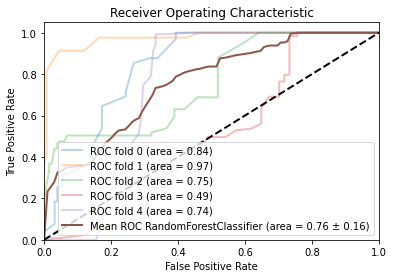

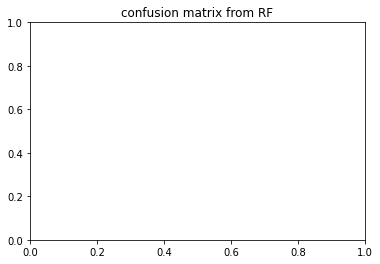

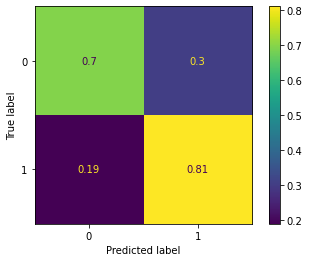

,precision,recall,f1-score,support,auc
0,0.809,0.694,0.713,131.600,0.00
1,0.774,0.816,0.766,131.600,0.00
accuracy,0.753,0.753,0.753,0.753,0.00
macro avg,0.792,0.755,0.740,263.200,0.76
weighted avg,0.792,0.753,0.739,263.200,0.76


coming from


,precision,recall,f1-score,support,auc
0,0.950617,0.606299,0.740385,127.000000,0.000000
1,0.715909,0.969231,0.823529,130.000000,0.000000
accuracy,0.789883,0.789883,0.789883,0.789883,0.000000
macro avg,0.833263,0.787765,0.781957,257.000000,0.836947
weighted avg,0.831893,0.789883,0.782442,257.000000,0.836947


,precision,recall,f1-score,support,auc
0,0.852564,0.992537,0.917241,134.000000,0.000000
1,0.990385,0.817460,0.895652,126.000000,0.000000
accuracy,0.907692,0.907692,0.907692,0.907692,0.000000
macro avg,0.921474,0.904999,0.906447,260.000000,0.974739
weighted avg,0.919354,0.907692,0.906779,260.000000,0.974739


,precision,recall,f1-score,support,auc
0,0.624365,0.938931,0.750000,131.000000,0.000000
1,0.893333,0.475177,0.620370,141.000000,0.000000
accuracy,0.698529,0.698529,0.698529,0.698529,0.000000
macro avg,0.758849,0.707054,0.685185,272.000000,0.751638
weighted avg,0.763794,0.698529,0.682802,272.000000,0.751638


,precision,recall,f1-score,support,auc
0,0.700000,0.267176,0.386740,131.000000,0.000000
1,0.529412,0.878049,0.660550,123.000000,0.000000
accuracy,0.562992,0.562992,0.562992,0.562992,0.000000
macro avg,0.614706,0.572612,0.523645,254.000000,0.490287
weighted avg,0.617392,0.562992,0.519333,254.000000,0.490287


,precision,recall,f1-score,support,auc
0,0.918367,0.666667,0.772532,135.000000,0.000000
1,0.742857,0.942029,0.830671,138.000000,0.000000
accuracy,0.805861,0.805861,0.805861,0.805861,0.000000
macro avg,0.830612,0.804348,0.801602,273.000000,0.744337
weighted avg,0.829648,0.805861,0.801921,273.000000,0.744337


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_100_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.646 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.552 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.619 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.685 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.613 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.595 total time=   0.1s
[CV 3/5] END 

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.710 total time=   2.9s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.438 total time=   2.8s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.739 total time=   3.1s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.652 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.468 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.576 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.597 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.859 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.792 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.521 total time=   2.9s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.746 total time=   3.5s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.638 total time=   2.9s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.522 total time=   2.9s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.847 total time=   3.4s


<Figure size 432x288 with 0 Axes>

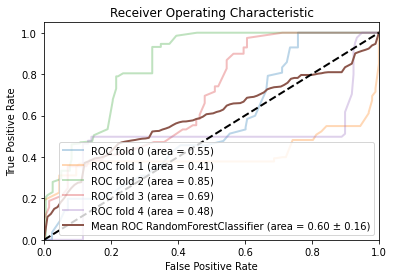

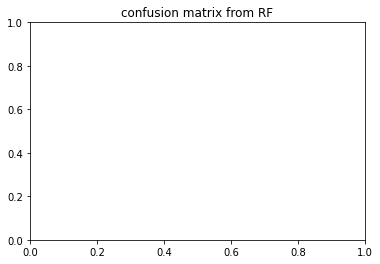

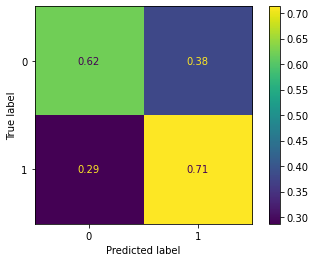

,precision,recall,f1-score,support,auc
0,0.759,0.625,0.622,200.000,0.000
1,0.708,0.713,0.656,200.000,0.000
accuracy,0.667,0.667,0.667,0.667,0.000
macro avg,0.733,0.669,0.639,400.000,0.598
weighted avg,0.734,0.667,0.638,400.000,0.598


coming from


,precision,recall,f1-score,support,auc
0,0.910714,0.241706,0.382022,211.000000,0.00000
1,0.545455,0.974619,0.699454,197.000000,0.00000
accuracy,0.595588,0.595588,0.595588,0.595588,0.00000
macro avg,0.728084,0.608163,0.540738,408.000000,0.55182
weighted avg,0.734351,0.595588,0.535292,408.000000,0.55182


,precision,recall,f1-score,support,auc
0,0.585139,0.954545,0.725528,198.000000,0.000000
1,0.867647,0.305699,0.452107,193.000000,0.000000
accuracy,0.634271,0.634271,0.634271,0.634271,0.000000
macro avg,0.726393,0.630122,0.588818,391.000000,0.412951
weighted avg,0.724587,0.634271,0.590566,391.000000,0.412951


,precision,recall,f1-score,support,auc
0,0.840764,0.676923,0.750000,195.000000,0.000000
1,0.739669,0.877451,0.802691,204.000000,0.000000
accuracy,0.779449,0.779449,0.779449,0.779449,0.000000
macro avg,0.790217,0.777187,0.776345,399.000000,0.850515
weighted avg,0.789077,0.779449,0.776940,399.000000,0.850515


,precision,recall,f1-score,support,auc
0,0.847826,0.393939,0.537931,198.000000,0.000000
1,0.603960,0.928934,0.732000,197.000000,0.000000
accuracy,0.660759,0.660759,0.660759,0.660759,0.000000
macro avg,0.725893,0.661437,0.634966,395.000000,0.693547
weighted avg,0.726202,0.660759,0.634720,395.000000,0.693547


,precision,recall,f1-score,support,auc
0,0.609319,0.858586,0.712788,198.000000,0.000000
1,0.781250,0.478469,0.593472,209.000000,0.000000
accuracy,0.663391,0.663391,0.663391,0.663391,0.000000
macro avg,0.695284,0.668527,0.653130,407.000000,0.481103
weighted avg,0.697608,0.663391,0.651518,407.000000,0.481103


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 100}
depth_100_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.409 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.668 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.738 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.342 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.518 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.658 total time=   0.1s
[CV 3/5] END criter

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.701 total time=   2.9s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.526 total time=   2.7s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.744 total time=   3.2s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.411 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.701 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.458 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.927 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.750 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.505 total time=   2.8s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.764 total time=   3.5s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.632 total time=   2.9s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.512 total time=   2.9s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.793 total time=   3.3s


<Figure size 432x288 with 0 Axes>

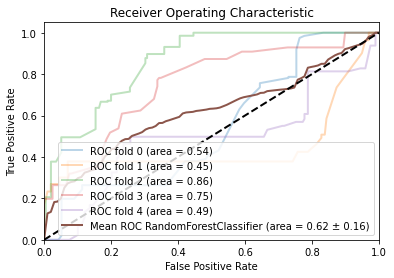

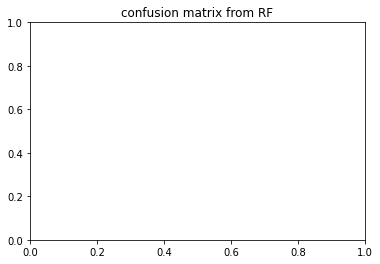

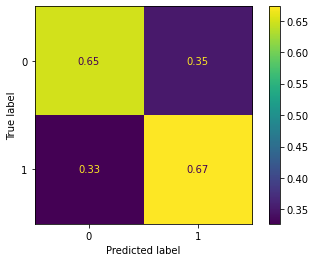

,precision,recall,f1-score,support,auc
0,0.702,0.654,0.639,200.000,0.000
1,0.690,0.673,0.646,200.000,0.000
accuracy,0.662,0.662,0.662,0.662,0.000
macro avg,0.696,0.664,0.643,400.000,0.619
weighted avg,0.696,0.662,0.642,400.000,0.619


coming from


,precision,recall,f1-score,support,auc
0,0.764706,0.246445,0.372760,211.000000,0.000000
1,0.532353,0.918782,0.674115,197.000000,0.000000
accuracy,0.571078,0.571078,0.571078,0.571078,0.000000
macro avg,0.648529,0.582614,0.523438,408.000000,0.541187
weighted avg,0.652516,0.571078,0.518267,408.000000,0.541187


,precision,recall,f1-score,support,auc
0,0.587859,0.929293,0.720157,198.000000,0.0000
1,0.820513,0.331606,0.472325,193.000000,0.0000
accuracy,0.634271,0.634271,0.634271,0.634271,0.0000
macro avg,0.704186,0.630450,0.596241,391.000000,0.4496
weighted avg,0.702699,0.634271,0.597825,391.000000,0.4496


,precision,recall,f1-score,support,auc
0,0.843750,0.692308,0.760563,195.000000,0.000000
1,0.748954,0.877451,0.808126,204.000000,0.000000
accuracy,0.786967,0.786967,0.786967,0.786967,0.000000
macro avg,0.796352,0.784879,0.784345,399.000000,0.862066
weighted avg,0.795283,0.786967,0.784881,399.000000,0.862066


,precision,recall,f1-score,support,auc
0,0.744318,0.661616,0.700535,198.000000,0.000000
1,0.694064,0.771574,0.730769,197.000000,0.000000
accuracy,0.716456,0.716456,0.716456,0.716456,0.000000
macro avg,0.719191,0.716595,0.715652,395.000000,0.749692
weighted avg,0.719255,0.716456,0.715614,395.000000,0.749692


,precision,recall,f1-score,support,auc
0,0.567568,0.742424,0.643326,198.000000,0.000000
1,0.655405,0.464115,0.543417,209.000000,0.000000
accuracy,0.599509,0.599509,0.599509,0.599509,0.000000
macro avg,0.611486,0.603270,0.593372,407.000000,0.490334
weighted avg,0.612673,0.599509,0.592022,407.000000,0.490334


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 100}
depth_100_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.771 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.807 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.745 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.596 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.410 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.853 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.929 total time=   0.0s
[CV 3/5] END cr

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.590 total time=   1.3s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.504 total time=   1.3s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.801 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.542 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.770 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.695 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.634 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.577 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.684 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.619 total time=   1.7s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.551 total time=   1.6s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.436 total time=   1.6s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.6s


<Figure size 432x288 with 0 Axes>

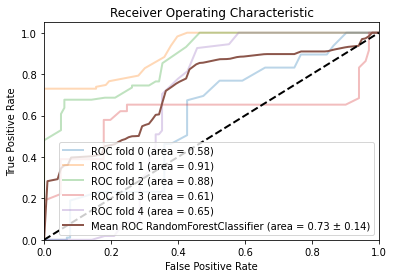

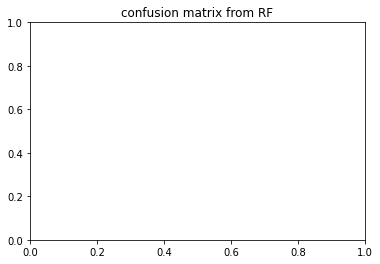

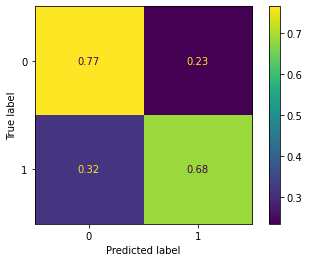

,precision,recall,f1-score,support,auc
0,0.707,0.767,0.727,102.200,0.000
1,0.774,0.682,0.714,102.200,0.000
accuracy,0.724,0.724,0.724,0.724,0.000
macro avg,0.740,0.725,0.721,204.400,0.727
weighted avg,0.741,0.724,0.720,204.400,0.727


coming from


,precision,recall,f1-score,support,auc
0,0.648352,0.572816,0.608247,103.000000,0.000000
1,0.588785,0.663158,0.623762,95.000000,0.000000
accuracy,0.616162,0.616162,0.616162,0.616162,0.000000
macro avg,0.618568,0.617987,0.616005,198.000000,0.582678
weighted avg,0.619772,0.616162,0.615691,198.000000,0.582678


,precision,recall,f1-score,support,auc
0,0.741007,1.000000,0.851240,103.000000,0.000000
1,1.000000,0.675676,0.806452,111.000000,0.000000
accuracy,0.831776,0.831776,0.831776,0.831776,0.000000
macro avg,0.870504,0.837838,0.828846,214.000000,0.914021
weighted avg,0.875345,0.831776,0.828008,214.000000,0.914021


,precision,recall,f1-score,support,auc
0,0.715385,0.939394,0.812227,99.00000,0.000000
1,0.915493,0.637255,0.751445,102.00000,0.000000
accuracy,0.786070,0.786070,0.786070,0.78607,0.000000
macro avg,0.815439,0.788324,0.781836,201.00000,0.876906
weighted avg,0.816932,0.786070,0.781382,201.00000,0.876906


,precision,recall,f1-score,support,auc
0,0.678571,0.752475,0.713615,101.000000,0.000000
1,0.702381,0.621053,0.659218,95.000000,0.000000
accuracy,0.688776,0.688776,0.688776,0.688776,0.000000
macro avg,0.690476,0.686764,0.686416,196.000000,0.610109
weighted avg,0.690112,0.688776,0.687249,196.000000,0.610109


,precision,recall,f1-score,support,auc
0,0.750000,0.571429,0.648649,105.000000,0.00000
1,0.661654,0.814815,0.730290,108.000000,0.00000
accuracy,0.694836,0.694836,0.694836,0.694836,0.00000
macro avg,0.705827,0.693122,0.689470,213.000000,0.65172
weighted avg,0.705205,0.694836,0.690044,213.000000,0.65172


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_100_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.648 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.603 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.910 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.291 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.670 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.931 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.976 total time=   0.0s
[CV 3/5] END crite

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.576 total time=   1.5s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.554 total time=   1.4s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.603 total time=   1.4s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.681 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.965 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.712 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.417 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.568 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.713 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.596 total time=   1.7s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.573 total time=   1.6s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.399 total time=   1.6s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.6s


<Figure size 432x288 with 0 Axes>

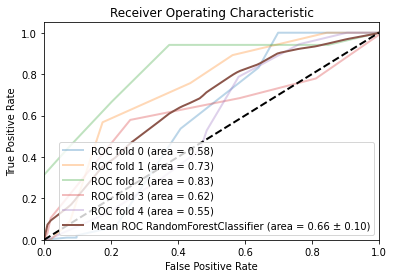

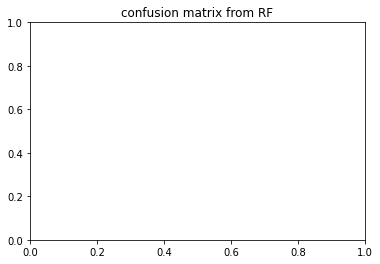

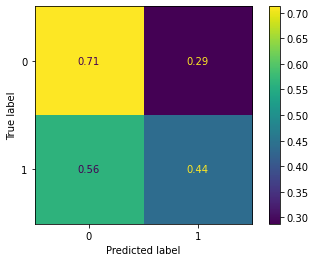

,precision,recall,f1-score,support,auc
0,0.587,0.715,0.613,102.200,0.000
1,0.647,0.444,0.449,102.200,0.000
accuracy,0.577,0.577,0.577,0.577,0.000
macro avg,0.617,0.580,0.531,204.400,0.663
weighted avg,0.617,0.577,0.530,204.400,0.663


coming from


,precision,recall,f1-score,support,auc
0,0.698113,0.359223,0.474359,103.000000,0.000000
1,0.544828,0.831579,0.658333,95.000000,0.000000
accuracy,0.585859,0.585859,0.585859,0.585859,0.000000
macro avg,0.621470,0.595401,0.566346,198.000000,0.577568
weighted avg,0.624567,0.585859,0.562630,198.000000,0.577568


,precision,recall,f1-score,support,auc
0,0.484694,0.922330,0.635452,103.000000,0.000000
1,0.555556,0.090090,0.155039,111.000000,0.000000
accuracy,0.490654,0.490654,0.490654,0.490654,0.000000
macro avg,0.520125,0.506210,0.395245,214.000000,0.733841
weighted avg,0.521449,0.490654,0.386265,214.000000,0.733841


,precision,recall,f1-score,support,auc
0,0.699115,0.797980,0.745283,99.000000,0.000000
1,0.772727,0.666667,0.715789,102.000000,0.000000
accuracy,0.731343,0.731343,0.731343,0.731343,0.000000
macro avg,0.735921,0.732323,0.730536,201.000000,0.831353
weighted avg,0.736471,0.731343,0.730316,201.000000,0.831353


,precision,recall,f1-score,support,auc
0,0.538043,0.980198,0.694737,101.000000,0.000000
1,0.833333,0.105263,0.186916,95.000000,0.000000
accuracy,0.556122,0.556122,0.556122,0.556122,0.000000
macro avg,0.685688,0.542731,0.440826,196.000000,0.621417
weighted avg,0.681169,0.556122,0.448599,196.000000,0.621417


,precision,recall,f1-score,support,auc
0,0.514286,0.514286,0.514286,105.000000,0.00000
1,0.527778,0.527778,0.527778,108.000000,0.00000
accuracy,0.521127,0.521127,0.521127,0.521127,0.00000
macro avg,0.521032,0.521032,0.521032,213.000000,0.55075
weighted avg,0.521127,0.521127,0.521127,213.000000,0.55075


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 10}
depth_100_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.610 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.195 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.540 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.716 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.791 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.717 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.337 total time=   0.1s
[CV 3/5] END cri

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.553 total time=   2.3s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.696 total time=   2.2s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.779 total time=   2.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.629 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.411 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.689 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.782 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.676 total time=   1.4s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.533 total time=   2.8s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.379 total time=   2.5s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.572 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.782 total time=   2.5s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.737 total time=   3.0s


<Figure size 432x288 with 0 Axes>

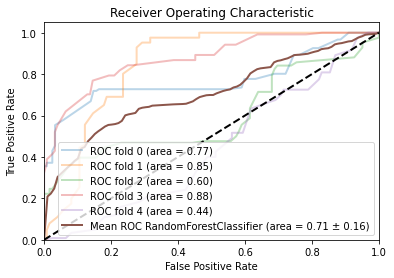

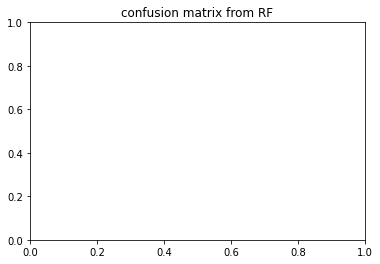

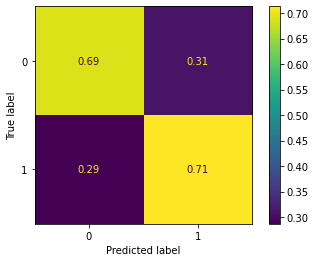

,precision,recall,f1-score,support,auc
0,0.693,0.691,0.650,122.800,0.000
1,0.752,0.715,0.698,122.800,0.000
accuracy,0.701,0.701,0.701,0.701,0.000
macro avg,0.722,0.703,0.674,245.600,0.707
weighted avg,0.723,0.701,0.673,245.600,0.707


coming from


,precision,recall,f1-score,support,auc
0,0.724138,0.860656,0.786517,122.000000,0.000000
1,0.826531,0.669421,0.739726,121.000000,0.000000
accuracy,0.765432,0.765432,0.765432,0.765432,0.000000
macro avg,0.775334,0.765039,0.763121,243.000000,0.773066
weighted avg,0.775124,0.765432,0.763218,243.000000,0.773066


,precision,recall,f1-score,support,auc
0,0.908163,0.723577,0.805430,123.000000,0.000000
1,0.774834,0.928571,0.844765,126.000000,0.000000
accuracy,0.827309,0.827309,0.827309,0.827309,0.000000
macro avg,0.841499,0.826074,0.825098,249.000000,0.847045
weighted avg,0.840696,0.827309,0.825335,249.000000,0.847045


,precision,recall,f1-score,support,auc
0,0.582474,0.926230,0.715190,122.000000,0.000000
1,0.833333,0.357143,0.500000,126.000000,0.000000
accuracy,0.637097,0.637097,0.637097,0.637097,0.000000
macro avg,0.707904,0.641686,0.607595,248.000000,0.597125
weighted avg,0.709927,0.637097,0.605860,248.000000,0.597125


,precision,recall,f1-score,support,auc
0,0.748252,0.862903,0.801498,124.000000,0.000000
1,0.833333,0.702479,0.762332,121.000000,0.000000
accuracy,0.783673,0.783673,0.783673,0.783673,0.000000
macro avg,0.790793,0.782691,0.781915,245.000000,0.876433
weighted avg,0.790272,0.783673,0.782155,245.000000,0.876433


,precision,recall,f1-score,support,auc
0,0.500000,0.081301,0.139860,123.000000,0.000000
1,0.493274,0.916667,0.641399,120.000000,0.000000
accuracy,0.493827,0.493827,0.493827,0.493827,0.000000
macro avg,0.496637,0.498984,0.390630,243.000000,0.442378
weighted avg,0.496678,0.493827,0.387534,243.000000,0.442378


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_100_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.476 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.234 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.744 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.614 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.696 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.294 total time=   0.1s
[CV 3/5] END crite

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.565 total time=   2.2s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.754 total time=   2.3s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.651 total time=   2.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.783 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.255 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.667 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.712 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.863 total time=   1.4s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.668 total time=   2.8s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.343 total time=   2.4s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.607 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.806 total time=   2.5s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.800 total time=   2.9s


<Figure size 432x288 with 0 Axes>

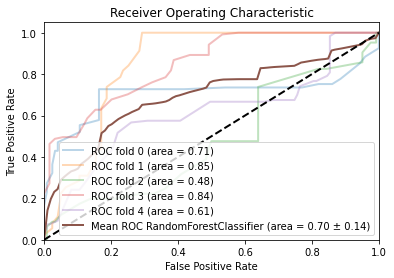

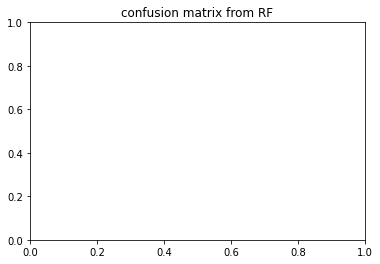

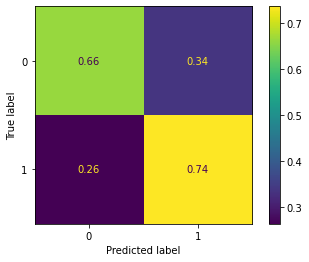

,precision,recall,f1-score,support,auc
0,0.718,0.663,0.680,122.8,0.000
1,0.698,0.734,0.707,122.8,0.000
accuracy,0.700,0.700,0.700,0.7,0.000
macro avg,0.708,0.699,0.693,245.6,0.697
weighted avg,0.708,0.700,0.694,245.6,0.697


coming from


,precision,recall,f1-score,support,auc
0,0.733813,0.836066,0.781609,122.000000,0.000000
1,0.807692,0.694215,0.746667,121.000000,0.000000
accuracy,0.765432,0.765432,0.765432,0.765432,0.000000
macro avg,0.770753,0.765140,0.764138,243.000000,0.706036
weighted avg,0.770601,0.765432,0.764210,243.000000,0.706036


,precision,recall,f1-score,support,auc
0,0.888889,0.715447,0.792793,123.000000,0.00000
1,0.766667,0.912698,0.833333,126.000000,0.00000
accuracy,0.815261,0.815261,0.815261,0.815261,0.00000
macro avg,0.827778,0.814073,0.813063,249.000000,0.84698
weighted avg,0.827041,0.815261,0.813307,249.000000,0.84698


,precision,recall,f1-score,support,auc
0,0.564103,0.360656,0.440000,122.000000,0.000000
1,0.541176,0.730159,0.621622,126.000000,0.000000
accuracy,0.548387,0.548387,0.548387,0.548387,0.000000
macro avg,0.552640,0.545407,0.530811,248.000000,0.476125
weighted avg,0.552455,0.548387,0.532276,248.000000,0.476125


,precision,recall,f1-score,support,auc
0,0.777778,0.620968,0.690583,124.000000,0.000000
1,0.678082,0.818182,0.741573,121.000000,0.000000
accuracy,0.718367,0.718367,0.718367,0.718367,0.000000
macro avg,0.727930,0.719575,0.716078,245.000000,0.843775
weighted avg,0.728540,0.718367,0.715766,245.000000,0.843775


,precision,recall,f1-score,support,auc
0,0.623377,0.780488,0.693141,123.000000,0.000000
1,0.696629,0.516667,0.593301,120.000000,0.000000
accuracy,0.650206,0.650206,0.650206,0.650206,0.000000
macro avg,0.660003,0.648577,0.643221,243.000000,0.613415
weighted avg,0.659551,0.650206,0.643837,243.000000,0.613415


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.601 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.548 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.374 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.510 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.651 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.747 total time=   0.1s
[CV 3/5]

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.734 total time=   1.7s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.591 total time=   1.7s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.589 total time=   1.5s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.412 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.437 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.413 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.581 total time=   0.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.645 total time=   0.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.697 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.681 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.760 total time=   2.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.581 total time=   1.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.500 total time=   2.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.377 total time=   1.9s


<Figure size 432x288 with 0 Axes>

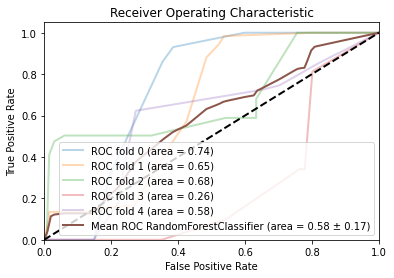

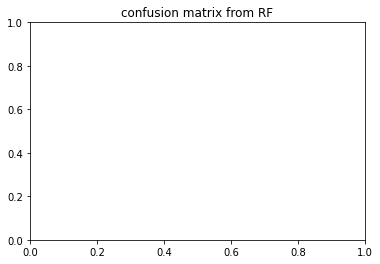

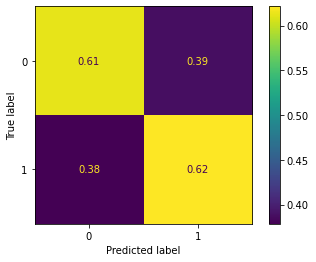

,precision,recall,f1-score,support,auc
0,0.643,0.613,0.603,131.600,0.000
1,0.657,0.625,0.609,131.600,0.000
accuracy,0.615,0.615,0.615,0.615,0.000
macro avg,0.650,0.619,0.606,263.200,0.579
weighted avg,0.652,0.615,0.605,263.200,0.579


coming from


,precision,recall,f1-score,support,auc
0,0.820000,0.645669,0.722467,127.000000,0.000000
1,0.713376,0.861538,0.780488,130.000000,0.000000
accuracy,0.754864,0.754864,0.754864,0.754864,0.000000
macro avg,0.766688,0.753604,0.751477,257.000000,0.735161
weighted avg,0.766066,0.754864,0.751816,257.000000,0.735161


,precision,recall,f1-score,support,auc
0,0.901408,0.477612,0.624390,134.000000,0.00000
1,0.629630,0.944444,0.755556,126.000000,0.00000
accuracy,0.703846,0.703846,0.703846,0.703846,0.00000
macro avg,0.765519,0.711028,0.689973,260.000000,0.64875
weighted avg,0.769700,0.703846,0.687955,260.000000,0.64875


,precision,recall,f1-score,support,auc
0,0.608491,0.984733,0.752187,131.0000,0.000000
1,0.966667,0.411348,0.577114,141.0000,0.000000
accuracy,0.687500,0.687500,0.687500,0.6875,0.000000
macro avg,0.787579,0.698040,0.664651,272.0000,0.675708
weighted avg,0.794163,0.687500,0.661432,272.0000,0.675708


,precision,recall,f1-score,support,auc
0,0.263636,0.221374,0.240664,131.000000,0.000000
1,0.291667,0.341463,0.314607,123.000000,0.000000
accuracy,0.279528,0.279528,0.279528,0.279528,0.000000
macro avg,0.277652,0.281419,0.277635,254.000000,0.256253
weighted avg,0.277210,0.279528,0.276471,254.000000,0.256253


,precision,recall,f1-score,support,auc
0,0.622642,0.733333,0.673469,135.000000,0.000000
1,0.684211,0.565217,0.619048,138.000000,0.000000
accuracy,0.648352,0.648352,0.648352,0.648352,0.000000
macro avg,0.653426,0.649275,0.646259,273.000000,0.581025
weighted avg,0.653764,0.648352,0.645959,273.000000,0.581025


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 0.8, 'n_estimators': 10}
depth_1000_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.510 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.880 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.579 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.240 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.782 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.576 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.983 total time=   0.1s
[CV 3/5] END crit

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.774 total time=   1.7s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.582 total time=   1.7s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.563 total time=   1.5s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.329 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.937 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.570 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.363 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.580 total time=   0.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.590 total time=   0.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.331 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.674 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.756 total time=   2.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.576 total time=   1.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.531 total time=   1.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.367 total time=   1.9s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

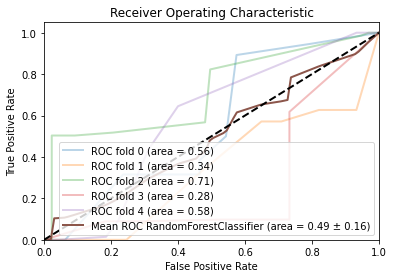

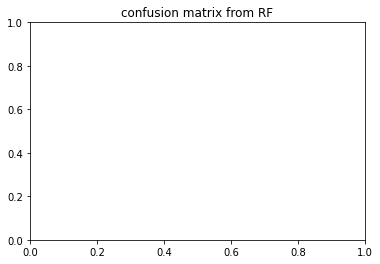

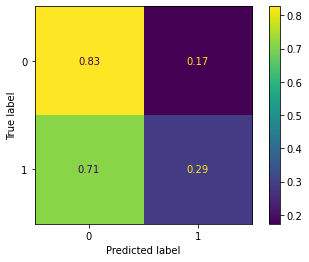

,precision,recall,f1-score,support,auc
0,0.535,0.825,0.639,131.600,0.000
1,0.406,0.279,0.323,131.600,0.000
accuracy,0.556,0.556,0.556,0.556,0.000
macro avg,0.470,0.552,0.481,263.200,0.494
weighted avg,0.475,0.556,0.485,263.200,0.494


coming from


,precision,recall,f1-score,support,auc
0,0.471545,0.456693,0.464000,127.000000,0.000000
1,0.485075,0.500000,0.492424,130.000000,0.000000
accuracy,0.478599,0.478599,0.478599,0.478599,0.000000
macro avg,0.478310,0.478346,0.478212,257.000000,0.557965
weighted avg,0.478389,0.478599,0.478378,257.000000,0.557965


,precision,recall,f1-score,support,auc
0,0.515385,1.000000,0.680203,134.000000,0.000000
1,0.000000,0.000000,0.000000,126.000000,0.000000
accuracy,0.515385,0.515385,0.515385,0.515385,0.000000
macro avg,0.257692,0.500000,0.340102,260.000000,0.343817
weighted avg,0.265621,0.515385,0.350566,260.000000,0.343817


,precision,recall,f1-score,support,auc
0,0.627451,0.977099,0.764179,131.000000,0.000000
1,0.955882,0.460993,0.622010,141.000000,0.000000
accuracy,0.709559,0.709559,0.709559,0.709559,0.000000
macro avg,0.791667,0.719046,0.693094,272.000000,0.713307
weighted avg,0.797704,0.709559,0.690481,272.000000,0.713307


,precision,recall,f1-score,support,auc
0,0.515748,1.000000,0.680519,131.000000,0.000000
1,0.000000,0.000000,0.000000,123.000000,0.000000
accuracy,0.515748,0.515748,0.515748,0.515748,0.000000
macro avg,0.257874,0.500000,0.340260,254.000000,0.276112
weighted avg,0.265996,0.515748,0.350977,254.000000,0.276112


,precision,recall,f1-score,support,auc
0,0.543860,0.688889,0.607843,135.00000,0.000000
1,0.588235,0.434783,0.500000,138.00000,0.000000
accuracy,0.560440,0.560440,0.560440,0.56044,0.000000
macro avg,0.566047,0.561836,0.553922,273.00000,0.579844
weighted avg,0.566291,0.560440,0.553329,273.00000,0.579844


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 0.8, 'n_estimators': 10}
depth_1000_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.832 total time=   0.1s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.570 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.293 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.805 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.636 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.531 total time=   0.1s
[CV 3/5]

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.767 total time=   3.3s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.705 total time=   3.1s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.476 total time=   2.8s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.708 total time=   3.1s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.524 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.693 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.482 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.605 total time=   1.5s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.475 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.665 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.466 total time=   2.9s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.723 total time=   3.5s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.624 total time=   3.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.476 total time=   3.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.805 total time=   3.4s


<Figure size 432x288 with 0 Axes>

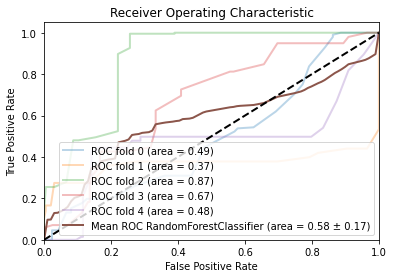

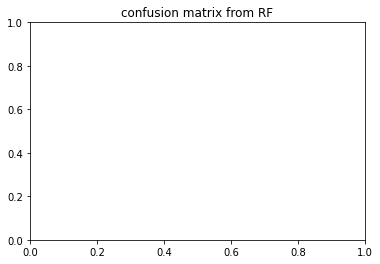

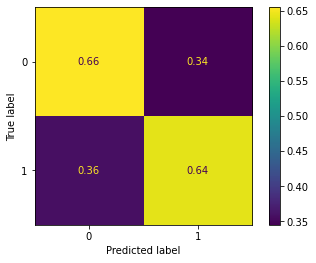

,precision,recall,f1-score,support,auc
0,0.723,0.662,0.617,200.000,0.000
1,0.715,0.641,0.601,200.000,0.000
accuracy,0.649,0.649,0.649,0.649,0.000
macro avg,0.719,0.651,0.609,400.000,0.576
weighted avg,0.720,0.649,0.608,400.000,0.576


coming from


,precision,recall,f1-score,support,auc
0,0.878788,0.137441,0.237705,211.000000,0.000000
1,0.514667,0.979695,0.674825,197.000000,0.000000
accuracy,0.544118,0.544118,0.544118,0.544118,0.000000
macro avg,0.696727,0.558568,0.456265,408.000000,0.492843
weighted avg,0.702974,0.544118,0.448765,408.000000,0.492843


,precision,recall,f1-score,support,auc
0,0.546479,0.979798,0.701627,198.000000,0.000000
1,0.888889,0.165803,0.279476,193.000000,0.000000
accuracy,0.578005,0.578005,0.578005,0.578005,0.000000
macro avg,0.717684,0.572801,0.490552,391.000000,0.370636
weighted avg,0.715495,0.578005,0.493251,391.000000,0.370636


,precision,recall,f1-score,support,auc
0,0.953947,0.743590,0.835735,195.000000,0.000000
1,0.797571,0.965686,0.873614,204.000000,0.000000
accuracy,0.857143,0.857143,0.857143,0.857143,0.000000
macro avg,0.875759,0.854638,0.854675,399.000000,0.866968
weighted avg,0.873995,0.857143,0.855102,399.000000,0.866968


,precision,recall,f1-score,support,auc
0,0.661017,0.590909,0.624000,198.000000,0.000000
1,0.628440,0.695431,0.660241,197.000000,0.000000
accuracy,0.643038,0.643038,0.643038,0.643038,0.000000
macro avg,0.644729,0.643170,0.642120,395.000000,0.670115
weighted avg,0.644770,0.643038,0.642075,395.000000,0.670115


,precision,recall,f1-score,support,auc
0,0.574324,0.858586,0.688259,198.000000,0.000000
1,0.747748,0.397129,0.518750,209.000000,0.000000
accuracy,0.621622,0.621622,0.621622,0.621622,0.000000
macro avg,0.661036,0.627858,0.603505,407.000000,0.477563
weighted avg,0.663380,0.621622,0.601214,407.000000,0.477563


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'sqrt', 'n_estimators': 50}
depth_1000_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.808 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.630 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.673 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.795 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.483 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.551 total time=   0.2s
[CV 3/5] END c

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.778 total time=   3.3s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.694 total time=   3.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.501 total time=   2.9s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.669 total time=   3.2s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.617 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.622 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.680 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.591 total time=   1.5s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.454 total time=   1.4s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.625 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.563 total time=   2.9s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.752 total time=   3.5s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.609 total time=   3.1s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.522 total time=   2.9s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.802 total time=   3.3s


<Figure size 432x288 with 0 Axes>

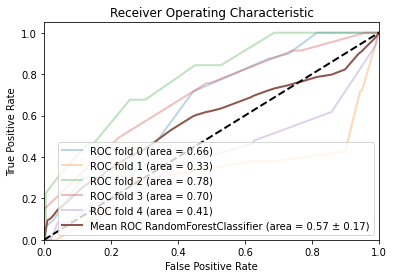

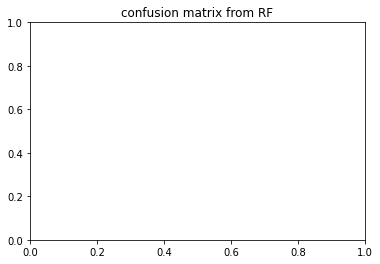

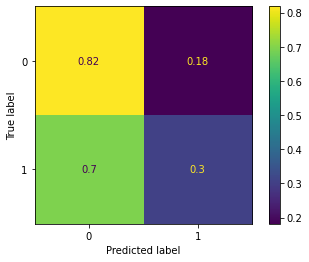

,precision,recall,f1-score,support,auc
0,0.547,0.819,0.652,200.000,0.000
1,0.497,0.306,0.378,200.000,0.000
accuracy,0.561,0.561,0.561,0.561,0.000
macro avg,0.522,0.563,0.515,400.000,0.575
weighted avg,0.521,0.561,0.514,400.000,0.575


coming from


,precision,recall,f1-score,support,auc
0,0.534247,0.739336,0.620278,211.000000,0.000000
1,0.525862,0.309645,0.389776,197.000000,0.000000
accuracy,0.531863,0.531863,0.531863,0.531863,0.000000
macro avg,0.530054,0.524491,0.505027,408.000000,0.655905
weighted avg,0.530198,0.531863,0.508982,408.000000,0.655905


,precision,recall,f1-score,support,auc
0,0.510345,0.747475,0.606557,198.000000,0.000000
1,0.504950,0.264249,0.346939,193.000000,0.000000
accuracy,0.508951,0.508951,0.508951,0.508951,0.000000
macro avg,0.507648,0.505862,0.476748,391.000000,0.330651
weighted avg,0.507682,0.508951,0.478408,391.000000,0.330651


,precision,recall,f1-score,support,auc
0,0.603636,0.851282,0.706383,195.000000,0.000000
1,0.766129,0.465686,0.579268,204.000000,0.000000
accuracy,0.654135,0.654135,0.654135,0.654135,0.000000
macro avg,0.684883,0.658484,0.642826,399.000000,0.782114
weighted avg,0.686715,0.654135,0.641392,399.000000,0.782114


,precision,recall,f1-score,support,auc
0,0.606299,0.777778,0.681416,198.000000,0.000000
1,0.687943,0.492386,0.573964,197.000000,0.000000
accuracy,0.635443,0.635443,0.635443,0.635443,0.000000
macro avg,0.647121,0.635082,0.627690,395.000000,0.696444
weighted avg,0.647018,0.635443,0.627826,395.000000,0.696444


,precision,recall,f1-score,support,auc
0,0.481390,0.979798,0.645591,198.000000,0.000000
1,0.000000,0.000000,0.000000,209.000000,0.000000
accuracy,0.476658,0.476658,0.476658,0.476658,0.000000
macro avg,0.240695,0.489899,0.322795,407.000000,0.408898
weighted avg,0.234190,0.476658,0.314071,407.000000,0.408898


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'sqrt', 'n_estimators': 10}
depth_1000_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.585 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.476 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.539 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.817 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.820 total time=   0.0s
[CV 3/5

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.525 total time=   1.4s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.576 total time=   1.3s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.502 total time=   1.3s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.583 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.670 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.805 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.650 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.535 total time=   0.7s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.472 total time=   0.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.595 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.734 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.527 total time=   1.7s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.527 total time=   1.6s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.486 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.569 total time=   1.6s


<Figure size 432x288 with 0 Axes>

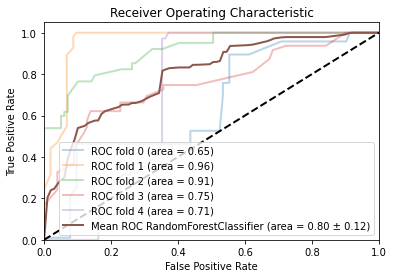

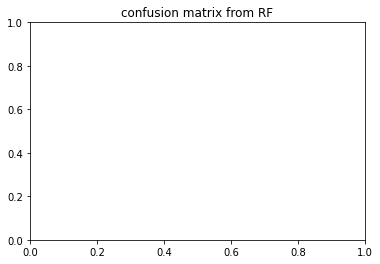

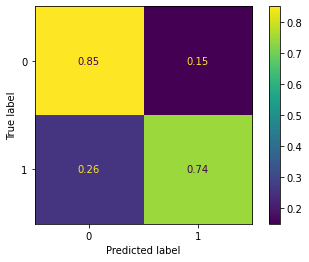

,precision,recall,f1-score,support,auc
0,0.800,0.851,0.810,102.200,0.000
1,0.835,0.730,0.761,102.200,0.000
accuracy,0.794,0.794,0.794,0.794,0.000
macro avg,0.818,0.790,0.785,204.400,0.797
weighted avg,0.816,0.794,0.786,204.400,0.797


coming from


,precision,recall,f1-score,support,auc
0,0.628378,0.902913,0.741036,103.000000,0.000000
1,0.800000,0.421053,0.551724,95.000000,0.000000
accuracy,0.671717,0.671717,0.671717,0.671717,0.000000
macro avg,0.714189,0.661983,0.646380,198.000000,0.654216
weighted avg,0.710722,0.671717,0.650204,198.000000,0.654216


,precision,recall,f1-score,support,auc
0,0.979167,0.912621,0.944724,103.000000,0.000000
1,0.923729,0.981982,0.951965,111.000000,0.000000
accuracy,0.948598,0.948598,0.948598,0.948598,0.000000
macro avg,0.951448,0.947302,0.948344,214.000000,0.959285
weighted avg,0.950412,0.948598,0.948480,214.000000,0.959285


,precision,recall,f1-score,support,auc
0,0.747967,0.929293,0.828829,99.000000,0.000000
1,0.910256,0.696078,0.788889,102.000000,0.000000
accuracy,0.810945,0.810945,0.810945,0.810945,0.000000
macro avg,0.829112,0.812686,0.808859,201.000000,0.910378
weighted avg,0.830323,0.810945,0.808561,201.000000,0.910378


,precision,recall,f1-score,support,auc
0,0.687500,0.871287,0.768559,101.000000,0.000000
1,0.808824,0.578947,0.674847,95.000000,0.000000
accuracy,0.729592,0.729592,0.729592,0.729592,0.000000
macro avg,0.748162,0.725117,0.721703,196.000000,0.754143
weighted avg,0.746305,0.729592,0.723137,196.000000,0.754143


,precision,recall,f1-score,support,auc
0,0.957143,0.638095,0.765714,105.000000,0.000000
1,0.734266,0.972222,0.836653,108.000000,0.000000
accuracy,0.807512,0.807512,0.807512,0.807512,0.000000
macro avg,0.845704,0.805159,0.801184,213.000000,0.707011
weighted avg,0.844135,0.807512,0.801683,213.000000,0.707011


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.790 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.841 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.686 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.433 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.381 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.880 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.943 total time=   0.0s
[CV 3/5] 

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.532 total time=   1.4s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.591 total time=   1.3s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.372 total time=   1.3s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.636 total time=   1.4s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.622 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.692 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.705 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.788 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.528 total time=   0.8s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.404 total time=   0.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.592 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.700 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.571 total time=   1.7s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.523 total time=   1.6s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.472 total time=   1.6s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.6s


<Figure size 432x288 with 0 Axes>

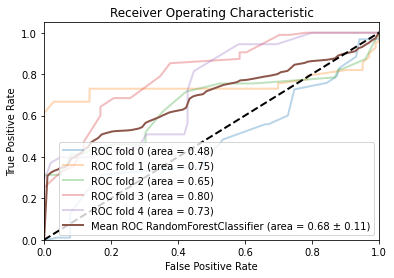

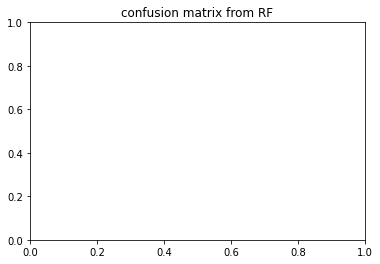

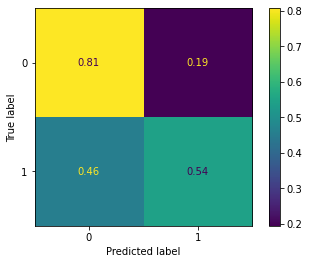

,precision,recall,f1-score,support,auc
0,0.655,0.808,0.709,102.200,0.000
1,0.760,0.540,0.599,102.200,0.000
accuracy,0.674,0.674,0.674,0.674,0.000
macro avg,0.707,0.674,0.654,204.400,0.682
weighted avg,0.709,0.674,0.655,204.400,0.682


coming from


,precision,recall,f1-score,support,auc
0,0.552147,0.873786,0.676692,103.000000,0.000000
1,0.628571,0.231579,0.338462,95.000000,0.000000
accuracy,0.565657,0.565657,0.565657,0.565657,0.000000
macro avg,0.590359,0.552683,0.507577,198.000000,0.475677
weighted avg,0.588815,0.565657,0.514410,198.000000,0.475677


,precision,recall,f1-score,support,auc
0,0.705479,1.000000,0.827309,103.000000,0.000000
1,1.000000,0.612613,0.759777,111.000000,0.000000
accuracy,0.799065,0.799065,0.799065,0.799065,0.000000
macro avg,0.852740,0.806306,0.793543,214.000000,0.745211
weighted avg,0.858245,0.799065,0.792281,214.000000,0.745211


,precision,recall,f1-score,support,auc
0,0.581250,0.939394,0.718147,99.000000,0.000000
1,0.853659,0.343137,0.489510,102.000000,0.000000
accuracy,0.636816,0.636816,0.636816,0.636816,0.000000
macro avg,0.717454,0.641266,0.603829,201.000000,0.652951
weighted avg,0.719487,0.636816,0.602122,201.000000,0.652951


,precision,recall,f1-score,support,auc
0,0.767442,0.653465,0.705882,101.000000,0.000000
1,0.681818,0.789474,0.731707,95.000000,0.000000
accuracy,0.719388,0.719388,0.719388,0.719388,0.000000
macro avg,0.724630,0.721470,0.718795,196.000000,0.804325
weighted avg,0.725941,0.719388,0.718400,196.000000,0.804325


,precision,recall,f1-score,support,auc
0,0.666667,0.571429,0.615385,105.000000,0.000000
1,0.634146,0.722222,0.675325,108.000000,0.000000
accuracy,0.647887,0.647887,0.647887,0.647887,0.000000
macro avg,0.650407,0.646825,0.645355,213.000000,0.730732
weighted avg,0.650177,0.647887,0.645777,213.000000,0.730732


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'sqrt', 'n_estimators': 50}
depth_1000_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.734 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.321 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.655 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.641 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.781 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.778 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.263 total time=   0.1s
[CV 3/5

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.290 total time=   2.4s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.610 total time=   2.3s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.689 total time=   2.5s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.633 total time=   2.7s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.829 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.307 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.630 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.660 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.495 total time=   1.2s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.800 total time=   1.2s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.772 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.652 total time=   2.9s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.389 total time=   2.5s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.567 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.778 total time=   2.4s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.690 total time=   3.0s


<Figure size 432x288 with 0 Axes>

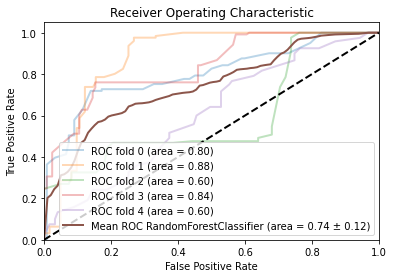

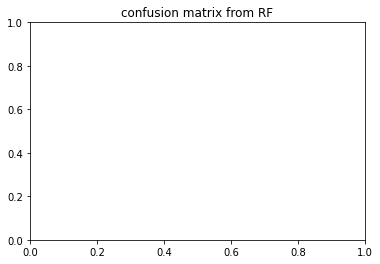

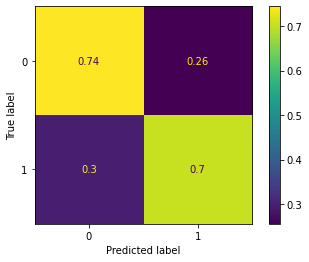

,precision,recall,f1-score,support,auc
0,0.731,0.744,0.725,122.800,0.000
1,0.747,0.704,0.711,122.800,0.000
accuracy,0.724,0.724,0.724,0.724,0.000
macro avg,0.739,0.724,0.718,245.600,0.743
weighted avg,0.738,0.724,0.718,245.600,0.743


coming from


,precision,recall,f1-score,support,auc
0,0.705882,0.885246,0.785455,122.000000,0.000000
1,0.844444,0.628099,0.720379,121.000000,0.000000
accuracy,0.757202,0.757202,0.757202,0.757202,0.000000
macro avg,0.775163,0.756673,0.752917,243.000000,0.802432
weighted avg,0.774878,0.757202,0.753051,243.000000,0.802432


,precision,recall,f1-score,support,auc
0,0.947368,0.731707,0.825688,123.00000,0.000000
1,0.785714,0.960317,0.864286,126.00000,0.000000
accuracy,0.847390,0.847390,0.847390,0.84739,0.000000
macro avg,0.866541,0.846012,0.844987,249.00000,0.879275
weighted avg,0.865568,0.847390,0.845219,249.00000,0.879275


,precision,recall,f1-score,support,auc
0,0.585799,0.811475,0.680412,122.000,0.00000
1,0.708861,0.444444,0.546341,126.000,0.00000
accuracy,0.625000,0.625000,0.625000,0.625,0.00000
macro avg,0.647330,0.627960,0.613377,248.000,0.59501
weighted avg,0.648322,0.625000,0.612296,248.000,0.59501


,precision,recall,f1-score,support,auc
0,0.766423,0.846774,0.804598,124.000000,0.000000
1,0.824074,0.735537,0.777293,121.000000,0.000000
accuracy,0.791837,0.791837,0.791837,0.791837,0.000000
macro avg,0.795249,0.791156,0.790945,245.000000,0.836777
weighted avg,0.794896,0.791837,0.791112,245.000000,0.836777


,precision,recall,f1-score,support,auc
0,0.647059,0.447154,0.528846,123.000000,0.000000
1,0.569620,0.750000,0.647482,120.000000,0.000000
accuracy,0.596708,0.596708,0.596708,0.596708,0.000000
macro avg,0.608340,0.598577,0.588164,243.000000,0.603659
weighted avg,0.608818,0.596708,0.587432,243.000000,0.603659


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'sqrt', 'n_estimators': 100}
depth_1000_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.743 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.221 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.511 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.754 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.508 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.644 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.298 total time=   0.1s
[CV 3/5] END

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.338 total time=   2.4s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.574 total time=   2.3s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.702 total time=   2.3s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.714 total time=   2.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.496 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.679 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.789 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.558 total time=   1.2s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.812 total time=   1.2s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.754 total time=   1.4s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.698 total time=   2.8s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.286 total time=   2.4s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.571 total time=   2.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.755 total time=   2.4s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.803 total time=   2.9s


<Figure size 432x288 with 0 Axes>

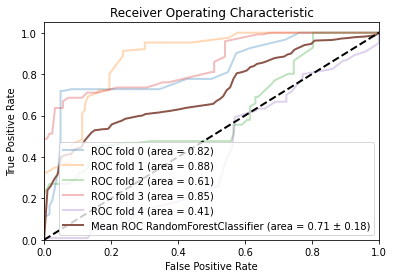

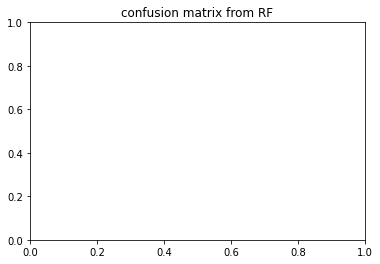

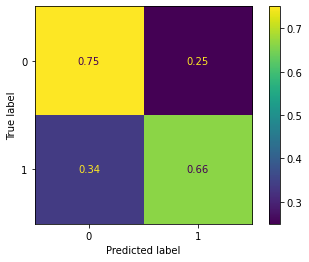

,precision,recall,f1-score,support,auc
0,0.685,0.751,0.694,122.800,0.000
1,0.775,0.665,0.690,122.800,0.000
accuracy,0.707,0.707,0.707,0.707,0.000
macro avg,0.730,0.708,0.692,245.600,0.715
weighted avg,0.730,0.707,0.691,245.600,0.715


coming from


,precision,recall,f1-score,support,auc
0,0.725000,0.950820,0.822695,122.000000,0.000000
1,0.927711,0.636364,0.754902,121.000000,0.000000
accuracy,0.794239,0.794239,0.794239,0.794239,0.000000
macro avg,0.826355,0.793592,0.788798,243.000000,0.820485
weighted avg,0.825938,0.794239,0.788938,243.000000,0.820485


,precision,recall,f1-score,support,auc
0,0.870370,0.764228,0.813853,123.000000,0.000000
1,0.794326,0.888889,0.838951,126.000000,0.000000
accuracy,0.827309,0.827309,0.827309,0.827309,0.000000
macro avg,0.832348,0.826558,0.826402,249.000000,0.882985
weighted avg,0.831890,0.827309,0.826553,249.000000,0.882985


,precision,recall,f1-score,support,auc
0,0.563830,0.868852,0.683871,122.000000,0.000000
1,0.733333,0.349206,0.473118,126.000000,0.000000
accuracy,0.604839,0.604839,0.604839,0.604839,0.000000
macro avg,0.648582,0.609029,0.578495,248.000000,0.614234
weighted avg,0.649949,0.604839,0.576795,248.000000,0.614234


,precision,recall,f1-score,support,auc
0,0.745223,0.943548,0.832740,124.000000,0.000000
1,0.920455,0.669421,0.775120,121.000000,0.000000
accuracy,0.808163,0.808163,0.808163,0.808163,0.000000
macro avg,0.832839,0.806485,0.803930,245.000000,0.852406
weighted avg,0.831766,0.808163,0.804283,245.000000,0.852406


,precision,recall,f1-score,support,auc
0,0.518519,0.227642,0.316384,123.000000,0.000000
1,0.497354,0.783333,0.608414,120.000000,0.000000
accuracy,0.502058,0.502058,0.502058,0.502058,0.000000
macro avg,0.507937,0.505488,0.462399,243.000000,0.405386
weighted avg,0.508067,0.502058,0.460597,243.000000,0.405386


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 100}


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.731302,0.693635,0.691253
irm1_both_APOE_one_hot,0.674220,0.713577,0.740433
irm2_both_APOE_nbr_allelle_4,0.705051,0.697531,0.669002
irm2_both_APOE_one_hot,0.678719,0.669177,0.711257
irm1_under_APOE_nbr_allelle_4,0.793653,0.759173,0.775443
irm1_under_APOE_one_hot,0.782128,0.786070,0.784586
irm2_under_APOE_nbr_allelle_4,0.699677,0.698638,0.678138
irm2_under_APOE_one_hot,0.678314,0.705413,0.698549


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.659388,0.906996,0.660781
irm1_both_APOE_one_hot,0.900969,0.931678,0.580224
irm2_both_APOE_nbr_allelle_4,0.704513,0.536483,0.498268
irm2_both_APOE_one_hot,0.585585,0.621322,0.488513
irm1_under_APOE_nbr_allelle_4,0.702708,0.523812,0.565253
irm1_under_APOE_one_hot,0.416147,0.717833,0.480378
irm2_under_APOE_nbr_allelle_4,0.811374,0.728763,0.754064
irm2_under_APOE_one_hot,0.636601,0.731947,0.789155


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.671291,0.617542,0.579379
irm1_both_APOE_one_hot,0.762811,0.759590,0.494209
irm2_both_APOE_nbr_allelle_4,0.483270,0.597987,0.575625
irm2_both_APOE_one_hot,0.593802,0.618576,0.574802
irm1_under_APOE_nbr_allelle_4,0.670820,0.727087,0.797006
irm1_under_APOE_one_hot,0.740909,0.662986,0.681779
irm2_under_APOE_nbr_allelle_4,0.739273,0.707209,0.743430
irm2_under_APOE_one_hot,0.742869,0.697266,0.715099


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.125514,0.102737,0.168981
irm1_both_APOE_one_hot,0.146108,0.158173,0.160988
irm2_both_APOE_nbr_allelle_4,0.128340,0.156802,0.174527
irm2_both_APOE_one_hot,0.195692,0.159667,0.174061
irm1_under_APOE_nbr_allelle_4,0.077217,0.139720,0.117909
irm1_under_APOE_one_hot,0.081507,0.104870,0.113795
irm2_under_APOE_nbr_allelle_4,0.124663,0.164184,0.120177
irm2_under_APOE_one_hot,0.099954,0.141344,0.181241


the score on cross_val: 


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.671291,0.617542,0.579379
irm1_both_APOE_one_hot,0.762811,0.759590,0.494209
irm2_both_APOE_nbr_allelle_4,0.483270,0.597987,0.575625
irm2_both_APOE_one_hot,0.593802,0.618576,0.574802
irm1_under_APOE_nbr_allelle_4,0.670820,0.727087,0.797006
irm1_under_APOE_one_hot,0.740909,0.662986,0.681779
irm2_under_APOE_nbr_allelle_4,0.739273,0.707209,0.743430
irm2_under_APOE_one_hot,0.742869,0.697266,0.715099


irm1_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.706 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.448 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.661 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.718 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.808 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.706 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.448 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.661 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.718 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.808 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=linear;, score=0.706 total time=   0.0s
[CV 2

<Figure size 432x288 with 0 Axes>

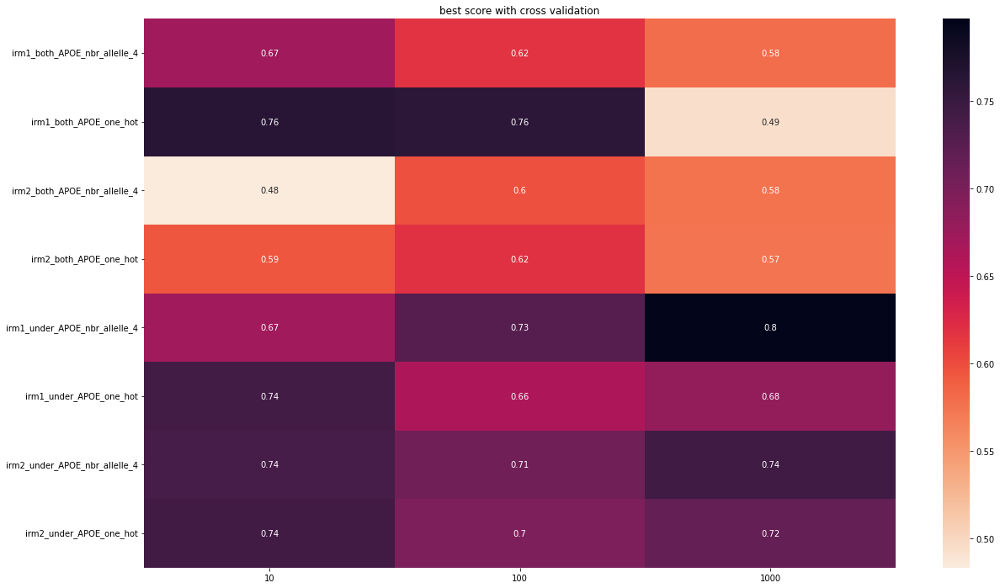

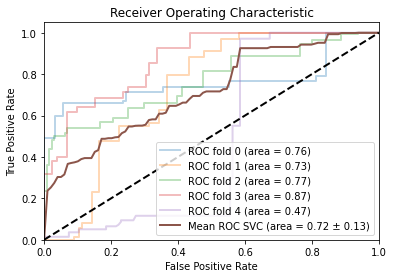

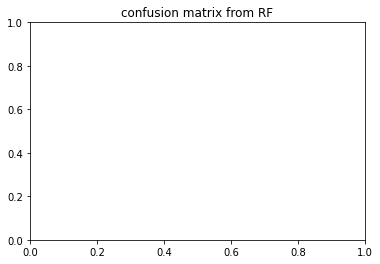

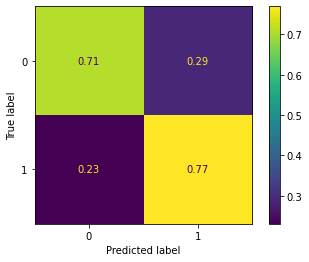

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.716 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.481 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.675 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.743 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.812 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.716 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.481 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.674 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.743 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.812 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=l

<Figure size 432x288 with 0 Axes>

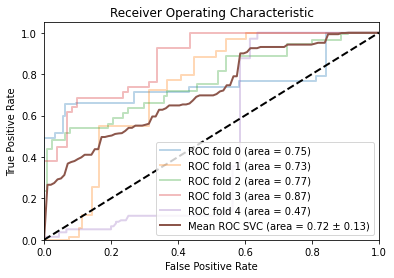

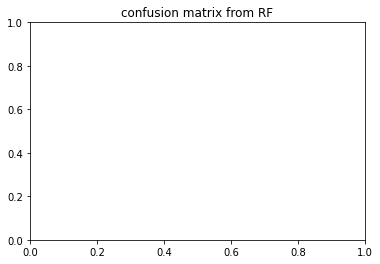

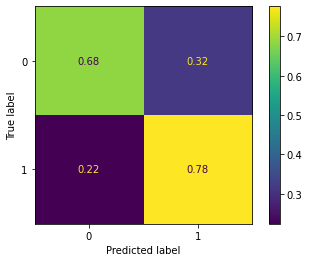

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.483 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.525 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.545 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.648 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.960 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.483 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.525 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.545 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.648 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.960 total time=   0.0s
[CV 1/5] END ..............C=100, ke

<Figure size 432x288 with 0 Axes>

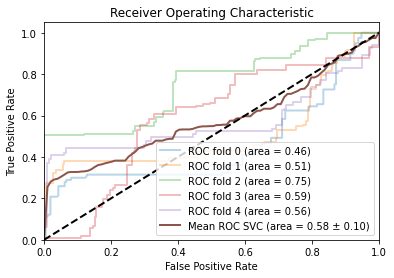

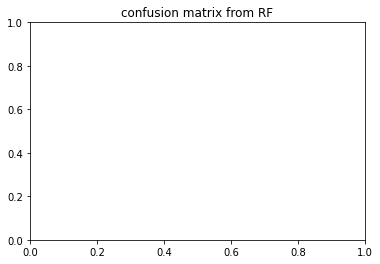

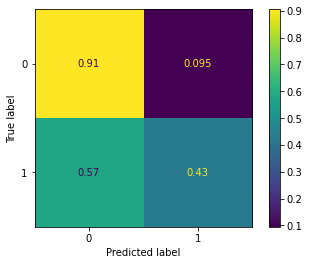

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.487 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.542 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.557 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.670 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.975 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.487 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.542 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.557 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.670 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.975 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=l

<Figure size 432x288 with 0 Axes>

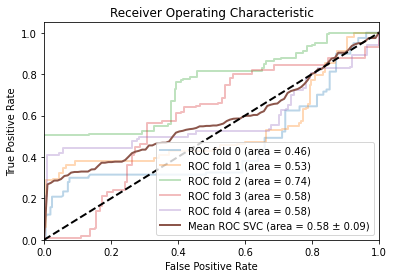

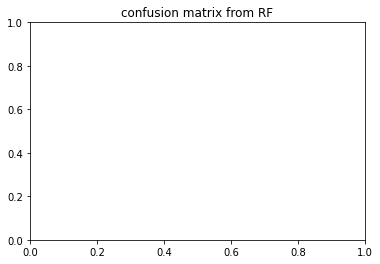

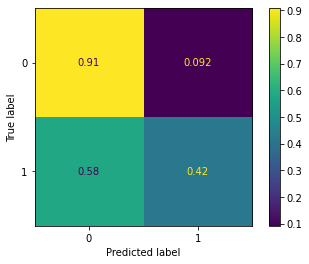

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.742 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.706 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.715 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.895 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.533 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.742 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.706 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.715 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.895 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.533 total time=   0.0s
[CV 1/5] END ..............C=100, k

<Figure size 432x288 with 0 Axes>

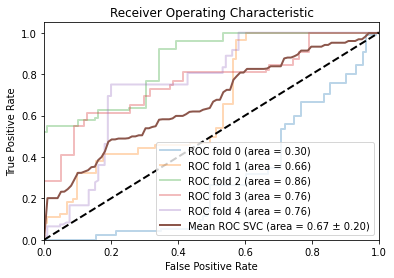

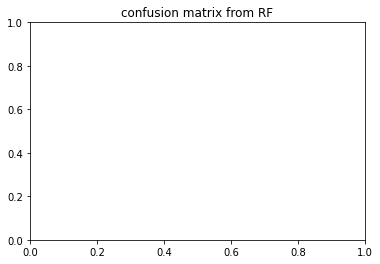

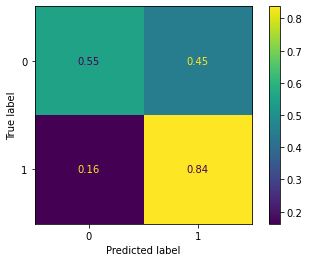

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.729 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.739 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.757 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.902 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.526 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.729 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.739 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.757 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.902 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.526 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

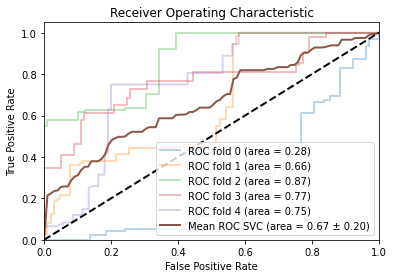

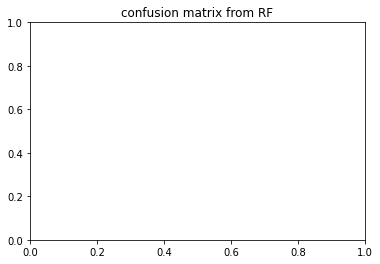

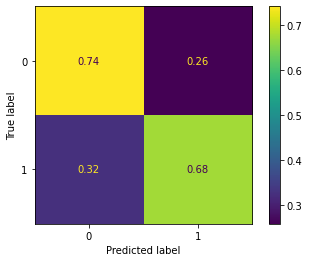

{'C': 100, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.532 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.467 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.611 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.508 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.872 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.532 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.467 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.611 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.508 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.872 total time=   0.0s
[CV 1/5] END ..............C=100,

<Figure size 432x288 with 0 Axes>

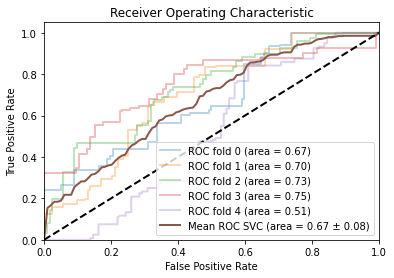

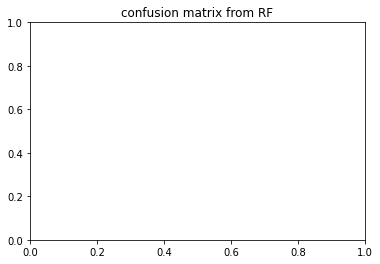

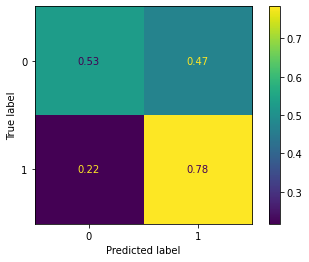

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.535 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.470 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.600 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.533 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.869 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.535 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.470 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.600 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.533 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.869 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=

<Figure size 432x288 with 0 Axes>

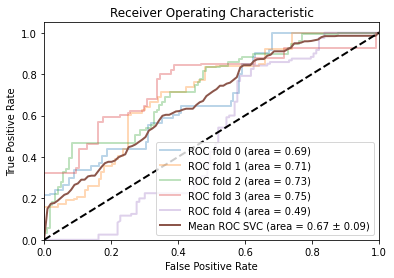

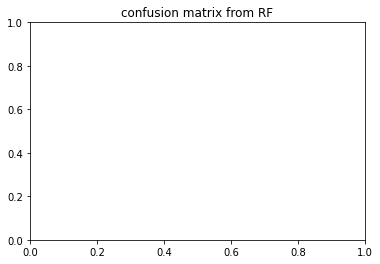

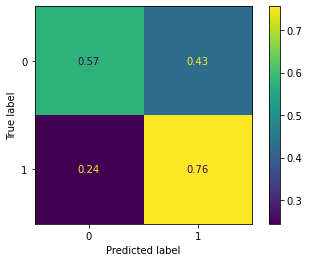

{'C': 100, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.635 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.856 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.658 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.401 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.641 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.643 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.842 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.668 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.588 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.781 total time=   0.0s
[CV 1/5] END .....C=1, gamma=0.0001, 

<Figure size 432x288 with 0 Axes>

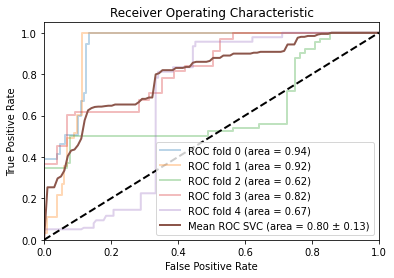

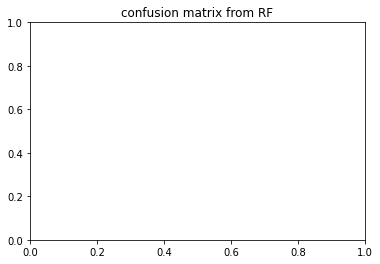

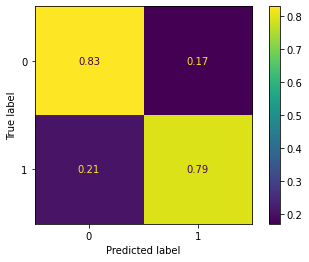

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.637 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.862 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.659 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.404 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.647 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.628 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.847 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.681 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.586 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.794 total time=   0.0s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

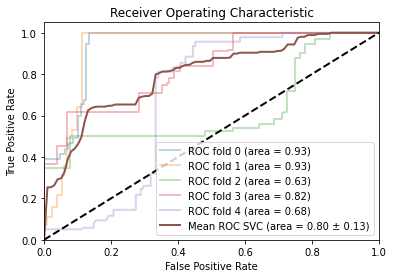

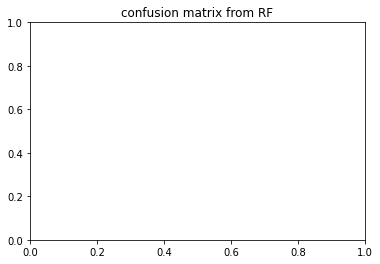

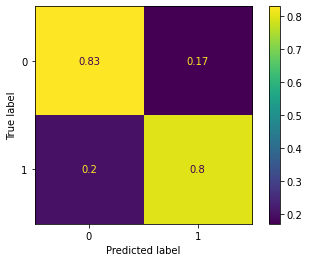

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.606 total time=   0.2s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.630 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.781 total time=   0.2s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.366 total time=   0.2s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.984 total time=   0.2s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.554 total time=   0.2s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.530 total time=   0.2s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.698 total time=   0.2s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.583 total time=   0.2s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.995 total time=   0.2s
[CV 1/5] END .....C=1, ga

<Figure size 432x288 with 0 Axes>

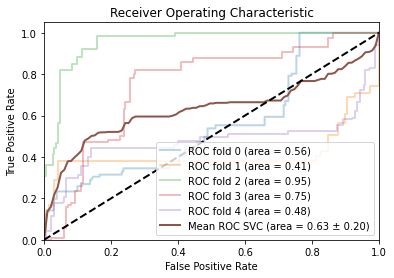

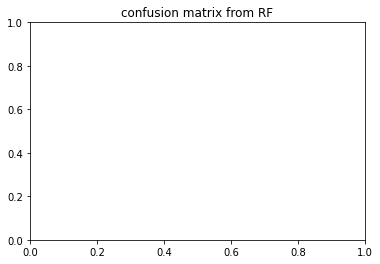

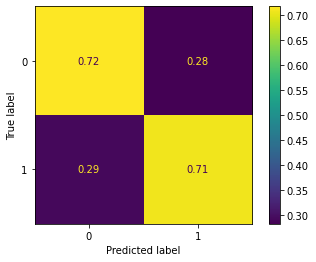

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.604 total time=   0.2s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.627 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.782 total time=   0.2s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.370 total time=   0.2s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.983 total time=   0.2s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.551 total time=   0.2s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.529 total time=   0.2s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.716 total time=   0.2s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.595 total time=   0.2s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.996 total time=   0.2s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

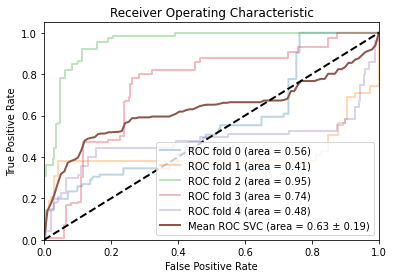

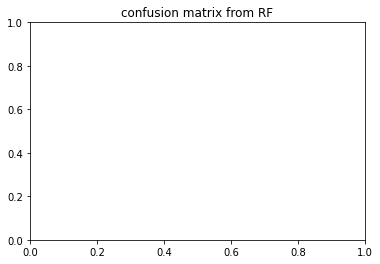

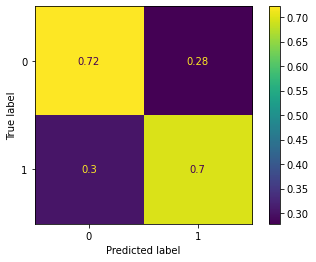

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.795 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.930 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.972 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.920 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.524 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.771 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.902 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.834 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.877 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.498 total time=   0.0s
[CV 1/5] END .....C=1, g

<Figure size 432x288 with 0 Axes>

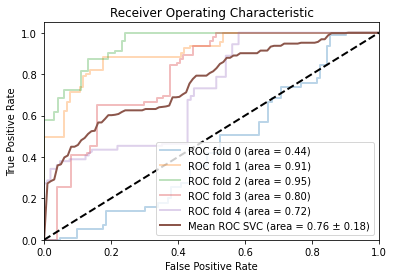

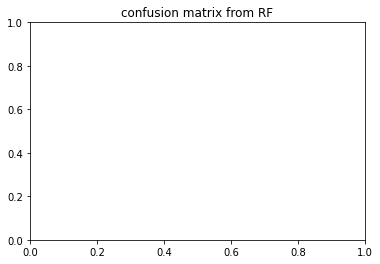

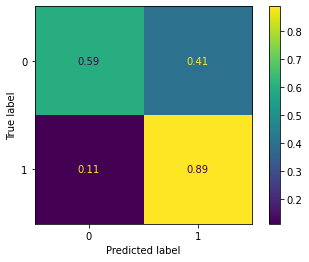

{'C': 100, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.801 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.922 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.977 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.942 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.524 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.772 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.902 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.852 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.878 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.498 total time=   0.0s
[CV 1/5] END .....C=1, gamm

<Figure size 432x288 with 0 Axes>

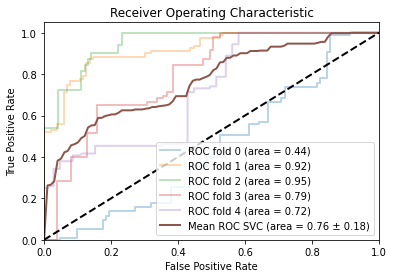

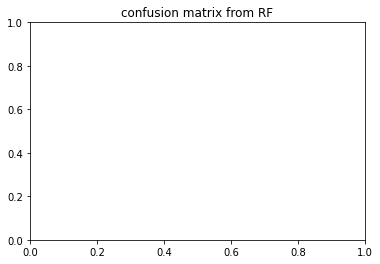

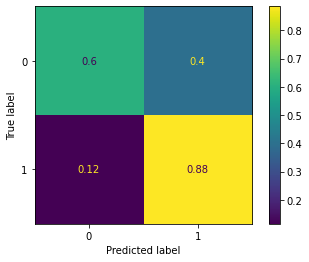

{'C': 100, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.717 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.406 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.581 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.863 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.866 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.724 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.324 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.522 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.855 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.914 total time=   0.1s
[CV 1/5] END .....C=1

<Figure size 432x288 with 0 Axes>

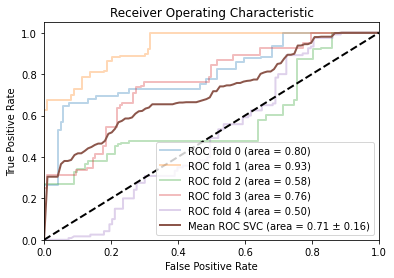

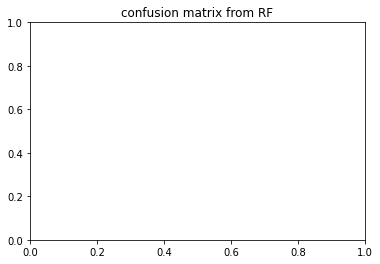

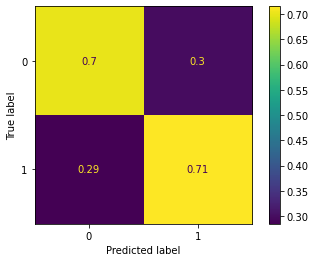

{'C': 1, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.715 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.398 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.571 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.866 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.859 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.725 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.320 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.514 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.869 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.911 total time=   0.1s
[CV 1/5] END .....C=1, gamma=

<Figure size 432x288 with 0 Axes>

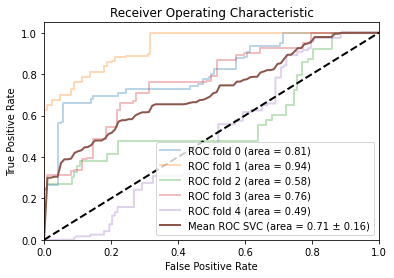

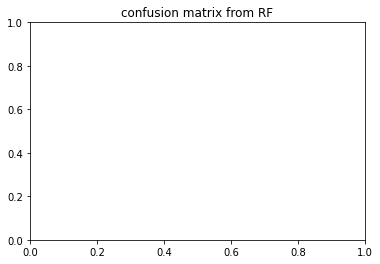

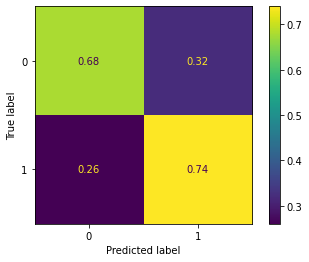

{'C': 1, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.578 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.950 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.577 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.537 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.735 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.236 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.933 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.638 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=0.001, ke

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.380 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.694 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.227 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.963 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.544 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.332 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.495 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=1.000 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.556 total time=   0.0s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.360 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.767 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.701 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.998 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.557 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.346 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.678 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.231 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.422 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.617 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.280 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.496 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.952 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.569 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.575 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.632 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.075 total time=   0.2s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.690 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.595 total time=   0.2s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.683 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.656 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.607 total time=   0.3s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.554 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.332 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.481 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=1.000 total time=   0.0s
[CV 3/5] END C=

[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.456 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.838 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.702 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.499 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.670 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.585 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.784 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.662 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.731 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.641 total time=   0.0s
[CV 4/5] END C=10

[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.567 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.650 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.412 total time=   0.2s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.431 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.952 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.561 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.581 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.560 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.070 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.607 total time=   0.2s
[CV 3/5

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.377 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.786 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.667 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.354 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.560 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.275 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.049 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.569 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.334 total time=   0.2s
[CV 1

[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.661 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.711 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.679 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.998 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.647 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.397 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.750 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.699 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.802 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.668 total time=   0.0s
[CV 4/5]

<Figure size 432x288 with 0 Axes>

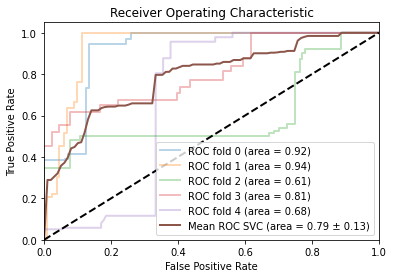

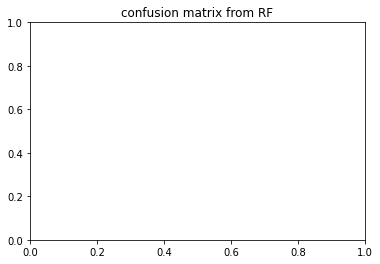

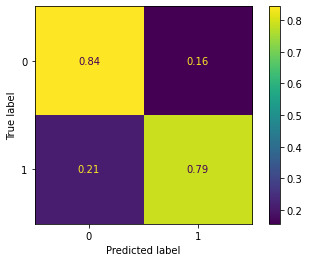

{'C': 10, 'coef0': 0.5, 'degree': 7, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.567 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.951 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.588 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.505 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.746 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.225 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.927 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.638 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, deg

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.383 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.696 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.036 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.544 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.332 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.491 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=1.000 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.557 total time=   0.0s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.364 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.768 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.699 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.998 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.557 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.349 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.680 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.766 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.025 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.623 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.282 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.478 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.952 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.571 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.536 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.637 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.074 total time=   0.2s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.680 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.591 total time=   0.2s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.686 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.347 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.665 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.048 total time=   0.2s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.385 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.552 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.332 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.480 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=1.000 total time=   0.0s
[CV 3/5] END C=

[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.453 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.841 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.688 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.527 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.678 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.573 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.790 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.646 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.782 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.647 total time=   0.0s
[CV 4/5] END C=10

[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.656 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.424 total time=   0.2s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.422 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.952 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.562 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.577 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.582 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.069 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.604 total time=   0.2s
[CV 3/5

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.373 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.774 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.666 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.348 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.575 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.272 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.049 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.569 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.333 total time=   0.2s
[CV 1

[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.736 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.679 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.998 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.653 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.398 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.754 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.711 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.818 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.673 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.530 total time=   0.0s
[CV 5/5] 

<Figure size 432x288 with 0 Axes>

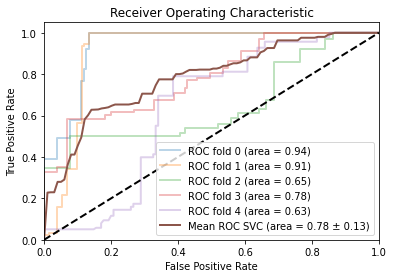

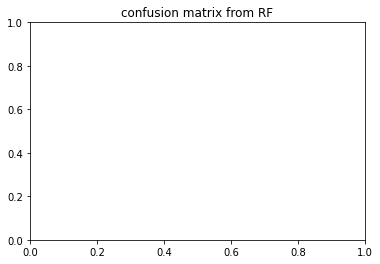

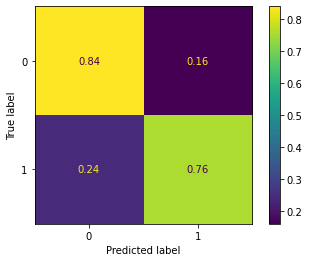

{'C': 1, 'coef0': 1.0, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.898 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.432 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.714 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.608 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=1.000 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.878 total time=   0.6s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.476 total time=   0.6s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.626 total time=   0.6s
[CV 4/5] END C=1, coef0=0.0

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.372 total time=   0.6s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.957 total time=   0.6s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.252 total time=   0.6s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.349 total time=   0.6s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.689 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.366 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.733 total time=   0.2s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.532 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.988 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.630 total time=   0.5s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.507 total time=   0.5s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.822 total time=   0.5s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.488 total time=   0.5s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.951 total time=   0.5s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.751 total time=   0.7s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.510 total time=   0.7s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.736 total time=   0.7s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.207 total time=   0.6s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.866 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.427 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.626 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.687 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.987 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.905 total time=   0.6s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.486 total time=   0.6s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.628 total time=   0.6s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.611 total time=   0.6s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.338 total time=   0.6s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.957 total time=   0.7s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.258 total time=   0.6s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.509 total time=   0.6s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.269 total time=   0.6s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.402 total time=   0.7s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.024 total time=   0.6s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.651 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.388 total time=   0.2s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.525 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.760 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.491 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.985 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.565 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.487 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.673 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.587 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.975 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.507 total time=   0.1s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.508 total time=   0.6s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.257 total time=   0.7s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.274 total time=   0.6s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.540 total time=   0.6s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.856 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.425 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.583 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.731 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.962 total time=   0.2s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.626 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.976 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.501 total time=   0.6s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.449 total time=   0.6s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.533 total time=   0.6s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.322 total time=   0.6s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.941 total time=   0.6s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.264 total time=   0.7s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.494 total time=   0.7s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.271 total time=   0.7s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.508 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.558 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.624 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.956 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.726 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.560 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.788 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.482 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.984 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.605 total time=   0.0s
[CV 2/

<Figure size 432x288 with 0 Axes>

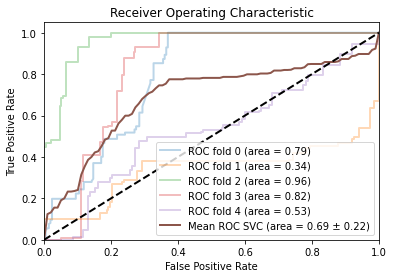

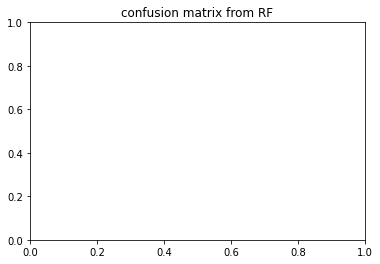

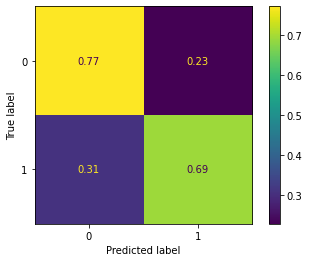

{'C': 1, 'coef0': 0.5, 'degree': 5, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.897 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.417 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.717 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.618 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=1.000 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.874 total time=   0.6s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.474 total time=   0.6s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.631 total time=   0.6s
[CV 4/5] END C=1, coef0=0.0, degr

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.385 total time=   0.6s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.963 total time=   0.7s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.748 total time=   0.7s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.264 total time=   0.6s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.338 total time=   0.7s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.018 total time=   0.6s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.687 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.363 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.735 total time=   0.2s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.534 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.988 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.633 total time=   0.6s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.497 total time=   0.5s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.823 total time=   0.6s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.491 total time=   0.5s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.952 total time=   0.5s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.750 total time=   0.8s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.494 total time=   0.8s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.737 total time=   0.7s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.217 total time=   0.7s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.036 total time=   0.6s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.863 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.411 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.628 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.688 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.991 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.909 total time=   0.7s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.427 total time=   0.7s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.626 total time=   0.7s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.610 total time=   0.6s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.343 total time=   0.6s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.957 total time=   0.7s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.258 total time=   0.7s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.7s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.266 total time=   0.7s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.392 total time=   0.7s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.026 total time=   0.7s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.656 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.386 total time=   0.2s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.518 total time=   0.1s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.760 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.504 total time=   0.1s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.985 total time=   0.1s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.561 total time=   0.1s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.485 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.678 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.604 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.983 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.510 total time=   0.1s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.144 total time=   0.7s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.499 total time=   0.7s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.7s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.276 total time=   0.7s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.7s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.851 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.418 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.584 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.725 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.976 total time=   0.2s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.617 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.978 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.503 total time=   0.6s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.444 total time=   0.6s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.627 total time=   0.6s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.331 total time=   0.6s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.946 total time=   0.9s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.267 total time=   0.7s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.501 total time=   0.8s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.730 total time=   0.7s
[CV 4/5

[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.567 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.640 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.973 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.718 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.548 total time=   0.1s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.791 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.487 total time=   0.1s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.984 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.597 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.495 total time=   0.0s
[CV 3/5

<Figure size 432x288 with 0 Axes>

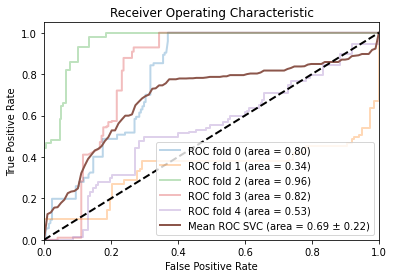

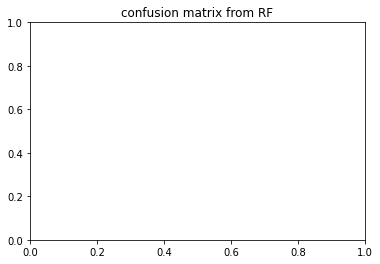

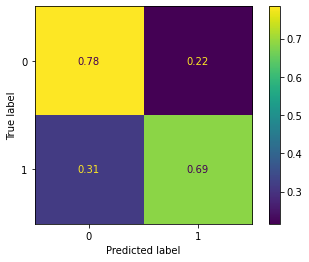

{'C': 1, 'coef0': 0.5, 'degree': 5, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.875 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.989 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.864 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.939 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.484 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.893 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.817 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.870 total time=   0.1s
[CV 4/5] END C=1, coef0=0.

[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.290 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.805 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.012 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.975 total time=   0.1s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.154 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.641 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.877 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.912 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.823 total time=   0.0s
[CV 4/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.984 total time=   0.0s
[CV 5/5] END C=1, coef0=0

[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.821 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=1.000 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.928 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.877 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.380 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.201 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.014 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.476 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.144 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.379 total time=   0.1s
[CV 1/5] END C=1, coef0=1

[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.884 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.942 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.845 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.963 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.496 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.766 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.813 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.829 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.654 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.307 total time=   0.1s
[CV 1/5] END C=10, c

[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.289 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.040 total time=   0.1s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.971 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.166 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.654 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.901 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.882 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.818 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.940 total time=   0.0s
[CV 5/5] END C=

[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.911 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.473 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.765 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.923 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.817 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.915 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.525 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.768 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.885 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.805 total time=   0.0s
[CV 4/5] END C=10

[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.839 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.416 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.704 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.892 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.897 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.798 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.951 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.480 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.733 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.607 total time=   0.1s
[CV 3/5

[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.891 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.799 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.596 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.282 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.818 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.075 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.966 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.174 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.665 total time=   0.1s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.846 total time=   0.0s
[CV 2

[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.913 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.957 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.415 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.786 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.926 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.752 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.915 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.483 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.761 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.838 total time=   0.0s
[CV 3/5]

<Figure size 432x288 with 0 Axes>

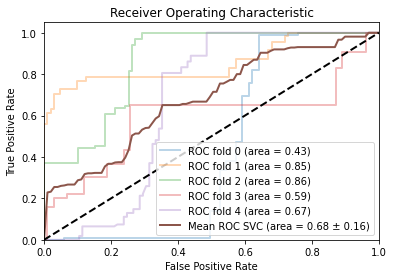

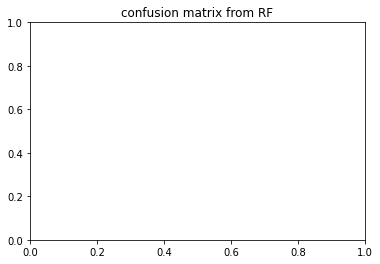

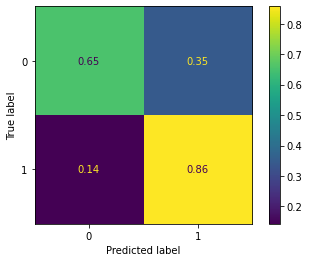

{'C': 100, 'coef0': 0.0, 'degree': 3, 'gamma': 0.001, 'kernel': 'poly', 'probability': True}
irm1_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.877 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.986 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.877 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.971 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.479 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.899 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.821 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.870 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, de

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.591 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.290 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.804 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.007 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.027 total time=   0.1s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.154 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.641 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.876 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.901 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.832 total time=   0.0s
[CV 4/5] END C=1, coef0=0

[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.822 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=1.000 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.938 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.875 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.378 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.369 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.014 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.961 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.143 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.621 total time=   0.1s
[CV 1/5] END C=1, coef0=1

[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.883 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.931 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.846 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.963 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.487 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.771 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.781 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.834 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.651 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.304 total time=   0.1s
[CV 1/5] END C=10, c

[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.289 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.033 total time=   0.1s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.972 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.166 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.653 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.901 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.860 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.820 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.936 total time=   0.0s
[CV 5/5] END C=

[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.473 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.772 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.925 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.886 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.937 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.516 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.774 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.892 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.813 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.879 total time=   0.0s
[CV 5/5] END C=1

[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.419 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.705 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.894 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.892 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.827 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.951 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.471 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.734 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.628 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.801 total time=   0.1s
[CV 4/5]

[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.897 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.814 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.598 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.209 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.815 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.057 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.965 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.174 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.665 total time=   0.1s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.846 total time=   0.0s
[CV 2

[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.612 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.856 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.976 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.944 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.982 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.416 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.787 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.935 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.846 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.927 total time=   0.0s
[CV 5/5] 

<Figure size 432x288 with 0 Axes>

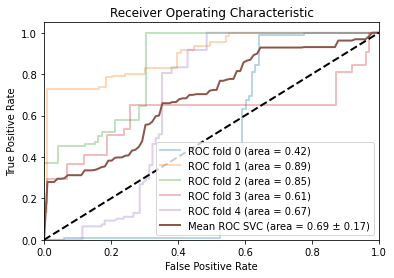

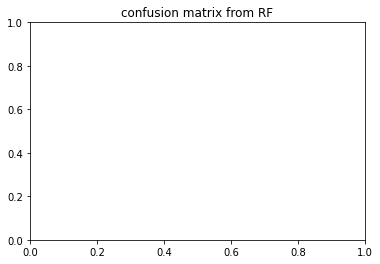

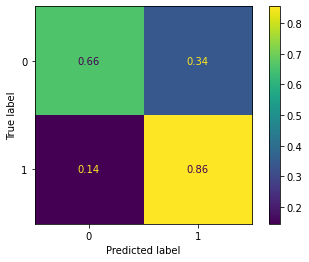

{'C': 10, 'coef0': 0.0, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.886 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.322 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.581 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.768 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.920 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.913 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.241 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.544 total time=   0.2s
[CV 4/5] END C=1, coef0=

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.698 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.768 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.113 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.601 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.502 total time=   0.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.276 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.073 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.778 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.479 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.517 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.859 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.940 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.775 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.310 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.573 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.797 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.914 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.109 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.312 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.885 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.376 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.636 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.769 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.928 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.905 total time=   0.2s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.261 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.554 total time=   0.2s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.562 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.600 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.114 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.601 total time=   0.2s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.503 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.281 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.075 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.742 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.530 total time=   0.1s
[CV 3/5] END C=

[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.582 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.831 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.897 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.711 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.472 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.500 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.762 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.897 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.751 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.329 total time=   0.0s
[CV 3/5] END C=10,

[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.694 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.515 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.341 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.275 total time=   0.2s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.847 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.406 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.693 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.783 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.909 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.902 total time=   0.2s
[CV 2/

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.707 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.252 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.577 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.656 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.526 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.115 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.598 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.499 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.285 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1

[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.852 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.385 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.603 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.847 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.906 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.741 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.450 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.580 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.808 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.891 total time=   0.0s
[CV 1/5] E

<Figure size 432x288 with 0 Axes>

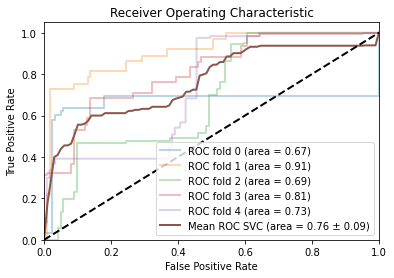

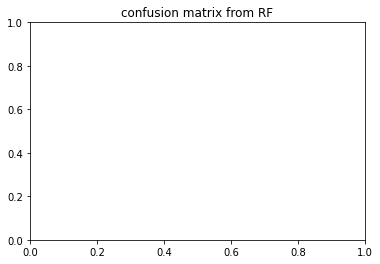

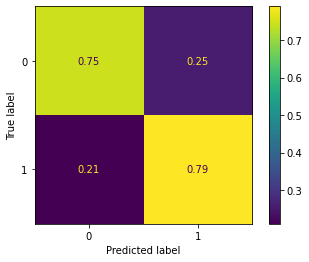

{'C': 100, 'coef0': 0.0, 'degree': 7, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm2_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.881 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.318 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.576 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.772 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.917 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.908 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.246 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.548 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, 

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.698 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.113 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.602 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.502 total time=   0.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.276 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.076 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.790 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.479 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.526 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.866 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.931 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.782 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.307 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.575 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.797 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.911 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.109 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.609 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.505 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.312 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.891 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.378 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.617 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.772 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.924 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.904 total time=   0.2s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.260 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.557 total time=   0.2s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.562 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.599 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.114 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.601 total time=   0.2s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.503 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.281 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.753 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.529 total time=   0.1s
[CV 3/5] END C=

[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.572 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.836 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.897 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.711 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.465 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.498 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.778 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.893 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.752 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.331 total time=   0.0s
[CV 3/5] END C=10,

[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.684 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.515 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.341 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.282 total time=   0.2s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.856 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.405 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.661 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.791 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.902 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.899 total time=   0.2s
[CV 2/

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.737 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.256 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.579 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.655 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.526 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.114 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.600 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.498 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.285 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.077 total time=   0.2s
[CV 1

[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.842 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.377 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.596 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.849 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.905 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.740 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.442 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.574 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.814 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.890 total time=   0.0s
[CV 1/5] E

<Figure size 432x288 with 0 Axes>

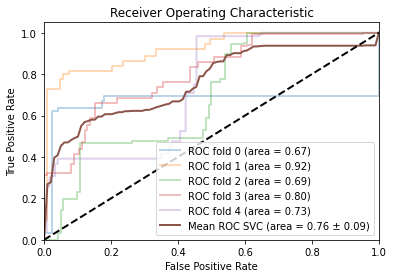

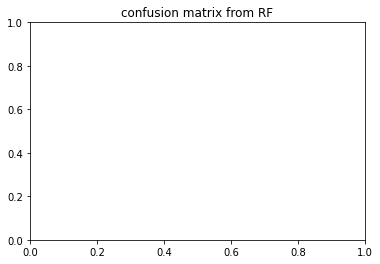

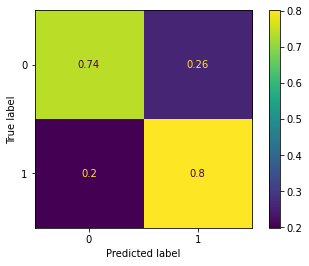

{'C': 100, 'coef0': 0.0, 'degree': 7, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.446 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.735 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.364 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.628 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.365 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.630 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.838 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.586 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.628 total t

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.805 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.411 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.618 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.672 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.791 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.615 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.696 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.520 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.523 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.630 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.683 total time=   0.0

{'C': 1, 'coef0': 0.0, 'gamma': 0.0001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

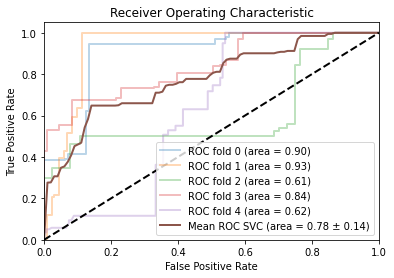

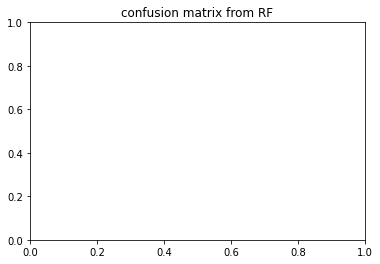

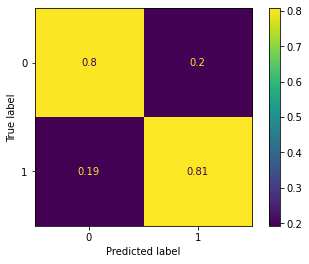

{'C': 1, 'coef0': 0.0, 'gamma': 0.0001, 'kernel': 'sigmoid', 'probability': True}
irm1_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.417 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.771 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.359 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.626 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.484 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.619 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.844 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.591 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.622 total time=   0.1s
[CV 5/5

[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.407 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.596 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.669 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.790 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.646 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.713 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.563 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.601 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.629 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.734 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.615 total time=   0.1

{'C': 1, 'coef0': 0.1, 'gamma': 0.0001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

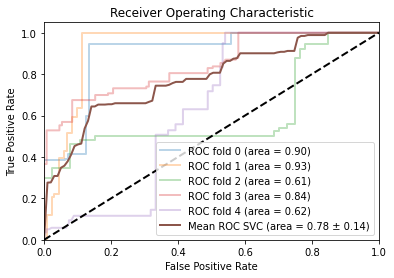

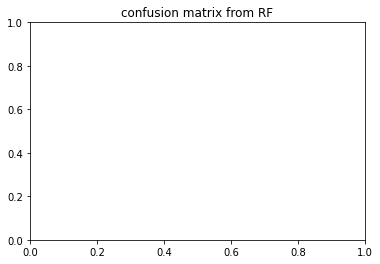

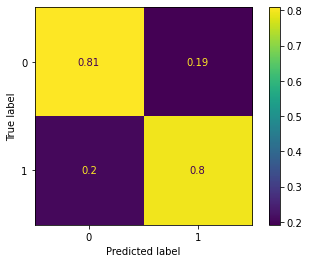

{'C': 1, 'coef0': 0.1, 'gamma': 0.0001, 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.419 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.827 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.580 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.838 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.936 total time=   0.2s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.577 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.507 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.590 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.721 total time=   0.2s
[

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.988 total time=   0.3s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.709 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.655 total time=   0.2s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.851 total time=   0.2s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.998 total time=   0.2s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.348 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.615 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.698 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.781 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.977 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.916 total time=   0.1

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.972 total time=   0.1s
{'C': 1, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

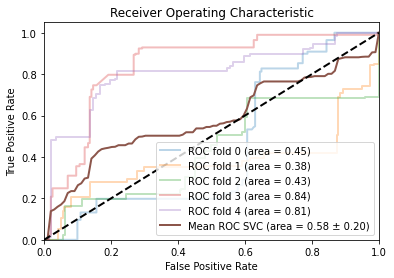

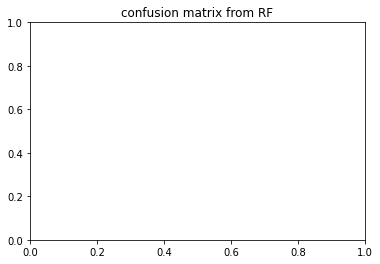

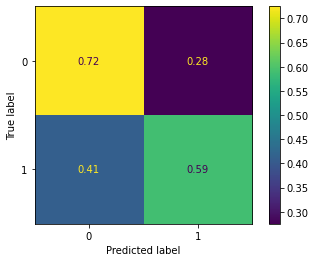

{'C': 1, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.423 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.840 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.600 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.833 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.928 total time=   0.2s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.570 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.512 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.606 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.730 total time=   0.2s
[CV 5/

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.991 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.711 total time=   0.2s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.653 total time=   0.2s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.856 total time=   0.2s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.997 total time=   0.2s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.378 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.611 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.713 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.778 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.972 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.906 total time=   0.1

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.981 total time=   0.1s
{'C': 1, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

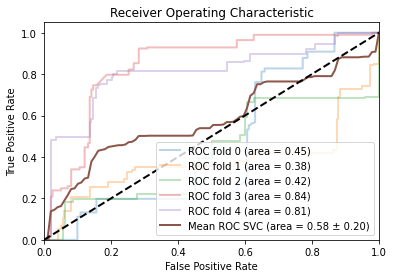

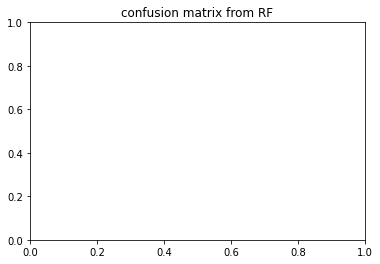

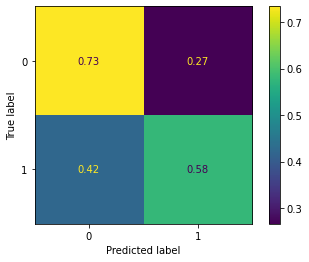

{'C': 1, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.616 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.898 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.597 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.752 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.664 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.791 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.895 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.783 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.880 total time=   0.0s

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.619 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.776 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.542 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.686 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.957 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.840 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.623 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.792 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.874 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.885 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.838 total time=   0.0

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.653 total time=   0.0s
{'C': 100, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

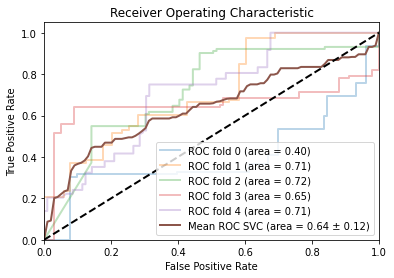

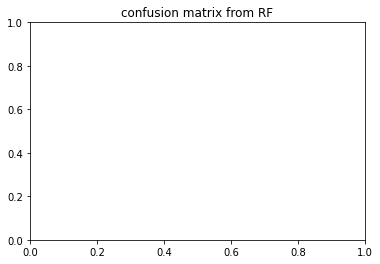

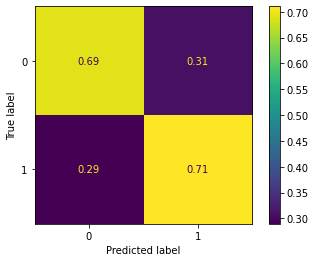

{'C': 100, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.624 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.904 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.598 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.760 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.683 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.791 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.897 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.790 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.880 total time=   0.0s
[CV 5

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.621 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.771 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.572 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.895 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.957 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.840 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.623 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.796 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.874 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.885 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.844 total time=   0.0

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.657 total time=   0.0s
{'C': 100, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

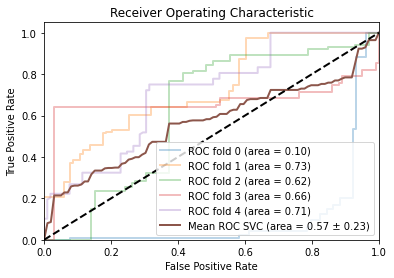

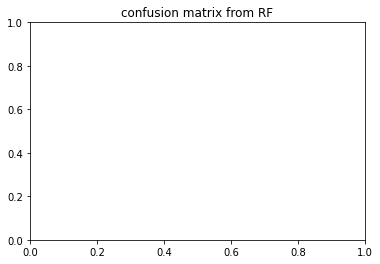

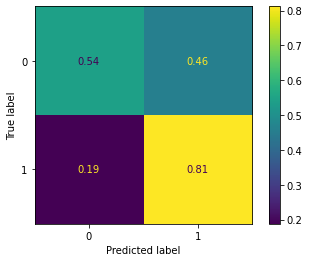

{'C': 100, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.880 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.342 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.651 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.810 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.880 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.757 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.288 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.516 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.850 total time=   0.1s

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.912 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.930 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.536 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.666 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.938 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.873 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.738 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.269 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.526 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.694 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.820 total time=   0.0

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.912 total time=   0.0s
{'C': 10, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

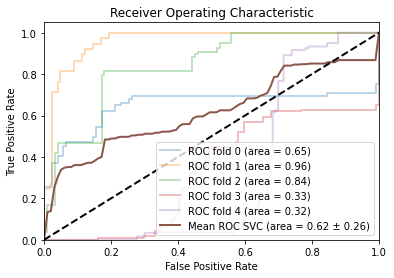

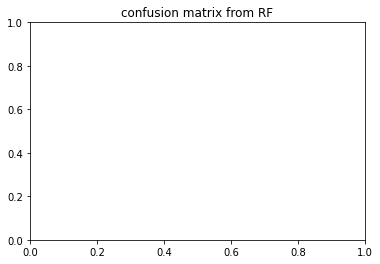

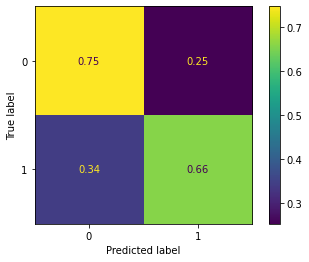

{'C': 10, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.881 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.340 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.649 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.835 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.878 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.759 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.281 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.502 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.860 total time=   0.1s
[CV 

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.905 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.928 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.535 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.670 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.924 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.835 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.733 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.271 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.521 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.704 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.816 total time=   0.0

{'C': 10, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

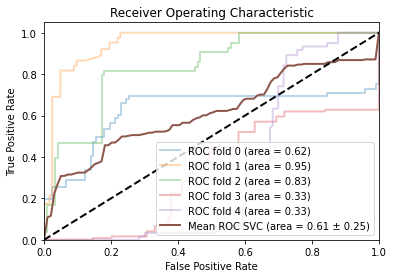

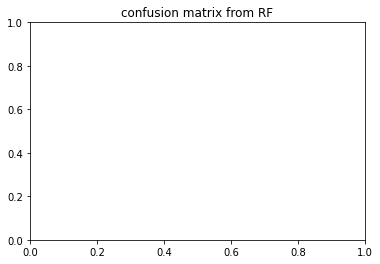

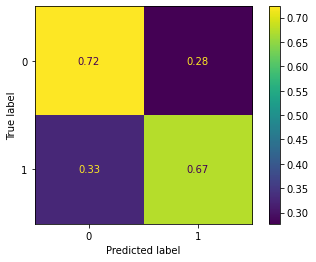

{'C': 10, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.668096,0.741955,0.736217,0.743768
irm1_both_APOE_one_hot,0.685178,0.746523,0.737380,0.742893
irm2_both_APOE_nbr_allelle_4,0.632135,0.705461,0.739308,0.819663
irm2_both_APOE_one_hot,0.646095,0.705796,0.740304,0.821041
irm1_under_APOE_nbr_allelle_4,0.718384,0.830381,0.833831,0.850899
irm1_under_APOE_one_hot,0.730649,0.840990,0.838342,0.857881
irm2_under_APOE_nbr_allelle_4,0.598138,0.686680,0.727677,0.788566
irm2_under_APOE_one_hot,0.601411,0.681793,0.722962,0.778323


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.761296,0.935130,0.915687,0.899758
irm1_both_APOE_one_hot,0.754452,0.932405,0.938946,0.898183
irm2_both_APOE_nbr_allelle_4,0.458405,0.558797,0.790880,0.449551
irm2_both_APOE_one_hot,0.457971,0.556848,0.795571,0.447843
irm1_under_APOE_nbr_allelle_4,0.295146,0.443229,0.430148,0.402044
irm1_under_APOE_one_hot,0.275830,0.438631,0.417578,0.102299
irm2_under_APOE_nbr_allelle_4,0.669015,0.804769,0.667796,0.647473
irm2_under_APOE_one_hot,0.686696,0.811137,0.668947,0.622206


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.718807,0.795935,0.789210,0.778868
irm1_both_APOE_one_hot,0.718929,0.797192,0.784317,0.780823
irm2_both_APOE_nbr_allelle_4,0.574904,0.630410,0.687875,0.580205
irm2_both_APOE_one_hot,0.577458,0.629234,0.690059,0.579348
irm1_under_APOE_nbr_allelle_4,0.665514,0.763055,0.679938,0.639305
irm1_under_APOE_one_hot,0.665378,0.764658,0.688826,0.563984
irm2_under_APOE_nbr_allelle_4,0.670250,0.715065,0.761594,0.620042
irm2_under_APOE_one_hot,0.673617,0.716106,0.761771,0.614147


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.718807,0.795935,0.789210,0.778868
irm1_both_APOE_one_hot,0.718929,0.797192,0.784317,0.780823
irm2_both_APOE_nbr_allelle_4,0.574904,0.630410,0.687875,0.580205
irm2_both_APOE_one_hot,0.577458,0.629234,0.690059,0.579348
irm1_under_APOE_nbr_allelle_4,0.665514,0.763055,0.679938,0.639305
irm1_under_APOE_one_hot,0.665378,0.764658,0.688826,0.563984
irm2_under_APOE_nbr_allelle_4,0.670250,0.715065,0.761594,0.620042
irm2_under_APOE_one_hot,0.673617,0.716106,0.761771,0.614147


the score on cross_val: 


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.718807,0.795935,0.789210,0.778868
irm1_both_APOE_one_hot,0.718929,0.797192,0.784317,0.780823
irm2_both_APOE_nbr_allelle_4,0.574904,0.630410,0.687875,0.580205
irm2_both_APOE_one_hot,0.577458,0.629234,0.690059,0.579348
irm1_under_APOE_nbr_allelle_4,0.665514,0.763055,0.679938,0.639305
irm1_under_APOE_one_hot,0.665378,0.764658,0.688826,0.563984
irm2_under_APOE_nbr_allelle_4,0.670250,0.715065,0.761594,0.620042
irm2_under_APOE_one_hot,0.673617,0.716106,0.761771,0.614147


here: 200
irm1_both
0    658
1    658
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_both_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST12SV,irmL_ST14TS,irmL_ST15CV,...,neuro_moca_IMMT1W4,neuro_moca_IMMT2W4,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,age,APOE_nbr_allelle_4
0,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,0.081552,-0.897658,0.788005,...,1.0,1.0,-0.437069,1.0,1.0,1.750166,1.0,1.0,1.308682,0.0
1,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,1.214602,-0.093292,1.527492,...,1.0,1.0,-0.437069,1.0,1.0,-0.358815,1.0,1.0,0.129191,1.0
2,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,-0.564393,-2.491629,0.321016,...,1.0,1.0,-0.437069,1.0,0.0,1.117472,1.0,1.0,-0.376305,0.0
3,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,1.648762,0.327339,2.104728,...,1.0,0.0,-0.437069,1.0,1.0,-0.358815,1.0,1.0,0.634687,0.0
4,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,-1.146802,0.541345,-0.826176,...,1.0,1.0,-0.437069,1.0,1.0,-1.413306,1.0,1.0,2.319674,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,-0.797357,0.342098,0.711040,...,1.0,1.0,0.900565,1.0,1.0,-1.413306,1.0,1.0,1.140183,0.0
1312,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,-0.304956,1.663028,0.769284,...,1.0,0.0,-0.437069,0.0,1.0,1.750166,1.0,1.0,0.971684,0.0
1313,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,0.118614,-0.115431,1.120826,...,1.0,1.0,-0.437069,1.0,1.0,-0.147917,1.0,1.0,-1.555796,1.0
1314,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,0.187444,0.629899,-0.465274,...,1.0,1.0,-0.437069,1.0,0.0,-2.046001,1.0,0.0,0.129191,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_both_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST12SV,irmL_ST14TS,irmL_ST15CV,...,neuro_moca_IMMT2W4,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,age,APOE_33,APOE_34
0,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,0.081552,-0.897658,0.788005,...,1.0,-0.437069,1.0,1.0,1.750166,1.0,1.0,1.308682,1.0,0.0
1,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,1.214602,-0.093292,1.527492,...,1.0,-0.437069,1.0,1.0,-0.358815,1.0,1.0,0.129191,0.0,1.0
2,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,-0.564393,-2.491629,0.321016,...,1.0,-0.437069,1.0,0.0,1.117472,1.0,1.0,-0.376305,1.0,0.0
3,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,1.648762,0.327339,2.104728,...,0.0,-0.437069,1.0,1.0,-0.358815,1.0,1.0,0.634687,1.0,0.0
4,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,-1.146802,0.541345,-0.826176,...,1.0,-0.437069,1.0,1.0,-1.413306,1.0,1.0,2.319674,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,-0.797357,0.342098,0.711040,...,1.0,0.900565,1.0,1.0,-1.413306,1.0,1.0,1.140183,1.0,0.0
1312,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,-0.304956,1.663028,0.769284,...,0.0,-0.437069,0.0,1.0,1.750166,1.0,1.0,0.971684,1.0,0.0
1313,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,0.118614,-0.115431,1.120826,...,1.0,-0.437069,1.0,1.0,-0.147917,1.0,1.0,-1.555796,0.0,1.0
1314,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,0.187444,0.629899,-0.465274,...,1.0,-0.437069,1.0,0.0,-2.046001,1.0,0.0,0.129191,0.0,1.0


irm2_both
0    1000
1    1000
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_both_APOE_nbr_allelle_4


,irmC_ST102CV,irmC_ST102SA,irmC_ST104TA,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,irmC_ST106CV,irmC_ST106TA,irmC_ST107TS,irmC_ST109CV,...,neuro_moca_IMMT2W1,neuro_moca_IMMT2W2,neuro_moca_IMMT2W4,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSMEAS,neuro_moca_DELW4,age,APOE_nbr_allelle_4
0,-1.740922,-1.278593,-1.544192,1.799995,2.383053,-0.400343,-0.413629,-0.612860,-0.066849,0.361498,...,1.0,1.0,1.0,-0.425038,1.0,1.403416,1.0,1.514540,-0.214656,0.0
1,0.570305,-0.494554,1.313484,0.654591,-0.270465,1.530761,1.759307,0.943728,-0.627839,0.363822,...,1.0,1.0,1.0,-0.425038,1.0,1.206528,1.0,-0.646773,-0.687641,1.0
2,0.216984,1.052334,0.198744,-0.359226,-0.764643,1.560624,0.158725,1.131592,-0.627839,-0.970093,...,1.0,1.0,1.0,-0.425038,1.0,1.009640,1.0,1.514540,-0.214656,0.0
3,-0.413528,0.003417,-0.281641,0.277774,-0.367152,0.475622,1.307449,0.219110,0.620364,-0.379824,...,1.0,1.0,1.0,-0.425038,1.0,2.190967,1.0,0.433884,-1.318288,0.0
4,0.582017,0.368949,1.615264,0.848981,0.900520,0.246676,0.249096,1.077917,0.269745,0.719378,...,1.0,1.0,1.0,-0.425038,1.0,1.403416,1.0,-0.646773,-1.160626,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.466234,-0.542232,-1.371746,-0.586513,-0.710928,0.072479,-1.813386,-0.874527,0.634389,-0.902700,...,1.0,1.0,1.0,-0.425038,1.0,0.222089,1.0,-1.727429,1.046637,0.0
1996,1.360886,0.623232,-0.503357,-0.619409,-0.743157,-0.937867,-0.439736,-1.371025,3.214945,-1.197835,...,1.0,1.0,1.0,-0.425038,1.0,1.206528,1.0,-0.646773,-0.372318,1.0
1997,0.263833,0.241807,0.365031,-0.404085,-0.496068,0.077456,-0.007961,0.480778,1.882593,-1.957748,...,1.0,1.0,1.0,0.950490,1.0,-1.156125,1.0,-0.646773,0.573652,1.0
1998,-1.838525,-1.426925,-1.396381,-1.277344,-1.602596,-0.246054,0.694930,-1.357606,-0.711988,-1.158329,...,1.0,1.0,1.0,-0.425038,1.0,-1.549900,1.0,0.433884,1.046637,0.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_both_APOE_one_hot


,irmC_ST102CV,irmC_ST102SA,irmC_ST104TA,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,irmC_ST106CV,irmC_ST106TA,irmC_ST107TS,irmC_ST109CV,...,neuro_moca_IMMT2W2,neuro_moca_IMMT2W4,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSMEAS,neuro_moca_DELW4,age,APOE_33,APOE_34
0,-1.740922,-1.278593,-1.544192,1.799995,2.383053,-0.400343,-0.413629,-0.612860,-0.066849,0.361498,...,1.0,1.0,-0.425038,1.0,1.403416,1.0,1.514540,-0.214656,1.0,0.0
1,0.570305,-0.494554,1.313484,0.654591,-0.270465,1.530761,1.759307,0.943728,-0.627839,0.363822,...,1.0,1.0,-0.425038,1.0,1.206528,1.0,-0.646773,-0.687641,0.0,1.0
2,0.216984,1.052334,0.198744,-0.359226,-0.764643,1.560624,0.158725,1.131592,-0.627839,-0.970093,...,1.0,1.0,-0.425038,1.0,1.009640,1.0,1.514540,-0.214656,1.0,0.0
3,-0.413528,0.003417,-0.281641,0.277774,-0.367152,0.475622,1.307449,0.219110,0.620364,-0.379824,...,1.0,1.0,-0.425038,1.0,2.190967,1.0,0.433884,-1.318288,0.0,0.0
4,0.582017,0.368949,1.615264,0.848981,0.900520,0.246676,0.249096,1.077917,0.269745,0.719378,...,1.0,1.0,-0.425038,1.0,1.403416,1.0,-0.646773,-1.160626,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.466234,-0.542232,-1.371746,-0.586513,-0.710928,0.072479,-1.813386,-0.874527,0.634389,-0.902700,...,1.0,1.0,-0.425038,1.0,0.222089,1.0,-1.727429,1.046637,1.0,0.0
1996,1.360886,0.623232,-0.503357,-0.619409,-0.743157,-0.937867,-0.439736,-1.371025,3.214945,-1.197835,...,1.0,1.0,-0.425038,1.0,1.206528,1.0,-0.646773,-0.372318,0.0,1.0
1997,0.263833,0.241807,0.365031,-0.404085,-0.496068,0.077456,-0.007961,0.480778,1.882593,-1.957748,...,1.0,1.0,0.950490,1.0,-1.156125,1.0,-0.646773,0.573652,0.0,1.0
1998,-1.838525,-1.426925,-1.396381,-1.277344,-1.602596,-0.246054,0.694930,-1.357606,-0.711988,-1.158329,...,1.0,1.0,-0.425038,1.0,-1.549900,1.0,0.433884,1.046637,1.0,0.0


irm1_under
0    511
1    511
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_under_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST12SV,irmL_ST15SA,irmL_ST15CV,...,neuro_moca_IMMT2W4,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_YEAR,age,APOE_nbr_allelle_4
0,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,0.061876,0.408236,0.802715,...,1.0,-0.439635,1.0,1.0,1.769759,1.0,1.0,1.0,1.290915,0.0
1,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,1.201759,2.187083,1.543616,...,1.0,-0.439635,1.0,1.0,-0.344436,1.0,1.0,1.0,0.110546,1.0
2,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,-0.587965,-0.491866,0.334832,...,1.0,-0.439635,1.0,0.0,1.135501,1.0,1.0,1.0,-0.395326,0.0
3,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,1.638537,2.763759,2.121957,...,0.0,-0.439635,1.0,1.0,-0.344436,1.0,1.0,1.0,0.616419,0.0
4,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,-1.173886,0.579103,-0.814555,...,1.0,-0.439635,1.0,1.0,-1.401533,1.0,1.0,1.0,2.302660,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,-1.514786,-1.681832,-1.451251,...,1.0,-0.439635,1.0,1.0,0.289823,1.0,1.0,1.0,-1.238447,1.0
1018,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.924931,-1.514017,-1.919134,...,1.0,-0.439635,1.0,1.0,0.289823,1.0,1.0,1.0,-1.069823,1.0
1019,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.924931,-1.514017,-1.919134,...,1.0,-0.439635,1.0,1.0,-0.344436,1.0,1.0,1.0,-1.069823,1.0
1020,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,-1.669256,-1.825238,-1.620064,...,1.0,0.897589,1.0,1.0,0.924081,1.0,1.0,1.0,-0.901199,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_under_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST12SV,irmL_ST15SA,irmL_ST15CV,...,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_YEAR,age,APOE_33,APOE_34
0,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,0.061876,0.408236,0.802715,...,-0.439635,1.0,1.0,1.769759,1.0,1.0,1.0,1.290915,1.0,0.0
1,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,1.201759,2.187083,1.543616,...,-0.439635,1.0,1.0,-0.344436,1.0,1.0,1.0,0.110546,0.0,1.0
2,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,-0.587965,-0.491866,0.334832,...,-0.439635,1.0,0.0,1.135501,1.0,1.0,1.0,-0.395326,1.0,0.0
3,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,1.638537,2.763759,2.121957,...,-0.439635,1.0,1.0,-0.344436,1.0,1.0,1.0,0.616419,1.0,0.0
4,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,-1.173886,0.579103,-0.814555,...,-0.439635,1.0,1.0,-1.401533,1.0,1.0,1.0,2.302660,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,-1.514786,-1.681832,-1.451251,...,-0.439635,1.0,1.0,0.289823,1.0,1.0,1.0,-1.238447,0.0,1.0
1018,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.924931,-1.514017,-1.919134,...,-0.439635,1.0,1.0,0.289823,1.0,1.0,1.0,-1.069823,0.0,1.0
1019,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.924931,-1.514017,-1.919134,...,-0.439635,1.0,1.0,-0.344436,1.0,1.0,1.0,-1.069823,0.0,1.0
1020,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,-1.669256,-1.825238,-1.620064,...,0.897589,1.0,1.0,0.924081,1.0,1.0,1.0,-0.901199,0.0,1.0


irm2_under
0    614
1    614
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_under_APOE_nbr_allelle_4


,irmC_ST102CV,irmC_ST102SA,irmC_ST104TA,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,irmC_ST106CV,irmC_ST106TA,irmC_ST106TS,irmC_ST107TS,...,neuro_moca_IMMT2W2,neuro_moca_IMMT2W4,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW4,age,APOE_nbr_allelle_4
0,-1.724954,-1.277778,-1.550149,1.788523,2.434463,-0.403364,-0.438229,-0.611609,0.935376,-0.071773,...,1.0,1.0,-0.427954,1.0,1.413937,1.0,1.0,1.533935,-0.194405,0.0
1,0.560375,-0.502523,1.283291,0.648655,-0.260922,1.470128,1.726558,0.919744,0.784492,-0.621854,...,1.0,1.0,-0.427954,1.0,1.214246,1.0,1.0,-0.657655,-0.661586,1.0
2,0.211013,1.027035,0.178005,-0.360263,-0.762897,1.499099,0.131978,1.104562,-0.257982,-0.621854,...,1.0,1.0,-0.427954,1.0,1.014555,1.0,1.0,1.533935,-0.194405,0.0
3,-0.412434,-0.010131,-0.298306,0.273659,-0.359135,0.446467,1.276394,0.206873,2.375636,0.602077,...,1.0,1.0,-0.427954,1.0,2.212702,1.0,1.0,0.438140,-1.284495,0.0
4,0.571956,0.351306,1.582511,0.842105,0.928539,0.224352,0.222011,1.051757,-0.175682,0.258276,...,1.0,1.0,-0.427954,1.0,1.413937,1.0,1.0,-0.657655,-1.128768,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,0.193642,0.466546,-0.725764,-1.776914,-1.515858,-0.905537,-0.442231,-0.710619,-1.026121,0.217020,...,1.0,1.0,-0.427954,1.0,0.215790,1.0,1.0,0.438140,-1.128768,1.0
1224,-0.053421,0.848935,-2.820311,-1.666796,-1.057534,-1.267681,-0.746342,-1.179266,1.045110,-1.020663,...,1.0,1.0,-0.427954,1.0,0.215790,1.0,1.0,0.438140,-0.973041,1.0
1225,-0.053421,0.848935,-2.820311,-1.666796,-1.057534,-1.267681,-0.746342,-1.179266,1.045110,-1.020663,...,1.0,1.0,-0.427954,1.0,-0.383284,1.0,1.0,0.438140,-0.973041,1.0
1226,-0.754075,-0.586334,-0.829576,-1.964412,-1.646808,-1.156623,-1.042449,-0.261774,-0.765503,-0.058021,...,1.0,1.0,0.984754,1.0,0.814864,1.0,1.0,1.533935,-0.817314,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_under_APOE_one_hot


,irmC_ST102CV,irmC_ST102SA,irmC_ST104TA,irmC_ST105CV,irmC_ST105SA,irmC_ST105TA,irmC_ST106CV,irmC_ST106TA,irmC_ST106TS,irmC_ST107TS,...,neuro_moca_IMMT2W4,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSTRAN,neuro_moca_ABSMEAS,neuro_moca_DELW4,age,APOE_33,APOE_34
0,-1.724954,-1.277778,-1.550149,1.788523,2.434463,-0.403364,-0.438229,-0.611609,0.935376,-0.071773,...,1.0,-0.427954,1.0,1.413937,1.0,1.0,1.533935,-0.194405,1.0,0.0
1,0.560375,-0.502523,1.283291,0.648655,-0.260922,1.470128,1.726558,0.919744,0.784492,-0.621854,...,1.0,-0.427954,1.0,1.214246,1.0,1.0,-0.657655,-0.661586,0.0,1.0
2,0.211013,1.027035,0.178005,-0.360263,-0.762897,1.499099,0.131978,1.104562,-0.257982,-0.621854,...,1.0,-0.427954,1.0,1.014555,1.0,1.0,1.533935,-0.194405,1.0,0.0
3,-0.412434,-0.010131,-0.298306,0.273659,-0.359135,0.446467,1.276394,0.206873,2.375636,0.602077,...,1.0,-0.427954,1.0,2.212702,1.0,1.0,0.438140,-1.284495,0.0,0.0
4,0.571956,0.351306,1.582511,0.842105,0.928539,0.224352,0.222011,1.051757,-0.175682,0.258276,...,1.0,-0.427954,1.0,1.413937,1.0,1.0,-0.657655,-1.128768,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,0.193642,0.466546,-0.725764,-1.776914,-1.515858,-0.905537,-0.442231,-0.710619,-1.026121,0.217020,...,1.0,-0.427954,1.0,0.215790,1.0,1.0,0.438140,-1.128768,0.0,1.0
1224,-0.053421,0.848935,-2.820311,-1.666796,-1.057534,-1.267681,-0.746342,-1.179266,1.045110,-1.020663,...,1.0,-0.427954,1.0,0.215790,1.0,1.0,0.438140,-0.973041,0.0,1.0
1225,-0.053421,0.848935,-2.820311,-1.666796,-1.057534,-1.267681,-0.746342,-1.179266,1.045110,-1.020663,...,1.0,-0.427954,1.0,-0.383284,1.0,1.0,0.438140,-0.973041,0.0,1.0
1226,-0.754075,-0.586334,-0.829576,-1.964412,-1.646808,-1.156623,-1.042449,-0.261774,-0.765503,-0.058021,...,1.0,0.984754,1.0,0.814864,1.0,1.0,1.533935,-0.817314,0.0,1.0


dict_keys(['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot'])
['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot']
dict_keys(['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot'])
depth_10_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.564 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10,

[CV 3/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.596 total time=   0.7s
[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.577 total time=   0.6s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.457 total time=   0.6s
[CV 1/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.767 total time=   1.3s
[CV 2/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.660 total time=   1.6s
[CV 3/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.612 total time=   1.5s
[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.577 total time=   1.3s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.316 total time=   1.4s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.691 total time=   0.0s
[

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.783 total time=   0.7s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.786 total time=   0.8s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.596 total time=   0.7s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.537 total time=   0.7s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.313 total time=   0.7s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.846 total time=   1.6s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.723 total time=   1.7s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.582 total time=   1.6s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.57

<Figure size 432x288 with 0 Axes>

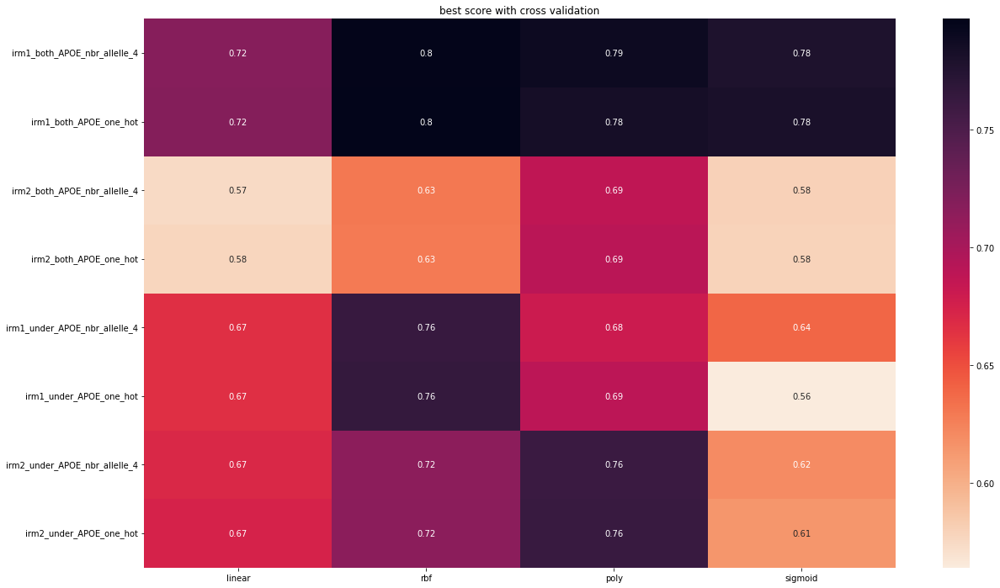

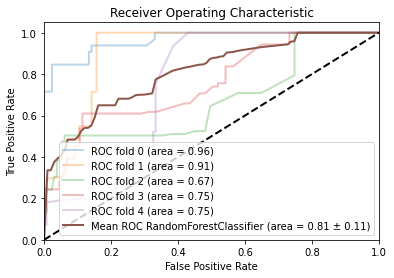

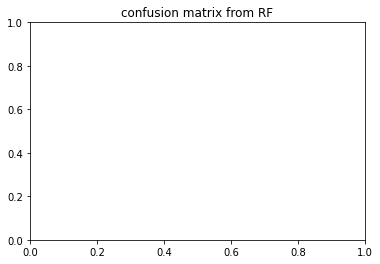

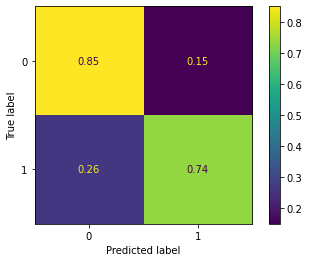

,precision,recall,f1-score,support,auc
0,0.794,0.852,0.805,131.600,0.00
1,0.849,0.737,0.768,131.600,0.00
accuracy,0.793,0.793,0.793,0.793,0.00
macro avg,0.821,0.794,0.787,263.200,0.81
weighted avg,0.822,0.793,0.787,263.200,0.81


coming from


,precision,recall,f1-score,support,auc
0,0.805195,0.976378,0.882562,127.000000,0.000000
1,0.970874,0.769231,0.858369,130.000000,0.000000
accuracy,0.871595,0.871595,0.871595,0.871595,0.000000
macro avg,0.888034,0.872804,0.870466,257.000000,0.964325
weighted avg,0.889001,0.871595,0.870324,257.000000,0.964325


,precision,recall,f1-score,support,auc
0,0.965812,0.843284,0.900398,134.000000,0.000000
1,0.853147,0.968254,0.907063,126.000000,0.000000
accuracy,0.903846,0.903846,0.903846,0.903846,0.000000
macro avg,0.909479,0.905769,0.903731,260.000000,0.912284
weighted avg,0.911213,0.903846,0.903628,260.000000,0.912284


,precision,recall,f1-score,support,auc
0,0.624365,0.938931,0.750000,131.000000,0.000000
1,0.893333,0.475177,0.620370,141.000000,0.000000
accuracy,0.698529,0.698529,0.698529,0.698529,0.000000
macro avg,0.758849,0.707054,0.685185,272.000000,0.672568
weighted avg,0.763794,0.698529,0.682802,272.000000,0.672568


,precision,recall,f1-score,support,auc
0,0.670520,0.885496,0.763158,131.000000,0.000000
1,0.814815,0.536585,0.647059,123.000000,0.000000
accuracy,0.716535,0.716535,0.716535,0.716535,0.000000
macro avg,0.742668,0.711041,0.705108,254.000000,0.754639
weighted avg,0.740395,0.716535,0.706937,254.000000,0.754639


,precision,recall,f1-score,support,auc
0,0.902174,0.614815,0.731278,135.000000,0.000000
1,0.712707,0.934783,0.808777,138.000000,0.000000
accuracy,0.776557,0.776557,0.776557,0.776557,0.000000
macro avg,0.807441,0.774799,0.770027,273.000000,0.746914
weighted avg,0.806400,0.776557,0.770453,273.000000,0.746914


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 100}
depth_10_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.661 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.570 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.640 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.681 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.697 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.970 total time=   0.1s
[CV 3/5] END criterion=gini,

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.519 total time=   2.2s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.387 total time=   2.5s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.700 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.835 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.883 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.585 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.693 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.581 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.985

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.720 total time=   1.5s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.740 total time=   1.6s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.594 total time=   1.7s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.526 total time=   2.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.358 total time=   1.7s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

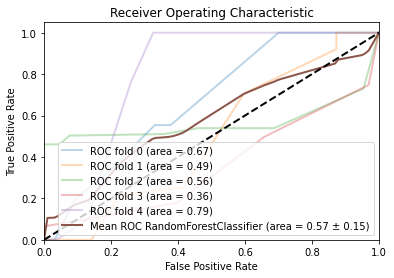

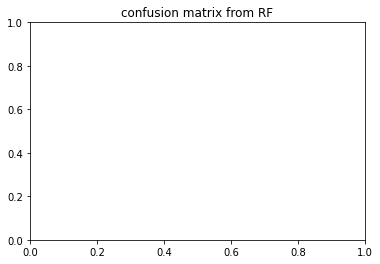

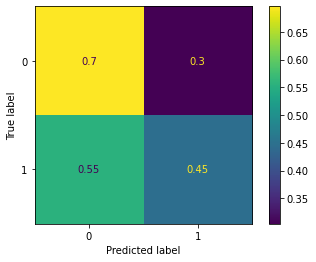

,precision,recall,f1-score,support,auc
0,0.591,0.698,0.577,131.600,0.000
1,0.370,0.447,0.396,131.600,0.000
accuracy,0.569,0.569,0.569,0.569,0.000
macro avg,0.480,0.573,0.486,263.200,0.575
weighted avg,0.481,0.569,0.485,263.200,0.575


coming from


,precision,recall,f1-score,support,auc
0,0.576642,0.622047,0.598485,127.000000,0.000000
1,0.600000,0.553846,0.576000,130.000000,0.000000
accuracy,0.587549,0.587549,0.587549,0.587549,0.000000
macro avg,0.588321,0.587947,0.587242,257.000000,0.669412
weighted avg,0.588457,0.587549,0.587111,257.000000,0.669412


,precision,recall,f1-score,support,auc
0,0.629630,0.126866,0.211180,134.000000,0.000000
1,0.497854,0.920635,0.646240,126.000000,0.000000
accuracy,0.511538,0.511538,0.511538,0.511538,0.000000
macro avg,0.563742,0.523750,0.428710,260.000000,0.491708
weighted avg,0.565769,0.511538,0.422017,260.000000,0.491708


,precision,recall,f1-score,support,auc
0,0.481618,1.000000,0.650124,131.000000,0.000000
1,0.000000,0.000000,0.000000,141.000000,0.000000
accuracy,0.481618,0.481618,0.481618,0.481618,0.000000
macro avg,0.240809,0.500000,0.325062,272.000000,0.563749
weighted avg,0.231956,0.481618,0.313111,272.000000,0.563749


,precision,recall,f1-score,support,auc
0,0.515748,1.000000,0.680519,131.000000,0.000000
1,0.000000,0.000000,0.000000,123.000000,0.000000
accuracy,0.515748,0.515748,0.515748,0.515748,0.000000
macro avg,0.257874,0.500000,0.340260,254.000000,0.356824
weighted avg,0.265996,0.515748,0.350977,254.000000,0.356824


,precision,recall,f1-score,support,auc
0,0.751880,0.740741,0.746269,135.000000,0.000000
1,0.750000,0.760870,0.755396,138.000000,0.000000
accuracy,0.750916,0.750916,0.750916,0.750916,0.000000
macro avg,0.750940,0.750805,0.750832,273.000000,0.793586
weighted avg,0.750930,0.750916,0.750882,273.000000,0.793586


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 10}
depth_10_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.470 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.630 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.553 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.629 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.890 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.548 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.550 total time=   0.1s
[CV 3/5] END criterion=

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.535 total time=   2.5s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.759 total time=   3.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.554 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.596 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.648 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.718 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.716 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.643

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.516 total time=   2.3s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.739 total time=   2.8s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.601 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.492 total time=   2.3s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.802 total time=   2.7s


<Figure size 432x288 with 0 Axes>

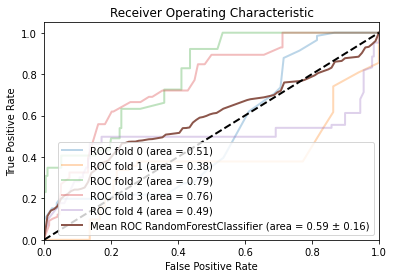

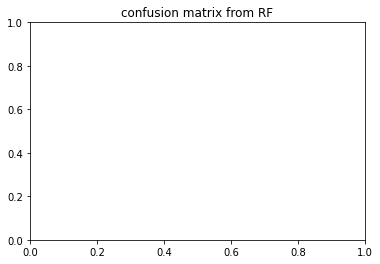

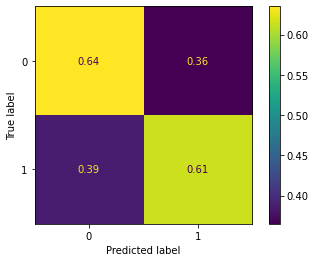

,precision,recall,f1-score,support,auc
0,0.675,0.641,0.601,200.000,0.000
1,0.652,0.614,0.596,200.000,0.000
accuracy,0.625,0.625,0.625,0.625,0.000
macro avg,0.664,0.627,0.598,400.000,0.586
weighted avg,0.665,0.625,0.597,400.000,0.586


coming from


,precision,recall,f1-score,support,auc
0,0.847826,0.184834,0.303502,211.000000,0.00000
1,0.524862,0.964467,0.679785,197.000000,0.00000
accuracy,0.561275,0.561275,0.561275,0.561275,0.00000
macro avg,0.686344,0.574651,0.491644,408.000000,0.51014
weighted avg,0.691885,0.561275,0.485188,408.000000,0.51014


,precision,recall,f1-score,support,auc
0,0.529010,0.782828,0.631365,198.000000,0.000000
1,0.561224,0.284974,0.378007,193.000000,0.000000
accuracy,0.537084,0.537084,0.537084,0.537084,0.000000
macro avg,0.545117,0.533901,0.504686,391.000000,0.375792
weighted avg,0.544911,0.537084,0.506306,391.000000,0.375792


,precision,recall,f1-score,support,auc
0,0.758621,0.564103,0.647059,195.000000,0.000000
1,0.665354,0.828431,0.737991,204.000000,0.000000
accuracy,0.699248,0.699248,0.699248,0.699248,0.000000
macro avg,0.711988,0.696267,0.692525,399.000000,0.791742
weighted avg,0.710936,0.699248,0.693551,399.000000,0.791742


,precision,recall,f1-score,support,auc
0,0.663900,0.808081,0.728929,198.000000,0.000000
1,0.753247,0.588832,0.660969,197.000000,0.000000
accuracy,0.698734,0.698734,0.698734,0.698734,0.000000
macro avg,0.708574,0.698457,0.694949,395.000000,0.759934
weighted avg,0.708460,0.698734,0.695035,395.000000,0.759934


,precision,recall,f1-score,support,auc
0,0.577703,0.863636,0.692308,198.000000,0.000000
1,0.756757,0.401914,0.525000,209.000000,0.000000
accuracy,0.626536,0.626536,0.626536,0.626536,0.000000
macro avg,0.667230,0.632775,0.608654,407.000000,0.491784
weighted avg,0.669649,0.626536,0.606393,407.000000,0.491784


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 50}
depth_10_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.477 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.565 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.517 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.590 total time=   0.1s
[CV 3/5] END criterion=gini, 

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.488 total time=   2.2s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.687 total time=   2.6s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.729 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.630 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.681 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.632 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.811 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.580 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.547

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.557 total time=   2.4s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.723 total time=   2.8s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.644 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.491 total time=   2.4s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.813 total time=   2.7s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

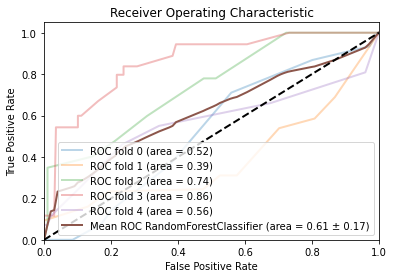

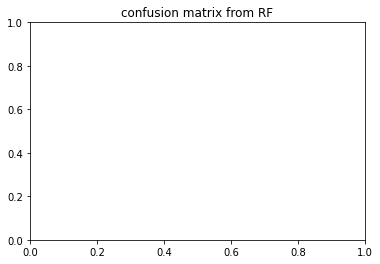

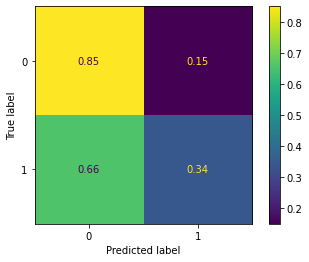

,precision,recall,f1-score,support,auc
0,0.583,0.853,0.681,200.000,0.000
1,0.584,0.342,0.404,200.000,0.000
accuracy,0.597,0.597,0.597,0.597,0.000
macro avg,0.583,0.598,0.542,400.000,0.615
weighted avg,0.586,0.597,0.542,400.000,0.615


coming from


,precision,recall,f1-score,support,auc
0,0.511628,0.625592,0.562900,211.000000,0.000000
1,0.473333,0.360406,0.409222,197.000000,0.000000
accuracy,0.497549,0.497549,0.497549,0.497549,0.000000
macro avg,0.492481,0.492999,0.486061,408.000000,0.521411
weighted avg,0.493138,0.497549,0.488697,408.000000,0.521411


,precision,recall,f1-score,support,auc
0,0.506394,1.000000,0.672326,198.000000,0.000000
1,0.000000,0.000000,0.000000,193.000000,0.000000
accuracy,0.506394,0.506394,0.506394,0.506394,0.000000
macro avg,0.253197,0.500000,0.336163,391.000000,0.388588
weighted avg,0.256435,0.506394,0.340462,391.000000,0.388588


,precision,recall,f1-score,support,auc
0,0.572700,0.989744,0.725564,195.000000,0.000000
1,0.967742,0.294118,0.451128,204.000000,0.000000
accuracy,0.634085,0.634085,0.634085,0.634085,0.000000
macro avg,0.770221,0.641931,0.588346,399.000000,0.740447
weighted avg,0.774676,0.634085,0.585251,399.000000,0.740447


,precision,recall,f1-score,support,auc
0,0.790576,0.762626,0.776350,198.000000,0.000000
1,0.769608,0.796954,0.783042,197.000000,0.000000
accuracy,0.779747,0.779747,0.779747,0.779747,0.000000
macro avg,0.780092,0.779790,0.779696,395.000000,0.859419
weighted avg,0.780118,0.779747,0.779688,395.000000,0.859419


,precision,recall,f1-score,support,auc
0,0.531722,0.888889,0.665406,198.000000,0.000000
1,0.710526,0.258373,0.378947,209.000000,0.000000
accuracy,0.565111,0.565111,0.565111,0.565111,0.000000
macro avg,0.621124,0.573631,0.522177,407.000000,0.564231
weighted avg,0.623540,0.565111,0.518306,407.000000,0.564231


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 10}
depth_10_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.618 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.835 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.805 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.441 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.955 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.870 total time=   0.0s
[CV 3/5] END criterion

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.535 total time=   1.5s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.624 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.882 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.640 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.541 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.746 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.955

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.663 total time=   1.5s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.668 total time=   1.5s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.531 total time=   1.4s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.443 total time=   1.4s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.4s


<Figure size 432x288 with 0 Axes>

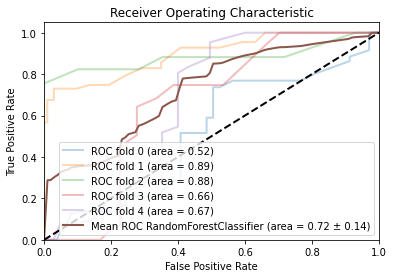

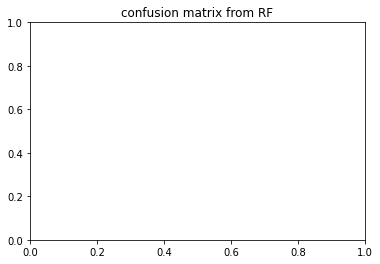

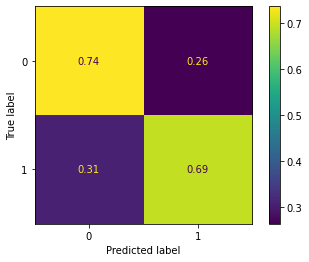

,precision,recall,f1-score,support,auc
0,0.705,0.739,0.708,102.200,0.000
1,0.757,0.687,0.708,102.200,0.000
accuracy,0.712,0.712,0.712,0.712,0.000
macro avg,0.731,0.713,0.708,204.400,0.723
weighted avg,0.732,0.712,0.708,204.400,0.723


coming from


,precision,recall,f1-score,support,auc
0,0.566667,0.495146,0.528497,103.000000,0.000000
1,0.518519,0.589474,0.551724,95.000000,0.000000
accuracy,0.540404,0.540404,0.540404,0.540404,0.000000
macro avg,0.542593,0.542310,0.540111,198.000000,0.515841
weighted avg,0.543565,0.540404,0.539642,198.000000,0.515841


,precision,recall,f1-score,support,auc
0,0.751880,0.970874,0.847458,103.000000,0.000000
1,0.962963,0.702703,0.812500,111.000000,0.000000
accuracy,0.831776,0.831776,0.831776,0.831776,0.000000
macro avg,0.857421,0.836788,0.829979,214.000000,0.894909
weighted avg,0.861367,0.831776,0.829325,214.000000,0.894909


,precision,recall,f1-score,support,auc
0,0.761538,1.000000,0.864629,99.000000,0.000000
1,1.000000,0.696078,0.820809,102.000000,0.000000
accuracy,0.845771,0.845771,0.845771,0.845771,0.000000
macro avg,0.880769,0.848039,0.842719,201.000000,0.880967
weighted avg,0.882549,0.845771,0.842392,201.000000,0.880967


,precision,recall,f1-score,support,auc
0,0.640351,0.722772,0.679070,101.000000,0.000000
1,0.658537,0.568421,0.610169,95.000000,0.000000
accuracy,0.647959,0.647959,0.647959,0.647959,0.000000
macro avg,0.649444,0.645597,0.644620,196.000000,0.656227
weighted avg,0.649165,0.647959,0.645674,196.000000,0.656227


,precision,recall,f1-score,support,auc
0,0.803030,0.504762,0.619883,105.000000,0.000000
1,0.646259,0.879630,0.745098,108.000000,0.000000
accuracy,0.694836,0.694836,0.694836,0.694836,0.000000
macro avg,0.724644,0.692196,0.682491,213.000000,0.666799
weighted avg,0.723540,0.694836,0.683372,213.000000,0.666799


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 50}
depth_10_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.630 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.777 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.841 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.585 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.868 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.858 total time=   0.0s
[CV 3/5] END criterion=gini, ma

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.534 total time=   1.1s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.624 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.783 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.615 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.408 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.738 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.926

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.605 total time=   1.4s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.510 total time=   1.4s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.4s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.458 total time=   1.3s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.4s


<Figure size 432x288 with 0 Axes>

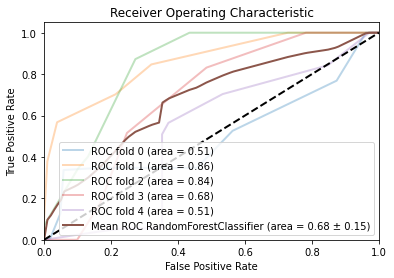

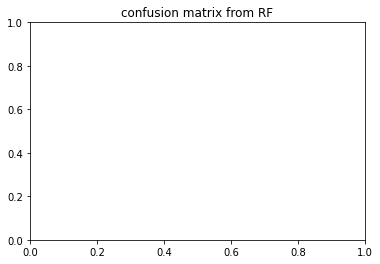

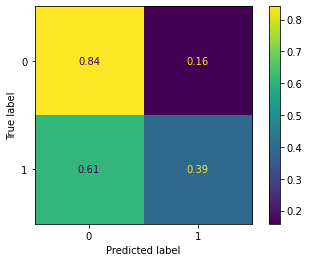

,precision,recall,f1-score,support,auc
0,0.582,0.842,0.683,102.200,0.00
1,0.740,0.386,0.483,102.200,0.00
accuracy,0.615,0.615,0.615,0.615,0.00
macro avg,0.661,0.614,0.583,204.400,0.68
weighted avg,0.662,0.615,0.584,204.400,0.68


coming from


,precision,recall,f1-score,support,auc
0,0.541436,0.951456,0.690141,103.000000,0.000000
1,0.705882,0.126316,0.214286,95.000000,0.000000
accuracy,0.555556,0.555556,0.555556,0.555556,0.000000
macro avg,0.623659,0.538886,0.452213,198.000000,0.505927
weighted avg,0.620337,0.555556,0.461827,198.000000,0.505927


,precision,recall,f1-score,support,auc
0,0.596491,0.990291,0.744526,103.000000,0.000000
1,0.976744,0.378378,0.545455,111.000000,0.000000
accuracy,0.672897,0.672897,0.672897,0.672897,0.000000
macro avg,0.786618,0.684335,0.644990,214.000000,0.858217
weighted avg,0.793725,0.672897,0.641269,214.000000,0.858217


,precision,recall,f1-score,support,auc
0,0.585034,0.868687,0.699187,99.000000,0.000000
1,0.759259,0.401961,0.525641,102.000000,0.000000
accuracy,0.631841,0.631841,0.631841,0.631841,0.000000
macro avg,0.672147,0.635324,0.612414,201.000000,0.839176
weighted avg,0.673447,0.631841,0.611119,201.000000,0.839176


,precision,recall,f1-score,support,auc
0,0.622951,0.752475,0.681614,101.000000,0.000000
1,0.662162,0.515789,0.579882,95.000000,0.000000
accuracy,0.637755,0.637755,0.637755,0.637755,0.000000
macro avg,0.642556,0.634132,0.630748,196.000000,0.683637
weighted avg,0.641956,0.637755,0.632305,196.000000,0.683637


,precision,recall,f1-score,support,auc
0,0.561983,0.647619,0.601770,105.000000,0.000000
1,0.597826,0.509259,0.550000,108.000000,0.000000
accuracy,0.577465,0.577465,0.577465,0.577465,0.000000
macro avg,0.579905,0.578439,0.575885,213.000000,0.511684
weighted avg,0.580157,0.577465,0.575520,213.000000,0.511684


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 10}
depth_10_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.810 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.587 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.659 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.696 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.673 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.374 total time=   0.1s
[CV 3/5] END criterion=gi

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.775 total time=   2.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.636 total time=   2.2s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.642 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.353 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.549 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.788 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.845 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.570 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.324

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.605 total time=   3.5s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.301 total time=   2.6s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.587 total time=   3.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.868 total time=   2.6s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.731 total time=   2.9s


<Figure size 432x288 with 0 Axes>

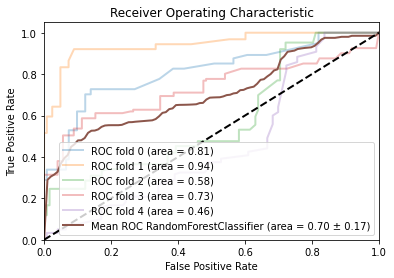

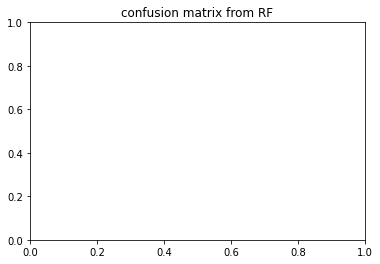

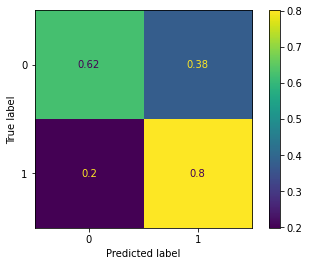

,precision,recall,f1-score,support,auc
0,0.784,0.623,0.628,122.800,0.000
1,0.736,0.800,0.739,122.800,0.000
accuracy,0.712,0.712,0.712,0.712,0.000
macro avg,0.760,0.712,0.684,245.600,0.705
weighted avg,0.760,0.712,0.684,245.600,0.705


coming from


,precision,recall,f1-score,support,auc
0,0.744681,0.860656,0.798479,122.000000,0.00000
1,0.833333,0.702479,0.762332,121.000000,0.00000
accuracy,0.781893,0.781893,0.781893,0.781893,0.00000
macro avg,0.789007,0.781568,0.780405,243.000000,0.81134
weighted avg,0.788825,0.781893,0.780480,243.000000,0.81134


,precision,recall,f1-score,support,auc
0,0.870229,0.926829,0.897638,123.000000,0.000000
1,0.923729,0.865079,0.893443,126.000000,0.000000
accuracy,0.895582,0.895582,0.895582,0.895582,0.000000
macro avg,0.896979,0.895954,0.895540,249.000000,0.943218
weighted avg,0.897301,0.895582,0.895515,249.000000,0.943218


,precision,recall,f1-score,support,auc
0,0.772727,0.278689,0.409639,122.000000,0.000000
1,0.568627,0.920635,0.703030,126.000000,0.000000
accuracy,0.604839,0.604839,0.604839,0.604839,0.000000
macro avg,0.670677,0.599662,0.556334,248.000000,0.581707
weighted avg,0.669031,0.604839,0.558700,248.000000,0.581707


,precision,recall,f1-score,support,auc
0,0.662651,0.887097,0.758621,124.000000,0.000000
1,0.822785,0.537190,0.650000,121.000000,0.000000
accuracy,0.714286,0.714286,0.714286,0.714286,0.000000
macro avg,0.742718,0.712143,0.704310,245.000000,0.728073
weighted avg,0.741737,0.714286,0.704975,245.000000,0.728073


,precision,recall,f1-score,support,auc
0,0.869565,0.162602,0.273973,123.000000,0.000000
1,0.531818,0.975000,0.688235,120.000000,0.000000
accuracy,0.563786,0.563786,0.563786,0.563786,0.000000
macro avg,0.700692,0.568801,0.481104,243.000000,0.462161
weighted avg,0.702777,0.563786,0.478547,243.000000,0.462161


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 50}
depth_10_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.274 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.680 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.767 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.741 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.339 total time=   0.1s
[CV 3/5] END criterion=gini, ma

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.746 total time=   2.3s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.690 total time=   2.3s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.670 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.236 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.823 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.848 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.666 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.348

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.702 total time=   2.3s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.396 total time=   2.8s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.557 total time=   2.1s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.741 total time=   2.4s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.703 total time=   2.4s


<Figure size 432x288 with 0 Axes>

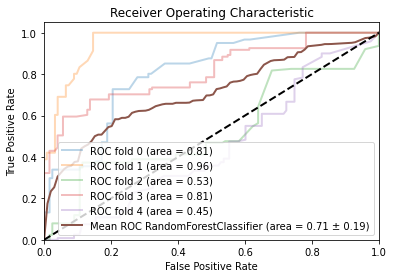

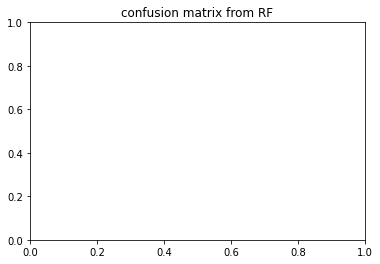

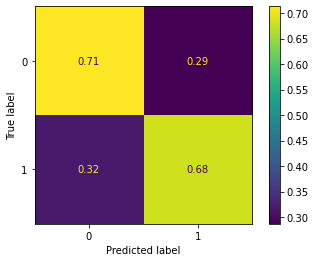

,precision,recall,f1-score,support,auc
0,0.699,0.714,0.672,122.800,0.000
1,0.739,0.683,0.681,122.800,0.000
accuracy,0.697,0.697,0.697,0.697,0.000
macro avg,0.719,0.698,0.677,245.600,0.709
weighted avg,0.719,0.697,0.676,245.600,0.709


coming from


,precision,recall,f1-score,support,auc
0,0.646667,0.795082,0.713235,122.000000,0.000000
1,0.731183,0.561983,0.635514,121.000000,0.000000
accuracy,0.679012,0.679012,0.679012,0.679012,0.000000
macro avg,0.688925,0.678533,0.674375,243.000000,0.805074
weighted avg,0.688751,0.679012,0.674535,243.000000,0.805074


,precision,recall,f1-score,support,auc
0,0.963303,0.853659,0.905172,123.000000,0.000000
1,0.871429,0.968254,0.917293,126.000000,0.000000
accuracy,0.911647,0.911647,0.911647,0.911647,0.000000
macro avg,0.917366,0.910956,0.911233,249.000000,0.955607
weighted avg,0.916812,0.911647,0.911306,249.000000,0.955607


,precision,recall,f1-score,support,auc
0,0.568421,0.885246,0.692308,122.000000,0.000000
1,0.758621,0.349206,0.478261,126.000000,0.000000
accuracy,0.612903,0.612903,0.612903,0.612903,0.000000
macro avg,0.663521,0.617226,0.585284,248.000000,0.529307
weighted avg,0.665055,0.612903,0.583558,248.000000,0.529307


,precision,recall,f1-score,support,auc
0,0.718121,0.862903,0.783883,124.000000,0.000000
1,0.822917,0.652893,0.728111,121.000000,0.000000
accuracy,0.759184,0.759184,0.759184,0.759184,0.000000
macro avg,0.770519,0.757898,0.755997,245.000000,0.808851
weighted avg,0.769877,0.759184,0.756338,245.000000,0.808851


,precision,recall,f1-score,support,auc
0,0.600000,0.170732,0.265823,123.000000,0.000000
1,0.509615,0.883333,0.646341,120.000000,0.000000
accuracy,0.522634,0.522634,0.522634,0.522634,0.000000
macro avg,0.554808,0.527033,0.456082,243.000000,0.445562
weighted avg,0.555366,0.522634,0.453733,243.000000,0.445562


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 50}
depth_100_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.540 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.544 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.777 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.543 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.701 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.927 total time=   0.0s
[CV 3/5] END crite

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.593 total time=   1.5s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.582 total time=   1.3s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.371 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.400 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.973 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.460 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.460 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.573 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.504 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.827 total time=   2.5s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.662 total time=   1.7s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.592 total time=   2.4s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.452 total time=   1.7s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.515 total time=   1.6s


<Figure size 432x288 with 0 Axes>

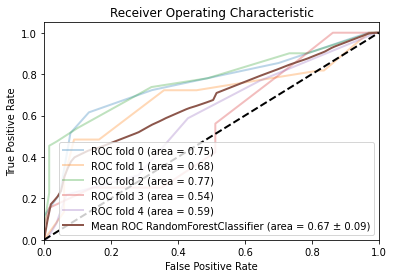

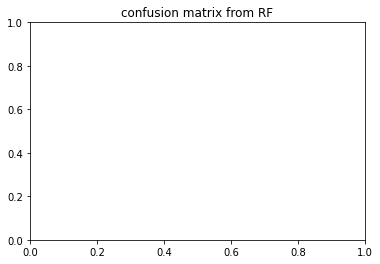

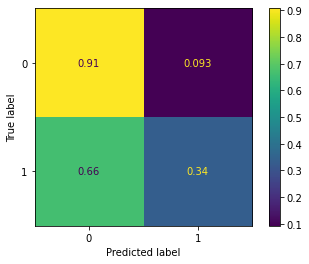

,precision,recall,f1-score,support,auc
0,0.581,0.908,0.707,131.600,0.000
1,0.831,0.332,0.445,131.600,0.000
accuracy,0.622,0.622,0.622,0.622,0.000
macro avg,0.706,0.620,0.576,263.200,0.669
weighted avg,0.705,0.622,0.578,263.200,0.669


coming from


,precision,recall,f1-score,support,auc
0,0.650000,0.921260,0.762215,127.000000,0.000000
1,0.870130,0.515385,0.647343,130.000000,0.000000
accuracy,0.715953,0.715953,0.715953,0.715953,0.000000
macro avg,0.760065,0.718322,0.704779,257.000000,0.754906
weighted avg,0.761350,0.715953,0.704109,257.000000,0.754906


,precision,recall,f1-score,support,auc
0,0.586047,0.940299,0.722063,134.000000,0.000000
1,0.822222,0.293651,0.432749,126.000000,0.000000
accuracy,0.626923,0.626923,0.626923,0.626923,0.000000
macro avg,0.704134,0.616975,0.577406,260.000000,0.684494
weighted avg,0.700501,0.626923,0.581857,260.000000,0.684494


,precision,recall,f1-score,support,auc
0,0.630000,0.961832,0.761329,131.000000,0.000000
1,0.930556,0.475177,0.629108,141.000000,0.000000
accuracy,0.709559,0.709559,0.709559,0.709559,0.000000
macro avg,0.780278,0.718505,0.695219,272.000000,0.770261
weighted avg,0.785803,0.709559,0.692788,272.000000,0.770261


,precision,recall,f1-score,support,auc
0,0.532520,1.000000,0.694960,131.000000,0.000000
1,1.000000,0.065041,0.122137,123.000000,0.000000
accuracy,0.547244,0.547244,0.547244,0.547244,0.000000
macro avg,0.766260,0.532520,0.408549,254.000000,0.544995
weighted avg,0.758898,0.547244,0.417570,254.000000,0.544995


,precision,recall,f1-score,support,auc
0,0.505208,0.718519,0.593272,135.000000,0.000000
1,0.530864,0.311594,0.392694,138.000000,0.000000
accuracy,0.512821,0.512821,0.512821,0.512821,0.000000
macro avg,0.518036,0.515056,0.492983,273.000000,0.589694
weighted avg,0.518177,0.512821,0.491881,273.000000,0.589694


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 10}
depth_100_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.721 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.575 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.688 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.675 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.692 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.914 total time=   0.0s
[CV 3/5] END criteri

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.591 total time=   1.4s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.488 total time=   1.5s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.360 total time=   1.5s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.595 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.847 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.400 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.626 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.378 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.772 total time=   1.6s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.885 total time=   1.8s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.581 total time=   1.7s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.528 total time=   1.7s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.418 total time=   1.7s


<Figure size 432x288 with 0 Axes>

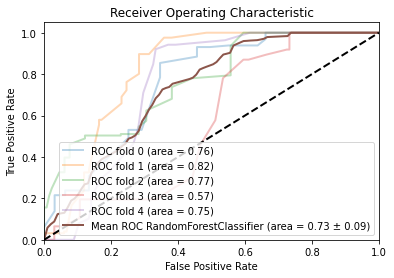

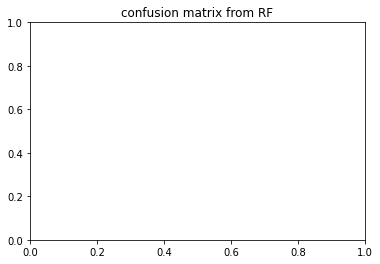

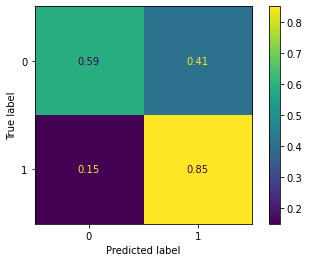

,precision,recall,f1-score,support,auc
0,0.799,0.585,0.669,131.600,0.000
1,0.675,0.849,0.751,131.600,0.000
accuracy,0.717,0.717,0.717,0.717,0.000
macro avg,0.737,0.717,0.710,263.200,0.731
weighted avg,0.737,0.717,0.710,263.200,0.731


coming from


,precision,recall,f1-score,support,auc
0,0.747748,0.653543,0.697479,127.000000,0.000000
1,0.698630,0.784615,0.739130,130.000000,0.000000
accuracy,0.719844,0.719844,0.719844,0.719844,0.000000
macro avg,0.723189,0.719079,0.718305,257.000000,0.757601
weighted avg,0.722902,0.719844,0.718548,257.000000,0.757601


,precision,recall,f1-score,support,auc
0,0.876190,0.686567,0.769874,134.000000,0.000000
1,0.729032,0.896825,0.804270,126.000000,0.000000
accuracy,0.788462,0.788462,0.788462,0.788462,0.000000
macro avg,0.802611,0.791696,0.787072,260.000000,0.819237
weighted avg,0.804875,0.788462,0.786543,260.000000,0.819237


,precision,recall,f1-score,support,auc
0,0.865672,0.442748,0.585859,131.000000,0.000000
1,0.643902,0.936170,0.763006,141.000000,0.000000
accuracy,0.698529,0.698529,0.698529,0.698529,0.000000
macro avg,0.754787,0.689459,0.674432,272.000000,0.765497
weighted avg,0.750710,0.698529,0.677689,272.000000,0.765497


,precision,recall,f1-score,support,auc
0,0.693182,0.465649,0.557078,131.00000,0.00000
1,0.578313,0.780488,0.664360,123.00000,0.00000
accuracy,0.618110,0.618110,0.618110,0.61811,0.00000
macro avg,0.635748,0.623068,0.610719,254.00000,0.56563
weighted avg,0.637556,0.618110,0.609029,254.00000,0.56563


,precision,recall,f1-score,support,auc
0,0.812500,0.674074,0.736842,135.000000,0.000000
1,0.726708,0.847826,0.782609,138.000000,0.000000
accuracy,0.761905,0.761905,0.761905,0.761905,0.000000
macro avg,0.769604,0.760950,0.759725,273.000000,0.748685
weighted avg,0.769133,0.761905,0.759977,273.000000,0.748685


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 50}
depth_100_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.627 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.580 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.880 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.505 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.658 total time=   0.1s
[CV 3/5] END crit

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.728 total time=   2.6s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.524 total time=   2.3s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.690 total time=   2.7s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.661 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.631 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.631 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.950 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.768 total time=   1.4s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.528 total time=   2.9s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.746 total time=   3.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.632 total time=   2.6s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.468 total time=   2.5s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.832 total time=   2.8s


<Figure size 432x288 with 0 Axes>

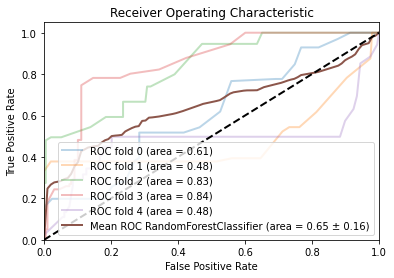

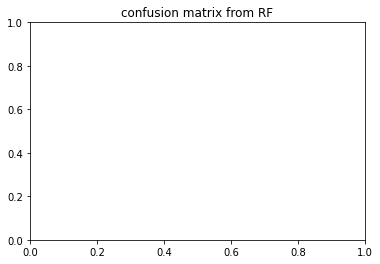

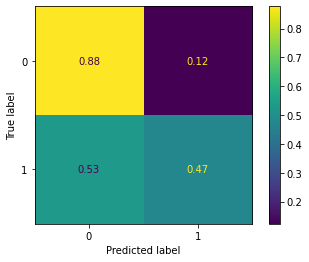

,precision,recall,f1-score,support,auc
0,0.630,0.879,0.731,200.000,0.000
1,0.825,0.472,0.584,200.000,0.000
accuracy,0.676,0.676,0.676,0.676,0.000
macro avg,0.728,0.676,0.657,400.000,0.647
weighted avg,0.728,0.676,0.658,400.000,0.647


coming from


,precision,recall,f1-score,support,auc
0,0.559259,0.715640,0.627859,211.000000,0.000000
1,0.565217,0.395939,0.465672,197.000000,0.000000
accuracy,0.561275,0.561275,0.561275,0.561275,0.000000
macro avg,0.562238,0.555789,0.546765,408.000000,0.608235
weighted avg,0.562136,0.561275,0.549548,408.000000,0.608235


,precision,recall,f1-score,support,auc
0,0.605505,1.000000,0.754286,198.000000,0.000000
1,1.000000,0.331606,0.498054,193.000000,0.000000
accuracy,0.670077,0.670077,0.670077,0.670077,0.000000
macro avg,0.802752,0.665803,0.626170,391.000000,0.479562
weighted avg,0.800230,0.670077,0.627808,391.000000,0.479562


,precision,recall,f1-score,support,auc
0,0.627832,0.994872,0.769841,195.000000,0.000000
1,0.988889,0.436275,0.605442,204.000000,0.000000
accuracy,0.709273,0.709273,0.709273,0.709273,0.000000
macro avg,0.808360,0.715573,0.687642,399.000000,0.827539
weighted avg,0.812432,0.709273,0.685788,399.000000,0.827539


,precision,recall,f1-score,support,auc
0,0.778761,0.888889,0.830189,198.000000,0.000000
1,0.869822,0.746193,0.803279,197.000000,0.000000
accuracy,0.817722,0.817722,0.817722,0.817722,0.000000
macro avg,0.824292,0.817541,0.816734,395.000000,0.844434
weighted avg,0.824177,0.817722,0.816768,395.000000,0.844434


,precision,recall,f1-score,support,auc
0,0.578755,0.797980,0.670913,198.000000,0.00000
1,0.701493,0.449761,0.548105,209.000000,0.00000
accuracy,0.619165,0.619165,0.619165,0.619165,0.00000
macro avg,0.640124,0.623870,0.609509,407.000000,0.47685
weighted avg,0.641782,0.619165,0.607849,407.000000,0.47685


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 50}
depth_100_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.420 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.498 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.748 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.557 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.556 total time=   0.1s
[CV 3/5] END criteri

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.733 total time=   2.6s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.496 total time=   2.4s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.683 total time=   2.7s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.732 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.523 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.549 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.571 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.881 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.767 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.477 total time=   2.4s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.758 total time=   2.9s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.609 total time=   2.5s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.544 total time=   2.4s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.819 total time=   2.8s


<Figure size 432x288 with 0 Axes>

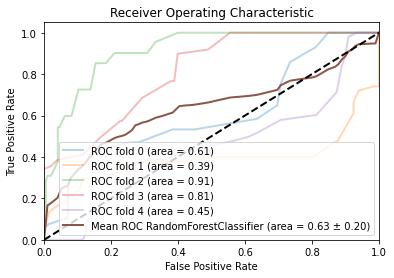

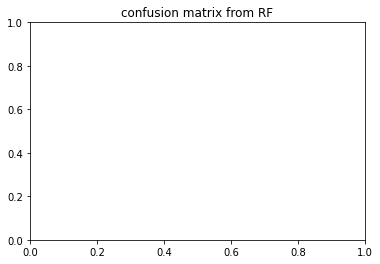

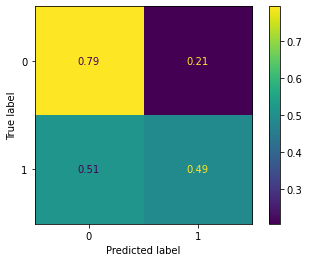

,precision,recall,f1-score,support,auc
0,0.625,0.793,0.690,200.000,0.000
1,0.697,0.486,0.551,200.000,0.000
accuracy,0.641,0.641,0.641,0.641,0.000
macro avg,0.661,0.640,0.620,400.000,0.635
weighted avg,0.661,0.641,0.621,400.000,0.635


coming from


,precision,recall,f1-score,support,auc
0,0.601307,0.872038,0.711799,211.000000,0.000000
1,0.735294,0.380711,0.501672,197.000000,0.000000
accuracy,0.634804,0.634804,0.634804,0.634804,0.000000
macro avg,0.668301,0.626374,0.606736,408.000000,0.606924
weighted avg,0.666002,0.634804,0.610341,408.000000,0.606924


,precision,recall,f1-score,support,auc
0,0.547988,0.893939,0.679463,198.00000,0.000000
1,0.691176,0.243523,0.360153,193.00000,0.000000
accuracy,0.572890,0.572890,0.572890,0.57289,0.000000
macro avg,0.619582,0.568731,0.519808,391.00000,0.392186
weighted avg,0.618667,0.572890,0.521850,391.00000,0.392186


,precision,recall,f1-score,support,auc
0,0.750000,0.861538,0.801909,195.00000,0.000000
1,0.845714,0.725490,0.781003,204.00000,0.000000
accuracy,0.791980,0.791980,0.791980,0.79198,0.000000
macro avg,0.797857,0.793514,0.791456,399.00000,0.913311
weighted avg,0.798937,0.791980,0.791220,399.00000,0.913311


,precision,recall,f1-score,support,auc
0,0.724551,0.611111,0.663014,198.000000,0.000000
1,0.662281,0.766497,0.710588,197.000000,0.000000
accuracy,0.688608,0.688608,0.688608,0.688608,0.000000
macro avg,0.693416,0.688804,0.686801,395.000000,0.809401
weighted avg,0.693495,0.688608,0.686741,395.000000,0.809401


,precision,recall,f1-score,support,auc
0,0.501742,0.727273,0.593814,198.000000,0.000000
1,0.550000,0.315789,0.401216,209.000000,0.000000
accuracy,0.515971,0.515971,0.515971,0.515971,0.000000
macro avg,0.525871,0.521531,0.497515,407.000000,0.451054
weighted avg,0.526523,0.515971,0.494912,407.000000,0.451054


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 50}
depth_100_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.818 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.895 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.641 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.436 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.847 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.821 total time=   0.1s
[CV 3/5] END 

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.605 total time=   1.2s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.617 total time=   1.3s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.585 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.737 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.870 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.753 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.837 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.564 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.568 total time=   0.7s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.676 total time=   1.5s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.627 total time=   1.5s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.587 total time=   1.4s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.470 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.7s


<Figure size 432x288 with 0 Axes>

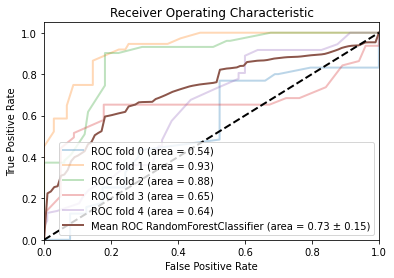

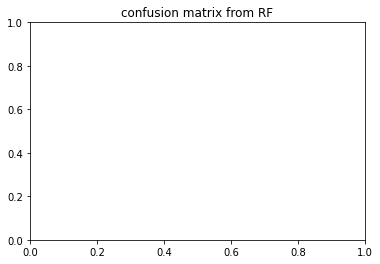

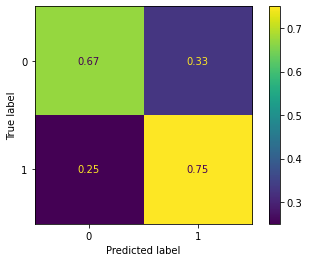

,precision,recall,f1-score,support,auc
0,0.724,0.674,0.686,102.200,0.000
1,0.715,0.744,0.721,102.200,0.000
accuracy,0.709,0.709,0.709,0.709,0.000
macro avg,0.720,0.709,0.703,204.400,0.728
weighted avg,0.720,0.709,0.704,204.400,0.728


coming from


,precision,recall,f1-score,support,auc
0,0.628205,0.475728,0.541436,103.000000,0.000000
1,0.550000,0.694737,0.613953,95.000000,0.000000
accuracy,0.580808,0.580808,0.580808,0.580808,0.000000
macro avg,0.589103,0.585232,0.577695,198.000000,0.540521
weighted avg,0.590682,0.580808,0.576230,198.000000,0.540521


,precision,recall,f1-score,support,auc
0,0.807339,0.854369,0.830189,103.000000,0.000000
1,0.857143,0.810811,0.833333,111.000000,0.000000
accuracy,0.831776,0.831776,0.831776,0.831776,0.000000
macro avg,0.832241,0.832590,0.831761,214.000000,0.929109
weighted avg,0.833172,0.831776,0.831820,214.000000,0.929109


,precision,recall,f1-score,support,auc
0,0.757009,0.818182,0.786408,99.000000,0.000000
1,0.808511,0.745098,0.775510,102.000000,0.000000
accuracy,0.781095,0.781095,0.781095,0.781095,0.000000
macro avg,0.782760,0.781640,0.780959,201.000000,0.878144
weighted avg,0.783144,0.781095,0.780878,201.000000,0.878144


,precision,recall,f1-score,support,auc
0,0.691667,0.821782,0.751131,101.000000,0.000000
1,0.763158,0.610526,0.678363,95.000000,0.000000
accuracy,0.719388,0.719388,0.719388,0.719388,0.000000
macro avg,0.727412,0.716154,0.714747,196.000000,0.651433
weighted avg,0.726318,0.719388,0.715861,196.000000,0.651433


,precision,recall,f1-score,support,auc
0,0.736842,0.400000,0.518519,105.000000,0.000000
1,0.596154,0.861111,0.704545,108.000000,0.000000
accuracy,0.633803,0.633803,0.633803,0.633803,0.000000
macro avg,0.666498,0.630556,0.611532,213.000000,0.640564
weighted avg,0.665507,0.633803,0.612842,213.000000,0.640564


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_100_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.574 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.640 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.878 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.380 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.674 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.753 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.627 total time=   0.1s
[CV 3/5] END crite

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.543 total time=   1.1s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.522 total time=   1.1s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.574 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.864 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.975 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.774 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.580 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.370 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.574 total time=   0.7s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.645 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.589 total time=   1.6s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.504 total time=   1.4s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.471 total time=   1.3s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.5s


<Figure size 432x288 with 0 Axes>

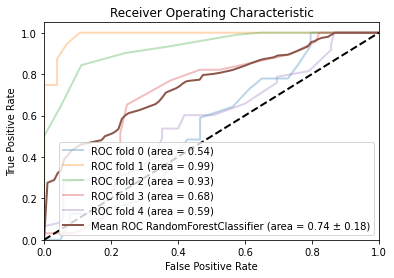

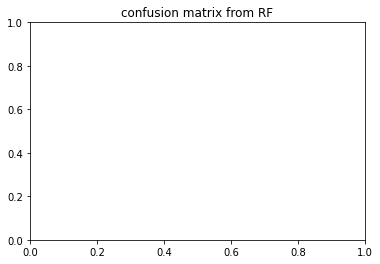

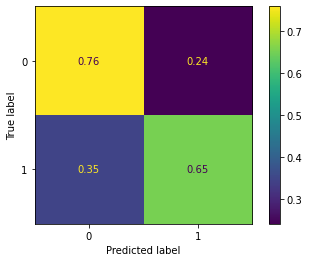

,precision,recall,f1-score,support,auc
0,0.723,0.760,0.693,102.200,0.000
1,0.775,0.655,0.664,102.200,0.000
accuracy,0.704,0.704,0.704,0.704,0.000
macro avg,0.749,0.708,0.678,204.400,0.745
weighted avg,0.751,0.704,0.677,204.400,0.745


coming from


,precision,recall,f1-score,support,auc
0,0.777778,0.203883,0.323077,103.000000,0.000000
1,0.520468,0.936842,0.669173,95.000000,0.000000
accuracy,0.555556,0.555556,0.555556,0.555556,0.000000
macro avg,0.649123,0.570363,0.496125,198.000000,0.538631
weighted avg,0.654321,0.555556,0.489133,198.000000,0.538631


,precision,recall,f1-score,support,auc
0,0.941176,0.932039,0.936585,103.000000,0.00000
1,0.937500,0.945946,0.941704,111.000000,0.00000
accuracy,0.939252,0.939252,0.939252,0.939252,0.00000
macro avg,0.939338,0.938992,0.939145,214.000000,0.98653
weighted avg,0.939270,0.939252,0.939240,214.000000,0.98653


,precision,recall,f1-score,support,auc
0,0.723077,0.949495,0.820961,99.00000,0.00000
1,0.929577,0.647059,0.763006,102.00000,0.00000
accuracy,0.796020,0.796020,0.796020,0.79602,0.00000
macro avg,0.826327,0.798277,0.791983,201.00000,0.92751
weighted avg,0.827868,0.796020,0.791551,201.00000,0.92751


,precision,recall,f1-score,support,auc
0,0.629032,0.772277,0.693333,101.000000,0.000000
1,0.680556,0.515789,0.586826,95.000000,0.000000
accuracy,0.647959,0.647959,0.647959,0.647959,0.000000
macro avg,0.654794,0.644033,0.640080,196.000000,0.683273
weighted avg,0.654005,0.647959,0.641710,196.000000,0.683273


,precision,recall,f1-score,support,auc
0,0.543956,0.942857,0.689895,105.00000,0.000000
1,0.806452,0.231481,0.359712,108.00000,0.000000
accuracy,0.582160,0.582160,0.582160,0.58216,0.000000
macro avg,0.675204,0.587169,0.524804,213.00000,0.591358
weighted avg,0.677052,0.582160,0.522479,213.00000,0.591358


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 50}
depth_100_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.710 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.507 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.743 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.787 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.538 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.375 total time=   0.1s
[CV 3/5] END cri

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.583 total time=   1.9s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.781 total time=   1.9s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.665 total time=   2.3s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.543 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.404 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.656 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.627 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.977 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.721 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.658 total time=   2.4s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.335 total time=   2.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.631 total time=   2.2s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.793 total time=   2.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.685 total time=   2.5s


<Figure size 432x288 with 0 Axes>

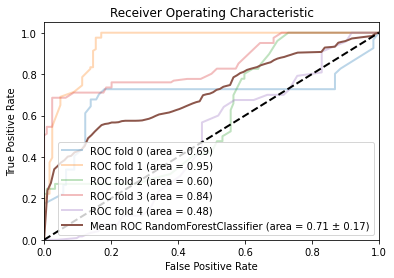

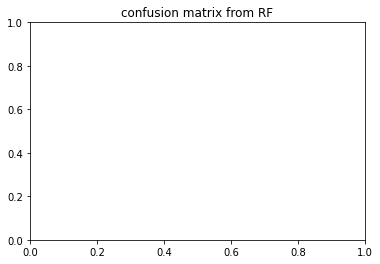

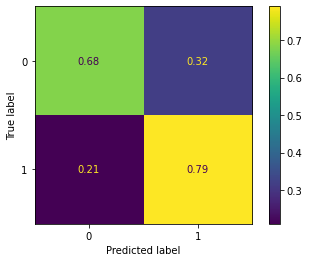

,precision,recall,f1-score,support,auc
0,0.781,0.682,0.697,122.800,0.000
1,0.751,0.787,0.751,122.800,0.000
accuracy,0.736,0.736,0.736,0.736,0.000
macro avg,0.766,0.734,0.724,245.600,0.711
weighted avg,0.765,0.736,0.725,245.600,0.711


coming from


,precision,recall,f1-score,support,auc
0,0.739130,0.836066,0.784615,122.000000,0.000000
1,0.809524,0.702479,0.752212,121.000000,0.000000
accuracy,0.769547,0.769547,0.769547,0.769547,0.000000
macro avg,0.774327,0.769272,0.768414,243.000000,0.691133
weighted avg,0.774182,0.769547,0.768481,243.000000,0.691133


,precision,recall,f1-score,support,auc
0,0.971429,0.829268,0.894737,123.000000,0.000000
1,0.854167,0.976190,0.911111,126.000000,0.000000
accuracy,0.903614,0.903614,0.903614,0.903614,0.000000
macro avg,0.912798,0.902729,0.902924,249.000000,0.946477
weighted avg,0.912091,0.903614,0.903023,249.000000,0.946477


,precision,recall,f1-score,support,auc
0,0.880952,0.303279,0.451220,122.000000,0.000000
1,0.587379,0.960317,0.728916,126.000000,0.000000
accuracy,0.637097,0.637097,0.637097,0.637097,0.000000
macro avg,0.734166,0.631798,0.590068,248.000000,0.595596
weighted avg,0.731798,0.637097,0.592307,248.000000,0.595596


,precision,recall,f1-score,support,auc
0,0.742331,0.975806,0.843206,124.000000,0.000000
1,0.963415,0.652893,0.778325,121.000000,0.000000
accuracy,0.816327,0.816327,0.816327,0.816327,0.000000
macro avg,0.852873,0.814350,0.810765,245.000000,0.844408
weighted avg,0.851519,0.816327,0.811163,245.000000,0.844408


,precision,recall,f1-score,support,auc
0,0.570000,0.463415,0.511211,123.00000,0.000000
1,0.538462,0.641667,0.585551,120.00000,0.000000
accuracy,0.551440,0.551440,0.551440,0.55144,0.000000
macro avg,0.554231,0.552541,0.548381,243.00000,0.478997
weighted avg,0.554425,0.551440,0.547922,243.00000,0.478997


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_100_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.758 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.469 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.569 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.678 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.291 total time=   0.1s
[CV 3/5] END criterio

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.566 total time=   1.9s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.767 total time=   2.1s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.680 total time=   2.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.722 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.385 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.757 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.808 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.859 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.721 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.747 total time=   2.9s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.403 total time=   2.2s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.571 total time=   2.2s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.749 total time=   2.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.767 total time=   2.4s


<Figure size 432x288 with 0 Axes>

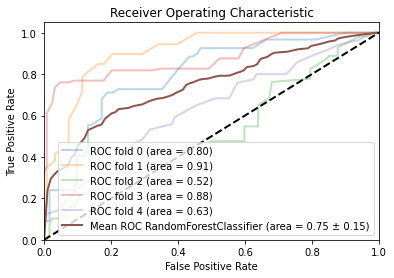

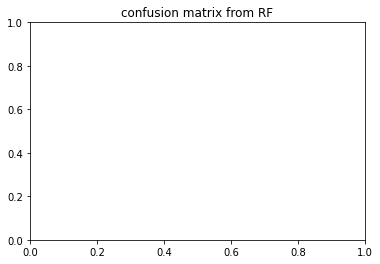

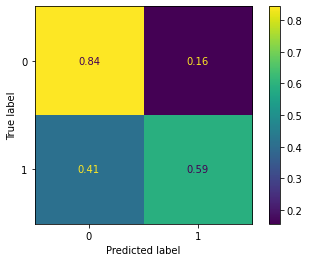

,precision,recall,f1-score,support,auc
0,0.692,0.844,0.754,122.800,0.000
1,0.773,0.590,0.652,122.800,0.000
accuracy,0.717,0.717,0.717,0.717,0.000
macro avg,0.732,0.717,0.703,245.600,0.748
weighted avg,0.732,0.717,0.703,245.600,0.748


coming from


,precision,recall,f1-score,support,auc
0,0.721429,0.827869,0.770992,122.000000,0.000000
1,0.796117,0.677686,0.732143,121.000000,0.000000
accuracy,0.753086,0.753086,0.753086,0.753086,0.000000
macro avg,0.758773,0.752777,0.751568,243.000000,0.796437
weighted avg,0.758619,0.753086,0.751648,243.000000,0.796437


,precision,recall,f1-score,support,auc
0,0.841667,0.821138,0.831276,123.000000,0.000000
1,0.829457,0.849206,0.839216,126.000000,0.000000
accuracy,0.835341,0.835341,0.835341,0.835341,0.000000
macro avg,0.835562,0.835172,0.835246,249.000000,0.907827
weighted avg,0.835488,0.835341,0.835294,249.000000,0.907827


,precision,recall,f1-score,support,auc
0,0.521531,0.893443,0.658610,122.000000,0.000000
1,0.666667,0.206349,0.315152,126.000000,0.000000
accuracy,0.544355,0.544355,0.544355,0.544355,0.000000
macro avg,0.594099,0.549896,0.486881,248.000000,0.523517
weighted avg,0.595269,0.544355,0.484111,248.000000,0.523517


,precision,recall,f1-score,support,auc
0,0.789474,0.967742,0.869565,124.000000,0.000000
1,0.956989,0.735537,0.831776,121.000000,0.000000
accuracy,0.853061,0.853061,0.853061,0.853061,0.000000
macro avg,0.873231,0.851640,0.850670,245.000000,0.878099
weighted avg,0.872206,0.853061,0.850902,245.000000,0.878099


,precision,recall,f1-score,support,auc
0,0.583893,0.707317,0.639706,123.000000,0.000000
1,0.617021,0.483333,0.542056,120.000000,0.000000
accuracy,0.596708,0.596708,0.596708,0.596708,0.000000
macro avg,0.600457,0.595325,0.590881,243.000000,0.632757
weighted avg,0.600252,0.596708,0.591484,243.000000,0.632757


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.768 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.763 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.552 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.237 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.496 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.700 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.865 total time=   0.0s
[CV 3/5]

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.818 total time=   1.5s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.594 total time=   1.5s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.571 total time=   1.3s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.339 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.589 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.841 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.668 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.718 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.584 total time=   0.8s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.458 total time=   0.8s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.602 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.786 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.784 total time=   1.8s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.581 total time=   1.8s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.487 total time=   2.2s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.405 total time=   1.9s


<Figure size 432x288 with 0 Axes>

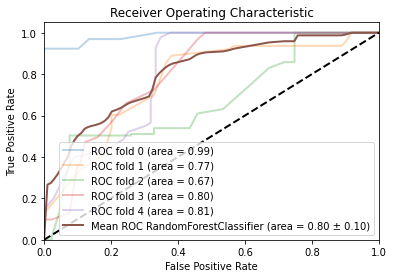

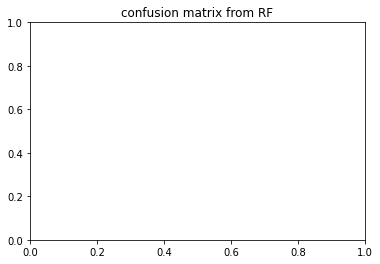

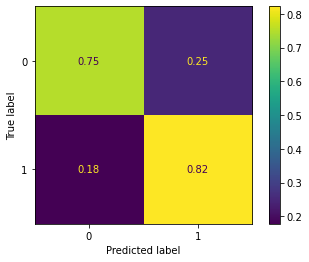

,precision,recall,f1-score,support,auc
0,0.843,0.753,0.775,131.600,0.000
1,0.793,0.829,0.789,131.600,0.000
accuracy,0.787,0.787,0.787,0.787,0.000
macro avg,0.818,0.791,0.782,263.200,0.806
weighted avg,0.820,0.787,0.781,263.200,0.806


coming from


,precision,recall,f1-score,support,auc
0,0.920290,1.000000,0.958491,127.000000,0.000000
1,1.000000,0.915385,0.955823,130.000000,0.000000
accuracy,0.957198,0.957198,0.957198,0.957198,0.000000
macro avg,0.960145,0.957692,0.957157,257.000000,0.985827
weighted avg,0.960610,0.957198,0.957141,257.000000,0.985827


,precision,recall,f1-score,support,auc
0,0.825243,0.634328,0.717300,134.000000,0.000000
1,0.687898,0.857143,0.763251,126.000000,0.000000
accuracy,0.742308,0.742308,0.742308,0.742308,0.000000
macro avg,0.756570,0.745736,0.740275,260.000000,0.766673
weighted avg,0.758683,0.742308,0.739568,260.000000,0.766673


,precision,recall,f1-score,support,auc
0,0.620513,0.923664,0.742331,131.000000,0.000000
1,0.870130,0.475177,0.614679,141.000000,0.000000
accuracy,0.691176,0.691176,0.691176,0.691176,0.000000
macro avg,0.745321,0.699421,0.678505,272.000000,0.672432
weighted avg,0.749910,0.691176,0.676159,272.000000,0.672432


,precision,recall,f1-score,support,auc
0,0.946667,0.541985,0.689320,131.000000,0.000000
1,0.664804,0.967480,0.788079,123.000000,0.000000
accuracy,0.748031,0.748031,0.748031,0.748031,0.000000
macro avg,0.805736,0.754732,0.738700,254.000000,0.798858
weighted avg,0.810174,0.748031,0.737145,254.000000,0.798858


,precision,recall,f1-score,support,auc
0,0.900000,0.666667,0.765957,135.000000,0.000000
1,0.739884,0.927536,0.823151,138.000000,0.000000
accuracy,0.798535,0.798535,0.798535,0.798535,0.000000
macro avg,0.819942,0.797101,0.794554,273.000000,0.806924
weighted avg,0.819062,0.798535,0.794869,273.000000,0.806924


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'sqrt', 'n_estimators': 50}
depth_1000_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.823 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.335 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.491 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.825 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.937 total time=   0.0s
[CV 3/5] EN

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.595 total time=   1.5s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.588 total time=   1.5s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.584 total time=   1.3s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.433 total time=   1.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.830 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.386 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.632 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.389 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.580 total time=   0.8s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.576 total time=   0.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.418 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.747 total time=   1.5s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.707 total time=   1.7s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.594 total time=   1.5s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.438 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.251 total time=   1.6s


<Figure size 432x288 with 0 Axes>

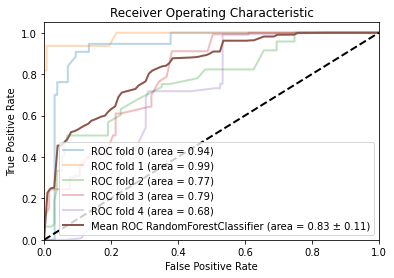

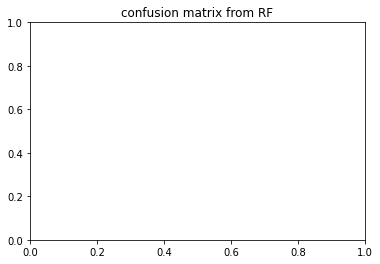

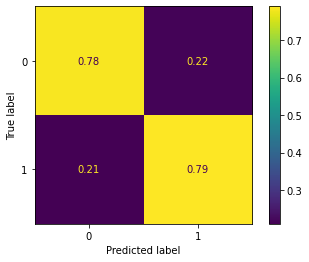

,precision,recall,f1-score,support,auc
0,0.806,0.786,0.778,131.600,0.000
1,0.817,0.795,0.787,131.600,0.000
accuracy,0.789,0.789,0.789,0.789,0.000
macro avg,0.812,0.790,0.783,263.200,0.833
weighted avg,0.812,0.789,0.782,263.200,0.833


coming from


,precision,recall,f1-score,support,auc
0,0.884615,0.905512,0.894942,127.000000,0.000000
1,0.905512,0.884615,0.894942,130.000000,0.000000
accuracy,0.894942,0.894942,0.894942,0.894942,0.000000
macro avg,0.895064,0.895064,0.894942,257.000000,0.938583
weighted avg,0.895186,0.894942,0.894942,257.000000,0.938583


,precision,recall,f1-score,support,auc
0,0.923611,0.992537,0.956835,134.000000,0.000000
1,0.991379,0.912698,0.950413,126.000000,0.000000
accuracy,0.953846,0.953846,0.953846,0.953846,0.000000
macro avg,0.957495,0.952618,0.953624,260.000000,0.986081
weighted avg,0.956453,0.953846,0.953723,260.000000,0.986081


,precision,recall,f1-score,support,auc
0,0.622449,0.931298,0.746177,131.000000,0.000000
1,0.881579,0.475177,0.617512,141.000000,0.000000
accuracy,0.694853,0.694853,0.694853,0.694853,0.000000
macro avg,0.752014,0.703238,0.681844,272.000000,0.766797
weighted avg,0.756777,0.694853,0.679479,272.000000,0.766797


,precision,recall,f1-score,support,auc
0,0.761468,0.633588,0.691667,131.000000,0.000000
1,0.668966,0.788618,0.723881,123.000000,0.000000
accuracy,0.708661,0.708661,0.708661,0.708661,0.000000
macro avg,0.715217,0.711103,0.707774,254.000000,0.792652
weighted avg,0.716673,0.708661,0.707266,254.000000,0.792652


,precision,recall,f1-score,support,auc
0,0.840000,0.466667,0.600000,135.000000,0.000000
1,0.636364,0.913043,0.750000,138.000000,0.000000
accuracy,0.692308,0.692308,0.692308,0.692308,0.000000
macro avg,0.738182,0.689855,0.675000,273.000000,0.679576
weighted avg,0.737063,0.692308,0.675824,273.000000,0.679576


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'sqrt', 'n_estimators': 100}
depth_1000_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.641 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.581 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.362 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.845 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.519 total time=   0.2s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.604 total time=   0.1s
[CV 

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.766 total time=   2.8s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.714 total time=   2.6s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.472 total time=   2.4s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.741 total time=   3.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.838 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.740 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.643 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.511 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.614 total time=   1.8s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.500 total time=   1.4s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.778 total time=   1.5s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.564 total time=   2.5s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.725 total time=   3.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.633 total time=   2.6s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.487 total time=   2.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.842 total time=   3.0s


<Figure size 432x288 with 0 Axes>

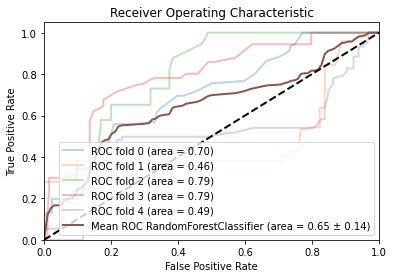

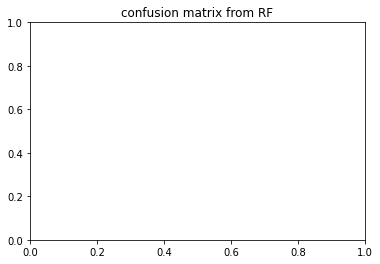

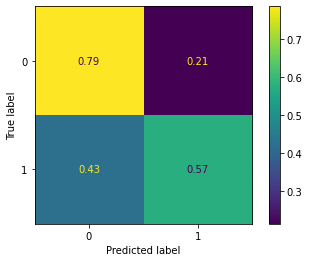

,precision,recall,f1-score,support,auc
0,0.696,0.785,0.708,200.00,0.000
1,0.771,0.571,0.613,200.00,0.000
accuracy,0.680,0.680,0.680,0.68,0.000
macro avg,0.733,0.678,0.660,400.00,0.646
weighted avg,0.732,0.680,0.661,400.00,0.646


coming from


,precision,recall,f1-score,support,auc
0,0.622711,0.805687,0.702479,211.000000,0.000000
1,0.696296,0.477157,0.566265,197.000000,0.000000
accuracy,0.647059,0.647059,0.647059,0.647059,0.000000
macro avg,0.659503,0.641422,0.634372,408.000000,0.699305
weighted avg,0.658241,0.647059,0.636709,408.000000,0.699305


,precision,recall,f1-score,support,auc
0,0.582353,1.000000,0.736059,198.000000,0.000000
1,1.000000,0.264249,0.418033,193.000000,0.000000
accuracy,0.636829,0.636829,0.636829,0.636829,0.000000
macro avg,0.791176,0.632124,0.577046,391.000000,0.461218
weighted avg,0.788506,0.636829,0.579080,391.000000,0.461218


,precision,recall,f1-score,support,auc
0,0.980392,0.512821,0.673401,195.000000,0.000000
1,0.680135,0.990196,0.806387,204.000000,0.000000
accuracy,0.756892,0.756892,0.756892,0.756892,0.000000
macro avg,0.830263,0.751508,0.739894,399.000000,0.792559
weighted avg,0.826877,0.756892,0.741394,399.000000,0.792559


,precision,recall,f1-score,support,auc
0,0.718062,0.823232,0.767059,198.000000,0.000000
1,0.791667,0.675127,0.728767,197.000000,0.000000
accuracy,0.749367,0.749367,0.749367,0.749367,0.000000
macro avg,0.754864,0.749180,0.747913,395.000000,0.788917
weighted avg,0.754771,0.749367,0.747961,395.000000,0.788917


,precision,recall,f1-score,support,auc
0,0.574074,0.782828,0.662393,198.000000,0.000000
1,0.686131,0.449761,0.543353,209.000000,0.000000
accuracy,0.611794,0.611794,0.611794,0.611794,0.000000
macro avg,0.630103,0.616295,0.602873,407.000000,0.486697
weighted avg,0.631617,0.611794,0.601264,407.000000,0.486697


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.612 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.367 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.856 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.617 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.716 total time=   0.3s
[CV 3/5] END 

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.723 total time=   2.9s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.707 total time=   2.5s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.461 total time=   2.3s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.707 total time=   2.7s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.537 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.577 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.771 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.331 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.602 total time=   1.2s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.536 total time=   1.3s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.811 total time=   1.5s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.571 total time=   2.5s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.780 total time=   3.1s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.634 total time=   2.6s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.496 total time=   2.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.764 total time=   3.2s


<Figure size 432x288 with 0 Axes>

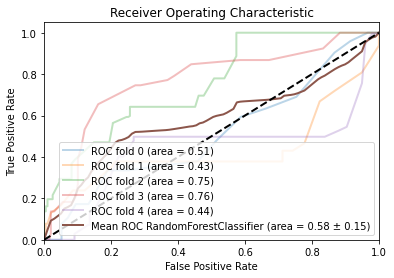

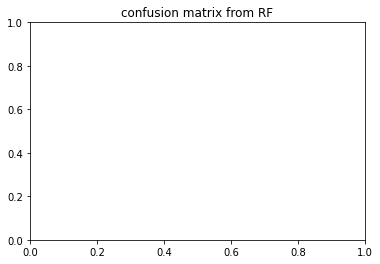

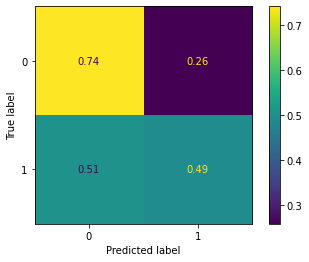

,precision,recall,f1-score,support,auc
0,0.620,0.739,0.652,200.000,0.000
1,0.656,0.490,0.534,200.000,0.000
accuracy,0.617,0.617,0.617,0.617,0.000
macro avg,0.638,0.614,0.593,400.000,0.579
weighted avg,0.638,0.617,0.595,400.000,0.579


coming from


,precision,recall,f1-score,support,auc
0,0.533923,0.857820,0.658182,211.000000,0.000000
1,0.565217,0.197970,0.293233,197.000000,0.000000
accuracy,0.539216,0.539216,0.539216,0.539216,0.000000
macro avg,0.549570,0.527895,0.475707,408.000000,0.509382
weighted avg,0.549033,0.539216,0.481969,408.000000,0.509382


,precision,recall,f1-score,support,auc
0,0.558304,0.797980,0.656965,198.000000,0.000000
1,0.629630,0.352332,0.451827,193.000000,0.000000
accuracy,0.578005,0.578005,0.578005,0.578005,0.000000
macro avg,0.593967,0.575156,0.554396,391.000000,0.430392
weighted avg,0.593511,0.578005,0.555708,391.000000,0.430392


,precision,recall,f1-score,support,auc
0,0.783019,0.425641,0.551495,195.000000,0.000000
1,0.617747,0.887255,0.728370,204.000000,0.000000
accuracy,0.661654,0.661654,0.661654,0.661654,0.000000
macro avg,0.700383,0.656448,0.639933,399.000000,0.750025
weighted avg,0.698519,0.661654,0.641927,399.000000,0.750025


,precision,recall,f1-score,support,auc
0,0.654135,0.878788,0.750000,198.000000,0.000000
1,0.813953,0.532995,0.644172,197.000000,0.000000
accuracy,0.706329,0.706329,0.706329,0.706329,0.000000
macro avg,0.734044,0.705891,0.697086,395.000000,0.764805
weighted avg,0.733842,0.706329,0.697220,395.000000,0.764805


,precision,recall,f1-score,support,auc
0,0.570866,0.732323,0.641593,198.000000,0.00000
1,0.653595,0.478469,0.552486,209.000000,0.00000
accuracy,0.601966,0.601966,0.601966,0.601966,0.00000
macro avg,0.612230,0.605396,0.597040,407.000000,0.43908
weighted avg,0.613348,0.601966,0.595835,407.000000,0.43908


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}
depth_1000_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.759 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.906 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.785 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.470 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.334 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.767 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.870 total time=   0.0s
[CV 3/5

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.670 total time=   1.2s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.563 total time=   1.1s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.465 total time=   1.1s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.646 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.878 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.773 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.592 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.488 total time=   0.7s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.485 total time=   0.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.568 total time=   0.7s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.686 total time=   1.5s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.604 total time=   1.4s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.553 total time=   1.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.481 total time=   1.3s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.567 total time=   1.4s


<Figure size 432x288 with 0 Axes>

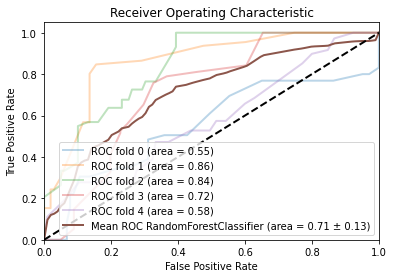

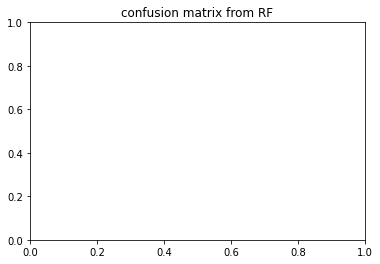

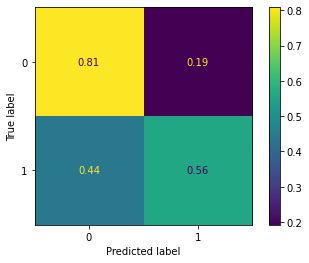

,precision,recall,f1-score,support,auc
0,0.694,0.806,0.724,102.200,0.000
1,0.743,0.558,0.587,102.200,0.000
accuracy,0.684,0.684,0.684,0.684,0.000
macro avg,0.719,0.682,0.655,204.400,0.711
weighted avg,0.718,0.684,0.656,204.400,0.711


coming from


,precision,recall,f1-score,support,auc
0,0.559524,0.912621,0.693727,103.000000,0.000000
1,0.700000,0.221053,0.336000,95.000000,0.000000
accuracy,0.580808,0.580808,0.580808,0.580808,0.000000
macro avg,0.629762,0.566837,0.514863,198.000000,0.554676
weighted avg,0.626924,0.580808,0.522090,198.000000,0.554676


,precision,recall,f1-score,support,auc
0,0.801802,0.864078,0.831776,103.000000,0.000000
1,0.864078,0.801802,0.831776,111.000000,0.000000
accuracy,0.831776,0.831776,0.831776,0.831776,0.000000
macro avg,0.832940,0.832940,0.831776,214.000000,0.863684
weighted avg,0.834104,0.831776,0.831776,214.000000,0.863684


,precision,recall,f1-score,support,auc
0,0.895522,0.606061,0.722892,99.000000,0.000000
1,0.708955,0.931373,0.805085,102.000000,0.000000
accuracy,0.771144,0.771144,0.771144,0.771144,0.000000
macro avg,0.802239,0.768717,0.763988,201.000000,0.838532
weighted avg,0.800847,0.771144,0.764602,201.000000,0.838532


,precision,recall,f1-score,support,auc
0,0.682692,0.702970,0.692683,101.000000,0.00000
1,0.673913,0.652632,0.663102,95.000000,0.00000
accuracy,0.678571,0.678571,0.678571,0.678571,0.00000
macro avg,0.678303,0.677801,0.677892,196.000000,0.71902
weighted avg,0.678437,0.678571,0.678345,196.000000,0.71902


,precision,recall,f1-score,support,auc
0,0.529412,0.942857,0.678082,105.000000,0.000000
1,0.769231,0.185185,0.298507,108.000000,0.000000
accuracy,0.558685,0.558685,0.558685,0.558685,0.000000
macro avg,0.649321,0.564021,0.488295,213.000000,0.579145
weighted avg,0.651010,0.558685,0.485622,213.000000,0.579145


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}
depth_1000_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.895 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.774 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.843 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.655 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.610 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.870 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.709 total time=   0.1s
[CV 3/5] END 

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.600 total time=   1.2s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.543 total time=   1.2s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.618 total time=   1.1s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.695 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.707 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.818 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.773 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.345 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.533 total time=   0.6s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.426 total time=   0.6s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.568 total time=   0.7s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.716 total time=   1.5s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.684 total time=   1.4s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.571 total time=   1.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.448 total time=   1.4s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.4s


<Figure size 432x288 with 0 Axes>

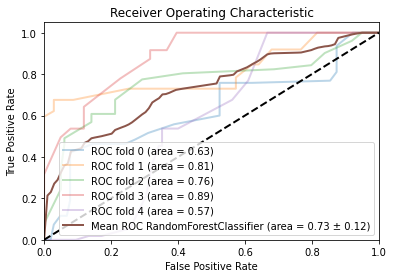

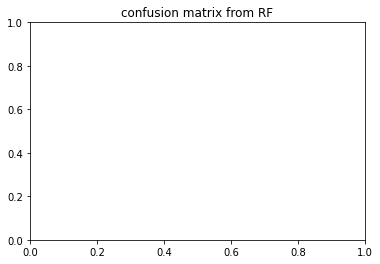

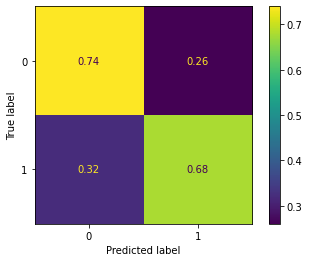

,precision,recall,f1-score,support,auc
0,0.710,0.741,0.706,102.20,0.00
1,0.762,0.678,0.691,102.20,0.00
accuracy,0.710,0.710,0.710,0.71,0.00
macro avg,0.736,0.709,0.698,204.40,0.73
weighted avg,0.737,0.710,0.699,204.40,0.73


coming from


,precision,recall,f1-score,support,auc
0,0.616883,0.922330,0.739300,103.000000,0.000000
1,0.818182,0.378947,0.517986,95.000000,0.000000
accuracy,0.661616,0.661616,0.661616,0.661616,0.000000
macro avg,0.717532,0.650639,0.628643,198.000000,0.625958
weighted avg,0.713466,0.661616,0.633114,198.000000,0.625958


,precision,recall,f1-score,support,auc
0,0.719424,0.970874,0.826446,103.000000,0.000000
1,0.960000,0.648649,0.774194,111.000000,0.000000
accuracy,0.803738,0.803738,0.803738,0.803738,0.000000
macro avg,0.839712,0.809761,0.800320,214.000000,0.808493
weighted avg,0.844209,0.803738,0.799343,214.000000,0.808493


,precision,recall,f1-score,support,auc
0,0.702703,0.787879,0.742857,99.000000,0.000000
1,0.766667,0.676471,0.718750,102.000000,0.000000
accuracy,0.731343,0.731343,0.731343,0.731343,0.000000
macro avg,0.734685,0.732175,0.730804,201.000000,0.757526
weighted avg,0.735162,0.731343,0.730624,201.000000,0.757526


,precision,recall,f1-score,support,auc
0,0.888889,0.633663,0.739884,101.000000,0.000000
1,0.701613,0.915789,0.794521,95.000000,0.000000
accuracy,0.770408,0.770408,0.770408,0.770408,0.000000
macro avg,0.795251,0.774726,0.767202,196.000000,0.885409
weighted avg,0.798117,0.770408,0.766366,196.000000,0.885409


,precision,recall,f1-score,support,auc
0,0.621212,0.390476,0.479532,105.00000,0.00000
1,0.564626,0.768519,0.650980,108.00000,0.00000
accuracy,0.582160,0.582160,0.582160,0.58216,0.00000
macro avg,0.592919,0.579497,0.565256,213.00000,0.57037
weighted avg,0.592520,0.582160,0.566464,213.00000,0.57037


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}
depth_1000_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.706 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.606 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.436 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.665 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.585 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.626 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.336 total time=   0.1s
[CV 3/5

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.378 total time=   2.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.721 total time=   2.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.791 total time=   1.9s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.654 total time=   2.3s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.690 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.478 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.624 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.922 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.539 total time=   1.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.738 total time=   1.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.816 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.630 total time=   2.2s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.280 total time=   2.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.610 total time=   2.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.820 total time=   2.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.690 total time=   2.4s


<Figure size 432x288 with 0 Axes>

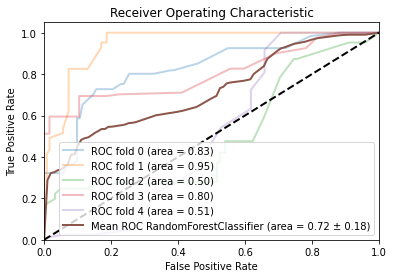

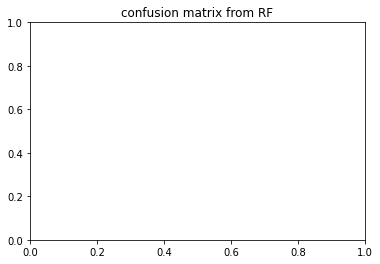

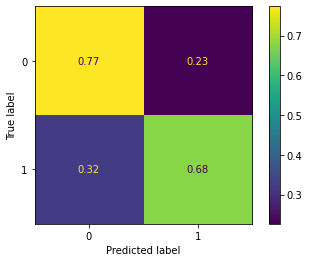

,precision,recall,f1-score,support,auc
0,0.747,0.774,0.725,122.800,0.000
1,0.792,0.678,0.682,122.800,0.000
accuracy,0.724,0.724,0.724,0.724,0.000
macro avg,0.770,0.726,0.704,245.600,0.717
weighted avg,0.770,0.724,0.703,245.600,0.717


coming from


,precision,recall,f1-score,support,auc
0,0.742857,0.852459,0.793893,122.000000,0.000000
1,0.825243,0.702479,0.758929,121.000000,0.000000
accuracy,0.777778,0.777778,0.777778,0.777778,0.000000
macro avg,0.784050,0.777469,0.776411,243.000000,0.825329
weighted avg,0.783880,0.777778,0.776483,243.000000,0.825329


,precision,recall,f1-score,support,auc
0,0.943396,0.813008,0.873362,123.000000,0.00000
1,0.839161,0.952381,0.892193,126.000000,0.00000
accuracy,0.883534,0.883534,0.883534,0.883534,0.00000
macro avg,0.891279,0.882695,0.882778,249.000000,0.94609
weighted avg,0.890651,0.883534,0.882891,249.000000,0.94609


,precision,recall,f1-score,support,auc
0,0.546296,0.967213,0.698225,122.00000,0.000000
1,0.875000,0.222222,0.354430,126.00000,0.000000
accuracy,0.588710,0.588710,0.588710,0.58871,0.000000
macro avg,0.710648,0.594718,0.526328,248.00000,0.504814
weighted avg,0.713299,0.588710,0.523555,248.00000,0.504814


,precision,recall,f1-score,support,auc
0,0.693750,0.895161,0.781690,124.000000,0.000000
1,0.847059,0.595041,0.699029,121.000000,0.000000
accuracy,0.746939,0.746939,0.746939,0.746939,0.000000
macro avg,0.770404,0.745101,0.740360,245.000000,0.800986
weighted avg,0.769466,0.746939,0.740866,245.000000,0.800986


,precision,recall,f1-score,support,auc
0,0.807692,0.341463,0.480000,123.000000,0.000000
1,0.575916,0.916667,0.707395,120.000000,0.000000
accuracy,0.625514,0.625514,0.625514,0.625514,0.000000
macro avg,0.691804,0.629065,0.593698,243.000000,0.506233
weighted avg,0.693235,0.625514,0.592294,243.000000,0.506233


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}
depth_1000_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.580 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.548 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.674 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.726 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.893 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.705 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.541 total time=   0.1s
[CV 3/5] E

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.387 total time=   2.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.596 total time=   2.1s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.814 total time=   1.8s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.635 total time=   2.5s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.254 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.680 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.546 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.618 total time=   1.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.833 total time=   1.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.698 total time=   1.2s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.633 total time=   2.5s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.375 total time=   2.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.554 total time=   2.2s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.793 total time=   2.1s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.737 total time=   2.6s


<Figure size 432x288 with 0 Axes>

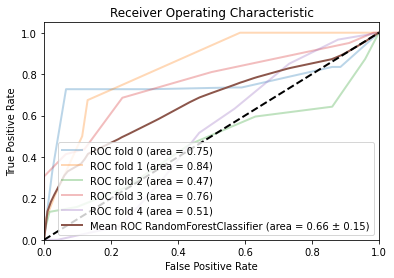

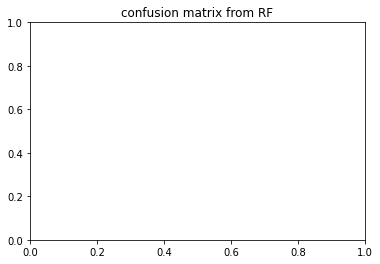

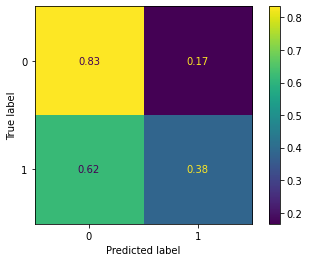

,precision,recall,f1-score,support,auc
0,0.578,0.834,0.670,122.800,0.000
1,0.810,0.387,0.460,122.800,0.000
accuracy,0.609,0.609,0.609,0.609,0.000
macro avg,0.694,0.611,0.565,245.600,0.664
weighted avg,0.695,0.609,0.564,245.600,0.664


coming from


,precision,recall,f1-score,support,auc
0,0.595000,0.975410,0.739130,122.000000,0.000000
1,0.930233,0.330579,0.487805,121.000000,0.000000
accuracy,0.654321,0.654321,0.654321,0.654321,0.000000
macro avg,0.762616,0.652994,0.613468,243.000000,0.746816
weighted avg,0.761927,0.654321,0.613985,243.000000,0.746816


,precision,recall,f1-score,support,auc
0,0.633721,0.886179,0.738983,123.000000,0.000000
1,0.818182,0.500000,0.620690,126.000000,0.000000
accuracy,0.690763,0.690763,0.690763,0.690763,0.000000
macro avg,0.725951,0.693089,0.679836,249.000000,0.839108
weighted avg,0.727063,0.690763,0.679124,249.000000,0.839108


,precision,recall,f1-score,support,auc
0,0.500000,1.000000,0.666667,122.000000,0.00000
1,1.000000,0.031746,0.061538,126.000000,0.00000
accuracy,0.508065,0.508065,0.508065,0.508065,0.00000
macro avg,0.750000,0.515873,0.364103,248.000000,0.47001
weighted avg,0.754032,0.508065,0.359222,248.000000,0.47001


,precision,recall,f1-score,support,auc
0,0.615819,0.879032,0.724252,124.000000,0.000000
1,0.779412,0.438017,0.560847,121.000000,0.000000
accuracy,0.661224,0.661224,0.661224,0.661224,0.000000
macro avg,0.697615,0.658524,0.642550,245.000000,0.758631
weighted avg,0.696614,0.661224,0.643550,245.000000,0.758631


,precision,recall,f1-score,support,auc
0,0.546392,0.430894,0.481818,123.000000,0.000000
1,0.520548,0.633333,0.571429,120.000000,0.000000
accuracy,0.530864,0.530864,0.530864,0.530864,0.000000
macro avg,0.533470,0.532114,0.526623,243.000000,0.507182
weighted avg,0.533629,0.530864,0.526070,243.000000,0.507182


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 10}


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.727931,0.701067,0.707251
irm1_both_APOE_one_hot,0.739078,0.721556,0.733169
irm2_both_APOE_nbr_allelle_4,0.718099,0.712487,0.705764
irm2_both_APOE_one_hot,0.722559,0.692300,0.741188
irm1_under_APOE_nbr_allelle_4,0.784908,0.803315,0.764352
irm1_under_APOE_one_hot,0.772554,0.811455,0.783125
irm2_under_APOE_nbr_allelle_4,0.710589,0.735808,0.735267
irm2_under_APOE_one_hot,0.718031,0.735616,0.695626


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.964113,0.510933,0.959297
irm1_both_APOE_one_hot,0.745942,0.971290,0.891823
irm2_both_APOE_nbr_allelle_4,0.495213,0.550882,0.692148
irm2_both_APOE_one_hot,0.677978,0.514038,0.696237
irm1_under_APOE_nbr_allelle_4,0.650434,0.598671,0.616658
irm1_under_APOE_one_hot,0.562851,0.506030,0.585948
irm2_under_APOE_nbr_allelle_4,0.774353,0.754742,0.771745
irm2_under_APOE_one_hot,0.807953,0.749424,0.769814


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.810146,0.668870,0.806143
irm1_both_APOE_one_hot,0.575056,0.731330,0.832738
irm2_both_APOE_nbr_allelle_4,0.585878,0.647324,0.645739
irm2_both_APOE_one_hot,0.614819,0.634575,0.578737
irm1_under_APOE_nbr_allelle_4,0.722949,0.727954,0.711011
irm1_under_APOE_one_hot,0.679729,0.745460,0.729551
irm2_under_APOE_nbr_allelle_4,0.705300,0.711322,0.716690
irm2_under_APOE_one_hot,0.708880,0.747727,0.664349


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.109736,0.088927,0.101761
irm1_both_APOE_one_hot,0.149237,0.086421,0.113253
irm2_both_APOE_nbr_allelle_4,0.162112,0.161284,0.144407
irm2_both_APOE_one_hot,0.166178,0.200726,0.148514
irm1_under_APOE_nbr_allelle_4,0.144940,0.149428,0.127644
irm1_under_APOE_one_hot,0.152146,0.179806,0.116083
irm2_under_APOE_nbr_allelle_4,0.168973,0.167800,0.179285
irm2_under_APOE_one_hot,0.190633,0.147302,0.147445


the score on cross_val: 


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.810146,0.668870,0.806143
irm1_both_APOE_one_hot,0.575056,0.731330,0.832738
irm2_both_APOE_nbr_allelle_4,0.585878,0.647324,0.645739
irm2_both_APOE_one_hot,0.614819,0.634575,0.578737
irm1_under_APOE_nbr_allelle_4,0.722949,0.727954,0.711011
irm1_under_APOE_one_hot,0.679729,0.745460,0.729551
irm2_under_APOE_nbr_allelle_4,0.705300,0.711322,0.716690
irm2_under_APOE_one_hot,0.708880,0.747727,0.664349


irm1_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.776 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.458 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.719 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.736 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.840 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.776 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.458 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.719 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.736 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.840 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=linear;, score=0.776 total time=   0.0s
[CV 2

<Figure size 432x288 with 0 Axes>

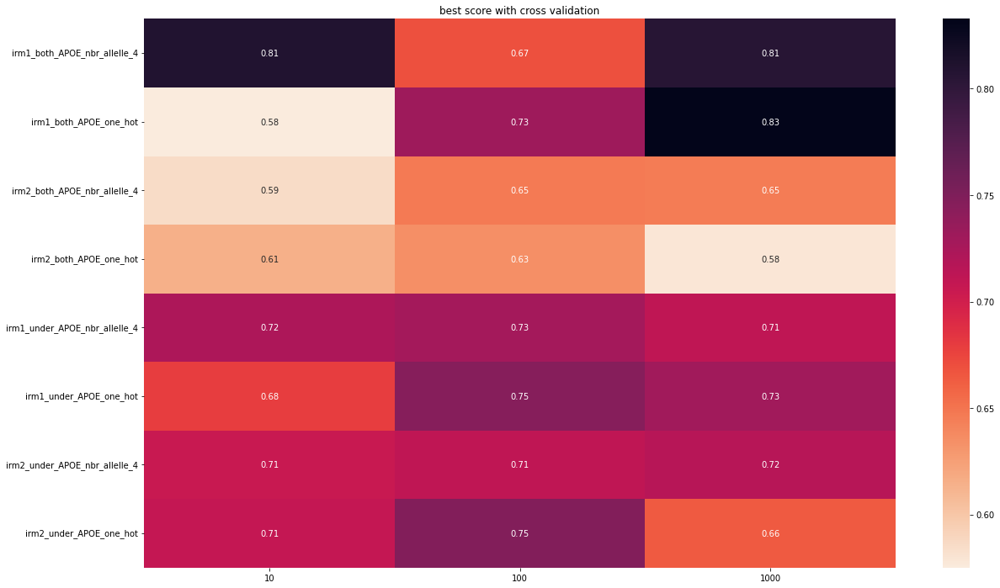

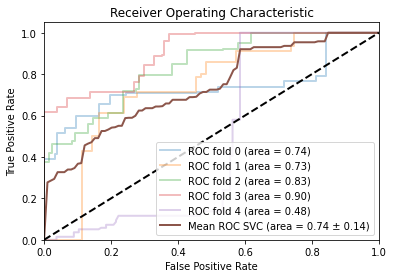

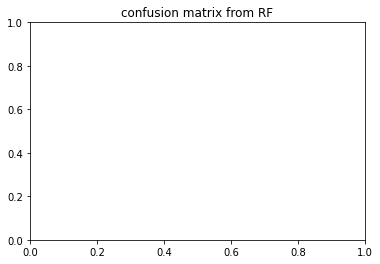

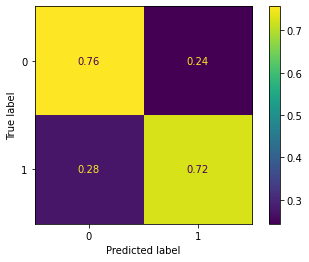

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.768 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.590 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.729 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.760 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.844 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.768 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.590 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.729 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.760 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.844 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=l

<Figure size 432x288 with 0 Axes>

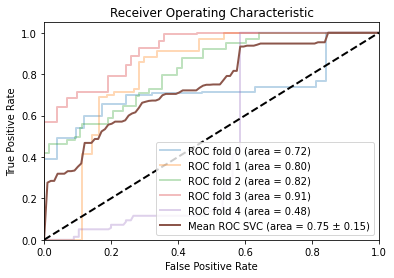

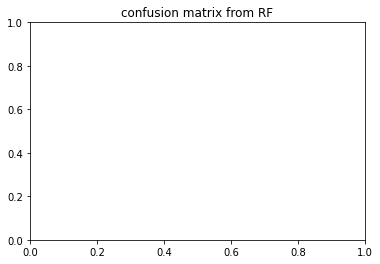

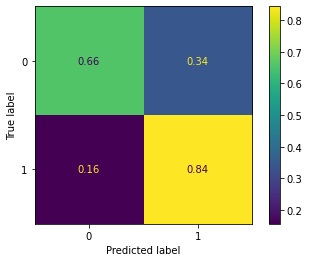

{'C': 10, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.425 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.538 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.661 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.725 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.859 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.425 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.538 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.661 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.725 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.859 total time=   0.0s
[CV 1/5] END ..............C=100, k

<Figure size 432x288 with 0 Axes>

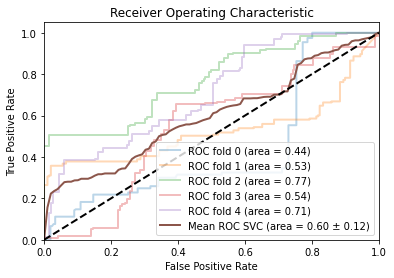

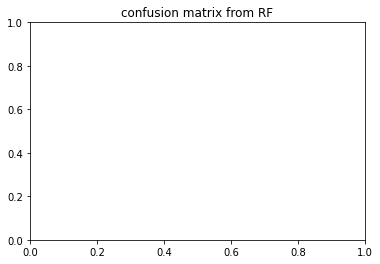

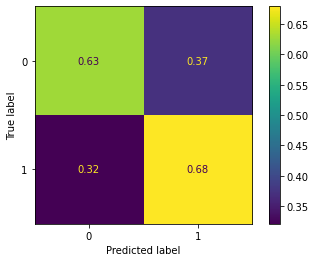

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.419 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.543 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.685 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.736 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.880 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.419 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.541 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.685 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.736 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.880 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=l

<Figure size 432x288 with 0 Axes>

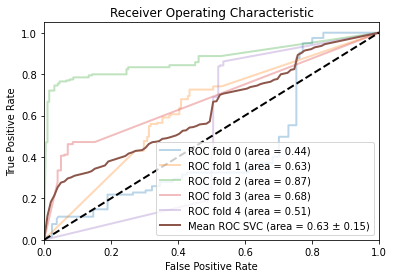

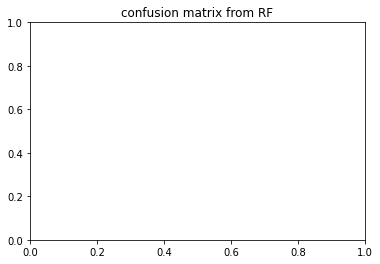

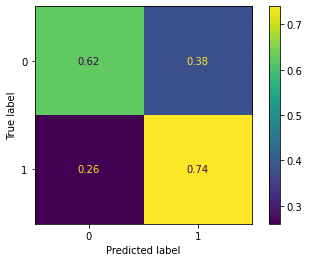

{'C': 100, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.675 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.810 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.928 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.910 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.596 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.675 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.810 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.928 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.910 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.596 total time=   0.0s
[CV 1/5] END ..............C=100,

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

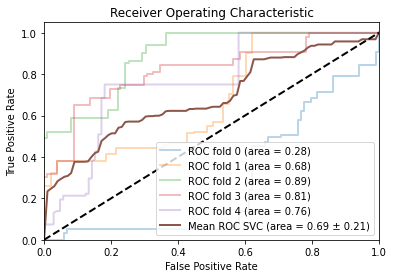

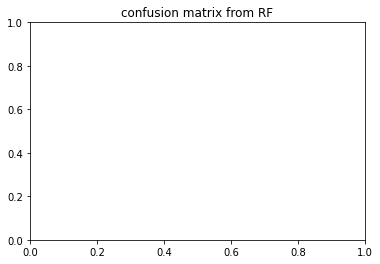

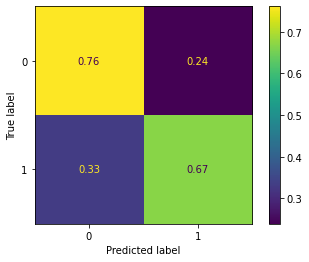

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.680 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.811 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.928 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.908 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.595 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.680 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.811 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.928 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.908 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.595 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

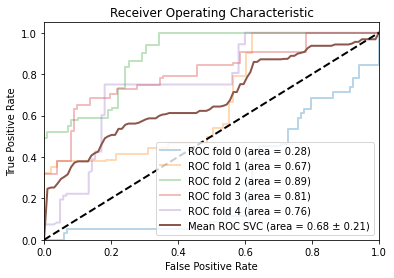

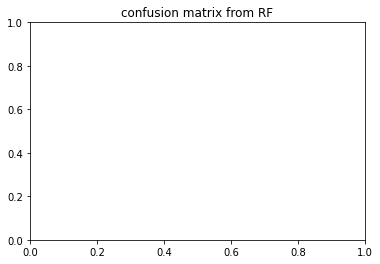

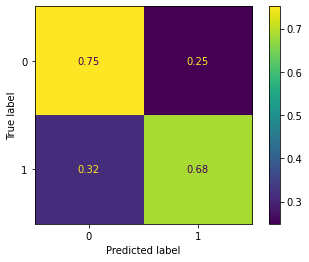

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.636 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.478 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.696 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.613 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.899 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.636 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.478 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.696 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.613 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.899 total time=   0.0s
[CV 1/5] END ..............C=100, k

<Figure size 432x288 with 0 Axes>

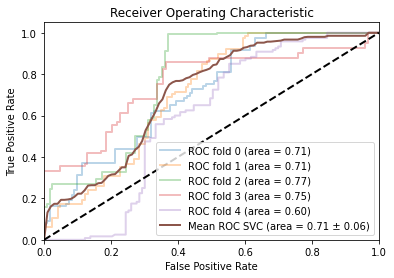

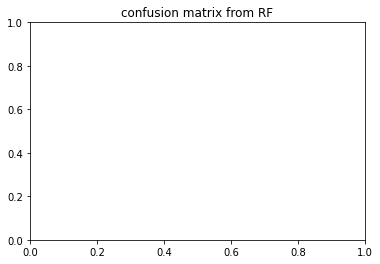

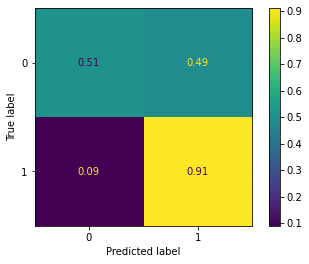

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.643 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.485 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.688 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.621 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.893 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.643 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.484 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.688 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.622 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.893 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=

<Figure size 432x288 with 0 Axes>

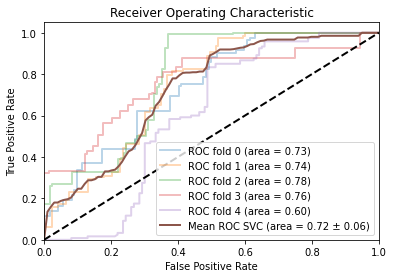

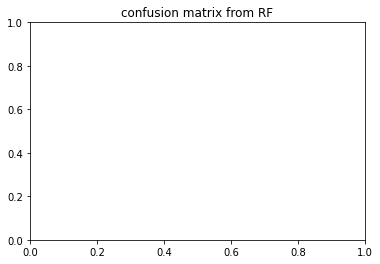

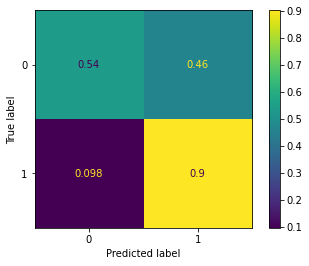

{'C': 100, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.749 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.879 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.752 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.432 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.685 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.704 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.887 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.710 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.647 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.808 total time=   0.0s
[CV 1/5] END .....C=1, gamma=0.0001, 

<Figure size 432x288 with 0 Axes>

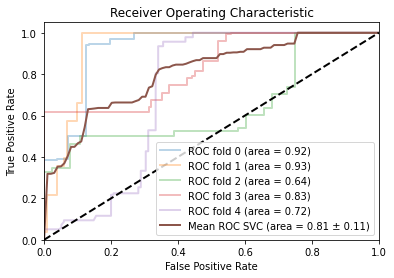

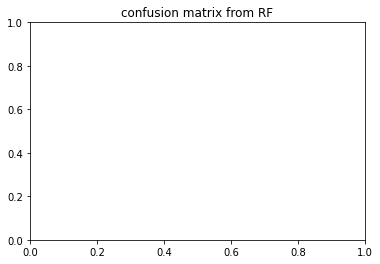

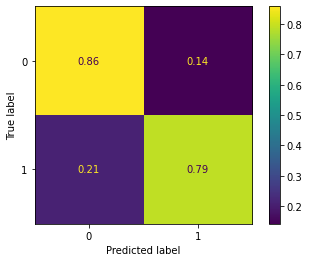

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.718 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.888 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.758 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.431 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.688 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.687 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.897 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.736 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.622 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.822 total time=   0.0s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

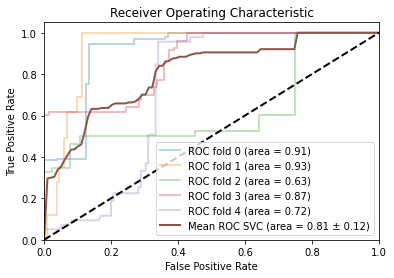

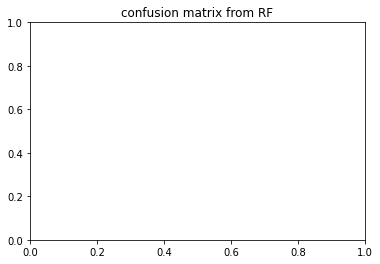

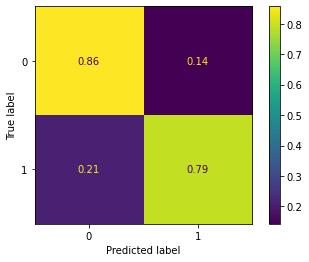

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.629 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.697 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.843 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.404 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.980 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.579 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.581 total time=   0.2s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.797 total time=   0.2s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.623 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.963 total time=   0.2s
[CV 1/5] END .....C=1, ga

<Figure size 432x288 with 0 Axes>

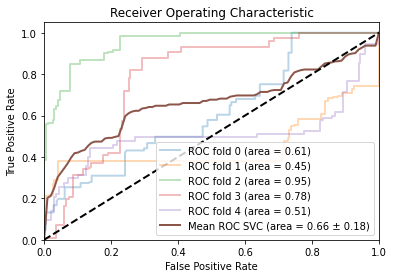

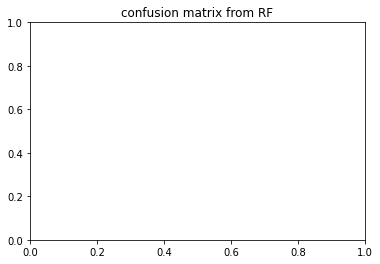

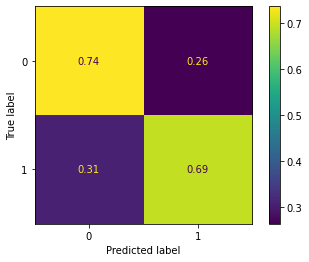

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.622 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.695 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.846 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.402 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.979 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.555 total time=   0.2s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.569 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.802 total time=   0.2s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.633 total time=   0.3s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.959 total time=   0.3s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

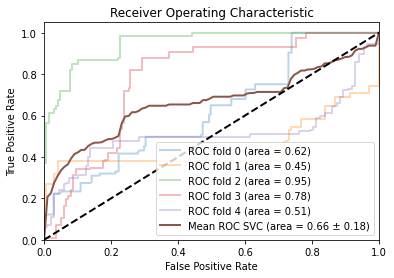

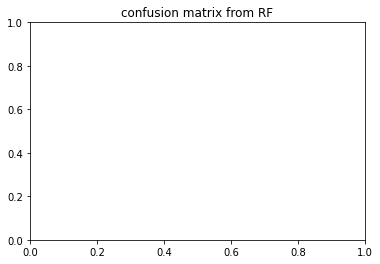

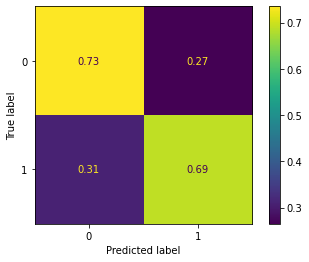

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.806 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.937 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.985 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.984 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.550 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.728 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.901 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.915 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.884 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.567 total time=   0.0s
[CV 1/5] END .....C=1, g

<Figure size 432x288 with 0 Axes>

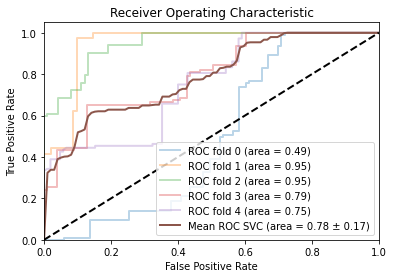

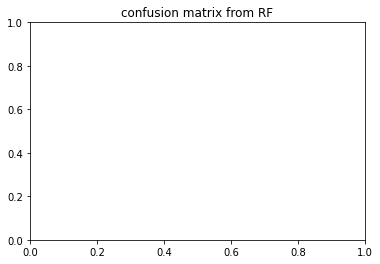

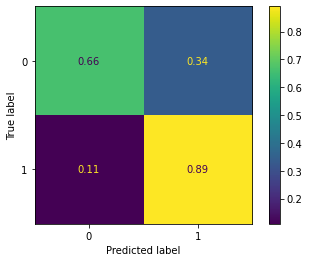

{'C': 100, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.805 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.940 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.986 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.985 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.544 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.732 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.903 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.917 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.885 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.569 total time=   0.0s
[CV 1/5] END .....C=1, gamm

<Figure size 432x288 with 0 Axes>

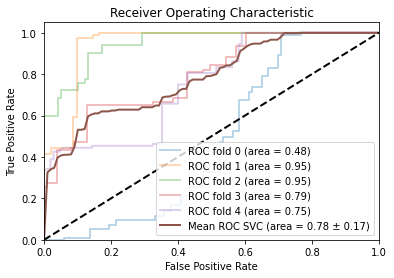

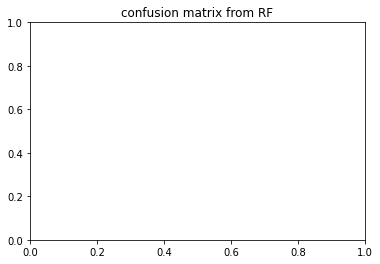

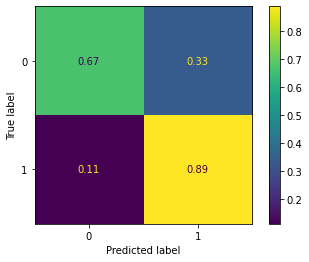

{'C': 100, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.719 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.401 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.654 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.856 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.876 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.723 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.335 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.654 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.846 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.915 total time=   0.1s
[CV 1/5] END .....C=1

<Figure size 432x288 with 0 Axes>

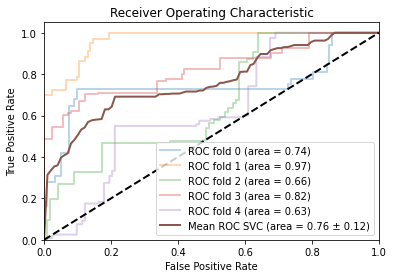

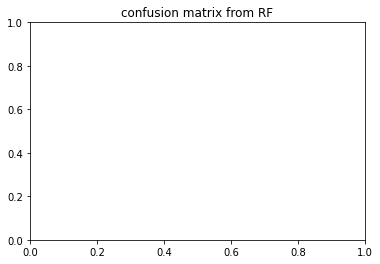

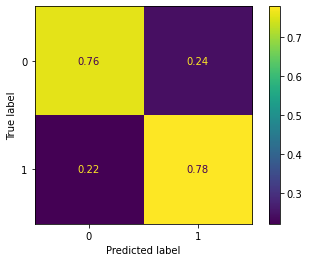

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.719 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.402 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.654 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.861 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.877 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.727 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.333 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.650 total time=   0.1s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.855 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.910 total time=   0.1s
[CV 1/5] END .....C=1, gamma=0

<Figure size 432x288 with 0 Axes>

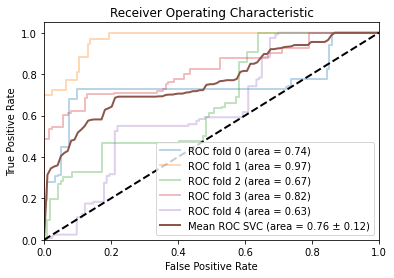

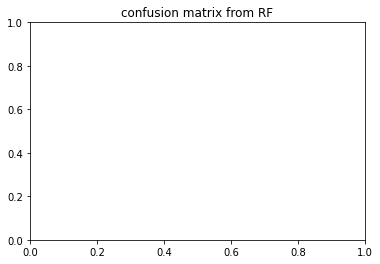

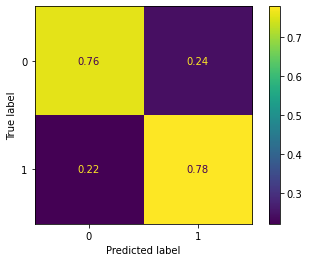

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.685 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.948 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.640 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.585 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.803 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.404 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.949 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.635 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=0.001, ker

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.030 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.734 total time=   0.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.523 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.331 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.611 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=1.000 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.557 total time=   0.0s
[CV 4/5] END C=1, coef0=0

[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.784 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.849 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.974 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.606 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.423 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.669 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.168 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.022 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.728 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.511 total time=   0.2s
[CV 5/5] END C=1, coef0=0.

[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.240 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.593 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.948 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.603 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.585 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.704 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.244 total time=   0.2s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.669 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.546 total time=   0.2s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.509 total time=   0.3s
[CV 5/5] END C=10, 

[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.704 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.038 total time=   0.2s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.720 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.539 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.331 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.604 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=1.000 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.559 total time=   0.0s
[CV 4/5] END C=

[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.447 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.853 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.792 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.610 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.749 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.627 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.795 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.742 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.864 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.585 total time=   0.0s
[CV 4/5] END C=10

[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.508 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.284 total time=   0.2s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.573 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.948 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.528 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.569 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.658 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.183 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.618 total time=   0.2s
[CV 3/5

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.393 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.673 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.689 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.713 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.699 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.048 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.281 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.551 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.332 total time=   0.2s
[CV 1

[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.829 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.919 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.699 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.400 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.814 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.815 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.721 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.750 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.558 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.858 total time=   0.0s
[CV 1/5] E

<Figure size 432x288 with 0 Axes>

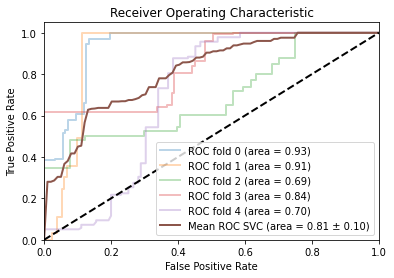

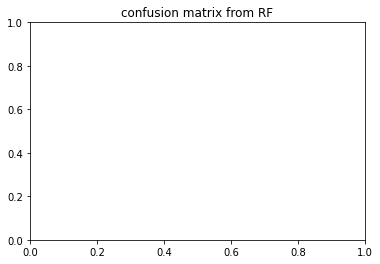

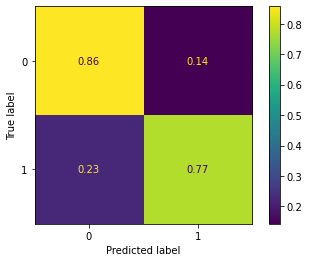

{'C': 1, 'coef0': 1.0, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.690 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.949 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.660 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.585 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.803 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.403 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.951 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.628 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, degr

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.700 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.022 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.748 total time=   0.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.519 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.330 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.602 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=1.000 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.565 total time=   0.0s
[CV 4/5] END C=1, coef0=0

[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.843 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.987 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.621 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.429 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.669 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.014 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.741 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.330 total time=   0.2s
[CV 1/5] END C=1, coef0=1

[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.948 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.616 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.590 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.713 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.235 total time=   0.3s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.663 total time=   0.3s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.555 total time=   0.4s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.708 total time=   0.2s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=10, 

[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.816 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.031 total time=   0.2s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.731 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.536 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.332 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.577 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=1.000 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.565 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.337 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.730 total time=   0.1s
[CV 1/5] END C=

[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.610 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.797 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.727 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.879 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.594 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.667 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.833 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.820 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.920 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.702 total time=   0.0s
[CV 4/5] END C=

[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.565 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.571 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.639 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.186 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.624 total time=   0.2s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.550 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.602 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.674 total time=   0.2s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.0001, kernel=poly;, score=0.816 total time=   0.2s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.0001, kernel=poly;, score=0.376 total time=   0.2s
[CV 3/5]

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.273 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.550 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.332 total time=   0.2s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.810 total time=   0.0s
[CV 2/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.899 total time=   0.0s
[CV 3/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.701 total time=   0.0s
[CV 4/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.371 total time=   0.0s
[CV 5/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.838 total time=   0.0s
[CV 1

[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.781 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.755 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.549 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.856 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.774 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.583 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.776 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.687 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.800 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=7, gamma=scale, kernel=poly;, score=0.834 total time=   0.0s
[CV 2

<Figure size 432x288 with 0 Axes>

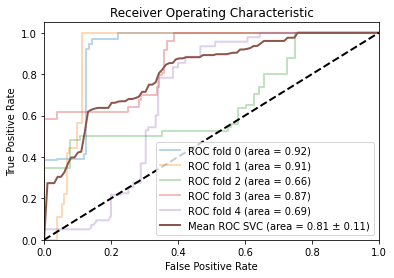

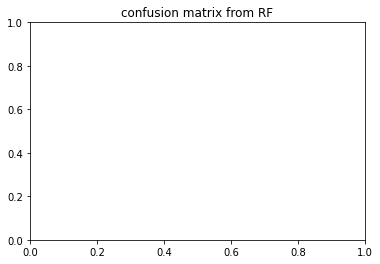

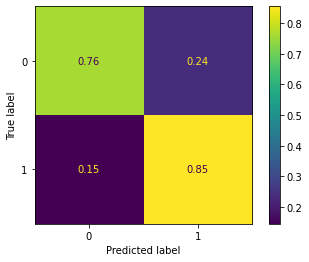

{'C': 1, 'coef0': 1.0, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.904 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.637 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.769 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.579 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.996 total time=   0.2s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.863 total time=   0.6s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.560 total time=   0.6s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.623 total time=   0.5s
[CV 4/5] END C=1, coef0=0.0

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.439 total time=   0.5s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.944 total time=   0.5s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.245 total time=   0.6s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.025 total time=   0.5s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.812 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.486 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.751 total time=   0.2s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.502 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.999 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.727 total time=   0.4s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.620 total time=   0.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.810 total time=   0.4s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.466 total time=   0.4s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.962 total time=   0.4s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.428 total time=   0.6s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.542 total time=   0.5s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.749 total time=   0.5s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.037 total time=   0.5s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.910 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.566 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.690 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.613 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.975 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.900 total time=   0.5s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.552 total time=   0.5s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.587 total time=   0.5s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.608 total time=   0.5s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.333 total time=   0.5s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.5s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.248 total time=   0.6s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.306 total time=   0.6s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.029 total time=   0.8s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.796 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.508 total time=   0.2s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.621 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.811 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.532 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.982 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.526 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.578 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.726 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.645 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.942 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.517 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.199 total time=   0.5s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.258 total time=   0.5s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.459 total time=   0.5s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.888 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.547 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.600 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.577 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.948 total time=   0.1s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.484 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.982 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.516 total time=   0.5s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.442 total time=   0.5s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.594 total time=   0.5s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.318 total time=   0.5s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.493 total time=   0.5s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.251 total time=   0.5s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.457 total time=   0.6s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.257 total time=   0.5s
[CV 4/5

[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.679 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.702 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.881 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.743 total time=   0.1s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.644 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.867 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.503 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.990 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.589 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.596 total time=   0.0s
[CV 3/5

<Figure size 432x288 with 0 Axes>

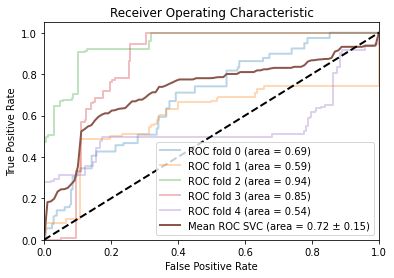

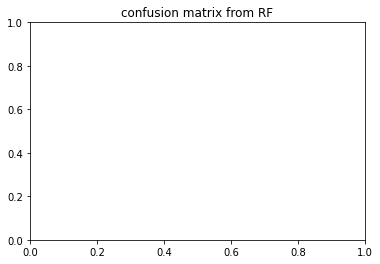

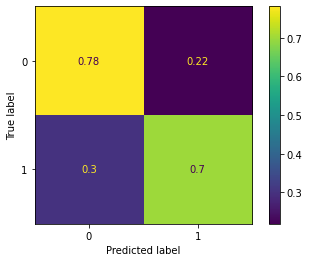

{'C': 100, 'coef0': 0.0, 'degree': 3, 'gamma': 0.001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.909 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.629 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.770 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.572 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.995 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.853 total time=   0.5s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.561 total time=   0.5s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.623 total time=   0.5s
[CV 4/5] END C=1, coef0=0.0, deg

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.438 total time=   0.5s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.939 total time=   0.6s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.249 total time=   0.6s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.8s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.255 total time=   0.6s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.268 total time=   0.5s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.827 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.482 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.744 total time=   0.2s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.501 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.999 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.735 total time=   0.5s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.605 total time=   0.5s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.807 total time=   0.5s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.467 total time=   0.4s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.957 total time=   0.4s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.247 total time=   0.5s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.535 total time=   0.6s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.253 total time=   0.5s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.122 total time=   0.5s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.963 total time=   0.5s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.915 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.552 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.696 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.566 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.978 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.897 total time=   0.5s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.556 total time=   0.5s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.581 total time=   0.5s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.608 total time=   0.5s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.337 total time=   0.7s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.947 total time=   0.6s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.250 total time=   0.5s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.256 total time=   0.6s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.6s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.965 total time=   0.6s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.816 total time=   0.2s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.494 total time=   0.3s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.615 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.813 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.536 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.984 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.507 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.567 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.748 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.659 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.958 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.487 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.225 total time=   0.5s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.530 total time=   0.5s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.172 total time=   0.5s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.460 total time=   0.6s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.888 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.524 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.617 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.529 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.953 total time=   0.1s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.474 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.985 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.461 total time=   0.5s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.580 total time=   0.5s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.593 total time=   0.5s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.322 total time=   0.5s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.871 total time=   0.5s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.253 total time=   0.5s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.463 total time=   0.5s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 4/5

[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.722 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.900 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.749 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.637 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.865 total time=   0.1s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.502 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.991 total time=   0.1s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.580 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.581 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.768 total time=   0.0s
[CV 4/5]

<Figure size 432x288 with 0 Axes>

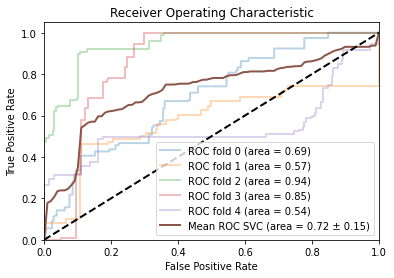

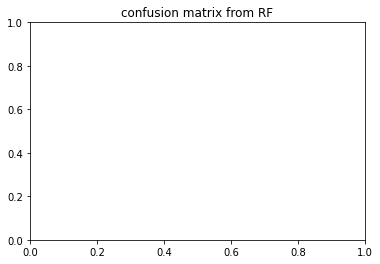

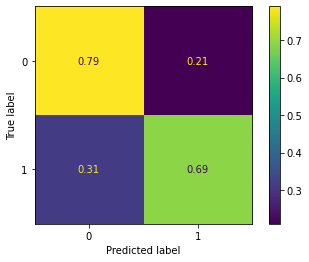

{'C': 100, 'coef0': 0.0, 'degree': 3, 'gamma': 0.001, 'kernel': 'poly', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.886 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.981 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.855 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.972 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.506 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.910 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.779 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.864 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.293 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.005 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.975 total time=   0.1s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.130 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.601 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.908 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.836 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.824 total time=   0.0s
[CV 4/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.988 total time=   0.0s
[CV 5/5] END C=1, coef0=0

[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.325 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.874 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=1.000 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.986 total time=   0.0s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.863 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.407 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.849 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.005 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.972 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.114 total time=   0.1s
[CV 5/5] END C=1, coef0=0.

[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.898 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.887 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.832 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.963 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.527 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.801 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.831 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.692 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.371 total time=   0.1s
[CV 1/5] END C=10, c

[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.297 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.866 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.004 total time=   0.1s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.017 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.138 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.608 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.879 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.824 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.807 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.979 total time=   0.0s
[CV 5/5] END C=

[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.512 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.720 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.908 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.977 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.972 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.537 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.693 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.841 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.906 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.874 total time=   0.0s
[CV 5/5] END C=1

[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.358 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.683 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.884 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.871 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.770 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.961 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.548 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.756 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.389 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.818 total time=   0.1s
[CV 4/5]

[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.845 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.531 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.299 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.111 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.003 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.982 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.148 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.618 total time=   0.1s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.867 total time=   0.0s
[CV 2/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.958 total time=   0.0s
[CV 3

[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.992 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.459 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.744 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.904 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.960 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.937 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.516 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.701 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.848 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.978 total time=   0.0s
[CV 4/5

<Figure size 432x288 with 0 Axes>

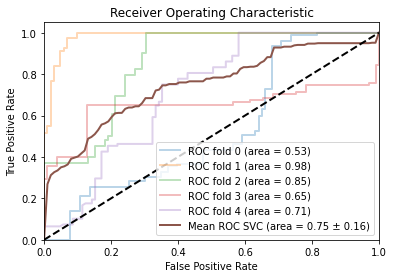

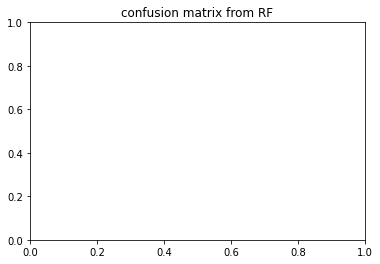

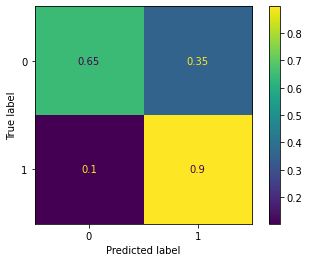

{'C': 100, 'coef0': 0.5, 'degree': 7, 'gamma': 0.001, 'kernel': 'poly', 'probability': True}
irm1_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.885 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.987 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.857 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.972 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.516 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.863 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.771 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.814 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, de

[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.294 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.860 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.005 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.974 total time=   0.1s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.130 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.601 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.908 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.824 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.840 total time=   0.0s
[CV 4/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.988 total time=   0.0s
[CV 5/5] END C=1, coef0=0

[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.874 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=1.000 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.989 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.874 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.411 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.293 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.005 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.971 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.116 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.631 total time=   0.1s
[CV 1/5] END C=1, coef0=1

[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.887 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.851 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.968 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.534 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.794 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.689 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.367 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=10, 

[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.000 total time=   0.1s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.986 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.138 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.606 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.878 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.822 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.816 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.977 total time=   0.0s
[CV 5/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.305 total time=   0.0s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.768 total time=   0.1s
[CV 2/5] END C=1

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.904 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.979 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.972 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.536 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.697 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.858 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.907 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.877 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.626 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.871 total time=   0.0s
[CV 2/5] END C=

[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.887 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.871 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.783 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.952 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.558 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.748 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.809 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.716 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.383 total time=   0.1s
[CV 1/5] E

[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.301 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.885 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.000 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.986 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.147 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.616 total time=   0.1s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.865 total time=   0.0s
[CV 2/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.957 total time=   0.0s
[CV 3/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.988 total time=   0.0s
[CV 4/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.988 total time=   0.0s
[CV 5

[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.904 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.960 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.936 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.517 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.702 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.849 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.979 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.940 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.598 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=7, gamma=scale, kernel=poly;, score=0.877 total time=   0.0s
[CV 2

<Figure size 432x288 with 0 Axes>

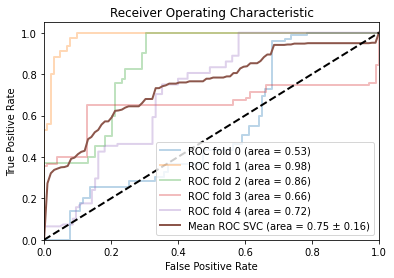

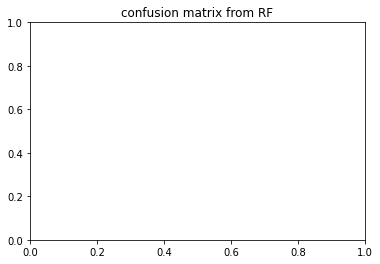

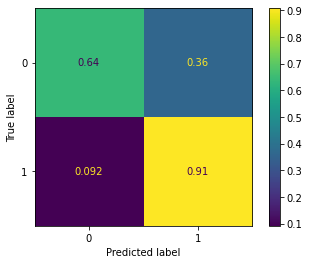

{'C': 100, 'coef0': 0.5, 'degree': 7, 'gamma': 0.001, 'kernel': 'poly', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.883 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.375 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.692 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.850 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.942 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.921 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.310 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.515 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.062 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.099 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.568 total time=   0.2s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.463 total time=   0.1s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.227 total time=   0.2s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.766 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.544 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.559 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.845 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.946 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.857 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.325 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.630 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.823 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.938 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.098 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.572 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.253 total time=   0.2s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.055 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.897 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.432 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.752 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.779 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.950 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.915 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.297 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.537 total time=   0.2s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.573 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.716 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.100 total time=   0.3s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.568 total time=   0.2s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.461 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.231 total time=   0.2s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.066 total time=   0.2s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.749 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.569 total time=   0.1s
[CV 3/5] END C=

[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.855 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.904 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.708 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.453 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.561 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.828 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.901 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.742 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.356 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.618 total time=   0.0s
[CV 4/5] END C=10

[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.508 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.286 total time=   0.2s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.159 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.867 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.435 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.759 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.812 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.916 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.912 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.290 total time=   0.1s
[CV 3/5

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.805 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.354 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.583 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.634 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.600 total time=   0.2s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.102 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.568 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.457 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.233 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1

[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.791 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.892 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.786 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.410 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.667 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.875 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.912 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.708 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.452 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.663 total time=   0.0s
[CV 4/5]

<Figure size 432x288 with 0 Axes>

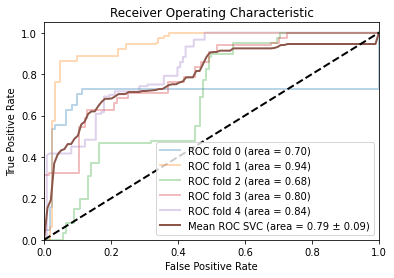

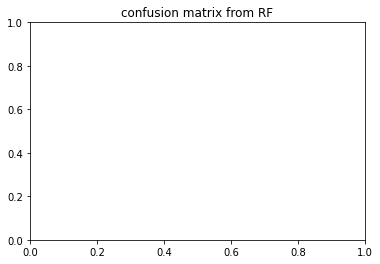

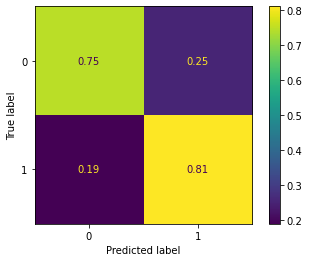

{'C': 100, 'coef0': 0.0, 'degree': 5, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm2_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.879 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.380 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.681 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.848 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.938 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.922 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.312 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.519 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, 

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.741 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.097 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.571 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.460 total time=   0.1s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.218 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.071 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.770 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.551 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.575 total time=   0.0s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.853 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.946 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.860 total time=   0.3s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.325 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.629 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.828 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.933 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.097 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.574 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.467 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.246 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.895 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.442 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.752 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.772 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.949 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.913 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.297 total time=   0.2s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.544 total time=   0.2s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.574 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.728 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.282 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.099 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.568 total time=   0.1s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.460 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.224 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.070 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.748 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.579 total time=   0.1s
[CV 3/5] END C=

[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.656 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.856 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.904 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.716 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.457 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.558 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.842 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.899 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.751 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.356 total time=   0.0s
[CV 3/5] END C=10,

[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.623 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.502 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.277 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.157 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.871 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.443 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.766 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.804 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.920 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.907 total time=   0.1s
[CV 2/

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.807 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.361 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.586 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.640 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.458 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.101 total time=   0.2s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.568 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.452 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.228 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.070 total time=   0.1s
[CV 1

[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.806 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.885 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.781 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.408 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.666 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.876 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.912 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.711 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.451 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.653 total time=   0.0s
[CV 4/5]

<Figure size 432x288 with 0 Axes>

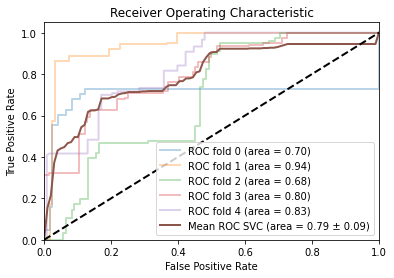

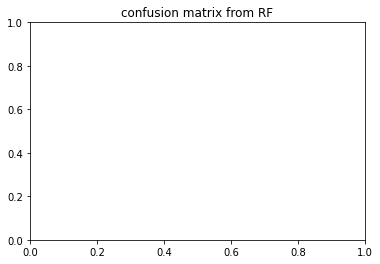

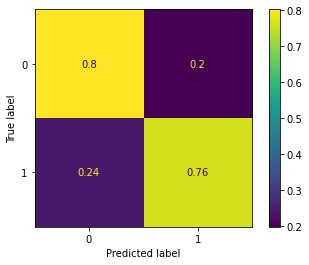

{'C': 100, 'coef0': 0.0, 'degree': 5, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.397 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.777 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.292 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.628 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.495 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.694 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.870 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.571 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.671 total t

[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.652 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.629 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.865 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.641 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.814 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.732 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.390 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.679 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.748 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.685 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.874 total time=   0.

<Figure size 432x288 with 0 Axes>

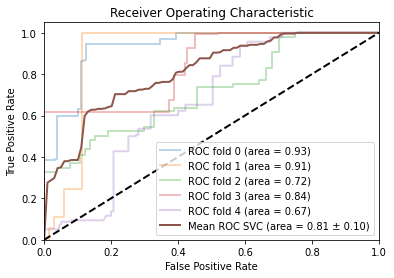

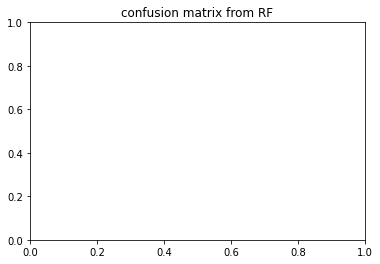

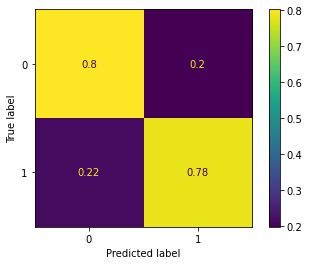

{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm1_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.415 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.904 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.412 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.604 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.435 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.677 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.890 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.587 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.652 total time=   0.0s
[CV 5/5]

[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.664 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.639 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.859 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.737 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.798 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.841 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.422 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.679 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.743 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.670 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.915 total time=   0.

c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

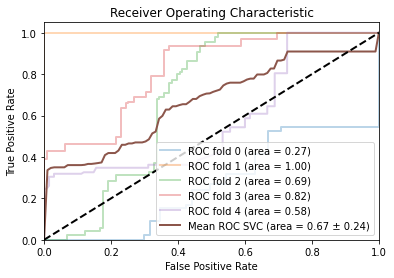

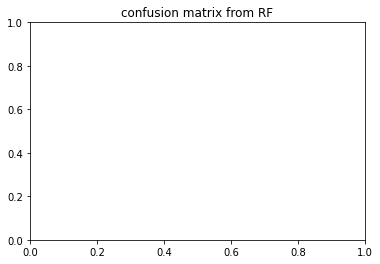

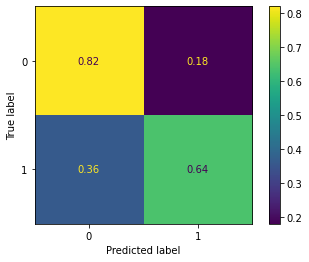

{'C': 10, 'coef0': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.480 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.771 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.626 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.840 total time=   0.2s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.905 total time=   0.2s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.591 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.509 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.715 total time=   0.3s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.761 total time=   0.2s

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.938 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.740 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.585 total time=   0.2s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.871 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=1.000 total time=   0.2s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.680 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.470 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.744 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.431 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.984 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.778 total time=   0.1

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.869 total time=   0.1s
{'C': 1, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

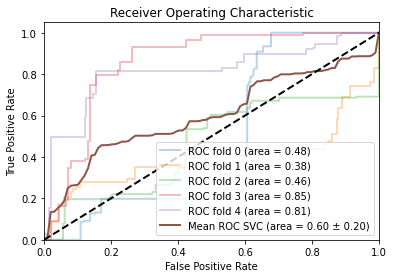

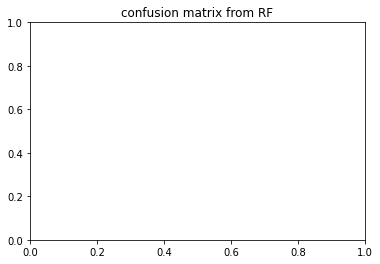

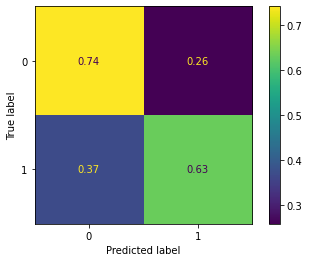

{'C': 1, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.483 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.765 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.635 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.842 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.899 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.565 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.499 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.728 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.763 total time=   0.2s
[CV 5/

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.937 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.756 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.591 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.870 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=1.000 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.659 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.477 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.745 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.519 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.984 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.754 total time=   0.1

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.882 total time=   0.1s
{'C': 1, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

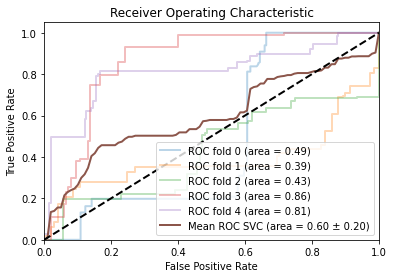

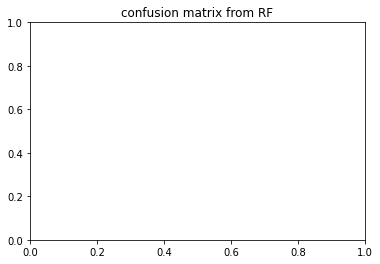

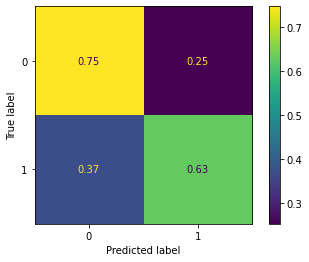

{'C': 1, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.500 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.824 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.711 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.738 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.605 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.778 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.883 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.908 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.900 total time=   0.0s

[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.703 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.835 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.741 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.959 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.796 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.605 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.743 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.912 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.844 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.755 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.796 total time=   0.0

{'C': 1, 'coef0': 0.5, 'gamma': 0.0001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

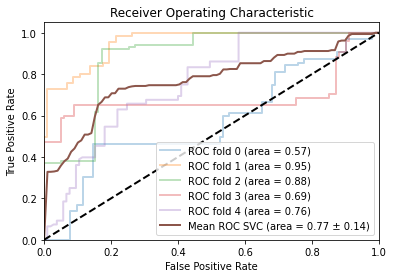

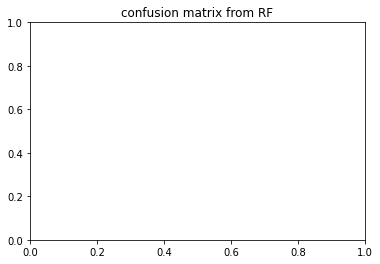

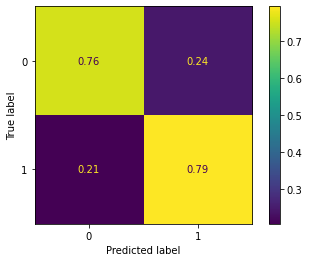

{'C': 1, 'coef0': 0.5, 'gamma': 0.0001, 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.499 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.837 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.717 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.755 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.602 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.785 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.894 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.904 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.900 total time=   0.0s
[CV 5/

[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.697 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.839 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.755 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.968 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.804 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.643 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.742 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.918 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.858 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.767 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.0001, kernel=sigmoid;, score=0.798 total time=   0.0

{'C': 100, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

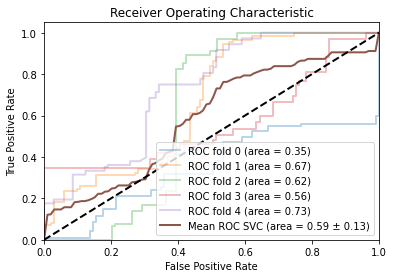

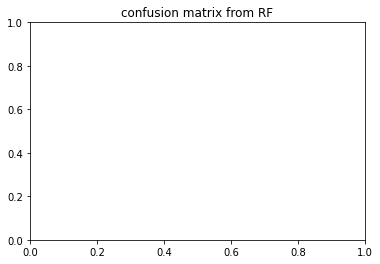

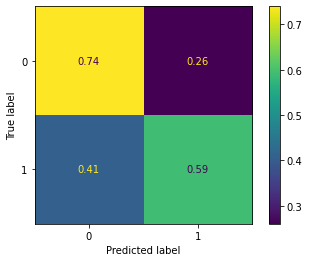

{'C': 100, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.936 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.351 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.699 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.903 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.892 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.761 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.286 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.687 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.821 total time=   0.

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.907 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.932 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.611 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.759 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.951 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.763 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.792 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.321 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.633 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.755 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.855 total time=   0.0

{'C': 10, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

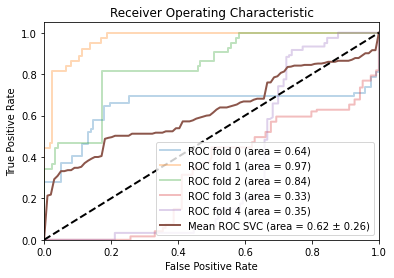

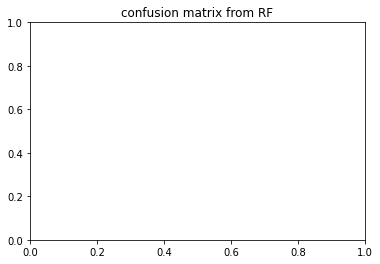

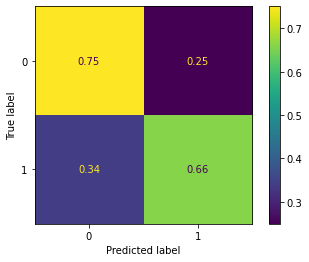

{'C': 10, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.933 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.438 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.704 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.904 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.888 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.759 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.284 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.675 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.827 total time=   0.1s
[CV 

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.890 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.933 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.616 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.637 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.946 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.749 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.789 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.328 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.646 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.763 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.839 total time=   0.0

{'C': 100, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

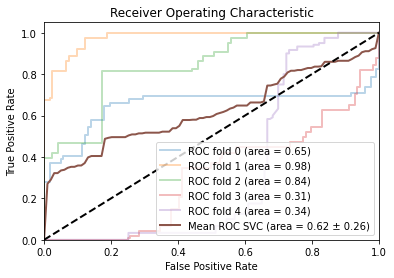

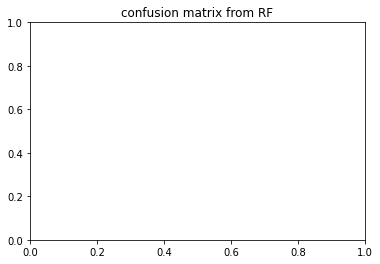

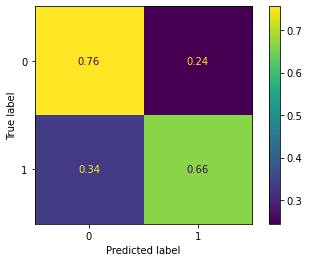

{'C': 100, 'coef0': 0.5, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.705569,0.785866,0.782149,0.772995
irm1_both_APOE_one_hot,0.738278,0.785794,0.788317,0.826599
irm2_both_APOE_nbr_allelle_4,0.641245,0.749534,0.778198,0.845188
irm2_both_APOE_one_hot,0.652831,0.742496,0.776182,0.847922
irm1_under_APOE_nbr_allelle_4,0.783947,0.864010,0.862036,0.829068
irm1_under_APOE_one_hot,0.784511,0.863792,0.860092,0.845325
irm2_under_APOE_nbr_allelle_4,0.664348,0.715143,0.764388,0.803326
irm2_under_APOE_one_hot,0.666154,0.713179,0.765137,0.797882


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.736947,0.923016,0.934464,0.932283
irm1_both_APOE_one_hot,0.723804,0.910902,0.919867,0.266717
irm2_both_APOE_nbr_allelle_4,0.441733,0.614586,0.688852,0.484748
irm2_both_APOE_one_hot,0.441612,0.623006,0.691017,0.486167
irm1_under_APOE_nbr_allelle_4,0.283700,0.491978,0.532039,0.571385
irm1_under_APOE_one_hot,0.276648,0.475217,0.533776,0.350434
irm2_under_APOE_nbr_allelle_4,0.710744,0.743124,0.700989,0.644493
irm2_under_APOE_one_hot,0.733302,0.742989,0.702344,0.648896


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.737102,0.809520,0.813725,0.812197
irm1_both_APOE_one_hot,0.748480,0.810888,0.811503,0.670776
irm2_both_APOE_nbr_allelle_4,0.597015,0.660752,0.722658,0.599316
irm2_both_APOE_one_hot,0.625893,0.661161,0.720157,0.594276
irm1_under_APOE_nbr_allelle_4,0.685563,0.785223,0.745927,0.770506
irm1_under_APOE_one_hot,0.680501,0.783190,0.749656,0.584429
irm2_under_APOE_nbr_allelle_4,0.707878,0.764079,0.791842,0.625527
irm2_under_APOE_one_hot,0.722046,0.764807,0.792710,0.623122


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.737102,0.809520,0.813725,0.812197
irm1_both_APOE_one_hot,0.748480,0.810888,0.811503,0.670776
irm2_both_APOE_nbr_allelle_4,0.597015,0.660752,0.722658,0.599316
irm2_both_APOE_one_hot,0.625893,0.661161,0.720157,0.594276
irm1_under_APOE_nbr_allelle_4,0.685563,0.785223,0.745927,0.770506
irm1_under_APOE_one_hot,0.680501,0.783190,0.749656,0.584429
irm2_under_APOE_nbr_allelle_4,0.707878,0.764079,0.791842,0.625527
irm2_under_APOE_one_hot,0.722046,0.764807,0.792710,0.623122


the score on cross_val: 


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.737102,0.809520,0.813725,0.812197
irm1_both_APOE_one_hot,0.748480,0.810888,0.811503,0.670776
irm2_both_APOE_nbr_allelle_4,0.597015,0.660752,0.722658,0.599316
irm2_both_APOE_one_hot,0.625893,0.661161,0.720157,0.594276
irm1_under_APOE_nbr_allelle_4,0.685563,0.785223,0.745927,0.770506
irm1_under_APOE_one_hot,0.680501,0.783190,0.749656,0.584429
irm2_under_APOE_nbr_allelle_4,0.707878,0.764079,0.791842,0.625527
irm2_under_APOE_one_hot,0.722046,0.764807,0.792710,0.623122


here: 150
irm1_both
0    658
1    658
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_both_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST12SV,irmL_ST21SV,irmL_ST23SA,...,neuro_moca_IMMT1W3,neuro_moca_IMMT1W4,neuro_moca_IMMT2W4,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSMEAS,age,APOE_nbr_allelle_4
0,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,0.081552,1.337222,1.421396,...,1.0,1.0,1.0,-0.437069,1.0,1.0,1.750166,1.0,1.308682,0.0
1,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,1.214602,-0.288893,-0.508962,...,1.0,1.0,1.0,-0.437069,1.0,1.0,-0.358815,1.0,0.129191,1.0
2,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,-0.564393,1.009590,-0.885758,...,1.0,1.0,1.0,-0.437069,1.0,0.0,1.117472,1.0,-0.376305,0.0
3,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,1.648762,-1.568103,0.592443,...,1.0,1.0,0.0,-0.437069,1.0,1.0,-0.358815,1.0,0.634687,0.0
4,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,-1.146802,-0.433437,1.085177,...,1.0,1.0,1.0,-0.437069,1.0,1.0,-1.413306,1.0,2.319674,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,-0.797357,-0.361165,0.343178,...,1.0,1.0,1.0,0.900565,1.0,1.0,-1.413306,1.0,1.140183,0.0
1312,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,-0.304956,0.732548,1.114162,...,1.0,1.0,0.0,-0.437069,0.0,1.0,1.750166,1.0,0.971684,0.0
1313,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,0.118614,-0.493663,-0.108978,...,1.0,1.0,1.0,-0.437069,1.0,1.0,-0.147917,1.0,-1.555796,1.0
1314,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,0.187444,-0.120259,-0.294477,...,1.0,1.0,1.0,-0.437069,1.0,0.0,-2.046001,0.0,0.129191,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_both_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST12SV,irmL_ST21SV,irmL_ST23SA,...,neuro_moca_IMMT1W4,neuro_moca_IMMT2W4,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSMEAS,age,APOE_33,APOE_34
0,-0.274043,-0.054886,0.051821,-0.069542,-0.176448,-0.505092,0.758251,0.081552,1.337222,1.421396,...,1.0,1.0,-0.437069,1.0,1.0,1.750166,1.0,1.308682,1.0,0.0
1,2.070880,1.342244,1.357568,0.287173,0.842443,-1.409799,-0.020162,1.214602,-0.288893,-0.508962,...,1.0,1.0,-0.437069,1.0,1.0,-0.358815,1.0,0.129191,0.0,1.0
2,-0.097024,0.373267,-0.014293,0.260749,-0.660421,0.386691,-0.262711,-0.564393,1.009590,-0.885758,...,1.0,1.0,-0.437069,1.0,0.0,1.117472,1.0,-0.376305,1.0,0.0
3,0.732415,-0.250184,-0.444032,-0.188447,0.307526,-0.472781,-0.990359,1.648762,-1.568103,0.592443,...,1.0,0.0,-0.437069,1.0,1.0,-0.358815,1.0,0.634687,1.0,0.0
4,-1.293642,-1.812566,-1.419211,-0.518738,-1.131658,-0.375848,5.332839,-1.146802,-0.433437,1.085177,...,1.0,1.0,-0.437069,1.0,1.0,-1.413306,1.0,2.319674,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,-1.023862,-0.220138,-0.212634,-0.756548,-1.067978,0.173438,-0.327579,-0.797357,-0.361165,0.343178,...,1.0,1.0,0.900565,1.0,1.0,-1.413306,1.0,1.140183,1.0,0.0
1312,0.057964,0.538519,0.597260,0.524982,-0.482115,1.207389,0.868244,-0.304956,0.732548,1.114162,...,1.0,0.0,-0.437069,0.0,1.0,1.750166,1.0,0.971684,1.0,0.0
1313,-0.835248,0.343221,-0.179577,-0.095965,-0.087295,-0.834664,-0.691403,0.118614,-0.493663,-0.108978,...,1.0,1.0,-0.437069,1.0,1.0,-0.147917,1.0,-1.555796,0.0,1.0
1314,0.194400,-1.106490,-0.956414,-1.839903,-0.775046,-0.899286,-0.406549,0.187444,-0.120259,-0.294477,...,1.0,1.0,-0.437069,1.0,0.0,-2.046001,0.0,0.129191,0.0,1.0


irm2_both
0    1000
1    1000
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_both_APOE_nbr_allelle_4


,irmC_ST102SA,irmC_ST104TA,irmC_ST105CV,irmC_ST105SA,irmC_ST109CV,irmC_ST109SA,irmC_ST53SV_ST112SV,irmC_ST114SA,irmC_ST115CV,irmC_ST115SA,...,neuro_comp_ADNI_EF2,neuro_moca_RHINO,neuro_moca_IMMT1W3,neuro_moca_IMMT1W4,neuro_moca_IMMT2W1,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSMEAS,age,APOE_nbr_allelle_4
0,-1.278593,-1.544192,1.799995,2.383053,0.361498,0.627122,0.403725,-0.364817,-1.181283,-0.781613,...,2.291324,1.0,1.0,1.0,1.0,1.0,1.403416,1.0,-0.214656,0.0
1,-0.494554,1.313484,0.654591,-0.270465,0.363822,-0.047171,1.085128,0.116860,1.477529,0.599688,...,1.154248,1.0,1.0,1.0,1.0,1.0,1.206528,1.0,-0.687641,1.0
2,1.052334,0.198744,-0.359226,-0.764643,-0.970093,0.189423,-0.648294,-0.635573,-0.443355,-0.636767,...,0.678467,1.0,1.0,1.0,1.0,1.0,1.009640,1.0,-0.214656,0.0
3,0.003417,-0.281641,0.277774,-0.367152,-0.379824,-0.195042,0.099587,-0.035721,0.713809,1.082945,...,1.271615,1.0,1.0,1.0,1.0,1.0,2.190967,1.0,-1.318288,0.0
4,0.368949,1.615264,0.848981,0.900520,0.719378,1.076650,-1.048826,0.068991,0.452387,-0.069236,...,1.790304,1.0,1.0,1.0,1.0,1.0,1.403416,1.0,-1.160626,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.542232,-1.371746,-0.586513,-0.710928,-0.902700,-0.532188,-0.573506,-0.240658,-0.524667,-0.335225,...,-1.315518,0.0,1.0,1.0,1.0,1.0,0.222089,1.0,1.046637,0.0
1996,0.623232,-0.503357,-0.619409,-0.743157,-1.197835,-1.531798,0.696230,1.038328,0.555120,0.300779,...,-0.279403,1.0,1.0,1.0,1.0,1.0,1.206528,1.0,-0.372318,1.0
1997,0.241807,0.365031,-0.404085,-0.496068,-1.957748,-1.703328,-0.889278,-0.491968,-0.024993,-0.345759,...,-0.488897,1.0,1.0,1.0,1.0,1.0,-1.156125,1.0,0.573652,1.0
1998,-1.426925,-1.396381,-1.277344,-1.602596,-1.158329,-1.029036,2.592525,-1.880154,-1.937134,-2.004900,...,-1.117382,1.0,1.0,1.0,1.0,1.0,-1.549900,1.0,1.046637,0.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_both_APOE_one_hot


,irmC_ST102SA,irmC_ST104TA,irmC_ST105CV,irmC_ST105SA,irmC_ST109CV,irmC_ST109SA,irmC_ST53SV_ST112SV,irmC_ST114SA,irmC_ST115CV,irmC_ST115SA,...,neuro_moca_RHINO,neuro_moca_IMMT1W3,neuro_moca_IMMT1W4,neuro_moca_IMMT2W1,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSMEAS,age,APOE_33,APOE_34
0,-1.278593,-1.544192,1.799995,2.383053,0.361498,0.627122,0.403725,-0.364817,-1.181283,-0.781613,...,1.0,1.0,1.0,1.0,1.0,1.403416,1.0,-0.214656,1.0,0.0
1,-0.494554,1.313484,0.654591,-0.270465,0.363822,-0.047171,1.085128,0.116860,1.477529,0.599688,...,1.0,1.0,1.0,1.0,1.0,1.206528,1.0,-0.687641,0.0,1.0
2,1.052334,0.198744,-0.359226,-0.764643,-0.970093,0.189423,-0.648294,-0.635573,-0.443355,-0.636767,...,1.0,1.0,1.0,1.0,1.0,1.009640,1.0,-0.214656,1.0,0.0
3,0.003417,-0.281641,0.277774,-0.367152,-0.379824,-0.195042,0.099587,-0.035721,0.713809,1.082945,...,1.0,1.0,1.0,1.0,1.0,2.190967,1.0,-1.318288,0.0,0.0
4,0.368949,1.615264,0.848981,0.900520,0.719378,1.076650,-1.048826,0.068991,0.452387,-0.069236,...,1.0,1.0,1.0,1.0,1.0,1.403416,1.0,-1.160626,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.542232,-1.371746,-0.586513,-0.710928,-0.902700,-0.532188,-0.573506,-0.240658,-0.524667,-0.335225,...,0.0,1.0,1.0,1.0,1.0,0.222089,1.0,1.046637,1.0,0.0
1996,0.623232,-0.503357,-0.619409,-0.743157,-1.197835,-1.531798,0.696230,1.038328,0.555120,0.300779,...,1.0,1.0,1.0,1.0,1.0,1.206528,1.0,-0.372318,0.0,1.0
1997,0.241807,0.365031,-0.404085,-0.496068,-1.957748,-1.703328,-0.889278,-0.491968,-0.024993,-0.345759,...,1.0,1.0,1.0,1.0,1.0,-1.156125,1.0,0.573652,0.0,1.0
1998,-1.426925,-1.396381,-1.277344,-1.602596,-1.158329,-1.029036,2.592525,-1.880154,-1.937134,-2.004900,...,1.0,1.0,1.0,1.0,1.0,-1.549900,1.0,1.046637,1.0,0.0


irm1_under
0    511
1    511
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm1_under_APOE_nbr_allelle_4


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST12SV,irmL_ST21SV,irmL_ST23SA,...,neuro_moca_IMMT1W3,neuro_moca_IMMT1W4,neuro_moca_IMMT2W4,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSMEAS,age,APOE_nbr_allelle_4
0,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,0.061876,1.338452,1.406901,...,1.0,1.0,1.0,-0.439635,1.0,1.0,1.769759,1.0,1.290915,0.0
1,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,1.201759,-0.301614,-0.524154,...,1.0,1.0,1.0,-0.439635,1.0,1.0,-0.344436,1.0,0.110546,1.0
2,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,-0.587965,1.008009,-0.901086,...,1.0,1.0,1.0,-0.439635,1.0,0.0,1.135501,1.0,-0.395326,0.0
3,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,1.638537,-1.591799,0.577649,...,1.0,1.0,0.0,-0.439635,1.0,1.0,-0.344436,1.0,0.616419,0.0
4,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,-1.173886,-0.447398,1.070561,...,1.0,1.0,1.0,-0.439635,1.0,1.0,-1.401533,1.0,2.302660,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,-1.514786,-1.049970,0.409479,...,1.0,1.0,1.0,-0.439635,1.0,1.0,0.289823,1.0,-1.238447,1.0
1018,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.924931,-0.031915,0.165923,...,1.0,1.0,1.0,-0.439635,1.0,1.0,0.289823,1.0,-1.069823,1.0
1019,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.924931,-0.031915,0.165923,...,1.0,1.0,1.0,-0.439635,1.0,1.0,-0.344436,1.0,-1.069823,1.0
1020,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,-1.669256,-0.867741,0.258706,...,1.0,1.0,1.0,0.897589,1.0,1.0,0.924081,1.0,-0.901199,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_33', 'APOE_34', 'APOE_44']
irm1_under_APOE_one_hot


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: UserWarning: Features [369] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


,irmL_ST1SV,irmL_ST2SV,irmL_ST3SV,irmL_ST4SV,irmL_ST5SV,irmL_ST6SV,irmL_ST7SV,irmL_ST12SV,irmL_ST21SV,irmL_ST23SA,...,neuro_moca_IMMT1W3,neuro_moca_IMMT1W4,neuro_moca_LETTERS,neuro_moca_REPEAT1,neuro_moca_REPEAT2,neuro_moca_FFLUENCY,neuro_moca_ABSMEAS,age,APOE_33,APOE_34
0,-0.277829,-0.056500,0.057660,-0.064204,-0.163832,-0.497049,0.717502,0.061876,1.338452,1.406901,...,1.0,1.0,-0.439635,1.0,1.0,1.769759,1.0,1.290915,1.0,0.0
1,2.065615,1.313950,1.351175,0.290552,0.849092,-1.405415,-0.039524,1.201759,-0.301614,-0.524154,...,1.0,1.0,-0.439635,1.0,1.0,-0.344436,1.0,0.110546,0.0,1.0
2,-0.100922,0.363476,-0.007834,0.264273,-0.644971,0.398340,-0.275409,-0.587965,1.008009,-0.901086,...,1.0,1.0,-0.439635,1.0,0.0,1.135501,1.0,-0.395326,1.0,0.0
3,0.727994,-0.248068,-0.433548,-0.182456,0.317307,-0.464607,-0.983064,1.638537,-1.591799,0.577649,...,1.0,1.0,-0.439635,1.0,1.0,-0.344436,1.0,0.616419,1.0,0.0
4,-1.296785,-1.780614,-1.399591,-0.510934,-1.113448,-0.367282,5.166401,-1.173886,-0.447398,1.070561,...,1.0,1.0,-0.439635,1.0,1.0,-1.401533,1.0,2.302660,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,-1.143826,-0.535421,-1.170360,-0.760576,-0.885540,-0.510026,-0.066953,-1.514786,-1.049970,0.409479,...,1.0,1.0,-0.439635,1.0,1.0,0.289823,1.0,-1.238447,0.0,1.0
1018,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.924931,-0.031915,0.165923,...,1.0,1.0,-0.439635,1.0,1.0,0.289823,1.0,-1.069823,0.0,1.0
1019,-1.225713,-1.065917,-1.366843,-1.049637,-1.164094,-0.834442,-0.160210,-1.924931,-0.031915,0.165923,...,1.0,1.0,-0.439635,1.0,1.0,-0.344436,1.0,-1.069823,0.0,1.0
1020,-1.321506,-0.808037,-0.973877,-0.957663,-1.050140,-0.691699,0.083904,-1.669256,-0.867741,0.258706,...,1.0,1.0,0.897589,1.0,1.0,0.924081,1.0,-0.901199,0.0,1.0


irm2_under
0    614
1    614
Name: diagnostic, dtype: int64
strategies 1
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_nbr_allelle_4']
irm2_under_APOE_nbr_allelle_4


,irmC_ST102SA,irmC_ST104TA,irmC_ST105CV,irmC_ST105SA,irmC_ST109CV,irmC_ST109SA,irmC_ST53SV_ST112SV,irmC_ST114SA,irmC_ST115CV,irmC_ST115SA,...,neuro_moca_RHINO,neuro_moca_IMMT1W3,neuro_moca_IMMT1W4,neuro_moca_IMMT2W1,neuro_moca_IMMT2W2,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSMEAS,age,APOE_nbr_allelle_4
0,-1.277778,-1.550149,1.788523,2.434463,0.374901,0.639282,0.413710,-0.376511,-1.176587,-0.790776,...,1.0,1.0,1.0,1.0,1.0,1.0,1.413937,1.0,-0.194405,0.0
1,-0.502523,1.283291,0.648655,-0.260922,0.377234,-0.038721,1.107802,0.101245,1.488896,0.609595,...,1.0,1.0,1.0,1.0,1.0,1.0,1.214246,1.0,-0.661586,1.0
2,1.027035,0.178005,-0.360263,-0.762897,-0.962078,0.199175,-0.657900,-0.645063,-0.436808,-0.643930,...,1.0,1.0,1.0,1.0,1.0,1.0,1.014555,1.0,-0.194405,0.0
3,-0.010131,-0.298306,0.273659,-0.359135,-0.369421,-0.187406,0.103908,-0.050094,0.723260,1.099525,...,1.0,1.0,1.0,1.0,1.0,1.0,2.212702,1.0,-1.284495,0.0
4,0.351306,1.582511,0.842105,0.928539,0.734228,1.091284,-1.065890,0.053767,0.461182,-0.068563,...,1.0,1.0,1.0,1.0,1.0,1.0,1.413937,1.0,-1.128768,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,0.466546,-0.725764,-1.776914,-1.515858,0.626897,0.472755,-1.094669,-0.165823,-0.216803,-0.151331,...,1.0,1.0,1.0,1.0,1.0,1.0,0.215790,1.0,-1.128768,1.0
1224,0.848935,-2.820311,-1.666796,-1.057534,0.792561,0.984231,-1.792147,-0.361674,-1.074473,0.153040,...,1.0,1.0,1.0,1.0,1.0,1.0,0.215790,1.0,-0.973041,1.0
1225,0.848935,-2.820311,-1.666796,-1.057534,0.792561,0.984231,-1.792147,-0.361674,-1.074473,0.153040,...,1.0,1.0,1.0,1.0,1.0,1.0,-0.383284,1.0,-0.973041,1.0
1226,-0.586334,-0.829576,-1.964412,-1.646808,-0.654083,-0.407459,-1.443408,-0.848332,-0.653308,-0.400968,...,1.0,1.0,1.0,1.0,1.0,1.0,0.814864,1.0,-0.817314,1.0


strategies 2
not scale for strat 2: ['neuro_moca_TRAILS', 'neuro_moca_CUBE', 'neuro_moca_CLOCKCON', 'neuro_moca_CLOCKNO', 'neuro_moca_CLOCKHAN', 'neuro_moca_LION', 'neuro_moca_RHINO', 'neuro_moca_CAMEL', 'neuro_moca_IMMT1W1', 'neuro_moca_IMMT1W2', 'neuro_moca_IMMT1W3', 'neuro_moca_IMMT1W4', 'neuro_moca_IMMT1W5', 'neuro_moca_IMMT2W1', 'neuro_moca_IMMT2W2', 'neuro_moca_IMMT2W3', 'neuro_moca_IMMT2W4', 'neuro_moca_IMMT2W5', 'neuro_moca_DIGFOR', 'neuro_moca_DIGBACK', 'neuro_moca_SERIAL1', 'neuro_moca_SERIAL2', 'neuro_moca_SERIAL3', 'neuro_moca_SERIAL4', 'neuro_moca_SERIAL5', 'neuro_moca_REPEAT1', 'neuro_moca_REPEAT2', 'neuro_moca_ABSTRAN', 'neuro_moca_ABSMEAS', 'neuro_moca_DATE', 'neuro_moca_MONTH', 'neuro_moca_YEAR', 'neuro_moca_DAY', 'neuro_moca_PLACE', 'neuro_moca_CITY', 'APOE_23', 'APOE_24', 'APOE_33', 'APOE_34', 'APOE_44']
irm2_under_APOE_one_hot


,irmC_ST102SA,irmC_ST104TA,irmC_ST105CV,irmC_ST105SA,irmC_ST109CV,irmC_ST109SA,irmC_ST53SV_ST112SV,irmC_ST114SA,irmC_ST115SA,irmC_ST116SA,...,neuro_moca_IMMT1W3,neuro_moca_IMMT1W4,neuro_moca_IMMT2W1,neuro_moca_IMMT2W2,neuro_moca_REPEAT1,neuro_moca_FFLUENCY,neuro_moca_ABSMEAS,age,APOE_33,APOE_34
0,-1.277778,-1.550149,1.788523,2.434463,0.374901,0.639282,0.413710,-0.376511,-0.790776,1.248254,...,1.0,1.0,1.0,1.0,1.0,1.413937,1.0,-0.194405,1.0,0.0
1,-0.502523,1.283291,0.648655,-0.260922,0.377234,-0.038721,1.107802,0.101245,0.609595,0.080953,...,1.0,1.0,1.0,1.0,1.0,1.214246,1.0,-0.661586,0.0,1.0
2,1.027035,0.178005,-0.360263,-0.762897,-0.962078,0.199175,-0.657900,-0.645063,-0.643930,0.367057,...,1.0,1.0,1.0,1.0,1.0,1.014555,1.0,-0.194405,1.0,0.0
3,-0.010131,-0.298306,0.273659,-0.359135,-0.369421,-0.187406,0.103908,-0.050094,1.099525,1.225366,...,1.0,1.0,1.0,1.0,1.0,2.212702,1.0,-1.284495,0.0,0.0
4,0.351306,1.582511,0.842105,0.928539,0.734228,1.091284,-1.065890,0.053767,-0.068563,0.020872,...,1.0,1.0,1.0,1.0,1.0,1.413937,1.0,-1.128768,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,0.466546,-0.725764,-1.776914,-1.515858,0.626897,0.472755,-1.094669,-0.165823,-0.151331,-2.349492,...,1.0,1.0,1.0,1.0,1.0,0.215790,1.0,-1.128768,0.0,1.0
1224,0.848935,-2.820311,-1.666796,-1.057534,0.792561,0.984231,-1.792147,-0.361674,0.153040,-2.189275,...,1.0,1.0,1.0,1.0,1.0,0.215790,1.0,-0.973041,0.0,1.0
1225,0.848935,-2.820311,-1.666796,-1.057534,0.792561,0.984231,-1.792147,-0.361674,0.153040,-2.189275,...,1.0,1.0,1.0,1.0,1.0,-0.383284,1.0,-0.973041,0.0,1.0
1226,-0.586334,-0.829576,-1.964412,-1.646808,-0.654083,-0.407459,-1.443408,-0.848332,-0.400968,-2.614138,...,1.0,1.0,1.0,1.0,1.0,0.814864,1.0,-0.817314,0.0,1.0


dict_keys(['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot'])
['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot']
dict_keys(['irm1_both_APOE_nbr_allelle_4', 'irm1_both_APOE_one_hot', 'irm2_both_APOE_nbr_allelle_4', 'irm2_both_APOE_one_hot', 'irm1_under_APOE_nbr_allelle_4', 'irm1_under_APOE_one_hot', 'irm2_under_APOE_nbr_allelle_4', 'irm2_under_APOE_one_hot'])
depth_10_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.550 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10,

[CV 3/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.604 total time=   0.5s
[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.351 total time=   0.4s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=50;, score=0.355 total time=   0.5s
[CV 1/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.821 total time=   1.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.596 total time=   1.1s
[CV 3/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.605 total time=   1.2s
[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.470 total time=   1.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.353 total time=   1.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.764 total time=   0.0s
[

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.726 total time=   0.5s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.638 total time=   0.6s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.582 total time=   0.6s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.429 total time=   0.5s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=50;, score=0.276 total time=   0.5s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.715 total time=   1.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.686 total time=   1.2s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.584 total time=   1.2s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.44

<Figure size 432x288 with 0 Axes>

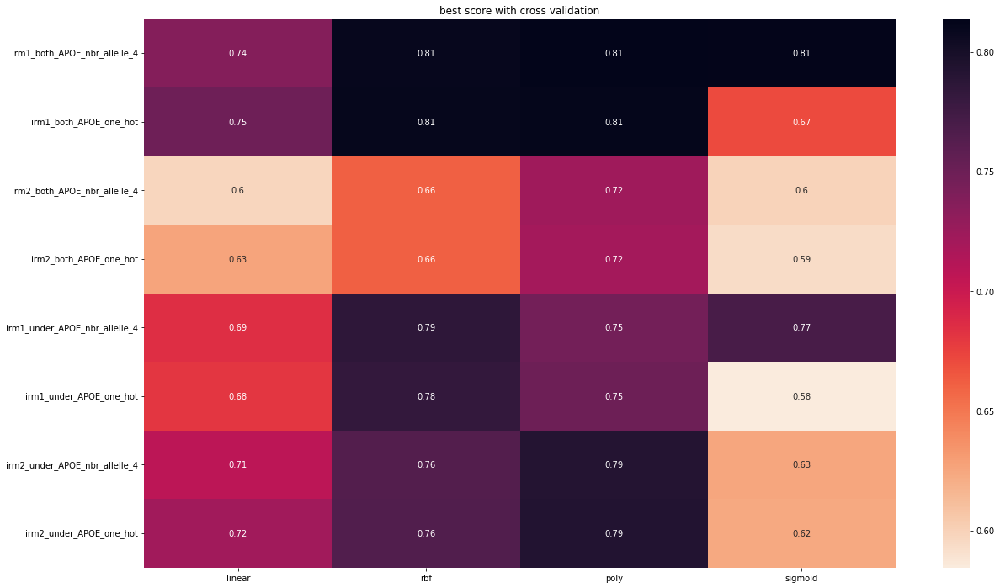

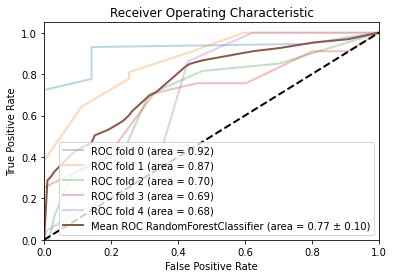

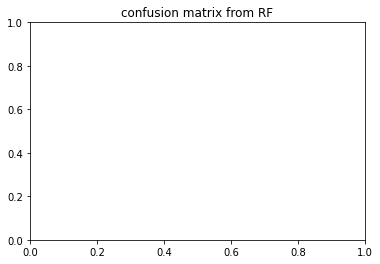

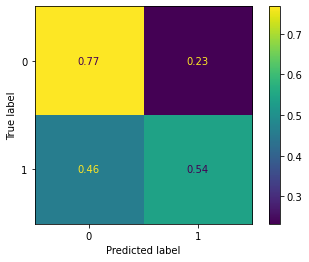

,precision,recall,f1-score,support,auc
0,0.643,0.769,0.696,131.600,0.000
1,0.686,0.545,0.600,131.600,0.000
accuracy,0.657,0.657,0.657,0.657,0.000
macro avg,0.664,0.657,0.648,263.200,0.772
weighted avg,0.664,0.657,0.648,263.200,0.772


coming from


,precision,recall,f1-score,support,auc
0,0.789855,0.858268,0.822642,127.000000,0.000000
1,0.848739,0.776923,0.811245,130.000000,0.000000
accuracy,0.817121,0.817121,0.817121,0.817121,0.000000
macro avg,0.819297,0.817595,0.816943,257.000000,0.919322
weighted avg,0.819641,0.817121,0.816877,257.000000,0.919322


,precision,recall,f1-score,support,auc
0,0.781250,0.746269,0.763359,134.000000,0.000000
1,0.742424,0.777778,0.759690,126.000000,0.000000
accuracy,0.761538,0.761538,0.761538,0.761538,0.000000
macro avg,0.761837,0.762023,0.761524,260.000000,0.870884
weighted avg,0.762434,0.761538,0.761581,260.000000,0.870884


,precision,recall,f1-score,support,auc
0,0.552486,0.763359,0.641026,131.000000,0.000000
1,0.659341,0.425532,0.517241,141.000000,0.000000
accuracy,0.588235,0.588235,0.588235,0.588235,0.000000
macro avg,0.605913,0.594445,0.579134,272.000000,0.700341
weighted avg,0.607878,0.588235,0.576858,272.000000,0.700341


,precision,recall,f1-score,support,auc
0,0.592179,0.809160,0.683871,131.000000,0.000000
1,0.666667,0.406504,0.505051,123.000000,0.000000
accuracy,0.614173,0.614173,0.614173,0.614173,0.000000
macro avg,0.629423,0.607832,0.594461,254.000000,0.694191
weighted avg,0.628250,0.614173,0.597277,254.000000,0.694191


,precision,recall,f1-score,support,auc
0,0.497238,0.666667,0.569620,135.000000,0.000000
1,0.510870,0.340580,0.408696,138.000000,0.000000
accuracy,0.501832,0.501832,0.501832,0.501832,0.000000
macro avg,0.504054,0.503623,0.489158,273.000000,0.676973
weighted avg,0.504128,0.501832,0.488274,273.000000,0.676973


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 10}
depth_10_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.569 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.698 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.548 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.665 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.876 total time=   0.0s
[CV 3/5] END criterion=gini, max

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.433 total time=   1.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.407 total time=   1.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.734 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.742 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.663 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.556 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.796 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.544 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.721

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.733 total time=   1.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.694 total time=   1.2s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.587 total time=   1.2s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.419 total time=   1.1s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.387 total time=   1.2s


<Figure size 432x288 with 0 Axes>

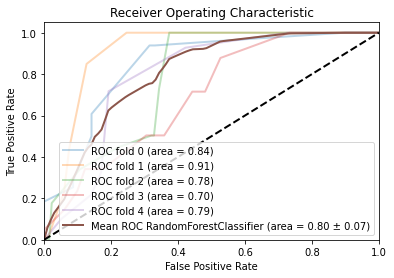

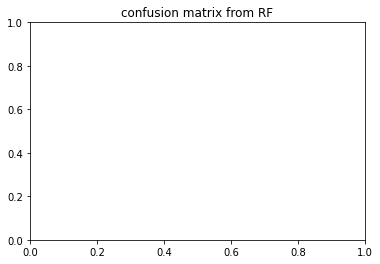

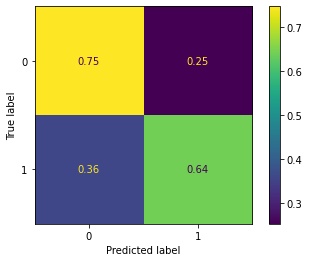

,precision,recall,f1-score,support,auc
0,0.688,0.747,0.708,131.600,0.000
1,0.724,0.646,0.669,131.600,0.000
accuracy,0.695,0.695,0.695,0.695,0.000
macro avg,0.706,0.697,0.688,263.200,0.804
weighted avg,0.706,0.695,0.688,263.200,0.804


coming from


,precision,recall,f1-score,support,auc
0,0.681250,0.858268,0.759582,127.000000,0.000000
1,0.814433,0.607692,0.696035,130.000000,0.000000
accuracy,0.731518,0.731518,0.731518,0.731518,0.000000
macro avg,0.747841,0.732980,0.727809,257.000000,0.841399
weighted avg,0.748619,0.731518,0.727438,257.000000,0.841399


,precision,recall,f1-score,support,auc
0,0.860294,0.873134,0.866667,134.000000,0.000000
1,0.862903,0.849206,0.856000,126.000000,0.000000
accuracy,0.861538,0.861538,0.861538,0.861538,0.000000
macro avg,0.861599,0.861170,0.861333,260.000000,0.908552
weighted avg,0.861559,0.861538,0.861497,260.000000,0.908552


,precision,recall,f1-score,support,auc
0,0.693548,0.656489,0.674510,131.000000,0.000000
1,0.695946,0.730496,0.712803,141.000000,0.000000
accuracy,0.694853,0.694853,0.694853,0.694853,0.000000
macro avg,0.694747,0.693493,0.693656,272.000000,0.780277
weighted avg,0.694791,0.694853,0.694360,272.000000,0.780277


,precision,recall,f1-score,support,auc
0,0.660194,0.519084,0.581197,131.000000,0.000000
1,0.582781,0.715447,0.642336,123.000000,0.000000
accuracy,0.614173,0.614173,0.614173,0.614173,0.000000
macro avg,0.621488,0.617266,0.611766,254.000000,0.695618
weighted avg,0.622707,0.614173,0.610803,254.000000,0.695618


,precision,recall,f1-score,support,auc
0,0.546341,0.829630,0.658824,135.000000,0.000000
1,0.661765,0.326087,0.436893,138.000000,0.000000
accuracy,0.575092,0.575092,0.575092,0.575092,0.000000
macro avg,0.604053,0.577858,0.547858,273.000000,0.792083
weighted avg,0.604687,0.575092,0.546639,273.000000,0.792083


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 10}
depth_10_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.760 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.712 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.605 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.837 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.445 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.641 total time=   0.1s
[CV 3/5] END criterion=

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.394 total time=   1.6s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.771 total time=   2.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.608 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.731 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.430 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.988 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.631 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.688

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.522 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.735 total time=   2.1s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.633 total time=   1.9s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.532 total time=   1.8s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.770 total time=   2.1s


<Figure size 432x288 with 0 Axes>

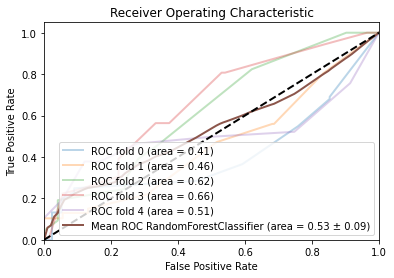

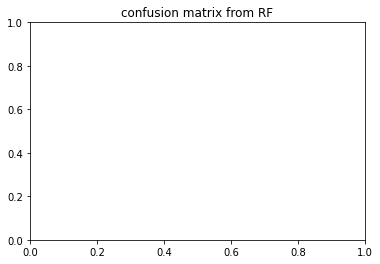

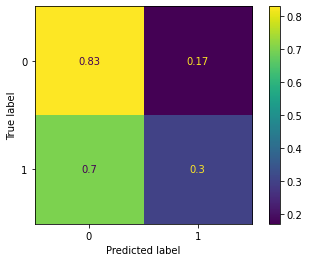

,precision,recall,f1-score,support,auc
0,0.547,0.828,0.651,200.000,0.000
1,0.735,0.299,0.370,200.000,0.000
accuracy,0.565,0.565,0.565,0.565,0.000
macro avg,0.641,0.564,0.510,400.000,0.531
weighted avg,0.641,0.565,0.511,400.000,0.531


coming from


,precision,recall,f1-score,support,auc
0,0.558140,0.909953,0.691892,211.000000,0.000000
1,0.703125,0.228426,0.344828,197.000000,0.000000
accuracy,0.580882,0.580882,0.580882,0.580882,0.000000
macro avg,0.630632,0.569190,0.518360,408.000000,0.411913
weighted avg,0.628145,0.580882,0.524314,408.000000,0.411913


,precision,recall,f1-score,support,auc
0,0.519685,1.000000,0.683938,198.000000,0.000000
1,1.000000,0.051813,0.098522,193.000000,0.000000
accuracy,0.531969,0.531969,0.531969,0.531969,0.000000
macro avg,0.759843,0.525907,0.391230,391.000000,0.458628
weighted avg,0.756771,0.531969,0.394973,391.000000,0.458628


,precision,recall,f1-score,support,auc
0,0.537500,0.661538,0.593103,195.000000,0.000000
1,0.584906,0.455882,0.512397,204.000000,0.000000
accuracy,0.556391,0.556391,0.556391,0.556391,0.000000
macro avg,0.561203,0.558710,0.552750,399.000000,0.619369
weighted avg,0.561737,0.556391,0.551840,399.000000,0.619369


,precision,recall,f1-score,support,auc
0,0.590476,0.626263,0.607843,198.000000,0.000000
1,0.600000,0.563452,0.581152,197.000000,0.000000
accuracy,0.594937,0.594937,0.594937,0.594937,0.000000
macro avg,0.595238,0.594857,0.594497,395.000000,0.658745
weighted avg,0.595226,0.594937,0.594531,395.000000,0.658745


,precision,recall,f1-score,support,auc
0,0.526761,0.944444,0.676311,198.000000,0.000000
1,0.788462,0.196172,0.314176,209.000000,0.000000
accuracy,0.560197,0.560197,0.560197,0.560197,0.000000
macro avg,0.657611,0.570308,0.495244,407.000000,0.505993
weighted avg,0.661148,0.560197,0.490350,407.000000,0.505993


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'sqrt', 'n_estimators': 10}
depth_10_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.426 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.683 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.843 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.438 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.813 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.635 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.681 total time=   0.1s
[CV 3/5] END criterion=gini, max

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.414 total time=   1.7s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.703 total time=   1.9s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.671 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.657 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.675 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.330 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.924 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.567 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.565

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.516 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.777 total time=   2.1s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.627 total time=   1.9s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.503 total time=   1.8s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.832 total time=   2.1s


<Figure size 432x288 with 0 Axes>

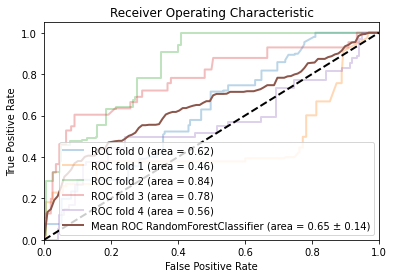

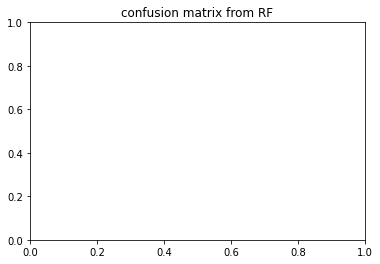

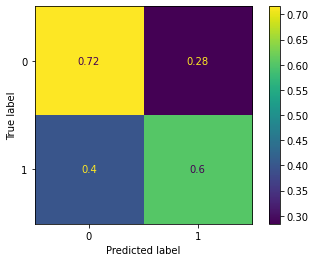

,precision,recall,f1-score,support,auc
0,0.673,0.718,0.676,200.000,0.000
1,0.694,0.600,0.622,200.000,0.000
accuracy,0.659,0.659,0.659,0.659,0.000
macro avg,0.683,0.659,0.649,400.000,0.651
weighted avg,0.683,0.659,0.649,400.000,0.651


coming from


,precision,recall,f1-score,support,auc
0,0.623529,0.502370,0.556430,211.000000,0.000000
1,0.558824,0.675127,0.611494,197.000000,0.000000
accuracy,0.585784,0.585784,0.585784,0.585784,0.000000
macro avg,0.591176,0.588748,0.583962,408.000000,0.621707
weighted avg,0.592287,0.585784,0.583018,408.000000,0.621707


,precision,recall,f1-score,support,auc
0,0.570934,0.833333,0.677618,198.000000,0.000000
1,0.676471,0.357513,0.467797,193.000000,0.000000
accuracy,0.598465,0.598465,0.598465,0.598465,0.000000
macro avg,0.623702,0.595423,0.572707,391.000000,0.456626
weighted avg,0.623028,0.598465,0.574049,391.000000,0.456626


,precision,recall,f1-score,support,auc
0,0.927419,0.589744,0.721003,195.000000,0.000000
1,0.709091,0.955882,0.814196,204.000000,0.000000
accuracy,0.776942,0.776942,0.776942,0.776942,0.000000
macro avg,0.818255,0.772813,0.767600,399.000000,0.841378
weighted avg,0.815793,0.776942,0.768651,399.000000,0.841378


,precision,recall,f1-score,support,auc
0,0.669145,0.909091,0.770878,198.000000,0.00000
1,0.857143,0.548223,0.668731,197.000000,0.00000
accuracy,0.729114,0.729114,0.729114,0.729114,0.00000
macro avg,0.763144,0.728657,0.719804,395.000000,0.77856
weighted avg,0.762906,0.729114,0.719934,395.000000,0.77856


,precision,recall,f1-score,support,auc
0,0.572519,0.757576,0.652174,198.00000,0.000000
1,0.668966,0.464115,0.548023,209.00000,0.000000
accuracy,0.606880,0.606880,0.606880,0.60688,0.000000
macro avg,0.620742,0.610845,0.600098,407.00000,0.557295
weighted avg,0.622046,0.606880,0.598691,407.00000,0.557295


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 100}
depth_10_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.882 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.894 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.658 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.592 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.767 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.931 total time=   0.0s
[CV 3/5] END criterion=g

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.537 total time=   0.8s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.623 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.700 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.726 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.706 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.749 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.605 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.867 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.865

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.711 total time=   1.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.639 total time=   1.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.593 total time=   1.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.480 total time=   1.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.555 total time=   1.0s


<Figure size 432x288 with 0 Axes>

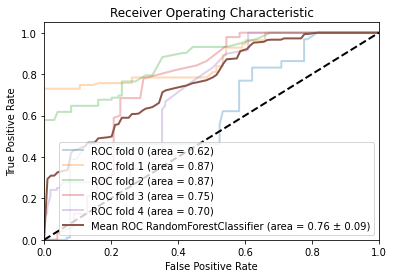

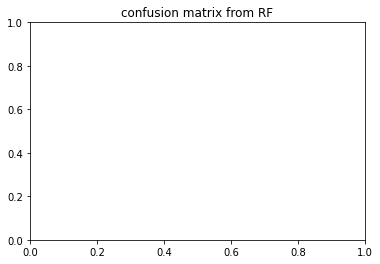

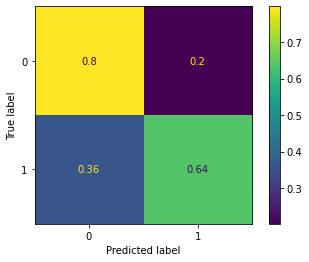

,precision,recall,f1-score,support,auc
0,0.707,0.801,0.723,102.200,0.000
1,0.817,0.632,0.683,102.200,0.000
accuracy,0.717,0.717,0.717,0.717,0.000
macro avg,0.762,0.717,0.703,204.400,0.763
weighted avg,0.763,0.717,0.703,204.400,0.763


coming from


,precision,recall,f1-score,support,auc
0,0.615894,0.902913,0.732283,103.000000,0.000000
1,0.787234,0.389474,0.521127,95.000000,0.000000
accuracy,0.656566,0.656566,0.656566,0.656566,0.000000
macro avg,0.701564,0.646193,0.626705,198.000000,0.624016
weighted avg,0.698103,0.656566,0.630971,198.000000,0.624016


,precision,recall,f1-score,support,auc
0,0.715278,1.000000,0.834008,103.000000,0.000000
1,1.000000,0.630631,0.773481,111.000000,0.000000
accuracy,0.808411,0.808411,0.808411,0.808411,0.000000
macro avg,0.857639,0.815315,0.803744,214.000000,0.868538
weighted avg,0.862961,0.808411,0.802613,214.000000,0.868538


,precision,recall,f1-score,support,auc
0,0.678082,1.000000,0.808163,99.000000,0.000000
1,1.000000,0.539216,0.700637,102.000000,0.000000
accuracy,0.766169,0.766169,0.766169,0.766169,0.000000
macro avg,0.839041,0.769608,0.754400,201.000000,0.870271
weighted avg,0.841443,0.766169,0.753598,201.000000,0.870271


,precision,recall,f1-score,support,auc
0,0.705882,0.712871,0.709360,101.00000,0.00000
1,0.691489,0.684211,0.687831,95.00000,0.00000
accuracy,0.698980,0.698980,0.698980,0.69898,0.00000
macro avg,0.698686,0.698541,0.698595,196.00000,0.74987
weighted avg,0.698906,0.698980,0.698925,196.00000,0.74987


,precision,recall,f1-score,support,auc
0,0.820000,0.390476,0.529032,105.000000,0.000000
1,0.607362,0.916667,0.730627,108.000000,0.000000
accuracy,0.657277,0.657277,0.657277,0.657277,0.000000
macro avg,0.713681,0.653571,0.629830,213.000000,0.699912
weighted avg,0.712184,0.657277,0.631249,213.000000,0.699912


{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 100}
depth_10_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.932 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.878 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.648 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.565 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.901 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.994 total time=   0.0s
[CV 3/5] END criterion=gini, m

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.466 total time=   0.8s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.575 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.878 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.462 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.636 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.769 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.841 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.972

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.719 total time=   1.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.544 total time=   1.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.510 total time=   1.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.438 total time=   1.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.566 total time=   1.0s


<Figure size 432x288 with 0 Axes>

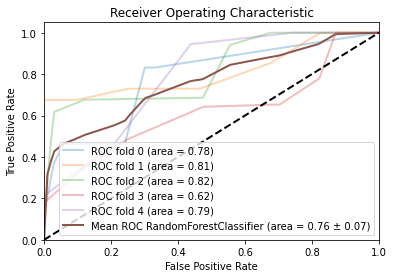

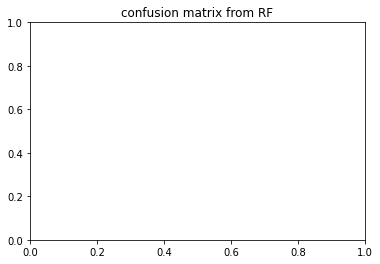

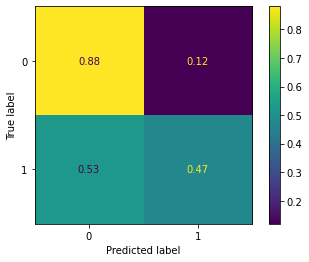

,precision,recall,f1-score,support,auc
0,0.625,0.882,0.731,102.200,0.000
1,0.806,0.470,0.590,102.200,0.000
accuracy,0.676,0.676,0.676,0.676,0.000
macro avg,0.716,0.676,0.660,204.400,0.762
weighted avg,0.717,0.676,0.661,204.400,0.762


coming from


,precision,recall,f1-score,support,auc
0,0.609375,0.757282,0.675325,103.000000,0.00000
1,0.642857,0.473684,0.545455,95.000000,0.00000
accuracy,0.621212,0.621212,0.621212,0.621212,0.00000
macro avg,0.626116,0.615483,0.610390,198.000000,0.78048
weighted avg,0.625440,0.621212,0.613013,198.000000,0.78048


,precision,recall,f1-score,support,auc
0,0.695946,1.000000,0.820717,103.00000,0.000000
1,1.000000,0.594595,0.745763,111.00000,0.000000
accuracy,0.789720,0.789720,0.789720,0.78972,0.000000
macro avg,0.847973,0.797297,0.783240,214.00000,0.809849
weighted avg,0.853656,0.789720,0.781839,214.00000,0.809849


,precision,recall,f1-score,support,auc
0,0.642384,0.979798,0.776000,99.000000,0.000000
1,0.960000,0.470588,0.631579,102.000000,0.000000
accuracy,0.721393,0.721393,0.721393,0.721393,0.000000
macro avg,0.801192,0.725193,0.703789,201.000000,0.817588
weighted avg,0.803562,0.721393,0.702712,201.000000,0.817588


,precision,recall,f1-score,support,auc
0,0.589404,0.881188,0.706349,101.000000,0.000000
1,0.733333,0.347368,0.471429,95.000000,0.000000
accuracy,0.622449,0.622449,0.622449,0.622449,0.000000
macro avg,0.661369,0.614278,0.588889,196.000000,0.618343
weighted avg,0.659166,0.622449,0.592485,196.000000,0.618343


,precision,recall,f1-score,support,auc
0,0.588652,0.790476,0.674797,105.000000,0.000000
1,0.694444,0.462963,0.555556,108.000000,0.000000
accuracy,0.624413,0.624413,0.624413,0.624413,0.000000
macro avg,0.641548,0.626720,0.615176,213.000000,0.785097
weighted avg,0.642293,0.624413,0.614336,213.000000,0.785097


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 10}
depth_10_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.632 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.907 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.878 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.471 total time=   0.0s
[CV 3/5] END criterion

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.882 total time=   1.4s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.794 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.493 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.399 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.406 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.721 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.511

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.659 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.307 total time=   1.5s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.528 total time=   1.5s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.906 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.879 total time=   1.8s


<Figure size 432x288 with 0 Axes>

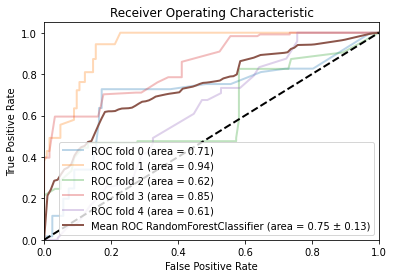

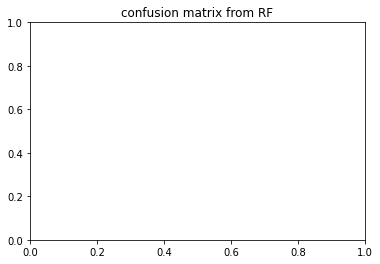

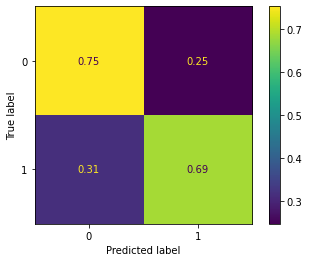

,precision,recall,f1-score,support,auc
0,0.746,0.754,0.703,122.800,0.000
1,0.790,0.686,0.696,122.800,0.000
accuracy,0.719,0.719,0.719,0.719,0.000
macro avg,0.768,0.720,0.700,245.600,0.746
weighted avg,0.768,0.719,0.699,245.600,0.746


coming from


,precision,recall,f1-score,support,auc
0,0.721429,0.827869,0.770992,122.000000,0.000000
1,0.796117,0.677686,0.732143,121.000000,0.000000
accuracy,0.753086,0.753086,0.753086,0.753086,0.000000
macro avg,0.758773,0.752777,0.751568,243.000000,0.707729
weighted avg,0.758619,0.753086,0.751648,243.000000,0.707729


,precision,recall,f1-score,support,auc
0,0.912281,0.845528,0.877637,123.000000,0.000000
1,0.859259,0.920635,0.888889,126.000000,0.000000
accuracy,0.883534,0.883534,0.883534,0.883534,0.000000
macro avg,0.885770,0.883082,0.883263,249.000000,0.937927
weighted avg,0.885451,0.883534,0.883331,249.000000,0.937927


,precision,recall,f1-score,support,auc
0,0.602273,0.868852,0.711409,122.000000,0.000
1,0.777778,0.444444,0.565657,126.000000,0.000
accuracy,0.653226,0.653226,0.653226,0.653226,0.000
macro avg,0.690025,0.656648,0.638533,248.000000,0.625
weighted avg,0.691441,0.653226,0.637358,248.000000,0.625


,precision,recall,f1-score,support,auc
0,0.638743,0.983871,0.774603,124.000000,0.000000
1,0.962963,0.429752,0.594286,121.000000,0.000000
accuracy,0.710204,0.710204,0.710204,0.710204,0.000000
macro avg,0.800853,0.706812,0.684444,245.000000,0.845641
weighted avg,0.798868,0.710204,0.685548,245.000000,0.845641


,precision,recall,f1-score,support,auc
0,0.857143,0.243902,0.379747,123.000000,0.000000
1,0.552885,0.958333,0.701220,120.000000,0.000000
accuracy,0.596708,0.596708,0.596708,0.596708,0.000000
macro avg,0.705014,0.601118,0.540483,243.000000,0.613381
weighted avg,0.706892,0.596708,0.538499,243.000000,0.613381


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 50}
depth_10_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.508 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.388 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.403 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.980 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.687 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.471 total time=   0.1s
[CV 3/5] END criterion=gini,

[CV 4/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.839 total time=   1.4s
[CV 5/5] END criterion=gini, max_depth=10, max_features=0.8, n_estimators=100;, score=0.883 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.767 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.248 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.486 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.847 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=10;, score=0.879 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.702 total time=   0.1s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, n_estimators=50;, score=0.264

[CV 1/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.673 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.276 total time=   1.4s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.570 total time=   1.5s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.836 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=0.8, n_estimators=100;, score=0.874 total time=   1.8s


<Figure size 432x288 with 0 Axes>

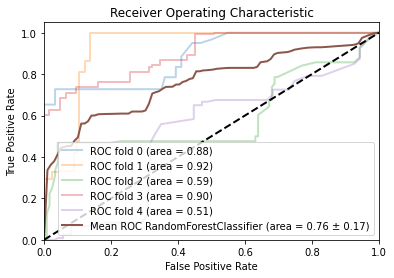

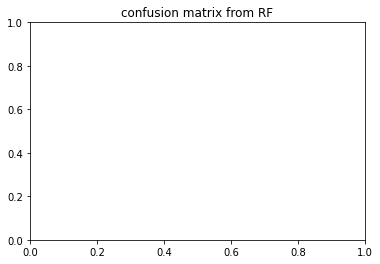

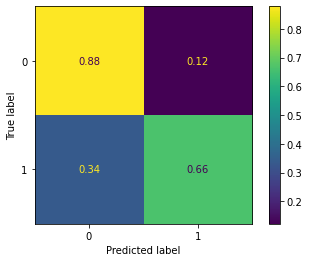

,precision,recall,f1-score,support,auc
0,0.742,0.878,0.797,122.80,0.000
1,0.852,0.662,0.730,122.80,0.000
accuracy,0.770,0.770,0.770,0.77,0.000
macro avg,0.797,0.770,0.763,245.60,0.762
weighted avg,0.797,0.770,0.763,245.60,0.762


coming from


,precision,recall,f1-score,support,auc
0,0.766234,0.967213,0.855072,122.000000,0.00000
1,0.955056,0.702479,0.809524,121.000000,0.00000
accuracy,0.835391,0.835391,0.835391,0.835391,0.00000
macro avg,0.860645,0.834846,0.832298,243.000000,0.88362
weighted avg,0.860256,0.835391,0.832392,243.000000,0.88362


,precision,recall,f1-score,support,auc
0,0.990654,0.861789,0.921739,123.000000,0.000000
1,0.880282,0.992063,0.932836,126.000000,0.000000
accuracy,0.927711,0.927711,0.927711,0.927711,0.000000
macro avg,0.935468,0.926926,0.927287,249.000000,0.924958
weighted avg,0.934803,0.927711,0.927354,249.000000,0.924958


,precision,recall,f1-score,support,auc
0,0.612565,0.959016,0.747604,122.000000,0.000000
1,0.912281,0.412698,0.568306,126.000000,0.000000
accuracy,0.681452,0.681452,0.681452,0.681452,0.000000
macro avg,0.762423,0.685857,0.657955,248.000000,0.593579
weighted avg,0.764840,0.681452,0.656509,248.000000,0.593579


,precision,recall,f1-score,support,auc
0,0.753247,0.935484,0.834532,124.000000,0.000000
1,0.912088,0.685950,0.783019,121.000000,0.000000
accuracy,0.812245,0.812245,0.812245,0.812245,0.000000
macro avg,0.832667,0.810717,0.808776,245.000000,0.897361
weighted avg,0.831695,0.812245,0.809091,245.000000,0.897361


,precision,recall,f1-score,support,auc
0,0.585714,0.666667,0.623574,123.000000,0.000000
1,0.601942,0.516667,0.556054,120.000000,0.000000
accuracy,0.592593,0.592593,0.592593,0.592593,0.000000
macro avg,0.593828,0.591667,0.589814,243.000000,0.512669
weighted avg,0.593728,0.592593,0.590231,243.000000,0.512669


{'criterion': 'entropy', 'max_depth': 10, 'max_features': 'log2', 'n_estimators': 100}
depth_100_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.682 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.467 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.348 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.685 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.670 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.816 total time=   0.0s
[CV 3/5] END c

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.606 total time=   1.1s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.399 total time=   1.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.233 total time=   1.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.645 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.754 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.601 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.523 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.506 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.203 total time=   0.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.778 total time=   1.2s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.612 total time=   1.3s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.587 total time=   1.2s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.499 total time=   1.1s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.574 total time=   1.2s


<Figure size 432x288 with 0 Axes>

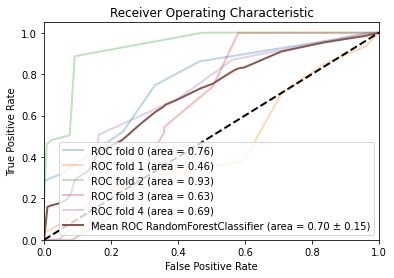

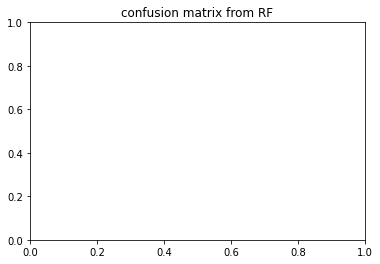

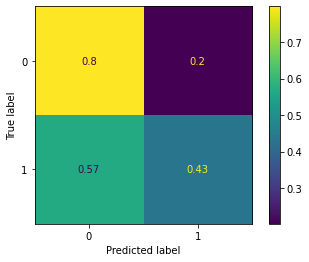

,precision,recall,f1-score,support,auc
0,0.606,0.797,0.673,131.600,0.000
1,0.653,0.435,0.479,131.600,0.000
accuracy,0.616,0.616,0.616,0.616,0.000
macro avg,0.629,0.616,0.576,263.200,0.696
weighted avg,0.630,0.616,0.577,263.200,0.696


coming from


,precision,recall,f1-score,support,auc
0,0.610063,0.763780,0.678322,127.000000,0.000000
1,0.693878,0.523077,0.596491,130.000000,0.000000
accuracy,0.642023,0.642023,0.642023,0.642023,0.000000
macro avg,0.651970,0.643428,0.637406,257.000000,0.760297
weighted avg,0.652459,0.642023,0.636929,257.000000,0.760297


,precision,recall,f1-score,support,auc
0,0.522822,0.940299,0.672000,134.000000,0.000000
1,0.578947,0.087302,0.151724,126.000000,0.000000
accuracy,0.526923,0.526923,0.526923,0.526923,0.000000
macro avg,0.550884,0.513800,0.411862,260.000000,0.462805
weighted avg,0.550021,0.526923,0.419866,260.000000,0.462805


,precision,recall,f1-score,support,auc
0,0.731707,0.916031,0.813559,131.000000,0.000000
1,0.898148,0.687943,0.779116,141.000000,0.000000
accuracy,0.797794,0.797794,0.797794,0.797794,0.000000
macro avg,0.814928,0.801987,0.796338,272.000000,0.933301
weighted avg,0.817987,0.797794,0.795705,272.000000,0.933301


,precision,recall,f1-score,support,auc
0,0.670103,0.496183,0.570175,131.000000,0.00000
1,0.579618,0.739837,0.650000,123.000000,0.00000
accuracy,0.614173,0.614173,0.614173,0.614173,0.00000
macro avg,0.624860,0.618010,0.610088,254.000000,0.63216
weighted avg,0.626285,0.614173,0.608831,254.000000,0.63216


,precision,recall,f1-score,support,auc
0,0.495763,0.866667,0.630728,135.000000,0.000000
1,0.513514,0.137681,0.217143,138.000000,0.000000
accuracy,0.498168,0.498168,0.498168,0.498168,0.000000
macro avg,0.504638,0.502174,0.423935,273.000000,0.692941
weighted avg,0.504736,0.498168,0.421663,273.000000,0.692941


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 10}
depth_100_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.431 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.879 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.309 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.461 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.949 total time=   0.0s
[CV 3/5] END criteri

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.584 total time=   1.2s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.534 total time=   1.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.459 total time=   1.1s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.758 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.987 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.561 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.591 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.810 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.297 total time=   0.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.733 total time=   1.1s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.594 total time=   1.3s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.591 total time=   1.2s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.358 total time=   1.2s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.209 total time=   1.2s


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

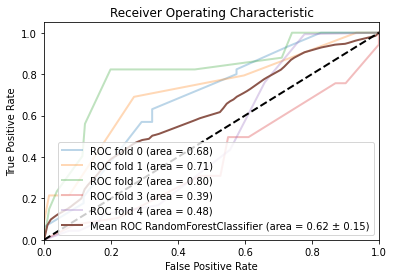

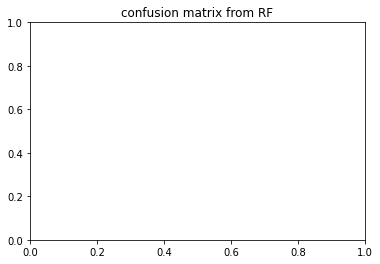

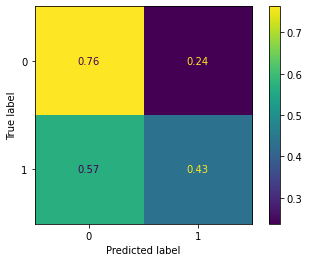

,precision,recall,f1-score,support,auc
0,0.582,0.764,0.638,131.600,0.000
1,0.549,0.421,0.447,131.600,0.000
accuracy,0.597,0.597,0.597,0.597,0.000
macro avg,0.566,0.593,0.543,263.200,0.616
weighted avg,0.567,0.597,0.546,263.200,0.616


coming from


,precision,recall,f1-score,support,auc
0,0.605634,0.677165,0.639405,127.000000,0.000000
1,0.643478,0.569231,0.604082,130.000000,0.000000
accuracy,0.622568,0.622568,0.622568,0.622568,0.000000
macro avg,0.624556,0.623198,0.621743,257.000000,0.682798
weighted avg,0.624777,0.622568,0.621537,257.000000,0.682798


,precision,recall,f1-score,support,auc
0,0.556054,0.925373,0.694678,134.000000,0.000000
1,0.729730,0.214286,0.331288,126.000000,0.000000
accuracy,0.580769,0.580769,0.580769,0.580769,0.000000
macro avg,0.642892,0.569829,0.512983,260.000000,0.714819
weighted avg,0.640220,0.580769,0.518574,260.000000,0.714819


,precision,recall,f1-score,support,auc
0,0.649718,0.877863,0.746753,131.000000,0.000000
1,0.831579,0.560284,0.669492,141.000000,0.000000
accuracy,0.713235,0.713235,0.713235,0.713235,0.000000
macro avg,0.740648,0.719073,0.708122,272.000000,0.802718
weighted avg,0.743991,0.713235,0.706702,272.000000,0.802718


,precision,recall,f1-score,support,auc
0,0.515748,1.000000,0.680519,131.000000,0.000000
1,0.000000,0.000000,0.000000,123.000000,0.000000
accuracy,0.515748,0.515748,0.515748,0.515748,0.000000
macro avg,0.257874,0.500000,0.340260,254.000000,0.393843
weighted avg,0.265996,0.515748,0.350977,254.000000,0.393843


,precision,recall,f1-score,support,auc
0,0.582278,0.340741,0.429907,135.000000,0.00000
1,0.541237,0.760870,0.632530,138.000000,0.00000
accuracy,0.553114,0.553114,0.553114,0.553114,0.00000
macro avg,0.561758,0.550805,0.531218,273.000000,0.48387
weighted avg,0.561532,0.553114,0.532332,273.000000,0.48387


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 10}
depth_100_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.480 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.660 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.753 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.641 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.735 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.500 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.647 total time=   0.1s
[CV 3/5] END c

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.731 total time=   1.8s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.462 total time=   1.6s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.758 total time=   1.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.365 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.635 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.664 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.554 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.861 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.726 total time=   1.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.527 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.789 total time=   2.1s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.625 total time=   1.9s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.474 total time=   1.8s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.818 total time=   2.1s


<Figure size 432x288 with 0 Axes>

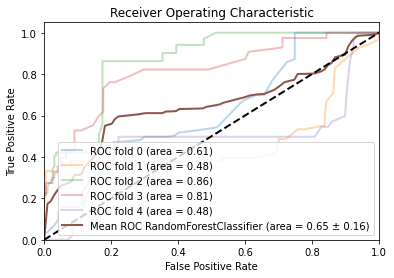

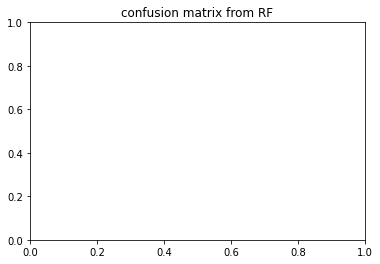

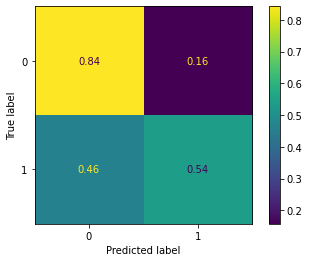

,precision,recall,f1-score,support,auc
0,0.662,0.843,0.736,200.000,0.000
1,0.787,0.539,0.618,200.000,0.000
accuracy,0.692,0.692,0.692,0.692,0.000
macro avg,0.725,0.691,0.677,400.000,0.649
weighted avg,0.724,0.692,0.678,400.000,0.649


coming from


,precision,recall,f1-score,support,auc
0,0.577855,0.791469,0.668000,211.000000,0.000000
1,0.630252,0.380711,0.474684,197.000000,0.000000
accuracy,0.593137,0.593137,0.593137,0.593137,0.000000
macro avg,0.604053,0.586090,0.571342,408.000000,0.613997
weighted avg,0.603154,0.593137,0.574658,408.000000,0.613997


,precision,recall,f1-score,support,auc
0,0.598784,0.994949,0.747628,198.000000,0.000000
1,0.983871,0.316062,0.478431,193.000000,0.000000
accuracy,0.659847,0.659847,0.659847,0.659847,0.000000
macro avg,0.791328,0.655506,0.613030,391.000000,0.478019
weighted avg,0.788865,0.659847,0.614751,391.000000,0.478019


,precision,recall,f1-score,support,auc
0,0.800995,0.825641,0.813131,195.000000,0.000000
1,0.828283,0.803922,0.815920,204.000000,0.000000
accuracy,0.814536,0.814536,0.814536,0.814536,0.000000
macro avg,0.814639,0.814781,0.814526,399.000000,0.861601
weighted avg,0.814947,0.814536,0.814557,399.000000,0.861601


,precision,recall,f1-score,support,auc
0,0.754630,0.823232,0.787440,198.000000,0.000000
1,0.804469,0.730964,0.765957,197.000000,0.000000
accuracy,0.777215,0.777215,0.777215,0.777215,0.000000
macro avg,0.779549,0.777098,0.776699,395.000000,0.812388
weighted avg,0.779486,0.777215,0.776726,395.000000,0.812388


,precision,recall,f1-score,support,auc
0,0.578947,0.777778,0.663793,198.000000,0.000000
1,0.687943,0.464115,0.554286,209.000000,0.000000
accuracy,0.616708,0.616708,0.616708,0.616708,0.000000
macro avg,0.633445,0.620946,0.609039,407.000000,0.479919
weighted avg,0.634918,0.616708,0.607560,407.000000,0.479919


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_100_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.509 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.702 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.642 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.520 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.770 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.581 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.650 total time=   0.1s
[CV 3/5] END criterion

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.727 total time=   1.9s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.472 total time=   1.6s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.712 total time=   2.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.555 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.848 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.756 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.861 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.793 total time=   1.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.576 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.716 total time=   2.2s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.633 total time=   1.9s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.468 total time=   1.8s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.824 total time=   2.0s


<Figure size 432x288 with 0 Axes>

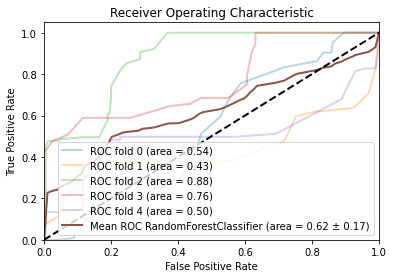

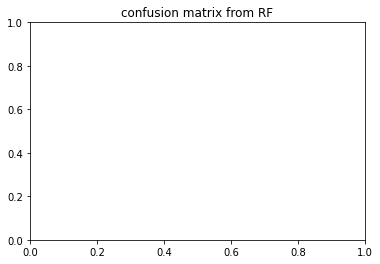

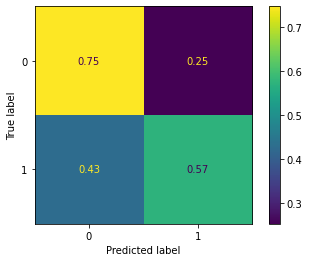

,precision,recall,f1-score,support,auc
0,0.659,0.751,0.683,200.00,0.000
1,0.721,0.570,0.605,200.00,0.000
accuracy,0.660,0.660,0.660,0.66,0.000
macro avg,0.690,0.660,0.644,400.00,0.623
weighted avg,0.690,0.660,0.644,400.00,0.623


coming from


,precision,recall,f1-score,support,auc
0,0.602564,0.445498,0.512262,211.000000,0.000000
1,0.535714,0.685279,0.601336,197.000000,0.000000
accuracy,0.561275,0.561275,0.561275,0.561275,0.000000
macro avg,0.569139,0.565388,0.556799,408.000000,0.541162
weighted avg,0.570286,0.561275,0.555271,408.000000,0.541162


,precision,recall,f1-score,support,auc
0,0.559375,0.904040,0.691120,198.000000,0.000000
1,0.732394,0.269430,0.393939,193.000000,0.000000
accuracy,0.590793,0.590793,0.590793,0.590793,0.000000
macro avg,0.645885,0.586735,0.542530,391.000000,0.433244
weighted avg,0.644778,0.590793,0.544430,391.000000,0.433244


,precision,recall,f1-score,support,auc
0,0.891156,0.671795,0.766082,195.000000,0.000000
1,0.746032,0.921569,0.824561,204.000000,0.000000
accuracy,0.799499,0.799499,0.799499,0.799499,0.000000
macro avg,0.818594,0.796682,0.795322,399.000000,0.878218
weighted avg,0.816957,0.799499,0.795981,399.000000,0.878218


,precision,recall,f1-score,support,auc
0,0.654804,0.929293,0.768267,198.000000,0.000000
1,0.877193,0.507614,0.643087,197.000000,0.000000
accuracy,0.718987,0.718987,0.718987,0.718987,0.000000
macro avg,0.765999,0.718454,0.705677,395.000000,0.762908
weighted avg,0.765717,0.718987,0.705835,395.000000,0.762908


,precision,recall,f1-score,support,auc
0,0.586716,0.803030,0.678038,198.000000,0.000000
1,0.713235,0.464115,0.562319,209.000000,0.000000
accuracy,0.628993,0.628993,0.628993,0.628993,0.000000
macro avg,0.649976,0.633573,0.620179,407.000000,0.498768
weighted avg,0.651685,0.628993,0.618615,407.000000,0.498768


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 50}
depth_100_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.761 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.567 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.641 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.571 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.505 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.846 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.983 total time=   0.0s
[CV 3/5] END 

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.589 total time=   0.8s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.531 total time=   0.8s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.594 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.927 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.542 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.507 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.568 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.516 total time=   0.5s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.662 total time=   1.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.593 total time=   1.1s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.499 total time=   1.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.465 total time=   0.9s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.568 total time=   1.0s


<Figure size 432x288 with 0 Axes>

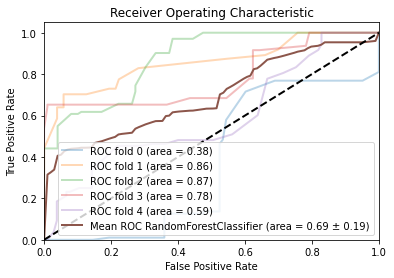

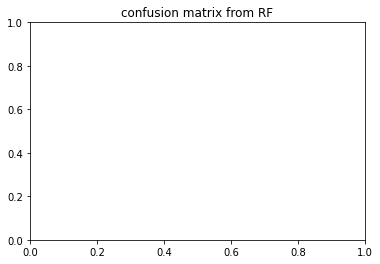

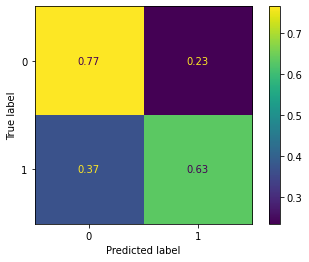

,precision,recall,f1-score,support,auc
0,0.685,0.765,0.710,102.200,0.000
1,0.760,0.634,0.675,102.200,0.000
accuracy,0.699,0.699,0.699,0.699,0.000
macro avg,0.723,0.699,0.692,204.400,0.695
weighted avg,0.723,0.699,0.692,204.400,0.695


coming from


,precision,recall,f1-score,support,auc
0,0.540230,0.456311,0.494737,103.000000,0.000000
1,0.495495,0.578947,0.533981,95.000000,0.000000
accuracy,0.515152,0.515152,0.515152,0.515152,0.000000
macro avg,0.517863,0.517629,0.514359,198.000000,0.375422
weighted avg,0.518766,0.515152,0.513566,198.000000,0.375422


,precision,recall,f1-score,support,auc
0,0.708029,0.941748,0.808333,103.000000,0.000000
1,0.922078,0.639640,0.755319,111.000000,0.000000
accuracy,0.785047,0.785047,0.785047,0.785047,0.000000
macro avg,0.815054,0.790694,0.781826,214.000000,0.856774
weighted avg,0.819054,0.785047,0.780835,214.000000,0.856774


,precision,recall,f1-score,support,auc
0,0.861111,0.626263,0.725146,99.000000,0.000000
1,0.713178,0.901961,0.796537,102.000000,0.000000
accuracy,0.766169,0.766169,0.766169,0.766169,0.000000
macro avg,0.787145,0.764112,0.760841,201.000000,0.872797
weighted avg,0.786041,0.766169,0.761374,201.000000,0.872797


,precision,recall,f1-score,support,auc
0,0.746269,0.990099,0.851064,101.000000,0.000000
1,0.983871,0.642105,0.777070,95.000000,0.000000
accuracy,0.821429,0.821429,0.821429,0.821429,0.000000
macro avg,0.865070,0.816102,0.814067,196.000000,0.781761
weighted avg,0.861433,0.821429,0.815200,196.000000,0.781761


,precision,recall,f1-score,support,auc
0,0.570470,0.809524,0.669291,105.000000,0.000000
1,0.687500,0.407407,0.511628,108.000000,0.000000
accuracy,0.605634,0.605634,0.605634,0.605634,0.000000
macro avg,0.628985,0.608466,0.590460,213.000000,0.587346
weighted avg,0.629809,0.605634,0.589349,213.000000,0.587346


{'criterion': 'gini', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 50}
depth_100_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.929 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.883 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.717 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.707 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.540 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.725 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.830 total time=   0.0s
[CV 3/5] END criterion

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.519 total time=   0.8s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.487 total time=   0.9s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.571 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.895 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.913 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.589 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.425 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.567 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.530 total time=   0.5s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.720 total time=   1.1s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.507 total time=   1.1s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.570 total time=   1.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.448 total time=   1.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.566 total time=   1.1s


<Figure size 432x288 with 0 Axes>

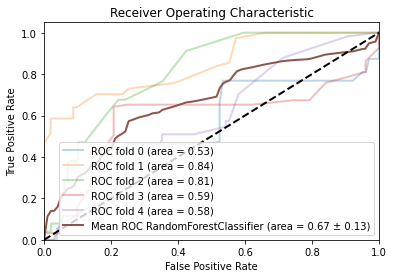

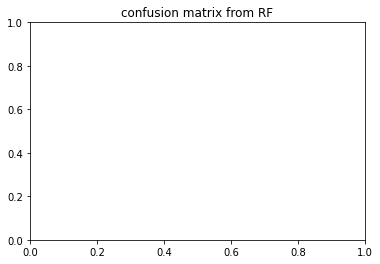

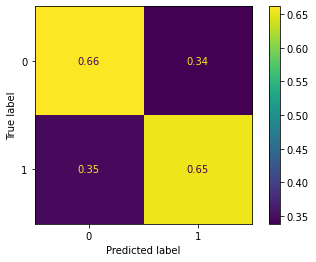

,precision,recall,f1-score,support,auc
0,0.650,0.663,0.645,102.200,0.000
1,0.695,0.654,0.658,102.200,0.000
accuracy,0.657,0.657,0.657,0.657,0.000
macro avg,0.672,0.658,0.652,204.400,0.669
weighted avg,0.673,0.657,0.652,204.400,0.669


coming from


,precision,recall,f1-score,support,auc
0,0.604938,0.475728,0.532609,103.000000,0.000000
1,0.538462,0.663158,0.594340,95.000000,0.000000
accuracy,0.565657,0.565657,0.565657,0.565657,0.000000
macro avg,0.571700,0.569443,0.563474,198.000000,0.529842
weighted avg,0.573043,0.565657,0.562227,198.000000,0.529842


,precision,recall,f1-score,support,auc
0,0.677852,0.980583,0.801587,103.000000,0.00000
1,0.969231,0.567568,0.715909,111.000000,0.00000
accuracy,0.766355,0.766355,0.766355,0.766355,0.00000
macro avg,0.823542,0.774075,0.758748,214.000000,0.84138
weighted avg,0.828988,0.766355,0.757147,214.000000,0.84138


,precision,recall,f1-score,support,auc
0,0.727273,0.646465,0.684492,99.000000,0.000000
1,0.690265,0.764706,0.725581,102.000000,0.000000
accuracy,0.706468,0.706468,0.706468,0.706468,0.000000
macro avg,0.708769,0.705585,0.705037,201.000000,0.808625
weighted avg,0.708493,0.706468,0.705343,201.000000,0.808625


,precision,recall,f1-score,support,auc
0,0.661157,0.792079,0.720721,101.000000,0.000000
1,0.720000,0.568421,0.635294,95.000000,0.000000
accuracy,0.683673,0.683673,0.683673,0.683673,0.000000
macro avg,0.690579,0.680250,0.678007,196.000000,0.587858
weighted avg,0.689678,0.683673,0.679315,196.000000,0.587858


,precision,recall,f1-score,support,auc
0,0.578947,0.419048,0.486188,105.00000,0.000000
1,0.554745,0.703704,0.620408,108.00000,0.000000
accuracy,0.563380,0.563380,0.563380,0.56338,0.000000
macro avg,0.566846,0.561376,0.553298,213.00000,0.577469
weighted avg,0.566676,0.563380,0.554243,213.00000,0.577469


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 50}
depth_100_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.689 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.243 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.686 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.846 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.780 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.686 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.293 total time=   0.0s
[CV 3/5] END 

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.611 total time=   1.4s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.804 total time=   1.4s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.757 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.646 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.452 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.505 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.810 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.848 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.607 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.291 total time=   1.5s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.617 total time=   1.5s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.871 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.868 total time=   1.8s


<Figure size 432x288 with 0 Axes>

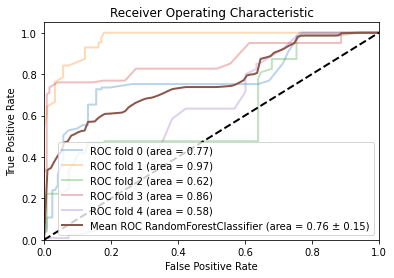

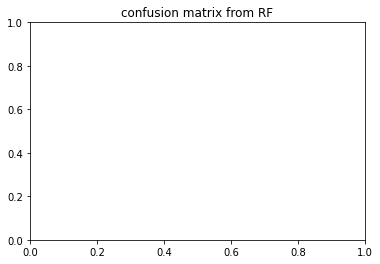

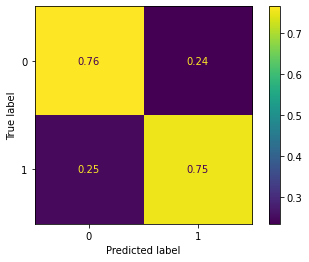

,precision,recall,f1-score,support,auc
0,0.779,0.764,0.738,122.800,0.000
1,0.797,0.752,0.750,122.800,0.000
accuracy,0.757,0.757,0.757,0.757,0.000
macro avg,0.788,0.758,0.744,245.600,0.761
weighted avg,0.788,0.757,0.743,245.600,0.761


coming from


,precision,recall,f1-score,support,auc
0,0.741007,0.844262,0.789272,122.000000,0.000000
1,0.817308,0.702479,0.755556,121.000000,0.000000
accuracy,0.773663,0.773663,0.773663,0.773663,0.000000
macro avg,0.779157,0.773371,0.772414,243.000000,0.771135
weighted avg,0.779000,0.773663,0.772483,243.000000,0.771135


,precision,recall,f1-score,support,auc
0,0.971429,0.829268,0.894737,123.000000,0.000000
1,0.854167,0.976190,0.911111,126.000000,0.000000
accuracy,0.903614,0.903614,0.903614,0.903614,0.000000
macro avg,0.912798,0.902729,0.902924,249.000000,0.969641
weighted avg,0.912091,0.903614,0.903023,249.000000,0.969641


,precision,recall,f1-score,support,auc
0,0.594444,0.877049,0.708609,122.000000,0.000000
1,0.779412,0.420635,0.546392,126.000000,0.000000
accuracy,0.645161,0.645161,0.645161,0.645161,0.000000
macro avg,0.686928,0.648842,0.627501,248.000000,0.620902
weighted avg,0.688420,0.645161,0.626192,248.000000,0.620902


,precision,recall,f1-score,support,auc
0,0.792208,0.983871,0.877698,124.000000,0.000000
1,0.978022,0.735537,0.839623,121.000000,0.000000
accuracy,0.861224,0.861224,0.861224,0.861224,0.000000
macro avg,0.885115,0.859704,0.858660,245.000000,0.864303
weighted avg,0.883977,0.861224,0.858893,245.000000,0.864303


,precision,recall,f1-score,support,auc
0,0.795455,0.284553,0.419162,123.000000,0.000000
1,0.557789,0.925000,0.695925,120.000000,0.000000
accuracy,0.600823,0.600823,0.600823,0.600823,0.000000
macro avg,0.676622,0.604776,0.557543,243.000000,0.579912
weighted avg,0.678089,0.600823,0.555835,243.000000,0.579912


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'log2', 'n_estimators': 100}
depth_100_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.593 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.451 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.668 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.712 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.865 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.708 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=100, max_features=sqrt, n_estimators=50;, score=0.347 total time=   0.0s
[CV 3/5] END crite

[CV 3/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.572 total time=   1.4s
[CV 4/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.807 total time=   1.4s
[CV 5/5] END criterion=gini, max_depth=100, max_features=0.8, n_estimators=100;, score=0.792 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.349 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.411 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.723 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=10;, score=0.930 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=sqrt, n_estimators=50;, score

[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=50;, score=0.818 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.738 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.295 total time=   1.5s
[CV 3/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.558 total time=   1.5s
[CV 4/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.878 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=100, max_features=0.8, n_estimators=100;, score=0.849 total time=   1.8s


<Figure size 432x288 with 0 Axes>

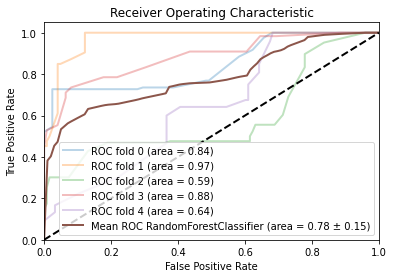

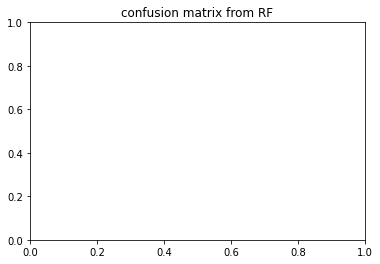

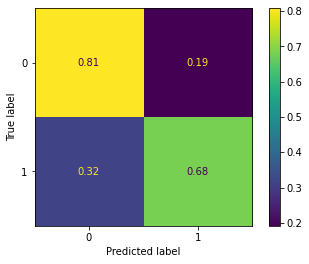

,precision,recall,f1-score,support,auc
0,0.761,0.808,0.742,122.800,0.000
1,0.829,0.684,0.710,122.800,0.000
accuracy,0.745,0.745,0.745,0.745,0.000
macro avg,0.795,0.746,0.726,245.600,0.784
weighted avg,0.795,0.745,0.726,245.600,0.784


coming from


,precision,recall,f1-score,support,auc
0,0.683908,0.975410,0.804054,122.000000,0.000000
1,0.956522,0.545455,0.694737,121.000000,0.000000
accuracy,0.761317,0.761317,0.761317,0.761317,0.000000
macro avg,0.820215,0.760432,0.749395,243.000000,0.842907
weighted avg,0.819654,0.761317,0.749620,243.000000,0.842907


,precision,recall,f1-score,support,auc
0,0.900000,0.878049,0.888889,123.000000,0.000000
1,0.883721,0.904762,0.894118,126.000000,0.000000
accuracy,0.891566,0.891566,0.891566,0.891566,0.000000
macro avg,0.891860,0.891405,0.891503,249.000000,0.970286
weighted avg,0.891762,0.891566,0.891535,249.000000,0.970286


,precision,recall,f1-score,support,auc
0,0.562189,0.926230,0.699690,122.000000,0.000000
1,0.808511,0.301587,0.439306,126.000000,0.000000
accuracy,0.608871,0.608871,0.608871,0.608871,0.000000
macro avg,0.685350,0.613908,0.569498,248.000000,0.586001
weighted avg,0.687336,0.608871,0.567399,248.000000,0.586001


,precision,recall,f1-score,support,auc
0,0.768212,0.935484,0.843636,124.00000,0.000000
1,0.914894,0.710744,0.800000,121.00000,0.000000
accuracy,0.824490,0.824490,0.824490,0.82449,0.000000
macro avg,0.841553,0.823114,0.821818,245.00000,0.882198
weighted avg,0.840655,0.824490,0.822085,245.00000,0.882198


,precision,recall,f1-score,support,auc
0,0.888889,0.325203,0.476190,123.00000,0.000000
1,0.580808,0.958333,0.723270,120.00000,0.000000
accuracy,0.637860,0.637860,0.637860,0.63786,0.000000
macro avg,0.734848,0.641768,0.599730,243.00000,0.640684
weighted avg,0.736750,0.637860,0.598205,243.00000,0.640684


{'criterion': 'entropy', 'max_depth': 100, 'max_features': 'sqrt', 'n_estimators': 50}
depth_1000_irm1_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.367 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.668 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.295 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.431 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.921 total time=   0.0s
[CV 3/

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.617 total time=   1.1s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.581 total time=   1.2s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.418 total time=   1.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.266 total time=   1.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.782 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.963 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.757 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.219 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.594 total time=   0.7s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.294 total time=   0.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.315 total time=   0.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.743 total time=   1.2s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.617 total time=   1.3s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.583 total time=   1.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.330 total time=   1.3s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.363 total time=   1.2s


<Figure size 432x288 with 0 Axes>

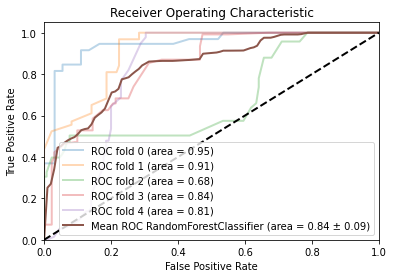

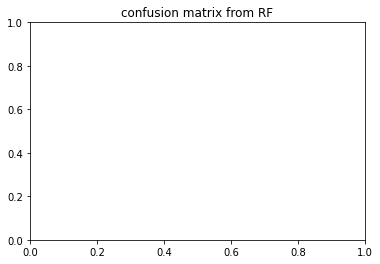

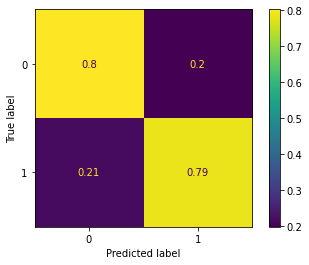

,precision,recall,f1-score,support,auc
0,0.817,0.804,0.799,131.600,0.000
1,0.808,0.789,0.783,131.600,0.000
accuracy,0.794,0.794,0.794,0.794,0.000
macro avg,0.812,0.796,0.791,263.200,0.838
weighted avg,0.814,0.794,0.791,263.200,0.838


coming from


,precision,recall,f1-score,support,auc
0,0.849624,0.889764,0.869231,127.000000,0.000000
1,0.887097,0.846154,0.866142,130.000000,0.000000
accuracy,0.867704,0.867704,0.867704,0.867704,0.000000
macro avg,0.868360,0.867959,0.867686,257.000000,0.946336
weighted avg,0.868579,0.867704,0.867668,257.000000,0.946336


,precision,recall,f1-score,support,auc
0,0.896552,0.776119,0.832000,134.000000,0.000000
1,0.791667,0.904762,0.844444,126.000000,0.000000
accuracy,0.838462,0.838462,0.838462,0.838462,0.000000
macro avg,0.844109,0.840441,0.838222,260.000000,0.912669
weighted avg,0.845723,0.838462,0.838031,260.000000,0.912669


,precision,recall,f1-score,support,auc
0,0.620513,0.923664,0.742331,131.000000,0.000000
1,0.870130,0.475177,0.614679,141.000000,0.000000
accuracy,0.691176,0.691176,0.691176,0.691176,0.000000
macro avg,0.745321,0.699421,0.678505,272.000000,0.676872
weighted avg,0.749910,0.691176,0.676159,272.000000,0.676872


,precision,recall,f1-score,support,auc
0,0.750000,0.732824,0.741313,131.00000,0.000000
1,0.722222,0.739837,0.730924,123.00000,0.000000
accuracy,0.736220,0.736220,0.736220,0.73622,0.000000
macro avg,0.736111,0.736331,0.736118,254.00000,0.841991
weighted avg,0.736549,0.736220,0.736282,254.00000,0.841991


,precision,recall,f1-score,support,auc
0,0.969072,0.696296,0.810345,135.000000,0.000000
1,0.767045,0.978261,0.859873,138.000000,0.000000
accuracy,0.838828,0.838828,0.838828,0.838828,0.000000
macro avg,0.868059,0.837279,0.835109,273.000000,0.811138
weighted avg,0.866949,0.838828,0.835381,273.000000,0.811138


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm1_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.381 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.691 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.606 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.388 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.687 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.605 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.860 total time=   0.0s
[CV 3/5] END 

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.545 total time=   1.1s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.604 total time=   1.1s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.358 total time=   1.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.468 total time=   1.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.608 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.304 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.682 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.214 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.588 total time=   0.6s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.307 total time=   0.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.512 total time=   0.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.783 total time=   1.1s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.639 total time=   1.2s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.587 total time=   1.2s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.257 total time=   1.1s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.297 total time=   1.2s


<Figure size 432x288 with 0 Axes>

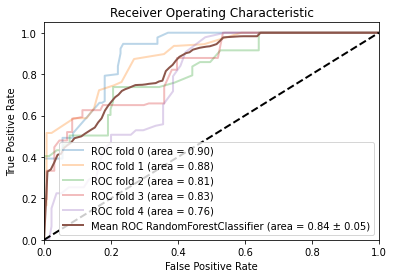

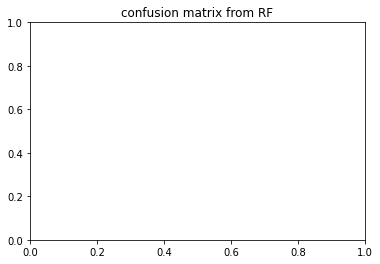

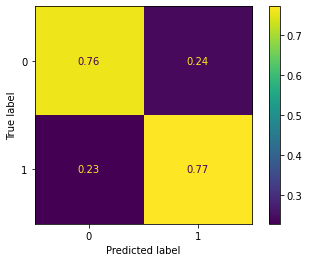

,precision,recall,f1-score,support,auc
0,0.785,0.759,0.763,131.600,0.000
1,0.771,0.770,0.762,131.600,0.000
accuracy,0.766,0.766,0.766,0.766,0.000
macro avg,0.778,0.765,0.762,263.200,0.836
weighted avg,0.778,0.766,0.763,263.200,0.836


coming from


,precision,recall,f1-score,support,auc
0,0.907407,0.771654,0.834043,127.000000,0.000000
1,0.805369,0.923077,0.860215,130.000000,0.000000
accuracy,0.848249,0.848249,0.848249,0.848249,0.000000
macro avg,0.856388,0.847365,0.847129,257.000000,0.897365
weighted avg,0.855793,0.848249,0.847282,257.000000,0.897365


,precision,recall,f1-score,support,auc
0,0.774436,0.768657,0.771536,134.000000,0.000000
1,0.755906,0.761905,0.758893,126.000000,0.000000
accuracy,0.765385,0.765385,0.765385,0.765385,0.000000
macro avg,0.765171,0.765281,0.765214,260.000000,0.882048
weighted avg,0.765456,0.765385,0.765409,260.000000,0.882048


,precision,recall,f1-score,support,auc
0,0.688742,0.793893,0.737589,131.000000,0.000000
1,0.776860,0.666667,0.717557,141.000000,0.000000
accuracy,0.727941,0.727941,0.727941,0.727941,0.000000
macro avg,0.732801,0.730280,0.727573,272.000000,0.813356
weighted avg,0.734420,0.727941,0.727205,272.000000,0.813356


,precision,recall,f1-score,support,auc
0,0.698795,0.885496,0.781145,131.000000,0.000000
1,0.829545,0.593496,0.691943,123.000000,0.000000
accuracy,0.744094,0.744094,0.744094,0.744094,0.000000
macro avg,0.764170,0.739496,0.736544,254.000000,0.828648
weighted avg,0.762111,0.744094,0.737949,254.000000,0.828648


,precision,recall,f1-score,support,auc
0,0.857143,0.577778,0.690265,135.00000,0.000000
1,0.686813,0.905797,0.781250,138.00000,0.000000
accuracy,0.743590,0.743590,0.743590,0.74359,0.000000
macro avg,0.771978,0.741787,0.735758,273.00000,0.758722
weighted avg,0.771042,0.743590,0.736258,273.00000,0.758722


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'sqrt', 'n_estimators': 100}
depth_1000_irm2_both_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.563 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.486 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.726 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.639 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.936 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.566 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.670 total time=   0.1s
[CV 

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.759 total time=   2.1s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.731 total time=   2.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.447 total time=   1.6s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.731 total time=   2.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.545 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.507 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.756 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.381 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.637 total time=   0.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.515 total time=   0.8s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.828 total time=   1.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.495 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.736 total time=   2.1s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.595 total time=   1.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.482 total time=   1.8s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.839 total time=   2.0s


<Figure size 432x288 with 0 Axes>

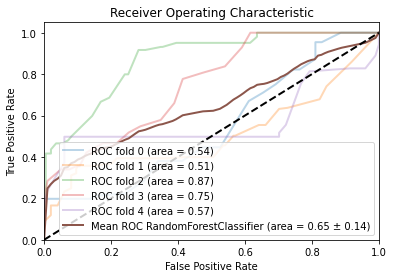

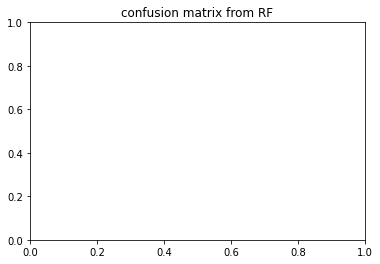

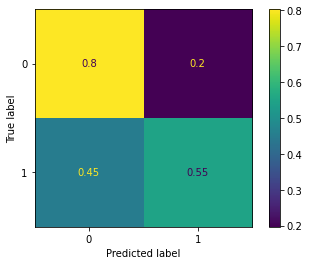

,precision,recall,f1-score,support,auc
0,0.683,0.800,0.701,200.000,0.000
1,0.810,0.546,0.585,200.000,0.000
accuracy,0.675,0.675,0.675,0.675,0.000
macro avg,0.747,0.673,0.643,400.000,0.649
weighted avg,0.746,0.675,0.644,400.000,0.649


coming from


,precision,recall,f1-score,support,auc
0,0.565684,1.000000,0.722603,211.000000,0.000000
1,1.000000,0.177665,0.301724,197.000000,0.000000
accuracy,0.602941,0.602941,0.602941,0.602941,0.000000
macro avg,0.782842,0.588832,0.512163,408.000000,0.543171
weighted avg,0.775390,0.602941,0.519384,408.000000,0.543171


,precision,recall,f1-score,support,auc
0,0.584967,0.904040,0.710317,198.000000,0.000000
1,0.776471,0.341969,0.474820,193.000000,0.000000
accuracy,0.626598,0.626598,0.626598,0.626598,0.000000
macro avg,0.680719,0.623005,0.592569,391.000000,0.508793
weighted avg,0.679495,0.626598,0.594075,391.000000,0.508793


,precision,recall,f1-score,support,auc
0,0.780749,0.748718,0.764398,195.000000,0.000000
1,0.768868,0.799020,0.783654,204.000000,0.000000
accuracy,0.774436,0.774436,0.774436,0.774436,0.000000
macro avg,0.774808,0.773869,0.774026,399.000000,0.870701
weighted avg,0.774674,0.774436,0.774243,399.000000,0.870701


,precision,recall,f1-score,support,auc
0,0.852632,0.409091,0.552901,198.000000,0.000000
1,0.610000,0.928934,0.736419,197.000000,0.000000
accuracy,0.668354,0.668354,0.668354,0.668354,0.000000
macro avg,0.731316,0.669012,0.644660,395.000000,0.751525
weighted avg,0.731623,0.668354,0.644427,395.000000,0.751525


,precision,recall,f1-score,support,auc
0,0.632653,0.939394,0.756098,198.00000,0.000000
1,0.893805,0.483254,0.627329,209.00000,0.000000
accuracy,0.705160,0.705160,0.705160,0.70516,0.000000
macro avg,0.763229,0.711324,0.691713,407.00000,0.569499
weighted avg,0.766758,0.705160,0.689973,407.00000,0.569499


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'sqrt', 'n_estimators': 50}
depth_1000_irm2_both_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.664 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.494 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.808 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.253 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.748 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.665 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.599 total time=   0.1s
[CV 3/5] EN

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.725 total time=   2.1s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.748 total time=   1.8s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.451 total time=   1.6s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.758 total time=   2.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.715 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.518 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.803 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.642 total time=   0.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.462 total time=   0.8s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.744 total time=   1.0s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.607 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.765 total time=   2.1s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.604 total time=   1.9s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.480 total time=   1.8s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.853 total time=   2.0s


<Figure size 432x288 with 0 Axes>

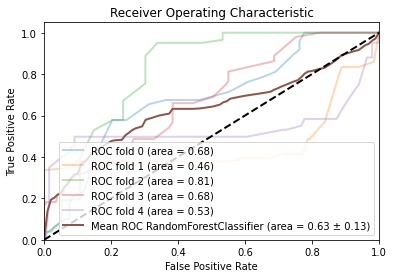

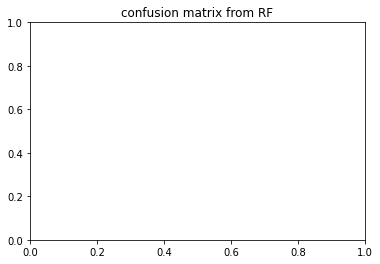

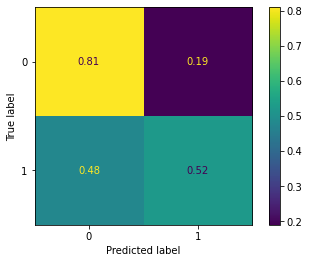

,precision,recall,f1-score,support,auc
0,0.650,0.809,0.708,200.000,0.000
1,0.783,0.520,0.580,200.000,0.000
accuracy,0.666,0.666,0.666,0.666,0.000
macro avg,0.717,0.665,0.644,400.000,0.633
weighted avg,0.716,0.666,0.645,400.000,0.633


coming from


,precision,recall,f1-score,support,auc
0,0.630435,0.824645,0.714579,211.000000,0.00000
1,0.719697,0.482234,0.577508,197.000000,0.00000
accuracy,0.659314,0.659314,0.659314,0.659314,0.00000
macro avg,0.675066,0.653439,0.646043,408.000000,0.68398
weighted avg,0.673534,0.659314,0.648395,408.000000,0.68398


,precision,recall,f1-score,support,auc
0,0.560907,1.000000,0.718693,198.000000,0.000000
1,1.000000,0.196891,0.329004,193.000000,0.000000
accuracy,0.603581,0.603581,0.603581,0.603581,0.000000
macro avg,0.780453,0.598446,0.523849,391.000000,0.457502
weighted avg,0.777646,0.603581,0.526340,391.000000,0.457502


,precision,recall,f1-score,support,auc
0,0.855346,0.697436,0.768362,195.000000,0.000000
1,0.754167,0.887255,0.815315,204.000000,0.000000
accuracy,0.794486,0.794486,0.794486,0.794486,0.000000
macro avg,0.804756,0.792345,0.791838,399.000000,0.814844
weighted avg,0.803615,0.794486,0.792368,399.000000,0.814844


,precision,recall,f1-score,support,auc
0,0.589372,0.616162,0.602469,198.000000,0.00000
1,0.595745,0.568528,0.581818,197.000000,0.00000
accuracy,0.592405,0.592405,0.592405,0.592405,0.00000
macro avg,0.592558,0.592345,0.592144,395.000000,0.67887
weighted avg,0.592550,0.592405,0.592170,395.000000,0.67887


,precision,recall,f1-score,support,auc
0,0.616438,0.909091,0.734694,198.00000,0.000000
1,0.843478,0.464115,0.598765,209.00000,0.000000
accuracy,0.680590,0.680590,0.680590,0.68059,0.000000
macro avg,0.729958,0.686603,0.666730,407.00000,0.530992
weighted avg,0.733026,0.680590,0.664893,407.00000,0.530992


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}
depth_1000_irm1_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.964 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.793 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.457 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.666 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.953 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.825 total time=   0.0s
[CV 3/5

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.573 total time=   0.9s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.546 total time=   0.8s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.466 total time=   0.8s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.633 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.874 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.863 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.869 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.508 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.438 total time=   0.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.456 total time=   0.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.521 total time=   0.5s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.677 total time=   1.1s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.677 total time=   1.1s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.601 total time=   1.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.472 total time=   1.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.565 total time=   1.0s


<Figure size 432x288 with 0 Axes>

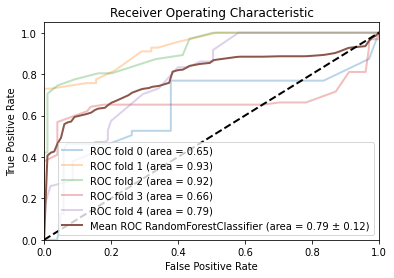

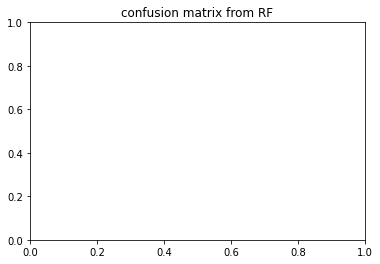

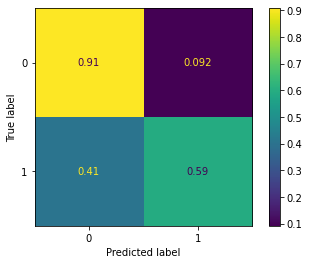

,precision,recall,f1-score,support,auc
0,0.694,0.910,0.782,102.20,0.00
1,0.891,0.586,0.692,102.20,0.00
accuracy,0.750,0.750,0.750,0.75,0.00
macro avg,0.792,0.748,0.737,204.40,0.79
weighted avg,0.792,0.750,0.738,204.40,0.79


coming from


,precision,recall,f1-score,support,auc
0,0.642384,0.941748,0.763780,103.00000,0.000000
1,0.872340,0.431579,0.577465,95.00000,0.000000
accuracy,0.696970,0.696970,0.696970,0.69697,0.000000
macro avg,0.757362,0.686663,0.670622,198.00000,0.648135
weighted avg,0.752717,0.696970,0.674386,198.00000,0.648135


,precision,recall,f1-score,support,auc
0,0.725352,1.000000,0.840816,103.000000,0.000000
1,1.000000,0.648649,0.786885,111.000000,0.000000
accuracy,0.817757,0.817757,0.817757,0.817757,0.000000
macro avg,0.862676,0.824324,0.813851,214.000000,0.927884
weighted avg,0.867810,0.817757,0.812843,214.000000,0.927884


,precision,recall,f1-score,support,auc
0,0.765625,0.989899,0.863436,99.000000,0.000000
1,0.986301,0.705882,0.822857,102.000000,0.000000
accuracy,0.845771,0.845771,0.845771,0.845771,0.000000
macro avg,0.875963,0.847891,0.843147,201.000000,0.917706
weighted avg,0.877610,0.845771,0.842844,201.000000,0.917706


,precision,recall,f1-score,support,auc
0,0.633987,0.960396,0.763780,101.000000,0.00000
1,0.906977,0.410526,0.565217,95.000000,0.00000
accuracy,0.693878,0.693878,0.693878,0.693878,0.00000
macro avg,0.770482,0.685461,0.664498,196.000000,0.66493
weighted avg,0.766303,0.693878,0.667538,196.000000,0.66493


,precision,recall,f1-score,support,auc
0,0.704082,0.657143,0.679803,105.000000,0.000000
1,0.686957,0.731481,0.708520,108.000000,0.000000
accuracy,0.694836,0.694836,0.694836,0.694836,0.000000
macro avg,0.695519,0.694312,0.694162,213.000000,0.793122
weighted avg,0.695398,0.694836,0.694364,213.000000,0.793122


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}
depth_1000_irm1_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.813 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.845 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.606 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.471 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.605 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.926 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.873 total time=   0.0s
[CV 3/5] E

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.576 total time=   0.9s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.566 total time=   0.9s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.510 total time=   0.9s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.584 total time=   0.8s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.927 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.652 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.549 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.560 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.593 total time=   0.4s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.437 total time=   0.4s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.565 total time=   0.5s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.685 total time=   1.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.670 total time=   1.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.552 total time=   1.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.432 total time=   1.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.539 total time=   1.0s


<Figure size 432x288 with 0 Axes>

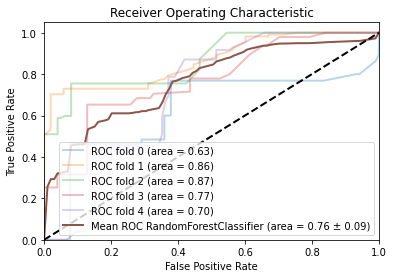

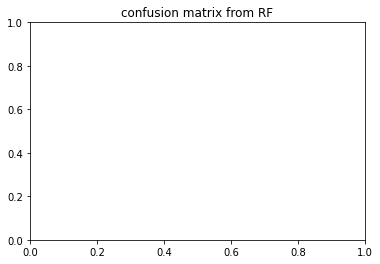

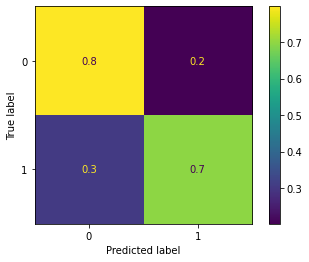

,precision,recall,f1-score,support,auc
0,0.725,0.800,0.753,102.200,0.000
1,0.802,0.696,0.736,102.200,0.000
accuracy,0.747,0.747,0.747,0.747,0.000
macro avg,0.763,0.748,0.744,204.400,0.765
weighted avg,0.764,0.747,0.744,204.400,0.765


coming from


,precision,recall,f1-score,support,auc
0,0.711111,0.621359,0.663212,103.000000,0.000000
1,0.638889,0.726316,0.679803,95.000000,0.000000
accuracy,0.671717,0.671717,0.671717,0.671717,0.000000
macro avg,0.675000,0.673838,0.671508,198.000000,0.626929
weighted avg,0.676459,0.671717,0.671173,198.000000,0.626929


,precision,recall,f1-score,support,auc
0,0.716312,0.980583,0.827869,103.000000,0.000000
1,0.972603,0.639640,0.771739,111.000000,0.000000
accuracy,0.803738,0.803738,0.803738,0.803738,0.000000
macro avg,0.844457,0.810111,0.799804,214.000000,0.864734
weighted avg,0.849248,0.803738,0.798755,214.000000,0.864734


,precision,recall,f1-score,support,auc
0,0.739837,0.919192,0.819820,99.000000,0.000000
1,0.897436,0.686275,0.777778,102.000000,0.000000
accuracy,0.800995,0.800995,0.800995,0.800995,0.000000
macro avg,0.818637,0.802733,0.798799,201.000000,0.865964
weighted avg,0.819813,0.800995,0.798485,201.000000,0.865964


,precision,recall,f1-score,support,auc
0,0.721311,0.871287,0.789238,101.000000,0.000000
1,0.824324,0.642105,0.721893,95.000000,0.000000
accuracy,0.760204,0.760204,0.760204,0.760204,0.000000
macro avg,0.772818,0.756696,0.755566,196.000000,0.768056
weighted avg,0.771241,0.760204,0.756596,196.000000,0.768056


,precision,recall,f1-score,support,auc
0,0.735632,0.609524,0.666667,105.000000,0.000000
1,0.674603,0.787037,0.726496,108.000000,0.000000
accuracy,0.699531,0.699531,0.699531,0.699531,0.000000
macro avg,0.705118,0.698280,0.696581,213.000000,0.699339
weighted avg,0.704688,0.699531,0.697003,213.000000,0.699339


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm2_under_APOE_nbr_allelle_4_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.693 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.564 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.807 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.870 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.638 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.433 total time=   0.0s
[CV 3/

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.247 total time=   1.4s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.587 total time=   1.4s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.871 total time=   1.4s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.764 total time=   1.7s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.655 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.323 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.418 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.669 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.560 total time=   0.7s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.886 total time=   0.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.830 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.648 total time=   1.7s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.341 total time=   1.5s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.569 total time=   1.5s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.898 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.865 total time=   1.8s


<Figure size 432x288 with 0 Axes>

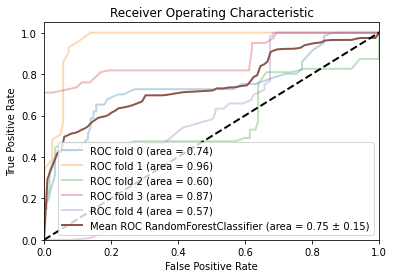

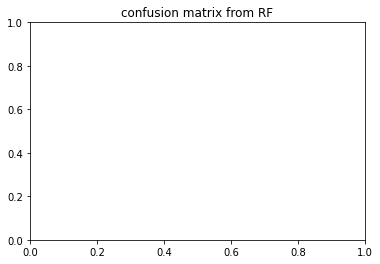

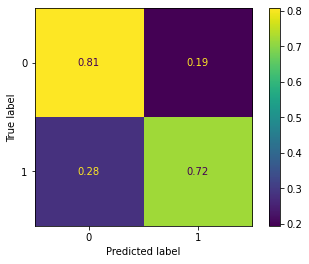

,precision,recall,f1-score,support,auc
0,0.789,0.806,0.753,122.800,0.000
1,0.843,0.721,0.741,122.800,0.000
accuracy,0.762,0.762,0.762,0.762,0.000
macro avg,0.816,0.764,0.747,245.600,0.749
weighted avg,0.817,0.762,0.746,245.600,0.749


coming from


,precision,recall,f1-score,support,auc
0,0.691275,0.844262,0.760148,122.00000,0.000000
1,0.797872,0.619835,0.697674,121.00000,0.000000
accuracy,0.732510,0.732510,0.732510,0.73251,0.000000
macro avg,0.744574,0.732049,0.728911,243.00000,0.740787
weighted avg,0.744354,0.732510,0.729040,243.00000,0.740787


,precision,recall,f1-score,support,auc
0,0.948718,0.902439,0.925000,123.000000,0.00000
1,0.909091,0.952381,0.930233,126.000000,0.00000
accuracy,0.927711,0.927711,0.927711,0.927711,0.00000
macro avg,0.928904,0.927410,0.927616,249.000000,0.96406
weighted avg,0.928666,0.927711,0.927648,249.000000,0.96406


,precision,recall,f1-score,support,auc
0,0.608247,0.967213,0.746835,122.000000,0.000000
1,0.925926,0.396825,0.555556,126.000000,0.000000
accuracy,0.677419,0.677419,0.677419,0.677419,0.000000
macro avg,0.767087,0.682019,0.651195,248.000000,0.596246
weighted avg,0.769649,0.677419,0.649653,248.000000,0.596246


,precision,recall,f1-score,support,auc
0,0.746988,1.000000,0.855172,124.000000,0.000000
1,1.000000,0.652893,0.790000,121.000000,0.000000
accuracy,0.828571,0.828571,0.828571,0.828571,0.000000
macro avg,0.873494,0.826446,0.822586,245.000000,0.871368
weighted avg,0.871945,0.828571,0.822985,245.000000,0.871368


,precision,recall,f1-score,support,auc
0,0.951220,0.317073,0.475610,123.000000,0.000000
1,0.584158,0.983333,0.732919,120.000000,0.000000
accuracy,0.646091,0.646091,0.646091,0.646091,0.000000
macro avg,0.767689,0.650203,0.604265,243.000000,0.570664
weighted avg,0.769955,0.646091,0.602676,243.000000,0.570664


{'criterion': 'entropy', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 100}
depth_1000_irm2_under_APOE_one_hot_score_auc_roc
Fitting 5 folds for each of 30 candidates, totalling 150 fits
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.549 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.322 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.363 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.669 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.871 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.729 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=1000, max_features=sqrt, n_estimators=50;, score=0.351 total time=   0.1s
[CV 3/5] 

[CV 2/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.272 total time=   1.4s
[CV 3/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.605 total time=   1.4s
[CV 4/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.840 total time=   1.4s
[CV 5/5] END criterion=gini, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.762 total time=   1.6s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.747 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.569 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;, score=0.516 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=sqrt, n_estimators=10;,

[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.478 total time=   0.7s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.819 total time=   0.7s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=50;, score=0.889 total time=   0.9s
[CV 1/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.743 total time=   1.8s
[CV 2/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.328 total time=   1.5s
[CV 3/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.587 total time=   1.6s
[CV 4/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.882 total time=   1.5s
[CV 5/5] END criterion=entropy, max_depth=1000, max_features=0.8, n_estimators=100;, score=0.872 total time=   1.8s


<Figure size 432x288 with 0 Axes>

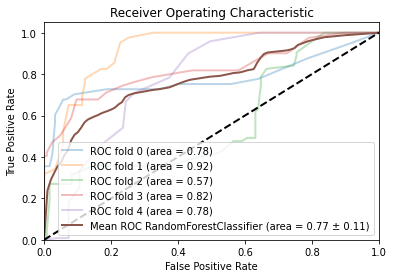

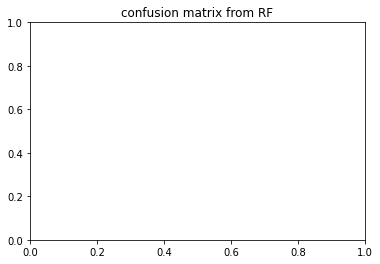

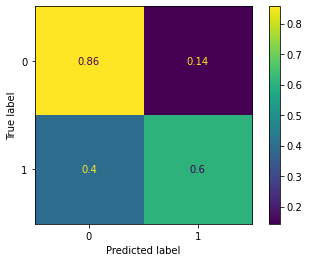

,precision,recall,f1-score,support,auc
0,0.709,0.857,0.762,122.800,0.000
1,0.845,0.606,0.663,122.800,0.000
accuracy,0.731,0.731,0.731,0.731,0.000
macro avg,0.777,0.731,0.712,245.600,0.773
weighted avg,0.777,0.731,0.712,245.600,0.773


coming from


,precision,recall,f1-score,support,auc
0,0.710843,0.967213,0.819444,122.000000,0.000000
1,0.948052,0.603306,0.737374,121.000000,0.000000
accuracy,0.786008,0.786008,0.786008,0.786008,0.000000
macro avg,0.829448,0.785259,0.778409,243.000000,0.778722
weighted avg,0.828960,0.786008,0.778578,243.000000,0.778722


,precision,recall,f1-score,support,auc
0,0.850877,0.788618,0.818565,123.000000,0.000000
1,0.807407,0.865079,0.835249,126.000000,0.000000
accuracy,0.827309,0.827309,0.827309,0.827309,0.000000
macro avg,0.829142,0.826849,0.826907,249.000000,0.920732
weighted avg,0.828880,0.827309,0.827008,249.000000,0.920732


,precision,recall,f1-score,support,auc
0,0.540541,0.983607,0.697674,122.000000,0.000000
1,0.923077,0.190476,0.315789,126.000000,0.000000
accuracy,0.580645,0.580645,0.580645,0.580645,0.000000
macro avg,0.731809,0.587041,0.506732,248.000000,0.572014
weighted avg,0.734894,0.580645,0.503652,248.000000,0.572014


,precision,recall,f1-score,support,auc
0,0.695122,0.919355,0.791667,124.000000,0.000000
1,0.876543,0.586777,0.702970,121.000000,0.000000
accuracy,0.755102,0.755102,0.755102,0.755102,0.000000
macro avg,0.785833,0.753066,0.747318,245.000000,0.818782
weighted avg,0.784722,0.755102,0.747862,245.000000,0.818782


,precision,recall,f1-score,support,auc
0,0.747573,0.626016,0.681416,123.000000,0.00000
1,0.671429,0.783333,0.723077,120.000000,0.00000
accuracy,0.703704,0.703704,0.703704,0.703704,0.00000
macro avg,0.709501,0.704675,0.702246,243.000000,0.77561
weighted avg,0.709971,0.703704,0.701989,243.000000,0.77561


{'criterion': 'gini', 'max_depth': 1000, 'max_features': 'log2', 'n_estimators': 50}


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.750208,0.770566,0.751696
irm1_both_APOE_one_hot,0.768887,0.741533,0.709190
irm2_both_APOE_nbr_allelle_4,0.726013,0.738254,0.685610
irm2_both_APOE_one_hot,0.731852,0.736853,0.729036
irm1_under_APOE_nbr_allelle_4,0.773982,0.779054,0.772329
irm1_under_APOE_one_hot,0.827025,0.784149,0.806159
irm2_under_APOE_nbr_allelle_4,0.742865,0.725629,0.755246
irm2_under_APOE_one_hot,0.735519,0.735790,0.753466


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.943973,0.882495,0.946881
irm1_both_APOE_one_hot,0.636099,0.937553,0.980769
irm2_both_APOE_nbr_allelle_4,0.588351,0.643106,0.489282
irm2_both_APOE_one_hot,0.600464,0.572967,0.611314
irm1_under_APOE_nbr_allelle_4,0.620797,0.462085,0.448237
irm1_under_APOE_one_hot,0.462340,0.613183,0.546857
irm2_under_APOE_nbr_allelle_4,0.850156,0.814862,0.810933
irm2_under_APOE_one_hot,0.850799,0.896694,0.739127


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.772342,0.696301,0.837801
irm1_both_APOE_one_hot,0.803586,0.615610,0.836028
irm2_both_APOE_nbr_allelle_4,0.530930,0.649185,0.648738
irm2_both_APOE_one_hot,0.651113,0.622860,0.633238
irm1_under_APOE_nbr_allelle_4,0.762522,0.694820,0.790355
irm1_under_APOE_one_hot,0.762271,0.669035,0.765004
irm2_under_APOE_nbr_allelle_4,0.745936,0.761179,0.748625
irm2_under_APOE_one_hot,0.762437,0.784415,0.773172


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.101686,0.154214,0.093821
irm1_both_APOE_one_hot,0.070399,0.152251,0.049849
irm2_both_APOE_nbr_allelle_4,0.093992,0.161829,0.139170
irm2_both_APOE_one_hot,0.141375,0.169026,0.125678
irm1_under_APOE_nbr_allelle_4,0.096035,0.189225,0.119246
irm1_under_APOE_one_hot,0.073337,0.129257,0.093300
irm2_under_APOE_nbr_allelle_4,0.126853,0.146100,0.152597
irm2_under_APOE_one_hot,0.173320,0.146668,0.113451


the score on cross_val: 


,10,100,1000
irm1_both_APOE_nbr_allelle_4,0.772342,0.696301,0.837801
irm1_both_APOE_one_hot,0.803586,0.615610,0.836028
irm2_both_APOE_nbr_allelle_4,0.530930,0.649185,0.648738
irm2_both_APOE_one_hot,0.651113,0.622860,0.633238
irm1_under_APOE_nbr_allelle_4,0.762522,0.694820,0.790355
irm1_under_APOE_one_hot,0.762271,0.669035,0.765004
irm2_under_APOE_nbr_allelle_4,0.745936,0.761179,0.748625
irm2_under_APOE_one_hot,0.762437,0.784415,0.773172


irm1_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.708 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.518 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.778 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.787 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.874 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.708 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.518 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.778 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.787 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.874 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=linear;, score=0.708 total time=   0.0s
[CV 2

<Figure size 432x288 with 0 Axes>

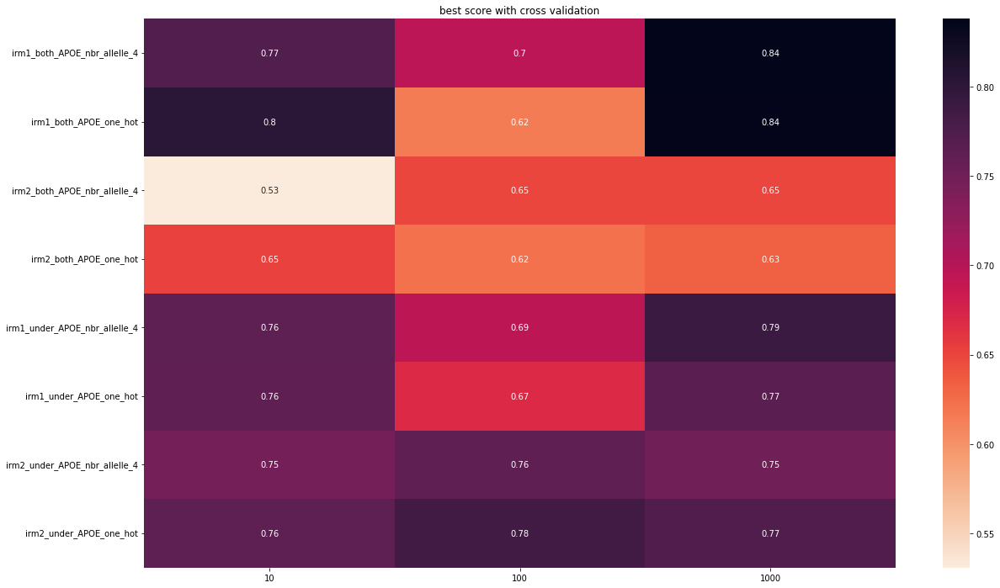

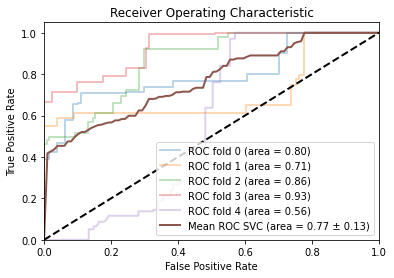

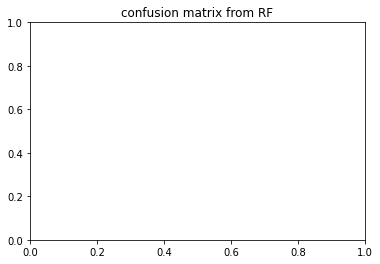

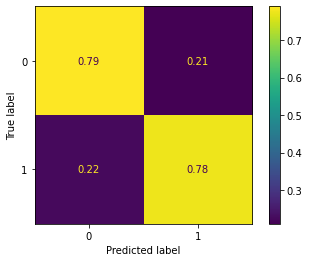

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.693 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.546 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.799 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.797 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.885 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.693 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.546 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.799 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.797 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.885 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=l

<Figure size 432x288 with 0 Axes>

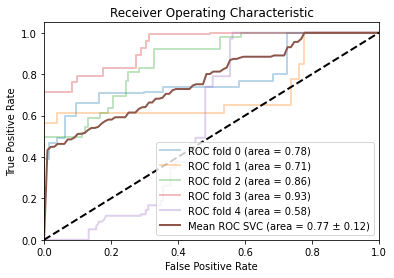

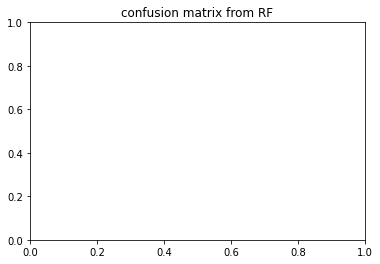

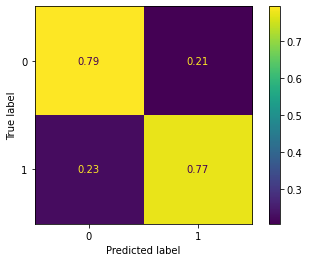

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.424 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.540 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.807 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.767 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.935 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.424 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.540 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.807 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.767 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.935 total time=   0.0s
[CV 1/5] END ..............C=100, ke

<Figure size 432x288 with 0 Axes>

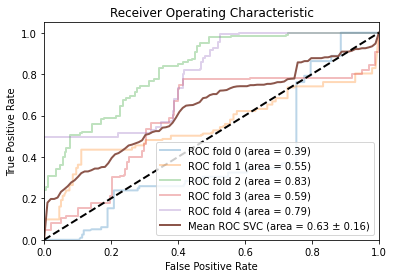

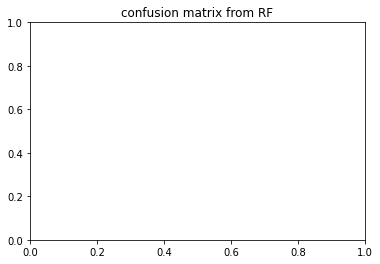

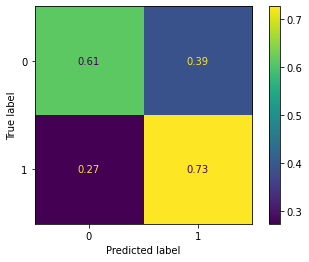

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_both_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.425 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.577 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.829 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.789 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.954 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.425 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.577 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.829 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.789 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.954 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=l

<Figure size 432x288 with 0 Axes>

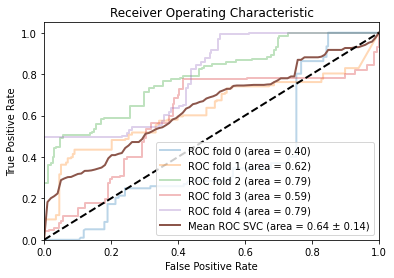

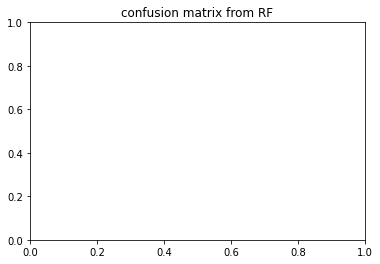

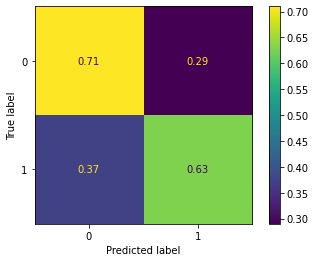

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.758 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.872 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.938 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.968 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.553 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.758 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.872 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.938 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.968 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.553 total time=   0.0s
[CV 1/5] END ..............C=100, k

<Figure size 432x288 with 0 Axes>

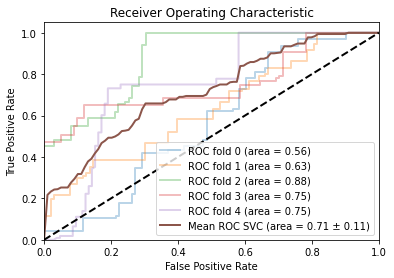

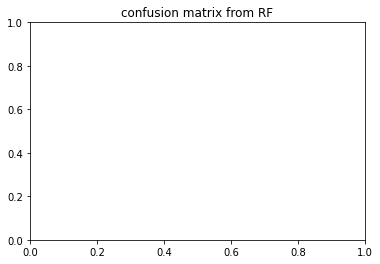

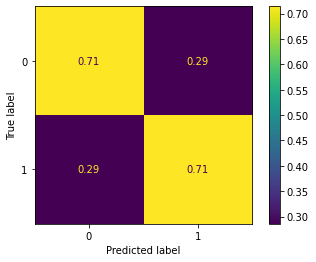

{'C': 1, 'kernel': 'linear', 'probability': True}
irm1_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.750 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.875 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.940 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.970 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.557 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.750 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.875 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.940 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.970 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.557 total time=   0.0s
[CV 1/5] END ..............C=100, kernel=

<Figure size 432x288 with 0 Axes>

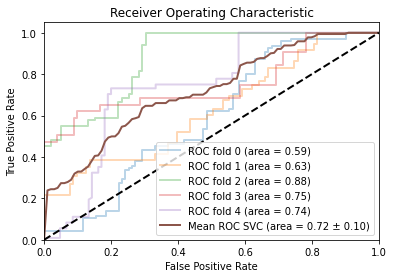

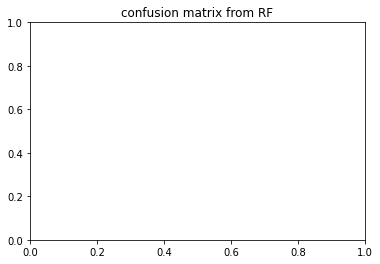

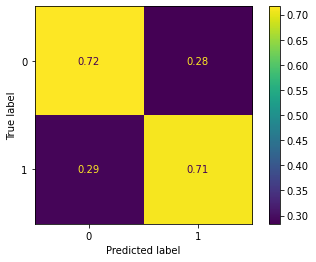

{'C': 1, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.611 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.703 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.720 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.645 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.887 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.611 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.704 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.720 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.645 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.887 total time=   0.0s
[CV 1/5] END ..............C=100, k

<Figure size 432x288 with 0 Axes>

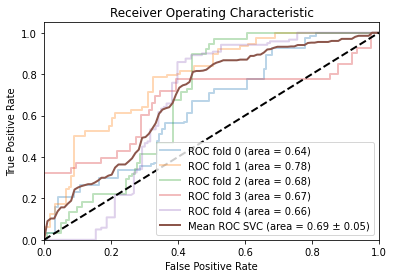

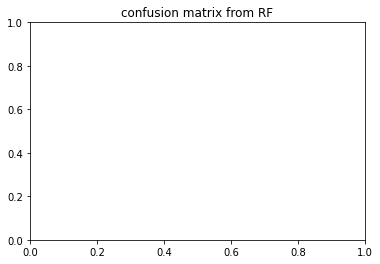

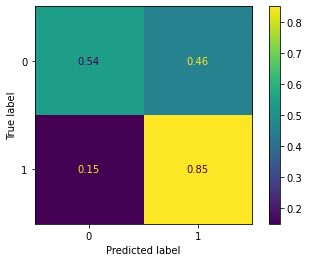

{'C': 10, 'kernel': 'linear', 'probability': True}
irm2_under_APOE_one_hot
kernel: linear
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ................C=1, kernel=linear;, score=0.612 total time=   0.0s
[CV 2/5] END ................C=1, kernel=linear;, score=0.717 total time=   0.0s
[CV 3/5] END ................C=1, kernel=linear;, score=0.698 total time=   0.0s
[CV 4/5] END ................C=1, kernel=linear;, score=0.634 total time=   0.0s
[CV 5/5] END ................C=1, kernel=linear;, score=0.868 total time=   0.0s
[CV 1/5] END ...............C=10, kernel=linear;, score=0.612 total time=   0.0s
[CV 2/5] END ...............C=10, kernel=linear;, score=0.718 total time=   0.0s
[CV 3/5] END ...............C=10, kernel=linear;, score=0.698 total time=   0.0s
[CV 4/5] END ...............C=10, kernel=linear;, score=0.634 total time=   0.0s
[CV 5/5] END ...............C=10, kernel=linear;, score=0.868 total time=   0.0s
[CV 1/5] END ..............C=100, kernel

<Figure size 432x288 with 0 Axes>

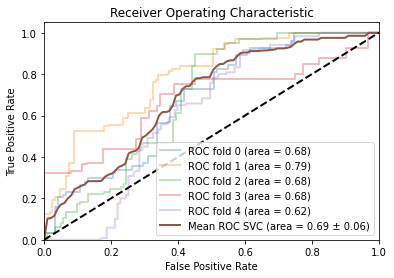

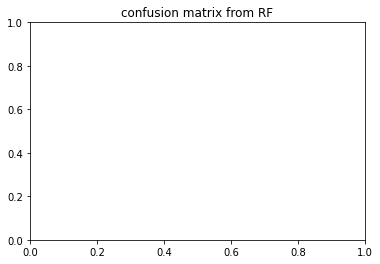

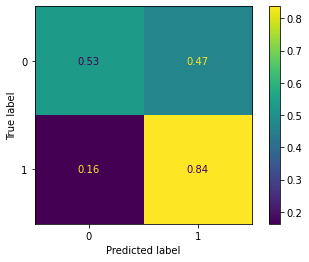

{'C': 10, 'kernel': 'linear', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.770 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.954 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.799 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.508 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.763 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.800 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.916 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.818 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.708 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.820 total time=   0.0s
[CV 1/5] END .....C=1, gamma=0.0001, k

<Figure size 432x288 with 0 Axes>

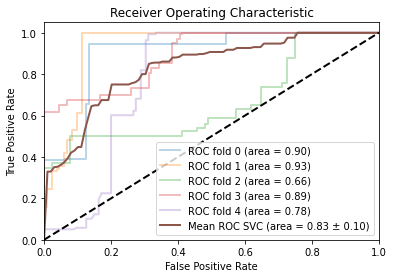

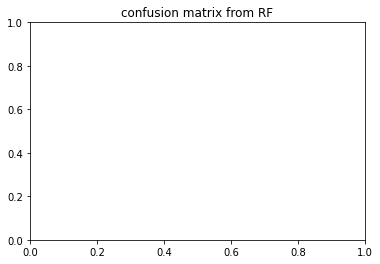

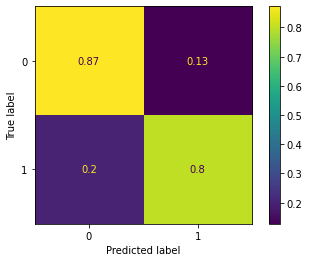

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.765 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.963 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.799 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.502 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.773 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.772 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.933 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.824 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.695 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.830 total time=   0.0s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

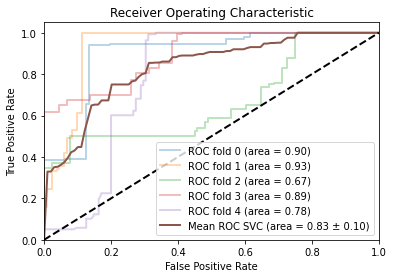

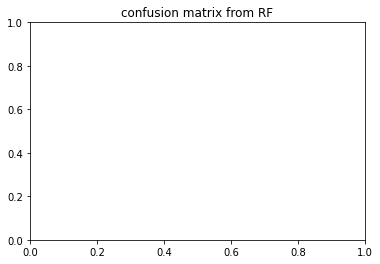

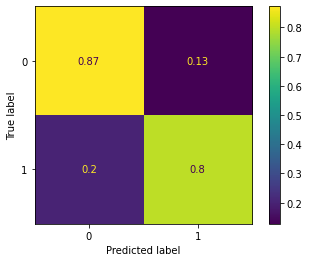

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.581 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.668 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.843 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.418 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.964 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.605 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.585 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.870 total time=   0.2s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.614 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.938 total time=   0.2s
[CV 1/5] END .....C=1, ga

<Figure size 432x288 with 0 Axes>

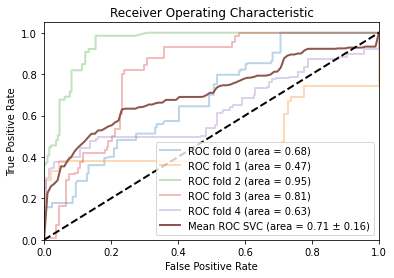

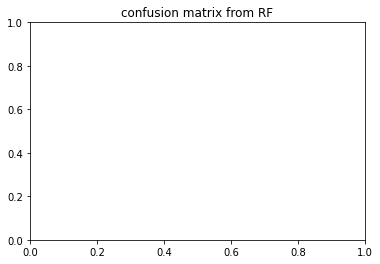

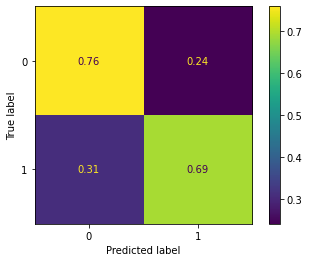

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_both_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.579 total time=   0.1s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.653 total time=   0.1s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.843 total time=   0.1s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.429 total time=   0.1s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.966 total time=   0.1s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.602 total time=   0.1s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.600 total time=   0.1s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.874 total time=   0.2s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.621 total time=   0.1s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.944 total time=   0.2s
[CV 1/5] END .....C=1, gamma=0.

<Figure size 432x288 with 0 Axes>

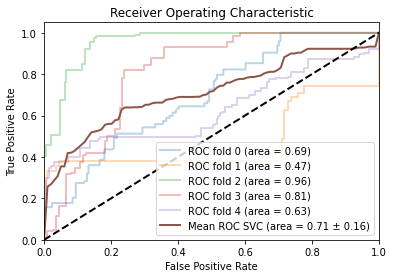

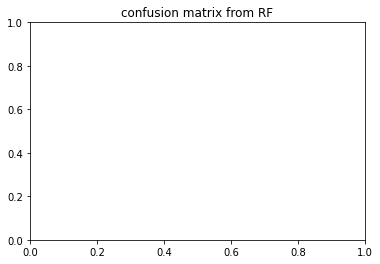

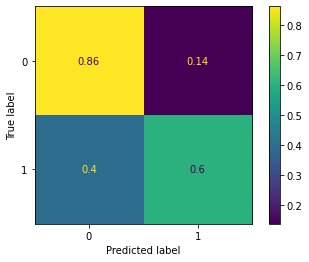

{'C': 1, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.897 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.940 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.973 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.998 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.570 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.814 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.934 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.905 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.916 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.541 total time=   0.0s
[CV 1/5] END .....C=1, g

<Figure size 432x288 with 0 Axes>

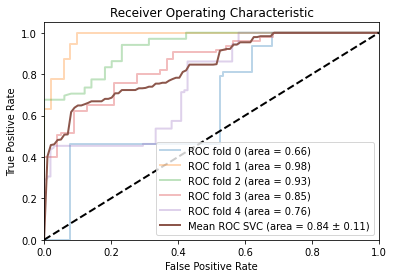

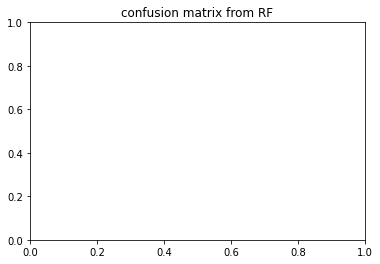

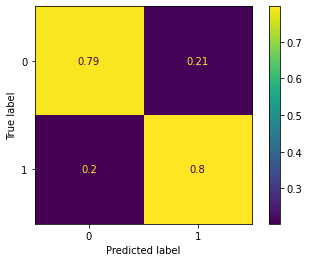

{'C': 1, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm1_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.892 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.938 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.972 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.998 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.573 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.814 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.934 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.903 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.916 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.538 total time=   0.0s
[CV 1/5] END .....C=1, gamma=

<Figure size 432x288 with 0 Axes>

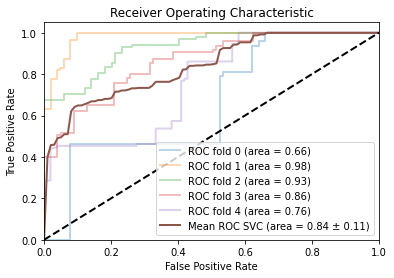

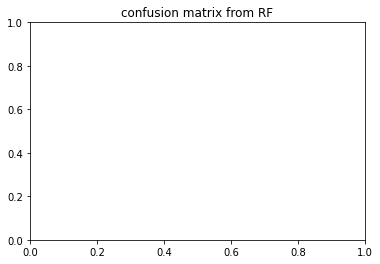

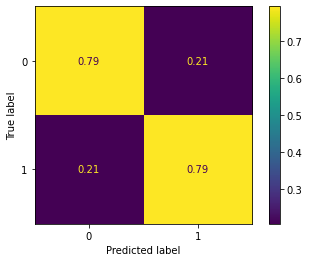

{'C': 1, 'gamma': 'scale', 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.730 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.461 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.619 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.842 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.945 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.771 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.412 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.702 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.862 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.966 total time=   0.1s
[CV 1/5] END .....C=1, 

<Figure size 432x288 with 0 Axes>

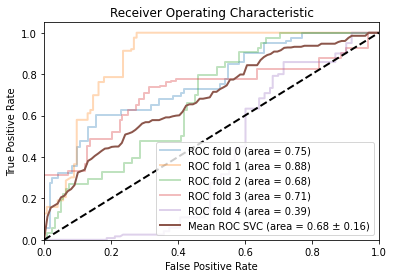

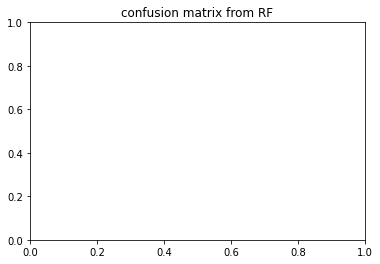

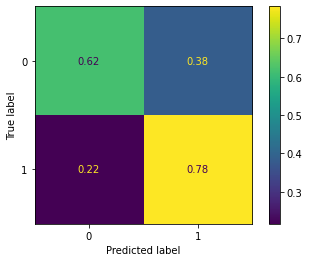

{'C': 10, 'gamma': 0.0001, 'kernel': 'rbf', 'probability': True}
irm2_under_APOE_one_hot
kernel: rbf
Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.738 total time=   0.0s
[CV 2/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.459 total time=   0.0s
[CV 3/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.613 total time=   0.0s
[CV 4/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.833 total time=   0.0s
[CV 5/5] END ......C=1, gamma=scale, kernel=rbf;, score=0.936 total time=   0.0s
[CV 1/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.796 total time=   0.0s
[CV 2/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.410 total time=   0.0s
[CV 3/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.695 total time=   0.0s
[CV 4/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.863 total time=   0.0s
[CV 5/5] END ......C=1, gamma=0.001, kernel=rbf;, score=0.957 total time=   0.1s
[CV 1/5] END .....C=1, gamma=

<Figure size 432x288 with 0 Axes>

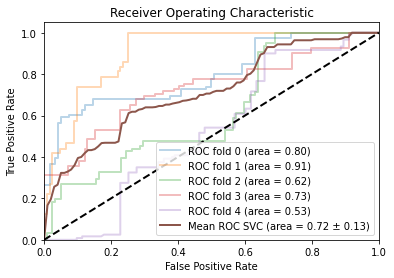

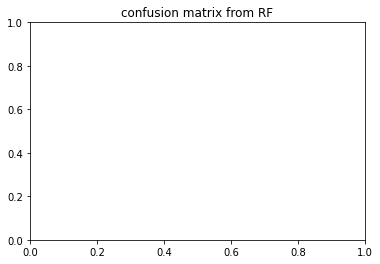

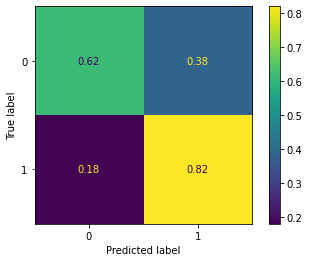

{'C': 1, 'gamma': 0.001, 'kernel': 'rbf', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.697 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.964 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.783 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.605 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.854 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.523 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.951 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.784 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kern

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.540 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.321 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.862 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.003 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.442 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.325 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.686 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.991 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.702 total time=   0.0s
[CV 4/5] END C=1, coef0=0

[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.856 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.991 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.773 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.525 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.673 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.139 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.225 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.437 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=1, coef0=1

[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.756 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.615 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.785 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.748 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.868 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.762 total time=   0.2s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.428 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.691 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.119 total time=   0.1s
[CV 3/5] END C=10,

[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.003 total time=   0.1s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.452 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.327 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.670 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.976 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.677 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.365 total time=   0.0s
[CV 5/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.756 total time=   0.0s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=1

[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.820 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.805 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.764 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.700 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.802 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.821 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.945 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.799 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.486 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.909 total time=   0.0s
[CV 1/5] END C=

[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.127 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.689 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.417 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.325 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.0001, kernel=poly;, score=0.865 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.0001, kernel=poly;, score=0.210 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=0.0001, kernel=poly;, score=0.555 total time=   0.2s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=0.0001, kernel=poly;, score=0.417 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=0.0001, kernel=poly;, score=0.325 total time=   0.1s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.461 total time=   0.2s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.329 total time=   0.2s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.826 total time=   0.0s
[CV 2/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.920 total time=   0.0s
[CV 3/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.800 total time=   0.0s
[CV 4/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.449 total time=   0.0s
[CV 5/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.931 total time=   0.0s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=0.001, kernel=poly;, score=0.827 total time=   0.0s
[CV 2/5] END C=100, coef0=0.5, degree=3, gamma=0.001, kernel=poly;, score=0.676 total time=   0.0s
[CV 3/5] END C=100, coef0=0.5, degree=3, gamma=0.001, kernel=poly;, score=0.880 total time=   0.0s
[CV 4/5]

[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.678 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.861 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.685 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.934 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.817 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.644 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.882 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.741 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.830 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=7, gamma=scale, kernel=poly;, score=0.821 total time=   0.0s
[CV 2

<Figure size 432x288 with 0 Axes>

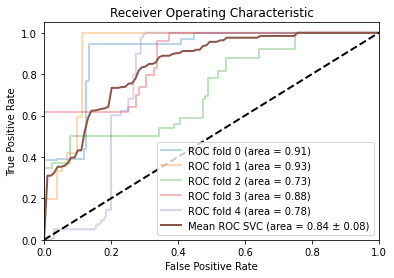

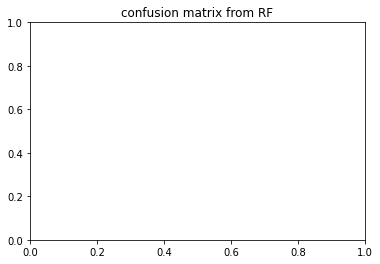

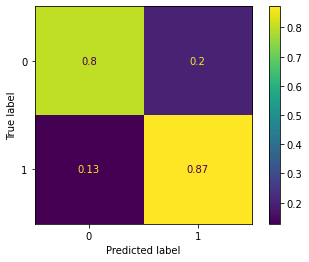

{'C': 1, 'coef0': 1.0, 'degree': 3, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm1_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.696 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.964 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.785 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.603 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.858 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.524 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.785 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degr

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.541 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.320 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.003 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.442 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.323 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.672 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.991 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.725 total time=   0.0s
[CV 4/5] END C=1, coef0=0

[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.852 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.991 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.780 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.520 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.675 total time=   0.2s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.856 total time=   0.2s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.003 total time=   0.2s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.438 total time=   0.2s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.319 total time=   0.2s
[CV 1/5] END C=1, coef0=1

[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.768 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.614 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.800 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.741 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.119 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.761 total time=   0.2s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.437 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.738 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.107 total time=   0.1s
[CV 3/5] END C=10,

[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.003 total time=   0.1s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.220 total time=   0.2s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.455 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.327 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.660 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.978 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.714 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.365 total time=   0.0s
[CV 5/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.775 total time=   0.0s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=1

[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.820 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.730 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.880 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.702 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.847 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.814 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.854 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.788 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.695 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.824 total time=   0.0s
[CV 1/5] END C=

[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.310 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.596 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.964 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.686 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.620 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.701 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.206 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.663 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.438 total time=   0.1s
[CV 5/5] 

[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.810 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.631 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.303 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.857 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.2s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.466 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.327 total time=   0.1s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.825 total time=   0.0s
[CV 2/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.927 total time=   0.0s
[CV 3

[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.482 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.912 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.808 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.709 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.868 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.680 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.939 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.817 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.655 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.906 total time=   0.0s
[CV 4/5

<Figure size 432x288 with 0 Axes>

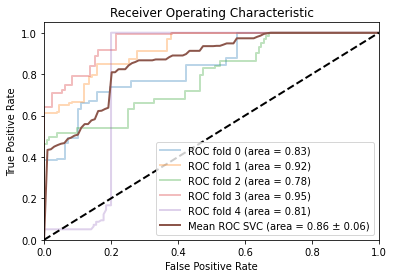

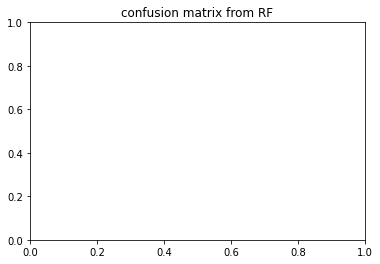

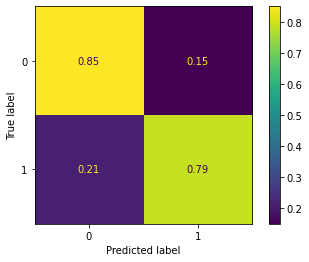

{'C': 100, 'coef0': 1.0, 'degree': 9, 'gamma': 0.001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.890 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.625 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.775 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.546 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.998 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.787 total time=   0.4s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.562 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.731 total time=   0.4s
[CV 4/5] END C=1, coef0=0.

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.4s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.212 total time=   0.4s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.247 total time=   0.5s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.222 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.806 total time=   0.2s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.370 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.717 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.448 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.998 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.793 total time=   0.4s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.640 total time=   0.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.776 total time=   0.4s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.557 total time=   0.4s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.968 total time=   0.5s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.203 total time=   0.5s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.607 total time=   0.5s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.122 total time=   0.4s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.878 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.479 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.756 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.486 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.994 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.829 total time=   0.4s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.501 total time=   0.5s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.750 total time=   0.4s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.741 total time=   0.5s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.456 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.961 total time=   0.5s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.216 total time=   0.4s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.609 total time=   0.4s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.247 total time=   0.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.253 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.828 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.382 total time=   0.1s
[CV 3/5] END C=

[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.826 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.557 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.979 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.504 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.524 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.838 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.667 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.951 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.605 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.563 total time=   0.0s
[CV 3/5] END C=10,

[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.245 total time=   0.4s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.152 total time=   0.4s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.539 total time=   0.4s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.856 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.441 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.702 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.477 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.983 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.825 total time=   0.4s
[CV 2/

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.411 total time=   0.4s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.625 total time=   0.5s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.712 total time=   0.4s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.371 total time=   0.4s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.500 total time=   0.5s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.219 total time=   0.4s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.609 total time=   0.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.280 total time=   0.4s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 1

[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.937 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.710 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.567 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.831 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.507 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.991 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.548 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.538 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.842 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.610 total time=   0.0s
[CV 5/5] 

<Figure size 432x288 with 0 Axes>

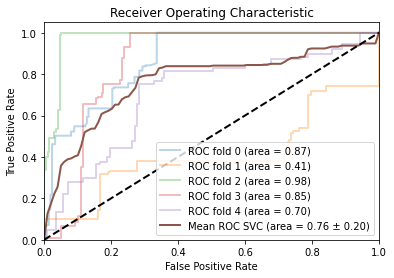

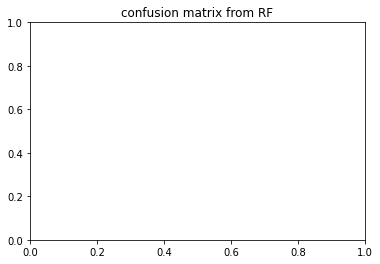

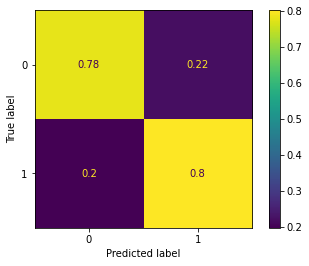

{'C': 1, 'coef0': 0.5, 'degree': 5, 'gamma': 0.0001, 'kernel': 'poly', 'probability': True}
irm2_both_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.892 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.626 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.779 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.547 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.998 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.781 total time=   0.4s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.563 total time=   0.4s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.731 total time=   0.4s
[CV 4/5] END C=1, coef0=0.0, degr

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.611 total time=   0.4s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.4s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.213 total time=   0.4s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.396 total time=   0.4s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.248 total time=   0.4s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.032 total time=   0.4s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.821 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.387 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.728 total time=   0.1s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.452 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.998 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.797 total time=   0.4s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.637 total time=   0.4s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.776 total time=   0.4s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.564 total time=   0.4s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.967 total time=   0.5s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.202 total time=   0.4s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.603 total time=   0.5s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.431 total time=   0.5s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.122 total time=   0.4s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.037 total time=   0.4s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.874 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.490 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.762 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.486 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.998 total time=   0.1s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.818 total time=   0.4s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.506 total time=   0.4s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.749 total time=   0.4s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.463 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.960 total time=   0.4s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.215 total time=   0.4s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.395 total time=   0.4s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.035 total time=   0.4s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.840 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.389 total time=   0.1s
[CV 3/5] END C=

[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.825 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.565 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.980 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.499 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.551 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.847 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.682 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.959 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.592 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.625 total time=   0.0s
[CV 3/5] END C=10,

[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.480 total time=   0.4s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.4s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.151 total time=   0.4s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.539 total time=   0.4s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.891 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.461 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.708 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.482 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.993 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.822 total time=   0.4s
[CV 2/

[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.408 total time=   0.5s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.620 total time=   0.4s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.716 total time=   0.4s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.380 total time=   0.5s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.500 total time=   0.4s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.5s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.250 total time=   0.5s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.274 total time=   0.4s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.034 total time=   0.4s
[CV 1

[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.705 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.563 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.831 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.512 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.991 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.551 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.553 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.849 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.624 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.965 total time=   0.0s
[CV 1/5] E

<Figure size 432x288 with 0 Axes>

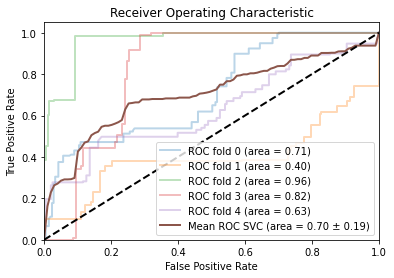

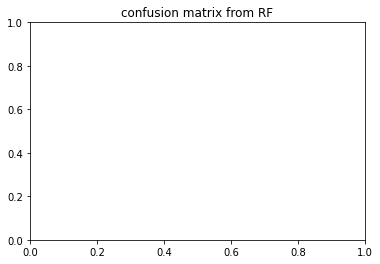

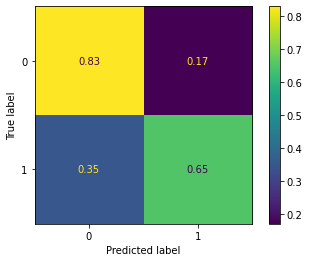

{'C': 10, 'coef0': 0.0, 'degree': 3, 'gamma': 0.001, 'kernel': 'poly', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.932 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.977 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.954 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.969 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.515 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.920 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.915 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.908 total time=   0.0s
[CV 4/5] END C=1, coef0=0.

[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.682 total time=   0.0s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.904 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.001 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.973 total time=   0.1s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.101 total time=   0.0s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.587 total time=   0.0s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.914 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.872 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.891 total time=   0.0s
[CV 4/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.956 total time=   0.0s
[CV 5/5] END C=1, coef0=0

[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=1.000 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.977 total time=   0.0s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.875 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.412 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.0s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.005 total time=   0.0s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.967 total time=   0.0s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.099 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.580 total time=   0.1s
[CV 1/5] END C=1, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.890 total time=   0.0s
[CV 2/5] END C=1, coef0=1

[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.895 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.887 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.926 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.923 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.540 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.190 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.346 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.799 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.649 total time=   0.0s
[CV 1/5] END C=10, c

[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.0s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.904 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.000 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.975 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.102 total time=   0.0s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.588 total time=   0.0s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.904 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.844 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.935 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.873 total time=   0.0s
[CV 5/5] END C=

[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.997 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.537 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.783 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.926 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.894 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.887 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.576 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.906 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.976 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.982 total time=   0.0s
[CV 4/5] END C=

[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.700 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.568 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.764 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.576 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.657 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.0001, kernel=poly;, score=0.765 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.0001, kernel=poly;, score=0.575 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.0s
[CV 4/5

[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.000 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.978 total time=   0.0s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.106 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.594 total time=   0.0s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.908 total time=   0.0s
[CV 2/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.967 total time=   0.0s
[CV 3/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.980 total time=   0.0s
[CV 4/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.942 total time=   0.0s
[CV 5/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.425 total time=   0.0s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=0.001, kernel=poly;, score=0.820 total time=   0.0s
[CV 2/

[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.821 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.881 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.948 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.946 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.495 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.766 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.876 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.965 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.997 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.0001, kernel=poly;, score=0.576 total time=   0.0s
[CV 1

<Figure size 432x288 with 0 Axes>

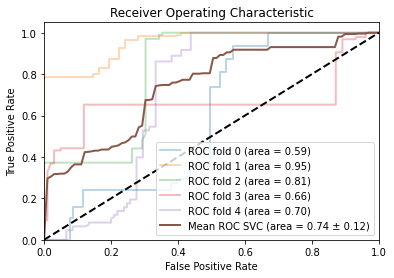

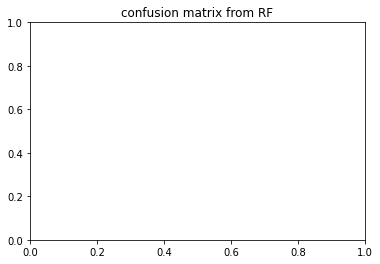

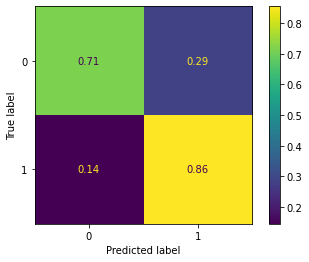

{'C': 1, 'coef0': 0.0, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm1_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.922 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.975 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.943 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.969 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.513 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.918 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.093 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.907 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, de

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.206 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.314 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.904 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.001 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.0s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.101 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.586 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.910 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.856 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.886 total time=   0.0s
[CV 4/5] END C=1, coef0=0

[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.922 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.346 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.907 total time=   0.0s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=1.000 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.977 total time=   0.0s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.874 total time=   0.0s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.414 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.893 total time=   0.0s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.005 total time=   0.0s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.966 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5

[CV 4/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.161 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=3, gamma=0.0001, kernel=poly;, score=0.616 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.892 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.890 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.900 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.916 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.522 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.811 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.404 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.789 total time=   0.1s
[CV 4/5] END C=10,

[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.026 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.378 total time=   0.0s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.689 total time=   0.0s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.096 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.000 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.102 total time=   0.0s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.588 total time=   0.0s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.900 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.839 total time=   0.0s
[CV 3/5] END C=

[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.928 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.976 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.943 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.493 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.801 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.906 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.969 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.994 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.536 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.780 total time=   0.0s
[CV 2/5] END C=10, 

[CV 1/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.386 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.349 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.658 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.822 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.838 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.861 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.685 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.551 total time=   0.0s
[CV 1

[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.870 total time=   0.0s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.353 total time=   0.0s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.197 total time=   0.0s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.164 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.925 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.380 total time=   0.0s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.313 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.904 total time=   0.0s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.000 total time=   0.0s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.977 total time=   0.0s
[CV 4/5

[CV 2/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.891 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.948 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.959 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.570 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.906 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.977 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.980 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.939 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.445 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.816 total time=   0.0s
[CV 2/

<Figure size 432x288 with 0 Axes>

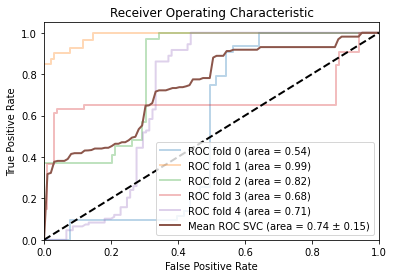

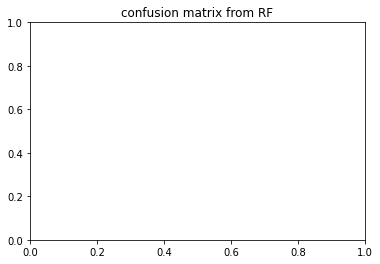

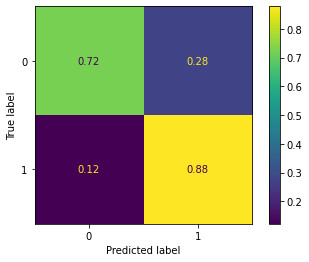

{'C': 10, 'coef0': 0.0, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.889 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.540 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.691 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.772 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.936 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.929 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.475 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.585 total time=   0.1s
[CV 4/5] END C=1, coef0=

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.520 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.047 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.100 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.531 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.355 total time=   0.1s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.198 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.829 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.645 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.510 total time=   0.0s
[CV 4/5] END C=1, coef0=0

[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.903 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.366 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.677 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.812 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.949 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.100 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.533 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.354 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=1, coef0=1

[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.888 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.640 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.651 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.763 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.925 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.408 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.563 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.274 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.121 total time=   0.1s
[CV 1/5] END C=10, c

[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.100 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.529 total time=   0.1s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.354 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.199 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.810 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.670 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.525 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.833 total time=   0.0s
[CV 5/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.936 total time=   0.0s
[CV 1/5] END C=

[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.912 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.671 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.585 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.519 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.780 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.921 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.761 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.415 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.698 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.820 total time=   0.0s
[CV 5/5] END C=1

[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.275 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.881 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.668 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.649 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.751 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.909 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.355 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.567 total time=   0.1s
[CV 4/5]

[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.550 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.398 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.734 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.100 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.526 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.356 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.199 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.711 total time=   0.0s
[CV 2

[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.727 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.501 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.644 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.837 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.924 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.668 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.616 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.683 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.738 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.907 total time=   0.0s
[CV 1/5] E

<Figure size 432x288 with 0 Axes>

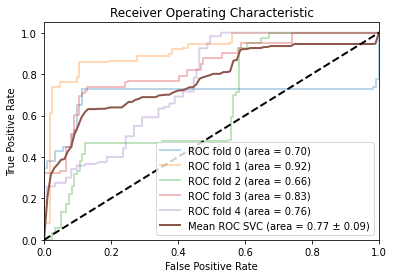

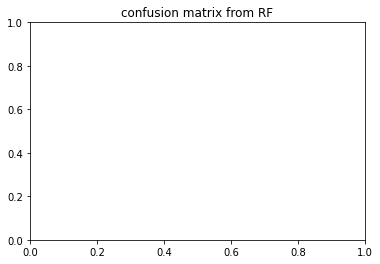

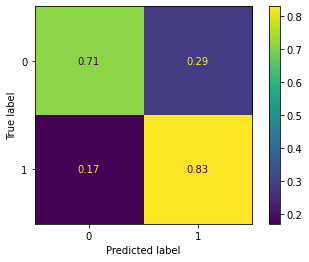

{'C': 10, 'coef0': 0.0, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm2_under_APOE_one_hot
kernel: poly
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.883 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.545 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.669 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.774 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, degree=3, gamma=scale, kernel=poly;, score=0.934 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.927 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.476 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, degree=3, gamma=0.001, kernel=poly;, score=0.593 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, d

[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.226 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.100 total time=   0.1s
[CV 2/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.534 total time=   0.1s
[CV 3/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.345 total time=   0.1s
[CV 4/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.198 total time=   0.1s
[CV 5/5] END C=1, coef0=0.1, degree=5, gamma=0.0001, kernel=poly;, score=0.060 total time=   0.1s
[CV 1/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.852 total time=   0.0s
[CV 2/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.648 total time=   0.0s
[CV 3/5] END C=1, coef0=0.1, degree=7, gamma=scale, kernel=poly;, score=0.537 total time=   0.0s
[CV 4/5] END C=1, coef0=0

[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=scale, kernel=poly;, score=0.953 total time=   0.0s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.903 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.367 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.681 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.813 total time=   0.1s
[CV 5/5] END C=1, coef0=0.5, degree=9, gamma=0.001, kernel=poly;, score=0.945 total time=   0.1s
[CV 1/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.101 total time=   0.1s
[CV 2/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.535 total time=   0.1s
[CV 3/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.345 total time=   0.1s
[CV 4/5] END C=1, coef0=0.5, degree=9, gamma=0.0001, kernel=poly;, score=0.198 total time=   0.1s
[CV 5/5] END C=1, coef0=0.

[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.888 total time=   0.0s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.650 total time=   0.0s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.624 total time=   0.0s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.761 total time=   0.0s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=scale, kernel=poly;, score=0.924 total time=   0.0s
[CV 1/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.085 total time=   0.1s
[CV 2/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 3/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 4/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.724 total time=   0.1s
[CV 5/5] END C=10, coef0=0.0, degree=5, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=10, c

[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.001, kernel=poly;, score=0.062 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.101 total time=   0.1s
[CV 2/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.531 total time=   0.1s
[CV 3/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.345 total time=   0.1s
[CV 4/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.198 total time=   0.1s
[CV 5/5] END C=10, coef0=0.1, degree=7, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.820 total time=   0.0s
[CV 2/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.678 total time=   0.0s
[CV 3/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.529 total time=   0.0s
[CV 4/5] END C=10, coef0=0.1, degree=9, gamma=scale, kernel=poly;, score=0.829 total time=   0.0s
[CV 5/5] END C=

[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=scale, kernel=poly;, score=0.912 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.691 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.602 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.499 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.772 total time=   0.0s
[CV 5/5] END C=10, coef0=1.0, degree=3, gamma=0.001, kernel=poly;, score=0.907 total time=   0.0s
[CV 1/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.780 total time=   0.0s
[CV 2/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.409 total time=   0.0s
[CV 3/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.682 total time=   0.0s
[CV 4/5] END C=10, coef0=1.0, degree=3, gamma=0.0001, kernel=poly;, score=0.823 total time=   0.0s
[CV 5/5] END C=1

[CV 4/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.276 total time=   0.1s
[CV 5/5] END C=100, coef0=0.0, degree=5, gamma=0.0001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.886 total time=   0.0s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.739 total time=   0.0s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.580 total time=   0.0s
[CV 4/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.765 total time=   0.0s
[CV 5/5] END C=100, coef0=0.0, degree=7, gamma=scale, kernel=poly;, score=0.913 total time=   0.0s
[CV 1/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 2/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.359 total time=   0.1s
[CV 3/5] END C=100, coef0=0.0, degree=7, gamma=0.001, kernel=poly;, score=0.426 total time=   0.1s
[CV 4/5]

[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.557 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.734 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.001, kernel=poly;, score=0.500 total time=   0.1s
[CV 1/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.101 total time=   0.1s
[CV 2/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.530 total time=   0.1s
[CV 3/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.347 total time=   0.1s
[CV 4/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.199 total time=   0.1s
[CV 5/5] END C=100, coef0=0.1, degree=9, gamma=0.0001, kernel=poly;, score=0.061 total time=   0.1s
[CV 1/5] END C=100, coef0=0.5, degree=3, gamma=scale, kernel=poly;, score=0.720 total time=   0.0s
[CV 2

[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.733 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.502 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.645 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.834 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=scale, kernel=poly;, score=0.922 total time=   0.0s
[CV 1/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.673 total time=   0.0s
[CV 2/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.633 total time=   0.0s
[CV 3/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.668 total time=   0.0s
[CV 4/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.722 total time=   0.0s
[CV 5/5] END C=100, coef0=1.0, degree=5, gamma=0.001, kernel=poly;, score=0.906 total time=   0.0s
[CV 1/5] E

<Figure size 432x288 with 0 Axes>

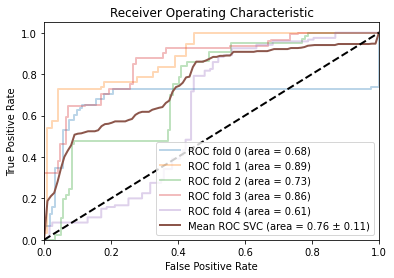

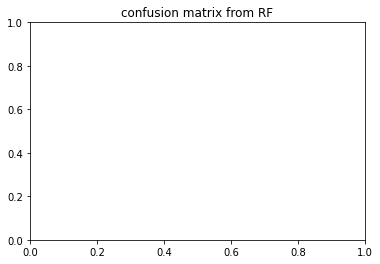

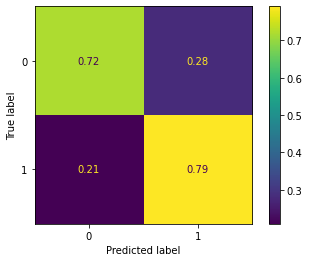

{'C': 1, 'coef0': 0.1, 'degree': 9, 'gamma': 'scale', 'kernel': 'poly', 'probability': True}
irm1_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.587 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.841 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.688 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.615 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.666 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.737 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.933 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.812 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.690 total tim

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.825 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.372 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.701 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.759 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.779 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.652 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.822 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.616 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.609 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.625 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.736 total time=   0.0

{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

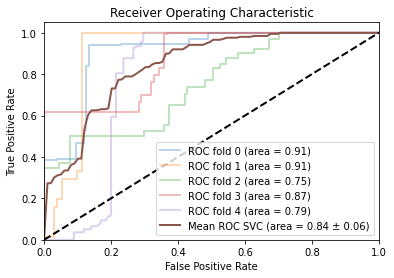

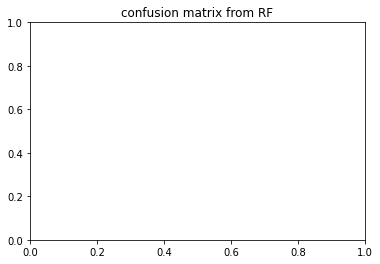

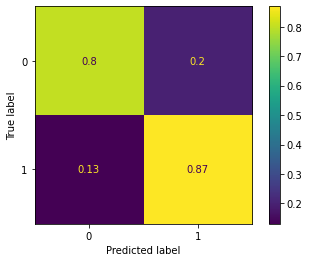

{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm1_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.582 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.882 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.706 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.607 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.697 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.728 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.955 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.820 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.690 total time=   0.0s
[CV 5/5]

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.838 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.364 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.734 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.821 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.819 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.688 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.822 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.622 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.620 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.629 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.768 total time=   0.0

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.818 total time=   0.0s
{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

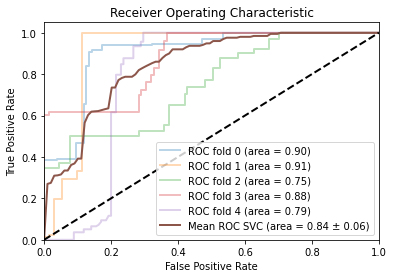

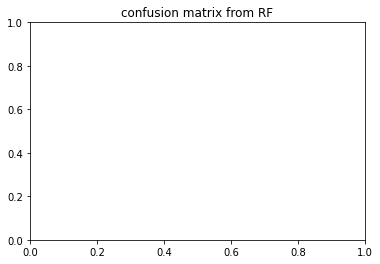

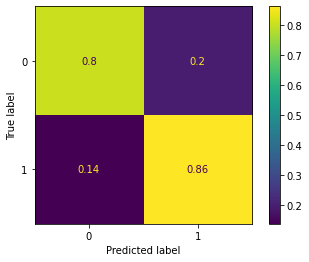

{'C': 1, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.632 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.819 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.828 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.987 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.890 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.649 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.627 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.851 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.708 total time=   0.2s
[C

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.929 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.744 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.688 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.893 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=1.000 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.531 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.556 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.725 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.576 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.981 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.754 total time=   0.1

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.891 total time=   0.1s
{'C': 10, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

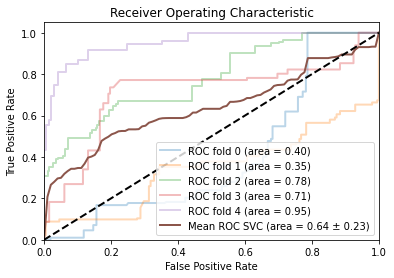

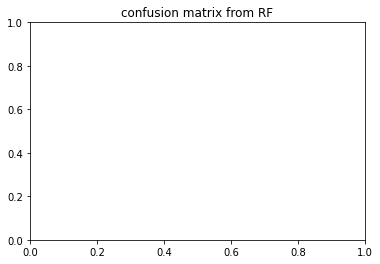

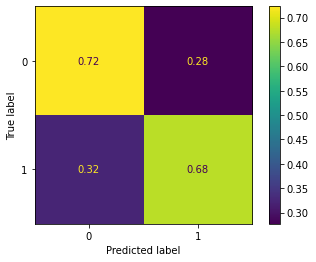

{'C': 10, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_both_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.646 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.835 total time=   0.1s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.846 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.988 total time=   0.1s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.899 total time=   0.1s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.653 total time=   0.2s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.646 total time=   0.2s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.867 total time=   0.2s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.716 total time=   0.2s
[CV 5

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.926 total time=   0.2s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.745 total time=   0.1s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.698 total time=   0.1s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.891 total time=   0.1s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=1.000 total time=   0.1s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.550 total time=   0.1s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.526 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.743 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.597 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.978 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.769 total time=   0.1

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.902 total time=   0.1s
{'C': 10, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

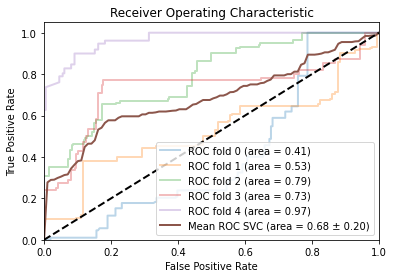

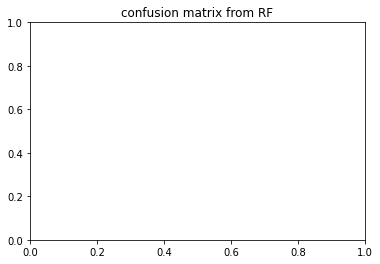

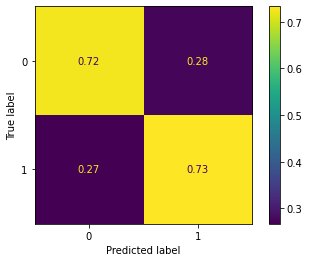

{'C': 10, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.582 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.911 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.755 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.852 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.554 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.809 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.931 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.889 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.903 total time=   0.0

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.573 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.737 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.732 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.915 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.980 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.804 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.707 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.820 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.901 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.849 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.668 total time=   0.0

{'C': 100, 'coef0': 0.5, 'gamma': 0.001, 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

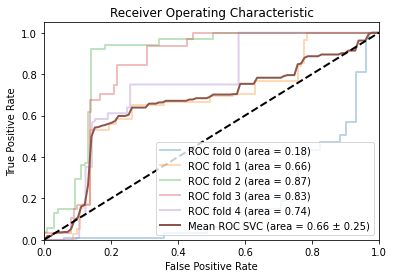

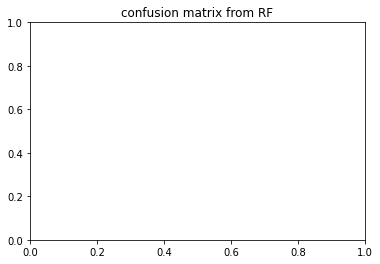

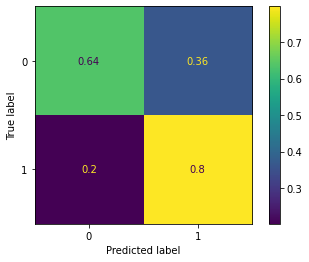

{'C': 100, 'coef0': 0.5, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm1_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.570 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.908 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.755 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.869 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.555 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.806 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.933 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.887 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.903 total time=   0.0s
[CV 5

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.591 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.736 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.732 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.920 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.980 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.804 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.709 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.832 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.900 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.867 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.675 total time=   0.0

{'C': 100, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

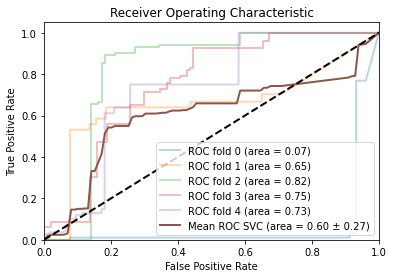

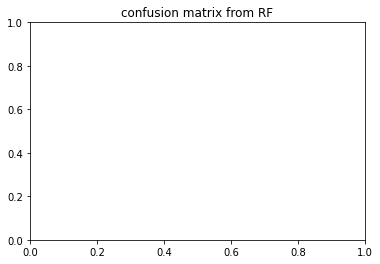

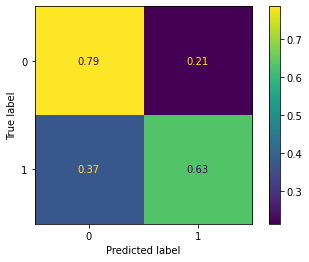

{'C': 100, 'coef0': 1.0, 'gamma': 0.001, 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_nbr_allelle_4
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.859 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.414 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.745 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.978 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.853 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.788 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.344 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.759 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.849 total time=   0.0s

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.967 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.822 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.435 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.734 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.733 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.746 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.750 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.461 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.715 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.767 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.910 total time=   0.0

[CV 5/5] END C=100, coef0=1.0, gamma=0.0001, kernel=sigmoid;, score=0.953 total time=   0.0s
{'C': 1, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid'}


c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\users\celia\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modif

<Figure size 432x288 with 0 Axes>

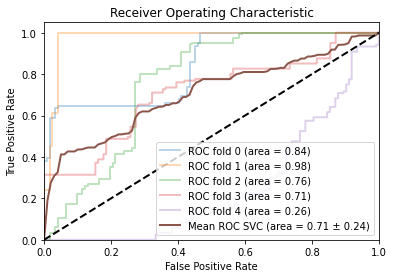

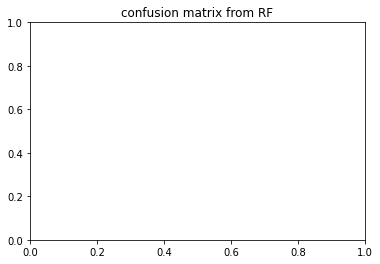

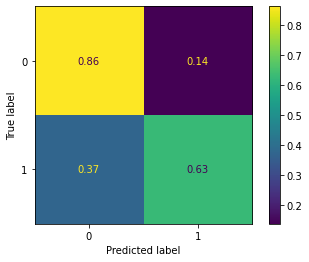

{'C': 1, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}
irm2_under_APOE_one_hot
kernel: sigmoid
Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.865 total time=   0.0s
[CV 2/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.415 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.746 total time=   0.0s
[CV 4/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.974 total time=   0.0s
[CV 5/5] END C=1, coef0=0.0, gamma=scale, kernel=sigmoid;, score=0.833 total time=   0.0s
[CV 1/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.798 total time=   0.1s
[CV 2/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.334 total time=   0.0s
[CV 3/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.744 total time=   0.1s
[CV 4/5] END C=1, coef0=0.0, gamma=0.001, kernel=sigmoid;, score=0.848 total time=   0.0s
[CV 5

[CV 5/5] END C=10, coef0=0.1, gamma=0.0001, kernel=sigmoid;, score=0.962 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.836 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.434 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.712 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.728 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=scale, kernel=sigmoid;, score=0.749 total time=   0.0s
[CV 1/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.765 total time=   0.0s
[CV 2/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.460 total time=   0.0s
[CV 3/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.689 total time=   0.0s
[CV 4/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.757 total time=   0.0s
[CV 5/5] END C=10, coef0=0.5, gamma=0.001, kernel=sigmoid;, score=0.885 total time=   0.0

{'C': 1, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid'}


<Figure size 432x288 with 0 Axes>

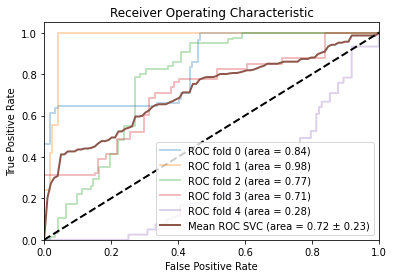

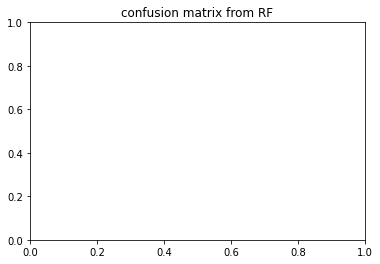

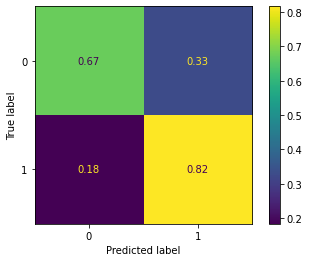

{'C': 1, 'coef0': 0.1, 'gamma': 'scale', 'kernel': 'sigmoid', 'probability': True}


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.733200,0.814777,0.820780,0.815285
irm1_both_APOE_one_hot,0.743740,0.814362,0.822741,0.817473
irm2_both_APOE_nbr_allelle_4,0.694553,0.757599,0.789832,0.856345
irm2_both_APOE_one_hot,0.714810,0.757945,0.789596,0.861925
irm1_under_APOE_nbr_allelle_4,0.817997,0.875771,0.869319,0.857201
irm1_under_APOE_one_hot,0.818306,0.874719,0.865408,0.862563
irm2_under_APOE_nbr_allelle_4,0.713178,0.746438,0.781222,0.784741
irm2_under_APOE_one_hot,0.705884,0.744193,0.778909,0.780955


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.796548,0.898183,0.905633,0.906239
irm1_both_APOE_one_hot,0.783283,0.895639,0.834646,0.903150
irm2_both_APOE_nbr_allelle_4,0.394099,0.684594,0.872002,0.403577
irm2_both_APOE_one_hot,0.401629,0.694481,0.711682,0.408822
irm1_under_APOE_nbr_allelle_4,0.564538,0.660296,0.591313,0.182626
irm1_under_APOE_one_hot,0.586510,0.661932,0.536127,0.069392
irm2_under_APOE_nbr_allelle_4,0.635110,0.753218,0.697196,0.839656
irm2_under_APOE_one_hot,0.675450,0.795895,0.684528,0.841078


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.770377,0.833161,0.844464,0.845842
irm1_both_APOE_one_hot,0.773615,0.833825,0.862188,0.846222
irm2_both_APOE_nbr_allelle_4,0.630681,0.708738,0.763537,0.638416
irm2_both_APOE_one_hot,0.638845,0.712630,0.704560,0.684465
irm1_under_APOE_nbr_allelle_4,0.714310,0.836435,0.744256,0.656112
irm1_under_APOE_one_hot,0.717502,0.838005,0.745561,0.601758
irm2_under_APOE_nbr_allelle_4,0.686267,0.682841,0.770860,0.708073
irm2_under_APOE_one_hot,0.688462,0.715829,0.755507,0.716467


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.770377,0.833161,0.844464,0.845842
irm1_both_APOE_one_hot,0.773615,0.833825,0.862188,0.846222
irm2_both_APOE_nbr_allelle_4,0.630681,0.708738,0.763537,0.638416
irm2_both_APOE_one_hot,0.638845,0.712630,0.704560,0.684465
irm1_under_APOE_nbr_allelle_4,0.714310,0.836435,0.744256,0.656112
irm1_under_APOE_one_hot,0.717502,0.838005,0.745561,0.601758
irm2_under_APOE_nbr_allelle_4,0.686267,0.682841,0.770860,0.708073
irm2_under_APOE_one_hot,0.688462,0.715829,0.755507,0.716467


the score on cross_val: 


,linear,rbf,poly,sigmoid
irm1_both_APOE_nbr_allelle_4,0.770377,0.833161,0.844464,0.845842
irm1_both_APOE_one_hot,0.773615,0.833825,0.862188,0.846222
irm2_both_APOE_nbr_allelle_4,0.630681,0.708738,0.763537,0.638416
irm2_both_APOE_one_hot,0.638845,0.712630,0.704560,0.684465
irm1_under_APOE_nbr_allelle_4,0.714310,0.836435,0.744256,0.656112
irm1_under_APOE_one_hot,0.717502,0.838005,0.745561,0.601758
irm2_under_APOE_nbr_allelle_4,0.686267,0.682841,0.770860,0.708073
irm2_under_APOE_one_hot,0.688462,0.715829,0.755507,0.716467


<Figure size 432x288 with 0 Axes>

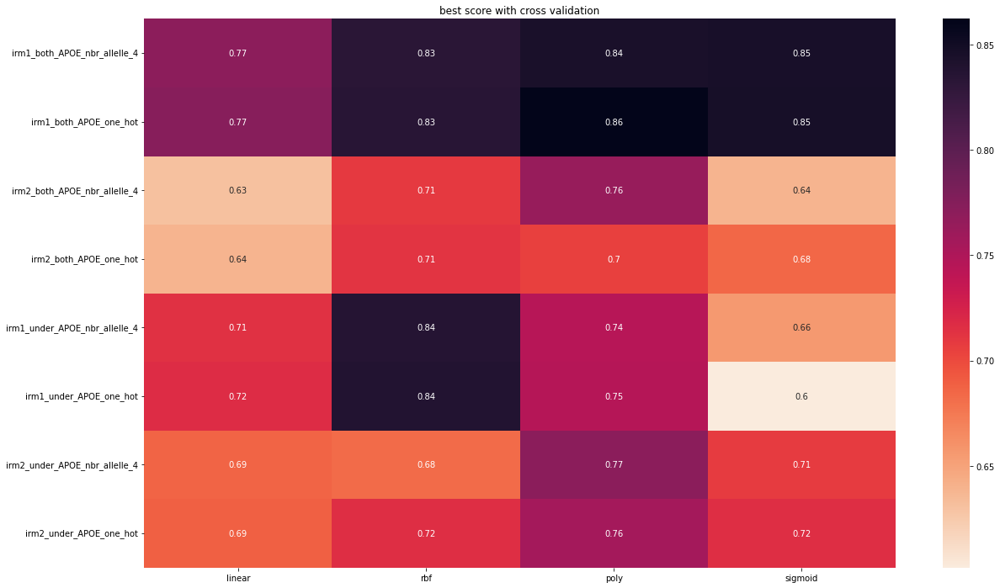

In [30]:
target_nbrs_for_fs = [350, 300, 250, 200, 150]

for target_nbrs_for_fs_1 in target_nbrs_for_fs:
    print("here: "+str(target_nbrs_for_fs_1))
    feat_selec = "with_fs"
    target_nbr = target_nbrs_for_fs_1
    new_dbs = {}

    for title_irm in dfs:
        print(title_irm)
        df = dfs[title_irm].copy()
        df.reset_index(inplace=True, drop=True)
        y = df[["diagnostic"]].copy()
        X = df.drop(columns=["diagnostic"])
        grouping = X["RID"].copy()
        X.drop(columns=["RID"], inplace=True)


        print(y["diagnostic"].value_counts())
        scaler = StandardScaler()

        # 2 Stratégies DB: APOE en one hot encoded et seulement le nombre d'allele 4

        # Strategies 1: Nbr allele 4
        print("strategies 1")
        X_copy = X.copy()
        X_copy["APOE_nbr_allelle_4"] = X_copy.apply(lambda x: str(x['APOE']).count("4"), axis=1)
        X_copy.drop(columns=["APOE"], inplace=True)
        
        
        # normalise
        col_2_scale = [x for x in X_copy.columns if "neuro_comp" in x]
        not_scaled = []
        for col in X_copy.columns:
            if len(X_copy[col].unique()) != 2 and col != "APOE_nbr_allelle_4":
                col_2_scale.append(col)
            elif (1 not in X_copy[col].unique() or 0 not in X_copy[col].unique()) and col != "APOE_nbr_allelle_4":
                col_2_scale.append(col)
            else:
                not_scaled.append(col)
        print("not scale for strat 2: "+str(not_scaled))
        X_copy[col_2_scale] = scaler.fit_transform(X_copy[col_2_scale], y["diagnostic"])
        
        # feature selection
        fs = SelectKBest(score_func=f_classif, k=target_nbr)
        fs.fit(X_copy, y["diagnostic"])

        if feat_selec == "with_fs":
            X_new = fs.transform(X_copy)
            X_copy = pd.DataFrame(X_new, columns=fs.get_feature_names_out())

        print(title_irm+"_APOE_nbr_allelle_4")
        display(X_copy)
        new_dbs[title_irm+"_APOE_nbr_allelle_4"] = [X_copy.copy(), y.copy(), fs, grouping]

        # Strategies 2: one hot encoded
        print("strategies 2")
        X_copy = X.copy()
        X_copy = pd.get_dummies(X_copy, columns=["APOE"])
        
        
        # normalize
        col_2_scale = [x for x in X_copy.columns if "neuro_comp" in x]
        not_scaled = []
        for col in X_copy.columns:
            if len(X_copy[col].unique()) != 2:
                col_2_scale.append(col)
            elif 1 not in X_copy[col].unique() or 0 not in X_copy[col].unique():
                col_2_scale.append(col)
            else:
                not_scaled.append(col)
        print("not scale for strat 2: "+str(not_scaled))
        X_copy[col_2_scale] = scaler.fit_transform(X_copy[col_2_scale], y["diagnostic"])
        
        # feature selection
        fs = SelectKBest(score_func=f_classif, k=target_nbr)
        fs.fit(X_copy, y["diagnostic"])

        if feat_selec == "with_fs":
            X_new = fs.transform(X_copy)
            X_copy = pd.DataFrame(X_new, columns=fs.get_feature_names_out())


        print(title_irm+"_APOE_one_hot")
        display(X_copy)
        new_dbs[title_irm+"_APOE_one_hot"] = [X_copy.copy(), y.copy(), fs, grouping]
    print(new_dbs.keys())


    if feat_selec == "with_fs":
        name=[]
        column_dfs = []
        for i in new_dbs:
            name.append(i)
            column_dfs.append(set(new_dbs[i][0].columns))

        # Création d'un dictionnaire pour stocker les ensembles en utilisant leurs éléments concaténés comme clés
        sets_dict = {}

        # Parcours des listes
        for nom, ensemble in zip(name, column_dfs):
            # Convertir l'ensemble en tuple trié pour l'utiliser comme clé dans le dictionnaire
            ensemble_trié = tuple(sorted(ensemble))
            # Vérifier si l'ensemble existe déjà dans le dictionnaire
            if ensemble_trié in sets_dict:
                # Fusionner les noms
                sets_dict[ensemble_trié] += "-"+nom
            else:
                # Ajouter le nom et l'ensemble dans le dictionnaire
                sets_dict[ensemble_trié] = nom

        # Extraire les noms uniques et les ensembles correspondants
        nouveaux_noms = []
        ensembles_uniques = []
        for ensemble, nom in sets_dict.items():
            nouveaux_noms.append(nom)
            ensembles_uniques.append(set(ensemble))
        print(nouveaux_noms)  # Sortie : ["ACD", "B"]
        new_new_dbs = {}
        for name in nouveaux_noms:
            new_new_dbs["_".join(name.split("-"))] = new_dbs[name.split("-")[0]].copy()
        # ba exvivo garde le amy 3 pos, 
        print(new_new_dbs.keys())
        new_dbs = new_new_dbs.copy()

    ########################################################################################################################
    ################################## Random forest ########################################################################
    ########################################################################################################################
    import statistics 
    rf_run = True

    scores_options = {"auc_roc": roc_auc_score, "f1score": f1_score}
    scoring = "auc_roc"
    binary = False

    custom_scorer = make_scorer(multiclass_score, greater_is_better=True, targets=[1], score=scores_options[scoring], 
                                binary=binary)

    today = datetime.now().strftime("%d-%m-%Y_%Hh%Mm%Ss")
    path="./backup_models/preclinical/RF/"+feat_selec+"/"+scoring+"/"+today+"/"
    if feat_selec == "with_fs":
        path="./backup_models/preclinical/RF/"+feat_selec+"/"+str(target_nbr)+"/"+scoring+"/"+today+"/"

    if rf_run:
        #varier nbr of trees ? et plus de depth? 
        strat_ml = {
            "depth":{
                "10":{
                    'n_estimators': [10, 50, 100], 'criterion': ['gini', 'entropy'],'max_depth': [10], 'max_features': ['sqrt', 'log2', None, 0.5,0.8]
                },
                "100":{
                    'n_estimators': [10, 50, 100], 'criterion': ['gini', 'entropy'],'max_depth': [100], 'max_features': ['sqrt', 'log2', None, 0.5,0.8]
                },
                "1000":{
                    'n_estimators': [10, 50, 100], 'criterion': ['gini', 'entropy'],'max_depth': [1000], 'max_features': ['sqrt', 'log2', None, 0.5,0.8]
                },
            }
        }

        os.makedirs(path+"gridsearch_models/", exist_ok=True)
        os.makedirs(path+"test_train_set/", exist_ok=True)
        os.makedirs(path+"dataset/", exist_ok=True)
        os.makedirs(path+"roc_curve/", exist_ok=True)
        os.makedirs(path+"cm/", exist_ok=True)
        os.makedirs(path+"report/", exist_ok=True)

        conf_mat = []
        top5_combinaison = []
        exclude = {}

        for stratml in strat_ml:
            strat_df_best_score = pd.DataFrame(columns=strat_ml[stratml].keys(), index=new_dbs.keys())
            strat_df_score_test = pd.DataFrame(columns=strat_ml[stratml].keys(), index=new_dbs.keys())
            strat_df_score_cross_val = pd.DataFrame(columns=strat_ml[stratml].keys(), index=new_dbs.keys())
            strat_df_score_cross_val_std = pd.DataFrame(columns=strat_ml[stratml].keys(), index=new_dbs.keys())
            for k in strat_ml[stratml]:
                for options in new_dbs:
                    if len(top5_combinaison) == 0 or stratml+"_"+options in top5_combinaison:
                        name_file = stratml+"_"+k+"_"+options+"_score_"+scoring
                        print(name_file)

                        X = new_dbs[options][0]
                        y = new_dbs[options][1]
                        group_list = new_dbs[options][-1]
                        groupkfold = StratifiedGroupKFold(n_splits=5)
                        if options+".csv" not in os.listdir(path+"dataset"):
                            pd.concat([group_list, X, y], axis=1).to_csv(path + "dataset/" + options + ".csv")


                        best_params, best_score, score_on_test, model = grid_searches(X, y, RandomForestClassifier, 
                                                                                   custom_scorer, strat_ml[stratml][k], 
                                                                                   path, name_file, v= 3 , cv_grid=groupkfold, 
                                                                                   cv_out_grid=groupkfold, group=group_list)


                        ####### cross val + CM  + roc curve + scores  + STD


                        y = y["diagnostic"]

                        splitting = groupkfold.split(X, y, group_list)

                        conf_matrix_list_of_arrays = []
                        scores = []

                        tprs = []
                        aucs = []
                        mean_fpr = np.linspace(0, 1, 100)
                        fig, ax = plt.subplots()
                        df_scores = []
                        for indice, (train_index, test_index) in enumerate(splitting):

                            X_train, X_test, y_train, y_test = X.iloc[train_index], X.iloc[test_index], y.iloc[train_index], y.iloc[test_index]

                            model.fit(X_train, y_train)
                            # df_probs = pd.DataFrame(clf.predict_proba(X_test), columns=[i for i in clf.classes_])
                            y_pred_proba = model.predict_proba(X_test)[:, 1]

                            scores.append(roc_auc_score(y_test, y_pred_proba, multi_class="ovr", average="weighted"))

                            # Calculate ROC curve
                            fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
                            roc_auc = auc(fpr, tpr)
                            y_pred = (y_pred_proba > thresholds[np.argmax(tpr - fpr)]).astype('float')
                            conf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])

                            conf_matrix_list_of_arrays.append(conf_matrix)

                            # Tracer les courbes ROC pour chaque pli
                            plt.plot(fpr, tpr, lw=2, alpha=0.3,
                                     label='ROC fold {0} (area = {1:0.2f})'
                                           ''.format(indice, roc_auc))


                            # Interpoler les tpr à la moyenne des fpr
                            tprs.append(np.interp(mean_fpr, fpr, tpr))
                            tprs[-1][0] = 0.0


                            report = classification_report(y_test, y_pred, labels=[0,1], output_dict=True)
                            df_for_scoring = pd.DataFrame(report).transpose()

                            new_line = [0]*(len(df_for_scoring.index)-2)
                            score_auc = roc_auc_score(y_test, y_pred_proba, average="macro", multi_class='ovr', labels=[0,1])
                            new_line.append(score_auc)
                            score_auc = roc_auc_score(y_test, y_pred_proba, average="weighted", multi_class='ovr', labels=[0,1])
                            new_line.append(score_auc)
                            df_for_scoring["auc"] = new_line

                            df_scores.append(df_for_scoring)

                        # Tracer la moyenne des courbes ROC
                        std_tpr = np.std(tprs, axis=0)
                        mean_tpr = np.mean(tprs, axis=0)
                        mean_tpr[-1] = 1.0
                        mean_auc = auc(mean_fpr, mean_tpr)
                        std_auc = np.std([auc(fpr, tpr) for fpr, tpr in zip([mean_fpr]*len(tprs), tprs)])
                        plt.plot(mean_fpr, mean_tpr, linestyle='-', linewidth=2,
                                     label='Mean ROC {0} (area = {1:0.2f} ± {2:0.2f})'.format(type(model).__name__, mean_auc, std_auc))


                        plt.plot([0, 1], [0, 1], 'k--', lw=2)
                        plt.xlim([0.0, 1.0])
                        plt.ylim([0.0, 1.05])
                        plt.xlabel('False Positive Rate')
                        plt.ylabel('True Positive Rate')
                        plt.title('Receiver Operating Characteristic')
                        plt.legend(loc="lower right")
                        if name_file is not None:
                            plt.savefig(path + "roc_curve/" + name_file + "_roc_curve.png")
                        plt.show()
                        plt.clf()

                        sum_conf_mat = np.sum(conf_matrix_list_of_arrays, axis=0)

                        plt.title("confusion matrix from RF")
                        # Calcul de la somme des éléments de chaque ligne
                        row_sums = np.sum(sum_conf_mat, axis=1)

                        # Mise à l'échelle en divisant chaque élément par la somme de sa ligne
                        scaled_arr = sum_conf_mat / row_sums[:, np.newaxis]
                        # cm = ConfusionMatrixDisplay(sum_conf_mat / np.sum(sum_conf_mat), display_labels=classes).plot()
                        ConfusionMatrixDisplay(scaled_arr, display_labels=[0,1]).plot()

                        plt.savefig(path + "cm/" + name_file + "_cm.png")
                        plt.show()
                        plt.clf()

                        # Calculer la moyenne de chaque élément
                        mean_df = pd.concat(df_scores).groupby(level=0).mean().round(3)

                        # Calculer l'écart type de chaque élément
                        std_df = pd.concat(df_scores).groupby(level=0).std().round(3)
                        mean_df.to_csv(path + "report/" + name_file + "_mean.csv")
                        std_df.to_csv(path + "report/" + name_file + "_std.csv")
                        display(mean_df)
                        print("coming from")
                        for lesdf in df_scores:
                            display(lesdf)
                        ################ fin cross val


                        print(best_params)
                        strat_df_best_score.at[options, k] = best_score
                        strat_df_score_test.at[options, k] = score_on_test
                        strat_df_score_cross_val.at[options, k] = sum(scores)/len(scores)
                        strat_df_score_cross_val_std.at[options, k] = statistics.pstdev(scores)


            #for i in conf_mat:
                #print(i[0])
                #ConfusionMatrixDisplay(i[1], display_labels=i[2]).plot()

            strat_df_best_score.dropna(inplace=True)
            strat_df_score_test.dropna(inplace=True)
            strat_df_score_cross_val.dropna(inplace=True)
            strat_df_score_cross_val_std.dropna(inplace=True)

            for i in strat_df_best_score.columns:
                strat_df_best_score[i] = strat_df_best_score[i].astype(float)
                strat_df_score_test[i] = strat_df_score_test[i].astype(float)
                strat_df_score_cross_val[i] = strat_df_score_cross_val[i].astype(float)
                strat_df_score_cross_val_std[i] = strat_df_score_cross_val_std[i].astype(float)


            display(strat_df_best_score)
            display(strat_df_score_test)
            display(strat_df_score_cross_val)
            display(strat_df_score_cross_val_std)

            strat_df_best_score.to_csv(path+stratml+"_best_scores_in_grid.csv")
            strat_df_score_test.to_csv(path+stratml+"_score_on_test.csv")
            strat_df_score_cross_val.to_csv(path+stratml+"_score_on_cross_val.csv")
            strat_df_score_cross_val_std.to_csv(path+stratml+"_score_on_cross_val_std.csv")

    if True:
        path="./backup_models/preclinical/RF/"+feat_selec+"/"+scoring
        if feat_selec == "with_fs":
            path="./backup_models/preclinical/RF/"+feat_selec+"/"+str(target_nbr)+"/"+scoring

        plot_scores(path, plots=["score_on_cross_val"], v=True)



    ########################################################################################################################
    ################################## svm ########################################################################
    ########################################################################################################################
    svm_run = True

    scores_options = {"auc_roc": roc_auc_score, "f1score": f1_score}
    scoring = "auc_roc"
    binary = False
    proba_svc = True
    if scoring == "auc_roc":
        proba_svc = True

    custom_scorer = make_scorer(multiclass_score, greater_is_better=True, targets=[1], score=scores_options[scoring], 
                                binary=binary)

    today = datetime.now().strftime("%d-%m-%Y_%Hh%Mm%Ss")
    path="./backup_models/preclinical/SVM/"+feat_selec+"/"+scoring+"/"+today+"/"
    if feat_selec == "with_fs":
        path="./backup_models/preclinical/SVM/"+feat_selec+"/"+str(target_nbr)+"/"+scoring+"/"+today+"/"

    if svm_run:
        # ATTENTION: à changer quand stratégie change"

        os.makedirs(path+"gridsearch_models/", exist_ok=True)
        os.makedirs(path+"test_train_set/", exist_ok=True)
        os.makedirs(path+"dataset/", exist_ok=True)
        os.makedirs(path+"roc_curve/", exist_ok=True)
        os.makedirs(path+"cm/", exist_ok=True)
        os.makedirs(path+"report/", exist_ok=True)

        kernels = {"linear": {'C': [1, 10, 100], 'kernel': ['linear']}, 
                   "rbf": {'C': [1, 10, 100], 'gamma': ['scale', 0.001, 0.0001], 'kernel': ['rbf']}, 
                   "poly": {'C': [1, 10, 100], 'gamma': ['scale', 0.001, 0.0001], 'kernel': ['poly'], 'coef0': [0.0, 0.1, 0.5, 1.0],'degree': [3, 5, 7, 9]}, 
                   "sigmoid": {'C': [1, 10, 100], 'gamma': ['scale', 0.001, 0.0001], 'kernel': ['sigmoid'],'coef0': [0.0, 0.1, 0.5, 1.0]}}


        strat_df_best_score = pd.DataFrame(columns=kernels.keys(), index=new_dbs.keys())
        strat_df_score_test = pd.DataFrame(columns=kernels.keys(), index=new_dbs.keys())
        strat_df_score_cross_val = pd.DataFrame(columns=kernels.keys(), index=new_dbs.keys())
        strat_df_score_cross_val_std = pd.DataFrame(columns=kernels.keys(), index=new_dbs.keys())
        top5_combinaison = []

        for k in kernels:
            for options in new_dbs:
                print(options)
                print("kernel: "+k)
                if len(top5_combinaison) == 0 or options in top5_combinaison:
                    name_file = "kernel_"+k+"_"+options+"_score_"+scoring

                    X = new_dbs[options][0].copy()
                    y = new_dbs[options][1].copy()
                    group_list = new_dbs[options][-1]
                    groupkfold = StratifiedGroupKFold(n_splits=5)
                    if options+".csv" not in os.listdir(path+"dataset"):
                        pd.concat([group_list, X, y], axis=1).to_csv(path + "dataset/" + options + ".csv")

                    best_params, best_score, score_on_test, model = grid_searches(X, y, SVC, 
                                                                               custom_scorer, kernels[k], 
                                                                               path, name_file, cv_grid=groupkfold,
                                                                               cv_out_grid=groupkfold, group=group_list, basic_par={"probability": True})
                    print(best_params)
                    best_params["probability"] = proba_svc


                    ####### cross val + CM  + roc curve + scores  + STD


                    y = y["diagnostic"]

                    splitting = groupkfold.split(X, y, group_list)

                    conf_matrix_list_of_arrays = []
                    scores = []

                    tprs = []
                    aucs = []
                    mean_fpr = np.linspace(0, 1, 100)
                    fig, ax = plt.subplots()
                    df_scores = []
                    for indice, (train_index, test_index) in enumerate(splitting):

                        X_train, X_test, y_train, y_test = X.iloc[train_index], X.iloc[test_index], y.iloc[train_index], y.iloc[test_index]

                        model.fit(X_train, y_train)
                        # df_probs = pd.DataFrame(clf.predict_proba(X_test), columns=[i for i in clf.classes_])

                        y_pred_proba = model.predict_proba(X_test)[:, 1]

                        scores.append(roc_auc_score(y_test, y_pred_proba, multi_class="ovr", average="weighted"))

                        # Calculate ROC curve
                        fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
                        roc_auc = auc(fpr, tpr)
                        y_pred = (y_pred_proba > thresholds[np.argmax(tpr - fpr)]).astype('float')
                        conf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])

                        conf_matrix_list_of_arrays.append(conf_matrix)

                        # Tracer les courbes ROC pour chaque pli
                        plt.plot(fpr, tpr, lw=2, alpha=0.3,
                                 label='ROC fold {0} (area = {1:0.2f})'
                                       ''.format(indice, roc_auc))


                        # Interpoler les tpr à la moyenne des fpr
                        tprs.append(np.interp(mean_fpr, fpr, tpr))
                        tprs[-1][0] = 0.0


                        report = classification_report(y_test, y_pred, labels=[0,1], output_dict=True)
                        df_for_scoring = pd.DataFrame(report).transpose()

                        new_line = [0]*(len(df_for_scoring.index)-2)
                        score_auc = roc_auc_score(y_test, y_pred_proba, average="macro", multi_class='ovr', labels=[0,1])
                        new_line.append(score_auc)
                        score_auc = roc_auc_score(y_test, y_pred_proba, average="weighted", multi_class='ovr', labels=[0,1])
                        new_line.append(score_auc)
                        df_for_scoring["auc"] = new_line

                        df_scores.append(df_for_scoring)

                    # Tracer la moyenne des courbes ROC
                    std_tpr = np.std(tprs, axis=0)
                    mean_tpr = np.mean(tprs, axis=0)
                    mean_tpr[-1] = 1.0
                    mean_auc = auc(mean_fpr, mean_tpr)
                    std_auc = np.std([auc(fpr, tpr) for fpr, tpr in zip([mean_fpr]*len(tprs), tprs)])
                    plt.plot(mean_fpr, mean_tpr, linestyle='-', linewidth=2,
                                 label='Mean ROC {0} (area = {1:0.2f} ± {2:0.2f})'.format(type(model).__name__, mean_auc, std_auc))


                    plt.plot([0, 1], [0, 1], 'k--', lw=2)
                    plt.xlim([0.0, 1.0])
                    plt.ylim([0.0, 1.05])
                    plt.xlabel('False Positive Rate')
                    plt.ylabel('True Positive Rate')
                    plt.title('Receiver Operating Characteristic')
                    plt.legend(loc="lower right")
                    if name_file is not None:
                        plt.savefig(path + "roc_curve/" + name_file + "_roc_curve.png")
                    plt.show()
                    plt.clf()

                    sum_conf_mat = np.sum(conf_matrix_list_of_arrays, axis=0)

                    plt.title("confusion matrix from RF")
                    # Calcul de la somme des éléments de chaque ligne
                    row_sums = np.sum(sum_conf_mat, axis=1)

                    # Mise à l'échelle en divisant chaque élément par la somme de sa ligne
                    scaled_arr = sum_conf_mat / row_sums[:, np.newaxis]
                    # cm = ConfusionMatrixDisplay(sum_conf_mat / np.sum(sum_conf_mat), display_labels=classes).plot()
                    ConfusionMatrixDisplay(scaled_arr, display_labels=[0,1]).plot()

                    plt.savefig(path + "cm/" + name_file + "_cm.png")
                    plt.show()
                    plt.clf()


                    # Calculer la moyenne de chaque élément
                    mean_df = pd.concat(df_scores).groupby(level=0).mean().round(3)

                    # Calculer l'écart type de chaque élément
                    std_df = pd.concat(df_scores).groupby(level=0).std().round(3)
                    mean_df.to_csv(path + "report/" + name_file + "_mean.csv")
                    std_df.to_csv(path + "report/" + name_file + "_std.csv")
                    ################ fin cross val
                    print(best_params)
                    strat_df_best_score.at[options, k] = best_score
                    strat_df_score_test.at[options, k] = score_on_test
                    strat_df_score_cross_val.at[options, k] = sum(scores)/len(scores)
                    strat_df_score_cross_val_std.at[options, k] = statistics.pstdev(scores)



        strat_df_best_score.dropna(inplace=True)
        strat_df_score_test.dropna(inplace=True)
        strat_df_score_cross_val.dropna(inplace=True)
        strat_df_score_cross_val_std.dropna(inplace=True)

        for i in strat_df_best_score.columns:
            strat_df_best_score[i] = strat_df_best_score[i].astype(float)
            strat_df_score_test[i] = strat_df_score_test[i].astype(float)
            strat_df_score_cross_val[i] = strat_df_score_cross_val[i].astype(float)
            strat_df_score_cross_val_std[i] = strat_df_score_cross_val[i].astype(float)


        display(strat_df_best_score)
        display(strat_df_score_test)
        display(strat_df_score_cross_val)
        display(strat_df_score_cross_val_std)

        strat_df_best_score.to_csv(path+"best_scores_in_grid.csv")
        strat_df_score_test.to_csv(path+"score_on_test.csv")
        strat_df_score_cross_val.to_csv(path+"score_on_cross_val.csv")
        strat_df_score_cross_val_std.to_csv(path+"score_on_cross_val_std.csv")
    if True:
        path="./backup_models/preclinical/SVM/"+feat_selec+"/"+scoring
        if feat_selec == "with_fs":
            path="./backup_models/preclinical/SVM/"+feat_selec+"/"+str(target_nbr)+"/"+scoring

        plot_scores(path, plots=["score_on_cross_val"], v=True)
    